# Benchmarking Field Transformation HMC

### DONE - FT-HMC implemented for 8x8 2D QED (using SiLU as activation function).

- [x] Try to minimize size of the force in training. No significant improvements.
- [x]  Some test on ergodicity
- [x] (calculate the probablity of generating the configs obtained via conventional HMC).

### TODO

- [ ] Plot the force size distribution 
- [ ] Is the large force from the original action or Field-Transformation the determinant?
- [ ] If from the determinant, then the fermion force won't cause problem for HMC
- [ ] Use the same Field-Transformation for larger system (say 16x16, 32x32, 64x64, etc)
- [ ] Study how the delta H depends on the system size ( perhaps delta H ~ sqrt(volume) )
- [ ] Study the auto-correlation for observables, topo, plaq, flowed plaq, etc.
- [ ] Improving the Field-Transformation to reduce force.

In [3]:
%load_ext autoreload
%autoreload 2

%config InlineBackend.figure_format ='retina'

from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"

import torch
import math
import sys
import os
from timeit import default_timer as timer
from functools import reduce

project_dir = os.path.abspath('../../')
if project_dir not in sys.path:
    sys.path.append(project_dir)
    
    
from utils.param import Param
import utils.io as io
logger = io.Logger()

torch.manual_seed(9)

#torch.set_num_threads(param.nth)
#torch.set_num_interop_threads(param.nth_interop)
#os.environ["OMP_NUM_THREADS"] = str(param.nth)
#os.environ["KMP_BLOCKTIME"] = "0"
#os.environ["KMP_SETTINGS"] = "1"
#os.environ["KMP_AFFINITY"]= "granularity=fine,verbose,compact,1,0"

#torch.set_default_tensor_type(torch.DoubleTensor)

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


# Define `Param` specifying lattice and MCMC params

In [7]:
param=Param(
    beta=2.0,
    L=16,
    #lat=(16, 16),
    tau=0.5, # 0.3
    nstep=10, # 3
    nrun=10,
    randinit=True,
    # ADJUST ME
    ntraj=256, # 2**16 # 2**10 # 2**15
    nprint=10,
    seed=1331,
)

logger.log(repr(param))

[18:01:37]  Param:                                                                                                                                                                                                                                              
            ----------------                                                                                                                                                                                                                                    
            beta=2.0                                                                                                                                                                                                                                            
            L=16                                                                                                                                                                                                                                                
            tau=0.5                                                                                                                                                                                                                                             
            nstep=10                                                                                                                                                                                                                                            
            ntraj=256                                                                                                                                                                                                                                           
            nrun=10                                                                                                                                                                                                                                             
            nprint=10                                                                                                                                                                                                                                           
            seed=1331                                                                                                                                                                                                                                           
            randinit=True                                                                                                                                                                                                                                       
            nth=2                                                                                                                                                                                                                                               
            nth_interop=2                                                                                                                                                                                                                                       
            lat=[16, 16]                                                                                                                                                                                                                                        
            nd=2                                                                                                                                                                                                                                                
            shape=[2, 16, 16]                                                                                                                    

In [8]:
from train import run as hmc_run


import datetime

NOW = io.get_timestamp('%Y-%m-%d')
OUTDIR = os.path.join(os.getcwd(), 'outputs', NOW)

param_dir = os.path.join(OUTDIR, param.uniquestr())
if not os.path.isdir(OUTDIR):
    os.makedirs(OUTDIR)

fields, metrics = hmc_run(param, logger=logger)

metrics_dir = os.path.join(OUTDIR, 'metrics', 'hmc')
metrics_file = os.path.join(metrics_dir, 'metrics.z')
io.savez(metrics, metrics_file)

Duplicate key in file PosixPath('/home/foremans/.config/matplotlib/stylelib/dark_jupyter.mplstyle'), line 92 ('figure.facecolor: 474747')
Duplicate key in file PosixPath('/home/foremans/.config/matplotlib/stylelib/dark_jupyter.mplstyle'), line 93 ('figure.edgecolor: 0.50')
In /home/foremans/.config/matplotlib/stylelib/dark_jupyter.mplstyle: 
The savefig.jpeg_quality rcparam was deprecated in Matplotlib 3.3 and will be removed two minor releases later.


TORCH DEVICE: cuda


[18:01:41]  Param:                                                                                                                                                                                                                                              
            ----------------                                                                                                                                                                                                                                    
            beta=2.0                                                                                                                                                                                                                                            
            L=16                                                                                                                                                                                                                                                
            tau=0.5                                                                                                                                                                                                                                             
            nstep=10                                                                                                                                                                                                                                            
            ntraj=256                                                                                                                                                                                                                                           
            nrun=10                                                                                                                                                                                                                                             
            nprint=10                                                                                                                                                                                                                                           
            seed=1331                                                                                                                                                                                                                                           
            randinit=True                                                                                                                                                                                                                                       
            nth=2                                                                                                                                                                                                                                               
            nth_interop=2                                                                                                                                                                                                                                       
            lat=[16, 16]                                                                                                                                                                                                                                        
            nd=2                                                                                                                                                                                                                                                
            shape=[2, 16, 16]                                                                                                                    

            plaq=-0.00876 charge=-2

            traj=25    accept=True  dH=0.0209 expdH=0.9793 plaq=0.7126 charge=5

            traj=50    accept=True  dH=-0.05188 expdH=1.053 plaq=0.6713 charge=0

            traj=75    accept=True  dH=0.06583 expdH=0.9363 plaq=0.695 charge=3

            traj=100   accept=True  dH=0.01453 expdH=0.9856 plaq=0.6731 charge=-1

[18:01:42]  traj=125   accept=True  dH=0.02942 expdH=0.971 plaq=0.7096 charge=-2

            traj=150   accept=True  dH=-0.03629 expdH=1.037 plaq=0.6999 charge=4

            traj=175   accept=True  dH=-0.007782 expdH=1.008 plaq=0.7019 charge=0

            traj=200   accept=True  dH=-0.004333 expdH=1.004 plaq=0.7296 charge=0

            traj=225   accept=True  dH=-0.01572 expdH=1.016 plaq=0.684 charge=0

            traj=250   accept=True  dH=-0.01898 expdH=1.019 plaq=0.6653 charge=-1

[18:01:43]  traj=281   accept=True  dH=0.02095 expdH=0.9793 plaq=0.7014 charge=0

            traj=306   accept=True  dH=0.07805 expdH=0.9249 plaq=0.7371 charge=-3

            traj=331   accept=True  dH=0.02493 expdH=0.9754 plaq=0.7138 charge=2

            traj=356   accept=True  dH=-0.03029 expdH=1.031 plaq=0.7044 charge=1

            traj=381   accept=True  dH=0.002838 expdH=0.9972 plaq=0.6806 charge=-1

            traj=406   accept=True  dH=-0.04657 expdH=1.048 plaq=0.7035 charge=-1

[18:01:44]  traj=431   accept=True  dH=0.05093 expdH=0.9503 plaq=0.7156 charge=0

            traj=456   accept=True  dH=0.1439 expdH=0.866 plaq=0.6988 charge=-6

            traj=481   accept=True  dH=0.001007 expdH=0.999 plaq=0.7186 charge=-3

            traj=506   accept=True  dH=0.0894 expdH=0.9145 plaq=0.7408 charge=2

            traj=537   accept=False dH=0.08058 expdH=0.9226 plaq=0.668 charge=0

            traj=562   accept=True  dH=-0.003143 expdH=1.003 plaq=0.6989 charge=0

[18:01:45]  traj=587   accept=True  dH=0.0528 expdH=0.9486 plaq=0.7294 charge=-1

            traj=612   accept=True  dH=-0.0228 expdH=1.023 plaq=0.6936 charge=0

            traj=637   accept=False dH=0.003891 expdH=0.9961 plaq=0.7373 charge=3

            traj=662   accept=True  dH=0.00531 expdH=0.9947 plaq=0.7113 charge=5

            traj=687   accept=True  dH=0.0007172 expdH=0.9993 plaq=0.6939 charge=3

            traj=712   accept=False dH=0.1381 expdH=0.871 plaq=0.6735 charge=-1

[18:01:46]  traj=737   accept=True  dH=-0.0722 expdH=1.075 plaq=0.6599 charge=3

            traj=762   accept=True  dH=0.07533 expdH=0.9274 plaq=0.7445 charge=0

            traj=793   accept=True  dH=-0.03586 expdH=1.037 plaq=0.6994 charge=-1

            traj=818   accept=True  dH=-0.0517 expdH=1.053 plaq=0.6882 charge=0

            traj=843   accept=True  dH=-0.01331 expdH=1.013 plaq=0.6715 charge=0

            traj=868   accept=False dH=0.03456 expdH=0.966 plaq=0.6554 charge=0

[18:01:47]  traj=893   accept=False dH=0.02246 expdH=0.9778 plaq=0.6726 charge=0

            traj=918   accept=True  dH=-0.05182 expdH=1.053 plaq=0.7091 charge=2

            traj=943   accept=True  dH=0.04094 expdH=0.9599 plaq=0.6926 charge=-3

            traj=968   accept=True  dH=-0.06058 expdH=1.062 plaq=0.6725 charge=3

            traj=993   accept=True  dH=-0.02701 expdH=1.027 plaq=0.6815 charge=0

            traj=1018  accept=True  dH=-0.1074 expdH=1.113 plaq=0.7059 charge=2

[18:01:48]  traj=1049  accept=True  dH=1.526e-05 expdH=1     plaq=0.7152 charge=0

            traj=1074  accept=True  dH=-0.06429 expdH=1.066 plaq=0.7157 charge=0

            traj=1099  accept=True  dH=-0.009766 expdH=1.01  plaq=0.6837 charge=0

            traj=1124  accept=True  dH=0.03397 expdH=0.9666 plaq=0.7115 charge=0

            traj=1149  accept=True  dH=0.01706 expdH=0.9831 plaq=0.663 charge=-1

            traj=1174  accept=True  dH=0.1015 expdH=0.9035 plaq=0.6989 charge=-3

[18:01:49]  traj=1199  accept=True  dH=-0.02049 expdH=1.021 plaq=0.6765 charge=4

            traj=1224  accept=True  dH=-0.1104 expdH=1.117 plaq=0.6494 charge=-3

            traj=1249  accept=True  dH=0.04503 expdH=0.956 plaq=0.7092 charge=2

            traj=1274  accept=True  dH=0.0278 expdH=0.9726 plaq=0.6836 charge=-2

            traj=1305  accept=True  dH=0.009216 expdH=0.9908 plaq=0.7057 charge=3

            traj=1330  accept=True  dH=-0.1779 expdH=1.195 plaq=0.6403 charge=-3

[18:01:50]  traj=1355  accept=True  dH=-0.05594 expdH=1.058 plaq=0.697 charge=-1

            traj=1380  accept=True  dH=0.03314 expdH=0.9674 plaq=0.7078 charge=-1

            traj=1405  accept=True  dH=0.0304 expdH=0.9701 plaq=0.6842 charge=-3

            traj=1430  accept=True  dH=-0.1326 expdH=1.142 plaq=0.6859 charge=1

            traj=1455  accept=True  dH=0.01324 expdH=0.9868 plaq=0.6809 charge=0

            traj=1480  accept=True  dH=-0.03072 expdH=1.031 plaq=0.6909 charge=-4

[18:01:51]  traj=1505  accept=True  dH=0.06578 expdH=0.9363 plaq=0.7338 charge=2

            traj=1530  accept=True  dH=-0.05101 expdH=1.052 plaq=0.7132 charge=-2

            traj=1561  accept=True  dH=-0.1385 expdH=1.149 plaq=0.6455 charge=1

            traj=1586  accept=True  dH=0.04892 expdH=0.9523 plaq=0.6983 charge=-2

            traj=1611  accept=True  dH=-0.05659 expdH=1.058 plaq=0.7015 charge=-2

            traj=1636  accept=True  dH=-0.008881 expdH=1.009 plaq=0.6997 charge=0

[18:01:52]  traj=1661  accept=True  dH=-0.05696 expdH=1.059 plaq=0.6638 charge=0

            traj=1686  accept=True  dH=0.06644 expdH=0.9357 plaq=0.736 charge=0

            traj=1711  accept=True  dH=-0.05608 expdH=1.058 plaq=0.7173 charge=0

            traj=1736  accept=True  dH=-0.07529 expdH=1.078 plaq=0.6807 charge=1

            traj=1761  accept=True  dH=0.007767 expdH=0.9923 plaq=0.735 charge=1

            traj=1786  accept=True  dH=-0.06757 expdH=1.07  plaq=0.6698 charge=2

[18:01:53]  traj=1817  accept=True  dH=0.03363 expdH=0.9669 plaq=0.7077 charge=3

            traj=1842  accept=True  dH=0.04208 expdH=0.9588 plaq=0.6681 charge=0

            traj=1867  accept=True  dH=-0.0665 expdH=1.069 plaq=0.7115 charge=3

            traj=1892  accept=True  dH=-0.04755 expdH=1.049 plaq=0.6534 charge=-2

            traj=1917  accept=True  dH=-0.01572 expdH=1.016 plaq=0.7203 charge=0

            traj=1942  accept=True  dH=0.002289 expdH=0.9977 plaq=0.7022 charge=-1

            traj=1967  accept=True  dH=0.08807 expdH=0.9157 plaq=0.7789 charge=-2

[18:01:54]  traj=1992  accept=True  dH=-0.01465 expdH=1.015 plaq=0.7155 charge=1

            traj=2017  accept=True  dH=0.06163 expdH=0.9402 plaq=0.7248 charge=0

            traj=2042  accept=True  dH=-0.04764 expdH=1.049 plaq=0.6523 charge=2

            traj=2073  accept=True  dH=0.0473 expdH=0.9538 plaq=0.7192 charge=2

            traj=2098  accept=True  dH=-0.0816 expdH=1.085 plaq=0.7148 charge=0

            traj=2123  accept=True  dH=-0.03577 expdH=1.036 plaq=0.6598 charge=0

[18:01:55]  traj=2148  accept=True  dH=0.02237 expdH=0.9779 plaq=0.6475 charge=2

            traj=2173  accept=True  dH=0.03629 expdH=0.9644 plaq=0.7416 charge=-1

            traj=2198  accept=True  dH=-0.02423 expdH=1.025 plaq=0.6506 charge=1

            traj=2223  accept=True  dH=-0.01559 expdH=1.016 plaq=0.685 charge=0

            traj=2248  accept=True  dH=-0.06262 expdH=1.065 plaq=0.671 charge=0

            traj=2273  accept=False dH=0.01202 expdH=0.988 plaq=0.6924 charge=0

[18:01:56]  traj=2298  accept=True  dH=0.0195 expdH=0.9807 plaq=0.7051 charge=1

            traj=2329  accept=True  dH=0.0321 expdH=0.9684 plaq=0.7208 charge=0

            traj=2354  accept=True  dH=0.004425 expdH=0.9956 plaq=0.7245 charge=-3

            traj=2379  accept=True  dH=-0.0262 expdH=1.027 plaq=0.7138 charge=0

            traj=2404  accept=True  dH=-0.1176 expdH=1.125 plaq=0.7044 charge=-1

            traj=2429  accept=True  dH=-0.02432 expdH=1.025 plaq=0.7005 charge=4

[18:01:57]  traj=2454  accept=True  dH=-0.04877 expdH=1.05  plaq=0.6552 charge=5

            traj=2479  accept=True  dH=0.0144 expdH=0.9857 plaq=0.7066 charge=3

            traj=2504  accept=True  dH=-0.05771 expdH=1.059 plaq=0.6779 charge=1

            traj=2529  accept=True  dH=0.0553 expdH=0.9462 plaq=0.7281 charge=0

            traj=2554  accept=True  dH=-0.01575 expdH=1.016 plaq=0.6983 charge=-3

            Run times: [1.6519572734832764, 1.6563866138458252, 1.6549923419952393, 1.6487083435058594, 1.6619517803192139, 1.6459856033325195, 1.6632599830627441, 1.64133620262146, 1.645249605178833, 1.6144607067108154]

            Per trajectory: [0.006452958099544048, 0.006470260210335255, 0.006464813835918903, 0.006440266966819763, 0.006491999141871929, 0.006429631263017654, 0.006497109308838844, 0.006411469541490078, 0.0064267562702298164, 0.006306487135589123]

[18:01:57]  Saving <class 'dict'> to /lus/grand/projects/DLHMC/nftqcd/fthmc/flow_test_sam/notebooks/outputs/2021-05-23/metrics/hmc/metrics.z.

## Helper functions for training model

In [7]:
import time
import utils.qed_helpers as qed
from typing import Callable

import torch.nn as nn

from utils.layers import make_u1_equiv_layers, set_weights
from utils.distributions import MultivariateUniform, bootstrap, calc_dkl, calc_ess
from utils.samplers import make_mcmc_ensemble, apply_flow_to_prior

from utils.plot_helpers import (init_live_joint_plots, update_joint_plots,
                                init_live_plot, update_plot)

grab = qed.grab

def train_step(
        model,
        action,
        optimizer,
        #metrics,
        batch_size,
        with_force=False,
        pre_model=None,
        verbose=True,
        era=None,
        epoch=None,
        #gamma=None,  # annealing factor, should be in [0, 1]
):
    t0 = time.time()
    layers, prior = model['layers'], model['prior']
    optimizer.zero_grad()
    
    xi = None
    if pre_model != None:
        pre_layers, pre_prior = pre_model['layers'], pre_model['prior']
        pre_xi = pre_prior.sample_n(batch_size)
        x = qed.ft_flow(pre_layers, pre_xi)
        xi = qed.ft_flow_inv(layers, x)
        
    xi, x, logq = apply_flow_to_prior(prior, layers, batch_size=batch_size, xi=xi)#, gamma=gamma)
    logp = -action(x)
    
    force_size = torch.tensor(0.0)
    dkl = calc_dkl(logp, logq)
    loss_force = torch.tensor(0.0)
    loss_dkl = torch.tensor(0.0)
    if with_force:
        assert pre_model != None
        force = qed.ft_force(param, layers, xi, True)
        force_size = torch.sum(torch.square(force))
        loss_force = force_size
        loss_force.backward()
    else:
        loss_dkl = dkl
        loss_dkl.backward()
        
    #loss.backward()
    #
    # minimization target
    # loss mini
    # -> (logq - logp) mini
    # -> (action - logJ) mini
    #
    optimizer.step()
    ess = calc_ess(logp, logq)
    batch_metrics = {
        'dt': time.time() - t0,
        #'loss': grab(loss),
        'loss_force': grab(loss_force),
        'loss': grab(loss_dkl),
        'force': grab(force_size),
        'dkl': grab(dkl),
        'logp': grab(logp),
        'logq': grab(logq),
        'ess': grab(ess),
        'force_norm': grab(torch.linalg.norm(qed.ft_force(param, layers, xi))),
    }
    #if verbose:
    #    io.print_metrics(batch_metrics)
    #    #ioprint_metrics(batch_metrics, era=era, epoch=epoch)
        
    return batch_metrics
        
                
                
def update_history(history, metrics, extras=None):
    if extras is not None:
        for key, val in extras.items():
            try:
                history[key].append(val)
            except KeyError:
                history[key] = [val]
                
    for key, val in metrics.items():
        try:
            history[key].append(val)
        except KeyError:
            history[key] = [val]

    return history


from dataclasses import dataclass
        
            
def flow_train(
    param,
    n_era=10,
    n_epoch=100,
    n_layers=24,
    n_s_nets=2,
    hidden_sizes=[8, 8],
    kernel_size=3,
    base_lr=0.001,
    batch_size=64,
    print_freq=10,
    plot_freq=20,
    with_force=False,
    pre_model=None
):  # packaged from original ipynb by Xiao-Yong Jin
    # Theory
    lattice_shape = tuple(param.lat)
    link_shape = (2,*param.lat)
    beta = param.beta
    #u1_action = U1GaugeAction(beta)
    u1_action = qed.BatchAction(param.beta)
    # Model
    prior = MultivariateUniform(torch.zeros(link_shape), 2*np.pi*torch.ones(link_shape))
    
    layers = make_u1_equiv_layers(lattice_shape=lattice_shape,
                                  n_layers=n_layers,
                                  n_mixture_comps=n_s_nets,
                                  hidden_sizes=hidden_sizes,
                                  kernel_size=kernel_size)
    set_weights(layers)
    
    model = {'layers': layers, 'prior': prior}
    
    # Training
    optimizer = torch.optim.Adam(model['layers'].parameters(), lr=base_lr)
    optimizer_wf = torch.optim.Adam(model['layers'].parameters(), lr=base_lr / 100.0)
    #
    history = {
        'era': [], 'epoch': [],
        'dt': [], 'force' : [], 'force_norm': [], 'ess' : [],
        'dkl' : [], 'logp' : [], 'logq' : [],
        'loss': [], 'loss_force': [],
    }
                
    dt = 0.0
    history.update({'loss': []})
    plots = init_live_joint_plots(n_era, n_epoch, dpi=125, figsize=(4, 3), param=param)
    
    if with_force:
        y_label = ['ESS', 'loss_force']
        force_plots = init_live_joint_plots(n_era, n_epoch, dpi=125, figsize=(4, 3), param=param, y_label=y_label)
        force_optimizer = torch.optim.Adam(model['layers'].parameters(),
                                           lr=base_lr / 100.0, weight_decay=1e-5)
        history.update({
            'loss_force': [], 
        })
        
    for era in range(n_era):
        t0 = time.time()
        #console.rule(f'ERA: {era} (last took: {int(dt // 60)} min {dt % 60:.4g}s)', style='bright_yellow')
        logger.rule(f'ERA={era} (last took: {int(dt // 60)} min {dt % 60:.4g}s)', style='bright_yellow')
        for epoch in range(n_epoch):
            if with_force:
                batch_metrics = train_step(model, u1_action, optimizer_wf, #history,
                                           batch_size, with_force=with_force, pre_model=pre_model,
                                           verbose=(epoch%print_freq==0), era=era, epoch=epoch)
            else:
                batch_metrics = train_step(model, u1_action, optimizer, #history,
                                           batch_size, era=era, epoch=epoch,
                                           verbose=(epoch%print_freq==0))
                
            history = update_history(history, batch_metrics,
                                     extras={'era': era, 'epoch': epoch})
                
            if (epoch + 1) % param.nprint == 0:
                running_avgs = io.running_averages(history,
                                                   n_epochs=min(epoch, 5))
                io.print_metrics(running_avgs, logger=logger)
                
            if epoch % plot_freq == 0:
                if with_force:
                    update_joint_plots(history, alt_loss='loss_force', **force_plots)
                    
                update_joint_plots(history, **plots)
        
        dt = time.time() - t0
        
    outputs = {
        'model': model,
        'history': history,
        'action': u1_action,
    }
    
    return outputs


ActionFn = Callable[[float], torch.Tensor]


def generate_ensemble(
    model: nn.Module,
    u1_action: ActionFn = qed.BatchAction,
    ensemble_size: int = 1024,
    batch_size: int = 64,
    nboot: int = 100,
    binsize: int = 16,
):
    """Calculate the topological susceptibility.
    
    Packaged from original ipynb by Xiao-Yong Jin.
    """
    u1_ens = make_mcmc_ensemble(model, u1_action, batch_size, ensemble_size)
    charge = qed.grab(qed.topo_charge(torch.stack(u1_ens['x'], axis=0)))
    x_mean, x_err = bootstrap(charge**2, nboot=nboot, binsize=16)
    
    logger.log(f'Accept rate: {np.mean(u1_ens["accepted"])}')
    logger.log(f'Topological susceptibility = {x_mean:.5f} +/- {x_err:.5f}')
    #logger.log(f'... vs HMC estimate = 1.23 +/- 0.02')
    return {
        'u1_ens': u1_ens,
        'charge': charge,
        'suscept_mean': x_mean,
        'suscept_err': x_err,
    }
    return outputs

## Train model without force:

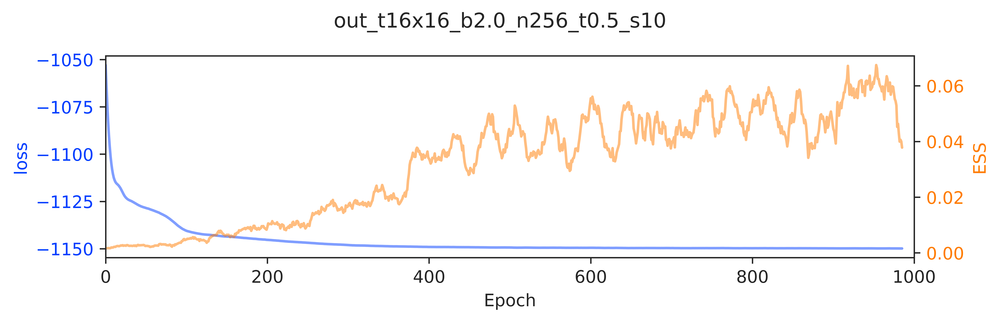

[18:03:01]  -------------------------------------------------------------------------------------------------------------- ERA=1, last took: 0 min 0 s                                                                                                          
            --------------------------------------------------------------------------------------------------------------

/lus/grand/projects/DLHMC/conda/pytorch/2021-05-12/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3419: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/lus/grand/projects/DLHMC/conda/pytorch/2021-05-12/lib/python3.8/site-packages/numpy/core/_methods.py:188: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


[18:04:13]  era=1     epoch=98    dt=0.6788 ess=0.00317586 loss=-1138.08 loss_force=0     force=nan   force_norm=1256.61 dkl=-1138.08 logp=318.213 logq=-819.862 force_size=1.5791e+06

[18:04:14]  ------------------------------------------------------------------------------------------------------------ ERA=2, last took: 1 min 13.24 s                                                                                                        
            ------------------------------------------------------------------------------------------------------------

[18:05:24]  era=2     epoch=98    dt=0.6792 ess=0.00995618 loss=-1144.9 loss_force=0     force=nan   force_norm=1211.49 dkl=-1144.9 logp=340.022 logq=-804.881 force_size=1.46784e+06

[18:05:25]  ------------------------------------------------------------------------------------------------------------ ERA=3, last took: 1 min 11.07 s                                                                                                        
            ------------------------------------------------------------------------------------------------------------

[18:06:35]  era=3     epoch=98    dt=0.6797 ess=0.0164493 loss=-1147.8 loss_force=0     force=nan   force_norm=1451.77 dkl=-1147.8 logp=345.415 logq=-802.381 force_size=2.1089e+06

[18:06:36]  ------------------------------------------------------------------------------------------------------------ ERA=4, last took: 1 min 11.11 s                                                                                                        
            ------------------------------------------------------------------------------------------------------------

[18:07:46]  era=4     epoch=98    dt=0.6808 ess=0.0352232 loss=-1148.98 loss_force=0     force=nan   force_norm=1880.47 dkl=-1148.98 logp=348.164 logq=-800.818 force_size=3.54495e+06

[18:07:47]  ------------------------------------------------------------------------------------------------------------ ERA=5, last took: 1 min 11.33 s                                                                                                        
            ------------------------------------------------------------------------------------------------------------

[18:08:58]  era=5     epoch=98    dt=0.6811 ess=0.035138 loss=-1149.37 loss_force=0     force=nan   force_norm=2077.5 dkl=-1149.37 logp=350.011 logq=-799.356 force_size=4.33767e+06

[18:08:59]  ------------------------------------------------------------------------------------------------------------- ERA=6, last took: 1 min 11.5 s                                                                                                        
            -------------------------------------------------------------------------------------------------------------

[18:10:09]  era=6     epoch=98    dt=0.6783 ess=0.0445006 loss=-1149.54 loss_force=0     force=nan   force_norm=2047.74 dkl=-1149.54 logp=349.283 logq=-800.258 force_size=4.22097e+06

[18:10:10]  ------------------------------------------------------------------------------------------------------------ ERA=7, last took: 1 min 10.96 s                                                                                                        
            ------------------------------------------------------------------------------------------------------------

[18:11:20]  era=7     epoch=98    dt=0.6797 ess=0.042068 loss=-1149.62 loss_force=0     force=nan   force_norm=2243.17 dkl=-1149.62 logp=350.278 logq=-799.34 force_size=5.08782e+06

[18:11:21]  ------------------------------------------------------------------------------------------------------------- ERA=8, last took: 1 min 10.9 s                                                                                                        
            -------------------------------------------------------------------------------------------------------------

[18:12:31]  era=8     epoch=98    dt=0.6787 ess=0.0331981 loss=-1149.71 loss_force=0     force=nan   force_norm=2082.4 dkl=-1149.71 logp=350.531 logq=-799.183 force_size=4.35666e+06

[18:12:32]  ------------------------------------------------------------------------------------------------------------ ERA=9, last took: 1 min 10.96 s                                                                                                        
            ------------------------------------------------------------------------------------------------------------

[18:13:42]  era=9     epoch=98    dt=0.6792 ess=0.0540156 loss=-1149.8 loss_force=0     force=nan   force_norm=2222.5 dkl=-1149.8 logp=350.801 logq=-798.997 force_size=4.96920e+06

[18:13:43]  ------------------------------------------------------------------------------------------------------------- ERA=10, last took: 1 min 11 s                                                                                                         
            -------------------------------------------------------------------------------------------------------------

[18:14:53]  era=10    epoch=98    dt=0.6798 ess=0.0373951 loss=-1149.83 loss_force=0     force=nan   force_norm=2136.13 dkl=-1149.83 logp=350.561 logq=-799.273 force_size=4.63921e+06

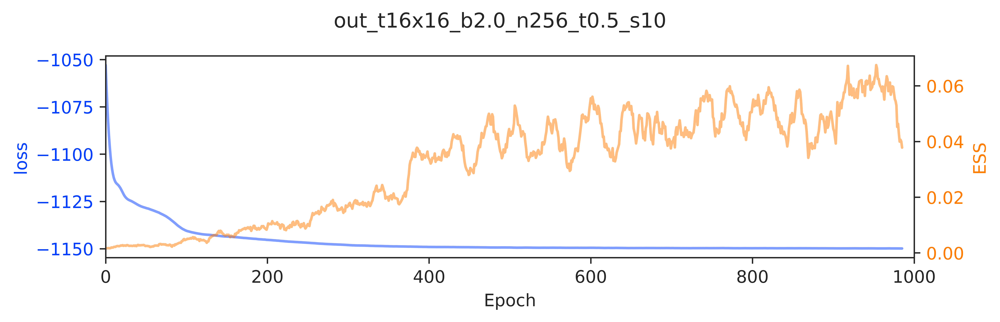

In [9]:
import matplotlib as mpl
from train import TrainConfig, train

mpl.rcParams['text.usetex'] = False
param.nprint = 100

train_config = TrainConfig(**{
    'n_era': 10,
    'n_epoch': 100,
    'n_layers': 32,
    'n_s_nets': 2,
    'hidden_sizes': [8, 8],
    'kernel_size': 3,
    'batch_size': 1024,
    'print_freq': 100,
    'plot_freq': 50,
})

outputs = train(param, train_config, pre_model=None,
                logger=logger, figsize=(8, 2.5))

pre_flow_model = outputs['model']
pre_flow_history = outputs['history']
flow_act = outputs['action']

### Evaluate trained model and calculate topological susceptibility $\chi_{\mathcal{Q}}$

In [10]:
from train import generate_ensemble

outputs = generate_ensemble(pre_flow_model, flow_act, logger=logger)
u1_ens = outputs['ensemble']

pre_flow = pre_flow_model['layers']

[18:24:52]  accept_rate=0.1884765625

            top_susceptibility=5.44356 +/- 0.55269

### Save `model.state_dict()` to `./pre_flow_model/pre_flow_model_layers.pt`:

In [11]:
#model_dir = os.path.join(os.getcwd(), 'pre_flow_model') 
model_dir = os.path.join(param_dir, 'pre_flow_model')
if not os.path.isdir(model_dir):
    os.makedirs(model_dir)

layers_file = os.path.join(model_dir, 'pre_flow_model_layers.pt')
logger.log(f'saving `pre_flow_model` to: {layers_file}.')
torch.save(pre_flow_model['layers'].state_dict(), layers_file)

[18:24:55]  saving `pre_flow_model` to: /lus/grand/projects/DLHMC/nftqcd/fthmc/flow_test_sam/notebooks/outputs/2021-05-23/out_t16x16_b2.0_n256_t0.5_s10/pre_flow_model/pre_flow_model_layers.pt.

In [12]:
train_force = False
flow_model = None

if train_force:
    flow_model, flow_act = flow_train(param, with_force=True, pre_model=pre_flow_model)
else:
    flow_model = pre_flow_model
    
u1_ens = generate_ensemble(flow_model, flow_act, logger=logger)
flow = flow_model['layers']
# flow.eval()

[18:26:53]  accept_rate=0.23046875

            top_susceptibility=4.11897 +/- 0.43086

TrainConfig(n_era=10, n_epoch=100, n_layers=32, n_s_nets=2, hidden_sizes=[8, 8], kernel_size=3, base_lr=0.001, batch_size=1024, print_freq=100, plot_freq=50, with_force=True)

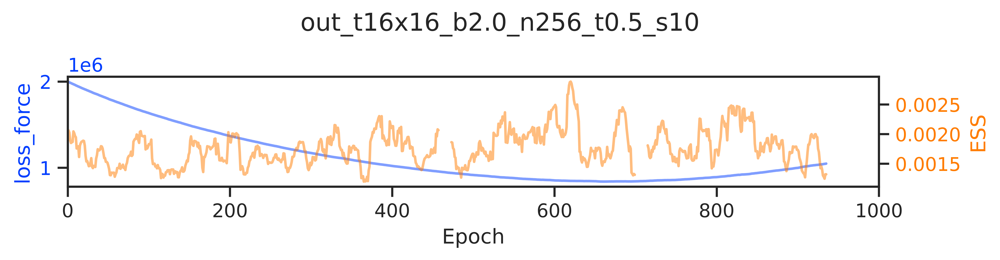

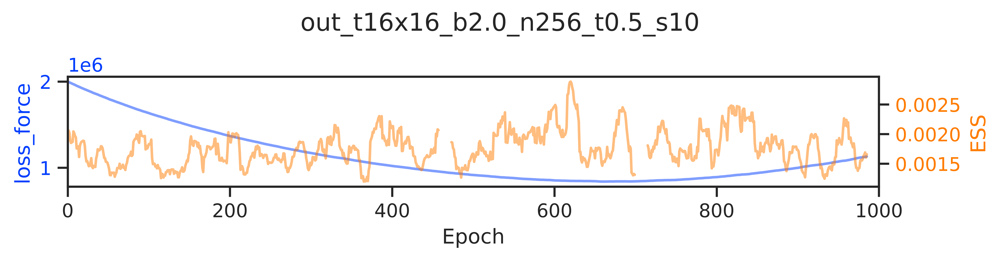

[18:42:52]  -------------------------------------------------------------------------------------------------------------- ERA=1, last took: 0 min 0 s                                                                                                          
            --------------------------------------------------------------------------------------------------------------

[18:45:03]  era=1     epoch=98    dt=1.283 ess=0.00228168 loss=1.66244e+06 loss_force=1.66244e+06 force=nan   force_norm=1289.36 dkl=-1296.27 logp=350.424 logq=-945.849 force_size=1.66244e+06

[18:45:05]  ------------------------------------------------------------------------------------------------------------- ERA=2, last took: 2 min 12.6 s                                                                                                        
            -------------------------------------------------------------------------------------------------------------

[18:47:16]  era=2     epoch=98    dt=1.284 ess=0.00200749 loss=1.39068e+06 loss_force=1.39068e+06 force=nan   force_norm=1179.27 dkl=-1282.38 logp=350.383 logq=-931.993 force_size=1.39068e+06

[18:47:17]  ------------------------------------------------------------------------------------------------------------ ERA=3, last took: 2 min 12.69 s                                                                                                        
            ------------------------------------------------------------------------------------------------------------

[18:49:28]  era=3     epoch=98    dt=1.285 ess=0.00189962 loss=1.18439e+06 loss_force=1.18439e+06 force=nan   force_norm=1088.3 dkl=-1269.75 logp=350.304 logq=-919.442 force_size=1.18439e+06

[18:49:30]  ------------------------------------------------------------------------------------------------------------ ERA=4, last took: 2 min 12.91 s                                                                                                        
            ------------------------------------------------------------------------------------------------------------

[18:51:41]  era=4     epoch=98    dt=1.286 ess=0.00197465 loss=1.03281e+06 loss_force=1.03281e+06 force=nan   force_norm=1016.27 dkl=-1258.35 logp=350.41 logq=-907.939 force_size=1.03281e+06

[18:51:43]  ------------------------------------------------------------------------------------------------------------ ERA=5, last took: 2 min 12.99 s                                                                                                        
            ------------------------------------------------------------------------------------------------------------

[18:53:54]  era=5     epoch=98    dt=1.287 ess=0.00106894 loss=924577 loss_force=924577 force=nan   force_norm=961.547 dkl=-1248.09 logp=350.219 logq=-897.875 force_size=924577

[18:53:56]  ------------------------------------------------------------------------------------------------------------ ERA=6, last took: 2 min 13.08 s                                                                                                        
            ------------------------------------------------------------------------------------------------------------

[18:56:08]  era=6     epoch=98    dt=1.286 ess=0.00141989 loss=860660 loss_force=860660 force=nan   force_norm=927.716 dkl=-1239.6 logp=350.042 logq=-889.554 force_size=860660

[18:56:09]  ------------------------------------------------------------------------------------------------------------ ERA=7, last took: 2 min 13.12 s                                                                                                        
            ------------------------------------------------------------------------------------------------------------

[18:58:21]  era=7     epoch=98    dt=1.288 ess=0.00143501 loss=838802 loss_force=838802 force=nan   force_norm=915.857 dkl=-1234.11 logp=350.609 logq=-883.503 force_size=838802

[18:58:23]  ------------------------------------------------------------------------------------------------------------ ERA=8, last took: 2 min 13.24 s                                                                                                        
            ------------------------------------------------------------------------------------------------------------

[19:00:34]  era=8     epoch=98    dt=1.288 ess=0.00134141 loss=885258 loss_force=885258 force=nan   force_norm=940.878 dkl=-1231.31 logp=350.218 logq=-881.088 force_size=885258

[19:00:36]  ------------------------------------------------------------------------------------------------------------ ERA=9, last took: 2 min 13.35 s                                                                                                        
            ------------------------------------------------------------------------------------------------------------

[19:02:47]  era=9     epoch=98    dt=1.285 ess=0.00116509 loss=990629 loss_force=990629 force=nan   force_norm=995.301 dkl=-1231.57 logp=349.547 logq=-882.023 force_size=990629

[19:02:49]  ------------------------------------------------------------------------------------------------------------ ERA=10, last took: 2 min 13.25 s                                                                                                       
            ------------------------------------------------------------------------------------------------------------

[19:05:01]  era=10    epoch=98    dt=1.287 ess=0.00162079 loss=1.13865e+06 loss_force=1.13865e+06 force=nan   force_norm=1067.07 dkl=-1235.31 logp=350.128 logq=-885.18 force_size=1.13865e+06

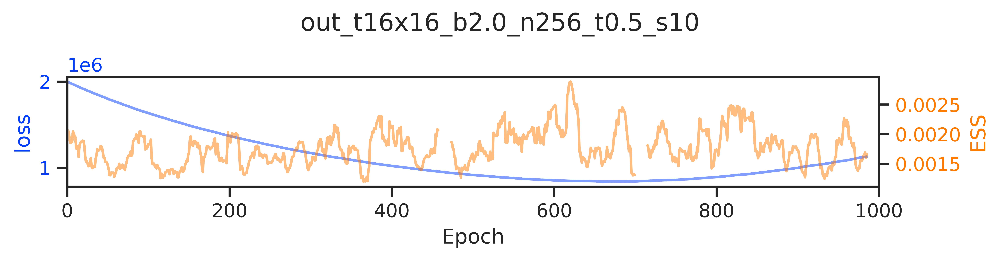

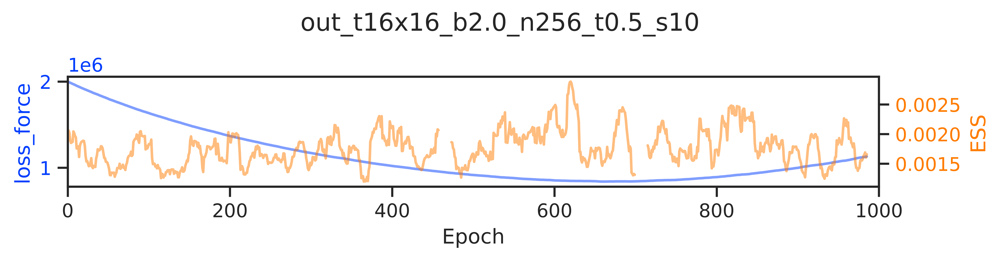

In [15]:
import seaborn as sns

from dataclasses import asdict
from copy import deepcopy
from utils.distributions import MultivariateUniform
from utils.layers import make_u1_equiv_layers, set_weights
from math import pi as PI
import utils.qed_helpers as qed

TWO_PI = 2 * PI
# from train import train

sns.set_context('notebook')
sns.set_palette('bright')

train_cfg_force = asdict(train_config)
train_cfg_force['with_force'] = True

tconfig_force = TrainConfig(**train_cfg_force)

link_shape = (2, *param.lat)
lattice_shape = tuple(param.lat)
u1_action = qed.BatchAction(param.beta)

prior = MultivariateUniform(torch.zeros(link_shape),
                            TWO_PI * torch.ones(link_shape))

tconfig_force
layers = make_u1_equiv_layers(lattice_shape=lattice_shape,
                              n_layers=tconfig_force.n_layers,
                              n_mixture_comps=tconfig_force.n_s_nets,
                              hidden_sizes=tconfig_force.hidden_sizes,
                              kernel_size=tconfig_force.kernel_size)

set_weights(layers)

model_force = {
    'prior': prior,
    'layers': layers,
}
                              

outputs = train(param, tconfig_force,
                model=model_force,
                pre_model=pre_flow_model,
                figsize=(8, 2.),
                use_alt=False,
                force_factor=0.001,
                dkl_factor=1.)#, logger=logger)

flow_model_force = outputs['model']
flow_model_force_history = outputs['history']
flow_action_force = outputs['action']

### Save the model trained with force:

In [19]:
model_dir = os.path.join(param_dir, 'flow_model_with_force')
if not os.path.isdir(model_dir):
    os.makedirs(model_dir)
    
layers_file = os.path.join(model_dir, 'flow_model_with_force.pt')

logger.log(f'Saving `flow_model_force` to {layers_file}.')
torch.save(flow_model_force['layers'].state_dict(), layers_file)

[19:40:26]  Saving `flow_model_force` to /lus/grand/projects/DLHMC/nftqcd/fthmc/flow_test_sam/notebooks/outputs/2021-05-23/out_t16x16_b2.0_n256_t0.5_s10/flow_model_with_force/flow_model_with_force.pt.

In [20]:
def test_force(
    param: Param,
    model: dict,
    x: torch.Tensor = None,
    pre_model: dict = None
):
    """Test the force.
    
    If `x` is None:
      - Draw samples `xi (~ pre_prior)` from prior and pass through `pre_model` to get `x (~ pre_posterior)`.
     
    Pass `x` backwards through the `model` to get `xi (~ prior)`.
    
    Calculate `force(xi)` and `norm(force(xi))`.
    """
    if x is None:
        if pre_model is None:
            raise ValueError(f'Either `x` or `pre_model` must be specified.')
            
        # Draw samples `xi` from prior
        pre_xi = pre_model['prior'].sample_n(1)
        
        # Pass `xi` through layers in `pre_model`
        x = qed.ft_flow(pre_model['layers'], pre_xi)
        
    # Pass `x` backwards through layers in `model`
    xi = qed.ft_flow_inv(model['layers'], x)
    # Calculate force
    force = qed.ft_force(param, model['layers'], xi)
    force_norm = torch.linalg.norm(force)
    return force_norm

In [21]:
from train import run as hmc_run
fields, metrics = hmc_run(param, logger=logger, keep_fields=True)

#metrics_dir = os.path.join(OUTDIR, 'metrics', 'hmc')
#metrics_file = os.path.join(metrics_dir, 'metrics.z')
#io.savez(metrics, metrics_file)

[19:40:57]  Param:                                                                                                                                                                                                                                              
            ----------------                                                                                                                                                                                                                                    
            beta=2.0                                                                                                                                                                                                                                            
            L=16                                                                                                                                                                                                                                                
            tau=0.5                                                                                                                                                                                                                                             
            nstep=10                                                                                                                                                                                                                                            
            ntraj=256                                                                                                                                                                                                                                           
            nrun=10                                                                                                                                                                                                                                             
            nprint=100                                                                                                                                                                                                                                          
            seed=1331                                                                                                                                                                                                                                           
            randinit=True                                                                                                                                                                                                                                       
            nth=2                                                                                                                                                                                                                                               
            nth_interop=2                                                                                                                                                                                                                                       
            lat=[16, 16]                                                                                                                                                                                                                                        
            nd=2                                                                                                                                                                                                                                                
            shape=[2, 16, 16]                                                                                                                    

            plaq=-0.01836 charge=6

            traj=2     accept=False dH=0.473 expdH=0.6231 plaq=-0.01836 charge=6

            traj=4     accept=False dH=0.5665 expdH=0.5675 plaq=-0.01836 charge=6

            traj=6     accept=True  dH=0.1237 expdH=0.8837 plaq=0.5066 charge=-1

            traj=8     accept=True  dH=0.006989 expdH=0.993 plaq=0.6345 charge=0

            traj=10    accept=True  dH=0.01904 expdH=0.9811 plaq=0.6505 charge=3

            traj=12    accept=True  dH=-0.04379 expdH=1.045 plaq=0.6577 charge=3

            traj=14    accept=True  dH=0.02365 expdH=0.9766 plaq=0.7361 charge=3

            traj=16    accept=False dH=0.03728 expdH=0.9634 plaq=0.7384 charge=2

            traj=18    accept=True  dH=-0.0574 expdH=1.059 plaq=0.6925 charge=0

            traj=20    accept=True  dH=0.0311 expdH=0.9694 plaq=0.7459 charge=-1

            traj=22    accept=True  dH=-0.1366 expdH=1.146 plaq=0.6788 charge=0

            traj=24    accept=True  dH=0.003799 expdH=0.9962 plaq=0.7072 charge=0

            traj=26    accept=True  dH=0.01602 expdH=0.9841 plaq=0.7345 charge=2

            traj=28    accept=True  dH=0.1033 expdH=0.9018 plaq=0.7484 charge=3

            traj=30    accept=True  dH=0.009552 expdH=0.9905 plaq=0.6712 charge=2

            traj=32    accept=True  dH=0.06281 expdH=0.9391 plaq=0.7239 charge=2

            traj=34    accept=True  dH=-0.0269 expdH=1.027 plaq=0.6851 charge=2

            traj=36    accept=True  dH=-0.02957 expdH=1.03  plaq=0.679 charge=2

            traj=38    accept=True  dH=0.1005 expdH=0.9044 plaq=0.7104 charge=2

            traj=40    accept=True  dH=0.07634 expdH=0.9265 plaq=0.7214 charge=1

            traj=42    accept=True  dH=0.003326 expdH=0.9967 plaq=0.7106 charge=2

            traj=44    accept=True  dH=-0.03867 expdH=1.039 plaq=0.7219 charge=2

            traj=46    accept=True  dH=0.03175 expdH=0.9687 plaq=0.7254 charge=3

            traj=48    accept=True  dH=0.03259 expdH=0.9679 plaq=0.7245 charge=1

            traj=50    accept=True  dH=-0.04904 expdH=1.05  plaq=0.7091 charge=-1

            traj=52    accept=True  dH=0.02991 expdH=0.9705 plaq=0.7041 charge=-3

            traj=54    accept=True  dH=0.08188 expdH=0.9214 plaq=0.7202 charge=-3

            traj=56    accept=True  dH=0.02423 expdH=0.9761 plaq=0.6916 charge=0

            traj=58    accept=True  dH=0.05875 expdH=0.9429 plaq=0.7264 charge=-1

            traj=60    accept=True  dH=-0.02365 expdH=1.024 plaq=0.6602 charge=-1

            traj=62    accept=True  dH=0.03857 expdH=0.9622 plaq=0.6786 charge=2

            traj=64    accept=True  dH=0.02557 expdH=0.9748 plaq=0.7117 charge=1

            traj=66    accept=True  dH=0.04834 expdH=0.9528 plaq=0.722 charge=3

            traj=68    accept=True  dH=-0.06261 expdH=1.065 plaq=0.6878 charge=3

            traj=70    accept=True  dH=0.04294 expdH=0.958 plaq=0.7299 charge=4

            traj=72    accept=False dH=0.09061 expdH=0.9134 plaq=0.703 charge=3

            traj=74    accept=True  dH=-0.04233 expdH=1.043 plaq=0.6731 charge=3

[19:40:58]  traj=76    accept=True  dH=0.05991 expdH=0.9419 plaq=0.7015 charge=3

            traj=78    accept=True  dH=-0.02774 expdH=1.028 plaq=0.7059 charge=5

            traj=80    accept=True  dH=0.0898 expdH=0.9141 plaq=0.7367 charge=5

            traj=82    accept=True  dH=0.01703 expdH=0.9831 plaq=0.7062 charge=4

            traj=84    accept=True  dH=-0.09903 expdH=1.104 plaq=0.632 charge=3

            traj=86    accept=True  dH=0.01346 expdH=0.9866 plaq=0.6752 charge=4

            traj=88    accept=True  dH=-0.003174 expdH=1.003 plaq=0.7101 charge=4

            traj=90    accept=True  dH=0.04523 expdH=0.9558 plaq=0.7274 charge=3

            traj=92    accept=True  dH=-0.1067 expdH=1.113 plaq=0.6817 charge=2

            traj=94    accept=True  dH=-0.0233 expdH=1.024 plaq=0.6477 charge=0

            traj=96    accept=True  dH=0.03571 expdH=0.9649 plaq=0.6495 charge=0

            traj=98    accept=True  dH=0.006546 expdH=0.9935 plaq=0.7227 charge=0

            traj=100   accept=True  dH=-0.1085 expdH=1.115 plaq=0.6931 charge=0

            traj=102   accept=True  dH=-0.01411 expdH=1.014 plaq=0.7135 charge=1

            traj=104   accept=True  dH=-0.06697 expdH=1.069 plaq=0.7104 charge=0

            traj=106   accept=True  dH=-0.04709 expdH=1.048 plaq=0.7129 charge=1

            traj=108   accept=True  dH=0.04353 expdH=0.9574 plaq=0.7024 charge=0

            traj=110   accept=True  dH=-0.1406 expdH=1.151 plaq=0.6641 charge=-1

            traj=112   accept=True  dH=-0.07947 expdH=1.083 plaq=0.6974 charge=0

            traj=114   accept=True  dH=0.09241 expdH=0.9117 plaq=0.7253 charge=0

            traj=116   accept=True  dH=0.0433 expdH=0.9576 plaq=0.6823 charge=1

            traj=118   accept=True  dH=-0.02878 expdH=1.029 plaq=0.6864 charge=-3

            traj=120   accept=True  dH=0.07092 expdH=0.9315 plaq=0.7297 charge=-3

            traj=122   accept=True  dH=0.02271 expdH=0.9776 plaq=0.7241 charge=-4

            traj=124   accept=True  dH=0.006958 expdH=0.9931 plaq=0.7041 charge=-3

            traj=126   accept=True  dH=0.02975 expdH=0.9707 plaq=0.7432 charge=-3

            traj=128   accept=True  dH=-0.05573 expdH=1.057 plaq=0.6766 charge=-2

            traj=130   accept=True  dH=0.002777 expdH=0.9972 plaq=0.7129 charge=-3

            traj=132   accept=True  dH=-0.0778 expdH=1.081 plaq=0.7349 charge=-1

            traj=134   accept=True  dH=-0.009933 expdH=1.01  plaq=0.744 charge=-3

            traj=136   accept=True  dH=-0.01424 expdH=1.014 plaq=0.7373 charge=-2

            traj=138   accept=True  dH=-0.1238 expdH=1.132 plaq=0.6921 charge=-1

            traj=140   accept=True  dH=0.01894 expdH=0.9812 plaq=0.7246 charge=0

            traj=142   accept=True  dH=-0.02216 expdH=1.022 plaq=0.7147 charge=0

            traj=144   accept=True  dH=0.0179 expdH=0.9823 plaq=0.7093 charge=-2

            traj=146   accept=True  dH=0.07585 expdH=0.927 plaq=0.7032 charge=0

            traj=148   accept=True  dH=0.06628 expdH=0.9359 plaq=0.7214 charge=0

            traj=150   accept=True  dH=0.1236 expdH=0.8838 plaq=0.6648 charge=4

            traj=152   accept=True  dH=0.07169 expdH=0.9308 plaq=0.6619 charge=0

            traj=154   accept=True  dH=-0.03619 expdH=1.037 plaq=0.6638 charge=0

            traj=156   accept=True  dH=-0.03732 expdH=1.038 plaq=0.7111 charge=-2

            traj=158   accept=True  dH=-0.1021 expdH=1.108 plaq=0.6746 charge=-3

            traj=160   accept=True  dH=-0.1492 expdH=1.161 plaq=0.6421 charge=-3

            traj=162   accept=True  dH=0.05687 expdH=0.9447 plaq=0.6783 charge=-3

            traj=164   accept=True  dH=0.0202 expdH=0.98  plaq=0.6651 charge=0

            traj=166   accept=True  dH=0.00412 expdH=0.9959 plaq=0.6776 charge=3

            traj=168   accept=True  dH=-0.05334 expdH=1.055 plaq=0.6661 charge=3

            traj=170   accept=True  dH=0.03192 expdH=0.9686 plaq=0.6835 charge=0

            traj=172   accept=True  dH=0.0356 expdH=0.965 plaq=0.7187 charge=0

            traj=174   accept=True  dH=0.05518 expdH=0.9463 plaq=0.7427 charge=0

            traj=176   accept=True  dH=-0.03101 expdH=1.031 plaq=0.716 charge=0

            traj=178   accept=True  dH=0.04192 expdH=0.959 plaq=0.7008 charge=0

            traj=180   accept=True  dH=-0.01035 expdH=1.01  plaq=0.675 charge=1

            traj=182   accept=True  dH=0.07925 expdH=0.9238 plaq=0.6753 charge=-2

            traj=184   accept=True  dH=0.02022 expdH=0.98  plaq=0.7172 charge=0

[19:40:59]  traj=186   accept=True  dH=-0.01813 expdH=1.018 plaq=0.7398 charge=-1

            traj=188   accept=True  dH=-0.05035 expdH=1.052 plaq=0.6686 charge=-3

            traj=190   accept=True  dH=-0.04797 expdH=1.049 plaq=0.6729 charge=0

            traj=192   accept=True  dH=0.04424 expdH=0.9567 plaq=0.698 charge=-1

            traj=194   accept=True  dH=-0.01154 expdH=1.012 plaq=0.6792 charge=0

            traj=196   accept=True  dH=0.02536 expdH=0.975 plaq=0.6667 charge=0

            traj=198   accept=True  dH=0.001526 expdH=0.9985 plaq=0.6769 charge=3

            traj=200   accept=True  dH=0.08304 expdH=0.9203 plaq=0.7304 charge=0

            traj=202   accept=True  dH=0.0004272 expdH=0.9996 plaq=0.7061 charge=1

            traj=204   accept=True  dH=0.02051 expdH=0.9797 plaq=0.6623 charge=3

            traj=206   accept=True  dH=-0.01846 expdH=1.019 plaq=0.7008 charge=3

            traj=208   accept=True  dH=-0.127 expdH=1.135 plaq=0.6837 charge=5

            traj=210   accept=True  dH=0.07137 expdH=0.9311 plaq=0.7265 charge=2

            traj=212   accept=True  dH=-0.01898 expdH=1.019 plaq=0.6904 charge=1

            traj=214   accept=True  dH=0.06708 expdH=0.9351 plaq=0.7097 charge=3

            traj=216   accept=True  dH=-0.0444 expdH=1.045 plaq=0.7031 charge=3

            traj=218   accept=True  dH=0.0008392 expdH=0.9992 plaq=0.6989 charge=2

            traj=220   accept=True  dH=0.02948 expdH=0.971 plaq=0.7249 charge=1

            traj=222   accept=True  dH=0.1038 expdH=0.9014 plaq=0.7088 charge=1

            traj=224   accept=True  dH=-0.08847 expdH=1.093 plaq=0.6846 charge=4

            traj=226   accept=True  dH=0.01805 expdH=0.9821 plaq=0.6619 charge=6

            traj=228   accept=True  dH=0.01794 expdH=0.9822 plaq=0.6517 charge=3

            traj=230   accept=True  dH=0.0619 expdH=0.94  plaq=0.6798 charge=3

            traj=232   accept=True  dH=-0.03928 expdH=1.04  plaq=0.6728 charge=4

            traj=234   accept=True  dH=-0.007111 expdH=1.007 plaq=0.6578 charge=7

            traj=236   accept=True  dH=0.01605 expdH=0.9841 plaq=0.6812 charge=3

            traj=238   accept=True  dH=-0.02893 expdH=1.029 plaq=0.6922 charge=6

            traj=240   accept=True  dH=0.01405 expdH=0.986 plaq=0.7375 charge=5

            traj=242   accept=True  dH=0.07349 expdH=0.9291 plaq=0.7212 charge=2

            traj=244   accept=True  dH=-0.04016 expdH=1.041 plaq=0.6576 charge=3

            traj=246   accept=True  dH=-0.0009155 expdH=1.001 plaq=0.6814 charge=2

            traj=248   accept=True  dH=-0.004776 expdH=1.005 plaq=0.6896 charge=5

            traj=250   accept=True  dH=-0.02412 expdH=1.024 plaq=0.7175 charge=1

            traj=252   accept=True  dH=0.002167 expdH=0.9978 plaq=0.7033 charge=2

            traj=254   accept=True  dH=0.02461 expdH=0.9757 plaq=0.7161 charge=3

            traj=256   accept=True  dH=0.01591 expdH=0.9842 plaq=0.7225 charge=4

            traj=258   accept=True  dH=-0.1202 expdH=1.128 plaq=0.6892 charge=1

            traj=260   accept=True  dH=0.00473 expdH=0.9953 plaq=0.6689 charge=2

            traj=262   accept=True  dH=-0.01813 expdH=1.018 plaq=0.6581 charge=-2

            traj=264   accept=True  dH=0.1458 expdH=0.8643 plaq=0.7133 charge=-1

            traj=266   accept=True  dH=-0.01596 expdH=1.016 plaq=0.7065 charge=0

            traj=268   accept=True  dH=0.1046 expdH=0.9007 plaq=0.7235 charge=-2

            traj=270   accept=True  dH=-0.09473 expdH=1.099 plaq=0.6519 charge=-3

            traj=272   accept=True  dH=0.02234 expdH=0.9779 plaq=0.7121 charge=-1

            traj=274   accept=True  dH=0.08916 expdH=0.9147 plaq=0.7411 charge=-3

            traj=276   accept=True  dH=0.05043 expdH=0.9508 plaq=0.7317 charge=0

            traj=278   accept=True  dH=0.001923 expdH=0.9981 plaq=0.725 charge=-1

            traj=280   accept=True  dH=-0.0007935 expdH=1.001 plaq=0.7144 charge=0

            traj=282   accept=True  dH=0.09824 expdH=0.9064 plaq=0.7418 charge=0

            traj=284   accept=True  dH=-0.02698 expdH=1.027 plaq=0.7575 charge=-1

            traj=286   accept=True  dH=-0.006531 expdH=1.007 plaq=0.6955 charge=-1

            traj=288   accept=True  dH=0.07932 expdH=0.9237 plaq=0.7227 charge=-1

            traj=290   accept=True  dH=-0.01534 expdH=1.015 plaq=0.7051 charge=0

            traj=292   accept=True  dH=0.006042 expdH=0.994 plaq=0.7291 charge=0

            traj=294   accept=True  dH=0.01712 expdH=0.983 plaq=0.7317 charge=-3

[19:41:00]  traj=296   accept=True  dH=-0.1792 expdH=1.196 plaq=0.6775 charge=-2

            traj=298   accept=True  dH=0.002686 expdH=0.9973 plaq=0.6785 charge=-2

            traj=300   accept=True  dH=0.02167 expdH=0.9786 plaq=0.7089 charge=1

            traj=302   accept=True  dH=-0.1331 expdH=1.142 plaq=0.6916 charge=2

            traj=304   accept=True  dH=0.005005 expdH=0.995 plaq=0.672 charge=1

            traj=306   accept=True  dH=0.1166 expdH=0.8899 plaq=0.7157 charge=0

            traj=308   accept=True  dH=-0.0545 expdH=1.056 plaq=0.6625 charge=1

            traj=310   accept=True  dH=0.01596 expdH=0.9842 plaq=0.7088 charge=-1

            traj=312   accept=True  dH=-0.0939 expdH=1.098 plaq=0.6685 charge=0

            traj=314   accept=True  dH=0.02621 expdH=0.9741 plaq=0.7249 charge=0

            traj=316   accept=True  dH=-0.01254 expdH=1.013 plaq=0.6677 charge=0

            traj=318   accept=False dH=0.03368 expdH=0.9669 plaq=0.6952 charge=0

            traj=320   accept=True  dH=-0.03079 expdH=1.031 plaq=0.722 charge=0

            traj=322   accept=True  dH=-0.02023 expdH=1.02  plaq=0.7243 charge=0

            traj=324   accept=True  dH=-0.08545 expdH=1.089 plaq=0.6884 charge=2

            traj=326   accept=True  dH=0.06543 expdH=0.9367 plaq=0.7018 charge=4

            traj=328   accept=True  dH=-0.09088 expdH=1.095 plaq=0.6803 charge=2

            traj=330   accept=True  dH=0.07031 expdH=0.9321 plaq=0.7001 charge=3

            traj=332   accept=True  dH=0.08109 expdH=0.9221 plaq=0.753 charge=1

            traj=334   accept=True  dH=-0.01712 expdH=1.017 plaq=0.712 charge=0

            traj=336   accept=True  dH=0.01483 expdH=0.9853 plaq=0.7183 charge=0

            traj=338   accept=True  dH=-0.02322 expdH=1.023 plaq=0.7278 charge=0

            traj=340   accept=True  dH=-0.03905 expdH=1.04  plaq=0.7361 charge=0

            traj=342   accept=True  dH=-0.03879 expdH=1.04  plaq=0.7207 charge=0

            traj=344   accept=True  dH=-0.01469 expdH=1.015 plaq=0.7138 charge=2

            traj=346   accept=True  dH=-0.007538 expdH=1.008 plaq=0.7035 charge=0

            traj=348   accept=True  dH=-0.007431 expdH=1.007 plaq=0.6724 charge=1

            traj=350   accept=True  dH=0.002792 expdH=0.9972 plaq=0.7019 charge=1

            traj=352   accept=True  dH=0.07385 expdH=0.9288 plaq=0.7102 charge=1

            traj=354   accept=True  dH=-0.003876 expdH=1.004 plaq=0.6995 charge=1

            traj=356   accept=True  dH=0.01006 expdH=0.99  plaq=0.7217 charge=0

            traj=358   accept=True  dH=0.02417 expdH=0.9761 plaq=0.7318 charge=-1

            traj=360   accept=True  dH=-0.01337 expdH=1.013 plaq=0.7226 charge=-4

            traj=362   accept=True  dH=0.08415 expdH=0.9193 plaq=0.7567 charge=-2

            traj=364   accept=True  dH=-0.01437 expdH=1.014 plaq=0.6733 charge=-4

            traj=366   accept=True  dH=0.007416 expdH=0.9926 plaq=0.7004 charge=-3

            traj=368   accept=True  dH=0.06772 expdH=0.9345 plaq=0.7322 charge=-1

            traj=370   accept=True  dH=-0.08984 expdH=1.094 plaq=0.6896 charge=0

            traj=372   accept=True  dH=-0.04663 expdH=1.048 plaq=0.712 charge=0

            traj=374   accept=True  dH=0.007568 expdH=0.9925 plaq=0.7254 charge=-1

            traj=376   accept=True  dH=-0.008224 expdH=1.008 plaq=0.7029 charge=-2

            traj=378   accept=True  dH=-0.02017 expdH=1.02  plaq=0.7096 charge=-1

            traj=380   accept=True  dH=-0.04666 expdH=1.048 plaq=0.7122 charge=-2

            traj=382   accept=True  dH=-0.03624 expdH=1.037 plaq=0.6656 charge=-1

            traj=384   accept=True  dH=-0.03656 expdH=1.037 plaq=0.6381 charge=0

            traj=386   accept=True  dH=-0.06357 expdH=1.066 plaq=0.6701 charge=0

            traj=388   accept=True  dH=-0.07257 expdH=1.075 plaq=0.6863 charge=4

            traj=390   accept=True  dH=0.03796 expdH=0.9627 plaq=0.7053 charge=3

            traj=392   accept=True  dH=0.02448 expdH=0.9758 plaq=0.7423 charge=5

            traj=394   accept=True  dH=-0.04543 expdH=1.046 plaq=0.728 charge=5

            traj=396   accept=True  dH=-0.02676 expdH=1.027 plaq=0.6993 charge=4

            traj=398   accept=False dH=0.02182 expdH=0.9784 plaq=0.7073 charge=5

            traj=400   accept=True  dH=0.004044 expdH=0.996 plaq=0.6886 charge=2

            traj=402   accept=True  dH=-0.09943 expdH=1.105 plaq=0.6807 charge=0

            traj=404   accept=True  dH=-0.01495 expdH=1.015 plaq=0.7099 charge=0

[19:41:01]  traj=406   accept=True  dH=0.004791 expdH=0.9952 plaq=0.6963 charge=-1

            traj=408   accept=True  dH=0.05632 expdH=0.9452 plaq=0.7064 charge=0

            traj=410   accept=True  dH=-0.00528 expdH=1.005 plaq=0.6856 charge=-1

            traj=412   accept=True  dH=-0.00769 expdH=1.008 plaq=0.6519 charge=-1

            traj=414   accept=True  dH=-0.05035 expdH=1.052 plaq=0.6876 charge=0

            traj=416   accept=True  dH=0.02779 expdH=0.9726 plaq=0.7231 charge=0

            traj=418   accept=True  dH=0.02515 expdH=0.9752 plaq=0.7321 charge=-3

            traj=420   accept=True  dH=-0.04953 expdH=1.051 plaq=0.6739 charge=0

            traj=422   accept=True  dH=0.03186 expdH=0.9686 plaq=0.7034 charge=-2

            traj=424   accept=True  dH=0.05734 expdH=0.9443 plaq=0.732 charge=-1

            traj=426   accept=True  dH=-0.01111 expdH=1.011 plaq=0.6941 charge=0

            traj=428   accept=True  dH=0.09552 expdH=0.9089 plaq=0.765 charge=1

            traj=430   accept=True  dH=0.02312 expdH=0.9771 plaq=0.7181 charge=-3

            traj=432   accept=True  dH=-0.07172 expdH=1.074 plaq=0.6879 charge=-1

            traj=434   accept=True  dH=-0.03717 expdH=1.038 plaq=0.6896 charge=0

            traj=436   accept=True  dH=-0.01086 expdH=1.011 plaq=0.7188 charge=0

            traj=438   accept=True  dH=-0.04407 expdH=1.045 plaq=0.6811 charge=1

            traj=440   accept=True  dH=0.01442 expdH=0.9857 plaq=0.6888 charge=1

            traj=442   accept=True  dH=0.0114 expdH=0.9887 plaq=0.6869 charge=0

            traj=444   accept=True  dH=-0.03397 expdH=1.035 plaq=0.6683 charge=0

            traj=446   accept=True  dH=0.03438 expdH=0.9662 plaq=0.713 charge=4

            traj=448   accept=True  dH=-0.05936 expdH=1.061 plaq=0.6826 charge=4

            traj=450   accept=True  dH=0.006165 expdH=0.9939 plaq=0.6849 charge=3

            traj=452   accept=True  dH=0.01239 expdH=0.9877 plaq=0.6998 charge=4

            traj=454   accept=True  dH=-0.01006 expdH=1.01  plaq=0.6846 charge=3

            traj=456   accept=True  dH=-0.02821 expdH=1.029 plaq=0.663 charge=4

            traj=458   accept=True  dH=0.01799 expdH=0.9822 plaq=0.6879 charge=2

            traj=460   accept=True  dH=-0.1166 expdH=1.124 plaq=0.6669 charge=1

            traj=462   accept=True  dH=0.02737 expdH=0.973 plaq=0.6954 charge=4

            traj=464   accept=True  dH=0.0986 expdH=0.9061 plaq=0.7402 charge=1

            traj=466   accept=True  dH=-0.01472 expdH=1.015 plaq=0.6996 charge=-1

            traj=468   accept=True  dH=-0.01372 expdH=1.014 plaq=0.697 charge=-2

            traj=470   accept=True  dH=0.03275 expdH=0.9678 plaq=0.7402 charge=0

            traj=472   accept=True  dH=0.007935 expdH=0.9921 plaq=0.7203 charge=2

            traj=474   accept=True  dH=0.001556 expdH=0.9984 plaq=0.7162 charge=2

            traj=476   accept=True  dH=0.009979 expdH=0.9901 plaq=0.6797 charge=0

            traj=478   accept=True  dH=0.02615 expdH=0.9742 plaq=0.7196 charge=0

            traj=480   accept=True  dH=0.06018 expdH=0.9416 plaq=0.7358 charge=1

            traj=482   accept=True  dH=0.02576 expdH=0.9746 plaq=0.7201 charge=0

            traj=484   accept=True  dH=-0.02356 expdH=1.024 plaq=0.727 charge=0

            traj=486   accept=True  dH=-0.03566 expdH=1.036 plaq=0.6833 charge=-2

            traj=488   accept=True  dH=-0.01294 expdH=1.013 plaq=0.6751 charge=-1

            traj=490   accept=True  dH=0.06384 expdH=0.9382 plaq=0.6897 charge=-3

            traj=492   accept=True  dH=-0.007217 expdH=1.007 plaq=0.6721 charge=-3

            traj=494   accept=True  dH=-0.01239 expdH=1.012 plaq=0.6487 charge=0

            traj=496   accept=True  dH=0.064 expdH=0.938 plaq=0.695 charge=-2

            traj=498   accept=True  dH=0.05917 expdH=0.9425 plaq=0.7138 charge=0

            traj=500   accept=True  dH=0.0001221 expdH=0.9999 plaq=0.7013 charge=0

            traj=502   accept=True  dH=0.00473 expdH=0.9953 plaq=0.6992 charge=1

            traj=504   accept=False dH=0.05334 expdH=0.9481 plaq=0.7048 charge=0

            traj=506   accept=True  dH=-0.1243 expdH=1.132 plaq=0.665 charge=-1

            traj=508   accept=True  dH=0.01656 expdH=0.9836 plaq=0.6964 charge=0

            traj=510   accept=True  dH=-0.07669 expdH=1.08  plaq=0.677 charge=1

            traj=512   accept=True  dH=-0.07774 expdH=1.081 plaq=0.6806 charge=2

            traj=514   accept=True  dH=0.00119 expdH=0.9988 plaq=0.6761 charge=1

[19:41:02]  traj=516   accept=True  dH=0.01544 expdH=0.9847 plaq=0.7127 charge=0

            traj=518   accept=True  dH=0.009613 expdH=0.9904 plaq=0.7023 charge=0

            traj=520   accept=True  dH=-0.04721 expdH=1.048 plaq=0.6933 charge=0

            traj=522   accept=True  dH=-0.04761 expdH=1.049 plaq=0.7074 charge=-3

            traj=524   accept=True  dH=-0.01361 expdH=1.014 plaq=0.6867 charge=0

            traj=526   accept=True  dH=-0.01053 expdH=1.011 plaq=0.6698 charge=1

            traj=528   accept=True  dH=0.01205 expdH=0.988 plaq=0.6654 charge=1

            traj=530   accept=True  dH=-0.04636 expdH=1.047 plaq=0.6518 charge=1

            traj=532   accept=True  dH=0.04901 expdH=0.9522 plaq=0.7169 charge=2

            traj=534   accept=True  dH=0.08557 expdH=0.918 plaq=0.7084 charge=1

            traj=536   accept=True  dH=-0.05038 expdH=1.052 plaq=0.7086 charge=1

            traj=538   accept=True  dH=-0.0882 expdH=1.092 plaq=0.6873 charge=0

            traj=540   accept=True  dH=0.05875 expdH=0.9429 plaq=0.734 charge=2

            traj=542   accept=True  dH=-0.05193 expdH=1.053 plaq=0.7009 charge=3

            traj=544   accept=True  dH=-0.04439 expdH=1.045 plaq=0.6872 charge=1

            traj=546   accept=True  dH=0.02463 expdH=0.9757 plaq=0.6832 charge=1

            traj=548   accept=True  dH=0.0219 expdH=0.9783 plaq=0.678 charge=0

            traj=550   accept=True  dH=-0.02408 expdH=1.024 plaq=0.6731 charge=-1

            traj=552   accept=True  dH=-0.06 expdH=1.062 plaq=0.6735 charge=0

            traj=554   accept=True  dH=-0.1453 expdH=1.156 plaq=0.6638 charge=1

            traj=556   accept=True  dH=0.01617 expdH=0.984 plaq=0.7116 charge=0

            traj=558   accept=True  dH=0.07855 expdH=0.9245 plaq=0.7285 charge=0

            traj=560   accept=True  dH=0.05574 expdH=0.9458 plaq=0.7226 charge=-2

            traj=562   accept=True  dH=-0.01791 expdH=1.018 plaq=0.7529 charge=-3

            traj=564   accept=True  dH=-0.04002 expdH=1.041 plaq=0.7331 charge=-3

            traj=566   accept=True  dH=-0.01599 expdH=1.016 plaq=0.7145 charge=-2

            traj=568   accept=True  dH=-0.07146 expdH=1.074 plaq=0.6733 charge=-7

            traj=570   accept=True  dH=-0.007935 expdH=1.008 plaq=0.7139 charge=-5

            traj=572   accept=True  dH=0.02728 expdH=0.9731 plaq=0.6745 charge=-7

            traj=574   accept=True  dH=-0.06689 expdH=1.069 plaq=0.6825 charge=-4

            traj=576   accept=True  dH=-0.06381 expdH=1.066 plaq=0.6532 charge=-6

            traj=578   accept=True  dH=0.07791 expdH=0.925 plaq=0.6942 charge=-3

            traj=580   accept=True  dH=-0.03954 expdH=1.04  plaq=0.6802 charge=-4

            traj=582   accept=True  dH=0.02267 expdH=0.9776 plaq=0.6892 charge=-1

            traj=584   accept=True  dH=0.02106 expdH=0.9792 plaq=0.6781 charge=0

            traj=586   accept=True  dH=0.06952 expdH=0.9328 plaq=0.6555 charge=4

            traj=588   accept=True  dH=0.03845 expdH=0.9623 plaq=0.6995 charge=0

            traj=590   accept=True  dH=0.005798 expdH=0.9942 plaq=0.6952 charge=0

            traj=592   accept=True  dH=-0.05914 expdH=1.061 plaq=0.6695 charge=-3

            traj=594   accept=True  dH=0.03247 expdH=0.9681 plaq=0.7158 charge=-2

            traj=596   accept=True  dH=-0.05096 expdH=1.052 plaq=0.6469 charge=-3

            traj=598   accept=True  dH=0.08322 expdH=0.9201 plaq=0.6805 charge=-3

            traj=600   accept=True  dH=-0.01556 expdH=1.016 plaq=0.6978 charge=-1

            traj=602   accept=True  dH=-0.05603 expdH=1.058 plaq=0.6921 charge=0

            traj=604   accept=True  dH=0.009857 expdH=0.9902 plaq=0.7189 charge=1

            traj=606   accept=True  dH=0.01587 expdH=0.9843 plaq=0.6901 charge=-1

            traj=608   accept=True  dH=-0.04691 expdH=1.048 plaq=0.7006 charge=-1

            traj=610   accept=True  dH=-0.1452 expdH=1.156 plaq=0.673 charge=0

            traj=612   accept=True  dH=0.1172 expdH=0.8894 plaq=0.7269 charge=0

            traj=614   accept=True  dH=0.04544 expdH=0.9556 plaq=0.7139 charge=0

            traj=616   accept=True  dH=0.01776 expdH=0.9824 plaq=0.6819 charge=0

            traj=618   accept=True  dH=-0.01498 expdH=1.015 plaq=0.6943 charge=-1

            traj=620   accept=True  dH=0.05194 expdH=0.9494 plaq=0.7509 charge=-1

            traj=622   accept=True  dH=0.03188 expdH=0.9686 plaq=0.7381 charge=0

            traj=624   accept=True  dH=-0.07663 expdH=1.08  plaq=0.7142 charge=-1

[19:41:03]  traj=626   accept=True  dH=-0.0002747 expdH=1     plaq=0.7119 charge=2

            traj=628   accept=True  dH=-0.06006 expdH=1.062 plaq=0.708 charge=1

            traj=630   accept=True  dH=0.07556 expdH=0.9272 plaq=0.7017 charge=0

            traj=632   accept=True  dH=-0.09662 expdH=1.101 plaq=0.656 charge=0

            traj=634   accept=True  dH=0.02298 expdH=0.9773 plaq=0.6779 charge=1

            traj=636   accept=True  dH=0.02768 expdH=0.9727 plaq=0.7147 charge=2

            traj=638   accept=True  dH=-0.07626 expdH=1.079 plaq=0.6561 charge=3

            traj=640   accept=True  dH=-0.008362 expdH=1.008 plaq=0.6863 charge=3

            traj=642   accept=True  dH=-0.06653 expdH=1.069 plaq=0.6851 charge=4

            traj=644   accept=True  dH=-0.08255 expdH=1.086 plaq=0.6683 charge=5

            traj=646   accept=True  dH=0.01047 expdH=0.9896 plaq=0.7087 charge=4

            traj=648   accept=True  dH=-0.0416 expdH=1.042 plaq=0.6566 charge=1

            traj=650   accept=True  dH=0.1483 expdH=0.8621 plaq=0.7333 charge=0

            traj=652   accept=True  dH=0.06886 expdH=0.9335 plaq=0.7281 charge=1

            traj=654   accept=True  dH=0.04318 expdH=0.9577 plaq=0.7133 charge=1

            traj=656   accept=True  dH=0.02388 expdH=0.9764 plaq=0.6819 charge=2

            traj=658   accept=True  dH=0.01192 expdH=0.9882 plaq=0.7016 charge=4

            traj=660   accept=True  dH=-0.01779 expdH=1.018 plaq=0.6714 charge=7

            traj=662   accept=True  dH=0.01569 expdH=0.9844 plaq=0.7202 charge=6

            traj=664   accept=True  dH=-0.035 expdH=1.036 plaq=0.6657 charge=3

            traj=666   accept=True  dH=-0.03954 expdH=1.04  plaq=0.6967 charge=2

            traj=668   accept=True  dH=0.0386 expdH=0.9621 plaq=0.7128 charge=1

            traj=670   accept=True  dH=0.05542 expdH=0.9461 plaq=0.7271 charge=0

            traj=672   accept=True  dH=-0.03442 expdH=1.035 plaq=0.708 charge=0

            traj=674   accept=True  dH=0.02621 expdH=0.9741 plaq=0.6864 charge=-1

            traj=676   accept=True  dH=-0.03659 expdH=1.037 plaq=0.6519 charge=0

            traj=678   accept=True  dH=9.155e-05 expdH=0.9999 plaq=0.6821 charge=3

            traj=680   accept=True  dH=0.009735 expdH=0.9903 plaq=0.6744 charge=0

            traj=682   accept=True  dH=-0.03372 expdH=1.034 plaq=0.6892 charge=1

            traj=684   accept=True  dH=0.04318 expdH=0.9577 plaq=0.7198 charge=0

            traj=686   accept=True  dH=0.0003204 expdH=0.9997 plaq=0.701 charge=1

            traj=688   accept=True  dH=-0.04492 expdH=1.046 plaq=0.6479 charge=1

            traj=690   accept=True  dH=0.02788 expdH=0.9725 plaq=0.7367 charge=3

            traj=692   accept=True  dH=-0.04361 expdH=1.045 plaq=0.6795 charge=3

            traj=694   accept=True  dH=-0.01984 expdH=1.02  plaq=0.6957 charge=2

            traj=696   accept=True  dH=-0.1005 expdH=1.106 plaq=0.6843 charge=1

            traj=698   accept=True  dH=-0.02679 expdH=1.027 plaq=0.6915 charge=0

            traj=700   accept=True  dH=0.0643 expdH=0.9377 plaq=0.7089 charge=3

            traj=702   accept=True  dH=0.09918 expdH=0.9056 plaq=0.7343 charge=2

            traj=704   accept=True  dH=0.01793 expdH=0.9822 plaq=0.7108 charge=0

            traj=706   accept=True  dH=0.02881 expdH=0.9716 plaq=0.7117 charge=1

            traj=708   accept=True  dH=0.03392 expdH=0.9666 plaq=0.7221 charge=1

            traj=710   accept=True  dH=0.01599 expdH=0.9841 plaq=0.7133 charge=0

            traj=712   accept=True  dH=-0.08675 expdH=1.091 plaq=0.6873 charge=0

            traj=714   accept=True  dH=-0.0394 expdH=1.04  plaq=0.6473 charge=0

            traj=716   accept=True  dH=-0.08203 expdH=1.085 plaq=0.6625 charge=0

            traj=718   accept=True  dH=0.01755 expdH=0.9826 plaq=0.6716 charge=0

            traj=720   accept=True  dH=0.03461 expdH=0.966 plaq=0.7155 charge=0

            traj=722   accept=True  dH=-0.06331 expdH=1.065 plaq=0.6584 charge=0

            traj=724   accept=True  dH=0.02048 expdH=0.9797 plaq=0.6973 charge=2

            traj=726   accept=True  dH=-0.06924 expdH=1.072 plaq=0.6606 charge=0

            traj=728   accept=True  dH=-0.03027 expdH=1.031 plaq=0.7136 charge=-2

            traj=730   accept=True  dH=-0.02637 expdH=1.027 plaq=0.7119 charge=0

            traj=732   accept=True  dH=-0.03387 expdH=1.034 plaq=0.7075 charge=0

            traj=734   accept=True  dH=0.05365 expdH=0.9478 plaq=0.731 charge=2

[19:41:04]  traj=736   accept=True  dH=-0.08864 expdH=1.093 plaq=0.721 charge=2

            traj=738   accept=True  dH=0.01852 expdH=0.9816 plaq=0.681 charge=1

            traj=740   accept=True  dH=-0.01389 expdH=1.014 plaq=0.6955 charge=0

            traj=742   accept=True  dH=-0.03619 expdH=1.037 plaq=0.6757 charge=1

            traj=744   accept=True  dH=0.1667 expdH=0.8465 plaq=0.741 charge=1

            traj=746   accept=True  dH=-0.005188 expdH=1.005 plaq=0.6777 charge=2

            traj=748   accept=True  dH=-0.02054 expdH=1.021 plaq=0.7278 charge=2

            traj=750   accept=True  dH=-0.0125 expdH=1.013 plaq=0.7132 charge=1

            traj=752   accept=True  dH=-0.05353 expdH=1.055 plaq=0.7113 charge=0

            traj=754   accept=True  dH=0.0343 expdH=0.9663 plaq=0.684 charge=0

            traj=756   accept=True  dH=0.05461 expdH=0.9469 plaq=0.7173 charge=1

            traj=758   accept=True  dH=0.03998 expdH=0.9608 plaq=0.6785 charge=-2

            traj=760   accept=True  dH=-0.1044 expdH=1.11  plaq=0.6935 charge=-2

            traj=762   accept=True  dH=-0.04871 expdH=1.05  plaq=0.716 charge=-3

            traj=764   accept=False dH=0.03163 expdH=0.9689 plaq=0.723 charge=-2

            traj=766   accept=True  dH=-0.1244 expdH=1.132 plaq=0.7273 charge=-2

            traj=768   accept=True  dH=0.08017 expdH=0.923 plaq=0.7236 charge=-1

            traj=770   accept=True  dH=0.06529 expdH=0.9368 plaq=0.7538 charge=-1

            traj=772   accept=True  dH=0.08041 expdH=0.9227 plaq=0.7317 charge=-1

            traj=774   accept=True  dH=0.02255 expdH=0.9777 plaq=0.7133 charge=-1

            traj=776   accept=True  dH=-0.009308 expdH=1.009 plaq=0.7276 charge=-1

            traj=778   accept=True  dH=-0.0451 expdH=1.046 plaq=0.693 charge=-1

            traj=780   accept=True  dH=-0.004288 expdH=1.004 plaq=0.7455 charge=0

            traj=782   accept=True  dH=-0.05109 expdH=1.052 plaq=0.7305 charge=2

            traj=784   accept=True  dH=-0.06357 expdH=1.066 plaq=0.7352 charge=0

            traj=786   accept=True  dH=-0.04993 expdH=1.051 plaq=0.7125 charge=0

            traj=788   accept=True  dH=0.02754 expdH=0.9728 plaq=0.6923 charge=0

            traj=790   accept=True  dH=-0.03192 expdH=1.032 plaq=0.6492 charge=0

            traj=792   accept=True  dH=-0.05411 expdH=1.056 plaq=0.6856 charge=-1

            traj=794   accept=True  dH=-0.04494 expdH=1.046 plaq=0.6693 charge=1

            traj=796   accept=True  dH=0.06805 expdH=0.9342 plaq=0.6793 charge=0

            traj=798   accept=True  dH=0.02112 expdH=0.9791 plaq=0.6818 charge=0

            traj=800   accept=True  dH=-0.0162 expdH=1.016 plaq=0.7148 charge=0

            traj=802   accept=True  dH=-0.01971 expdH=1.02  plaq=0.7305 charge=0

            traj=804   accept=True  dH=0.07059 expdH=0.9318 plaq=0.6634 charge=-1

            traj=806   accept=True  dH=0.05434 expdH=0.9471 plaq=0.7053 charge=-3

            traj=808   accept=True  dH=0.02716 expdH=0.9732 plaq=0.6854 charge=-3

            traj=810   accept=True  dH=-0.08771 expdH=1.092 plaq=0.6751 charge=-2

            traj=812   accept=True  dH=-0.01605 expdH=1.016 plaq=0.6781 charge=-1

            traj=814   accept=True  dH=-0.03207 expdH=1.033 plaq=0.7085 charge=0

            traj=816   accept=True  dH=-0.05582 expdH=1.057 plaq=0.6761 charge=0

            traj=818   accept=True  dH=0.03658 expdH=0.9641 plaq=0.678 charge=1

            traj=820   accept=True  dH=-0.02975 expdH=1.03  plaq=0.6576 charge=4

            traj=822   accept=True  dH=0.04752 expdH=0.9536 plaq=0.7021 charge=6

            traj=824   accept=True  dH=0.02118 expdH=0.979 plaq=0.7282 charge=5

            traj=826   accept=True  dH=0.04201 expdH=0.9589 plaq=0.7396 charge=2

            traj=828   accept=True  dH=-0.05902 expdH=1.061 plaq=0.7387 charge=2

            traj=830   accept=True  dH=0.05838 expdH=0.9433 plaq=0.7558 charge=1

            traj=832   accept=True  dH=-0.01212 expdH=1.012 plaq=0.6872 charge=2

            traj=834   accept=True  dH=0.06937 expdH=0.933 plaq=0.7138 charge=-1

            traj=836   accept=True  dH=-0.01913 expdH=1.019 plaq=0.7437 charge=0

            traj=838   accept=True  dH=-0.08902 expdH=1.093 plaq=0.7248 charge=0

            traj=840   accept=True  dH=0.05743 expdH=0.9442 plaq=0.7056 charge=0

            traj=842   accept=True  dH=0.1188 expdH=0.888 plaq=0.7337 charge=0

            traj=844   accept=True  dH=-0.08618 expdH=1.09  plaq=0.6755 charge=1

[19:41:05]  traj=846   accept=True  dH=0.09052 expdH=0.9135 plaq=0.7228 charge=-2

            traj=848   accept=True  dH=0.01028 expdH=0.9898 plaq=0.686 charge=1

            traj=850   accept=True  dH=-0.03459 expdH=1.035 plaq=0.6703 charge=0

            traj=852   accept=True  dH=0.1141 expdH=0.8921 plaq=0.7555 charge=1

            traj=854   accept=True  dH=-0.07037 expdH=1.073 plaq=0.7023 charge=0

            traj=856   accept=True  dH=0.09685 expdH=0.9077 plaq=0.7265 charge=0

            traj=858   accept=True  dH=-0.04761 expdH=1.049 plaq=0.705 charge=1

            traj=860   accept=True  dH=0.0155 expdH=0.9846 plaq=0.7217 charge=0

            traj=862   accept=True  dH=0.01053 expdH=0.9895 plaq=0.7303 charge=2

            traj=864   accept=True  dH=-0.005432 expdH=1.005 plaq=0.7062 charge=0

            traj=866   accept=True  dH=-0.0813 expdH=1.085 plaq=0.6761 charge=-1

            traj=868   accept=True  dH=0.07501 expdH=0.9277 plaq=0.7036 charge=-1

            traj=870   accept=True  dH=0.01859 expdH=0.9816 plaq=0.734 charge=-1

            traj=872   accept=True  dH=-0.02266 expdH=1.023 plaq=0.7391 charge=-1

            traj=874   accept=True  dH=0.02182 expdH=0.9784 plaq=0.676 charge=0

            traj=876   accept=True  dH=0.08466 expdH=0.9188 plaq=0.7319 charge=0

            traj=878   accept=True  dH=0.0134 expdH=0.9867 plaq=0.7038 charge=0

            traj=880   accept=True  dH=-0.03606 expdH=1.037 plaq=0.6908 charge=0

            traj=882   accept=True  dH=0.02951 expdH=0.9709 plaq=0.714 charge=0

            traj=884   accept=True  dH=-0.04138 expdH=1.042 plaq=0.6784 charge=1

            traj=886   accept=True  dH=0.04428 expdH=0.9567 plaq=0.7143 charge=0

            traj=888   accept=True  dH=-0.00209 expdH=1.002 plaq=0.717 charge=-1

            traj=890   accept=True  dH=-0.03621 expdH=1.037 plaq=0.7091 charge=0

            traj=892   accept=True  dH=-0.03667 expdH=1.037 plaq=0.7016 charge=0

            traj=894   accept=True  dH=0.05859 expdH=0.9431 plaq=0.6708 charge=0

            traj=896   accept=True  dH=-0.05231 expdH=1.054 plaq=0.6601 charge=-1

            traj=898   accept=True  dH=-0.006409 expdH=1.006 plaq=0.7109 charge=1

            traj=900   accept=True  dH=-0.07497 expdH=1.078 plaq=0.6914 charge=0

            traj=902   accept=True  dH=0.0007324 expdH=0.9993 plaq=0.6957 charge=1

            traj=904   accept=True  dH=0.02971 expdH=0.9707 plaq=0.7127 charge=0

            traj=906   accept=True  dH=-0.01509 expdH=1.015 plaq=0.66  charge=-1

            traj=908   accept=True  dH=0.1462 expdH=0.864 plaq=0.7187 charge=1

            traj=910   accept=True  dH=-0.04953 expdH=1.051 plaq=0.6925 charge=2

            traj=912   accept=True  dH=-0.1015 expdH=1.107 plaq=0.6797 charge=1

            traj=914   accept=False dH=0.07703 expdH=0.9259 plaq=0.6749 charge=0

            traj=916   accept=True  dH=-0.0206 expdH=1.021 plaq=0.6846 charge=1

            traj=918   accept=True  dH=-0.03827 expdH=1.039 plaq=0.6574 charge=2

            traj=920   accept=True  dH=0.1278 expdH=0.88  plaq=0.6995 charge=2

            traj=922   accept=True  dH=0.001495 expdH=0.9985 plaq=0.6823 charge=0

            traj=924   accept=False dH=0.04874 expdH=0.9524 plaq=0.7236 charge=-3

            traj=926   accept=True  dH=-0.02611 expdH=1.026 plaq=0.7391 charge=-2

            traj=928   accept=True  dH=0.06699 expdH=0.9352 plaq=0.7058 charge=-1

            traj=930   accept=True  dH=-0.0101 expdH=1.01  plaq=0.6794 charge=2

            traj=932   accept=True  dH=0.09836 expdH=0.9063 plaq=0.6807 charge=2

            traj=934   accept=True  dH=-0.03687 expdH=1.038 plaq=0.653 charge=0

            traj=936   accept=True  dH=0.02275 expdH=0.9775 plaq=0.6726 charge=-3

            traj=938   accept=True  dH=-0.005676 expdH=1.006 plaq=0.6918 charge=-3

            traj=940   accept=True  dH=0.04892 expdH=0.9523 plaq=0.701 charge=-1

            traj=942   accept=True  dH=-0.013 expdH=1.013 plaq=0.6744 charge=-1

            traj=944   accept=True  dH=-0.01746 expdH=1.018 plaq=0.6872 charge=1

            traj=946   accept=True  dH=-0.1319 expdH=1.141 plaq=0.6828 charge=-1

            traj=948   accept=False dH=0.1308 expdH=0.8774 plaq=0.6828 charge=-1

            traj=950   accept=True  dH=-0.1043 expdH=1.11  plaq=0.6487 charge=-3

            traj=952   accept=True  dH=0.08696 expdH=0.9167 plaq=0.7065 charge=0

            traj=954   accept=True  dH=-0.01059 expdH=1.011 plaq=0.6894 charge=0

            traj=956   accept=True  dH=-0.01251 expdH=1.013 plaq=0.6966 charge=0

[19:41:06]  traj=958   accept=True  dH=-0.01532 expdH=1.015 plaq=0.6946 charge=-1

            traj=960   accept=True  dH=0.07649 expdH=0.9264 plaq=0.7445 charge=-1

            traj=962   accept=True  dH=-0.02989 expdH=1.03  plaq=0.7115 charge=0

            traj=964   accept=True  dH=0.01958 expdH=0.9806 plaq=0.6962 charge=2

            traj=966   accept=True  dH=0.00827 expdH=0.9918 plaq=0.6699 charge=1

            traj=968   accept=True  dH=-0.005066 expdH=1.005 plaq=0.6978 charge=5

            traj=970   accept=True  dH=-0.01093 expdH=1.011 plaq=0.6943 charge=4

            traj=972   accept=True  dH=-0.07959 expdH=1.083 plaq=0.6661 charge=4

            traj=974   accept=True  dH=0.08081 expdH=0.9224 plaq=0.6989 charge=2

            traj=976   accept=True  dH=-0.01138 expdH=1.011 plaq=0.6581 charge=1

            traj=978   accept=True  dH=-0.003082 expdH=1.003 plaq=0.6912 charge=1

            traj=980   accept=True  dH=-0.03371 expdH=1.034 plaq=0.672 charge=1

            traj=982   accept=True  dH=-0.00914 expdH=1.009 plaq=0.6567 charge=0

            traj=984   accept=True  dH=-0.003418 expdH=1.003 plaq=0.6886 charge=0

            traj=986   accept=True  dH=-0.04492 expdH=1.046 plaq=0.6502 charge=-1

            traj=988   accept=True  dH=0.01987 expdH=0.9803 plaq=0.6937 charge=-2

            traj=990   accept=True  dH=0.06284 expdH=0.9391 plaq=0.6926 charge=0

            traj=992   accept=True  dH=0.009644 expdH=0.9904 plaq=0.7123 charge=0

            traj=994   accept=True  dH=0.02129 expdH=0.9789 plaq=0.7296 charge=2

            traj=996   accept=True  dH=-0.03355 expdH=1.034 plaq=0.7129 charge=2

            traj=998   accept=True  dH=0.05695 expdH=0.9446 plaq=0.6973 charge=0

            traj=1000  accept=True  dH=-0.04144 expdH=1.042 plaq=0.7009 charge=3

            traj=1002  accept=True  dH=0.08658 expdH=0.9171 plaq=0.7118 charge=2

            traj=1004  accept=True  dH=-0.01675 expdH=1.017 plaq=0.6251 charge=0

            traj=1006  accept=True  dH=-0.07443 expdH=1.077 plaq=0.6331 charge=1

            traj=1008  accept=True  dH=-0.03503 expdH=1.036 plaq=0.6481 charge=2

            traj=1010  accept=True  dH=0.01991 expdH=0.9803 plaq=0.712 charge=0

            traj=1012  accept=True  dH=0.07358 expdH=0.9291 plaq=0.6953 charge=0

            traj=1014  accept=True  dH=0.01868 expdH=0.9815 plaq=0.6972 charge=-1

            traj=1016  accept=True  dH=0.04211 expdH=0.9588 plaq=0.6791 charge=0

            traj=1018  accept=True  dH=0.05539 expdH=0.9461 plaq=0.7438 charge=-1

            traj=1020  accept=True  dH=0.04298 expdH=0.9579 plaq=0.7197 charge=2

            traj=1022  accept=True  dH=0.03719 expdH=0.9635 plaq=0.707 charge=0

            traj=1024  accept=True  dH=0.1163 expdH=0.8902 plaq=0.6991 charge=1

            traj=1026  accept=True  dH=0.01866 expdH=0.9815 plaq=0.6895 charge=0

            traj=1028  accept=True  dH=-0.01672 expdH=1.017 plaq=0.6932 charge=-2

            traj=1030  accept=True  dH=0.05713 expdH=0.9445 plaq=0.7131 charge=0

            traj=1032  accept=True  dH=0.02222 expdH=0.978 plaq=0.6809 charge=-1

            traj=1034  accept=True  dH=-0.09229 expdH=1.097 plaq=0.6911 charge=-2

            traj=1036  accept=True  dH=0.07507 expdH=0.9277 plaq=0.7311 charge=0

            traj=1038  accept=True  dH=0.1035 expdH=0.9017 plaq=0.7237 charge=0

            traj=1040  accept=True  dH=0.04955 expdH=0.9517 plaq=0.715 charge=0

            traj=1042  accept=True  dH=-0.0001221 expdH=1     plaq=0.6566 charge=0

            traj=1044  accept=True  dH=0.05682 expdH=0.9448 plaq=0.662 charge=-3

            traj=1046  accept=True  dH=0.01315 expdH=0.9869 plaq=0.6875 charge=-1

            traj=1048  accept=True  dH=0.04352 expdH=0.9574 plaq=0.7096 charge=0

            traj=1050  accept=True  dH=0.06502 expdH=0.9371 plaq=0.713 charge=1

            traj=1052  accept=True  dH=0.1012 expdH=0.9037 plaq=0.712 charge=1

            traj=1054  accept=True  dH=-0.007584 expdH=1.008 plaq=0.6827 charge=-3

            traj=1056  accept=True  dH=0.05315 expdH=0.9482 plaq=0.6877 charge=-1

            traj=1058  accept=True  dH=-0.009979 expdH=1.01  plaq=0.7176 charge=0

            traj=1060  accept=True  dH=0.04401 expdH=0.9569 plaq=0.7434 charge=-2

            traj=1062  accept=True  dH=-0.07538 expdH=1.078 plaq=0.73  charge=0

            traj=1064  accept=True  dH=0.01105 expdH=0.989 plaq=0.735 charge=1

            traj=1066  accept=True  dH=0.06931 expdH=0.933 plaq=0.7225 charge=1

[19:41:07]  traj=1068  accept=True  dH=-0.003754 expdH=1.004 plaq=0.6956 charge=2

            traj=1070  accept=True  dH=0.02472 expdH=0.9756 plaq=0.7216 charge=1

            traj=1072  accept=True  dH=0.00589 expdH=0.9941 plaq=0.7414 charge=0

            traj=1074  accept=True  dH=-0.01385 expdH=1.014 plaq=0.7228 charge=0

            traj=1076  accept=True  dH=-0.0244 expdH=1.025 plaq=0.7325 charge=0

            traj=1078  accept=True  dH=0.003448 expdH=0.9966 plaq=0.7171 charge=0

            traj=1080  accept=True  dH=0.002167 expdH=0.9978 plaq=0.6887 charge=0

            traj=1082  accept=True  dH=0.05331 expdH=0.9481 plaq=0.7387 charge=0

            traj=1084  accept=True  dH=0.02112 expdH=0.9791 plaq=0.711 charge=1

            traj=1086  accept=True  dH=-0.09058 expdH=1.095 plaq=0.684 charge=1

            traj=1088  accept=True  dH=-0.05676 expdH=1.058 plaq=0.6939 charge=0

            traj=1090  accept=True  dH=0.006836 expdH=0.9932 plaq=0.6892 charge=0

            traj=1092  accept=True  dH=0.07928 expdH=0.9238 plaq=0.7115 charge=0

            traj=1094  accept=True  dH=0.02261 expdH=0.9776 plaq=0.6667 charge=0

            traj=1096  accept=True  dH=-0.04623 expdH=1.047 plaq=0.6839 charge=-2

            traj=1098  accept=True  dH=0.005859 expdH=0.9942 plaq=0.7148 charge=1

            traj=1100  accept=True  dH=0.05927 expdH=0.9425 plaq=0.7501 charge=3

            traj=1102  accept=True  dH=0.01474 expdH=0.9854 plaq=0.6954 charge=1

            traj=1104  accept=True  dH=0.008881 expdH=0.9912 plaq=0.6877 charge=2

            traj=1106  accept=True  dH=-0.08832 expdH=1.092 plaq=0.663 charge=2

            traj=1108  accept=True  dH=-0.004578 expdH=1.005 plaq=0.7232 charge=3

            traj=1110  accept=True  dH=-0.08881 expdH=1.093 plaq=0.6928 charge=4

            traj=1112  accept=True  dH=0.0119 expdH=0.9882 plaq=0.7374 charge=4

            traj=1114  accept=True  dH=-0.04515 expdH=1.046 plaq=0.6902 charge=3

            traj=1116  accept=True  dH=-0.04092 expdH=1.042 plaq=0.6932 charge=2

            traj=1118  accept=True  dH=-0.07755 expdH=1.081 plaq=0.6847 charge=2

            traj=1120  accept=True  dH=0.07394 expdH=0.9287 plaq=0.7381 charge=1

            traj=1122  accept=True  dH=0.00531 expdH=0.9947 plaq=0.7083 charge=1

            traj=1124  accept=True  dH=0.08617 expdH=0.9174 plaq=0.719 charge=1

            traj=1126  accept=True  dH=-0.01195 expdH=1.012 plaq=0.6594 charge=1

            traj=1128  accept=True  dH=-0.01038 expdH=1.01  plaq=0.6783 charge=0

            traj=1130  accept=True  dH=0.03284 expdH=0.9677 plaq=0.7047 charge=1

            traj=1132  accept=True  dH=-0.03905 expdH=1.04  plaq=0.7049 charge=3

            traj=1134  accept=True  dH=0.004837 expdH=0.9952 plaq=0.7001 charge=2

            traj=1136  accept=True  dH=0.01675 expdH=0.9834 plaq=0.6764 charge=3

            traj=1138  accept=True  dH=-0.03015 expdH=1.031 plaq=0.6815 charge=3

            traj=1140  accept=True  dH=-0.03516 expdH=1.036 plaq=0.6542 charge=2

            traj=1142  accept=True  dH=-0.04436 expdH=1.045 plaq=0.7014 charge=2

            traj=1144  accept=True  dH=0.01225 expdH=0.9878 plaq=0.698 charge=4

            traj=1146  accept=True  dH=0.03979 expdH=0.961 plaq=0.7148 charge=1

            traj=1148  accept=False dH=0.01845 expdH=0.9817 plaq=0.7263 charge=0

            traj=1150  accept=True  dH=-0.1139 expdH=1.121 plaq=0.683 charge=0

            traj=1152  accept=True  dH=-0.05063 expdH=1.052 plaq=0.6877 charge=0

            traj=1154  accept=True  dH=-0.02066 expdH=1.021 plaq=0.6629 charge=3

            traj=1156  accept=True  dH=0.02817 expdH=0.9722 plaq=0.7295 charge=0

            traj=1158  accept=True  dH=0.02223 expdH=0.978 plaq=0.692 charge=0

            traj=1160  accept=True  dH=-0.0881 expdH=1.092 plaq=0.7091 charge=0

            traj=1162  accept=True  dH=0.02875 expdH=0.9717 plaq=0.7077 charge=0

            traj=1164  accept=True  dH=0.01033 expdH=0.9897 plaq=0.7215 charge=0

            traj=1166  accept=True  dH=0.01199 expdH=0.9881 plaq=0.721 charge=-1

            traj=1168  accept=True  dH=-0.06238 expdH=1.064 plaq=0.642 charge=-5

            traj=1170  accept=True  dH=0.04028 expdH=0.9605 plaq=0.6938 charge=-2

            traj=1172  accept=True  dH=0.004059 expdH=0.9959 plaq=0.681 charge=-3

            traj=1174  accept=True  dH=0.06042 expdH=0.9414 plaq=0.6869 charge=0

            traj=1176  accept=True  dH=0.09619 expdH=0.9083 plaq=0.706 charge=0

[19:41:08]  traj=1178  accept=True  dH=0.02231 expdH=0.9779 plaq=0.7217 charge=0

            traj=1180  accept=True  dH=0.0972 expdH=0.9074 plaq=0.7299 charge=2

            traj=1182  accept=True  dH=0.06766 expdH=0.9346 plaq=0.723 charge=0

            traj=1184  accept=True  dH=-0.0744 expdH=1.077 plaq=0.6874 charge=0

            traj=1186  accept=True  dH=0.09433 expdH=0.91  plaq=0.716 charge=1

            traj=1188  accept=True  dH=-0.01685 expdH=1.017 plaq=0.7079 charge=0

            traj=1190  accept=True  dH=0.0361 expdH=0.9645 plaq=0.6878 charge=0

            traj=1192  accept=True  dH=-0.1397 expdH=1.15  plaq=0.6707 charge=2

            traj=1194  accept=True  dH=0.004028 expdH=0.996 plaq=0.6766 charge=2

            traj=1196  accept=True  dH=-0.04092 expdH=1.042 plaq=0.6651 charge=1

            traj=1198  accept=True  dH=0.04453 expdH=0.9565 plaq=0.6912 charge=0

            traj=1200  accept=True  dH=-0.04221 expdH=1.043 plaq=0.7156 charge=0

            traj=1202  accept=True  dH=-0.09756 expdH=1.102 plaq=0.6769 charge=-1

            traj=1204  accept=True  dH=-0.08765 expdH=1.092 plaq=0.6906 charge=-1

            traj=1206  accept=True  dH=-0.003204 expdH=1.003 plaq=0.7225 charge=0

            traj=1208  accept=True  dH=-0.06285 expdH=1.065 plaq=0.6875 charge=0

            traj=1210  accept=True  dH=0.08421 expdH=0.9192 plaq=0.6924 charge=0

            traj=1212  accept=True  dH=0.02933 expdH=0.9711 plaq=0.6943 charge=0

            traj=1214  accept=True  dH=0.02615 expdH=0.9742 plaq=0.7212 charge=0

            traj=1216  accept=True  dH=-0.05176 expdH=1.053 plaq=0.6787 charge=0

            traj=1218  accept=True  dH=-0.002655 expdH=1.003 plaq=0.6907 charge=-3

            traj=1220  accept=True  dH=-0.008148 expdH=1.008 plaq=0.6717 charge=-2

            traj=1222  accept=False dH=0.06546 expdH=0.9366 plaq=0.6898 charge=-3

            traj=1224  accept=True  dH=-0.06201 expdH=1.064 plaq=0.6781 charge=-2

            traj=1226  accept=True  dH=-0.05359 expdH=1.055 plaq=0.672 charge=-1

            traj=1228  accept=True  dH=-0.04185 expdH=1.043 plaq=0.67  charge=0

            traj=1230  accept=True  dH=-0.04089 expdH=1.042 plaq=0.6964 charge=-1

            traj=1232  accept=True  dH=-0.01071 expdH=1.011 plaq=0.6832 charge=-2

            traj=1234  accept=True  dH=0.03088 expdH=0.9696 plaq=0.6895 charge=-3

            traj=1236  accept=True  dH=-0.004456 expdH=1.004 plaq=0.6877 charge=-3

            traj=1238  accept=True  dH=0.01999 expdH=0.9802 plaq=0.6745 charge=-2

            traj=1240  accept=True  dH=-0.007492 expdH=1.008 plaq=0.6706 charge=-4

            traj=1242  accept=True  dH=-0.03491 expdH=1.036 plaq=0.6635 charge=-4

            traj=1244  accept=True  dH=0.004395 expdH=0.9956 plaq=0.6854 charge=-5

            traj=1246  accept=True  dH=-0.01865 expdH=1.019 plaq=0.7106 charge=-2

            traj=1248  accept=True  dH=-0.003296 expdH=1.003 plaq=0.706 charge=-1

            traj=1250  accept=True  dH=0.006851 expdH=0.9932 plaq=0.6713 charge=-3

            traj=1252  accept=True  dH=0.01537 expdH=0.9848 plaq=0.7066 charge=-3

            traj=1254  accept=True  dH=0.1115 expdH=0.8945 plaq=0.7699 charge=-3

            traj=1256  accept=True  dH=-0.002991 expdH=1.003 plaq=0.7125 charge=-3

            traj=1258  accept=True  dH=0.008179 expdH=0.9919 plaq=0.6881 charge=-3

            traj=1260  accept=True  dH=0.05923 expdH=0.9425 plaq=0.6905 charge=-1

            traj=1262  accept=True  dH=0.1079 expdH=0.8977 plaq=0.7259 charge=0

            traj=1264  accept=True  dH=0.06458 expdH=0.9375 plaq=0.6825 charge=0

            traj=1266  accept=True  dH=-0.01266 expdH=1.013 plaq=0.7084 charge=0

            traj=1268  accept=True  dH=0.0455 expdH=0.9555 plaq=0.6931 charge=0

            traj=1270  accept=True  dH=-0.09627 expdH=1.101 plaq=0.6573 charge=2

            traj=1272  accept=True  dH=0.001297 expdH=0.9987 plaq=0.7308 charge=0

            traj=1274  accept=True  dH=0.1709 expdH=0.8429 plaq=0.7594 charge=2

            traj=1276  accept=True  dH=-0.0002136 expdH=1     plaq=0.7522 charge=1

            traj=1278  accept=True  dH=-0.01355 expdH=1.014 plaq=0.7166 charge=1

            traj=1280  accept=True  dH=-0.01381 expdH=1.014 plaq=0.6966 charge=2

            traj=1282  accept=True  dH=-0.09882 expdH=1.104 plaq=0.6667 charge=2

            traj=1284  accept=True  dH=-0.005157 expdH=1.005 plaq=0.6878 charge=4

            traj=1286  accept=True  dH=-0.02899 expdH=1.029 plaq=0.6831 charge=3

            traj=1288  accept=True  dH=-0.003418 expdH=1.003 plaq=0.6729 charge=4

[19:41:09]  traj=1290  accept=True  dH=-0.01944 expdH=1.02  plaq=0.6759 charge=3

            traj=1292  accept=True  dH=0.02637 expdH=0.974 plaq=0.7174 charge=2

            traj=1294  accept=False dH=0.1095 expdH=0.8963 plaq=0.668 charge=0

            traj=1296  accept=True  dH=-0.05855 expdH=1.06  plaq=0.7064 charge=0

            traj=1298  accept=True  dH=-0.1278 expdH=1.136 plaq=0.6617 charge=-1

            traj=1300  accept=True  dH=0.06764 expdH=0.9346 plaq=0.6921 charge=-3

            traj=1302  accept=True  dH=0.08679 expdH=0.9169 plaq=0.7288 charge=-3

            traj=1304  accept=True  dH=-0.05954 expdH=1.061 plaq=0.6663 charge=-3

            traj=1306  accept=True  dH=-0.00824 expdH=1.008 plaq=0.6962 charge=0

            traj=1308  accept=False dH=0.1036 expdH=0.9016 plaq=0.694 charge=-1

            traj=1310  accept=True  dH=0.03302 expdH=0.9675 plaq=0.7479 charge=0

            traj=1312  accept=True  dH=-0.08311 expdH=1.087 plaq=0.7072 charge=1

            traj=1314  accept=True  dH=0.06526 expdH=0.9368 plaq=0.7211 charge=1

            traj=1316  accept=True  dH=0.06268 expdH=0.9392 plaq=0.7027 charge=5

            traj=1318  accept=True  dH=0.03358 expdH=0.967 plaq=0.7206 charge=4

            traj=1320  accept=True  dH=-0.04807 expdH=1.049 plaq=0.6934 charge=3

            traj=1322  accept=True  dH=-0.04367 expdH=1.045 plaq=0.6888 charge=2

            traj=1324  accept=True  dH=0.04153 expdH=0.9593 plaq=0.7199 charge=1

            traj=1326  accept=True  dH=0.05435 expdH=0.9471 plaq=0.7084 charge=0

            traj=1328  accept=True  dH=0.02795 expdH=0.9724 plaq=0.6772 charge=0

            traj=1330  accept=True  dH=0.05255 expdH=0.9488 plaq=0.7405 charge=0

            traj=1332  accept=True  dH=0.003998 expdH=0.996 plaq=0.7213 charge=2

            traj=1334  accept=True  dH=-0.1057 expdH=1.112 plaq=0.6878 charge=2

            traj=1336  accept=True  dH=-0.02948 expdH=1.03  plaq=0.688 charge=3

            traj=1338  accept=True  dH=0.04741 expdH=0.9537 plaq=0.725 charge=2

            traj=1340  accept=True  dH=-0.002228 expdH=1.002 plaq=0.6726 charge=0

            traj=1342  accept=True  dH=-0.01962 expdH=1.02  plaq=0.7154 charge=1

            traj=1344  accept=True  dH=0.08359 expdH=0.9198 plaq=0.7002 charge=3

            traj=1346  accept=True  dH=-0.1113 expdH=1.118 plaq=0.6448 charge=1

            traj=1348  accept=True  dH=-0.06879 expdH=1.071 plaq=0.6765 charge=2

            traj=1350  accept=False dH=0.03983 expdH=0.961 plaq=0.683 charge=0

            traj=1352  accept=True  dH=0.06311 expdH=0.9388 plaq=0.6751 charge=2

            traj=1354  accept=True  dH=-0.01346 expdH=1.014 plaq=0.6606 charge=1

            traj=1356  accept=True  dH=0.01328 expdH=0.9868 plaq=0.6942 charge=1

            traj=1358  accept=True  dH=-0.02606 expdH=1.026 plaq=0.6661 charge=-1

            traj=1360  accept=True  dH=-0.03226 expdH=1.033 plaq=0.6444 charge=0

            traj=1362  accept=True  dH=0.1078 expdH=0.8978 plaq=0.7144 charge=-2

            traj=1364  accept=True  dH=0.03577 expdH=0.9649 plaq=0.7367 charge=-3

            traj=1366  accept=True  dH=-0.04391 expdH=1.045 plaq=0.7324 charge=-1

            traj=1368  accept=True  dH=-0.0535 expdH=1.055 plaq=0.68  charge=0

            traj=1370  accept=True  dH=-0.03351 expdH=1.034 plaq=0.6803 charge=0

            traj=1372  accept=True  dH=-0.0239 expdH=1.024 plaq=0.6542 charge=-1

            traj=1374  accept=True  dH=0.139 expdH=0.8702 plaq=0.7419 charge=0

            traj=1376  accept=True  dH=-0.1119 expdH=1.118 plaq=0.7036 charge=0

            traj=1378  accept=True  dH=0.02312 expdH=0.9771 plaq=0.6908 charge=0

            traj=1380  accept=True  dH=0.01926 expdH=0.9809 plaq=0.7101 charge=0

            traj=1382  accept=True  dH=-0.08582 expdH=1.09  plaq=0.7099 charge=1

            traj=1384  accept=True  dH=0.05815 expdH=0.9435 plaq=0.7117 charge=0

            traj=1386  accept=True  dH=0.08746 expdH=0.9163 plaq=0.7197 charge=2

            traj=1388  accept=True  dH=0.01031 expdH=0.9897 plaq=0.69  charge=1

            traj=1390  accept=True  dH=0.05743 expdH=0.9442 plaq=0.6781 charge=1

            traj=1392  accept=True  dH=0.02499 expdH=0.9753 plaq=0.6926 charge=0

            traj=1394  accept=True  dH=0.05049 expdH=0.9508 plaq=0.7283 charge=1

            traj=1396  accept=True  dH=-0.0341 expdH=1.035 plaq=0.7181 charge=2

            traj=1398  accept=True  dH=0.001022 expdH=0.999 plaq=0.6972 charge=2

[19:41:10]  traj=1400  accept=True  dH=0.009949 expdH=0.9901 plaq=0.6547 charge=4

            traj=1402  accept=True  dH=0.0137 expdH=0.9864 plaq=0.7093 charge=2

            traj=1404  accept=True  dH=0.06357 expdH=0.9384 plaq=0.7312 charge=2

            traj=1406  accept=True  dH=0.007385 expdH=0.9926 plaq=0.744 charge=-1

            traj=1408  accept=True  dH=0.04416 expdH=0.9568 plaq=0.7073 charge=-1

            traj=1410  accept=True  dH=-0.1638 expdH=1.178 plaq=0.6265 charge=0

            traj=1412  accept=True  dH=-0.003311 expdH=1.003 plaq=0.7001 charge=1

            traj=1414  accept=True  dH=-0.1276 expdH=1.136 plaq=0.6861 charge=0

            traj=1416  accept=True  dH=-0.04251 expdH=1.043 plaq=0.6956 charge=0

            traj=1418  accept=True  dH=-0.02359 expdH=1.024 plaq=0.7043 charge=0

            traj=1420  accept=True  dH=0.08276 expdH=0.9206 plaq=0.7378 charge=0

            traj=1422  accept=True  dH=-0.01279 expdH=1.013 plaq=0.7092 charge=0

            traj=1424  accept=True  dH=0.07416 expdH=0.9285 plaq=0.7575 charge=0

            traj=1426  accept=True  dH=0.06488 expdH=0.9372 plaq=0.7415 charge=0

            traj=1428  accept=True  dH=-0.02866 expdH=1.029 plaq=0.7074 charge=0

            traj=1430  accept=True  dH=-0.06229 expdH=1.064 plaq=0.7018 charge=-3

            traj=1432  accept=True  dH=0.003311 expdH=0.9967 plaq=0.6877 charge=-4

            traj=1434  accept=True  dH=-0.04256 expdH=1.043 plaq=0.6901 charge=0

            traj=1436  accept=True  dH=0.03171 expdH=0.9688 plaq=0.7167 charge=-1

            traj=1438  accept=True  dH=-0.06837 expdH=1.071 plaq=0.6509 charge=0

            traj=1440  accept=True  dH=0.01959 expdH=0.9806 plaq=0.6583 charge=0

            traj=1442  accept=True  dH=-0.003906 expdH=1.004 plaq=0.6985 charge=0

            traj=1444  accept=True  dH=-0.05742 expdH=1.059 plaq=0.682 charge=0

            traj=1446  accept=True  dH=-0.03494 expdH=1.036 plaq=0.6601 charge=3

            traj=1448  accept=True  dH=0.06631 expdH=0.9358 plaq=0.7077 charge=1

            traj=1450  accept=True  dH=-0.1007 expdH=1.106 plaq=0.6521 charge=3

            traj=1452  accept=True  dH=-0.01108 expdH=1.011 plaq=0.6627 charge=3

            traj=1454  accept=True  dH=-0.01222 expdH=1.012 plaq=0.6819 charge=2

            traj=1456  accept=True  dH=0.06277 expdH=0.9392 plaq=0.6751 charge=0

            traj=1458  accept=True  dH=0.01151 expdH=0.9886 plaq=0.6747 charge=0

            traj=1460  accept=True  dH=0.02344 expdH=0.9768 plaq=0.6958 charge=0

            traj=1462  accept=True  dH=0.01236 expdH=0.9877 plaq=0.6741 charge=3

            traj=1464  accept=True  dH=0.0359 expdH=0.9647 plaq=0.7367 charge=3

            traj=1466  accept=True  dH=-0.05707 expdH=1.059 plaq=0.6867 charge=0

            traj=1468  accept=True  dH=-0.09244 expdH=1.097 plaq=0.6823 charge=0

            traj=1470  accept=True  dH=0.02307 expdH=0.9772 plaq=0.6824 charge=0

            traj=1472  accept=True  dH=0.05725 expdH=0.9444 plaq=0.689 charge=0

            traj=1474  accept=True  dH=-0.09967 expdH=1.105 plaq=0.6453 charge=-1

            traj=1476  accept=True  dH=-0.03564 expdH=1.036 plaq=0.6789 charge=-2

            traj=1478  accept=True  dH=-0.005447 expdH=1.005 plaq=0.7194 charge=-2

            traj=1480  accept=True  dH=-0.01929 expdH=1.019 plaq=0.7627 charge=-2

            traj=1482  accept=True  dH=0.02301 expdH=0.9773 plaq=0.7535 charge=-2

            traj=1484  accept=True  dH=0.001358 expdH=0.9986 plaq=0.7088 charge=0

            traj=1486  accept=True  dH=-0.05003 expdH=1.051 plaq=0.7402 charge=-2

            traj=1488  accept=True  dH=-0.00415 expdH=1.004 plaq=0.7348 charge=-1

            traj=1490  accept=True  dH=0.02209 expdH=0.9781 plaq=0.7063 charge=-1

            traj=1492  accept=True  dH=-0.002747 expdH=1.003 plaq=0.7362 charge=0

            traj=1494  accept=True  dH=-0.02298 expdH=1.023 plaq=0.7063 charge=-3

            traj=1496  accept=True  dH=0.03151 expdH=0.969 plaq=0.7467 charge=-1

            traj=1498  accept=True  dH=-0.02481 expdH=1.025 plaq=0.75  charge=0

            traj=1500  accept=True  dH=-0.07811 expdH=1.081 plaq=0.7103 charge=0

            traj=1502  accept=True  dH=-0.03166 expdH=1.032 plaq=0.6927 charge=3

            traj=1504  accept=True  dH=0.001648 expdH=0.9984 plaq=0.7394 charge=3

            traj=1506  accept=True  dH=0.0003357 expdH=0.9997 plaq=0.7168 charge=1

            traj=1508  accept=True  dH=-0.01271 expdH=1.013 plaq=0.7397 charge=0

[19:41:11]  traj=1510  accept=True  dH=-0.01918 expdH=1.019 plaq=0.7181 charge=0

            traj=1512  accept=True  dH=0.1048 expdH=0.9005 plaq=0.701 charge=-1

            traj=1514  accept=True  dH=0.1178 expdH=0.8889 plaq=0.7502 charge=-2

            traj=1516  accept=True  dH=-0.02603 expdH=1.026 plaq=0.7237 charge=-1

            traj=1518  accept=True  dH=0.03659 expdH=0.9641 plaq=0.6804 charge=-1

            traj=1520  accept=True  dH=0.01907 expdH=0.9811 plaq=0.721 charge=-3

            traj=1522  accept=True  dH=-0.04214 expdH=1.043 plaq=0.7025 charge=-2

            traj=1524  accept=True  dH=0.02434 expdH=0.976 plaq=0.698 charge=-3

            traj=1526  accept=False dH=0.07434 expdH=0.9284 plaq=0.6901 charge=-4

            traj=1528  accept=True  dH=-0.08939 expdH=1.094 plaq=0.6906 charge=-2

            traj=1530  accept=True  dH=0.0527 expdH=0.9487 plaq=0.7069 charge=-4

            traj=1532  accept=True  dH=0.0636 expdH=0.9384 plaq=0.7123 charge=-3

            traj=1534  accept=True  dH=0.1039 expdH=0.9013 plaq=0.6892 charge=-2

            traj=1536  accept=True  dH=0.04333 expdH=0.9576 plaq=0.7207 charge=-1

            traj=1538  accept=True  dH=0.00769 expdH=0.9923 plaq=0.7302 charge=-4

            traj=1540  accept=True  dH=0.1109 expdH=0.895 plaq=0.7607 charge=-3

            traj=1542  accept=True  dH=-0.0939 expdH=1.098 plaq=0.6872 charge=-4

            traj=1544  accept=True  dH=0.08112 expdH=0.9221 plaq=0.6869 charge=-1

            traj=1546  accept=True  dH=-0.04547 expdH=1.047 plaq=0.6709 charge=-3

            traj=1548  accept=True  dH=0.02831 expdH=0.9721 plaq=0.7304 charge=-1

            traj=1550  accept=True  dH=0.0665 expdH=0.9357 plaq=0.7418 charge=-1

            traj=1552  accept=True  dH=0.03384 expdH=0.9667 plaq=0.7293 charge=-2

            traj=1554  accept=True  dH=-0.06433 expdH=1.066 plaq=0.6531 charge=-1

            traj=1556  accept=False dH=0.07135 expdH=0.9311 plaq=0.6531 charge=-1

            traj=1558  accept=True  dH=-0.01962 expdH=1.02  plaq=0.7234 charge=0

            traj=1560  accept=True  dH=-0.03305 expdH=1.034 plaq=0.6759 charge=0

            traj=1562  accept=True  dH=0.05984 expdH=0.9419 plaq=0.7255 charge=0

            traj=1564  accept=True  dH=-0.07521 expdH=1.078 plaq=0.6924 charge=0

            traj=1566  accept=True  dH=6.104e-05 expdH=0.9999 plaq=0.7169 charge=0

            traj=1568  accept=True  dH=-0.09499 expdH=1.1   plaq=0.6833 charge=2

            traj=1570  accept=True  dH=0.01389 expdH=0.9862 plaq=0.7461 charge=1

            traj=1572  accept=True  dH=-0.02402 expdH=1.024 plaq=0.7077 charge=1

            traj=1574  accept=True  dH=0.0728 expdH=0.9298 plaq=0.667 charge=1

            traj=1576  accept=True  dH=0.09903 expdH=0.9057 plaq=0.699 charge=0

            traj=1578  accept=True  dH=0.04099 expdH=0.9598 plaq=0.7491 charge=0

            traj=1580  accept=True  dH=0.0451 expdH=0.9559 plaq=0.7311 charge=1

            traj=1582  accept=True  dH=-0.09824 expdH=1.103 plaq=0.6415 charge=1

            traj=1584  accept=True  dH=0.09958 expdH=0.9052 plaq=0.7119 charge=0

            traj=1586  accept=True  dH=-0.0695 expdH=1.072 plaq=0.7027 charge=0

            traj=1588  accept=True  dH=0.02185 expdH=0.9784 plaq=0.7258 charge=0

            traj=1590  accept=True  dH=0.05234 expdH=0.949 plaq=0.7377 charge=0

            traj=1592  accept=True  dH=-0.04608 expdH=1.047 plaq=0.7036 charge=0

            traj=1594  accept=True  dH=0.08069 expdH=0.9225 plaq=0.7189 charge=0

            traj=1596  accept=True  dH=-0.0453 expdH=1.046 plaq=0.6833 charge=3

            traj=1598  accept=True  dH=0.0675 expdH=0.9347 plaq=0.6743 charge=0

            traj=1600  accept=True  dH=-0.05029 expdH=1.052 plaq=0.6839 charge=1

            traj=1602  accept=True  dH=-0.01776 expdH=1.018 plaq=0.7165 charge=2

            traj=1604  accept=True  dH=-0.03802 expdH=1.039 plaq=0.6816 charge=2

            traj=1606  accept=True  dH=0.01775 expdH=0.9824 plaq=0.6731 charge=0

            traj=1608  accept=True  dH=0.04741 expdH=0.9537 plaq=0.7172 charge=1

            traj=1610  accept=True  dH=-0.01346 expdH=1.014 plaq=0.717 charge=0

            traj=1612  accept=True  dH=0.0379 expdH=0.9628 plaq=0.7082 charge=1

            traj=1614  accept=True  dH=0.001617 expdH=0.9984 plaq=0.6904 charge=2

            traj=1616  accept=True  dH=0.02057 expdH=0.9796 plaq=0.7087 charge=1

            traj=1618  accept=False dH=0.0686 expdH=0.9337 plaq=0.6742 charge=0

[19:41:12]  traj=1620  accept=True  dH=-0.04117 expdH=1.042 plaq=0.6761 charge=-1

            traj=1622  accept=True  dH=0.05779 expdH=0.9439 plaq=0.7269 charge=2

            traj=1624  accept=True  dH=0.06236 expdH=0.9395 plaq=0.7048 charge=0

            traj=1626  accept=True  dH=0.08908 expdH=0.9148 plaq=0.7251 charge=-1

            traj=1628  accept=True  dH=-0.002502 expdH=1.003 plaq=0.6965 charge=0

            traj=1630  accept=True  dH=0.002121 expdH=0.9979 plaq=0.6872 charge=-1

            traj=1632  accept=True  dH=0.009781 expdH=0.9903 plaq=0.6633 charge=0

            traj=1634  accept=True  dH=-0.01146 expdH=1.012 plaq=0.6832 charge=0

            traj=1636  accept=True  dH=0.02985 expdH=0.9706 plaq=0.7125 charge=0

            traj=1638  accept=True  dH=-0.0802 expdH=1.084 plaq=0.6838 charge=-1

            traj=1640  accept=False dH=0.0692 expdH=0.9331 plaq=0.6794 charge=-1

            traj=1642  accept=True  dH=-0.07524 expdH=1.078 plaq=0.6701 charge=1

            traj=1644  accept=True  dH=0.01331 expdH=0.9868 plaq=0.7182 charge=0

            traj=1646  accept=True  dH=-0.0695 expdH=1.072 plaq=0.713 charge=-3

            traj=1648  accept=True  dH=-0.04184 expdH=1.043 plaq=0.7059 charge=-4

            traj=1650  accept=True  dH=-0.03479 expdH=1.035 plaq=0.7055 charge=-2

            traj=1652  accept=True  dH=0.1017 expdH=0.9033 plaq=0.7475 charge=-2

            traj=1654  accept=True  dH=-0.0623 expdH=1.064 plaq=0.6709 charge=1

            traj=1656  accept=True  dH=0.05162 expdH=0.9497 plaq=0.679 charge=0

            traj=1658  accept=True  dH=0.008331 expdH=0.9917 plaq=0.6825 charge=0

            traj=1660  accept=True  dH=-0.0439 expdH=1.045 plaq=0.6711 charge=0

            traj=1662  accept=True  dH=0.07669 expdH=0.9262 plaq=0.7448 charge=-1

            traj=1664  accept=True  dH=0.03406 expdH=0.9665 plaq=0.7176 charge=-3

            traj=1666  accept=True  dH=-0.01668 expdH=1.017 plaq=0.6887 charge=0

            traj=1668  accept=True  dH=0.1167 expdH=0.8898 plaq=0.726 charge=-3

            traj=1670  accept=False dH=0.1447 expdH=0.8652 plaq=0.6579 charge=-1

            traj=1672  accept=True  dH=0.02438 expdH=0.9759 plaq=0.686 charge=-2

            traj=1674  accept=True  dH=-0.03522 expdH=1.036 plaq=0.7266 charge=0

            traj=1676  accept=True  dH=0.04399 expdH=0.957 plaq=0.725 charge=0

            traj=1678  accept=True  dH=0.01688 expdH=0.9833 plaq=0.7213 charge=0

            traj=1680  accept=True  dH=-0.04158 expdH=1.042 plaq=0.6799 charge=-3

            traj=1682  accept=True  dH=-0.05397 expdH=1.055 plaq=0.6851 charge=0

            traj=1684  accept=True  dH=0.05022 expdH=0.951 plaq=0.7043 charge=2

            traj=1686  accept=True  dH=-0.01228 expdH=1.012 plaq=0.6727 charge=1

            traj=1688  accept=True  dH=0.04106 expdH=0.9598 plaq=0.7319 charge=1

            traj=1690  accept=True  dH=0.08975 expdH=0.9142 plaq=0.7415 charge=1

            traj=1692  accept=True  dH=-0.05313 expdH=1.055 plaq=0.6923 charge=1

            traj=1694  accept=True  dH=0.0118 expdH=0.9883 plaq=0.6856 charge=2

            traj=1696  accept=True  dH=-0.02007 expdH=1.02  plaq=0.6729 charge=3

            traj=1698  accept=True  dH=-0.04378 expdH=1.045 plaq=0.6786 charge=1

            traj=1700  accept=True  dH=-0.04352 expdH=1.044 plaq=0.7374 charge=0

            traj=1702  accept=True  dH=0.05463 expdH=0.9468 plaq=0.7016 charge=2

            traj=1704  accept=True  dH=0.06966 expdH=0.9327 plaq=0.7048 charge=3

            traj=1706  accept=True  dH=-0.02512 expdH=1.025 plaq=0.7152 charge=4

            traj=1708  accept=True  dH=0.05624 expdH=0.9453 plaq=0.6931 charge=3

            traj=1710  accept=True  dH=0.1104 expdH=0.8954 plaq=0.7291 charge=3

            traj=1712  accept=True  dH=-0.05768 expdH=1.059 plaq=0.7159 charge=4

            traj=1714  accept=True  dH=-0.02971 expdH=1.03  plaq=0.735 charge=3

            traj=1716  accept=True  dH=0.01048 expdH=0.9896 plaq=0.7238 charge=2

            traj=1718  accept=True  dH=-0.06079 expdH=1.063 plaq=0.6978 charge=3

            traj=1720  accept=True  dH=-0.02029 expdH=1.021 plaq=0.7254 charge=0

            traj=1722  accept=True  dH=0.01132 expdH=0.9887 plaq=0.7222 charge=1

            traj=1724  accept=True  dH=0.02644 expdH=0.9739 plaq=0.7298 charge=2

            traj=1726  accept=True  dH=-0.01672 expdH=1.017 plaq=0.7044 charge=3

            traj=1728  accept=True  dH=-0.04565 expdH=1.047 plaq=0.7052 charge=0

[19:41:13]  traj=1730  accept=True  dH=0.05746 expdH=0.9442 plaq=0.7085 charge=1

            traj=1732  accept=True  dH=0.01869 expdH=0.9815 plaq=0.6878 charge=2

            traj=1734  accept=True  dH=-0.0593 expdH=1.061 plaq=0.6998 charge=2

            traj=1736  accept=True  dH=-0.008545 expdH=1.009 plaq=0.6963 charge=2

            traj=1738  accept=True  dH=0.04832 expdH=0.9528 plaq=0.7076 charge=4

            traj=1740  accept=True  dH=-0.0621 expdH=1.064 plaq=0.6969 charge=3

            traj=1742  accept=True  dH=-0.134 expdH=1.143 plaq=0.6553 charge=3

            traj=1744  accept=True  dH=0.1206 expdH=0.8864 plaq=0.716 charge=2

            traj=1746  accept=True  dH=-0.01056 expdH=1.011 plaq=0.6644 charge=1

            traj=1748  accept=True  dH=-0.01266 expdH=1.013 plaq=0.6762 charge=0

            traj=1750  accept=True  dH=-0.03806 expdH=1.039 plaq=0.6734 charge=1

            traj=1752  accept=True  dH=-3.052e-05 expdH=1     plaq=0.6924 charge=2

            traj=1754  accept=True  dH=-0.02133 expdH=1.022 plaq=0.6998 charge=2

            traj=1756  accept=True  dH=0.08173 expdH=0.9215 plaq=0.7266 charge=2

            traj=1758  accept=True  dH=0.06294 expdH=0.939 plaq=0.6924 charge=2

            traj=1760  accept=True  dH=0.0359 expdH=0.9647 plaq=0.7023 charge=3

            traj=1762  accept=True  dH=0.01131 expdH=0.9888 plaq=0.6911 charge=3

            traj=1764  accept=True  dH=-0.02412 expdH=1.024 plaq=0.7165 charge=-1

            traj=1766  accept=True  dH=0.07028 expdH=0.9321 plaq=0.7107 charge=0

            traj=1768  accept=True  dH=0.1061 expdH=0.8993 plaq=0.7352 charge=-1

            traj=1770  accept=True  dH=-0.05945 expdH=1.061 plaq=0.6768 charge=0

            traj=1772  accept=True  dH=0.02545 expdH=0.9749 plaq=0.7128 charge=-4

            traj=1774  accept=True  dH=-0.003632 expdH=1.004 plaq=0.7002 charge=-2

            traj=1776  accept=True  dH=0.0009766 expdH=0.999 plaq=0.7182 charge=-2

            traj=1778  accept=True  dH=-0.04001 expdH=1.041 plaq=0.709 charge=0

            traj=1780  accept=True  dH=-0.03519 expdH=1.036 plaq=0.7102 charge=0

            traj=1782  accept=True  dH=-0.03293 expdH=1.033 plaq=0.7558 charge=0

            traj=1784  accept=True  dH=-0.1079 expdH=1.114 plaq=0.7101 charge=1

            traj=1786  accept=True  dH=-0.01807 expdH=1.018 plaq=0.711 charge=0

            traj=1788  accept=True  dH=-0.05147 expdH=1.053 plaq=0.7303 charge=-1

            traj=1790  accept=True  dH=-0.03488 expdH=1.035 plaq=0.7284 charge=-1

            traj=1792  accept=True  dH=0.01608 expdH=0.984 plaq=0.7114 charge=-2

            traj=1794  accept=True  dH=-0.0519 expdH=1.053 plaq=0.6832 charge=-2

            traj=1796  accept=True  dH=0.000473 expdH=0.9995 plaq=0.6965 charge=-3

            traj=1798  accept=True  dH=0.05591 expdH=0.9456 plaq=0.7053 charge=0

            traj=1800  accept=True  dH=-0.03406 expdH=1.035 plaq=0.6884 charge=0

            traj=1802  accept=True  dH=-0.04657 expdH=1.048 plaq=0.7116 charge=-1

            traj=1804  accept=True  dH=-0.05312 expdH=1.055 plaq=0.7005 charge=-2

            traj=1806  accept=True  dH=-0.1264 expdH=1.135 plaq=0.6514 charge=1

            traj=1808  accept=True  dH=-0.02066 expdH=1.021 plaq=0.6713 charge=4

            traj=1810  accept=False dH=0.1029 expdH=0.9022 plaq=0.6528 charge=0

            traj=1812  accept=True  dH=0.01038 expdH=0.9897 plaq=0.6793 charge=-2

            traj=1814  accept=True  dH=0.01826 expdH=0.9819 plaq=0.6945 charge=-3

            traj=1816  accept=True  dH=-0.06104 expdH=1.063 plaq=0.6693 charge=-3

            traj=1818  accept=True  dH=0.09561 expdH=0.9088 plaq=0.7058 charge=-1

            traj=1820  accept=True  dH=-0.04156 expdH=1.042 plaq=0.6729 charge=-1

            traj=1822  accept=False dH=0.02878 expdH=0.9716 plaq=0.6994 charge=0

            traj=1824  accept=True  dH=0.07092 expdH=0.9315 plaq=0.7172 charge=1

            traj=1826  accept=True  dH=0.08859 expdH=0.9152 plaq=0.6987 charge=0

            traj=1828  accept=True  dH=0.01585 expdH=0.9843 plaq=0.6813 charge=1

            traj=1830  accept=True  dH=-0.07251 expdH=1.075 plaq=0.648 charge=3

            traj=1832  accept=True  dH=0.02722 expdH=0.9731 plaq=0.6886 charge=1

            traj=1834  accept=True  dH=-0.01797 expdH=1.018 plaq=0.7108 charge=0

            traj=1836  accept=True  dH=-0.0001221 expdH=1     plaq=0.6708 charge=3

[19:41:14]  traj=1838  accept=True  dH=-0.03751 expdH=1.038 plaq=0.6784 charge=4

            traj=1840  accept=True  dH=-0.03012 expdH=1.031 plaq=0.6701 charge=5

            traj=1842  accept=True  dH=-0.01976 expdH=1.02  plaq=0.6423 charge=2

            traj=1844  accept=True  dH=0.1177 expdH=0.8889 plaq=0.6898 charge=3

            traj=1846  accept=True  dH=0.08652 expdH=0.9171 plaq=0.7244 charge=3

            traj=1848  accept=True  dH=-0.01083 expdH=1.011 plaq=0.7057 charge=1

            traj=1850  accept=True  dH=-0.03477 expdH=1.035 plaq=0.6814 charge=2

            traj=1852  accept=True  dH=-0.03055 expdH=1.031 plaq=0.7256 charge=1

            traj=1854  accept=True  dH=0.03273 expdH=0.9678 plaq=0.7249 charge=0

            traj=1856  accept=True  dH=-0.08536 expdH=1.089 plaq=0.6927 charge=-1

            traj=1858  accept=True  dH=0.09122 expdH=0.9128 plaq=0.7287 charge=0

            traj=1860  accept=True  dH=0.04257 expdH=0.9583 plaq=0.726 charge=-1

            traj=1862  accept=True  dH=-0.03879 expdH=1.04  plaq=0.6517 charge=0

            traj=1864  accept=True  dH=-0.04321 expdH=1.044 plaq=0.6772 charge=-2

            traj=1866  accept=True  dH=0.005127 expdH=0.9949 plaq=0.7372 charge=-1

            traj=1868  accept=True  dH=-0.04276 expdH=1.044 plaq=0.7021 charge=-2

            traj=1870  accept=True  dH=-0.04926 expdH=1.05  plaq=0.6795 charge=0

            traj=1872  accept=True  dH=0.06267 expdH=0.9393 plaq=0.7364 charge=2

            traj=1874  accept=True  dH=-0.07541 expdH=1.078 plaq=0.6938 charge=0

            traj=1876  accept=True  dH=-0.03363 expdH=1.034 plaq=0.7024 charge=2

            traj=1878  accept=True  dH=-0.1645 expdH=1.179 plaq=0.6414 charge=-1

            traj=1880  accept=True  dH=0.01312 expdH=0.987 plaq=0.7018 charge=-1

            traj=1882  accept=True  dH=0.02686 expdH=0.9735 plaq=0.7199 charge=0

            traj=1884  accept=True  dH=0.03058 expdH=0.9699 plaq=0.6881 charge=-1

            traj=1886  accept=True  dH=0.1301 expdH=0.878 plaq=0.706 charge=-1

            traj=1888  accept=True  dH=0.04967 expdH=0.9515 plaq=0.7114 charge=-1

            traj=1890  accept=True  dH=0.03938 expdH=0.9614 plaq=0.6882 charge=2

            traj=1892  accept=True  dH=0.03665 expdH=0.964 plaq=0.7305 charge=1

            traj=1894  accept=True  dH=0.01181 expdH=0.9883 plaq=0.747 charge=0

            traj=1896  accept=True  dH=-0.0177 expdH=1.018 plaq=0.6781 charge=0

            traj=1898  accept=True  dH=0.01015 expdH=0.9899 plaq=0.6739 charge=-1

            traj=1900  accept=True  dH=-0.01886 expdH=1.019 plaq=0.7038 charge=2

            traj=1902  accept=True  dH=-0.003265 expdH=1.003 plaq=0.7157 charge=1

            traj=1904  accept=True  dH=-0.02866 expdH=1.029 plaq=0.7213 charge=1

            traj=1906  accept=True  dH=-0.1151 expdH=1.122 plaq=0.6945 charge=0

            traj=1908  accept=True  dH=-0.05034 expdH=1.052 plaq=0.7239 charge=1

            traj=1910  accept=True  dH=-0.04553 expdH=1.047 plaq=0.6805 charge=1

            traj=1912  accept=True  dH=-0.07739 expdH=1.08  plaq=0.6791 charge=3

            traj=1914  accept=True  dH=0.1317 expdH=0.8766 plaq=0.7217 charge=1

            traj=1916  accept=True  dH=0.006775 expdH=0.9932 plaq=0.6975 charge=0

            traj=1918  accept=True  dH=-0.03122 expdH=1.032 plaq=0.6966 charge=2

            traj=1920  accept=True  dH=0.02419 expdH=0.9761 plaq=0.701 charge=0

            traj=1922  accept=True  dH=-0.09558 expdH=1.1   plaq=0.7084 charge=0

            traj=1924  accept=True  dH=-0.03247 expdH=1.033 plaq=0.7224 charge=1

            traj=1926  accept=True  dH=-0.007111 expdH=1.007 plaq=0.7187 charge=0

            traj=1928  accept=True  dH=0.005646 expdH=0.9944 plaq=0.7008 charge=0

            traj=1930  accept=True  dH=-0.06509 expdH=1.067 plaq=0.703 charge=0

            traj=1932  accept=True  dH=0.03809 expdH=0.9626 plaq=0.6898 charge=2

            traj=1934  accept=True  dH=-0.0173 expdH=1.017 plaq=0.7145 charge=0

            traj=1936  accept=True  dH=0.07478 expdH=0.9279 plaq=0.7075 charge=0

            traj=1938  accept=True  dH=0.04204 expdH=0.9588 plaq=0.7184 charge=-1

            traj=1940  accept=True  dH=-0.01135 expdH=1.011 plaq=0.7117 charge=-1

            traj=1942  accept=True  dH=-0.02129 expdH=1.022 plaq=0.6991 charge=-2

            traj=1944  accept=True  dH=0.04968 expdH=0.9515 plaq=0.7271 charge=0

            traj=1946  accept=True  dH=-0.002289 expdH=1.002 plaq=0.706 charge=-1

[19:41:15]  traj=1948  accept=True  dH=-0.009003 expdH=1.009 plaq=0.6481 charge=2

            traj=1950  accept=True  dH=0.04102 expdH=0.9598 plaq=0.6689 charge=1

            traj=1952  accept=True  dH=-0.06598 expdH=1.068 plaq=0.6818 charge=0

            traj=1954  accept=True  dH=-0.01132 expdH=1.011 plaq=0.7119 charge=-1

            traj=1956  accept=True  dH=-0.02817 expdH=1.029 plaq=0.6956 charge=0

            traj=1958  accept=True  dH=0.01985 expdH=0.9803 plaq=0.7165 charge=0

            traj=1960  accept=True  dH=-0.1093 expdH=1.115 plaq=0.675 charge=-2

            traj=1962  accept=True  dH=0.09485 expdH=0.9095 plaq=0.7415 charge=-2

            traj=1964  accept=True  dH=0.033 expdH=0.9675 plaq=0.7556 charge=-2

            traj=1966  accept=True  dH=-0.04356 expdH=1.045 plaq=0.6802 charge=-5

            traj=1968  accept=True  dH=-0.00914 expdH=1.009 plaq=0.6868 charge=-7

            traj=1970  accept=True  dH=-0.08086 expdH=1.084 plaq=0.6783 charge=-6

            traj=1972  accept=True  dH=0.00766 expdH=0.9924 plaq=0.7147 charge=-4

            traj=1974  accept=True  dH=0.08629 expdH=0.9173 plaq=0.6536 charge=-1

            traj=1976  accept=True  dH=0.01688 expdH=0.9833 plaq=0.655 charge=-1

            traj=1978  accept=True  dH=-0.03439 expdH=1.035 plaq=0.7059 charge=0

            traj=1980  accept=True  dH=0.1477 expdH=0.8627 plaq=0.7003 charge=1

            traj=1982  accept=True  dH=0.02094 expdH=0.9793 plaq=0.6903 charge=2

            traj=1984  accept=True  dH=0.1004 expdH=0.9045 plaq=0.7562 charge=4

            traj=1986  accept=True  dH=0.06848 expdH=0.9338 plaq=0.7291 charge=3

            traj=1988  accept=True  dH=-0.05676 expdH=1.058 plaq=0.7118 charge=2

            traj=1990  accept=True  dH=0.0528 expdH=0.9486 plaq=0.6912 charge=1

            traj=1992  accept=True  dH=0.02448 expdH=0.9758 plaq=0.6935 charge=2

            traj=1994  accept=True  dH=0.07013 expdH=0.9323 plaq=0.7317 charge=2

            traj=1996  accept=True  dH=-0.02335 expdH=1.024 plaq=0.7167 charge=2

            traj=1998  accept=True  dH=-0.06049 expdH=1.062 plaq=0.6699 charge=3

            traj=2000  accept=True  dH=0.05579 expdH=0.9457 plaq=0.7074 charge=3

            traj=2002  accept=True  dH=0.09058 expdH=0.9134 plaq=0.7373 charge=3

            traj=2004  accept=True  dH=0.01372 expdH=0.9864 plaq=0.7429 charge=6

            traj=2006  accept=True  dH=-0.06192 expdH=1.064 plaq=0.6904 charge=5

            traj=2008  accept=True  dH=0.06247 expdH=0.9394 plaq=0.7031 charge=6

            traj=2010  accept=True  dH=-0.001007 expdH=1.001 plaq=0.715 charge=4

            traj=2012  accept=True  dH=0.01718 expdH=0.983 plaq=0.6999 charge=4

            traj=2014  accept=True  dH=0.02206 expdH=0.9782 plaq=0.698 charge=3

            traj=2016  accept=True  dH=-0.02298 expdH=1.023 plaq=0.7042 charge=1

            traj=2018  accept=True  dH=-0.04935 expdH=1.051 plaq=0.7027 charge=2

            traj=2020  accept=True  dH=0.003632 expdH=0.9964 plaq=0.6927 charge=0

            traj=2022  accept=True  dH=-0.03467 expdH=1.035 plaq=0.6933 charge=0

            traj=2024  accept=True  dH=0.03645 expdH=0.9642 plaq=0.7151 charge=0

            traj=2026  accept=True  dH=-0.07098 expdH=1.074 plaq=0.6664 charge=0

            traj=2028  accept=True  dH=-0.006622 expdH=1.007 plaq=0.6866 charge=-1

            traj=2030  accept=True  dH=-0.003326 expdH=1.003 plaq=0.6736 charge=-3

            traj=2032  accept=True  dH=-0.02884 expdH=1.029 plaq=0.7173 charge=-4

            traj=2034  accept=True  dH=-0.04654 expdH=1.048 plaq=0.6674 charge=-1

            traj=2036  accept=True  dH=0.04907 expdH=0.9521 plaq=0.7005 charge=-6

            traj=2038  accept=True  dH=-0.06592 expdH=1.068 plaq=0.6747 charge=-5

            traj=2040  accept=True  dH=-0.006195 expdH=1.006 plaq=0.6758 charge=-1

            traj=2042  accept=True  dH=-0.06476 expdH=1.067 plaq=0.6896 charge=1

            traj=2044  accept=True  dH=-0.004395 expdH=1.004 plaq=0.6379 charge=3

            traj=2046  accept=True  dH=0.1546 expdH=0.8568 plaq=0.7307 charge=2

            traj=2048  accept=True  dH=-0.1162 expdH=1.123 plaq=0.6798 charge=0

            traj=2050  accept=True  dH=-0.001526 expdH=1.002 plaq=0.6884 charge=0

            traj=2052  accept=True  dH=0.04208 expdH=0.9588 plaq=0.7168 charge=0

            traj=2054  accept=True  dH=0.0228 expdH=0.9775 plaq=0.7022 charge=0

            traj=2056  accept=True  dH=-0.04897 expdH=1.05  plaq=0.6898 charge=0

[19:41:16]  traj=2058  accept=True  dH=0.02457 expdH=0.9757 plaq=0.6747 charge=-1

            traj=2060  accept=True  dH=-0.0386 expdH=1.039 plaq=0.6894 charge=1

            traj=2062  accept=True  dH=-0.1296 expdH=1.138 plaq=0.6432 charge=2

            traj=2064  accept=True  dH=0.01813 expdH=0.982 plaq=0.6722 charge=2

            traj=2066  accept=True  dH=0.03714 expdH=0.9635 plaq=0.688 charge=2

            traj=2068  accept=True  dH=-0.01147 expdH=1.012 plaq=0.7145 charge=3

            traj=2070  accept=True  dH=-0.01971 expdH=1.02  plaq=0.7211 charge=0

            traj=2072  accept=True  dH=-0.07031 expdH=1.073 plaq=0.6742 charge=-1

            traj=2074  accept=True  dH=0.08661 expdH=0.917 plaq=0.7143 charge=-3

            traj=2076  accept=True  dH=-0.02029 expdH=1.021 plaq=0.7158 charge=1

            traj=2078  accept=True  dH=0.04781 expdH=0.9533 plaq=0.7163 charge=0

            traj=2080  accept=True  dH=-0.05409 expdH=1.056 plaq=0.704 charge=1

            traj=2082  accept=True  dH=-0.03885 expdH=1.04  plaq=0.704 charge=-1

            traj=2084  accept=True  dH=-0.02704 expdH=1.027 plaq=0.6701 charge=-1

            traj=2086  accept=True  dH=0.05676 expdH=0.9448 plaq=0.6863 charge=0

            traj=2088  accept=True  dH=0.01685 expdH=0.9833 plaq=0.6377 charge=2

            traj=2090  accept=True  dH=-0.0188 expdH=1.019 plaq=0.6515 charge=2

            traj=2092  accept=True  dH=-0.001984 expdH=1.002 plaq=0.6669 charge=1

            traj=2094  accept=True  dH=0.02859 expdH=0.9718 plaq=0.6788 charge=2

            traj=2096  accept=False dH=0.004913 expdH=0.9951 plaq=0.6925 charge=2

            traj=2098  accept=True  dH=-0.05722 expdH=1.059 plaq=0.7077 charge=0

            traj=2100  accept=True  dH=-0.002319 expdH=1.002 plaq=0.6825 charge=-1

            traj=2102  accept=True  dH=0.0264 expdH=0.9739 plaq=0.6982 charge=-1

            traj=2104  accept=True  dH=-0.06238 expdH=1.064 plaq=0.6749 charge=-2

            traj=2106  accept=True  dH=-0.05902 expdH=1.061 plaq=0.6732 charge=-2

            traj=2108  accept=True  dH=0.04414 expdH=0.9568 plaq=0.7237 charge=-2

            traj=2110  accept=True  dH=-0.03574 expdH=1.036 plaq=0.7287 charge=-2

            traj=2112  accept=True  dH=0.02231 expdH=0.9779 plaq=0.7221 charge=-1

            traj=2114  accept=True  dH=-0.03571 expdH=1.036 plaq=0.6541 charge=0

            traj=2116  accept=True  dH=0.08818 expdH=0.9156 plaq=0.7068 charge=-1

            traj=2118  accept=True  dH=-0.1346 expdH=1.144 plaq=0.6183 charge=-3

            traj=2120  accept=True  dH=0.04044 expdH=0.9604 plaq=0.7253 charge=-2

            traj=2122  accept=True  dH=0.0005493 expdH=0.9995 plaq=0.7234 charge=0

            traj=2124  accept=True  dH=0.1011 expdH=0.9038 plaq=0.7257 charge=0

            traj=2126  accept=True  dH=-0.04156 expdH=1.042 plaq=0.6899 charge=0

            traj=2128  accept=True  dH=-0.04492 expdH=1.046 plaq=0.7154 charge=0

            traj=2130  accept=True  dH=0.08034 expdH=0.9228 plaq=0.729 charge=-1

            traj=2132  accept=True  dH=-0.09166 expdH=1.096 plaq=0.706 charge=-1

            traj=2134  accept=True  dH=0.05655 expdH=0.945 plaq=0.7437 charge=-1

            traj=2136  accept=True  dH=-0.1064 expdH=1.112 plaq=0.7003 charge=0

            traj=2138  accept=True  dH=0.009735 expdH=0.9903 plaq=0.7159 charge=0

            traj=2140  accept=True  dH=-0.01523 expdH=1.015 plaq=0.716 charge=-1

            traj=2142  accept=True  dH=0.04575 expdH=0.9553 plaq=0.7391 charge=-2

            traj=2144  accept=True  dH=0.0002289 expdH=0.9998 plaq=0.7299 charge=0

            traj=2146  accept=True  dH=-0.09717 expdH=1.102 plaq=0.7155 charge=0

            traj=2148  accept=True  dH=0.1036 expdH=0.9016 plaq=0.7069 charge=2

            traj=2150  accept=True  dH=0.05559 expdH=0.9459 plaq=0.7341 charge=1

            traj=2152  accept=True  dH=0.004303 expdH=0.9957 plaq=0.6777 charge=3

            traj=2154  accept=True  dH=-0.04416 expdH=1.045 plaq=0.6966 charge=3

            traj=2156  accept=True  dH=-0.01059 expdH=1.011 plaq=0.7205 charge=3

            traj=2158  accept=True  dH=0.02737 expdH=0.973 plaq=0.7095 charge=2

            traj=2160  accept=True  dH=-0.04228 expdH=1.043 plaq=0.7226 charge=1

            traj=2162  accept=True  dH=-0.01448 expdH=1.015 plaq=0.7039 charge=0

            traj=2164  accept=True  dH=0.04146 expdH=0.9594 plaq=0.6914 charge=0

            traj=2166  accept=True  dH=0.06311 expdH=0.9388 plaq=0.733 charge=0

[19:41:17]  traj=2168  accept=True  dH=-0.01331 expdH=1.013 plaq=0.7004 charge=0

            traj=2170  accept=True  dH=0.02789 expdH=0.9725 plaq=0.7181 charge=2

            traj=2172  accept=True  dH=0.0285 expdH=0.9719 plaq=0.7091 charge=0

            traj=2174  accept=True  dH=-0.005676 expdH=1.006 plaq=0.763 charge=1

            traj=2176  accept=True  dH=-0.004211 expdH=1.004 plaq=0.6995 charge=2

            traj=2178  accept=True  dH=-0.02756 expdH=1.028 plaq=0.6936 charge=0

            traj=2180  accept=True  dH=-0.03445 expdH=1.035 plaq=0.649 charge=1

            traj=2182  accept=True  dH=-0.0531 expdH=1.055 plaq=0.6671 charge=0

            traj=2184  accept=True  dH=0.1394 expdH=0.8698 plaq=0.7185 charge=1

            traj=2186  accept=True  dH=0.09544 expdH=0.909 plaq=0.7472 charge=0

            traj=2188  accept=True  dH=-0.08696 expdH=1.091 plaq=0.6858 charge=0

            traj=2190  accept=True  dH=0.01764 expdH=0.9825 plaq=0.7008 charge=0

            traj=2192  accept=True  dH=-0.01762 expdH=1.018 plaq=0.7182 charge=1

            traj=2194  accept=True  dH=-0.0822 expdH=1.086 plaq=0.7072 charge=0

            traj=2196  accept=True  dH=-0.03555 expdH=1.036 plaq=0.6836 charge=1

            traj=2198  accept=True  dH=-0.07611 expdH=1.079 plaq=0.6429 charge=0

            traj=2200  accept=True  dH=0.03442 expdH=0.9662 plaq=0.6584 charge=-2

            traj=2202  accept=True  dH=-0.005554 expdH=1.006 plaq=0.688 charge=-3

            traj=2204  accept=True  dH=-0.04865 expdH=1.05  plaq=0.6617 charge=1

            traj=2206  accept=True  dH=-0.06389 expdH=1.066 plaq=0.6757 charge=2

            traj=2208  accept=True  dH=-0.09943 expdH=1.105 plaq=0.6333 charge=3

            traj=2210  accept=True  dH=-0.07013 expdH=1.073 plaq=0.698 charge=0

            traj=2212  accept=True  dH=0.03055 expdH=0.9699 plaq=0.6984 charge=-1

            traj=2214  accept=True  dH=-0.02707 expdH=1.027 plaq=0.6468 charge=-3

            traj=2216  accept=True  dH=-0.02933 expdH=1.03  plaq=0.6628 charge=-2

            traj=2218  accept=True  dH=-0.03836 expdH=1.039 plaq=0.6598 charge=-1

            traj=2220  accept=True  dH=-0.01538 expdH=1.015 plaq=0.6834 charge=-2

            traj=2222  accept=True  dH=-0.01523 expdH=1.015 plaq=0.6825 charge=-1

            traj=2224  accept=True  dH=-0.06247 expdH=1.064 plaq=0.6708 charge=0

            traj=2226  accept=True  dH=0.0246 expdH=0.9757 plaq=0.7241 charge=-3

            traj=2228  accept=True  dH=-0.09396 expdH=1.099 plaq=0.7108 charge=0

            traj=2230  accept=True  dH=0.04927 expdH=0.9519 plaq=0.7312 charge=0

            traj=2232  accept=True  dH=0.01495 expdH=0.9852 plaq=0.6941 charge=-2

            traj=2234  accept=True  dH=0.03757 expdH=0.9631 plaq=0.6961 charge=-1

            traj=2236  accept=True  dH=-0.01572 expdH=1.016 plaq=0.6702 charge=0

            traj=2238  accept=True  dH=0.08704 expdH=0.9166 plaq=0.725 charge=2

            traj=2240  accept=True  dH=0.001007 expdH=0.999 plaq=0.6726 charge=0

            traj=2242  accept=False dH=0.02908 expdH=0.9713 plaq=0.7172 charge=-1

            traj=2244  accept=True  dH=0.03531 expdH=0.9653 plaq=0.7107 charge=-1

            traj=2246  accept=True  dH=-0.02023 expdH=1.02  plaq=0.7396 charge=0

            traj=2248  accept=True  dH=0.02872 expdH=0.9717 plaq=0.7249 charge=0

            traj=2250  accept=False dH=0.04843 expdH=0.9527 plaq=0.7158 charge=0

            traj=2252  accept=True  dH=0.03043 expdH=0.97  plaq=0.7144 charge=1

            traj=2254  accept=True  dH=-0.03477 expdH=1.035 plaq=0.6943 charge=0

            traj=2256  accept=True  dH=-0.01204 expdH=1.012 plaq=0.6793 charge=0

            traj=2258  accept=True  dH=0.06158 expdH=0.9403 plaq=0.6772 charge=2

            traj=2260  accept=True  dH=0.01425 expdH=0.9858 plaq=0.6992 charge=-1

            traj=2262  accept=True  dH=-0.06543 expdH=1.068 plaq=0.702 charge=0

            traj=2264  accept=True  dH=-0.06732 expdH=1.07  plaq=0.6561 charge=-2

            traj=2266  accept=True  dH=0.05527 expdH=0.9462 plaq=0.6955 charge=2

            traj=2268  accept=True  dH=0.003906 expdH=0.9961 plaq=0.6739 charge=1

            traj=2270  accept=True  dH=-0.1064 expdH=1.112 plaq=0.6892 charge=0

            traj=2272  accept=True  dH=-0.02783 expdH=1.028 plaq=0.7225 charge=1

            traj=2274  accept=True  dH=0.006485 expdH=0.9935 plaq=0.6713 charge=2

            traj=2276  accept=True  dH=0.037 expdH=0.9637 plaq=0.7186 charge=1

[19:41:18]  traj=2278  accept=True  dH=-0.05699 expdH=1.059 plaq=0.6697 charge=1

            traj=2280  accept=True  dH=0.07529 expdH=0.9275 plaq=0.7368 charge=3

            traj=2282  accept=True  dH=-0.07347 expdH=1.076 plaq=0.7237 charge=4

            traj=2284  accept=True  dH=-0.02762 expdH=1.028 plaq=0.6935 charge=3

            traj=2286  accept=True  dH=0.01482 expdH=0.9853 plaq=0.7377 charge=3

            traj=2288  accept=True  dH=0.03996 expdH=0.9608 plaq=0.7527 charge=4

            traj=2290  accept=True  dH=-0.02179 expdH=1.022 plaq=0.722 charge=2

            traj=2292  accept=True  dH=0.02042 expdH=0.9798 plaq=0.7215 charge=4

            traj=2294  accept=True  dH=0.01846 expdH=0.9817 plaq=0.7137 charge=4

            traj=2296  accept=True  dH=0.04431 expdH=0.9567 plaq=0.6779 charge=3

            traj=2298  accept=True  dH=0.009613 expdH=0.9904 plaq=0.7093 charge=1

            traj=2300  accept=True  dH=0.001373 expdH=0.9986 plaq=0.6884 charge=-1

            traj=2302  accept=True  dH=0.05267 expdH=0.9487 plaq=0.7171 charge=1

            traj=2304  accept=True  dH=0.0498 expdH=0.9514 plaq=0.7442 charge=2

            traj=2306  accept=False dH=0.2   expdH=0.8187 plaq=0.6521 charge=1

            traj=2308  accept=True  dH=0.1226 expdH=0.8846 plaq=0.7071 charge=0

            traj=2310  accept=True  dH=0.04559 expdH=0.9554 plaq=0.699 charge=2

            traj=2312  accept=True  dH=-0.03807 expdH=1.039 plaq=0.7117 charge=1

            traj=2314  accept=True  dH=-0.09122 expdH=1.096 plaq=0.6753 charge=2

            traj=2316  accept=True  dH=-0.02921 expdH=1.03  plaq=0.7156 charge=0

            traj=2318  accept=True  dH=0.06406 expdH=0.938 plaq=0.6975 charge=2

            traj=2320  accept=True  dH=-0.02219 expdH=1.022 plaq=0.7029 charge=-3

            traj=2322  accept=True  dH=-0.04794 expdH=1.049 plaq=0.6666 charge=-5

            traj=2324  accept=True  dH=0.01349 expdH=0.9866 plaq=0.6627 charge=-2

            traj=2326  accept=True  dH=-0.001389 expdH=1.001 plaq=0.6775 charge=0

            traj=2328  accept=True  dH=-0.01233 expdH=1.012 plaq=0.6289 charge=0

            traj=2330  accept=True  dH=0.1318 expdH=0.8765 plaq=0.6811 charge=-1

            traj=2332  accept=True  dH=0.1019 expdH=0.9031 plaq=0.7234 charge=-1

            traj=2334  accept=True  dH=-0.01602 expdH=1.016 plaq=0.7005 charge=-1

            traj=2336  accept=True  dH=0.06122 expdH=0.9406 plaq=0.7276 charge=0

            traj=2338  accept=True  dH=0.05661 expdH=0.945 plaq=0.7197 charge=0

            traj=2340  accept=True  dH=-0.03915 expdH=1.04  plaq=0.7117 charge=-3

            traj=2342  accept=True  dH=0.04361 expdH=0.9573 plaq=0.7588 charge=-3

            traj=2344  accept=True  dH=-0.01352 expdH=1.014 plaq=0.7363 charge=-2

            traj=2346  accept=True  dH=-0.03783 expdH=1.039 plaq=0.7034 charge=-3

            traj=2348  accept=True  dH=0.01434 expdH=0.9858 plaq=0.6802 charge=-3

            traj=2350  accept=True  dH=-0.03824 expdH=1.039 plaq=0.6749 charge=-1

            traj=2352  accept=True  dH=0.08313 expdH=0.9202 plaq=0.7421 charge=-3

            traj=2354  accept=True  dH=-0.05853 expdH=1.06  plaq=0.6629 charge=0

            traj=2356  accept=True  dH=0.04587 expdH=0.9552 plaq=0.7302 charge=-1

            traj=2358  accept=True  dH=-0.04623 expdH=1.047 plaq=0.6851 charge=0

            traj=2360  accept=True  dH=0.03531 expdH=0.9653 plaq=0.6869 charge=0

            traj=2362  accept=True  dH=-0.02925 expdH=1.03  plaq=0.6933 charge=-2

            traj=2364  accept=True  dH=-0.0162 expdH=1.016 plaq=0.6738 charge=-3

            traj=2366  accept=True  dH=-0.05981 expdH=1.062 plaq=0.7005 charge=-1

            traj=2368  accept=True  dH=-0.02109 expdH=1.021 plaq=0.6493 charge=-3

            traj=2370  accept=True  dH=-0.004333 expdH=1.004 plaq=0.686 charge=1

[19:41:19]  traj=2372  accept=True  dH=-0.07242 expdH=1.075 plaq=0.6928 charge=0

            traj=2374  accept=True  dH=-0.08388 expdH=1.087 plaq=0.6886 charge=1

            traj=2376  accept=True  dH=0.08759 expdH=0.9161 plaq=0.7035 charge=1

            traj=2378  accept=True  dH=0.03217 expdH=0.9683 plaq=0.6883 charge=2

            traj=2380  accept=True  dH=-0.03151 expdH=1.032 plaq=0.6907 charge=-1

            traj=2382  accept=True  dH=-0.04837 expdH=1.05  plaq=0.6744 charge=-1

            traj=2384  accept=True  dH=0.0347 expdH=0.9659 plaq=0.6945 charge=0

            traj=2386  accept=True  dH=0.01727 expdH=0.9829 plaq=0.698 charge=0

            traj=2388  accept=True  dH=0.05676 expdH=0.9448 plaq=0.7065 charge=-3

            traj=2390  accept=True  dH=-0.03848 expdH=1.039 plaq=0.6588 charge=0

            traj=2392  accept=True  dH=0.02759 expdH=0.9728 plaq=0.7323 charge=0

            traj=2394  accept=True  dH=-0.03461 expdH=1.035 plaq=0.6707 charge=0

            traj=2396  accept=True  dH=0.0786 expdH=0.9244 plaq=0.7214 charge=1

            traj=2398  accept=True  dH=-0.03751 expdH=1.038 plaq=0.6643 charge=0

            traj=2400  accept=True  dH=0.08514 expdH=0.9184 plaq=0.7247 charge=-2

            traj=2402  accept=True  dH=-0.06973 expdH=1.072 plaq=0.6148 charge=0

            traj=2404  accept=True  dH=0.1584 expdH=0.8535 plaq=0.6796 charge=-3

            traj=2406  accept=True  dH=0.003021 expdH=0.997 plaq=0.6904 charge=0

            traj=2408  accept=True  dH=0.05435 expdH=0.9471 plaq=0.687 charge=0

            traj=2410  accept=True  dH=-0.06555 expdH=1.068 plaq=0.6972 charge=-1

            traj=2412  accept=True  dH=0.03149 expdH=0.969 plaq=0.6955 charge=-1

            traj=2414  accept=True  dH=0.001251 expdH=0.9987 plaq=0.7103 charge=0

            traj=2416  accept=True  dH=0.02573 expdH=0.9746 plaq=0.6991 charge=-1

            traj=2418  accept=True  dH=0.04718 expdH=0.9539 plaq=0.7111 charge=0

            traj=2420  accept=True  dH=-0.02858 expdH=1.029 plaq=0.664 charge=1

            traj=2422  accept=True  dH=-0.0332 expdH=1.034 plaq=0.7164 charge=1

            traj=2424  accept=True  dH=-0.07166 expdH=1.074 plaq=0.6951 charge=2

            traj=2426  accept=True  dH=-0.01385 expdH=1.014 plaq=0.6882 charge=4

            traj=2428  accept=True  dH=-0.01697 expdH=1.017 plaq=0.6973 charge=1

            traj=2430  accept=True  dH=0.1157 expdH=0.8907 plaq=0.7179 charge=2

            traj=2432  accept=False dH=0.09413 expdH=0.9102 plaq=0.6948 charge=3

            traj=2434  accept=True  dH=-0.02007 expdH=1.02  plaq=0.7164 charge=1

            traj=2436  accept=True  dH=-0.03195 expdH=1.032 plaq=0.6853 charge=3

            traj=2438  accept=True  dH=-0.009888 expdH=1.01  plaq=0.6692 charge=0

            traj=2440  accept=True  dH=0.03133 expdH=0.9692 plaq=0.7256 charge=0

            traj=2442  accept=True  dH=-0.02332 expdH=1.024 plaq=0.6946 charge=0

            traj=2444  accept=True  dH=0.006561 expdH=0.9935 plaq=0.6578 charge=-1

            traj=2446  accept=True  dH=-0.01294 expdH=1.013 plaq=0.6753 charge=1

            traj=2448  accept=True  dH=-0.03741 expdH=1.038 plaq=0.7025 charge=2

            traj=2450  accept=True  dH=0.04297 expdH=0.9579 plaq=0.7298 charge=2

            traj=2452  accept=True  dH=0.04202 expdH=0.9588 plaq=0.7109 charge=5

            traj=2454  accept=True  dH=-0.05682 expdH=1.058 plaq=0.7153 charge=3

            traj=2456  accept=True  dH=-0.02176 expdH=1.022 plaq=0.6936 charge=1

            traj=2458  accept=True  dH=0.03775 expdH=0.963 plaq=0.7466 charge=2

            traj=2460  accept=True  dH=0.03676 expdH=0.9639 plaq=0.6954 charge=4

            traj=2462  accept=True  dH=0.02809 expdH=0.9723 plaq=0.7401 charge=2

[19:41:20]  traj=2464  accept=True  dH=0.006042 expdH=0.994 plaq=0.7092 charge=1

            traj=2466  accept=True  dH=-0.09406 expdH=1.099 plaq=0.6762 charge=0

            traj=2468  accept=True  dH=0.09126 expdH=0.9128 plaq=0.6861 charge=-1

            traj=2470  accept=True  dH=-0.002777 expdH=1.003 plaq=0.6859 charge=1

            traj=2472  accept=True  dH=0.03555 expdH=0.9651 plaq=0.6616 charge=0

            traj=2474  accept=True  dH=-0.002045 expdH=1.002 plaq=0.6966 charge=1

            traj=2476  accept=True  dH=-0.004333 expdH=1.004 plaq=0.707 charge=2

            traj=2478  accept=True  dH=0.0737 expdH=0.929 plaq=0.705 charge=3

            traj=2480  accept=True  dH=0.08383 expdH=0.9196 plaq=0.7369 charge=4

            traj=2482  accept=True  dH=-0.1251 expdH=1.133 plaq=0.6986 charge=1

            traj=2484  accept=True  dH=-0.04456 expdH=1.046 plaq=0.6779 charge=5

            traj=2486  accept=True  dH=0.02054 expdH=0.9797 plaq=0.7064 charge=6

            traj=2488  accept=True  dH=-0.01648 expdH=1.017 plaq=0.6841 charge=5

            traj=2490  accept=True  dH=0.08482 expdH=0.9187 plaq=0.7335 charge=2

            traj=2492  accept=True  dH=-0.03818 expdH=1.039 plaq=0.6801 charge=3

            traj=2494  accept=True  dH=-0.02942 expdH=1.03  plaq=0.6722 charge=4

            traj=2496  accept=True  dH=-0.03471 expdH=1.035 plaq=0.6884 charge=2

            traj=2498  accept=True  dH=0.103 expdH=0.9022 plaq=0.717 charge=3

            traj=2500  accept=True  dH=-0.02756 expdH=1.028 plaq=0.6871 charge=4

            traj=2502  accept=True  dH=-0.005875 expdH=1.006 plaq=0.6707 charge=2

            traj=2504  accept=True  dH=-0.04774 expdH=1.049 plaq=0.7149 charge=1

            traj=2506  accept=True  dH=0.03032 expdH=0.9701 plaq=0.6921 charge=0

            traj=2508  accept=True  dH=-0.1039 expdH=1.109 plaq=0.6527 charge=0

            traj=2510  accept=True  dH=-0.06094 expdH=1.063 plaq=0.6824 charge=1

            traj=2512  accept=True  dH=0.04855 expdH=0.9526 plaq=0.7022 charge=5

            traj=2514  accept=True  dH=-0.06207 expdH=1.064 plaq=0.6433 charge=2

            traj=2516  accept=True  dH=-0.01596 expdH=1.016 plaq=0.6756 charge=0

            traj=2518  accept=True  dH=0.01331 expdH=0.9868 plaq=0.6935 charge=0

            traj=2520  accept=True  dH=0.007278 expdH=0.9927 plaq=0.7002 charge=0

            traj=2522  accept=True  dH=-0.07767 expdH=1.081 plaq=0.6993 charge=0

            traj=2524  accept=True  dH=0.08228 expdH=0.921 plaq=0.7123 charge=0

            traj=2526  accept=True  dH=-0.0386 expdH=1.039 plaq=0.6836 charge=0

            traj=2528  accept=True  dH=0.0007324 expdH=0.9993 plaq=0.6894 charge=1

            traj=2530  accept=True  dH=-0.0607 expdH=1.063 plaq=0.6833 charge=1

            traj=2532  accept=True  dH=0.03673 expdH=0.9639 plaq=0.7229 charge=-1

            traj=2534  accept=True  dH=-0.002625 expdH=1.003 plaq=0.7123 charge=1

            traj=2536  accept=True  dH=-0.03137 expdH=1.032 plaq=0.691 charge=-2

            traj=2538  accept=True  dH=-0.02605 expdH=1.026 plaq=0.6848 charge=-2

            traj=2540  accept=False dH=0.0535 expdH=0.9479 plaq=0.6479 charge=-1

            traj=2542  accept=True  dH=0.02811 expdH=0.9723 plaq=0.6862 charge=-1

            traj=2544  accept=True  dH=-0.004974 expdH=1.005 plaq=0.6842 charge=-2

            traj=2546  accept=True  dH=-0.03903 expdH=1.04  plaq=0.6491 charge=-2

            traj=2548  accept=True  dH=0.1177 expdH=0.889 plaq=0.697 charge=-1

            traj=2550  accept=True  dH=-0.02835 expdH=1.029 plaq=0.6983 charge=-2

            traj=2552  accept=True  dH=-0.08026 expdH=1.084 plaq=0.6703 charge=-2

            traj=2554  accept=True  dH=-0.03146 expdH=1.032 plaq=0.6912 charge=-1

            traj=2556  accept=True  dH=0.006226 expdH=0.9938 plaq=0.6997 charge=0

            traj=2558  accept=True  dH=-0.0172 expdH=1.017 plaq=0.7165 charge=-2

            traj=2560  accept=True  dH=0.02551 expdH=0.9748 plaq=0.7311 charge=0

            Run times: [2.4392311573028564, 2.3279213905334473, 2.3181724548339844, 2.322913646697998, 2.3125343322753906, 2.3181769847869873, 2.348177909851074, 2.3242921829223633, 2.329265594482422, 2.6260337829589844]

            Per trajectory: [0.009528246708214283, 0.009093442931771278, 0.009055361151695251, 0.009073881432414055, 0.009033337235450745, 0.00905537884682417, 0.009172569960355759, 0.009079266339540482, 0.00909869372844696, 0.010257944464683533]

In [22]:
#field_arr = torch.stack(tuple(fields.values()), dim=0)
len(fields)
#
field_arr = np.array([qed.grab(torch.stack(i)) for i in fields])
field_arr.shape
#logger.log(field_arr.shape)

10

(10, 256, 2, 16, 16)

In [23]:
for field in field_arr:
    force_tf = test_force(param, flow_model_force, pre_model=pre_flow_model)
    logger.log(f'ft_flow(players, pxi), (pxi ~ pre_prior): {force_tf:.5g}') 
    
    x = torch.from_numpy(field[-1]).squeeze()[None, :]
    if torch.cuda.is_available():
        x = x.cuda()
    
    #x_ = field_arr.squeeze()[None, :]
    force_ = test_force(param, flow_model_force, x=x, pre_model=pre_flow_model)
    logger.log(f'ft_flow(layers, field_arr), (pxi ~ pre_prior): {force_:.5g}')

[19:43:05]  ft_flow(players, pxi), (pxi ~ pre_prior): 31.803

            ft_flow(layers, field_arr), (pxi ~ pre_prior): 34.243

[19:43:06]  ft_flow(players, pxi), (pxi ~ pre_prior): 29.097

            ft_flow(layers, field_arr), (pxi ~ pre_prior): 32.553

[19:43:07]  ft_flow(players, pxi), (pxi ~ pre_prior): 29.242

[19:43:08]  ft_flow(layers, field_arr), (pxi ~ pre_prior): 27.017

            ft_flow(players, pxi), (pxi ~ pre_prior): 32.374

[19:43:09]  ft_flow(layers, field_arr), (pxi ~ pre_prior): 31.463

            ft_flow(players, pxi), (pxi ~ pre_prior): 29.331

[19:43:10]  ft_flow(layers, field_arr), (pxi ~ pre_prior): 34.663

            ft_flow(players, pxi), (pxi ~ pre_prior): 32.207

[19:43:11]  ft_flow(layers, field_arr), (pxi ~ pre_prior): 31.037

[19:43:12]  ft_flow(players, pxi), (pxi ~ pre_prior): 27.121

            ft_flow(layers, field_arr), (pxi ~ pre_prior): 34.011

[19:43:13]  ft_flow(players, pxi), (pxi ~ pre_prior): 30.082

            ft_flow(layers, field_arr), (pxi ~ pre_prior): 35.766

[19:43:14]  ft_flow(players, pxi), (pxi ~ pre_prior): 33.585

            ft_flow(layers, field_arr), (pxi ~ pre_prior): 30.914

[19:43:15]  ft_flow(players, pxi), (pxi ~ pre_prior): 37.175

[19:43:16]  ft_flow(layers, field_arr), (pxi ~ pre_prior): 30.864

 1. Pass `x` backwards through the `model` to get `xi (~ prior)`.
   * If `x` is None:
     - Draw samples `xi (~ pre_prior)` from prior and pass through `pre_model` to get `x (~ pre_posterior)`.
     
     
 2. Calculate `force(xi)` and `norm(force(xi))`.

In [26]:
# field_arr generated from generic HMC run
for idx, fields in enumerate(field_arr):
    # x generated from HMC
    x = torch.from_numpy(fields)
    if torch.cuda.is_available():
        x = x.cuda()
        
    # flow HMC samples backwards through `flow_model_force` and calculate force
    force1 = test_force(param, flow_model_force, x=x)
    
    # sample x ~ pre_flow_model_prior, flow through `pre_flow_model` to get xi 
    # flow xi backwards through `flow_model_force` and calculate force
    force2 = test_force(param, flow_model_force, pre_model=pre_flow_model)
    
    logger.log(f'run={idx}\n'
               f'  (xi ~ HMC): force_xi={force1:.5g}\n'
               f"  (xi ~ pre_flow_model_prior): force_xi_pre={force2:.5g}")

[19:53:32]  run=0                                                                                                                                                                                                                                               
              (xi ~ HMC): force_xi=545.2                                                                                                                                                                                                                        
              (xi ~ pre_flow_model_prior): force_xi_pre=35.322

[19:53:33]  run=1                                                                                                                                                                                                                                               
              (xi ~ HMC): force_xi=539.32                                                                                                                                                                                                                       
              (xi ~ pre_flow_model_prior): force_xi_pre=26.794

[19:53:35]  run=2                                                                                                                                                                                                                                               
              (xi ~ HMC): force_xi=534.15                                                                                                                                                                                                                       
              (xi ~ pre_flow_model_prior): force_xi_pre=35.481

[19:53:36]  run=3                                                                                                                                                                                                                                               
              (xi ~ HMC): force_xi=545.32                                                                                                                                                                                                                       
              (xi ~ pre_flow_model_prior): force_xi_pre=34.738

[19:53:37]  run=4                                                                                                                                                                                                                                               
              (xi ~ HMC): force_xi=537.24                                                                                                                                                                                                                       
              (xi ~ pre_flow_model_prior): force_xi_pre=34.291

[19:53:38]  run=5                                                                                                                                                                                                                                               
              (xi ~ HMC): force_xi=538.18                                                                                                                                                                                                                       
              (xi ~ pre_flow_model_prior): force_xi_pre=34.125

[19:53:39]  run=6                                                                                                                                                                                                                                               
              (xi ~ HMC): force_xi=539.81                                                                                                                                                                                                                       
              (xi ~ pre_flow_model_prior): force_xi_pre=32.113

[19:53:41]  run=7                                                                                                                                                                                                                                               
              (xi ~ HMC): force_xi=540.67                                                                                                                                                                                                                       
              (xi ~ pre_flow_model_prior): force_xi_pre=36.393

[19:53:42]  run=8                                                                                                                                                                                                                                               
              (xi ~ HMC): force_xi=544.05                                                                                                                                                                                                                       
              (xi ~ pre_flow_model_prior): force_xi_pre=40.816

[19:53:43]  run=9                                                                                                                                                                                                                                               
              (xi ~ HMC): force_xi=532.28                                                                                                                                                                                                                       
              (xi ~ pre_flow_model_prior): force_xi_pre=33.995

In [27]:
#field_run = torch.stack(tuple(fields.values()), dim=0)
##flows = flow

#x0 = field_arr[0][None, :]
#x = field_arr[0][None, :]

# select last trajectory from last run
x = torch.from_numpy(field_arr[-1][-1][None, :]).cuda()
x0 = torch.from_numpy(field_arr[-1][-1][None, :]).cuda()

if torch.cuda.is_available():
    x = x.cuda()

plaq0 = qed.action(param, x) / (-param.beta * param.volume)
logger.log(f'plaq(field_arr[0])={plaq0:.8g}')

#logger\.log(f'plaq(field_run[0]) {qed.action(param, x) / (-param.beta*param.volume)}')
# field.requires_grad_(True)
#x = field_run[0][None, :]
logJ = 0.0
for layer in reversed(flow_model_force['layers']):
    x, lJ = layer.reverse(x)
    logJ += lJ

# x is the prior distribution now
    
x.requires_grad_(True)
    
y = x
logJy = 0.0
for layer in flow_model_force['layers']:
    y, lJ = layer.forward(y)
    logJy += lJ
    
s = qed.action(param, y[0][None, :]) - logJy

logger.log(f'sum(logJ): {qed.grab(logJ.sum())}')
logger.log(f'sum(logJy): {qed.grab(logJy.sum())}')
#print(logJ,logJy)


# print("eff_action", s + 136.3786)

logger.log(f'original_action: {qed.action(param, y[0][None, :]) + 91}')
#print("original_action", qed.action(param, y[0][None, :]) + 91)

logger.log(f'eff_action: {s + 56}')
#print("eff_action", {s + 56)

s.backward()

f = x.grad

x.requires_grad_(False)

logger.log(f'plaq(x) {qed.action(param, x[0][None, :]) / (-param.beta*param.volume)}  logJ {qed.grab(logJ)}  force.norm {torch.linalg.norm(f)}')
logger.log(f'plaq(y) {qed.action(param, y[0][None, :]) / (-param.beta*param.volume)}')
logger.log(f'plaq(x) {qed.action(param, x0) / (-param.beta*param.volume)}  force.norm {torch.linalg.norm(qed.force(param, x0))}')

[19:53:58]  plaq(field_arr[0])=0.73109472

tensor([[[[5.4920e+00, 3.2950e+00, 2.7381e+00, 6.0948e+00, 2.6285e+00,
           4.4764e+00, 3.9803e+00, 3.0200e+00, 7.3280e-01, 1.4388e+00,
           2.8152e+00, 3.7681e+00, 1.2385e+00, 5.0757e+00, 4.4636e+00,
           1.8987e+00],
          [3.6538e+00, 4.5148e+00, 3.0957e+00, 3.7637e+00, 2.7270e+00,
           5.7833e+00, 1.5820e-01, 4.0403e+00, 2.1030e+00, 2.0049e+00,
           2.9286e+00, 5.3716e+00, 1.6979e+00, 9.4070e-01, 3.9802e+00,
           6.0319e+00],
          [1.5584e+00, 2.7760e+00, 8.6959e-01, 7.2508e-01, 5.9552e+00,
           5.1455e+00, 2.4285e+00, 4.2656e+00, 2.9125e+00, 1.6006e-01,
           3.0823e+00, 9.3697e-01, 6.0240e+00, 2.8877e+00, 4.3607e+00,
           3.1739e+00],
          [1.8145e+00, 2.6383e+00, 3.8033e+00, 1.6806e-02, 2.2729e+00,
           1.5467e+00, 4.2803e+00, 1.5673e-01, 5.7113e+00, 8.1307e-01,
           3.5959e+00, 1.8040e+00, 8.4766e-01, 2.8847e+00, 3.5549e+00,
           2.4463e+00],
          [1.4780e+00, 2.1694e+00, 1.0709e+00, 3.394

[19:53:59]  sum(logJ): 54.62516403198242

            sum(logJy): -54.62510681152344

            original_action: -283.3203125

            eff_action: tensor([-263.6952], grad_fn=<AddBackward0>)

tensor([[[[5.4920e+00, 3.2950e+00, 2.7381e+00, 6.0948e+00, 2.6285e+00,
           4.4764e+00, 3.9803e+00, 3.0200e+00, 7.3280e-01, 1.4388e+00,
           2.8152e+00, 3.7681e+00, 1.2385e+00, 5.0757e+00, 4.4636e+00,
           1.8987e+00],
          [3.6538e+00, 4.5148e+00, 3.0957e+00, 3.7637e+00, 2.7270e+00,
           5.7833e+00, 1.5820e-01, 4.0403e+00, 2.1030e+00, 2.0049e+00,
           2.9286e+00, 5.3716e+00, 1.6979e+00, 9.4070e-01, 3.9802e+00,
           6.0319e+00],
          [1.5584e+00, 2.7760e+00, 8.6959e-01, 7.2508e-01, 5.9552e+00,
           5.1455e+00, 2.4285e+00, 4.2656e+00, 2.9125e+00, 1.6006e-01,
           3.0823e+00, 9.3697e-01, 6.0240e+00, 2.8877e+00, 4.3607e+00,
           3.1739e+00],
          [1.8145e+00, 2.6383e+00, 3.8033e+00, 1.6806e-02, 2.2729e+00,
           1.5467e+00, 4.2803e+00, 1.5673e-01, 5.7113e+00, 8.1307e-01,
           3.5959e+00, 1.8040e+00, 8.4766e-01, 2.8847e+00, 3.5549e+00,
           2.4463e+00],
          [1.4780e+00, 2.1694e+00, 1.0709e+00, 3.394

            plaq(x) -0.15560601651668549  logJ [54.625164]  force.norm 30.86351203918457

            plaq(y) 0.7310943603515625

            plaq(x) 0.7310947179794312  force.norm 36.29753494262695

In [28]:
logger.log(x.shape)

field_tensor = torch.from_numpy(field_arr).cuda()

x = qed.ft_flow_inv(flow, field_tensor[-1])
# x = field_run
#for layer in reversed(flows):
#    x, lJ = layer.reverse(x)
ff = qed.ft_force(param, flow, x)
logger.log(torch.linalg.norm(ff))
fff = qed.ft_force(param, flow, x)
logger.log(torch.linalg.norm(fff))

[19:54:14]  torch.Size([1, 2, 16, 16])

[19:54:15]  tensor(971.0302)

            tensor(971.0307)

In [29]:
x = qed.ft_flow_inv(flow, field_tensor[-1])
logger.log(qed.grab(qed.ft_action(param, flow, x)))

[19:54:32]  [-213.89182 -213.89182 -212.48524 -214.32916 -212.48595 -214.83208                                                                                                                                                                                  
             -212.9625  -216.11493 -214.98586 -216.08679 -212.30302 -214.71353                                                                                                                                                                                  
             -219.29298 -214.69458 -212.6725  -215.04439 -214.6203  -212.64673                                                                                                                                                                                  
             -211.36761 -212.59494 -211.20407 -210.99501 -213.48587 -209.2786                                                                                                                                                                                   
             -209.2786  -211.4181  -211.26492 -209.66287 -216.67944 -216.52177                                                                                                                                                                                  
             -213.05429 -213.43881 -211.51013 -211.39597 -212.65295 -212.20145                                                                                                                                                                                  
             -212.51913 -215.28833 -211.75325 -214.28775 -213.52373 -212.57718                                                                                                                                                                                  
             -209.51271 -209.2406  -210.78801 -212.00174 -212.00818 -212.67162                                                                                                                                                                                  
             -211.9248  -212.0737  -212.37428 -212.10832 -213.76085 -214.34764                                                                                                                                                                                  
             -211.42186 -211.69066 -209.14165 -214.124   -212.14955 -210.77798                                                                                                                                                                                  
             -214.1329  -216.49557 -215.25787 -210.09048 -214.04582 -213.20332                                                                                                                                                                                  
             -215.47963 -213.99461 -214.12617 -213.28601 -214.43683 -208.81285                                                                                                                                                                                  
             -211.02548 -211.70346 -212.26065 -210.97366 -215.64902 -207.98305                                                                                                                                                                                  
             -211.07771 -212.73572 -212.43683 -212.42361 -211.10934 -211.32182                                                                                                                                                                                  
             -210.63132 -213.02884 -215.02948 -211.13188 -212.75304 -210.81963                                                                                                                                                                                  
             -213.57335 -213.2615  -210.94151 -213.16109 -208.65417 -211.90848                                                                   

In [30]:
def flattern(l):
    return [x for y in l for x in y]

def average(l):
    return sum(l) / len(l)

def sub_avg(l):
    avg = average(l)
    return np.array([x - avg for x in l])

In [31]:
#ft_hmc_info_list = []
ft_hmc_info = {
    'force_norm_rms': [],
    'ft_action_init': [],
    'ft_action_end': [],
    'momentum_norm_end': [],
}

def ft_leapfrog(param, flow, x, p):
    mom_norm = torch.sum(p*p)
    info_list = []
    dt = param.dt
    x_ = x + 0.5*dt*p
    f = qed.ft_force(param, flow, x_)
    p_ = p + (-dt)*f
    info = {
        'force_norm': [torch.linalg.norm(f).cpu().detach().numpy()],
        'ft_action': [qed.ft_action(param, flow, x_).cpu().detach().numpy()],
        'momentum_norm': [(torch.sum(p * p_) / torch.sqrt(mom_norm * torch.sum(p_ * p_))).cpu().detach().numpy()],
    }
    
    #info_list.append(info)
    for i in range(param.nstep-1):
        x_ = x_ + dt*p_
        f = qed.ft_force(param, flow, x_)
        info_ = {
            'force_norm': torch.linalg.norm(f).cpu().detach().numpy(),
            'ft_action': qed.ft_action(param, flow, x_).cpu().detach().numpy(),
            'momentum_norm': (torch.sum(p * p_) / torch.sqrt(mom_norm * torch.sum(p_ * p_))).cpu().detach().numpy(),
        }
        for key, val in info_.items():
            info[key].append(val)
            
        #info = np.array([torch.linalg.norm(f),
        #     qed.ft_action(param, flow, x_),
        #     torch.sum(p * p_) / torch.sqrt(mom_norm * torch.sum(p_ * p_))])
        
        p_ = p_ + (-dt)*f
    x_ = x_ + 0.5*dt*p_
    
    force_norm_arr = np.array(info['force_norm'])
    
    info_ = {
        'force_norm_rms': np.sqrt(average(force_norm_arr ** 2)),
        'ft_action_init': info['ft_action'][0],
        'ft_action_end': info['ft_action'][-1],
        'momentum_norm_end': info['momentum_norm'][-1],
    }
    
    logger.print_metrics(info_)
    for key, val in info_.items():
        ft_hmc_info[key].append(val)
        
    #info_ = [
    #    np.sqrt(average(info['force_norm'] ** 2)),
    #    (info['ft_action'][0], info['ft_action'][-1]),
    #    info['momentum_norm'][-1],
    #]
    #info_ = [
    #    np.sqrt(average([l[0] ** 2 for l in info_list])),
    #    (info_list[0][1], info_list[-1][1]),
    #    info_list[-1][2]
    #]
    #put(', '.join([f'{i}' for i in info_]))
        
    #ft_hmc_info_list.append(info_list)
    return (x_, p_)

def ft_hmc(param, flow, field):
    x = qed.ft_flow_inv(flow, field)
    p = torch.randn_like(x)
    act0 = qed.ft_action(param, flow, x).cpu() + 0.5*torch.sum(p*p).cpu()
    x_, p_ = ft_leapfrog(param, flow, x, p)
    xr = qed.regularize(x_)
    act = qed.ft_action(param, flow, xr).cpu() + 0.5*torch.sum(p_*p_).cpu()
    prob = torch.rand([], dtype=torch.float64).cpu()
    dH = act - act0
    exp_mdH = torch.exp(-dH)
    acc = prob < exp_mdH
    # ADJUST ME
    newx = xr if acc else x
    # newx = xr
    newfield = qed.ft_flow(flow, newx)
    return (float(dH), float(exp_mdH), acc, newfield)

In [32]:
def ft_run(param, flow, field = None):
    if field is None:
        field = param.initializer()
        
    ft_hmc_info_list = []
    with open(param.uniquestr(), "w") as f:
        #params = param.summary()
        f.write(repr(param))
        logger.log(repr(param))
        #put(params)
        plaq = qed.action(param, torch.squeeze(field)) / (-param.beta*param.volume)
        topo = qed.topo_charge(torch.squeeze(field)[None, :])
        #plaq, topo = (qed.action(param, field[None, :]) / (-param.beta*param.volume), qed.topo_charge(field[None, :]))
        status = f"Initial configuration:  plaq: {plaq}  topo: {topo}\n"
        f.write(status)
        logger.log(status)
        ts = []
        for n in range(param.nrun):
            t = -timer()
            for i in range(param.ntraj):
                #field_run = torch.reshape(field,(1,)+field.shape)
#                 
                dH, exp_mdH, acc, field = ft_hmc(param, flow, torch.squeeze(field)[None, :])
                plaq = qed.action(param, field) / (-param.beta*param.volume)
                topo = qed.topo_charge(torch.squeeze(field)[None, :])
                ifacc = "ACCEPT" if acc else "REJECT"
                metrics = {
                    'traj': n * param.ntraj + i + 1 + 4,
                    'accept': acc,
                    'dH': dH,
                    'expdH': exp_mdH,
                    'plaq': plaq,
                    'topo': topo,
                }
                #status = {
                #    'traj': f'{n * param.ntraj+i+1:4}',
                #    'accept': f'{qed.grab(acc)[0]}',
                #    'dH': f'{dH:< 12.8}',
                #    'expdH': f'{exp_mdH:< 12.8}',
                #    'plaq': f'{plaq:< 12.8}',
                #    'topo': f'{qed.grab(topo)[0]:< 3.3}',
                #}
                #status = io.print_metrics(status)
                #outstr = ', '.join(
                #    '='.join((k, v)) for k, v in status.items()
                #)
                #f.write(status + '\n')
                
                if (i + 1) % (param.ntraj // param.nprint) == 0:
                    outstr = io.print_metrics(metrics)
                    f.write(outstr + '\n')
                    
            t += timer()
            ts.append(t)
        print("Run times: ", ts)
        print("Per trajectory: ", [t/param.ntraj for t in ts])
    return field

## Run field transformation (with force) using `pre_flow_model`


In [33]:
param.nprint = 256

field_ = ft_run(param, pre_flow_model['layers'], field=field_tensor[-1][-1])#, torch.stack(tuple(field.values()), dim=0).squeeze())

[19:55:34]  Param:                                                                                                                                                                                                                                              
            ----------------                                                                                                                                                                                                                                    
            beta=2.0                                                                                                                                                                                                                                            
            L=16                                                                                                                                                                                                                                                
            tau=0.5                                                                                                                                                                                                                                             
            nstep=10                                                                                                                                                                                                                                            
            ntraj=256                                                                                                                                                                                                                                           
            nrun=10                                                                                                                                                                                                                                             
            nprint=256                                                                                                                                                                                                                                          
            seed=1331                                                                                                                                                                                                                                           
            randinit=True                                                                                                                                                                                                                                       
            nth=2                                                                                                                                                                                                                                               
            nth_interop=2                                                                                                                                                                                                                                       
            lat=[16, 16]                                                                                                                                                                                                                                        
            nd=2                                                                                                                                                                                                                                                
            shape=[2, 16, 16]                                                                                                                    

            Initial configuration:  plaq: 0.7310947179794312  topo: tensor([-1.0000])

[19:55:36]  force_norm_rms=40.42 ft_action_init=-213.1 ft_action_end=-213  momentum_norm_end=0.9635

[19:55:37]  traj=5     accept=0     dH=14.44 expdH=5.373e-07 plaq=0.7311 topo=-1

[19:55:39]  force_norm_rms=36.37 ft_action_init=-213  ft_action_end=-210.8 momentum_norm_end=0.9738

[19:55:39]  traj=6     accept=0     dH=22.33 expdH=2.011e-10 plaq=0.7311 topo=-1

[19:55:42]  force_norm_rms=23.6  ft_action_init=-212.3 ft_action_end=-210.3 momentum_norm_end=0.9766

[19:55:42]  traj=7     accept=0     dH=14.07 expdH=7.731e-07 plaq=0.7311 topo=-1

[19:55:45]  force_norm_rms=46.44 ft_action_init=-212.8 ft_action_end=-213.6 momentum_norm_end=0.9402

[19:55:45]  traj=8     accept=0     dH=24.77 expdH=1.754e-11 plaq=0.7311 topo=-1

[19:55:48]  force_norm_rms=51.68 ft_action_init=-211.4 ft_action_end=-210.4 momentum_norm_end=0.9523

[19:55:48]  traj=9     accept=0     dH=43.73 expdH=1.024e-19 plaq=0.7311 topo=-1

[19:55:50]  force_norm_rms=40.26 ft_action_init=-212.9 ft_action_end=-208.8 momentum_norm_end=0.948

[19:55:50]  traj=10    accept=0     dH=11.26 expdH=1.288e-05 plaq=0.7311 topo=-1

[19:55:53]  force_norm_rms=57.92 ft_action_init=-212.6 ft_action_end=-213.4 momentum_norm_end=0.908

[19:55:53]  traj=11    accept=0     dH=25.68 expdH=7.033e-12 plaq=0.7311 topo=-1

[19:55:56]  force_norm_rms=37.19 ft_action_init=-212.3 ft_action_end=-212.2 momentum_norm_end=0.9627

[19:55:56]  traj=12    accept=0     dH=13.94 expdH=8.83e-07 plaq=0.7311 topo=-1

[19:55:59]  force_norm_rms=50.25 ft_action_init=-212.4 ft_action_end=-211.7 momentum_norm_end=0.9362

[19:55:59]  traj=13    accept=0     dH=26.62 expdH=2.737e-12 plaq=0.7311 topo=-1

[19:56:01]  force_norm_rms=64.78 ft_action_init=-212.2 ft_action_end=-211.7 momentum_norm_end=0.9031

[19:56:01]  traj=14    accept=0     dH=42.71 expdH=2.814e-19 plaq=0.7311 topo=-1

[19:56:04]  force_norm_rms=31.9  ft_action_init=-213.5 ft_action_end=-211.2 momentum_norm_end=0.9738

[19:56:04]  traj=15    accept=0     dH=7.729 expdH=0.0004397 plaq=0.7311 topo=-1

[19:56:07]  force_norm_rms=28.88 ft_action_init=-211.7 ft_action_end=-215.4 momentum_norm_end=0.9776

[19:56:07]  traj=16    accept=0     dH=11.25 expdH=1.303e-05 plaq=0.7311 topo=-1

[19:56:10]  force_norm_rms=33.94 ft_action_init=-212.7 ft_action_end=-213.2 momentum_norm_end=0.9658

[19:56:10]  traj=17    accept=0     dH=12.32 expdH=4.474e-06 plaq=0.7311 topo=-1

[19:56:12]  force_norm_rms=35.86 ft_action_init=-212.6 ft_action_end=-209.5 momentum_norm_end=0.9699

[19:56:13]  traj=18    accept=0     dH=20.59 expdH=1.141e-09 plaq=0.7311 topo=-1

[19:56:15]  force_norm_rms=50.47 ft_action_init=-212  ft_action_end=-210.4 momentum_norm_end=0.9181

[19:56:15]  traj=19    accept=0     dH=35.42 expdH=4.153e-16 plaq=0.7311 topo=-1

[19:56:18]  force_norm_rms=34.7  ft_action_init=-212.9 ft_action_end=-210.3 momentum_norm_end=0.9511

[19:56:18]  traj=20    accept=0     dH=12.86 expdH=2.609e-06 plaq=0.7311 topo=-1

[19:56:21]  force_norm_rms=64.38 ft_action_init=-212.5 ft_action_end=-213.4 momentum_norm_end=0.9521

[19:56:21]  traj=21    accept=0     dH=48.53 expdH=8.35e-22 plaq=0.7311 topo=-1

[19:56:24]  force_norm_rms=33.64 ft_action_init=-212.2 ft_action_end=-214  momentum_norm_end=0.9736

[19:56:24]  traj=22    accept=0     dH=13.13 expdH=1.993e-06 plaq=0.7311 topo=-1

[19:56:26]  force_norm_rms=24.89 ft_action_init=-213.5 ft_action_end=-214.4 momentum_norm_end=0.9712

[19:56:26]  traj=23    accept=0     dH=4.033 expdH=0.01772 plaq=0.7311 topo=-1

[19:56:29]  force_norm_rms=64.89 ft_action_init=-213.1 ft_action_end=-212.2 momentum_norm_end=0.8939

[19:56:29]  traj=24    accept=0     dH=63.54 expdH=2.53e-28 plaq=0.7311 topo=-1

[19:56:32]  force_norm_rms=38.77 ft_action_init=-212.2 ft_action_end=-212.3 momentum_norm_end=0.9545

[19:56:32]  traj=25    accept=0     dH=1.075 expdH=0.3413 plaq=0.7311 topo=-1

[19:56:35]  force_norm_rms=50.56 ft_action_init=-212.2 ft_action_end=-210.7 momentum_norm_end=0.9381

[19:56:35]  traj=26    accept=0     dH=28.07 expdH=6.416e-13 plaq=0.7311 topo=-1

[19:56:37]  force_norm_rms=107.8 ft_action_init=-212.4 ft_action_end=-211.6 momentum_norm_end=0.8006

[19:56:38]  traj=27    accept=0     dH=128.1 expdH=0     plaq=0.7311 topo=-1

[19:56:40]  force_norm_rms=28.64 ft_action_init=-213.5 ft_action_end=-210.5 momentum_norm_end=0.973

[19:56:40]  traj=28    accept=1     dH=2.969 expdH=0.05137 plaq=0.6884 topo=1

[19:56:43]  force_norm_rms=41.79 ft_action_init=-211.3 ft_action_end=-208.7 momentum_norm_end=0.9615

[19:56:43]  traj=29    accept=0     dH=16.57 expdH=6.393e-08 plaq=0.6884 topo=1

[19:56:46]  force_norm_rms=44.19 ft_action_init=-211.7 ft_action_end=-214.9 momentum_norm_end=0.9471

[19:56:46]  traj=30    accept=0     dH=15.3  expdH=2.269e-07 plaq=0.6884 topo=1

[19:56:49]  force_norm_rms=49.52 ft_action_init=-210.8 ft_action_end=-211.6 momentum_norm_end=0.9409

[19:56:49]  traj=31    accept=0     dH=23.92 expdH=4.08e-11 plaq=0.6884 topo=1

[19:56:51]  force_norm_rms=32.75 ft_action_init=-211.3 ft_action_end=-212  momentum_norm_end=0.9669

[19:56:51]  traj=32    accept=1     dH=-0.659 expdH=1.933 plaq=0.7556 topo=4

[19:56:54]  force_norm_rms=41.13 ft_action_init=-211.6 ft_action_end=-214.3 momentum_norm_end=0.9598

[19:56:54]  traj=33    accept=0     dH=16.39 expdH=7.612e-08 plaq=0.7556 topo=4

[19:56:57]  force_norm_rms=44.31 ft_action_init=-212.4 ft_action_end=-213.1 momentum_norm_end=0.9395

[19:56:57]  traj=34    accept=0     dH=19.26 expdH=4.319e-09 plaq=0.7556 topo=4

[19:56:59]  force_norm_rms=30    ft_action_init=-211.3 ft_action_end=-211  momentum_norm_end=0.9691

[19:57:00]  traj=35    accept=0     dH=14.54 expdH=4.867e-07 plaq=0.7556 topo=4

[19:57:02]  force_norm_rms=34.95 ft_action_init=-211.8 ft_action_end=-212.5 momentum_norm_end=0.9644

[19:57:02]  traj=36    accept=0     dH=16.88 expdH=4.651e-08 plaq=0.7556 topo=4

[19:57:05]  force_norm_rms=37.24 ft_action_init=-212.2 ft_action_end=-210.4 momentum_norm_end=0.9694

[19:57:05]  traj=37    accept=0     dH=17.66 expdH=2.133e-08 plaq=0.7556 topo=4

[19:57:07]  force_norm_rms=36.16 ft_action_init=-211.5 ft_action_end=-210.3 momentum_norm_end=0.9667

[19:57:08]  traj=38    accept=0     dH=1.158 expdH=0.3142 plaq=0.7556 topo=4

[19:57:10]  force_norm_rms=34.55 ft_action_init=-211.3 ft_action_end=-209.3 momentum_norm_end=0.9631

[19:57:10]  traj=39    accept=0     dH=8.034 expdH=0.0003241 plaq=0.7556 topo=4

[19:57:13]  force_norm_rms=34.47 ft_action_init=-212.2 ft_action_end=-212  momentum_norm_end=0.9707

[19:57:13]  traj=40    accept=0     dH=5.982 expdH=0.002523 plaq=0.7556 topo=4

[19:57:15]  force_norm_rms=68.98 ft_action_init=-211.3 ft_action_end=-211.6 momentum_norm_end=0.9121

[19:57:16]  traj=41    accept=0     dH=44.15 expdH=6.722e-20 plaq=0.7556 topo=4

[19:57:18]  force_norm_rms=47.87 ft_action_init=-212.7 ft_action_end=-209  momentum_norm_end=0.9498

[19:57:18]  traj=42    accept=0     dH=27.93 expdH=7.381e-13 plaq=0.7556 topo=4

[19:57:21]  force_norm_rms=41.74 ft_action_init=-211.8 ft_action_end=-212.1 momentum_norm_end=0.9528

[19:57:21]  traj=43    accept=0     dH=10.45 expdH=2.9e-05 plaq=0.7556 topo=4

[19:57:24]  force_norm_rms=36.91 ft_action_init=-212  ft_action_end=-210.4 momentum_norm_end=0.97

[19:57:24]  traj=44    accept=0     dH=6.822 expdH=0.001089 plaq=0.7556 topo=4

[19:57:26]  force_norm_rms=46.79 ft_action_init=-211.7 ft_action_end=-211.1 momentum_norm_end=0.9414

[19:57:26]  traj=45    accept=0     dH=20.33 expdH=1.477e-09 plaq=0.7556 topo=4

[19:57:29]  force_norm_rms=33.08 ft_action_init=-212.2 ft_action_end=-214.4 momentum_norm_end=0.9721

[19:57:29]  traj=46    accept=0     dH=1.782 expdH=0.1684 plaq=0.7556 topo=4

[19:57:32]  force_norm_rms=42.02 ft_action_init=-212.2 ft_action_end=-208.2 momentum_norm_end=0.951

[19:57:32]  traj=47    accept=0     dH=18.79 expdH=6.914e-09 plaq=0.7556 topo=4

[19:57:34]  force_norm_rms=31.79 ft_action_init=-211  ft_action_end=-212.4 momentum_norm_end=0.9642

[19:57:34]  traj=48    accept=0     dH=6.855 expdH=0.001054 plaq=0.7556 topo=4

[19:57:37]  force_norm_rms=182.3 ft_action_init=-211.8 ft_action_end=-212.7 momentum_norm_end=0.6121

[19:57:37]  traj=49    accept=0     dH=436.6 expdH=0     plaq=0.7556 topo=4

[19:57:40]  force_norm_rms=53.11 ft_action_init=-212.3 ft_action_end=-208  momentum_norm_end=0.9344

[19:57:40]  traj=50    accept=0     dH=38.65 expdH=1.639e-17 plaq=0.7556 topo=4

[19:57:42]  force_norm_rms=49.07 ft_action_init=-211.1 ft_action_end=-214.8 momentum_norm_end=0.9512

[19:57:42]  traj=51    accept=0     dH=30.14 expdH=8.103e-14 plaq=0.7556 topo=4

[19:57:45]  force_norm_rms=30.53 ft_action_init=-211.1 ft_action_end=-213.7 momentum_norm_end=0.9766

[19:57:45]  traj=52    accept=0     dH=7.618 expdH=0.0004916 plaq=0.7556 topo=4

[19:57:48]  force_norm_rms=81.13 ft_action_init=-211.3 ft_action_end=-211.3 momentum_norm_end=0.9294

[19:57:48]  traj=53    accept=0     dH=94.17 expdH=1.262e-41 plaq=0.7556 topo=4

[19:57:50]  force_norm_rms=35    ft_action_init=-211.6 ft_action_end=-213.7 momentum_norm_end=0.9852

[19:57:51]  traj=54    accept=0     dH=11.35 expdH=1.181e-05 plaq=0.7556 topo=4

[19:57:53]  force_norm_rms=42.69 ft_action_init=-211.5 ft_action_end=-212  momentum_norm_end=0.9475

[19:57:53]  traj=55    accept=0     dH=25.59 expdH=7.713e-12 plaq=0.7556 topo=4

[19:57:56]  force_norm_rms=45.6  ft_action_init=-212.1 ft_action_end=-214.2 momentum_norm_end=0.9732

[19:57:56]  traj=56    accept=0     dH=22.11 expdH=2.502e-10 plaq=0.7556 topo=4

[19:57:58]  force_norm_rms=42.98 ft_action_init=-212.8 ft_action_end=-213  momentum_norm_end=0.9672

[19:57:59]  traj=57    accept=0     dH=30.64 expdH=4.958e-14 plaq=0.7556 topo=4

[19:58:01]  force_norm_rms=34.77 ft_action_init=-211.9 ft_action_end=-214.2 momentum_norm_end=0.9659

[19:58:01]  traj=58    accept=0     dH=9.541 expdH=7.184e-05 plaq=0.7556 topo=4

[19:58:04]  force_norm_rms=34.65 ft_action_init=-211.7 ft_action_end=-211.2 momentum_norm_end=0.9626

[19:58:04]  traj=59    accept=0     dH=3.685 expdH=0.02509 plaq=0.7556 topo=4

[19:58:07]  force_norm_rms=49.38 ft_action_init=-211.9 ft_action_end=-213.5 momentum_norm_end=0.938

[19:58:07]  traj=60    accept=0     dH=6.582 expdH=0.001385 plaq=0.7556 topo=4

[19:58:09]  force_norm_rms=34.91 ft_action_init=-211.9 ft_action_end=-213.5 momentum_norm_end=0.972

[19:58:09]  traj=61    accept=0     dH=23.64 expdH=5.428e-11 plaq=0.7556 topo=4

[19:58:12]  force_norm_rms=33.84 ft_action_init=-211.5 ft_action_end=-208.2 momentum_norm_end=0.9747

[19:58:12]  traj=62    accept=0     dH=7.203 expdH=0.0007441 plaq=0.7556 topo=4

[19:58:15]  force_norm_rms=30.22 ft_action_init=-211.9 ft_action_end=-212.8 momentum_norm_end=0.9673

[19:58:15]  traj=63    accept=1     dH=-1.068 expdH=2.908 plaq=0.6575 topo=1

[19:58:17]  force_norm_rms=53.64 ft_action_init=-212.9 ft_action_end=-216.1 momentum_norm_end=0.9301

[19:58:17]  traj=64    accept=0     dH=32.15 expdH=1.086e-14 plaq=0.6575 topo=1

[19:58:20]  force_norm_rms=65.15 ft_action_init=-211.9 ft_action_end=-213.4 momentum_norm_end=0.9236

[19:58:20]  traj=65    accept=0     dH=42.01 expdH=5.665e-19 plaq=0.6575 topo=1

[19:58:23]  force_norm_rms=57.62 ft_action_init=-211.8 ft_action_end=-213.5 momentum_norm_end=0.9162

[19:58:23]  traj=66    accept=0     dH=38.55 expdH=1.806e-17 plaq=0.6575 topo=1

[19:58:26]  force_norm_rms=44.79 ft_action_init=-212.7 ft_action_end=-214.1 momentum_norm_end=0.9428

[19:58:26]  traj=67    accept=0     dH=22.96 expdH=1.064e-10 plaq=0.6575 topo=1

[19:58:28]  force_norm_rms=58.33 ft_action_init=-211.9 ft_action_end=-211.1 momentum_norm_end=0.9144

[19:58:29]  traj=68    accept=0     dH=37.76 expdH=4.003e-17 plaq=0.6575 topo=1

[19:58:31]  force_norm_rms=30.66 ft_action_init=-211.9 ft_action_end=-212.6 momentum_norm_end=0.963

[19:58:31]  traj=69    accept=0     dH=6.958 expdH=0.000951 plaq=0.6575 topo=1

[19:58:34]  force_norm_rms=78.48 ft_action_init=-212.9 ft_action_end=-209.9 momentum_norm_end=0.9012

[19:58:34]  traj=70    accept=0     dH=61.18 expdH=2.688e-27 plaq=0.6575 topo=1

[19:58:37]  force_norm_rms=42.25 ft_action_init=-210.7 ft_action_end=-211.7 momentum_norm_end=0.9606

[19:58:37]  traj=71    accept=0     dH=15.3  expdH=2.256e-07 plaq=0.6575 topo=1

[19:58:40]  force_norm_rms=64.45 ft_action_init=-212.7 ft_action_end=-212.3 momentum_norm_end=0.907

[19:58:40]  traj=72    accept=0     dH=29.23 expdH=2.016e-13 plaq=0.6575 topo=1

[19:58:42]  force_norm_rms=157.4 ft_action_init=-213.2 ft_action_end=-212  momentum_norm_end=0.6561

[19:58:42]  traj=73    accept=0     dH=289.3 expdH=0     plaq=0.6575 topo=1

[19:58:45]  force_norm_rms=41.4  ft_action_init=-212.2 ft_action_end=-214.7 momentum_norm_end=0.9539

[19:58:45]  traj=74    accept=0     dH=13.75 expdH=1.073e-06 plaq=0.6575 topo=1

[19:58:48]  force_norm_rms=40.84 ft_action_init=-212.7 ft_action_end=-212.8 momentum_norm_end=0.9558

[19:58:48]  traj=75    accept=0     dH=14.91 expdH=3.347e-07 plaq=0.6575 topo=1

[19:58:51]  force_norm_rms=71.19 ft_action_init=-211.7 ft_action_end=-210.8 momentum_norm_end=0.8873

[19:58:51]  traj=76    accept=0     dH=71.57 expdH=8.276e-32 plaq=0.6575 topo=1

[19:58:53]  force_norm_rms=52.34 ft_action_init=-212.7 ft_action_end=-210.1 momentum_norm_end=0.9228

[19:58:54]  traj=77    accept=0     dH=29.37 expdH=1.759e-13 plaq=0.6575 topo=1

[19:58:56]  force_norm_rms=123.6 ft_action_init=-211.8 ft_action_end=-213.1 momentum_norm_end=0.9217

[19:58:56]  traj=78    accept=0     dH=171.9 expdH=0     plaq=0.6575 topo=1

[19:58:59]  force_norm_rms=38.36 ft_action_init=-211.9 ft_action_end=-212.7 momentum_norm_end=0.9503

[19:58:59]  traj=79    accept=0     dH=15.25 expdH=2.379e-07 plaq=0.6575 topo=1

[19:59:02]  force_norm_rms=44    ft_action_init=-212.5 ft_action_end=-211.9 momentum_norm_end=0.9465

[19:59:02]  traj=80    accept=0     dH=11.72 expdH=8.093e-06 plaq=0.6575 topo=1

[19:59:04]  force_norm_rms=57.62 ft_action_init=-211.2 ft_action_end=-211.6 momentum_norm_end=0.929

[19:59:04]  traj=81    accept=0     dH=44.32 expdH=5.638e-20 plaq=0.6575 topo=1

[19:59:07]  force_norm_rms=28.78 ft_action_init=-213.2 ft_action_end=-214.9 momentum_norm_end=0.977

[19:59:07]  traj=82    accept=0     dH=1.335 expdH=0.2631 plaq=0.6575 topo=1

[19:59:10]  force_norm_rms=59.62 ft_action_init=-212.7 ft_action_end=-213  momentum_norm_end=0.9262

[19:59:10]  traj=83    accept=0     dH=37.6  expdH=4.677e-17 plaq=0.6575 topo=1

[19:59:13]  force_norm_rms=45.17 ft_action_init=-212.1 ft_action_end=-212.2 momentum_norm_end=0.9406

[19:59:13]  traj=84    accept=0     dH=19.53 expdH=3.304e-09 plaq=0.6575 topo=1

[19:59:15]  force_norm_rms=73.85 ft_action_init=-212.6 ft_action_end=-211.7 momentum_norm_end=0.8791

[19:59:16]  traj=85    accept=0     dH=46.38 expdH=7.236e-21 plaq=0.6575 topo=1

[19:59:18]  force_norm_rms=50.57 ft_action_init=-212.9 ft_action_end=-212  momentum_norm_end=0.9393

[19:59:18]  traj=86    accept=0     dH=18.29 expdH=1.135e-08 plaq=0.6575 topo=1

[19:59:21]  force_norm_rms=54.62 ft_action_init=-212.8 ft_action_end=-209.7 momentum_norm_end=0.9176

[19:59:21]  traj=87    accept=0     dH=29.04 expdH=2.451e-13 plaq=0.6575 topo=1

[19:59:24]  force_norm_rms=34.21 ft_action_init=-212.1 ft_action_end=-212  momentum_norm_end=0.9648

[19:59:24]  traj=88    accept=0     dH=9.203 expdH=0.0001007 plaq=0.6575 topo=1

[19:59:26]  force_norm_rms=66.79 ft_action_init=-211.5 ft_action_end=-214.1 momentum_norm_end=0.8827

[19:59:27]  traj=89    accept=0     dH=45.87 expdH=1.198e-20 plaq=0.6575 topo=1

[19:59:29]  force_norm_rms=46.01 ft_action_init=-211.5 ft_action_end=-209.7 momentum_norm_end=0.9367

[19:59:29]  traj=90    accept=0     dH=10.28 expdH=3.438e-05 plaq=0.6575 topo=1

[19:59:32]  force_norm_rms=70.28 ft_action_init=-212.8 ft_action_end=-209.2 momentum_norm_end=0.9423

[19:59:32]  traj=91    accept=0     dH=54.5  expdH=2.14e-24 plaq=0.6575 topo=1

[19:59:35]  force_norm_rms=72.05 ft_action_init=-212.7 ft_action_end=-209.2 momentum_norm_end=0.9258

[19:59:35]  traj=92    accept=0     dH=61.32 expdH=2.341e-27 plaq=0.6575 topo=1

[19:59:38]  force_norm_rms=60.54 ft_action_init=-211.4 ft_action_end=-212.6 momentum_norm_end=0.9152

[19:59:38]  traj=93    accept=0     dH=50.65 expdH=1.005e-22 plaq=0.6575 topo=1

[19:59:40]  force_norm_rms=55.71 ft_action_init=-213  ft_action_end=-210.7 momentum_norm_end=0.936

[19:59:41]  traj=94    accept=0     dH=38.02 expdH=3.083e-17 plaq=0.6575 topo=1

[19:59:43]  force_norm_rms=64.9  ft_action_init=-212.3 ft_action_end=-212.1 momentum_norm_end=0.9414

[19:59:43]  traj=95    accept=0     dH=34.86 expdH=7.287e-16 plaq=0.6575 topo=1

[19:59:46]  force_norm_rms=42.39 ft_action_init=-213  ft_action_end=-212.1 momentum_norm_end=0.952

[19:59:46]  traj=96    accept=0     dH=13.32 expdH=1.648e-06 plaq=0.6575 topo=1

[19:59:49]  force_norm_rms=40.79 ft_action_init=-212.1 ft_action_end=-210.9 momentum_norm_end=0.9616

[19:59:49]  traj=97    accept=0     dH=4.362 expdH=0.01276 plaq=0.6575 topo=1

[19:59:52]  force_norm_rms=27.7  ft_action_init=-213.1 ft_action_end=-211.7 momentum_norm_end=0.9784

[19:59:52]  traj=98    accept=0     dH=3.789 expdH=0.02261 plaq=0.6575 topo=1

[19:59:54]  force_norm_rms=69.04 ft_action_init=-214.3 ft_action_end=-213.8 momentum_norm_end=0.8967

[19:59:55]  traj=99    accept=0     dH=61.56 expdH=1.844e-27 plaq=0.6575 topo=1

[19:59:57]  force_norm_rms=53.45 ft_action_init=-213  ft_action_end=-212.9 momentum_norm_end=0.9282

[19:59:57]  traj=100   accept=0     dH=17.22 expdH=3.339e-08 plaq=0.6575 topo=1

[20:00:00]  force_norm_rms=53.54 ft_action_init=-211.9 ft_action_end=-211  momentum_norm_end=0.9457

[20:00:00]  traj=101   accept=0     dH=27.14 expdH=1.64e-12 plaq=0.6575 topo=1

[20:00:03]  force_norm_rms=84.79 ft_action_init=-213.1 ft_action_end=-212.5 momentum_norm_end=0.9334

[20:00:03]  traj=102   accept=0     dH=62.77 expdH=5.483e-28 plaq=0.6575 topo=1

[20:00:05]  force_norm_rms=64.34 ft_action_init=-213.5 ft_action_end=-214.6 momentum_norm_end=0.9481

[20:00:05]  traj=103   accept=0     dH=26.85 expdH=2.191e-12 plaq=0.6575 topo=1

[20:00:08]  force_norm_rms=169.9 ft_action_init=-211.3 ft_action_end=-209.8 momentum_norm_end=0.6398

[20:00:08]  traj=104   accept=0     dH=330.8 expdH=0     plaq=0.6575 topo=1

[20:00:11]  force_norm_rms=51.24 ft_action_init=-212.3 ft_action_end=-210.4 momentum_norm_end=0.9275

[20:00:11]  traj=105   accept=0     dH=25.32 expdH=1.004e-11 plaq=0.6575 topo=1

[20:00:14]  force_norm_rms=50.09 ft_action_init=-211.3 ft_action_end=-214.7 momentum_norm_end=0.9216

[20:00:14]  traj=106   accept=0     dH=13.02 expdH=2.221e-06 plaq=0.6575 topo=1

[20:00:16]  force_norm_rms=65.77 ft_action_init=-213.7 ft_action_end=-211.4 momentum_norm_end=0.9188

[20:00:16]  traj=107   accept=0     dH=26.35 expdH=3.612e-12 plaq=0.6575 topo=1

[20:00:19]  force_norm_rms=44.44 ft_action_init=-212.2 ft_action_end=-214.2 momentum_norm_end=0.9455

[20:00:19]  traj=108   accept=0     dH=12.32 expdH=4.463e-06 plaq=0.6575 topo=1

[20:00:22]  force_norm_rms=325   ft_action_init=-212.6 ft_action_end=-211.2 momentum_norm_end=0.3896

[20:00:22]  traj=109   accept=0     dH=1343  expdH=0     plaq=0.6575 topo=1

[20:00:25]  force_norm_rms=30.28 ft_action_init=-212.6 ft_action_end=-213.2 momentum_norm_end=0.9634

[20:00:25]  traj=110   accept=0     dH=2.678 expdH=0.06871 plaq=0.6575 topo=1

[20:00:27]  force_norm_rms=40.16 ft_action_init=-211.8 ft_action_end=-212.9 momentum_norm_end=0.9567

[20:00:27]  traj=111   accept=0     dH=10.3  expdH=3.373e-05 plaq=0.6575 topo=1

[20:00:30]  force_norm_rms=38.07 ft_action_init=-211.6 ft_action_end=-212.3 momentum_norm_end=0.9556

[20:00:30]  traj=112   accept=0     dH=3.203 expdH=0.04064 plaq=0.6575 topo=1

[20:00:33]  force_norm_rms=64.48 ft_action_init=-213  ft_action_end=-210.8 momentum_norm_end=0.9038

[20:00:33]  traj=113   accept=0     dH=39.79 expdH=5.227e-18 plaq=0.6575 topo=1

[20:00:36]  force_norm_rms=39.65 ft_action_init=-212  ft_action_end=-210.6 momentum_norm_end=0.9629

[20:00:36]  traj=114   accept=0     dH=9.738 expdH=5.898e-05 plaq=0.6575 topo=1

[20:00:38]  force_norm_rms=45.55 ft_action_init=-213.3 ft_action_end=-215.8 momentum_norm_end=0.944

[20:00:38]  traj=115   accept=0     dH=16.94 expdH=4.399e-08 plaq=0.6575 topo=1

[20:00:41]  force_norm_rms=34.5  ft_action_init=-211.8 ft_action_end=-212.8 momentum_norm_end=0.974

[20:00:41]  traj=116   accept=0     dH=9.502 expdH=7.468e-05 plaq=0.6574 topo=1

[20:00:44]  force_norm_rms=36.5  ft_action_init=-211.7 ft_action_end=-213.1 momentum_norm_end=0.9571

[20:00:44]  traj=117   accept=0     dH=13.43 expdH=1.463e-06 plaq=0.6574 topo=1

[20:00:46]  force_norm_rms=48.12 ft_action_init=-212.2 ft_action_end=-211.3 momentum_norm_end=0.9356

[20:00:47]  traj=118   accept=0     dH=10.27 expdH=3.471e-05 plaq=0.6574 topo=1

[20:00:49]  force_norm_rms=54.13 ft_action_init=-213.2 ft_action_end=-212.6 momentum_norm_end=0.9352

[20:00:49]  traj=119   accept=0     dH=27.5  expdH=1.137e-12 plaq=0.6574 topo=1

[20:00:52]  force_norm_rms=58.07 ft_action_init=-212.9 ft_action_end=-211.8 momentum_norm_end=0.9341

[20:00:52]  traj=120   accept=0     dH=54.31 expdH=2.593e-24 plaq=0.6574 topo=1

[20:00:55]  force_norm_rms=44.62 ft_action_init=-211.9 ft_action_end=-210.2 momentum_norm_end=0.9428

[20:00:55]  traj=121   accept=0     dH=15.29 expdH=2.291e-07 plaq=0.6574 topo=1

[20:00:58]  force_norm_rms=43.63 ft_action_init=-212.4 ft_action_end=-215.3 momentum_norm_end=0.9641

[20:00:58]  traj=122   accept=0     dH=10.24 expdH=3.576e-05 plaq=0.6574 topo=1

[20:01:00]  force_norm_rms=86.19 ft_action_init=-211.1 ft_action_end=-215.2 momentum_norm_end=0.8201

[20:01:00]  traj=123   accept=0     dH=98.94 expdH=1.079e-43 plaq=0.6574 topo=1

[20:01:03]  force_norm_rms=41.92 ft_action_init=-212.4 ft_action_end=-213.4 momentum_norm_end=0.9467

[20:01:03]  traj=124   accept=0     dH=10.24 expdH=3.587e-05 plaq=0.6574 topo=1

[20:01:06]  force_norm_rms=37.06 ft_action_init=-212.6 ft_action_end=-213.2 momentum_norm_end=0.9602

[20:01:06]  traj=125   accept=0     dH=10.75 expdH=2.143e-05 plaq=0.6574 topo=1

[20:01:09]  force_norm_rms=41.61 ft_action_init=-212.3 ft_action_end=-211.3 momentum_norm_end=0.9515

[20:01:09]  traj=126   accept=0     dH=14.68 expdH=4.196e-07 plaq=0.6574 topo=1

[20:01:11]  force_norm_rms=53.32 ft_action_init=-212.5 ft_action_end=-214.9 momentum_norm_end=0.9407

[20:01:12]  traj=127   accept=0     dH=23.2  expdH=8.381e-11 plaq=0.6574 topo=1

[20:01:14]  force_norm_rms=63.73 ft_action_init=-212.9 ft_action_end=-212.2 momentum_norm_end=0.8907

[20:01:14]  traj=128   accept=0     dH=33.14 expdH=4.054e-15 plaq=0.6574 topo=1

[20:01:17]  force_norm_rms=61    ft_action_init=-211.4 ft_action_end=-214.2 momentum_norm_end=0.9256

[20:01:17]  traj=129   accept=0     dH=44.58 expdH=4.366e-20 plaq=0.6574 topo=1

[20:01:20]  force_norm_rms=45.56 ft_action_init=-212.1 ft_action_end=-209.8 momentum_norm_end=0.9604

[20:01:20]  traj=130   accept=0     dH=30.31 expdH=6.86e-14 plaq=0.6574 topo=1

[20:01:23]  force_norm_rms=50.99 ft_action_init=-213  ft_action_end=-213.7 momentum_norm_end=0.9413

[20:01:23]  traj=131   accept=0     dH=21.5  expdH=4.618e-10 plaq=0.6574 topo=1

[20:01:25]  force_norm_rms=48.46 ft_action_init=-211.6 ft_action_end=-215.5 momentum_norm_end=0.9295

[20:01:25]  traj=132   accept=0     dH=9.844 expdH=5.305e-05 plaq=0.6574 topo=1

[20:01:28]  force_norm_rms=46.18 ft_action_init=-211.2 ft_action_end=-209.7 momentum_norm_end=0.9525

[20:01:28]  traj=133   accept=0     dH=33.68 expdH=2.371e-15 plaq=0.6574 topo=1

[20:01:31]  force_norm_rms=75.39 ft_action_init=-213.6 ft_action_end=-215.9 momentum_norm_end=0.8703

[20:01:31]  traj=134   accept=0     dH=58.83 expdH=2.826e-26 plaq=0.6574 topo=1

[20:01:34]  force_norm_rms=46.57 ft_action_init=-211.4 ft_action_end=-209.5 momentum_norm_end=0.9518

[20:01:34]  traj=135   accept=0     dH=12.19 expdH=5.073e-06 plaq=0.6574 topo=1

[20:01:36]  force_norm_rms=76.4  ft_action_init=-212.1 ft_action_end=-214  momentum_norm_end=0.8603

[20:01:36]  traj=136   accept=0     dH=65.35 expdH=4.145e-29 plaq=0.6574 topo=1

[20:01:39]  force_norm_rms=56.49 ft_action_init=-211.2 ft_action_end=-212.7 momentum_norm_end=0.924

[20:01:39]  traj=137   accept=0     dH=24.74 expdH=1.803e-11 plaq=0.6574 topo=1

[20:01:42]  force_norm_rms=46.74 ft_action_init=-213.1 ft_action_end=-212.1 momentum_norm_end=0.9243

[20:01:42]  traj=138   accept=0     dH=14.41 expdH=5.535e-07 plaq=0.6574 topo=1

[20:01:44]  force_norm_rms=47.42 ft_action_init=-212.9 ft_action_end=-213  momentum_norm_end=0.9378

[20:01:45]  traj=139   accept=0     dH=22.11 expdH=2.508e-10 plaq=0.6574 topo=1

[20:01:47]  force_norm_rms=40.82 ft_action_init=-211.8 ft_action_end=-214.5 momentum_norm_end=0.95

[20:01:47]  traj=140   accept=0     dH=14.61 expdH=4.538e-07 plaq=0.6574 topo=1

[20:01:50]  force_norm_rms=56.15 ft_action_init=-211.3 ft_action_end=-211.8 momentum_norm_end=0.9296

[20:01:50]  traj=141   accept=0     dH=36.99 expdH=8.594e-17 plaq=0.6574 topo=1

[20:01:53]  force_norm_rms=56.3  ft_action_init=-212.4 ft_action_end=-211.6 momentum_norm_end=0.9422

[20:01:53]  traj=142   accept=0     dH=42.71 expdH=2.82e-19 plaq=0.6574 topo=1

[20:01:56]  force_norm_rms=124.3 ft_action_init=-213  ft_action_end=-210.5 momentum_norm_end=0.956

[20:01:56]  traj=143   accept=0     dH=223.6 expdH=0     plaq=0.6574 topo=1

[20:01:58]  force_norm_rms=47.87 ft_action_init=-212.8 ft_action_end=-208.8 momentum_norm_end=0.9477

[20:01:59]  traj=144   accept=0     dH=4.002 expdH=0.01829 plaq=0.6574 topo=1

[20:02:01]  force_norm_rms=33.78 ft_action_init=-211.2 ft_action_end=-212.8 momentum_norm_end=0.9781

[20:02:01]  traj=145   accept=0     dH=9.421 expdH=8.099e-05 plaq=0.6574 topo=1

[20:02:04]  force_norm_rms=31.3  ft_action_init=-211.9 ft_action_end=-212  momentum_norm_end=0.9747

[20:02:04]  traj=146   accept=0     dH=12.15 expdH=5.276e-06 plaq=0.6574 topo=1

[20:02:07]  force_norm_rms=45.38 ft_action_init=-212.6 ft_action_end=-213.5 momentum_norm_end=0.956

[20:02:07]  traj=147   accept=0     dH=13.77 expdH=1.05e-06 plaq=0.6574 topo=1

[20:02:09]  force_norm_rms=133.4 ft_action_init=-211.1 ft_action_end=-218.9 momentum_norm_end=0.7083

[20:02:10]  traj=148   accept=0     dH=228.3 expdH=0     plaq=0.6574 topo=1

[20:02:12]  force_norm_rms=40.36 ft_action_init=-211.6 ft_action_end=-214.4 momentum_norm_end=0.9568

[20:02:12]  traj=149   accept=0     dH=14.95 expdH=3.2e-07 plaq=0.6574 topo=1

[20:02:15]  force_norm_rms=80.87 ft_action_init=-212.5 ft_action_end=-210.9 momentum_norm_end=0.9726

[20:02:15]  traj=150   accept=0     dH=62.75 expdH=5.575e-28 plaq=0.6574 topo=1

[20:02:18]  force_norm_rms=53.88 ft_action_init=-211.9 ft_action_end=-215.3 momentum_norm_end=0.9227

[20:02:18]  traj=151   accept=0     dH=24.12 expdH=3.352e-11 plaq=0.6574 topo=1

[20:02:20]  force_norm_rms=52.25 ft_action_init=-212  ft_action_end=-215.2 momentum_norm_end=0.9599

[20:02:21]  traj=152   accept=0     dH=13.92 expdH=8.992e-07 plaq=0.6574 topo=1

[20:02:23]  force_norm_rms=78.16 ft_action_init=-212.3 ft_action_end=-212.6 momentum_norm_end=0.9103

[20:02:23]  traj=153   accept=0     dH=48.3  expdH=1.057e-21 plaq=0.6574 topo=1

[20:02:26]  force_norm_rms=43.81 ft_action_init=-211  ft_action_end=-210.8 momentum_norm_end=0.9481

[20:02:26]  traj=154   accept=0     dH=16.22 expdH=9.014e-08 plaq=0.6574 topo=1

[20:02:29]  force_norm_rms=41.22 ft_action_init=-213.1 ft_action_end=-213  momentum_norm_end=0.9599

[20:02:29]  traj=155   accept=0     dH=13.39 expdH=1.53e-06 plaq=0.6574 topo=1

[20:02:31]  force_norm_rms=68.68 ft_action_init=-211.6 ft_action_end=-212.1 momentum_norm_end=0.8871

[20:02:31]  traj=156   accept=0     dH=70.02 expdH=3.884e-31 plaq=0.6574 topo=1

[20:02:34]  force_norm_rms=36.15 ft_action_init=-212.7 ft_action_end=-211.2 momentum_norm_end=0.958

[20:02:34]  traj=157   accept=0     dH=12.79 expdH=2.796e-06 plaq=0.6574 topo=1

[20:02:37]  force_norm_rms=25.08 ft_action_init=-213  ft_action_end=-212.4 momentum_norm_end=0.9771

[20:02:37]  traj=158   accept=1     dH=0.08424 expdH=0.9192 plaq=0.7281 topo=-1

[20:02:40]  force_norm_rms=32.73 ft_action_init=-212.1 ft_action_end=-213.7 momentum_norm_end=0.9623

[20:02:40]  traj=159   accept=0     dH=6.479 expdH=0.001535 plaq=0.7281 topo=-1

[20:02:42]  force_norm_rms=34.34 ft_action_init=-213.6 ft_action_end=-213.7 momentum_norm_end=0.9665

[20:02:42]  traj=160   accept=0     dH=14    expdH=8.296e-07 plaq=0.7281 topo=-1

[20:02:45]  force_norm_rms=73.28 ft_action_init=-212.9 ft_action_end=-214.2 momentum_norm_end=0.8583

[20:02:45]  traj=161   accept=0     dH=64.06 expdH=1.503e-28 plaq=0.7281 topo=-1

[20:02:48]  force_norm_rms=33.61 ft_action_init=-213  ft_action_end=-207.7 momentum_norm_end=0.9741

[20:02:48]  traj=162   accept=1     dH=0.8839 expdH=0.4132 plaq=0.6747 topo=-2

[20:02:51]  force_norm_rms=30.94 ft_action_init=-207.7 ft_action_end=-214  momentum_norm_end=0.9699

[20:02:51]  traj=163   accept=0     dH=3.481 expdH=0.03077 plaq=0.6747 topo=-2

[20:02:53]  force_norm_rms=48.51 ft_action_init=-207.2 ft_action_end=-213.3 momentum_norm_end=0.9346

[20:02:54]  traj=164   accept=0     dH=25.02 expdH=1.368e-11 plaq=0.6747 topo=-2

[20:02:56]  force_norm_rms=29.7  ft_action_init=-208.3 ft_action_end=-215.6 momentum_norm_end=0.9755

[20:02:56]  traj=165   accept=0     dH=6.459 expdH=0.001566 plaq=0.6747 topo=-2

[20:02:59]  force_norm_rms=31.73 ft_action_init=-207  ft_action_end=-212.4 momentum_norm_end=0.9656

[20:02:59]  traj=166   accept=0     dH=10.59 expdH=2.51e-05 plaq=0.6747 topo=-2

[20:03:02]  force_norm_rms=47.06 ft_action_init=-207.7 ft_action_end=-210.9 momentum_norm_end=0.9516

[20:03:02]  traj=167   accept=0     dH=8.703 expdH=0.0001662 plaq=0.6747 topo=-2

[20:03:05]  force_norm_rms=45.96 ft_action_init=-207.2 ft_action_end=-214  momentum_norm_end=0.9349

[20:03:05]  traj=168   accept=0     dH=11.84 expdH=7.236e-06 plaq=0.6747 topo=-2

[20:03:07]  force_norm_rms=56.63 ft_action_init=-208.4 ft_action_end=-212.8 momentum_norm_end=0.9173

[20:03:07]  traj=169   accept=0     dH=27.93 expdH=7.416e-13 plaq=0.6747 topo=-2

[20:03:10]  force_norm_rms=48.95 ft_action_init=-208.3 ft_action_end=-211.1 momentum_norm_end=0.9225

[20:03:10]  traj=170   accept=0     dH=24.03 expdH=3.664e-11 plaq=0.6747 topo=-2

[20:03:13]  force_norm_rms=32.95 ft_action_init=-207.9 ft_action_end=-212.7 momentum_norm_end=0.9692

[20:03:13]  traj=171   accept=0     dH=4.524 expdH=0.01085 plaq=0.6747 topo=-2

[20:03:16]  force_norm_rms=40    ft_action_init=-208  ft_action_end=-214.4 momentum_norm_end=0.9743

[20:03:16]  traj=172   accept=0     dH=6.066 expdH=0.002321 plaq=0.6747 topo=-2

[20:03:18]  force_norm_rms=42.4  ft_action_init=-207.2 ft_action_end=-211.7 momentum_norm_end=0.9552

[20:03:19]  traj=173   accept=0     dH=12.79 expdH=2.784e-06 plaq=0.6747 topo=-2

[20:03:21]  force_norm_rms=43.13 ft_action_init=-207.7 ft_action_end=-209.6 momentum_norm_end=0.9561

[20:03:21]  traj=174   accept=0     dH=21.64 expdH=3.993e-10 plaq=0.6747 topo=-2

[20:03:24]  force_norm_rms=51.48 ft_action_init=-206.9 ft_action_end=-212.5 momentum_norm_end=0.9326

[20:03:24]  traj=175   accept=0     dH=18.24 expdH=1.193e-08 plaq=0.6747 topo=-2

[20:03:27]  force_norm_rms=48.22 ft_action_init=-207.5 ft_action_end=-212.4 momentum_norm_end=0.9356

[20:03:27]  traj=176   accept=0     dH=7.821 expdH=0.0004012 plaq=0.6747 topo=-2

[20:03:30]  force_norm_rms=46.34 ft_action_init=-207.9 ft_action_end=-213.8 momentum_norm_end=0.9361

[20:03:30]  traj=177   accept=0     dH=14.98 expdH=3.111e-07 plaq=0.6747 topo=-2

[20:03:32]  force_norm_rms=28.45 ft_action_init=-207.3 ft_action_end=-210.1 momentum_norm_end=0.973

[20:03:33]  traj=178   accept=1     dH=1.831 expdH=0.1603 plaq=0.7153 topo=-1.062e-06

[20:03:35]  force_norm_rms=28.44 ft_action_init=-210.8 ft_action_end=-210.9 momentum_norm_end=0.9726

[20:03:35]  traj=179   accept=0     dH=1.973 expdH=0.139 plaq=0.7153 topo=4.553e-07

[20:03:38]  force_norm_rms=40.18 ft_action_init=-210.6 ft_action_end=-212.9 momentum_norm_end=0.9595

[20:03:38]  traj=180   accept=0     dH=3.564 expdH=0.02832 plaq=0.7153 topo=-9.486e-07

[20:03:41]  force_norm_rms=39.75 ft_action_init=-210.6 ft_action_end=-209.7 momentum_norm_end=0.9707

[20:03:41]  traj=181   accept=0     dH=7.686 expdH=0.0004593 plaq=0.7153 topo=-4.933e-07

[20:03:43]  force_norm_rms=36.19 ft_action_init=-211.6 ft_action_end=-210.3 momentum_norm_end=0.9748

[20:03:43]  traj=182   accept=0     dH=7.756 expdH=0.000428 plaq=0.7153 topo=-4.553e-07

[20:03:46]  force_norm_rms=48.21 ft_action_init=-210.4 ft_action_end=-209.6 momentum_norm_end=0.9411

[20:03:46]  traj=183   accept=0     dH=28.09 expdH=6.309e-13 plaq=0.7153 topo=9.486e-07

[20:03:49]  force_norm_rms=40.84 ft_action_init=-211.9 ft_action_end=-210.6 momentum_norm_end=0.953

[20:03:49]  traj=184   accept=0     dH=6.915 expdH=0.0009932 plaq=0.7153 topo=0

[20:03:51]  force_norm_rms=38.57 ft_action_init=-210.6 ft_action_end=-214.1 momentum_norm_end=0.9596

[20:03:52]  traj=185   accept=0     dH=12.15 expdH=5.309e-06 plaq=0.7153 topo=2.656e-07

[20:03:54]  force_norm_rms=28.84 ft_action_init=-210.8 ft_action_end=-209.8 momentum_norm_end=0.9789

[20:03:54]  traj=186   accept=0     dH=0.6104 expdH=0.5431 plaq=0.7153 topo=-1.897e-07

[20:03:57]  force_norm_rms=43.47 ft_action_init=-209.8 ft_action_end=-212.3 momentum_norm_end=0.965

[20:03:57]  traj=187   accept=0     dH=10.19 expdH=3.742e-05 plaq=0.7153 topo=-1.138e-06

[20:04:00]  force_norm_rms=37.41 ft_action_init=-210.1 ft_action_end=-209.9 momentum_norm_end=0.9635

[20:04:00]  traj=188   accept=0     dH=8.366 expdH=0.0002326 plaq=0.7153 topo=-7.21e-07

[20:04:02]  force_norm_rms=46.05 ft_action_init=-210.5 ft_action_end=-210.1 momentum_norm_end=0.9543

[20:04:02]  traj=189   accept=0     dH=21.07 expdH=7.069e-10 plaq=0.7153 topo=-2.656e-07

[20:04:05]  force_norm_rms=37.17 ft_action_init=-210.7 ft_action_end=-210.6 momentum_norm_end=0.9637

[20:04:05]  traj=190   accept=0     dH=10.27 expdH=3.476e-05 plaq=0.7153 topo=2.277e-07

[20:04:08]  force_norm_rms=50.13 ft_action_init=-210.9 ft_action_end=-211.4 momentum_norm_end=0.9268

[20:04:08]  traj=191   accept=0     dH=23.47 expdH=6.433e-11 plaq=0.7153 topo=3.795e-07

[20:04:10]  force_norm_rms=35.6  ft_action_init=-211.1 ft_action_end=-211  momentum_norm_end=0.9624

[20:04:11]  traj=192   accept=0     dH=15.51 expdH=1.84e-07 plaq=0.7153 topo=-7.589e-08

[20:04:13]  force_norm_rms=41    ft_action_init=-211  ft_action_end=-211.5 momentum_norm_end=0.9445

[20:04:13]  traj=193   accept=0     dH=4.645 expdH=0.00961 plaq=0.7153 topo=1.062e-06

[20:04:16]  force_norm_rms=45.56 ft_action_init=-210.2 ft_action_end=-212.2 momentum_norm_end=0.9445

[20:04:16]  traj=194   accept=0     dH=36    expdH=2.324e-16 plaq=0.7153 topo=-6.071e-07

[20:04:19]  force_norm_rms=31.42 ft_action_init=-210.7 ft_action_end=-209.5 momentum_norm_end=0.9798

[20:04:19]  traj=195   accept=0     dH=8.349 expdH=0.0002365 plaq=0.7153 topo=-1.897e-07

[20:04:22]  force_norm_rms=46.43 ft_action_init=-210.6 ft_action_end=-215.6 momentum_norm_end=0.944

[20:04:22]  traj=196   accept=0     dH=18.3  expdH=1.126e-08 plaq=0.7153 topo=0

[20:04:24]  force_norm_rms=28.89 ft_action_init=-210.9 ft_action_end=-212.8 momentum_norm_end=0.9754

[20:04:24]  traj=197   accept=0     dH=1.256 expdH=0.2848 plaq=0.7153 topo=0

[20:04:27]  force_norm_rms=29.99 ft_action_init=-210.5 ft_action_end=-212.4 momentum_norm_end=0.9695

[20:04:27]  traj=198   accept=0     dH=5.933 expdH=0.002651 plaq=0.7153 topo=1.062e-06

[20:04:30]  force_norm_rms=31.4  ft_action_init=-212.4 ft_action_end=-212  momentum_norm_end=0.9693

[20:04:30]  traj=199   accept=0     dH=2.897 expdH=0.05518 plaq=0.7153 topo=-5.312e-07

[20:04:32]  force_norm_rms=44.83 ft_action_init=-209.9 ft_action_end=-210.7 momentum_norm_end=0.95

[20:04:32]  traj=200   accept=0     dH=14.91 expdH=3.346e-07 plaq=0.7153 topo=-4.553e-07

[20:04:35]  force_norm_rms=41.74 ft_action_init=-210.4 ft_action_end=-210.9 momentum_norm_end=0.9609

[20:04:35]  traj=201   accept=0     dH=11.47 expdH=1.039e-05 plaq=0.7153 topo=2.277e-07

[20:04:38]  force_norm_rms=42.74 ft_action_init=-210.9 ft_action_end=-209.3 momentum_norm_end=0.9615

[20:04:38]  traj=202   accept=0     dH=19.32 expdH=4.065e-09 plaq=0.7153 topo=-3.036e-07

[20:04:40]  force_norm_rms=33.02 ft_action_init=-210.6 ft_action_end=-211.4 momentum_norm_end=0.9633

[20:04:41]  traj=203   accept=0     dH=4.208 expdH=0.01488 plaq=0.7153 topo=-4.174e-07

[20:04:43]  force_norm_rms=36.6  ft_action_init=-211  ft_action_end=-210.1 momentum_norm_end=0.9527

[20:04:43]  traj=204   accept=0     dH=14.17 expdH=7.009e-07 plaq=0.7153 topo=2.277e-07

[20:04:46]  force_norm_rms=51.3  ft_action_init=-210.3 ft_action_end=-211.2 momentum_norm_end=0.9315

[20:04:46]  traj=205   accept=0     dH=8.373 expdH=0.0002311 plaq=0.7153 topo=-1.897e-07

[20:04:49]  force_norm_rms=59.78 ft_action_init=-210.7 ft_action_end=-209.6 momentum_norm_end=0.9033

[20:04:49]  traj=206   accept=0     dH=24.65 expdH=1.976e-11 plaq=0.7153 topo=5.312e-07

[20:04:51]  force_norm_rms=43.47 ft_action_init=-211  ft_action_end=-211.5 momentum_norm_end=0.9526

[20:04:51]  traj=207   accept=0     dH=25.1  expdH=1.251e-11 plaq=0.7153 topo=-2.656e-07

[20:04:54]  force_norm_rms=32.07 ft_action_init=-210.8 ft_action_end=-209.5 momentum_norm_end=0.9687

[20:04:54]  traj=208   accept=0     dH=4.811 expdH=0.008139 plaq=0.7153 topo=-1.518e-07

[20:04:57]  force_norm_rms=45.59 ft_action_init=-211.7 ft_action_end=-208.7 momentum_norm_end=0.9468

[20:04:57]  traj=209   accept=0     dH=17.38 expdH=2.838e-08 plaq=0.7153 topo=-1.138e-06

[20:05:00]  force_norm_rms=45.25 ft_action_init=-209.7 ft_action_end=-210.8 momentum_norm_end=0.9537

[20:05:00]  traj=210   accept=0     dH=10.29 expdH=3.411e-05 plaq=0.7153 topo=-4.933e-07

[20:05:02]  force_norm_rms=46.69 ft_action_init=-211.1 ft_action_end=-214.6 momentum_norm_end=0.9451

[20:05:02]  traj=211   accept=0     dH=28.49 expdH=4.237e-13 plaq=0.7153 topo=6.83e-07

[20:05:05]  force_norm_rms=37.59 ft_action_init=-210.7 ft_action_end=-210.2 momentum_norm_end=0.9629

[20:05:05]  traj=212   accept=0     dH=2.261 expdH=0.1043 plaq=0.7153 topo=-2.277e-07

[20:05:08]  force_norm_rms=63.34 ft_action_init=-209.9 ft_action_end=-211.4 momentum_norm_end=0.9282

[20:05:08]  traj=213   accept=0     dH=28.73 expdH=3.337e-13 plaq=0.7153 topo=6.451e-07

[20:05:10]  force_norm_rms=28.79 ft_action_init=-210.7 ft_action_end=-211.3 momentum_norm_end=0.9786

[20:05:11]  traj=214   accept=0     dH=11.83 expdH=7.319e-06 plaq=0.7153 topo=-4.553e-07

[20:05:13]  force_norm_rms=34.11 ft_action_init=-210.4 ft_action_end=-209.7 momentum_norm_end=0.9715

[20:05:13]  traj=215   accept=0     dH=10.58 expdH=2.553e-05 plaq=0.7153 topo=-1.518e-07

[20:05:16]  force_norm_rms=55.64 ft_action_init=-210.7 ft_action_end=-212.5 momentum_norm_end=0.9417

[20:05:16]  traj=216   accept=0     dH=34.19 expdH=1.423e-15 plaq=0.7153 topo=-6.83e-07

[20:05:19]  force_norm_rms=31.73 ft_action_init=-210.9 ft_action_end=-211.9 momentum_norm_end=0.9645

[20:05:19]  traj=217   accept=0     dH=11.66 expdH=8.609e-06 plaq=0.7153 topo=-7.589e-08

[20:05:21]  force_norm_rms=62.38 ft_action_init=-209.6 ft_action_end=-212.9 momentum_norm_end=0.8824

[20:05:21]  traj=218   accept=0     dH=41.33 expdH=1.121e-18 plaq=0.7153 topo=7.589e-08

[20:05:24]  force_norm_rms=31.77 ft_action_init=-210.5 ft_action_end=-209.6 momentum_norm_end=0.9863

[20:05:24]  traj=219   accept=0     dH=6.65  expdH=0.001294 plaq=0.7153 topo=-5.312e-07

[20:05:27]  force_norm_rms=42.47 ft_action_init=-211.1 ft_action_end=-211.8 momentum_norm_end=0.9579

[20:05:27]  traj=220   accept=0     dH=18.49 expdH=9.356e-09 plaq=0.7153 topo=7.589e-07

[20:05:30]  force_norm_rms=33.32 ft_action_init=-210.7 ft_action_end=-212.7 momentum_norm_end=0.9515

[20:05:30]  traj=221   accept=0     dH=7.167 expdH=0.0007717 plaq=0.7153 topo=1.897e-07

[20:05:32]  force_norm_rms=49.93 ft_action_init=-210.9 ft_action_end=-209.1 momentum_norm_end=0.941

[20:05:32]  traj=222   accept=0     dH=30.12 expdH=8.336e-14 plaq=0.7153 topo=4.174e-07

[20:05:35]  force_norm_rms=30.15 ft_action_init=-211  ft_action_end=-211.8 momentum_norm_end=0.9841

[20:05:35]  traj=223   accept=0     dH=7.249 expdH=0.000711 plaq=0.7153 topo=-3.795e-08

[20:05:38]  force_norm_rms=42.68 ft_action_init=-211  ft_action_end=-215.3 momentum_norm_end=0.9435

[20:05:38]  traj=224   accept=0     dH=30.85 expdH=4e-14 plaq=0.7153 topo=-6.071e-07

[20:05:41]  force_norm_rms=41.44 ft_action_init=-210.5 ft_action_end=-214.2 momentum_norm_end=0.959

[20:05:41]  traj=225   accept=0     dH=12.49 expdH=3.76e-06 plaq=0.7153 topo=-1.404e-06

[20:05:43]  force_norm_rms=46    ft_action_init=-211.3 ft_action_end=-210  momentum_norm_end=0.9371

[20:05:43]  traj=226   accept=0     dH=9.877 expdH=5.135e-05 plaq=0.7153 topo=1.138e-07

[20:05:46]  force_norm_rms=39.38 ft_action_init=-211.1 ft_action_end=-211.3 momentum_norm_end=0.9674

[20:05:46]  traj=227   accept=0     dH=3.06  expdH=0.04688 plaq=0.7153 topo=4.933e-07

[20:05:49]  force_norm_rms=30.65 ft_action_init=-211  ft_action_end=-213.2 momentum_norm_end=0.979

[20:05:49]  traj=228   accept=1     dH=0.7032 expdH=0.495 plaq=0.6956 topo=-1

[20:05:51]  force_norm_rms=46.69 ft_action_init=-212.9 ft_action_end=-211  momentum_norm_end=0.966

[20:05:52]  traj=229   accept=0     dH=25.89 expdH=5.719e-12 plaq=0.6956 topo=-1

[20:05:54]  force_norm_rms=46.09 ft_action_init=-212.9 ft_action_end=-211.4 momentum_norm_end=0.9342

[20:05:54]  traj=230   accept=0     dH=28.53 expdH=4.053e-13 plaq=0.6956 topo=-1

[20:05:57]  force_norm_rms=32.65 ft_action_init=-212.6 ft_action_end=-214.6 momentum_norm_end=0.9622

[20:05:57]  traj=231   accept=0     dH=6.134 expdH=0.002169 plaq=0.6956 topo=-1

[20:06:00]  force_norm_rms=53.36 ft_action_init=-213.8 ft_action_end=-213.9 momentum_norm_end=0.9328

[20:06:00]  traj=232   accept=0     dH=16.22 expdH=9.068e-08 plaq=0.6956 topo=-1

[20:06:03]  force_norm_rms=51.18 ft_action_init=-212.5 ft_action_end=-213.3 momentum_norm_end=0.9346

[20:06:03]  traj=233   accept=0     dH=7.63  expdH=0.0004856 plaq=0.6956 topo=-1

[20:06:05]  force_norm_rms=61.88 ft_action_init=-213.4 ft_action_end=-213.1 momentum_norm_end=0.9235

[20:06:05]  traj=234   accept=0     dH=30.05 expdH=8.899e-14 plaq=0.6956 topo=-1

[20:06:08]  force_norm_rms=55.8  ft_action_init=-213.4 ft_action_end=-211  momentum_norm_end=0.9489

[20:06:08]  traj=235   accept=0     dH=22.87 expdH=1.169e-10 plaq=0.6956 topo=-1

[20:06:11]  force_norm_rms=62.45 ft_action_init=-212.8 ft_action_end=-212.9 momentum_norm_end=0.9546

[20:06:11]  traj=236   accept=0     dH=39    expdH=1.151e-17 plaq=0.6955 topo=-1

[20:06:14]  force_norm_rms=50.46 ft_action_init=-213  ft_action_end=-207.3 momentum_norm_end=0.9368

[20:06:14]  traj=237   accept=0     dH=30.28 expdH=7.1e-14 plaq=0.6955 topo=-1

[20:06:16]  force_norm_rms=72.54 ft_action_init=-213.9 ft_action_end=-217  momentum_norm_end=0.8832

[20:06:16]  traj=238   accept=0     dH=65.59 expdH=3.272e-29 plaq=0.6955 topo=-1

[20:06:19]  force_norm_rms=36.59 ft_action_init=-213.5 ft_action_end=-213.6 momentum_norm_end=0.9641

[20:06:19]  traj=239   accept=0     dH=16.25 expdH=8.755e-08 plaq=0.6955 topo=-1

[20:06:22]  force_norm_rms=26.79 ft_action_init=-212.9 ft_action_end=-212.3 momentum_norm_end=0.9723

[20:06:22]  traj=240   accept=0     dH=5.165 expdH=0.005711 plaq=0.6955 topo=-1

[20:06:25]  force_norm_rms=53.03 ft_action_init=-212.5 ft_action_end=-214.3 momentum_norm_end=0.9278

[20:06:25]  traj=241   accept=0     dH=16.92 expdH=4.467e-08 plaq=0.6955 topo=-1

[20:06:27]  force_norm_rms=40.69 ft_action_init=-213.3 ft_action_end=-216.2 momentum_norm_end=0.9621

[20:06:27]  traj=242   accept=0     dH=9.931 expdH=4.863e-05 plaq=0.6955 topo=-1

[20:06:30]  force_norm_rms=114   ft_action_init=-212.2 ft_action_end=-209.8 momentum_norm_end=0.8115

[20:06:30]  traj=243   accept=0     dH=137   expdH=0     plaq=0.6955 topo=-1

[20:06:33]  force_norm_rms=62.11 ft_action_init=-212.8 ft_action_end=-212.8 momentum_norm_end=0.9328

[20:06:33]  traj=244   accept=0     dH=11.58 expdH=9.333e-06 plaq=0.6955 topo=-1

[20:06:36]  force_norm_rms=50.25 ft_action_init=-214.2 ft_action_end=-213.7 momentum_norm_end=0.9366

[20:06:36]  traj=245   accept=0     dH=9.727 expdH=5.965e-05 plaq=0.6955 topo=-1

[20:06:38]  force_norm_rms=95.12 ft_action_init=-213  ft_action_end=-212.7 momentum_norm_end=0.825

[20:06:38]  traj=246   accept=0     dH=80.15 expdH=1.558e-35 plaq=0.6955 topo=-1

[20:06:41]  force_norm_rms=49.92 ft_action_init=-213.5 ft_action_end=-213.2 momentum_norm_end=0.9458

[20:06:41]  traj=247   accept=0     dH=27.55 expdH=1.089e-12 plaq=0.6955 topo=-1

[20:06:44]  force_norm_rms=58.91 ft_action_init=-213.1 ft_action_end=-209  momentum_norm_end=0.9021

[20:06:44]  traj=248   accept=0     dH=33.93 expdH=1.835e-15 plaq=0.6955 topo=-1

[20:06:47]  force_norm_rms=35.19 ft_action_init=-212.9 ft_action_end=-213.2 momentum_norm_end=0.9529

[20:06:47]  traj=249   accept=0     dH=6.996 expdH=0.0009157 plaq=0.6955 topo=-1

[20:06:49]  force_norm_rms=62.46 ft_action_init=-213.7 ft_action_end=-211.7 momentum_norm_end=0.8965

[20:06:49]  traj=250   accept=0     dH=25.78 expdH=6.335e-12 plaq=0.6955 topo=-1

[20:06:52]  force_norm_rms=47.46 ft_action_init=-212.8 ft_action_end=-213.5 momentum_norm_end=0.9369

[20:06:52]  traj=251   accept=0     dH=20.6  expdH=1.126e-09 plaq=0.6955 topo=-1

[20:06:55]  force_norm_rms=38.92 ft_action_init=-213.6 ft_action_end=-216.5 momentum_norm_end=0.9454

[20:06:55]  traj=252   accept=0     dH=5.84  expdH=0.002908 plaq=0.6955 topo=-1

[20:06:57]  force_norm_rms=65.28 ft_action_init=-211.7 ft_action_end=-210.2 momentum_norm_end=0.9076

[20:06:58]  traj=253   accept=0     dH=39.54 expdH=6.751e-18 plaq=0.6955 topo=-1

[20:07:00]  force_norm_rms=77.07 ft_action_init=-213.1 ft_action_end=-214  momentum_norm_end=0.8647

[20:07:00]  traj=254   accept=0     dH=62.7  expdH=5.893e-28 plaq=0.6955 topo=-1

[20:07:03]  force_norm_rms=60.22 ft_action_init=-213.4 ft_action_end=-213.3 momentum_norm_end=0.9387

[20:07:03]  traj=255   accept=0     dH=34.02 expdH=1.681e-15 plaq=0.6955 topo=-1

[20:07:06]  force_norm_rms=72.34 ft_action_init=-212.2 ft_action_end=-211.8 momentum_norm_end=0.9201

[20:07:06]  traj=256   accept=0     dH=68.39 expdH=1.997e-30 plaq=0.6955 topo=-1

[20:07:09]  force_norm_rms=45.04 ft_action_init=-212.2 ft_action_end=-214.2 momentum_norm_end=0.9367

[20:07:09]  traj=257   accept=0     dH=13.77 expdH=1.048e-06 plaq=0.6955 topo=-1

[20:07:11]  force_norm_rms=61.43 ft_action_init=-213.3 ft_action_end=-212.5 momentum_norm_end=0.903

[20:07:11]  traj=258   accept=0     dH=27.12 expdH=1.663e-12 plaq=0.6955 topo=-1

[20:07:14]  force_norm_rms=38.34 ft_action_init=-213.1 ft_action_end=-213.4 momentum_norm_end=0.9564

[20:07:14]  traj=259   accept=0     dH=16.56 expdH=6.438e-08 plaq=0.6955 topo=-1

[20:07:17]  force_norm_rms=82.51 ft_action_init=-213.1 ft_action_end=-208.7 momentum_norm_end=0.8701

[20:07:17]  traj=260   accept=0     dH=58.97 expdH=2.462e-26 plaq=0.6955 topo=-1

[20:07:20]  force_norm_rms=420.7 ft_action_init=-212.2 ft_action_end=-213.1 momentum_norm_end=0.3691

[20:07:20]  traj=261   accept=0     dH=2234  expdH=0     plaq=0.6955 topo=-1

[20:07:22]  force_norm_rms=39.21 ft_action_init=-213.4 ft_action_end=-211.3 momentum_norm_end=0.9622

[20:07:22]  traj=262   accept=0     dH=1.176 expdH=0.3084 plaq=0.6955 topo=-1

[20:07:25]  force_norm_rms=35.04 ft_action_init=-212.5 ft_action_end=-212.7 momentum_norm_end=0.9514

[20:07:25]  traj=263   accept=0     dH=1.762 expdH=0.1717 plaq=0.6955 topo=-1

[20:07:28]  force_norm_rms=92.48 ft_action_init=-212.9 ft_action_end=-208.3 momentum_norm_end=0.8126

[20:07:28]  traj=264   accept=0     dH=107.1 expdH=0     plaq=0.6955 topo=-1

[20:07:31]  force_norm_rms=45.67 ft_action_init=-212.1 ft_action_end=-214.8 momentum_norm_end=0.9549

[20:07:31]  traj=265   accept=0     dH=26.73 expdH=2.461e-12 plaq=0.6955 topo=-1

[20:07:34]  force_norm_rms=45.28 ft_action_init=-213.5 ft_action_end=-209.1 momentum_norm_end=0.94

[20:07:34]  traj=266   accept=0     dH=29.8  expdH=1.138e-13 plaq=0.6955 topo=-1

[20:07:36]  force_norm_rms=50.7  ft_action_init=-213.2 ft_action_end=-209.8 momentum_norm_end=0.9431

[20:07:37]  traj=267   accept=0     dH=8.26  expdH=0.0002585 plaq=0.6955 topo=-1

[20:07:39]  force_norm_rms=36.04 ft_action_init=-213.1 ft_action_end=-216.5 momentum_norm_end=0.9692

[20:07:39]  traj=268   accept=0     dH=11.42 expdH=1.094e-05 plaq=0.6955 topo=-1

[20:07:42]  force_norm_rms=101.4 ft_action_init=-212.8 ft_action_end=-213.3 momentum_norm_end=0.8218

[20:07:42]  traj=269   accept=0     dH=151.9 expdH=0     plaq=0.6955 topo=-1

[20:07:45]  force_norm_rms=55.96 ft_action_init=-212.4 ft_action_end=-205.1 momentum_norm_end=0.9137

[20:07:45]  traj=270   accept=0     dH=22.18 expdH=2.338e-10 plaq=0.6955 topo=-1

[20:07:48]  force_norm_rms=46.85 ft_action_init=-213.5 ft_action_end=-211.7 momentum_norm_end=0.9243

[20:07:48]  traj=271   accept=0     dH=8.479 expdH=0.0002078 plaq=0.6955 topo=-1

[20:07:50]  force_norm_rms=62.51 ft_action_init=-213.2 ft_action_end=-211.4 momentum_norm_end=0.9106

[20:07:50]  traj=272   accept=0     dH=31.83 expdH=1.501e-14 plaq=0.6955 topo=-1

[20:07:53]  force_norm_rms=37.32 ft_action_init=-213.4 ft_action_end=-212.3 momentum_norm_end=0.9641

[20:07:53]  traj=273   accept=0     dH=9.392 expdH=8.337e-05 plaq=0.6955 topo=-1

[20:07:56]  force_norm_rms=54.39 ft_action_init=-212.9 ft_action_end=-212.6 momentum_norm_end=0.9346

[20:07:56]  traj=274   accept=0     dH=11.04 expdH=1.605e-05 plaq=0.6955 topo=-1

[20:07:59]  force_norm_rms=40.76 ft_action_init=-213.1 ft_action_end=-210.2 momentum_norm_end=0.9473

[20:07:59]  traj=275   accept=0     dH=6.769 expdH=0.001149 plaq=0.6955 topo=-1

[20:08:01]  force_norm_rms=110.4 ft_action_init=-212.7 ft_action_end=-212.5 momentum_norm_end=0.776

[20:08:01]  traj=276   accept=0     dH=134.6 expdH=0     plaq=0.6955 topo=-1

[20:08:04]  force_norm_rms=57.2  ft_action_init=-213.1 ft_action_end=-212.5 momentum_norm_end=0.9514

[20:08:04]  traj=277   accept=0     dH=28.82 expdH=3.056e-13 plaq=0.6955 topo=-1

[20:08:07]  force_norm_rms=60.99 ft_action_init=-213  ft_action_end=-211  momentum_norm_end=0.9225

[20:08:07]  traj=278   accept=0     dH=61.4  expdH=2.16e-27 plaq=0.6955 topo=-1

[20:08:10]  force_norm_rms=48.9  ft_action_init=-212.3 ft_action_end=-213.2 momentum_norm_end=0.9427

[20:08:10]  traj=279   accept=0     dH=16.7  expdH=5.607e-08 plaq=0.6955 topo=-1

[20:08:12]  force_norm_rms=40.17 ft_action_init=-213.1 ft_action_end=-209.8 momentum_norm_end=0.9509

[20:08:12]  traj=280   accept=0     dH=15.24 expdH=2.399e-07 plaq=0.6955 topo=-1

[20:08:15]  force_norm_rms=47.07 ft_action_init=-213.4 ft_action_end=-214.4 momentum_norm_end=0.9433

[20:08:15]  traj=281   accept=0     dH=12.99 expdH=2.275e-06 plaq=0.6955 topo=-1

[20:08:18]  force_norm_rms=41.09 ft_action_init=-213.1 ft_action_end=-211.4 momentum_norm_end=0.9584

[20:08:18]  traj=282   accept=0     dH=19.41 expdH=3.726e-09 plaq=0.6955 topo=-1

[20:08:21]  force_norm_rms=50.39 ft_action_init=-212.6 ft_action_end=-209.5 momentum_norm_end=0.9702

[20:08:21]  traj=283   accept=0     dH=10.52 expdH=2.712e-05 plaq=0.6955 topo=-1

[20:08:23]  force_norm_rms=34.76 ft_action_init=-213.1 ft_action_end=-212  momentum_norm_end=0.963

[20:08:23]  traj=284   accept=0     dH=11.32 expdH=1.21e-05 plaq=0.6955 topo=-1

[20:08:26]  force_norm_rms=67.57 ft_action_init=-213.3 ft_action_end=-210.9 momentum_norm_end=0.9239

[20:08:26]  traj=285   accept=0     dH=29.52 expdH=1.518e-13 plaq=0.6955 topo=-1

[20:08:29]  force_norm_rms=38.55 ft_action_init=-213.4 ft_action_end=-212.9 momentum_norm_end=0.9595

[20:08:29]  traj=286   accept=0     dH=11.26 expdH=1.289e-05 plaq=0.6955 topo=-1

[20:08:32]  force_norm_rms=55.11 ft_action_init=-213.3 ft_action_end=-213.4 momentum_norm_end=0.9117

[20:08:32]  traj=287   accept=0     dH=19.81 expdH=2.486e-09 plaq=0.6955 topo=-1

[20:08:35]  force_norm_rms=58.5  ft_action_init=-212.8 ft_action_end=-210.9 momentum_norm_end=0.9057

[20:08:35]  traj=288   accept=0     dH=41.08 expdH=1.448e-18 plaq=0.6955 topo=-1

[20:08:37]  force_norm_rms=28.58 ft_action_init=-212.4 ft_action_end=-213.3 momentum_norm_end=0.9732

[20:08:37]  traj=289   accept=0     dH=6.029 expdH=0.002408 plaq=0.6955 topo=-1

[20:08:40]  force_norm_rms=44.77 ft_action_init=-213  ft_action_end=-210.3 momentum_norm_end=0.9454

[20:08:40]  traj=290   accept=0     dH=15.41 expdH=2.027e-07 plaq=0.6955 topo=-1

[20:08:43]  force_norm_rms=118.9 ft_action_init=-214.2 ft_action_end=-212.2 momentum_norm_end=0.7439

[20:08:43]  traj=291   accept=0     dH=121.6 expdH=0     plaq=0.6955 topo=-1

[20:08:46]  force_norm_rms=32.79 ft_action_init=-212.9 ft_action_end=-213.7 momentum_norm_end=0.9721

[20:08:46]  traj=292   accept=1     dH=0.743 expdH=0.4757 plaq=0.7052 topo=4.933e-07

[20:08:48]  force_norm_rms=62.23 ft_action_init=-214.1 ft_action_end=-214.2 momentum_norm_end=0.9127

[20:08:48]  traj=293   accept=0     dH=5.607 expdH=0.003673 plaq=0.7052 topo=-1.138e-07

[20:08:51]  force_norm_rms=70.71 ft_action_init=-215.7 ft_action_end=-214.6 momentum_norm_end=0.9227

[20:08:51]  traj=294   accept=0     dH=42.38 expdH=3.945e-19 plaq=0.7052 topo=-8.348e-07

[20:08:54]  force_norm_rms=36.77 ft_action_init=-215.5 ft_action_end=-215  momentum_norm_end=0.9528

[20:08:54]  traj=295   accept=0     dH=7.006 expdH=0.0009064 plaq=0.7052 topo=3.795e-07

[20:08:57]  force_norm_rms=60.56 ft_action_init=-214.1 ft_action_end=-212.9 momentum_norm_end=0.9318

[20:08:57]  traj=296   accept=0     dH=41.74 expdH=7.472e-19 plaq=0.7052 topo=1.556e-06

[20:08:59]  force_norm_rms=93.69 ft_action_init=-216.1 ft_action_end=-214.8 momentum_norm_end=0.8086

[20:09:00]  traj=297   accept=0     dH=97.64 expdH=3.938e-43 plaq=0.7052 topo=9.107e-07

[20:09:02]  force_norm_rms=49.13 ft_action_init=-213.6 ft_action_end=-216.3 momentum_norm_end=0.9354

[20:09:02]  traj=298   accept=0     dH=29.47 expdH=1.594e-13 plaq=0.7052 topo=-6.071e-07

[20:09:05]  force_norm_rms=41.49 ft_action_init=-213.4 ft_action_end=-206.8 momentum_norm_end=0.9476

[20:09:05]  traj=299   accept=0     dH=17.11 expdH=3.714e-08 plaq=0.7052 topo=-3.795e-08

[20:09:08]  force_norm_rms=57.78 ft_action_init=-215.1 ft_action_end=-214.2 momentum_norm_end=0.9419

[20:09:08]  traj=300   accept=0     dH=17.81 expdH=1.836e-08 plaq=0.7052 topo=5.692e-07

[20:09:11]  force_norm_rms=39.8  ft_action_init=-214.7 ft_action_end=-215.5 momentum_norm_end=0.9403

[20:09:11]  traj=301   accept=1     dH=1.532 expdH=0.2162 plaq=0.7255 topo=-2

[20:09:13]  force_norm_rms=35.2  ft_action_init=-216.7 ft_action_end=-214.5 momentum_norm_end=0.962

[20:09:13]  traj=302   accept=0     dH=6.834 expdH=0.001076 plaq=0.7255 topo=-2

[20:09:16]  force_norm_rms=38.23 ft_action_init=-216.1 ft_action_end=-213.3 momentum_norm_end=0.9703

[20:09:16]  traj=303   accept=0     dH=22.34 expdH=1.992e-10 plaq=0.7255 topo=-2

[20:09:19]  force_norm_rms=54.54 ft_action_init=-215.5 ft_action_end=-209.2 momentum_norm_end=0.9447

[20:09:19]  traj=304   accept=0     dH=33.5  expdH=2.815e-15 plaq=0.7255 topo=-2

[20:09:21]  force_norm_rms=57.95 ft_action_init=-216.2 ft_action_end=-210  momentum_norm_end=0.9249

[20:09:22]  traj=305   accept=0     dH=21.47 expdH=4.752e-10 plaq=0.7255 topo=-2

[20:09:24]  force_norm_rms=82.97 ft_action_init=-213.7 ft_action_end=-210.7 momentum_norm_end=0.843

[20:09:24]  traj=306   accept=0     dH=75.48 expdH=1.666e-33 plaq=0.7255 topo=-2

[20:09:27]  force_norm_rms=50    ft_action_init=-215.3 ft_action_end=-209.9 momentum_norm_end=0.9414

[20:09:27]  traj=307   accept=0     dH=20.58 expdH=1.155e-09 plaq=0.7255 topo=-2

[20:09:30]  force_norm_rms=52.1  ft_action_init=-214.8 ft_action_end=-214.3 momentum_norm_end=0.9327

[20:09:30]  traj=308   accept=0     dH=16.69 expdH=5.618e-08 plaq=0.7255 topo=-2

[20:09:33]  force_norm_rms=69.13 ft_action_init=-214.8 ft_action_end=-212.9 momentum_norm_end=0.9148

[20:09:33]  traj=309   accept=0     dH=61.38 expdH=2.197e-27 plaq=0.7255 topo=-2

[20:09:35]  force_norm_rms=49.71 ft_action_init=-215.2 ft_action_end=-210.4 momentum_norm_end=0.9364

[20:09:36]  traj=310   accept=0     dH=36.21 expdH=1.872e-16 plaq=0.7255 topo=-2

[20:09:38]  force_norm_rms=52.24 ft_action_init=-215.8 ft_action_end=-212.1 momentum_norm_end=0.928

[20:09:38]  traj=311   accept=0     dH=19.27 expdH=4.297e-09 plaq=0.7255 topo=-2

[20:09:41]  force_norm_rms=37.6  ft_action_init=-214.9 ft_action_end=-213.9 momentum_norm_end=0.9602

[20:09:41]  traj=312   accept=0     dH=14.93 expdH=3.277e-07 plaq=0.7255 topo=-2

[20:09:44]  force_norm_rms=211.9 ft_action_init=-215.5 ft_action_end=-212.3 momentum_norm_end=0.5298

[20:09:44]  traj=313   accept=0     dH=492.8 expdH=0     plaq=0.7255 topo=-2

[20:09:46]  force_norm_rms=58.18 ft_action_init=-213.9 ft_action_end=-212.8 momentum_norm_end=0.9242

[20:09:47]  traj=314   accept=0     dH=48.81 expdH=6.365e-22 plaq=0.7255 topo=-2

[20:09:49]  force_norm_rms=50.68 ft_action_init=-216.2 ft_action_end=-213.8 momentum_norm_end=0.9453

[20:09:49]  traj=315   accept=0     dH=29.39 expdH=1.719e-13 plaq=0.7255 topo=-2

[20:09:52]  force_norm_rms=62.37 ft_action_init=-216.1 ft_action_end=-208.6 momentum_norm_end=0.926

[20:09:52]  traj=316   accept=0     dH=47.36 expdH=2.691e-21 plaq=0.7255 topo=-2

[20:09:55]  force_norm_rms=48.82 ft_action_init=-214.3 ft_action_end=-212.2 momentum_norm_end=0.9419

[20:09:55]  traj=317   accept=0     dH=18.43 expdH=9.955e-09 plaq=0.7255 topo=-2

[20:09:57]  force_norm_rms=55.06 ft_action_init=-215.7 ft_action_end=-215.1 momentum_norm_end=0.9224

[20:09:58]  traj=318   accept=0     dH=34.23 expdH=1.364e-15 plaq=0.7255 topo=-2

[20:10:00]  force_norm_rms=49.45 ft_action_init=-214.3 ft_action_end=-212.3 momentum_norm_end=0.9744

[20:10:00]  traj=319   accept=0     dH=38.3  expdH=2.331e-17 plaq=0.7255 topo=-2

[20:10:03]  force_norm_rms=51.92 ft_action_init=-215.9 ft_action_end=-214.5 momentum_norm_end=0.9356

[20:10:03]  traj=320   accept=0     dH=25.79 expdH=6.294e-12 plaq=0.7255 topo=-2

[20:10:06]  force_norm_rms=54.29 ft_action_init=-215.2 ft_action_end=-211.7 momentum_norm_end=0.9448

[20:10:06]  traj=321   accept=0     dH=23.23 expdH=8.182e-11 plaq=0.7255 topo=-2

[20:10:08]  force_norm_rms=45.6  ft_action_init=-216.3 ft_action_end=-214.6 momentum_norm_end=0.9619

[20:10:09]  traj=322   accept=0     dH=19.1  expdH=5.075e-09 plaq=0.7255 topo=-2

[20:10:11]  force_norm_rms=40.89 ft_action_init=-216.3 ft_action_end=-214.4 momentum_norm_end=0.9627

[20:10:11]  traj=323   accept=0     dH=8.567 expdH=0.0001903 plaq=0.7255 topo=-2

[20:10:14]  force_norm_rms=47.28 ft_action_init=-215.4 ft_action_end=-211.2 momentum_norm_end=0.9369

[20:10:14]  traj=324   accept=0     dH=17.44 expdH=2.659e-08 plaq=0.7255 topo=-2

[20:10:17]  force_norm_rms=66.15 ft_action_init=-214.1 ft_action_end=-210.4 momentum_norm_end=0.8936

[20:10:17]  traj=325   accept=0     dH=49.71 expdH=2.571e-22 plaq=0.7255 topo=-2

[20:10:20]  force_norm_rms=49.4  ft_action_init=-216.1 ft_action_end=-210.6 momentum_norm_end=0.9375

[20:10:20]  traj=326   accept=0     dH=22.77 expdH=1.297e-10 plaq=0.7255 topo=-2

[20:10:22]  force_norm_rms=53.4  ft_action_init=-215.5 ft_action_end=-214.1 momentum_norm_end=0.9347

[20:10:22]  traj=327   accept=0     dH=20.93 expdH=8.116e-10 plaq=0.7255 topo=-2

[20:10:25]  force_norm_rms=33.53 ft_action_init=-215.1 ft_action_end=-210  momentum_norm_end=0.9781

[20:10:25]  traj=328   accept=0     dH=2.027 expdH=0.1318 plaq=0.7255 topo=-2

[20:10:28]  force_norm_rms=27.48 ft_action_init=-214.8 ft_action_end=-215.1 momentum_norm_end=0.9714

[20:10:28]  traj=329   accept=0     dH=2.901 expdH=0.05497 plaq=0.7255 topo=-2

[20:10:30]  force_norm_rms=38.91 ft_action_init=-215.2 ft_action_end=-214.2 momentum_norm_end=0.9628

[20:10:31]  traj=330   accept=0     dH=6.697 expdH=0.001234 plaq=0.7255 topo=-2

[20:10:33]  force_norm_rms=48.4  ft_action_init=-215.6 ft_action_end=-213.6 momentum_norm_end=0.9466

[20:10:33]  traj=331   accept=0     dH=15.71 expdH=1.497e-07 plaq=0.7255 topo=-2

[20:10:36]  force_norm_rms=52.52 ft_action_init=-216  ft_action_end=-211.7 momentum_norm_end=0.9222

[20:10:36]  traj=332   accept=0     dH=28.96 expdH=2.65e-13 plaq=0.7255 topo=-2

[20:10:39]  force_norm_rms=50.34 ft_action_init=-215  ft_action_end=-212.4 momentum_norm_end=0.9419

[20:10:39]  traj=333   accept=0     dH=19.27 expdH=4.291e-09 plaq=0.7255 topo=-2

[20:10:41]  force_norm_rms=41.83 ft_action_init=-216.1 ft_action_end=-213.4 momentum_norm_end=0.9568

[20:10:42]  traj=334   accept=0     dH=18.26 expdH=1.171e-08 plaq=0.7255 topo=-2

[20:10:44]  force_norm_rms=37.29 ft_action_init=-215.1 ft_action_end=-215  momentum_norm_end=0.9621

[20:10:44]  traj=335   accept=0     dH=14.52 expdH=4.924e-07 plaq=0.7255 topo=-2

[20:10:47]  force_norm_rms=47.33 ft_action_init=-215.7 ft_action_end=-212.8 momentum_norm_end=0.9532

[20:10:47]  traj=336   accept=0     dH=13.79 expdH=1.03e-06 plaq=0.7255 topo=-2

[20:10:50]  force_norm_rms=55.68 ft_action_init=-216.1 ft_action_end=-208.9 momentum_norm_end=0.9277

[20:10:50]  traj=337   accept=0     dH=44.99 expdH=2.878e-20 plaq=0.7255 topo=-2

[20:10:52]  force_norm_rms=50.09 ft_action_init=-216.9 ft_action_end=-214.4 momentum_norm_end=0.9579

[20:10:53]  traj=338   accept=0     dH=19.55 expdH=3.221e-09 plaq=0.7255 topo=-2

[20:10:55]  force_norm_rms=36.74 ft_action_init=-214.8 ft_action_end=-214.3 momentum_norm_end=0.9617

[20:10:55]  traj=339   accept=0     dH=4.114 expdH=0.01635 plaq=0.7255 topo=-2

[20:10:58]  force_norm_rms=47.82 ft_action_init=-215.8 ft_action_end=-214.2 momentum_norm_end=0.9626

[20:10:58]  traj=340   accept=0     dH=17.08 expdH=3.83e-08 plaq=0.7255 topo=-2

[20:11:01]  force_norm_rms=62.32 ft_action_init=-216  ft_action_end=-211.5 momentum_norm_end=0.9144

[20:11:01]  traj=341   accept=0     dH=55.46 expdH=8.199e-25 plaq=0.7255 topo=-2

[20:11:03]  force_norm_rms=60.12 ft_action_init=-215  ft_action_end=-211.7 momentum_norm_end=0.9163

[20:11:03]  traj=342   accept=0     dH=27.28 expdH=1.414e-12 plaq=0.7255 topo=-2

[20:11:06]  force_norm_rms=65.31 ft_action_init=-214.6 ft_action_end=-210.5 momentum_norm_end=0.9469

[20:11:06]  traj=343   accept=0     dH=43.71 expdH=1.044e-19 plaq=0.7255 topo=-2

[20:11:09]  force_norm_rms=44.4  ft_action_init=-216.1 ft_action_end=-210.3 momentum_norm_end=0.9577

[20:11:09]  traj=344   accept=0     dH=13.96 expdH=8.648e-07 plaq=0.7255 topo=-2

[20:11:11]  force_norm_rms=40.98 ft_action_init=-214.7 ft_action_end=-212.2 momentum_norm_end=0.9522

[20:11:12]  traj=345   accept=0     dH=2.39  expdH=0.09163 plaq=0.7255 topo=-2

[20:11:14]  force_norm_rms=64.31 ft_action_init=-213.4 ft_action_end=-210.6 momentum_norm_end=0.8994

[20:11:14]  traj=346   accept=0     dH=40.99 expdH=1.584e-18 plaq=0.7255 topo=-2

[20:11:17]  force_norm_rms=35.09 ft_action_init=-215.5 ft_action_end=-213.4 momentum_norm_end=0.9677

[20:11:17]  traj=347   accept=0     dH=15.9  expdH=1.24e-07 plaq=0.7255 topo=-2

[20:11:20]  force_norm_rms=47.16 ft_action_init=-215  ft_action_end=-214.6 momentum_norm_end=0.9598

[20:11:20]  traj=348   accept=0     dH=19.76 expdH=2.633e-09 plaq=0.7255 topo=-2

[20:11:22]  force_norm_rms=42.57 ft_action_init=-216.7 ft_action_end=-212.9 momentum_norm_end=0.9613

[20:11:23]  traj=349   accept=0     dH=17.65 expdH=2.167e-08 plaq=0.7255 topo=-2

[20:11:25]  force_norm_rms=53.76 ft_action_init=-214.5 ft_action_end=-209.6 momentum_norm_end=0.9249

[20:11:25]  traj=350   accept=0     dH=25.31 expdH=1.017e-11 plaq=0.7255 topo=-2

[20:11:28]  force_norm_rms=43.36 ft_action_init=-216.5 ft_action_end=-205.8 momentum_norm_end=0.9533

[20:11:28]  traj=351   accept=0     dH=21.36 expdH=5.268e-10 plaq=0.7255 topo=-2

[20:11:31]  force_norm_rms=38.81 ft_action_init=-216.4 ft_action_end=-214.4 momentum_norm_end=0.9506

[20:11:31]  traj=352   accept=0     dH=20.98 expdH=7.769e-10 plaq=0.7255 topo=-2

[20:11:34]  force_norm_rms=55.45 ft_action_init=-215.2 ft_action_end=-211.2 momentum_norm_end=0.9146

[20:11:34]  traj=353   accept=0     dH=30.56 expdH=5.347e-14 plaq=0.7255 topo=-2

[20:11:36]  force_norm_rms=34.1  ft_action_init=-216.1 ft_action_end=-214.7 momentum_norm_end=0.96

[20:11:36]  traj=354   accept=0     dH=13.31 expdH=1.657e-06 plaq=0.7255 topo=-2

[20:11:39]  force_norm_rms=41.55 ft_action_init=-215.4 ft_action_end=-214.6 momentum_norm_end=0.9487

[20:11:39]  traj=355   accept=0     dH=6.873 expdH=0.001035 plaq=0.7255 topo=-2

[20:11:42]  force_norm_rms=33.96 ft_action_init=-216  ft_action_end=-210.1 momentum_norm_end=0.9582

[20:11:42]  traj=356   accept=0     dH=12.51 expdH=3.678e-06 plaq=0.7255 topo=-2

[20:11:44]  force_norm_rms=89.59 ft_action_init=-216  ft_action_end=-214.5 momentum_norm_end=0.9162

[20:11:45]  traj=357   accept=0     dH=93.11 expdH=3.649e-41 plaq=0.7255 topo=-2

[20:11:47]  force_norm_rms=35.53 ft_action_init=-215.7 ft_action_end=-213.4 momentum_norm_end=0.9639

[20:11:47]  traj=358   accept=0     dH=15.96 expdH=1.167e-07 plaq=0.7255 topo=-2

[20:11:50]  force_norm_rms=53    ft_action_init=-215.4 ft_action_end=-210.6 momentum_norm_end=0.9093

[20:11:50]  traj=359   accept=0     dH=36.35 expdH=1.637e-16 plaq=0.7255 topo=-2

[20:11:53]  force_norm_rms=30.09 ft_action_init=-214.5 ft_action_end=-213.1 momentum_norm_end=0.9844

[20:11:53]  traj=360   accept=0     dH=2.553 expdH=0.07782 plaq=0.7255 topo=-2

[20:11:55]  force_norm_rms=48.38 ft_action_init=-215.4 ft_action_end=-213.2 momentum_norm_end=0.931

[20:11:56]  traj=361   accept=0     dH=23.66 expdH=5.301e-11 plaq=0.7255 topo=-2

[20:11:58]  force_norm_rms=303   ft_action_init=-213.4 ft_action_end=-213  momentum_norm_end=0.4353

[20:11:58]  traj=362   accept=0     dH=1177  expdH=0     plaq=0.7255 topo=-2

[20:12:01]  force_norm_rms=52.92 ft_action_init=-216.1 ft_action_end=-207.9 momentum_norm_end=0.9335

[20:12:01]  traj=363   accept=0     dH=35.87 expdH=2.631e-16 plaq=0.7255 topo=-2

[20:12:04]  force_norm_rms=38.92 ft_action_init=-214.9 ft_action_end=-217  momentum_norm_end=0.9457

[20:12:04]  traj=364   accept=1     dH=-3.136 expdH=23    plaq=0.6857 topo=1

[20:12:06]  force_norm_rms=44.19 ft_action_init=-216.4 ft_action_end=-210.8 momentum_norm_end=0.9599

[20:12:07]  traj=365   accept=0     dH=9.583 expdH=6.888e-05 plaq=0.6857 topo=1

[20:12:09]  force_norm_rms=47.12 ft_action_init=-217.3 ft_action_end=-214.2 momentum_norm_end=0.9278

[20:12:09]  traj=366   accept=0     dH=12.68 expdH=3.097e-06 plaq=0.6857 topo=1

[20:12:12]  force_norm_rms=69.55 ft_action_init=-217.7 ft_action_end=-209.4 momentum_norm_end=0.8682

[20:12:12]  traj=367   accept=0     dH=36.48 expdH=1.431e-16 plaq=0.6857 topo=1

[20:12:15]  force_norm_rms=60.96 ft_action_init=-215.4 ft_action_end=-209.2 momentum_norm_end=0.9375

[20:12:15]  traj=368   accept=0     dH=38.29 expdH=2.355e-17 plaq=0.6857 topo=1

[20:12:18]  force_norm_rms=66.02 ft_action_init=-214.6 ft_action_end=-214.6 momentum_norm_end=0.9141

[20:12:18]  traj=369   accept=0     dH=38.05 expdH=2.993e-17 plaq=0.6857 topo=1

[20:12:20]  force_norm_rms=64.18 ft_action_init=-216.9 ft_action_end=-212.8 momentum_norm_end=0.9017

[20:12:21]  traj=370   accept=0     dH=39.89 expdH=4.731e-18 plaq=0.6857 topo=1

[20:12:23]  force_norm_rms=80.39 ft_action_init=-215  ft_action_end=-215.4 momentum_norm_end=0.8603

[20:12:23]  traj=371   accept=0     dH=90.04 expdH=7.835e-40 plaq=0.6857 topo=1

[20:12:26]  force_norm_rms=39.2  ft_action_init=-215.4 ft_action_end=-217.2 momentum_norm_end=0.9745

[20:12:26]  traj=372   accept=0     dH=14.15 expdH=7.155e-07 plaq=0.6857 topo=1

[20:12:29]  force_norm_rms=26.55 ft_action_init=-217  ft_action_end=-212.6 momentum_norm_end=0.9777

[20:12:29]  traj=373   accept=0     dH=2.63  expdH=0.07211 plaq=0.6857 topo=1

[20:12:31]  force_norm_rms=47.03 ft_action_init=-216.4 ft_action_end=-215.1 momentum_norm_end=0.9469

[20:12:32]  traj=374   accept=0     dH=18.23 expdH=1.205e-08 plaq=0.6857 topo=1

[20:12:34]  force_norm_rms=61.52 ft_action_init=-214.4 ft_action_end=-212.1 momentum_norm_end=0.8756

[20:12:34]  traj=375   accept=0     dH=38.02 expdH=3.076e-17 plaq=0.6857 topo=1

[20:12:37]  force_norm_rms=70.69 ft_action_init=-215.2 ft_action_end=-214.7 momentum_norm_end=0.8962

[20:12:37]  traj=376   accept=0     dH=50.79 expdH=8.754e-23 plaq=0.6857 topo=1

[20:12:40]  force_norm_rms=53.58 ft_action_init=-215.2 ft_action_end=-214.4 momentum_norm_end=0.9368

[20:12:40]  traj=377   accept=0     dH=18.07 expdH=1.413e-08 plaq=0.6857 topo=1

[20:12:43]  force_norm_rms=70.25 ft_action_init=-215.7 ft_action_end=-209.9 momentum_norm_end=0.9388

[20:12:43]  traj=378   accept=0     dH=41.48 expdH=9.666e-19 plaq=0.6857 topo=1

[20:12:45]  force_norm_rms=57.18 ft_action_init=-216  ft_action_end=-215.5 momentum_norm_end=0.9368

[20:12:45]  traj=379   accept=0     dH=27.89 expdH=7.699e-13 plaq=0.6857 topo=1

[20:12:48]  force_norm_rms=34    ft_action_init=-217.2 ft_action_end=-216.7 momentum_norm_end=0.9607

[20:12:48]  traj=380   accept=0     dH=7.255 expdH=0.0007068 plaq=0.6857 topo=1

[20:12:51]  force_norm_rms=63.9  ft_action_init=-215.7 ft_action_end=-213  momentum_norm_end=0.9008

[20:12:51]  traj=381   accept=0     dH=42.46 expdH=3.645e-19 plaq=0.6857 topo=1

[20:12:54]  force_norm_rms=44.61 ft_action_init=-216.5 ft_action_end=-214.9 momentum_norm_end=0.9565

[20:12:54]  traj=382   accept=0     dH=22.1  expdH=2.511e-10 plaq=0.6857 topo=1

[20:12:57]  force_norm_rms=50.62 ft_action_init=-218.2 ft_action_end=-209.8 momentum_norm_end=0.9316

[20:12:57]  traj=383   accept=0     dH=18.85 expdH=6.495e-09 plaq=0.6857 topo=1

[20:12:59]  force_norm_rms=67.37 ft_action_init=-215.7 ft_action_end=-211.5 momentum_norm_end=0.8955

[20:12:59]  traj=384   accept=0     dH=32.95 expdH=4.888e-15 plaq=0.6857 topo=1

[20:13:02]  force_norm_rms=37.45 ft_action_init=-216.6 ft_action_end=-214.1 momentum_norm_end=0.966

[20:13:02]  traj=385   accept=0     dH=8.43  expdH=0.0002181 plaq=0.6857 topo=1

[20:13:05]  force_norm_rms=44.82 ft_action_init=-216.1 ft_action_end=-212.5 momentum_norm_end=0.9578

[20:13:05]  traj=386   accept=0     dH=10.08 expdH=4.199e-05 plaq=0.6857 topo=1

[20:13:08]  force_norm_rms=69.24 ft_action_init=-215  ft_action_end=-212.6 momentum_norm_end=0.8996

[20:13:08]  traj=387   accept=0     dH=45.32 expdH=2.086e-20 plaq=0.6857 topo=1

[20:13:10]  force_norm_rms=86.24 ft_action_init=-215.4 ft_action_end=-209.7 momentum_norm_end=0.8535

[20:13:10]  traj=388   accept=0     dH=64.22 expdH=1.29e-28 plaq=0.6857 topo=1

[20:13:13]  force_norm_rms=63.19 ft_action_init=-215.5 ft_action_end=-213.6 momentum_norm_end=0.9021

[20:13:13]  traj=389   accept=0     dH=15.91 expdH=1.237e-07 plaq=0.6857 topo=1

[20:13:16]  force_norm_rms=31.34 ft_action_init=-216.2 ft_action_end=-214.3 momentum_norm_end=0.9603

[20:13:16]  traj=390   accept=0     dH=7.292 expdH=0.0006806 plaq=0.6857 topo=1

[20:13:19]  force_norm_rms=46.49 ft_action_init=-216.4 ft_action_end=-214.1 momentum_norm_end=0.9558

[20:13:19]  traj=391   accept=0     dH=27.27 expdH=1.439e-12 plaq=0.6857 topo=1

[20:13:22]  force_norm_rms=72.55 ft_action_init=-216.7 ft_action_end=-212.4 momentum_norm_end=0.8887

[20:13:22]  traj=392   accept=0     dH=51.84 expdH=3.069e-23 plaq=0.6857 topo=1

[20:13:24]  force_norm_rms=55.17 ft_action_init=-216.6 ft_action_end=-209.4 momentum_norm_end=0.9212

[20:13:24]  traj=393   accept=0     dH=34.86 expdH=7.239e-16 plaq=0.6857 topo=1

[20:13:27]  force_norm_rms=64.56 ft_action_init=-216.1 ft_action_end=-212.1 momentum_norm_end=0.885

[20:13:27]  traj=394   accept=0     dH=40.11 expdH=3.787e-18 plaq=0.6857 topo=1

[20:13:30]  force_norm_rms=43.53 ft_action_init=-216.5 ft_action_end=-209.8 momentum_norm_end=0.9447

[20:13:30]  traj=395   accept=0     dH=26.66 expdH=2.629e-12 plaq=0.6857 topo=1

[20:13:33]  force_norm_rms=43.11 ft_action_init=-216.5 ft_action_end=-209  momentum_norm_end=0.9677

[20:13:33]  traj=396   accept=0     dH=6.21  expdH=0.002008 plaq=0.6857 topo=1

[20:13:35]  force_norm_rms=76.75 ft_action_init=-216.1 ft_action_end=-213  momentum_norm_end=0.8357

[20:13:36]  traj=397   accept=0     dH=75.06 expdH=2.529e-33 plaq=0.6857 topo=1

[20:13:38]  force_norm_rms=49.85 ft_action_init=-216.2 ft_action_end=-214.6 momentum_norm_end=0.9542

[20:13:38]  traj=398   accept=0     dH=12.22 expdH=4.928e-06 plaq=0.6857 topo=1

[20:13:41]  force_norm_rms=68.28 ft_action_init=-216.4 ft_action_end=-212.2 momentum_norm_end=0.8783

[20:13:41]  traj=399   accept=0     dH=42.13 expdH=5.041e-19 plaq=0.6857 topo=1

[20:13:44]  force_norm_rms=63.06 ft_action_init=-216.5 ft_action_end=-215.5 momentum_norm_end=0.9039

[20:13:44]  traj=400   accept=0     dH=35    expdH=6.275e-16 plaq=0.6857 topo=1

[20:13:46]  force_norm_rms=134.1 ft_action_init=-216.2 ft_action_end=-210.2 momentum_norm_end=0.7389

[20:13:47]  traj=401   accept=0     dH=200.5 expdH=0     plaq=0.6857 topo=1

[20:13:49]  force_norm_rms=51.77 ft_action_init=-216.4 ft_action_end=-211.6 momentum_norm_end=0.9506

[20:13:49]  traj=402   accept=0     dH=17.91 expdH=1.66e-08 plaq=0.6857 topo=1

[20:13:52]  force_norm_rms=47.91 ft_action_init=-216.5 ft_action_end=-216.4 momentum_norm_end=0.9424

[20:13:52]  traj=403   accept=0     dH=18.23 expdH=1.215e-08 plaq=0.6857 topo=1

[20:13:55]  force_norm_rms=69.27 ft_action_init=-217.3 ft_action_end=-214.7 momentum_norm_end=0.8759

[20:13:55]  traj=404   accept=0     dH=39.46 expdH=7.309e-18 plaq=0.6857 topo=1

[20:13:57]  force_norm_rms=59.03 ft_action_init=-216.2 ft_action_end=-211.2 momentum_norm_end=0.9787

[20:13:58]  traj=405   accept=0     dH=33.67 expdH=2.378e-15 plaq=0.6857 topo=1

[20:14:00]  force_norm_rms=31.62 ft_action_init=-216.6 ft_action_end=-216.9 momentum_norm_end=0.98

[20:14:00]  traj=406   accept=0     dH=11.43 expdH=1.092e-05 plaq=0.6857 topo=1

[20:14:03]  force_norm_rms=59.57 ft_action_init=-216.5 ft_action_end=-211.9 momentum_norm_end=0.9215

[20:14:03]  traj=407   accept=0     dH=26.41 expdH=3.383e-12 plaq=0.6857 topo=1

[20:14:06]  force_norm_rms=40    ft_action_init=-216  ft_action_end=-211.9 momentum_norm_end=0.9537

[20:14:06]  traj=408   accept=0     dH=6.263 expdH=0.001905 plaq=0.6857 topo=1

[20:14:08]  force_norm_rms=65.74 ft_action_init=-215.8 ft_action_end=-213.8 momentum_norm_end=0.9262

[20:14:09]  traj=409   accept=0     dH=43.95 expdH=8.145e-20 plaq=0.6857 topo=1

[20:14:11]  force_norm_rms=63.58 ft_action_init=-217.7 ft_action_end=-212.5 momentum_norm_end=0.8929

[20:14:11]  traj=410   accept=0     dH=52.32 expdH=1.897e-23 plaq=0.6857 topo=1

[20:14:14]  force_norm_rms=38.89 ft_action_init=-215.7 ft_action_end=-211.6 momentum_norm_end=0.9572

[20:14:14]  traj=411   accept=0     dH=13.75 expdH=1.062e-06 plaq=0.6857 topo=1

[20:14:17]  force_norm_rms=44.28 ft_action_init=-217  ft_action_end=-218.3 momentum_norm_end=0.9557

[20:14:17]  traj=412   accept=0     dH=16.29 expdH=8.424e-08 plaq=0.6857 topo=1

[20:14:19]  force_norm_rms=82.34 ft_action_init=-216.4 ft_action_end=-211.2 momentum_norm_end=0.846

[20:14:19]  traj=413   accept=0     dH=78.63 expdH=7.119e-35 plaq=0.6857 topo=1

[20:14:22]  force_norm_rms=66.28 ft_action_init=-216  ft_action_end=-211.3 momentum_norm_end=0.8985

[20:14:22]  traj=414   accept=0     dH=39    expdH=1.16e-17 plaq=0.6857 topo=1

[20:14:25]  force_norm_rms=70.46 ft_action_init=-216  ft_action_end=-215.8 momentum_norm_end=0.8967

[20:14:25]  traj=415   accept=0     dH=52.34 expdH=1.856e-23 plaq=0.6857 topo=1

[20:14:28]  force_norm_rms=80.48 ft_action_init=-217.4 ft_action_end=-212.5 momentum_norm_end=0.8478

[20:14:28]  traj=416   accept=0     dH=86.95 expdH=1.73e-38 plaq=0.6857 topo=1

[20:14:30]  force_norm_rms=32.64 ft_action_init=-217.2 ft_action_end=-215.8 momentum_norm_end=0.955

[20:14:31]  traj=417   accept=0     dH=4.37  expdH=0.01266 plaq=0.6857 topo=1

[20:14:33]  force_norm_rms=38.57 ft_action_init=-217.6 ft_action_end=-215.2 momentum_norm_end=0.969

[20:14:33]  traj=418   accept=0     dH=4.249 expdH=0.01428 plaq=0.6857 topo=1

[20:14:36]  force_norm_rms=46.55 ft_action_init=-215.9 ft_action_end=-209.6 momentum_norm_end=0.9371

[20:14:36]  traj=419   accept=0     dH=18    expdH=1.521e-08 plaq=0.6857 topo=1

[20:14:39]  force_norm_rms=47.99 ft_action_init=-215.3 ft_action_end=-213.1 momentum_norm_end=0.9399

[20:14:39]  traj=420   accept=0     dH=18.4  expdH=1.021e-08 plaq=0.6857 topo=1

[20:14:41]  force_norm_rms=103.8 ft_action_init=-216  ft_action_end=-212.6 momentum_norm_end=0.844

[20:14:42]  traj=421   accept=0     dH=112.6 expdH=0     plaq=0.6857 topo=1

[20:14:44]  force_norm_rms=38.59 ft_action_init=-216.3 ft_action_end=-211.2 momentum_norm_end=0.9579

[20:14:44]  traj=422   accept=0     dH=14.55 expdH=4.807e-07 plaq=0.6857 topo=1

[20:14:47]  force_norm_rms=57.24 ft_action_init=-215.5 ft_action_end=-213.3 momentum_norm_end=0.9177

[20:14:47]  traj=423   accept=0     dH=32.03 expdH=1.232e-14 plaq=0.6857 topo=1

[20:14:50]  force_norm_rms=53.28 ft_action_init=-214.4 ft_action_end=-213.1 momentum_norm_end=0.95

[20:14:50]  traj=424   accept=0     dH=31.56 expdH=1.961e-14 plaq=0.6857 topo=1

[20:14:52]  force_norm_rms=64.52 ft_action_init=-216.3 ft_action_end=-214.8 momentum_norm_end=0.8937

[20:14:52]  traj=425   accept=0     dH=55.88 expdH=5.395e-25 plaq=0.6857 topo=1

[20:14:55]  force_norm_rms=36.82 ft_action_init=-216.6 ft_action_end=-214.3 momentum_norm_end=0.9645

[20:14:55]  traj=426   accept=0     dH=19.22 expdH=4.476e-09 plaq=0.6857 topo=1

[20:14:58]  force_norm_rms=40.99 ft_action_init=-216.2 ft_action_end=-212.7 momentum_norm_end=0.9501

[20:14:58]  traj=427   accept=0     dH=9.801 expdH=5.539e-05 plaq=0.6857 topo=1

[20:15:00]  force_norm_rms=46.63 ft_action_init=-215.8 ft_action_end=-215.3 momentum_norm_end=0.9359

[20:15:01]  traj=428   accept=0     dH=15.18 expdH=2.558e-07 plaq=0.6857 topo=1

[20:15:03]  force_norm_rms=42.3  ft_action_init=-216.7 ft_action_end=-214.6 momentum_norm_end=0.9505

[20:15:03]  traj=429   accept=0     dH=27.65 expdH=9.799e-13 plaq=0.6857 topo=1

[20:15:06]  force_norm_rms=72.88 ft_action_init=-217.4 ft_action_end=-214.2 momentum_norm_end=0.8903

[20:15:06]  traj=430   accept=0     dH=52.08 expdH=2.417e-23 plaq=0.6857 topo=1

[20:15:09]  force_norm_rms=86.4  ft_action_init=-217.1 ft_action_end=-211.4 momentum_norm_end=0.9369

[20:15:09]  traj=431   accept=0     dH=71.4  expdH=9.819e-32 plaq=0.6857 topo=1

[20:15:11]  force_norm_rms=52.41 ft_action_init=-216.2 ft_action_end=-213.3 momentum_norm_end=0.9486

[20:15:12]  traj=432   accept=0     dH=22.27 expdH=2.134e-10 plaq=0.6857 topo=1

[20:15:14]  force_norm_rms=57.53 ft_action_init=-216.7 ft_action_end=-213.6 momentum_norm_end=0.9194

[20:15:14]  traj=433   accept=0     dH=35.03 expdH=6.142e-16 plaq=0.6857 topo=1

[20:15:17]  force_norm_rms=94.92 ft_action_init=-216.2 ft_action_end=-211.4 momentum_norm_end=0.8325

[20:15:17]  traj=434   accept=0     dH=96.26 expdH=1.569e-42 plaq=0.6857 topo=1

[20:15:20]  force_norm_rms=101.2 ft_action_init=-216.2 ft_action_end=-211.1 momentum_norm_end=0.8016

[20:15:20]  traj=435   accept=0     dH=130.8 expdH=0     plaq=0.6857 topo=1

[20:15:23]  force_norm_rms=45.02 ft_action_init=-216.6 ft_action_end=-214.2 momentum_norm_end=0.9502

[20:15:23]  traj=436   accept=0     dH=25.12 expdH=1.228e-11 plaq=0.6857 topo=1

[20:15:25]  force_norm_rms=34.7  ft_action_init=-216.4 ft_action_end=-216  momentum_norm_end=0.969

[20:15:25]  traj=437   accept=0     dH=8.707 expdH=0.0001654 plaq=0.6857 topo=1

[20:15:28]  force_norm_rms=41.57 ft_action_init=-215.9 ft_action_end=-209.4 momentum_norm_end=0.9556

[20:15:28]  traj=438   accept=0     dH=22.22 expdH=2.24e-10 plaq=0.6857 topo=1

[20:15:31]  force_norm_rms=43.07 ft_action_init=-216  ft_action_end=-212.9 momentum_norm_end=0.9485

[20:15:31]  traj=439   accept=0     dH=20.52 expdH=1.22e-09 plaq=0.6857 topo=1

[20:15:33]  force_norm_rms=60.43 ft_action_init=-215.6 ft_action_end=-213.1 momentum_norm_end=0.9211

[20:15:34]  traj=440   accept=0     dH=32.71 expdH=6.254e-15 plaq=0.6857 topo=1

[20:15:36]  force_norm_rms=41.28 ft_action_init=-217.5 ft_action_end=-213.2 momentum_norm_end=0.9449

[20:15:36]  traj=441   accept=0     dH=17.03 expdH=4.037e-08 plaq=0.6857 topo=1

[20:15:39]  force_norm_rms=56.82 ft_action_init=-216.8 ft_action_end=-213.4 momentum_norm_end=0.9318

[20:15:39]  traj=442   accept=0     dH=24.95 expdH=1.462e-11 plaq=0.6857 topo=1

[20:15:42]  force_norm_rms=56.51 ft_action_init=-216.1 ft_action_end=-211.8 momentum_norm_end=0.9265

[20:15:42]  traj=443   accept=0     dH=27.37 expdH=1.303e-12 plaq=0.6857 topo=1

[20:15:44]  force_norm_rms=138.2 ft_action_init=-216.4 ft_action_end=-213.9 momentum_norm_end=0.7597

[20:15:45]  traj=444   accept=0     dH=256.9 expdH=0     plaq=0.6857 topo=1

[20:15:47]  force_norm_rms=62.28 ft_action_init=-217  ft_action_end=-213.9 momentum_norm_end=0.9288

[20:15:47]  traj=445   accept=0     dH=39.23 expdH=9.145e-18 plaq=0.6857 topo=1

[20:15:50]  force_norm_rms=38.92 ft_action_init=-216.5 ft_action_end=-215.3 momentum_norm_end=0.9542

[20:15:50]  traj=446   accept=0     dH=15.47 expdH=1.912e-07 plaq=0.6857 topo=1

[20:15:53]  force_norm_rms=81.95 ft_action_init=-217.1 ft_action_end=-213.8 momentum_norm_end=0.8615

[20:15:53]  traj=447   accept=0     dH=66.71 expdH=1.062e-29 plaq=0.6857 topo=1

[20:15:55]  force_norm_rms=45.4  ft_action_init=-217.4 ft_action_end=-214  momentum_norm_end=0.9448

[20:15:55]  traj=448   accept=0     dH=13.98 expdH=8.484e-07 plaq=0.6857 topo=1

[20:15:58]  force_norm_rms=42.06 ft_action_init=-216.1 ft_action_end=-213.3 momentum_norm_end=0.9398

[20:15:58]  traj=449   accept=0     dH=12.92 expdH=2.449e-06 plaq=0.6857 topo=1

[20:16:01]  force_norm_rms=99.17 ft_action_init=-214.8 ft_action_end=-209.9 momentum_norm_end=0.84

[20:16:01]  traj=450   accept=0     dH=116.6 expdH=0     plaq=0.6857 topo=1

[20:16:03]  force_norm_rms=53.51 ft_action_init=-216.1 ft_action_end=-216.3 momentum_norm_end=0.9238

[20:16:04]  traj=451   accept=0     dH=24.44 expdH=2.435e-11 plaq=0.6857 topo=1

[20:16:06]  force_norm_rms=37.37 ft_action_init=-215.5 ft_action_end=-212.2 momentum_norm_end=0.9631

[20:16:06]  traj=452   accept=0     dH=16.52 expdH=6.705e-08 plaq=0.6857 topo=1

[20:16:09]  force_norm_rms=54.67 ft_action_init=-217  ft_action_end=-212.8 momentum_norm_end=0.9265

[20:16:09]  traj=453   accept=0     dH=40.34 expdH=3.031e-18 plaq=0.6857 topo=1

[20:16:12]  force_norm_rms=52.43 ft_action_init=-216.1 ft_action_end=-209  momentum_norm_end=0.9371

[20:16:12]  traj=454   accept=0     dH=30.87 expdH=3.925e-14 plaq=0.6857 topo=1

[20:16:14]  force_norm_rms=78.95 ft_action_init=-215.7 ft_action_end=-213.8 momentum_norm_end=0.9042

[20:16:15]  traj=455   accept=0     dH=45.58 expdH=1.607e-20 plaq=0.6857 topo=1

[20:16:17]  force_norm_rms=69.19 ft_action_init=-217.2 ft_action_end=-213.4 momentum_norm_end=0.8998

[20:16:17]  traj=456   accept=0     dH=49.84 expdH=2.259e-22 plaq=0.6857 topo=1

[20:16:20]  force_norm_rms=55.68 ft_action_init=-216.4 ft_action_end=-215.9 momentum_norm_end=0.8993

[20:16:20]  traj=457   accept=0     dH=21.61 expdH=4.139e-10 plaq=0.6857 topo=1

[20:16:23]  force_norm_rms=85.72 ft_action_init=-215.5 ft_action_end=-211.5 momentum_norm_end=0.8472

[20:16:23]  traj=458   accept=0     dH=90.62 expdH=4.407e-40 plaq=0.6857 topo=1

[20:16:25]  force_norm_rms=39.61 ft_action_init=-215.8 ft_action_end=-216.2 momentum_norm_end=0.9628

[20:16:26]  traj=459   accept=0     dH=23.01 expdH=1.019e-10 plaq=0.6857 topo=1

[20:16:28]  force_norm_rms=39.19 ft_action_init=-216.2 ft_action_end=-212.2 momentum_norm_end=0.9402

[20:16:28]  traj=460   accept=0     dH=9.782 expdH=5.647e-05 plaq=0.6857 topo=1

[20:16:31]  force_norm_rms=105.4 ft_action_init=-215.6 ft_action_end=-212.2 momentum_norm_end=0.8063

[20:16:31]  traj=461   accept=0     dH=124.7 expdH=0     plaq=0.6857 topo=1

[20:16:34]  force_norm_rms=48.43 ft_action_init=-216.1 ft_action_end=-217.2 momentum_norm_end=0.9315

[20:16:34]  traj=462   accept=0     dH=0.6106 expdH=0.543 plaq=0.6857 topo=1

[20:16:36]  force_norm_rms=72.7  ft_action_init=-216.5 ft_action_end=-212.4 momentum_norm_end=0.8887

[20:16:37]  traj=463   accept=0     dH=43.7  expdH=1.049e-19 plaq=0.6857 topo=1

[20:16:39]  force_norm_rms=47.3  ft_action_init=-216  ft_action_end=-213.9 momentum_norm_end=0.9372

[20:16:39]  traj=464   accept=0     dH=15.33 expdH=2.191e-07 plaq=0.6857 topo=1

[20:16:42]  force_norm_rms=107.3 ft_action_init=-215.9 ft_action_end=-213.4 momentum_norm_end=0.779

[20:16:42]  traj=465   accept=0     dH=125.2 expdH=0     plaq=0.6857 topo=1

[20:16:45]  force_norm_rms=79.33 ft_action_init=-216  ft_action_end=-213.2 momentum_norm_end=0.8648

[20:16:45]  traj=466   accept=0     dH=66.08 expdH=2.007e-29 plaq=0.6857 topo=1

[20:16:48]  force_norm_rms=88.33 ft_action_init=-216.5 ft_action_end=-214.3 momentum_norm_end=0.843

[20:16:48]  traj=467   accept=0     dH=86.37 expdH=3.084e-38 plaq=0.6857 topo=1

[20:16:50]  force_norm_rms=87.12 ft_action_init=-215.8 ft_action_end=-213.8 momentum_norm_end=0.8354

[20:16:50]  traj=468   accept=0     dH=78.77 expdH=6.148e-35 plaq=0.6857 topo=1

[20:16:53]  force_norm_rms=66.7  ft_action_init=-216.3 ft_action_end=-215.1 momentum_norm_end=0.9102

[20:16:53]  traj=469   accept=0     dH=38.48 expdH=1.933e-17 plaq=0.6857 topo=1

[20:16:56]  force_norm_rms=50.08 ft_action_init=-217  ft_action_end=-214.6 momentum_norm_end=0.9666

[20:16:56]  traj=470   accept=0     dH=21.27 expdH=5.813e-10 plaq=0.6857 topo=1

[20:16:59]  force_norm_rms=49.04 ft_action_init=-216.3 ft_action_end=-211.5 momentum_norm_end=0.9526

[20:16:59]  traj=471   accept=0     dH=19.73 expdH=2.711e-09 plaq=0.6857 topo=1

[20:17:01]  force_norm_rms=73.66 ft_action_init=-216.6 ft_action_end=-213.5 momentum_norm_end=0.8683

[20:17:02]  traj=472   accept=0     dH=55.41 expdH=8.637e-25 plaq=0.6857 topo=1

[20:17:04]  force_norm_rms=35.41 ft_action_init=-216.6 ft_action_end=-212.9 momentum_norm_end=0.9719

[20:17:04]  traj=473   accept=0     dH=15.59 expdH=1.7e-07 plaq=0.6857 topo=1

[20:17:07]  force_norm_rms=50.38 ft_action_init=-217.5 ft_action_end=-214.5 momentum_norm_end=0.9321

[20:17:07]  traj=474   accept=0     dH=17.09 expdH=3.788e-08 plaq=0.6857 topo=1

[20:17:10]  force_norm_rms=87.37 ft_action_init=-216.3 ft_action_end=-211.5 momentum_norm_end=0.8266

[20:17:10]  traj=475   accept=0     dH=90.71 expdH=4.033e-40 plaq=0.6857 topo=1

[20:17:12]  force_norm_rms=52.32 ft_action_init=-215.6 ft_action_end=-213.6 momentum_norm_end=0.9232

[20:17:12]  traj=476   accept=0     dH=16.91 expdH=4.515e-08 plaq=0.6857 topo=1

[20:17:15]  force_norm_rms=76.09 ft_action_init=-214.8 ft_action_end=-213.8 momentum_norm_end=0.8876

[20:17:15]  traj=477   accept=0     dH=63.23 expdH=3.459e-28 plaq=0.6857 topo=1

[20:17:18]  force_norm_rms=94.24 ft_action_init=-215.6 ft_action_end=-212.2 momentum_norm_end=0.8392

[20:17:18]  traj=478   accept=0     dH=97.07 expdH=6.978e-43 plaq=0.6857 topo=1

[20:17:21]  force_norm_rms=102.4 ft_action_init=-216  ft_action_end=-213.5 momentum_norm_end=0.8012

[20:17:21]  traj=479   accept=0     dH=137.9 expdH=0     plaq=0.6857 topo=1

[20:17:23]  force_norm_rms=41.21 ft_action_init=-216  ft_action_end=-214.4 momentum_norm_end=0.9566

[20:17:24]  traj=480   accept=0     dH=15.12 expdH=2.723e-07 plaq=0.6857 topo=1

[20:17:26]  force_norm_rms=108.2 ft_action_init=-214.9 ft_action_end=-214  momentum_norm_end=0.809

[20:17:26]  traj=481   accept=0     dH=158.4 expdH=0     plaq=0.6857 topo=1

[20:17:29]  force_norm_rms=57.88 ft_action_init=-216.5 ft_action_end=-214.7 momentum_norm_end=0.9029

[20:17:29]  traj=482   accept=0     dH=30.33 expdH=6.7e-14 plaq=0.6857 topo=1

[20:17:32]  force_norm_rms=47.81 ft_action_init=-215.5 ft_action_end=-213.2 momentum_norm_end=0.9386

[20:17:32]  traj=483   accept=0     dH=26.52 expdH=3.038e-12 plaq=0.6857 topo=1

[20:17:34]  force_norm_rms=71.68 ft_action_init=-216  ft_action_end=-211.4 momentum_norm_end=0.8699

[20:17:35]  traj=484   accept=0     dH=51.3  expdH=5.273e-23 plaq=0.6857 topo=1

[20:17:37]  force_norm_rms=78.02 ft_action_init=-216.2 ft_action_end=-212.5 momentum_norm_end=0.8718

[20:17:37]  traj=485   accept=0     dH=51.78 expdH=3.243e-23 plaq=0.6857 topo=1

[20:17:40]  force_norm_rms=83.69 ft_action_init=-216.8 ft_action_end=-212.6 momentum_norm_end=0.9443

[20:17:40]  traj=486   accept=0     dH=46.81 expdH=4.692e-21 plaq=0.6857 topo=1

[20:17:43]  force_norm_rms=90    ft_action_init=-216.3 ft_action_end=-215.2 momentum_norm_end=0.8232

[20:17:43]  traj=487   accept=0     dH=77.95 expdH=1.403e-34 plaq=0.6857 topo=1

[20:17:45]  force_norm_rms=95.98 ft_action_init=-217.1 ft_action_end=-210.6 momentum_norm_end=0.8213

[20:17:46]  traj=488   accept=0     dH=105.9 expdH=0     plaq=0.6857 topo=1

[20:17:48]  force_norm_rms=79.98 ft_action_init=-214.9 ft_action_end=-213.9 momentum_norm_end=0.8497

[20:17:48]  traj=489   accept=0     dH=61.12 expdH=2.849e-27 plaq=0.6857 topo=1

[20:17:51]  force_norm_rms=31.29 ft_action_init=-216.2 ft_action_end=-213.6 momentum_norm_end=0.9717

[20:17:51]  traj=490   accept=0     dH=7.585 expdH=0.0005081 plaq=0.6857 topo=1

[20:17:54]  force_norm_rms=38.5  ft_action_init=-217.1 ft_action_end=-213.8 momentum_norm_end=0.9619

[20:17:54]  traj=491   accept=0     dH=16.07 expdH=1.047e-07 plaq=0.6857 topo=1

[20:17:56]  force_norm_rms=65.85 ft_action_init=-217.7 ft_action_end=-211.7 momentum_norm_end=0.9002

[20:17:57]  traj=492   accept=0     dH=41.44 expdH=1.002e-18 plaq=0.6857 topo=1

[20:17:59]  force_norm_rms=78.39 ft_action_init=-216  ft_action_end=-209.4 momentum_norm_end=0.8729

[20:17:59]  traj=493   accept=0     dH=57.08 expdH=1.626e-25 plaq=0.6857 topo=1

[20:18:02]  force_norm_rms=45.54 ft_action_init=-216.2 ft_action_end=-215.3 momentum_norm_end=0.9538

[20:18:02]  traj=494   accept=0     dH=12.08 expdH=5.689e-06 plaq=0.6857 topo=1

[20:18:05]  force_norm_rms=63.49 ft_action_init=-216.3 ft_action_end=-212.8 momentum_norm_end=0.9004

[20:18:05]  traj=495   accept=0     dH=49.84 expdH=2.263e-22 plaq=0.6857 topo=1

[20:18:07]  force_norm_rms=82.13 ft_action_init=-216.2 ft_action_end=-214.2 momentum_norm_end=0.8469

[20:18:08]  traj=496   accept=0     dH=70.39 expdH=2.694e-31 plaq=0.6857 topo=1

[20:18:10]  force_norm_rms=61.76 ft_action_init=-216.1 ft_action_end=-214.9 momentum_norm_end=0.9107

[20:18:10]  traj=497   accept=0     dH=37.39 expdH=5.783e-17 plaq=0.6857 topo=1

[20:18:13]  force_norm_rms=67.44 ft_action_init=-215.8 ft_action_end=-214  momentum_norm_end=0.8973

[20:18:13]  traj=498   accept=0     dH=29.83 expdH=1.108e-13 plaq=0.6857 topo=1

[20:18:16]  force_norm_rms=47.04 ft_action_init=-217.2 ft_action_end=-212.4 momentum_norm_end=0.9546

[20:18:16]  traj=499   accept=0     dH=25.27 expdH=1.055e-11 plaq=0.6857 topo=1

[20:18:18]  force_norm_rms=62.47 ft_action_init=-218.3 ft_action_end=-213.2 momentum_norm_end=0.8967

[20:18:19]  traj=500   accept=0     dH=40.23 expdH=3.384e-18 plaq=0.6857 topo=1

[20:18:21]  force_norm_rms=65.66 ft_action_init=-218.4 ft_action_end=-215.7 momentum_norm_end=0.9041

[20:18:21]  traj=501   accept=0     dH=53.16 expdH=8.215e-24 plaq=0.6857 topo=1

[20:18:24]  force_norm_rms=40.81 ft_action_init=-215.3 ft_action_end=-211.3 momentum_norm_end=0.9551

[20:18:24]  traj=502   accept=0     dH=28.32 expdH=5.034e-13 plaq=0.6857 topo=1

[20:18:27]  force_norm_rms=39.97 ft_action_init=-217  ft_action_end=-211.8 momentum_norm_end=0.9586

[20:18:27]  traj=503   accept=0     dH=9.245 expdH=9.66e-05 plaq=0.6857 topo=1

[20:18:29]  force_norm_rms=71.94 ft_action_init=-217.1 ft_action_end=-211.7 momentum_norm_end=0.8833

[20:18:29]  traj=504   accept=0     dH=47.38 expdH=2.656e-21 plaq=0.6857 topo=1

[20:18:32]  force_norm_rms=47.45 ft_action_init=-215.8 ft_action_end=-212.4 momentum_norm_end=0.9313

[20:18:32]  traj=505   accept=0     dH=14.11 expdH=7.446e-07 plaq=0.6857 topo=1

[20:18:35]  force_norm_rms=55.36 ft_action_init=-217  ft_action_end=-214.4 momentum_norm_end=0.9375

[20:18:35]  traj=506   accept=0     dH=17.87 expdH=1.735e-08 plaq=0.6857 topo=1

[20:18:38]  force_norm_rms=32.89 ft_action_init=-215.3 ft_action_end=-216.1 momentum_norm_end=0.9606

[20:18:38]  traj=507   accept=0     dH=9.945 expdH=4.797e-05 plaq=0.6857 topo=1

[20:18:40]  force_norm_rms=40.02 ft_action_init=-215.7 ft_action_end=-213.9 momentum_norm_end=0.9495

[20:18:40]  traj=508   accept=0     dH=10.59 expdH=2.521e-05 plaq=0.6857 topo=1

[20:18:43]  force_norm_rms=41.89 ft_action_init=-215.9 ft_action_end=-212.1 momentum_norm_end=0.9612

[20:18:43]  traj=509   accept=0     dH=12.48 expdH=3.798e-06 plaq=0.6857 topo=1

[20:18:46]  force_norm_rms=43.49 ft_action_init=-216.9 ft_action_end=-214.7 momentum_norm_end=0.936

[20:18:46]  traj=510   accept=0     dH=17.93 expdH=1.638e-08 plaq=0.6856 topo=1

[20:18:49]  force_norm_rms=50.88 ft_action_init=-215.7 ft_action_end=-212.6 momentum_norm_end=0.9296

[20:18:49]  traj=511   accept=0     dH=14.55 expdH=4.812e-07 plaq=0.6856 topo=1

[20:18:51]  force_norm_rms=46.79 ft_action_init=-217.5 ft_action_end=-213.2 momentum_norm_end=0.9354

[20:18:52]  traj=512   accept=0     dH=6.011 expdH=0.002451 plaq=0.6856 topo=1

[20:18:54]  force_norm_rms=113.5 ft_action_init=-217.2 ft_action_end=-211.9 momentum_norm_end=0.7728

[20:18:54]  traj=513   accept=0     dH=149.9 expdH=0     plaq=0.6856 topo=1

[20:18:57]  force_norm_rms=50.2  ft_action_init=-217.8 ft_action_end=-213.7 momentum_norm_end=0.9445

[20:18:57]  traj=514   accept=0     dH=13.24 expdH=1.779e-06 plaq=0.6856 topo=1

[20:19:00]  force_norm_rms=46.65 ft_action_init=-215.3 ft_action_end=-211.8 momentum_norm_end=0.9278

[20:19:00]  traj=515   accept=0     dH=16.09 expdH=1.024e-07 plaq=0.6856 topo=1

[20:19:02]  force_norm_rms=158.6 ft_action_init=-216.7 ft_action_end=-210.9 momentum_norm_end=0.7101

[20:19:03]  traj=516   accept=0     dH=318.9 expdH=0     plaq=0.6856 topo=1

[20:19:05]  force_norm_rms=33.06 ft_action_init=-214.8 ft_action_end=-214.8 momentum_norm_end=0.9727

[20:19:05]  traj=517   accept=0     dH=10.4  expdH=3.053e-05 plaq=0.6856 topo=1

[20:19:08]  force_norm_rms=54.15 ft_action_init=-216.1 ft_action_end=-215.7 momentum_norm_end=0.9285

[20:19:08]  traj=518   accept=0     dH=29.55 expdH=1.47e-13 plaq=0.6856 topo=1

[20:19:11]  force_norm_rms=204.4 ft_action_init=-214.5 ft_action_end=-214.2 momentum_norm_end=0.5299

[20:19:11]  traj=519   accept=0     dH=469   expdH=0     plaq=0.6856 topo=1

[20:19:13]  force_norm_rms=96.41 ft_action_init=-216.4 ft_action_end=-209.5 momentum_norm_end=0.8306

[20:19:14]  traj=520   accept=0     dH=96.03 expdH=1.977e-42 plaq=0.6856 topo=1

[20:19:16]  force_norm_rms=59.64 ft_action_init=-216.8 ft_action_end=-213.8 momentum_norm_end=0.9083

[20:19:16]  traj=521   accept=0     dH=26.25 expdH=3.997e-12 plaq=0.6856 topo=1

[20:19:19]  force_norm_rms=43.54 ft_action_init=-215.3 ft_action_end=-212.4 momentum_norm_end=0.9371

[20:19:19]  traj=522   accept=0     dH=9.886 expdH=5.088e-05 plaq=0.6856 topo=1

[20:19:22]  force_norm_rms=121.7 ft_action_init=-215.8 ft_action_end=-216.3 momentum_norm_end=0.7254

[20:19:22]  traj=523   accept=0     dH=169.3 expdH=0     plaq=0.6856 topo=1

[20:19:24]  force_norm_rms=56    ft_action_init=-216.2 ft_action_end=-209.3 momentum_norm_end=0.9203

[20:19:24]  traj=524   accept=0     dH=23.65 expdH=5.368e-11 plaq=0.6856 topo=1

[20:19:27]  force_norm_rms=45.54 ft_action_init=-215.3 ft_action_end=-214.5 momentum_norm_end=0.9557

[20:19:27]  traj=525   accept=0     dH=22.63 expdH=1.479e-10 plaq=0.6856 topo=1

[20:19:30]  force_norm_rms=51.21 ft_action_init=-216.1 ft_action_end=-214.3 momentum_norm_end=0.9131

[20:19:30]  traj=526   accept=0     dH=16.19 expdH=9.261e-08 plaq=0.6856 topo=1

[20:19:33]  force_norm_rms=49.38 ft_action_init=-217.5 ft_action_end=-214.6 momentum_norm_end=0.9397

[20:19:33]  traj=527   accept=0     dH=18.48 expdH=9.396e-09 plaq=0.6856 topo=1

[20:19:35]  force_norm_rms=56.45 ft_action_init=-216.9 ft_action_end=-213  momentum_norm_end=0.9445

[20:19:36]  traj=528   accept=0     dH=28.95 expdH=2.678e-13 plaq=0.6856 topo=1

[20:19:38]  force_norm_rms=67.94 ft_action_init=-216.7 ft_action_end=-209.5 momentum_norm_end=0.8834

[20:19:38]  traj=529   accept=0     dH=30.29 expdH=6.983e-14 plaq=0.6856 topo=1

[20:19:41]  force_norm_rms=41.94 ft_action_init=-216.3 ft_action_end=-215.8 momentum_norm_end=0.9583

[20:19:41]  traj=530   accept=0     dH=3.423 expdH=0.03263 plaq=0.6856 topo=1

[20:19:44]  force_norm_rms=52.46 ft_action_init=-216.5 ft_action_end=-214.6 momentum_norm_end=0.9368

[20:19:44]  traj=531   accept=0     dH=22.92 expdH=1.114e-10 plaq=0.6856 topo=1

[20:19:46]  force_norm_rms=48.1  ft_action_init=-216.5 ft_action_end=-211.3 momentum_norm_end=0.9449

[20:19:47]  traj=532   accept=0     dH=24.96 expdH=1.443e-11 plaq=0.6856 topo=1

[20:19:49]  force_norm_rms=107.1 ft_action_init=-215.5 ft_action_end=-212.5 momentum_norm_end=0.8095

[20:19:49]  traj=533   accept=0     dH=127.1 expdH=0     plaq=0.6856 topo=1

[20:19:52]  force_norm_rms=48.7  ft_action_init=-215.6 ft_action_end=-212.5 momentum_norm_end=0.9512

[20:19:52]  traj=534   accept=0     dH=29.52 expdH=1.515e-13 plaq=0.6856 topo=1

[20:19:55]  force_norm_rms=219.4 ft_action_init=-217.7 ft_action_end=-211.4 momentum_norm_end=0.5541

[20:19:55]  traj=535   accept=0     dH=625.6 expdH=0     plaq=0.6856 topo=1

[20:19:57]  force_norm_rms=82.42 ft_action_init=-216.5 ft_action_end=-210.1 momentum_norm_end=0.8551

[20:19:58]  traj=536   accept=0     dH=81.15 expdH=5.692e-36 plaq=0.6856 topo=1

[20:20:00]  force_norm_rms=75.07 ft_action_init=-215.7 ft_action_end=-212.2 momentum_norm_end=0.8638

[20:20:00]  traj=537   accept=0     dH=75.18 expdH=2.248e-33 plaq=0.6856 topo=1

[20:20:03]  force_norm_rms=40.12 ft_action_init=-216.1 ft_action_end=-209.1 momentum_norm_end=0.9632

[20:20:03]  traj=538   accept=0     dH=24.98 expdH=1.42e-11 plaq=0.6856 topo=1

[20:20:06]  force_norm_rms=38.82 ft_action_init=-216.2 ft_action_end=-215.2 momentum_norm_end=0.96

[20:20:06]  traj=539   accept=0     dH=14.14 expdH=7.211e-07 plaq=0.6856 topo=1

[20:20:08]  force_norm_rms=67.86 ft_action_init=-217  ft_action_end=-212.9 momentum_norm_end=0.9009

[20:20:09]  traj=540   accept=0     dH=59.93 expdH=9.377e-27 plaq=0.6856 topo=1

[20:20:11]  force_norm_rms=50.51 ft_action_init=-215.4 ft_action_end=-210.1 momentum_norm_end=0.945

[20:20:11]  traj=541   accept=0     dH=12.03 expdH=5.989e-06 plaq=0.6856 topo=1

[20:20:14]  force_norm_rms=44.11 ft_action_init=-216.1 ft_action_end=-212.8 momentum_norm_end=0.9443

[20:20:14]  traj=542   accept=0     dH=18.64 expdH=8.035e-09 plaq=0.6856 topo=1

[20:20:17]  force_norm_rms=93.3  ft_action_init=-216.7 ft_action_end=-214.2 momentum_norm_end=0.8122

[20:20:17]  traj=543   accept=0     dH=102.6 expdH=2.803e-45 plaq=0.6856 topo=1

[20:20:20]  force_norm_rms=78.36 ft_action_init=-214.9 ft_action_end=-212.1 momentum_norm_end=0.8681

[20:20:20]  traj=544   accept=0     dH=70.23 expdH=3.161e-31 plaq=0.6856 topo=1

[20:20:22]  force_norm_rms=55.3  ft_action_init=-217.6 ft_action_end=-213.1 momentum_norm_end=0.9171

[20:20:22]  traj=545   accept=0     dH=25.22 expdH=1.114e-11 plaq=0.6856 topo=1

[20:20:25]  force_norm_rms=53.25 ft_action_init=-215.7 ft_action_end=-217.5 momentum_norm_end=0.9353

[20:20:25]  traj=546   accept=0     dH=19.54 expdH=3.26e-09 plaq=0.6856 topo=1

[20:20:28]  force_norm_rms=44.86 ft_action_init=-216.9 ft_action_end=-213.2 momentum_norm_end=0.9592

[20:20:28]  traj=547   accept=0     dH=23.99 expdH=3.823e-11 plaq=0.6856 topo=1

[20:20:31]  force_norm_rms=48.81 ft_action_init=-217.3 ft_action_end=-212.8 momentum_norm_end=0.9398

[20:20:31]  traj=548   accept=0     dH=14.28 expdH=6.301e-07 plaq=0.6856 topo=1

[20:20:33]  force_norm_rms=51.28 ft_action_init=-216.4 ft_action_end=-214.1 momentum_norm_end=0.9289

[20:20:33]  traj=549   accept=0     dH=3.699 expdH=0.02474 plaq=0.6856 topo=1

[20:20:36]  force_norm_rms=55.42 ft_action_init=-215.9 ft_action_end=-215.2 momentum_norm_end=0.9214

[20:20:36]  traj=550   accept=0     dH=16.17 expdH=9.501e-08 plaq=0.6856 topo=1

[20:20:39]  force_norm_rms=57.14 ft_action_init=-215.5 ft_action_end=-212.2 momentum_norm_end=0.9345

[20:20:39]  traj=551   accept=0     dH=49.46 expdH=3.303e-22 plaq=0.6856 topo=1

[20:20:42]  force_norm_rms=53.25 ft_action_init=-217.7 ft_action_end=-209.9 momentum_norm_end=0.9233

[20:20:42]  traj=552   accept=0     dH=24.55 expdH=2.184e-11 plaq=0.6856 topo=1

[20:20:44]  force_norm_rms=122.3 ft_action_init=-216.7 ft_action_end=-212  momentum_norm_end=0.7534

[20:20:44]  traj=553   accept=0     dH=153.9 expdH=0     plaq=0.6856 topo=1

[20:20:47]  force_norm_rms=35.34 ft_action_init=-216.3 ft_action_end=-213  momentum_norm_end=0.9694

[20:20:47]  traj=554   accept=0     dH=10.84 expdH=1.954e-05 plaq=0.6856 topo=1

[20:20:50]  force_norm_rms=55.77 ft_action_init=-215.3 ft_action_end=-212.2 momentum_norm_end=0.9059

[20:20:50]  traj=555   accept=0     dH=40.23 expdH=3.381e-18 plaq=0.6856 topo=1

[20:20:53]  force_norm_rms=93.97 ft_action_init=-214.5 ft_action_end=-213.5 momentum_norm_end=0.8309

[20:20:53]  traj=556   accept=0     dH=90.2  expdH=6.723e-40 plaq=0.6856 topo=1

[20:20:55]  force_norm_rms=55.71 ft_action_init=-216.7 ft_action_end=-213.7 momentum_norm_end=0.9446

[20:20:56]  traj=557   accept=0     dH=26.77 expdH=2.374e-12 plaq=0.6856 topo=1

[20:20:58]  force_norm_rms=70.55 ft_action_init=-216  ft_action_end=-213.9 momentum_norm_end=0.8951

[20:20:58]  traj=558   accept=0     dH=42.56 expdH=3.297e-19 plaq=0.6856 topo=1

[20:21:01]  force_norm_rms=81.75 ft_action_init=-216  ft_action_end=-212.4 momentum_norm_end=0.8673

[20:21:01]  traj=559   accept=0     dH=85.84 expdH=5.236e-38 plaq=0.6856 topo=1

[20:21:04]  force_norm_rms=91.91 ft_action_init=-216.5 ft_action_end=-209.5 momentum_norm_end=0.831

[20:21:04]  traj=560   accept=0     dH=85.13 expdH=1.071e-37 plaq=0.6856 topo=1

[20:21:06]  force_norm_rms=38.57 ft_action_init=-214.8 ft_action_end=-214.4 momentum_norm_end=0.964

[20:21:06]  traj=561   accept=0     dH=15.8  expdH=1.37e-07 plaq=0.6856 topo=1

[20:21:09]  force_norm_rms=42.48 ft_action_init=-217.3 ft_action_end=-211.3 momentum_norm_end=0.9534

[20:21:09]  traj=562   accept=0     dH=14.74 expdH=3.951e-07 plaq=0.6856 topo=1

[20:21:12]  force_norm_rms=38.36 ft_action_init=-217.1 ft_action_end=-213.6 momentum_norm_end=0.9565

[20:21:12]  traj=563   accept=0     dH=14.44 expdH=5.38e-07 plaq=0.6856 topo=1

[20:21:14]  force_norm_rms=58.11 ft_action_init=-216.7 ft_action_end=-213  momentum_norm_end=0.9139

[20:21:15]  traj=564   accept=0     dH=6.087 expdH=0.002273 plaq=0.6856 topo=1

[20:21:17]  force_norm_rms=43.6  ft_action_init=-216.9 ft_action_end=-211.8 momentum_norm_end=0.9701

[20:21:17]  traj=565   accept=0     dH=14.02 expdH=8.141e-07 plaq=0.6856 topo=1

[20:21:20]  force_norm_rms=37.2  ft_action_init=-214.7 ft_action_end=-218  momentum_norm_end=0.9663

[20:21:20]  traj=566   accept=0     dH=10.89 expdH=1.873e-05 plaq=0.6856 topo=1

[20:21:23]  force_norm_rms=62.93 ft_action_init=-216.1 ft_action_end=-210.5 momentum_norm_end=0.9396

[20:21:23]  traj=567   accept=0     dH=52.21 expdH=2.115e-23 plaq=0.6856 topo=1

[20:21:25]  force_norm_rms=60.78 ft_action_init=-215.7 ft_action_end=-209.8 momentum_norm_end=0.9093

[20:21:26]  traj=568   accept=0     dH=27.77 expdH=8.716e-13 plaq=0.6856 topo=1

[20:21:28]  force_norm_rms=51.35 ft_action_init=-216  ft_action_end=-216.8 momentum_norm_end=0.9364

[20:21:28]  traj=569   accept=0     dH=20.33 expdH=1.484e-09 plaq=0.6856 topo=1

[20:21:31]  force_norm_rms=138.6 ft_action_init=-216.7 ft_action_end=-212.7 momentum_norm_end=0.6847

[20:21:31]  traj=570   accept=0     dH=198.2 expdH=0     plaq=0.6856 topo=1

[20:21:34]  force_norm_rms=63.12 ft_action_init=-216.2 ft_action_end=-213  momentum_norm_end=0.8869

[20:21:34]  traj=571   accept=0     dH=47.78 expdH=1.78e-21 plaq=0.6856 topo=1

[20:21:36]  force_norm_rms=84.9  ft_action_init=-217.5 ft_action_end=-213.5 momentum_norm_end=0.8622

[20:21:37]  traj=572   accept=0     dH=78.58 expdH=7.482e-35 plaq=0.6856 topo=1

[20:21:39]  force_norm_rms=37.27 ft_action_init=-216.1 ft_action_end=-214.3 momentum_norm_end=0.9629

[20:21:39]  traj=573   accept=0     dH=15.6  expdH=1.671e-07 plaq=0.6856 topo=1

[20:21:42]  force_norm_rms=52.06 ft_action_init=-216.9 ft_action_end=-211.8 momentum_norm_end=0.9321

[20:21:42]  traj=574   accept=0     dH=35.25 expdH=4.89e-16 plaq=0.6856 topo=1

[20:21:45]  force_norm_rms=91.98 ft_action_init=-215.7 ft_action_end=-210.9 momentum_norm_end=0.8435

[20:21:45]  traj=575   accept=0     dH=119.1 expdH=0     plaq=0.6856 topo=1

[20:21:48]  force_norm_rms=41.88 ft_action_init=-217.1 ft_action_end=-216.5 momentum_norm_end=0.9575

[20:21:48]  traj=576   accept=0     dH=12.21 expdH=5.004e-06 plaq=0.6856 topo=1

[20:21:50]  force_norm_rms=37    ft_action_init=-216.6 ft_action_end=-213.9 momentum_norm_end=0.964

[20:21:50]  traj=577   accept=0     dH=2.983 expdH=0.05063 plaq=0.6856 topo=1

[20:21:53]  force_norm_rms=59.06 ft_action_init=-215.4 ft_action_end=-217.2 momentum_norm_end=0.9027

[20:21:53]  traj=578   accept=0     dH=30.81 expdH=4.177e-14 plaq=0.6856 topo=1

[20:21:56]  force_norm_rms=46.7  ft_action_init=-217.1 ft_action_end=-214.8 momentum_norm_end=0.9451

[20:21:56]  traj=579   accept=0     dH=17.09 expdH=3.781e-08 plaq=0.6856 topo=1

[20:21:59]  force_norm_rms=51.14 ft_action_init=-216.5 ft_action_end=-216.3 momentum_norm_end=0.9232

[20:21:59]  traj=580   accept=0     dH=29.28 expdH=1.92e-13 plaq=0.6856 topo=1

[20:22:01]  force_norm_rms=58.12 ft_action_init=-216.4 ft_action_end=-215.2 momentum_norm_end=0.9309

[20:22:02]  traj=581   accept=0     dH=30.82 expdH=4.133e-14 plaq=0.6856 topo=1

[20:22:04]  force_norm_rms=41.09 ft_action_init=-215.5 ft_action_end=-212.7 momentum_norm_end=0.9519

[20:22:04]  traj=582   accept=0     dH=9.07  expdH=0.0001151 plaq=0.6856 topo=1

[20:22:07]  force_norm_rms=28.1  ft_action_init=-216.9 ft_action_end=-209.2 momentum_norm_end=0.9675

[20:22:07]  traj=583   accept=0     dH=3.701 expdH=0.02471 plaq=0.6856 topo=1

[20:22:10]  force_norm_rms=95.08 ft_action_init=-216.2 ft_action_end=-211.7 momentum_norm_end=0.8358

[20:22:10]  traj=584   accept=0     dH=102.4 expdH=4.204e-45 plaq=0.6856 topo=1

[20:22:12]  force_norm_rms=85.42 ft_action_init=-217.2 ft_action_end=-214.2 momentum_norm_end=0.8379

[20:22:13]  traj=585   accept=0     dH=81.48 expdH=4.091e-36 plaq=0.6856 topo=1

[20:22:15]  force_norm_rms=76.96 ft_action_init=-215.7 ft_action_end=-214.2 momentum_norm_end=0.8626

[20:22:15]  traj=586   accept=0     dH=57.42 expdH=1.157e-25 plaq=0.6856 topo=1

[20:22:18]  force_norm_rms=54.05 ft_action_init=-216.2 ft_action_end=-212.6 momentum_norm_end=0.93

[20:22:18]  traj=587   accept=0     dH=10.69 expdH=2.284e-05 plaq=0.6856 topo=1

[20:22:21]  force_norm_rms=58.88 ft_action_init=-214.4 ft_action_end=-215.5 momentum_norm_end=0.923

[20:22:21]  traj=588   accept=0     dH=34.21 expdH=1.386e-15 plaq=0.6856 topo=1

[20:22:23]  force_norm_rms=65.05 ft_action_init=-216.4 ft_action_end=-212.5 momentum_norm_end=0.8921

[20:22:24]  traj=589   accept=0     dH=49.8  expdH=2.359e-22 plaq=0.6856 topo=1

[20:22:26]  force_norm_rms=51.89 ft_action_init=-217.9 ft_action_end=-213.5 momentum_norm_end=0.9357

[20:22:26]  traj=590   accept=0     dH=6.411 expdH=0.001644 plaq=0.6856 topo=1

[20:22:29]  force_norm_rms=48.64 ft_action_init=-216.8 ft_action_end=-211.2 momentum_norm_end=0.9371

[20:22:29]  traj=591   accept=0     dH=15.59 expdH=1.702e-07 plaq=0.6856 topo=1

[20:22:32]  force_norm_rms=75.33 ft_action_init=-216.6 ft_action_end=-211.8 momentum_norm_end=0.8717

[20:22:32]  traj=592   accept=0     dH=49.72 expdH=2.559e-22 plaq=0.6856 topo=1

[20:22:35]  force_norm_rms=104.3 ft_action_init=-217.1 ft_action_end=-212.9 momentum_norm_end=0.8086

[20:22:35]  traj=593   accept=0     dH=115.9 expdH=0     plaq=0.6856 topo=1

[20:22:37]  force_norm_rms=59.45 ft_action_init=-215.9 ft_action_end=-210.6 momentum_norm_end=0.905

[20:22:37]  traj=594   accept=0     dH=47.18 expdH=3.237e-21 plaq=0.6856 topo=1

[20:22:40]  force_norm_rms=66.26 ft_action_init=-216.1 ft_action_end=-215.2 momentum_norm_end=0.9306

[20:22:40]  traj=595   accept=0     dH=37.31 expdH=6.273e-17 plaq=0.6856 topo=1

[20:22:43]  force_norm_rms=51.5  ft_action_init=-216.5 ft_action_end=-213.6 momentum_norm_end=0.9453

[20:22:43]  traj=596   accept=0     dH=33.71 expdH=2.282e-15 plaq=0.6856 topo=1

[20:22:46]  force_norm_rms=61.5  ft_action_init=-216  ft_action_end=-213.8 momentum_norm_end=0.9166

[20:22:46]  traj=597   accept=0     dH=42.5  expdH=3.473e-19 plaq=0.6856 topo=1

[20:22:48]  force_norm_rms=59.32 ft_action_init=-216.9 ft_action_end=-212.7 momentum_norm_end=0.93

[20:22:48]  traj=598   accept=0     dH=32.16 expdH=1.083e-14 plaq=0.6856 topo=1

[20:22:51]  force_norm_rms=102.5 ft_action_init=-216.8 ft_action_end=-213.9 momentum_norm_end=0.8121

[20:22:51]  traj=599   accept=0     dH=133.1 expdH=0     plaq=0.6856 topo=1

[20:22:54]  force_norm_rms=39.65 ft_action_init=-216.1 ft_action_end=-213.1 momentum_norm_end=0.9644

[20:22:54]  traj=600   accept=0     dH=15.15 expdH=2.623e-07 plaq=0.6856 topo=1

[20:22:56]  force_norm_rms=58.13 ft_action_init=-215.9 ft_action_end=-212.7 momentum_norm_end=0.9456

[20:22:57]  traj=601   accept=0     dH=22.3  expdH=2.075e-10 plaq=0.6856 topo=1

[20:22:59]  force_norm_rms=35.15 ft_action_init=-216.3 ft_action_end=-214.8 momentum_norm_end=0.96

[20:22:59]  traj=602   accept=0     dH=5.218 expdH=0.005419 plaq=0.6856 topo=1

[20:23:02]  force_norm_rms=69.25 ft_action_init=-215.2 ft_action_end=-211.5 momentum_norm_end=0.8925

[20:23:02]  traj=603   accept=0     dH=44.26 expdH=5.98e-20 plaq=0.6856 topo=1

[20:23:05]  force_norm_rms=55.94 ft_action_init=-216  ft_action_end=-214.9 momentum_norm_end=0.9086

[20:23:05]  traj=604   accept=0     dH=29.28 expdH=1.93e-13 plaq=0.6856 topo=1

[20:23:08]  force_norm_rms=58.02 ft_action_init=-216.4 ft_action_end=-212.9 momentum_norm_end=0.923

[20:23:08]  traj=605   accept=0     dH=35.07 expdH=5.852e-16 plaq=0.6856 topo=1

[20:23:10]  force_norm_rms=42.83 ft_action_init=-216.4 ft_action_end=-211.4 momentum_norm_end=0.9465

[20:23:10]  traj=606   accept=0     dH=16.49 expdH=6.898e-08 plaq=0.6856 topo=1

[20:23:13]  force_norm_rms=120.5 ft_action_init=-215.5 ft_action_end=-214.2 momentum_norm_end=0.9576

[20:23:13]  traj=607   accept=0     dH=205.4 expdH=0     plaq=0.6856 topo=1

[20:23:16]  force_norm_rms=70.98 ft_action_init=-216.8 ft_action_end=-215.6 momentum_norm_end=0.8622

[20:23:16]  traj=608   accept=0     dH=45.23 expdH=2.268e-20 plaq=0.6856 topo=1

[20:23:19]  force_norm_rms=44.24 ft_action_init=-216.7 ft_action_end=-213.3 momentum_norm_end=0.9495

[20:23:19]  traj=609   accept=0     dH=19    expdH=5.58e-09 plaq=0.6856 topo=1

[20:23:21]  force_norm_rms=55.19 ft_action_init=-216.7 ft_action_end=-214.6 momentum_norm_end=0.9148

[20:23:22]  traj=610   accept=0     dH=11.77 expdH=7.771e-06 plaq=0.6856 topo=1

[20:23:24]  force_norm_rms=72.14 ft_action_init=-216.1 ft_action_end=-213.6 momentum_norm_end=0.9114

[20:23:24]  traj=611   accept=0     dH=59.6  expdH=1.3e-26 plaq=0.6856 topo=1

[20:23:27]  force_norm_rms=46.81 ft_action_init=-216.9 ft_action_end=-214  momentum_norm_end=0.9496

[20:23:27]  traj=612   accept=0     dH=19    expdH=5.612e-09 plaq=0.6856 topo=1

[20:23:30]  force_norm_rms=48.78 ft_action_init=-216.2 ft_action_end=-214.4 momentum_norm_end=0.9374

[20:23:30]  traj=613   accept=0     dH=29.66 expdH=1.318e-13 plaq=0.6856 topo=1

[20:23:33]  force_norm_rms=48.37 ft_action_init=-216.2 ft_action_end=-211.3 momentum_norm_end=0.9619

[20:23:33]  traj=614   accept=0     dH=6.732 expdH=0.001193 plaq=0.6856 topo=1

[20:23:35]  force_norm_rms=76.49 ft_action_init=-215.1 ft_action_end=-209.9 momentum_norm_end=0.8625

[20:23:35]  traj=615   accept=0     dH=55.3  expdH=9.658e-25 plaq=0.6856 topo=1

[20:23:38]  force_norm_rms=59.55 ft_action_init=-217.9 ft_action_end=-215.5 momentum_norm_end=0.9167

[20:23:38]  traj=616   accept=0     dH=45.65 expdH=1.494e-20 plaq=0.6856 topo=1

[20:23:41]  force_norm_rms=46.13 ft_action_init=-216.3 ft_action_end=-206.4 momentum_norm_end=0.9496

[20:23:41]  traj=617   accept=0     dH=33.93 expdH=1.843e-15 plaq=0.6856 topo=1

[20:23:44]  force_norm_rms=62.02 ft_action_init=-216.4 ft_action_end=-212.5 momentum_norm_end=0.8995

[20:23:44]  traj=618   accept=0     dH=21.31 expdH=5.583e-10 plaq=0.6856 topo=1

[20:23:46]  force_norm_rms=61.82 ft_action_init=-215.7 ft_action_end=-211.9 momentum_norm_end=0.9101

[20:23:47]  traj=619   accept=0     dH=29.93 expdH=9.996e-14 plaq=0.6856 topo=1

[20:23:49]  force_norm_rms=57.27 ft_action_init=-215.2 ft_action_end=-211.9 momentum_norm_end=0.9228

[20:23:49]  traj=620   accept=0     dH=30.7  expdH=4.631e-14 plaq=0.6856 topo=1

[20:23:52]  force_norm_rms=51.67 ft_action_init=-216.8 ft_action_end=-209.5 momentum_norm_end=0.9401

[20:23:52]  traj=621   accept=0     dH=18.41 expdH=1.015e-08 plaq=0.6856 topo=1

[20:23:55]  force_norm_rms=40.2  ft_action_init=-216.3 ft_action_end=-208.8 momentum_norm_end=0.9471

[20:23:55]  traj=622   accept=0     dH=6.546 expdH=0.001435 plaq=0.6856 topo=1

[20:23:57]  force_norm_rms=66.56 ft_action_init=-216.2 ft_action_end=-212.4 momentum_norm_end=0.8852

[20:23:58]  traj=623   accept=0     dH=35.61 expdH=3.432e-16 plaq=0.6856 topo=1

[20:24:00]  force_norm_rms=51.83 ft_action_init=-214.8 ft_action_end=-212.5 momentum_norm_end=0.9371

[20:24:00]  traj=624   accept=0     dH=31.95 expdH=1.334e-14 plaq=0.6856 topo=1

[20:24:03]  force_norm_rms=43.09 ft_action_init=-215.7 ft_action_end=-213.1 momentum_norm_end=0.959

[20:24:03]  traj=625   accept=0     dH=26.86 expdH=2.159e-12 plaq=0.6856 topo=1

[20:24:06]  force_norm_rms=87.95 ft_action_init=-214.4 ft_action_end=-212.3 momentum_norm_end=0.8263

[20:24:06]  traj=626   accept=0     dH=80.14 expdH=1.575e-35 plaq=0.6856 topo=1

[20:24:08]  force_norm_rms=45.71 ft_action_init=-217.2 ft_action_end=-212.7 momentum_norm_end=0.9527

[20:24:09]  traj=627   accept=0     dH=20.54 expdH=1.198e-09 plaq=0.6856 topo=1

[20:24:11]  force_norm_rms=81.69 ft_action_init=-217.5 ft_action_end=-215.9 momentum_norm_end=0.8636

[20:24:11]  traj=628   accept=0     dH=45.44 expdH=1.842e-20 plaq=0.6856 topo=1

[20:24:14]  force_norm_rms=53.81 ft_action_init=-215.7 ft_action_end=-209.2 momentum_norm_end=0.9227

[20:24:14]  traj=629   accept=0     dH=35.62 expdH=3.38e-16 plaq=0.6856 topo=1

[20:24:17]  force_norm_rms=55.05 ft_action_init=-215.9 ft_action_end=-211.9 momentum_norm_end=0.9281

[20:24:17]  traj=630   accept=0     dH=20.88 expdH=8.547e-10 plaq=0.6856 topo=1

[20:24:19]  force_norm_rms=75.45 ft_action_init=-216.7 ft_action_end=-215.1 momentum_norm_end=0.8694

[20:24:20]  traj=631   accept=0     dH=54.69 expdH=1.763e-24 plaq=0.6856 topo=1

[20:24:22]  force_norm_rms=81.89 ft_action_init=-215.2 ft_action_end=-214.2 momentum_norm_end=0.8403

[20:24:22]  traj=632   accept=0     dH=67.97 expdH=3.04e-30 plaq=0.6856 topo=1

[20:24:25]  force_norm_rms=51.97 ft_action_init=-216.9 ft_action_end=-214.9 momentum_norm_end=0.917

[20:24:25]  traj=633   accept=0     dH=19.8  expdH=2.52e-09 plaq=0.6856 topo=1

[20:24:28]  force_norm_rms=40.16 ft_action_init=-216.8 ft_action_end=-210.2 momentum_norm_end=0.9697

[20:24:28]  traj=634   accept=0     dH=9.491 expdH=7.554e-05 plaq=0.6856 topo=1

[20:24:31]  force_norm_rms=68.69 ft_action_init=-214.4 ft_action_end=-213.7 momentum_norm_end=0.8666

[20:24:31]  traj=635   accept=0     dH=54.23 expdH=2.818e-24 plaq=0.6856 topo=1

[20:24:33]  force_norm_rms=105.7 ft_action_init=-216.5 ft_action_end=-211.8 momentum_norm_end=0.8046

[20:24:33]  traj=636   accept=0     dH=136.9 expdH=0     plaq=0.6856 topo=1

[20:24:36]  force_norm_rms=68.54 ft_action_init=-215.3 ft_action_end=-214.6 momentum_norm_end=0.906

[20:24:36]  traj=637   accept=0     dH=56.41 expdH=3.158e-25 plaq=0.6856 topo=1

[20:24:39]  force_norm_rms=50.78 ft_action_init=-215.4 ft_action_end=-214.2 momentum_norm_end=0.9272

[20:24:39]  traj=638   accept=0     dH=24.19 expdH=3.131e-11 plaq=0.6856 topo=1

[20:24:42]  force_norm_rms=41.68 ft_action_init=-215.4 ft_action_end=-212.9 momentum_norm_end=0.968

[20:24:42]  traj=639   accept=0     dH=25.96 expdH=5.301e-12 plaq=0.6856 topo=1

[20:24:44]  force_norm_rms=60.56 ft_action_init=-216.6 ft_action_end=-213.3 momentum_norm_end=0.9115

[20:24:44]  traj=640   accept=0     dH=18.95 expdH=5.881e-09 plaq=0.6856 topo=1

[20:24:47]  force_norm_rms=57.67 ft_action_init=-216.3 ft_action_end=-215  momentum_norm_end=0.9175

[20:24:47]  traj=641   accept=0     dH=24.27 expdH=2.881e-11 plaq=0.6856 topo=1

[20:24:50]  force_norm_rms=35.16 ft_action_init=-217.1 ft_action_end=-211.3 momentum_norm_end=0.9607

[20:24:50]  traj=642   accept=1     dH=-1.302 expdH=3.676 plaq=0.7016 topo=-3.036e-07

[20:24:53]  force_norm_rms=34.55 ft_action_init=-212.5 ft_action_end=-212.5 momentum_norm_end=0.977

[20:24:53]  traj=643   accept=0     dH=5.231 expdH=0.005348 plaq=0.7016 topo=0

[20:24:56]  force_norm_rms=60.37 ft_action_init=-211.6 ft_action_end=-210  momentum_norm_end=0.9134

[20:24:56]  traj=644   accept=0     dH=41.19 expdH=1.293e-18 plaq=0.7016 topo=0

[20:24:58]  force_norm_rms=103.9 ft_action_init=-212.2 ft_action_end=-214.1 momentum_norm_end=0.7761

[20:24:58]  traj=645   accept=0     dH=135.9 expdH=0     plaq=0.7016 topo=1.518e-07

[20:25:01]  force_norm_rms=43.45 ft_action_init=-211.4 ft_action_end=-210.4 momentum_norm_end=0.966

[20:25:01]  traj=646   accept=0     dH=22.22 expdH=2.236e-10 plaq=0.7016 topo=-3.036e-07

[20:25:04]  force_norm_rms=90.1  ft_action_init=-213.2 ft_action_end=-211.3 momentum_norm_end=0.859

[20:25:04]  traj=647   accept=0     dH=61.45 expdH=2.061e-27 plaq=0.7016 topo=0

[20:25:07]  force_norm_rms=39.01 ft_action_init=-212.9 ft_action_end=-209.9 momentum_norm_end=0.9689

[20:25:07]  traj=648   accept=0     dH=4.441 expdH=0.01178 plaq=0.7016 topo=1.518e-07

[20:25:09]  force_norm_rms=33.38 ft_action_init=-211.7 ft_action_end=-214.9 momentum_norm_end=0.9662

[20:25:09]  traj=649   accept=0     dH=3.297 expdH=0.03698 plaq=0.7016 topo=1.518e-07

[20:25:12]  force_norm_rms=46.07 ft_action_init=-212.5 ft_action_end=-213  momentum_norm_end=0.9499

[20:25:12]  traj=650   accept=0     dH=24.75 expdH=1.783e-11 plaq=0.7016 topo=7.589e-07

[20:25:15]  force_norm_rms=46.64 ft_action_init=-212.3 ft_action_end=-210.5 momentum_norm_end=0.9737

[20:25:15]  traj=651   accept=0     dH=9.944 expdH=4.802e-05 plaq=0.7016 topo=3.036e-07

[20:25:18]  force_norm_rms=32.97 ft_action_init=-212  ft_action_end=-214  momentum_norm_end=0.9691

[20:25:18]  traj=652   accept=0     dH=7.454 expdH=0.0005791 plaq=0.7016 topo=1.062e-06

[20:25:20]  force_norm_rms=617.3 ft_action_init=-211.5 ft_action_end=-213.6 momentum_norm_end=0.172

[20:25:20]  traj=653   accept=0     dH=4783  expdH=0     plaq=0.7016 topo=-4.553e-07

[20:25:23]  force_norm_rms=46.1  ft_action_init=-212  ft_action_end=-210  momentum_norm_end=0.9462

[20:25:23]  traj=654   accept=0     dH=25.64 expdH=7.302e-12 plaq=0.7016 topo=4.553e-07

[20:25:26]  force_norm_rms=46.93 ft_action_init=-212.4 ft_action_end=-213.9 momentum_norm_end=0.9171

[20:25:26]  traj=655   accept=0     dH=26.42 expdH=3.355e-12 plaq=0.7016 topo=1.062e-06

[20:25:29]  force_norm_rms=47.64 ft_action_init=-211.4 ft_action_end=-214.4 momentum_norm_end=0.9564

[20:25:29]  traj=656   accept=0     dH=19.3  expdH=4.146e-09 plaq=0.7016 topo=-3.036e-07

[20:25:31]  force_norm_rms=36.66 ft_action_init=-211.8 ft_action_end=-210.4 momentum_norm_end=0.962

[20:25:31]  traj=657   accept=0     dH=4.956 expdH=0.007041 plaq=0.7016 topo=1.518e-07

[20:25:34]  force_norm_rms=33.96 ft_action_init=-212.7 ft_action_end=-212.4 momentum_norm_end=0.9549

[20:25:34]  traj=658   accept=0     dH=6.542 expdH=0.001442 plaq=0.7016 topo=-1.518e-07

[20:25:37]  force_norm_rms=89.55 ft_action_init=-212.3 ft_action_end=-212  momentum_norm_end=0.8704

[20:25:37]  traj=659   accept=0     dH=60.55 expdH=5.04e-27 plaq=0.7016 topo=1.518e-07

[20:25:39]  force_norm_rms=110.9 ft_action_init=-213.1 ft_action_end=-215.3 momentum_norm_end=0.7611

[20:25:39]  traj=660   accept=0     dH=151   expdH=0     plaq=0.7016 topo=9.107e-07

[20:25:42]  force_norm_rms=74.14 ft_action_init=-212.9 ft_action_end=-209  momentum_norm_end=0.9031

[20:25:42]  traj=661   accept=0     dH=50.55 expdH=1.109e-22 plaq=0.7016 topo=0

[20:25:45]  force_norm_rms=45.78 ft_action_init=-211.8 ft_action_end=-211.1 momentum_norm_end=0.9598

[20:25:45]  traj=662   accept=0     dH=9.783 expdH=5.643e-05 plaq=0.7016 topo=4.553e-07

[20:25:48]  force_norm_rms=42    ft_action_init=-212.7 ft_action_end=-216.5 momentum_norm_end=0.9472

[20:25:48]  traj=663   accept=0     dH=12.22 expdH=4.91e-06 plaq=0.7016 topo=1.062e-06

[20:25:50]  force_norm_rms=73.44 ft_action_init=-212.5 ft_action_end=-215.8 momentum_norm_end=0.8634

[20:25:50]  traj=664   accept=0     dH=52.16 expdH=2.219e-23 plaq=0.7016 topo=-1.518e-07

[20:25:53]  force_norm_rms=42.15 ft_action_init=-212.6 ft_action_end=-212.3 momentum_norm_end=0.9441

[20:25:53]  traj=665   accept=0     dH=11.64 expdH=8.838e-06 plaq=0.7016 topo=-1.518e-07

[20:25:56]  force_norm_rms=47.81 ft_action_init=-211.8 ft_action_end=-214.3 momentum_norm_end=0.9382

[20:25:56]  traj=666   accept=0     dH=8.331 expdH=0.0002409 plaq=0.7016 topo=3.036e-07

[20:25:58]  force_norm_rms=50.04 ft_action_init=-210.7 ft_action_end=-213.1 momentum_norm_end=0.9544

[20:25:58]  traj=667   accept=0     dH=31.07 expdH=3.219e-14 plaq=0.7016 topo=4.553e-07

[20:26:01]  force_norm_rms=50.64 ft_action_init=-211.6 ft_action_end=-213.2 momentum_norm_end=0.9263

[20:26:01]  traj=668   accept=0     dH=9.91  expdH=4.97e-05 plaq=0.7016 topo=-9.107e-07

[20:26:04]  force_norm_rms=43.48 ft_action_init=-212.1 ft_action_end=-211.1 momentum_norm_end=0.9689

[20:26:04]  traj=669   accept=0     dH=8.309 expdH=0.0002463 plaq=0.7016 topo=-1.518e-07

[20:26:07]  force_norm_rms=33.52 ft_action_init=-211.7 ft_action_end=-210.5 momentum_norm_end=0.959

[20:26:07]  traj=670   accept=0     dH=12.07 expdH=5.741e-06 plaq=0.7016 topo=7.589e-07

[20:26:09]  force_norm_rms=43.1  ft_action_init=-212  ft_action_end=-209.9 momentum_norm_end=0.9477

[20:26:09]  traj=671   accept=0     dH=12.68 expdH=3.105e-06 plaq=0.7016 topo=-1.518e-07

[20:26:12]  force_norm_rms=65.92 ft_action_init=-213.5 ft_action_end=-210.4 momentum_norm_end=0.9287

[20:26:12]  traj=672   accept=0     dH=52.45 expdH=1.667e-23 plaq=0.7016 topo=1.518e-07

[20:26:15]  force_norm_rms=56.25 ft_action_init=-212.3 ft_action_end=-209.8 momentum_norm_end=0.9412

[20:26:15]  traj=673   accept=0     dH=47.89 expdH=1.591e-21 plaq=0.7016 topo=3.036e-07

[20:26:18]  force_norm_rms=59.34 ft_action_init=-211.7 ft_action_end=-212.8 momentum_norm_end=0.914

[20:26:18]  traj=674   accept=0     dH=38.15 expdH=2.701e-17 plaq=0.7016 topo=7.589e-07

[20:26:20]  force_norm_rms=36.17 ft_action_init=-212  ft_action_end=-212.7 momentum_norm_end=0.9695

[20:26:21]  traj=675   accept=0     dH=8.279 expdH=0.0002537 plaq=0.7016 topo=0

[20:26:23]  force_norm_rms=35.08 ft_action_init=-211.9 ft_action_end=-214.2 momentum_norm_end=0.9746

[20:26:23]  traj=676   accept=0     dH=6.01  expdH=0.002454 plaq=0.7016 topo=-4.553e-07

[20:26:26]  force_norm_rms=33.87 ft_action_init=-212.2 ft_action_end=-213.8 momentum_norm_end=0.9594

[20:26:26]  traj=677   accept=0     dH=18.51 expdH=9.112e-09 plaq=0.7016 topo=4.553e-07

[20:26:29]  force_norm_rms=122.2 ft_action_init=-211.6 ft_action_end=-212.2 momentum_norm_end=0.7765

[20:26:29]  traj=678   accept=0     dH=167.9 expdH=0     plaq=0.7016 topo=7.589e-07

[20:26:31]  force_norm_rms=41.11 ft_action_init=-212.1 ft_action_end=-209.5 momentum_norm_end=0.9623

[20:26:31]  traj=679   accept=0     dH=18.86 expdH=6.427e-09 plaq=0.7016 topo=9.107e-07

[20:26:34]  force_norm_rms=39.6  ft_action_init=-212.9 ft_action_end=-210.7 momentum_norm_end=0.9657

[20:26:34]  traj=680   accept=0     dH=27.31 expdH=1.378e-12 plaq=0.7016 topo=-3.036e-07

[20:26:37]  force_norm_rms=35.25 ft_action_init=-213  ft_action_end=-212.6 momentum_norm_end=0.9512

[20:26:37]  traj=681   accept=0     dH=4.099 expdH=0.01658 plaq=0.7016 topo=0

[20:26:40]  force_norm_rms=35.08 ft_action_init=-211.4 ft_action_end=-216.4 momentum_norm_end=0.9672

[20:26:40]  traj=682   accept=0     dH=8.92  expdH=0.0001337 plaq=0.7015 topo=3.036e-07

[20:26:42]  force_norm_rms=55.65 ft_action_init=-212.5 ft_action_end=-210.2 momentum_norm_end=0.9324

[20:26:43]  traj=683   accept=0     dH=34.63 expdH=9.141e-16 plaq=0.7015 topo=6.071e-07

[20:26:45]  force_norm_rms=43.64 ft_action_init=-211.6 ft_action_end=-212.8 momentum_norm_end=0.9546

[20:26:45]  traj=684   accept=0     dH=24.64 expdH=1.993e-11 plaq=0.7015 topo=0

[20:26:48]  force_norm_rms=53.93 ft_action_init=-211.9 ft_action_end=-212.7 momentum_norm_end=0.9315

[20:26:48]  traj=685   accept=0     dH=9.588 expdH=6.855e-05 plaq=0.7015 topo=3.036e-07

[20:26:51]  force_norm_rms=50.38 ft_action_init=-211.9 ft_action_end=-211.8 momentum_norm_end=0.9317

[20:26:51]  traj=686   accept=0     dH=32.36 expdH=8.855e-15 plaq=0.7015 topo=9.107e-07

[20:26:53]  force_norm_rms=140.5 ft_action_init=-211.6 ft_action_end=-211.6 momentum_norm_end=0.7045

[20:26:54]  traj=687   accept=0     dH=240.7 expdH=0     plaq=0.7015 topo=-1.214e-06

[20:26:56]  force_norm_rms=55.04 ft_action_init=-212.9 ft_action_end=-217.2 momentum_norm_end=0.9499

[20:26:56]  traj=688   accept=0     dH=28.89 expdH=2.842e-13 plaq=0.7015 topo=6.071e-07

[20:26:59]  force_norm_rms=41.67 ft_action_init=-211.5 ft_action_end=-212.7 momentum_norm_end=0.9471

[20:26:59]  traj=689   accept=0     dH=7.032 expdH=0.0008832 plaq=0.7015 topo=4.553e-07

[20:27:02]  force_norm_rms=30.97 ft_action_init=-212.9 ft_action_end=-212.2 momentum_norm_end=0.9779

[20:27:02]  traj=690   accept=0     dH=10.11 expdH=4.072e-05 plaq=0.7015 topo=1.366e-06

[20:27:05]  force_norm_rms=49.37 ft_action_init=-211.7 ft_action_end=-211  momentum_norm_end=0.9212

[20:27:05]  traj=691   accept=0     dH=25.58 expdH=7.741e-12 plaq=0.7015 topo=-4.553e-07

[20:27:07]  force_norm_rms=59.59 ft_action_init=-212.4 ft_action_end=-212  momentum_norm_end=0.9352

[20:27:07]  traj=692   accept=0     dH=29.01 expdH=2.524e-13 plaq=0.7015 topo=-4.553e-07

[20:27:10]  force_norm_rms=42.81 ft_action_init=-212.2 ft_action_end=-210.8 momentum_norm_end=0.9719

[20:27:10]  traj=693   accept=0     dH=18.37 expdH=1.05e-08 plaq=0.7015 topo=-1.518e-07

[20:27:13]  force_norm_rms=43.97 ft_action_init=-211.6 ft_action_end=-213.9 momentum_norm_end=0.9617

[20:27:13]  traj=694   accept=0     dH=10.39 expdH=3.064e-05 plaq=0.7015 topo=1.518e-07

[20:27:16]  force_norm_rms=36.02 ft_action_init=-212.2 ft_action_end=-211.4 momentum_norm_end=0.9656

[20:27:16]  traj=695   accept=0     dH=11.07 expdH=1.561e-05 plaq=0.7015 topo=-1.518e-07

[20:27:18]  force_norm_rms=59.3  ft_action_init=-212.4 ft_action_end=-213  momentum_norm_end=0.9689

[20:27:18]  traj=696   accept=0     dH=63.95 expdH=1.688e-28 plaq=0.7015 topo=1.518e-07

[20:27:21]  force_norm_rms=35.97 ft_action_init=-213.6 ft_action_end=-212.2 momentum_norm_end=0.9683

[20:27:21]  traj=697   accept=0     dH=8.726 expdH=0.0001623 plaq=0.7015 topo=6.071e-07

[20:27:24]  force_norm_rms=30.52 ft_action_init=-212.6 ft_action_end=-214.2 momentum_norm_end=0.9662

[20:27:24]  traj=698   accept=0     dH=3.324 expdH=0.03601 plaq=0.7015 topo=7.589e-07

[20:27:26]  force_norm_rms=57.69 ft_action_init=-211.9 ft_action_end=-210.9 momentum_norm_end=0.909

[20:27:26]  traj=699   accept=0     dH=24.91 expdH=1.514e-11 plaq=0.7015 topo=-3.036e-07

[20:27:29]  force_norm_rms=40.32 ft_action_init=-211.9 ft_action_end=-213.1 momentum_norm_end=0.9699

[20:27:29]  traj=700   accept=0     dH=5.383 expdH=0.004593 plaq=0.7015 topo=4.553e-07

[20:27:32]  force_norm_rms=28.45 ft_action_init=-213.3 ft_action_end=-212.9 momentum_norm_end=0.9759

[20:27:32]  traj=701   accept=0     dH=1.586 expdH=0.2048 plaq=0.7015 topo=4.553e-07

[20:27:35]  force_norm_rms=51.12 ft_action_init=-211.8 ft_action_end=-211.8 momentum_norm_end=0.9294

[20:27:35]  traj=702   accept=0     dH=24.67 expdH=1.937e-11 plaq=0.7015 topo=-3.036e-07

[20:27:37]  force_norm_rms=36.32 ft_action_init=-212.9 ft_action_end=-207.6 momentum_norm_end=0.9599

[20:27:38]  traj=703   accept=0     dH=14.09 expdH=7.595e-07 plaq=0.7015 topo=-1.518e-07

[20:27:40]  force_norm_rms=42.5  ft_action_init=-212.8 ft_action_end=-211.9 momentum_norm_end=0.9506

[20:27:40]  traj=704   accept=0     dH=5.061 expdH=0.00634 plaq=0.7015 topo=-4.553e-07

[20:27:43]  force_norm_rms=24.9  ft_action_init=-212.5 ft_action_end=-214.1 momentum_norm_end=0.9784

[20:27:43]  traj=705   accept=0     dH=1.886 expdH=0.1517 plaq=0.7015 topo=1.67e-06

[20:27:46]  force_norm_rms=46.33 ft_action_init=-211.8 ft_action_end=-215.6 momentum_norm_end=0.9497

[20:27:46]  traj=706   accept=0     dH=2.461 expdH=0.08533 plaq=0.7015 topo=6.071e-07

[20:27:48]  force_norm_rms=42.86 ft_action_init=-212.2 ft_action_end=-215.2 momentum_norm_end=0.9476

[20:27:49]  traj=707   accept=0     dH=13.2  expdH=1.851e-06 plaq=0.7015 topo=7.589e-07

[20:27:51]  force_norm_rms=69.82 ft_action_init=-211.9 ft_action_end=-210.8 momentum_norm_end=0.9187

[20:27:51]  traj=708   accept=0     dH=42.77 expdH=2.664e-19 plaq=0.7015 topo=-1.518e-07

[20:27:54]  force_norm_rms=49.17 ft_action_init=-211.8 ft_action_end=-212.9 momentum_norm_end=0.9571

[20:27:54]  traj=709   accept=0     dH=28.21 expdH=5.611e-13 plaq=0.7015 topo=6.071e-07

[20:27:57]  force_norm_rms=47.53 ft_action_init=-211.9 ft_action_end=-212.8 momentum_norm_end=0.9269

[20:27:57]  traj=710   accept=0     dH=30.56 expdH=5.339e-14 plaq=0.7015 topo=1.518e-07

[20:27:59]  force_norm_rms=48.77 ft_action_init=-212.5 ft_action_end=-215.1 momentum_norm_end=0.9146

[20:27:59]  traj=711   accept=0     dH=11.02 expdH=1.637e-05 plaq=0.7015 topo=-7.589e-07

[20:28:02]  force_norm_rms=31.13 ft_action_init=-210.9 ft_action_end=-210.1 momentum_norm_end=0.9656

[20:28:02]  traj=712   accept=0     dH=9.706 expdH=6.095e-05 plaq=0.7015 topo=1.214e-06

[20:28:05]  force_norm_rms=74.3  ft_action_init=-211.7 ft_action_end=-211  momentum_norm_end=0.8882

[20:28:05]  traj=713   accept=0     dH=77.97 expdH=1.374e-34 plaq=0.7015 topo=0

[20:28:08]  force_norm_rms=40.92 ft_action_init=-212  ft_action_end=-214.3 momentum_norm_end=0.9456

[20:28:08]  traj=714   accept=0     dH=23.27 expdH=7.805e-11 plaq=0.7015 topo=6.071e-07

[20:28:10]  force_norm_rms=46.04 ft_action_init=-211.7 ft_action_end=-214  momentum_norm_end=0.9593

[20:28:11]  traj=715   accept=0     dH=26.35 expdH=3.601e-12 plaq=0.7015 topo=1.062e-06

[20:28:13]  force_norm_rms=41.23 ft_action_init=-212.3 ft_action_end=-212.2 momentum_norm_end=0.9712

[20:28:13]  traj=716   accept=0     dH=13.79 expdH=1.027e-06 plaq=0.7015 topo=-6.071e-07

[20:28:16]  force_norm_rms=40.84 ft_action_init=-213.3 ft_action_end=-210.4 momentum_norm_end=0.9534

[20:28:16]  traj=717   accept=0     dH=19.4  expdH=3.769e-09 plaq=0.7015 topo=1.518e-07

[20:28:19]  force_norm_rms=43.03 ft_action_init=-212.9 ft_action_end=-211.3 momentum_norm_end=0.9632

[20:28:19]  traj=718   accept=0     dH=8.861 expdH=0.0001418 plaq=0.7015 topo=9.107e-07

[20:28:21]  force_norm_rms=32.33 ft_action_init=-212.2 ft_action_end=-212.4 momentum_norm_end=0.9666

[20:28:22]  traj=719   accept=0     dH=3.065 expdH=0.04664 plaq=0.7015 topo=-4.553e-07

[20:28:24]  force_norm_rms=56.96 ft_action_init=-211.5 ft_action_end=-212.9 momentum_norm_end=0.934

[20:28:24]  traj=720   accept=0     dH=34.95 expdH=6.659e-16 plaq=0.7015 topo=-1.518e-07

[20:28:27]  force_norm_rms=50.22 ft_action_init=-212.1 ft_action_end=-210.7 momentum_norm_end=0.9391

[20:28:27]  traj=721   accept=0     dH=38.73 expdH=1.515e-17 plaq=0.7015 topo=3.036e-07

[20:28:30]  force_norm_rms=58.41 ft_action_init=-211.4 ft_action_end=-211.1 momentum_norm_end=0.8997

[20:28:30]  traj=722   accept=0     dH=42.72 expdH=2.788e-19 plaq=0.7015 topo=-1.518e-07

[20:28:32]  force_norm_rms=26.31 ft_action_init=-212  ft_action_end=-210.9 momentum_norm_end=0.9836

[20:28:32]  traj=723   accept=1     dH=-1.664 expdH=5.281 plaq=0.7038 topo=-5

[20:28:35]  force_norm_rms=42.24 ft_action_init=-210.1 ft_action_end=-211.8 momentum_norm_end=0.9548

[20:28:35]  traj=724   accept=0     dH=26.6  expdH=2.802e-12 plaq=0.7038 topo=-5

[20:28:38]  force_norm_rms=94.2  ft_action_init=-211.5 ft_action_end=-209.3 momentum_norm_end=0.8308

[20:28:38]  traj=725   accept=0     dH=112.5 expdH=0     plaq=0.7038 topo=-5

[20:28:41]  force_norm_rms=154.7 ft_action_init=-212.2 ft_action_end=-209.6 momentum_norm_end=0.6512

[20:28:41]  traj=726   accept=0     dH=260.4 expdH=0     plaq=0.7038 topo=-5

[20:28:43]  force_norm_rms=72.23 ft_action_init=-210.4 ft_action_end=-212.9 momentum_norm_end=0.8941

[20:28:43]  traj=727   accept=0     dH=57.43 expdH=1.142e-25 plaq=0.7038 topo=-5

[20:28:46]  force_norm_rms=53.76 ft_action_init=-213.1 ft_action_end=-212.5 momentum_norm_end=0.9503

[20:28:46]  traj=728   accept=0     dH=40.49 expdH=2.605e-18 plaq=0.7038 topo=-5

[20:28:49]  force_norm_rms=58.63 ft_action_init=-209.4 ft_action_end=-211.3 momentum_norm_end=0.9321

[20:28:49]  traj=729   accept=0     dH=55.23 expdH=1.03e-24 plaq=0.7038 topo=-5

[20:28:52]  force_norm_rms=39.87 ft_action_init=-211  ft_action_end=-212.8 momentum_norm_end=0.9603

[20:28:52]  traj=730   accept=0     dH=15.96 expdH=1.174e-07 plaq=0.7038 topo=-5

[20:28:54]  force_norm_rms=53.69 ft_action_init=-211  ft_action_end=-213.6 momentum_norm_end=0.9256

[20:28:55]  traj=731   accept=0     dH=21.37 expdH=5.217e-10 plaq=0.7038 topo=-5

[20:28:57]  force_norm_rms=24.32 ft_action_init=-211.4 ft_action_end=-215.7 momentum_norm_end=0.9786

[20:28:57]  traj=732   accept=0     dH=7.804 expdH=0.0004082 plaq=0.7038 topo=-5

[20:29:00]  force_norm_rms=45.65 ft_action_init=-210.1 ft_action_end=-210.2 momentum_norm_end=0.9522

[20:29:00]  traj=733   accept=0     dH=24.28 expdH=2.865e-11 plaq=0.7038 topo=-5

[20:29:03]  force_norm_rms=78.13 ft_action_init=-210.7 ft_action_end=-211.1 momentum_norm_end=0.8995

[20:29:03]  traj=734   accept=0     dH=73.35 expdH=1.388e-32 plaq=0.7038 topo=-5

[20:29:05]  force_norm_rms=83.68 ft_action_init=-210.6 ft_action_end=-211.4 momentum_norm_end=0.9041

[20:29:06]  traj=735   accept=0     dH=86.63 expdH=2.391e-38 plaq=0.7038 topo=-5

[20:29:08]  force_norm_rms=29.09 ft_action_init=-210.7 ft_action_end=-209.3 momentum_norm_end=0.9759

[20:29:08]  traj=736   accept=0     dH=7.253 expdH=0.0007084 plaq=0.7038 topo=-5

[20:29:11]  force_norm_rms=49.3  ft_action_init=-211.9 ft_action_end=-212.6 momentum_norm_end=0.9405

[20:29:11]  traj=737   accept=0     dH=40.02 expdH=4.184e-18 plaq=0.7038 topo=-5

[20:29:14]  force_norm_rms=44.89 ft_action_init=-211.5 ft_action_end=-212.1 momentum_norm_end=0.935

[20:29:14]  traj=738   accept=0     dH=20.45 expdH=1.32e-09 plaq=0.7038 topo=-5

[20:29:16]  force_norm_rms=38.11 ft_action_init=-211.4 ft_action_end=-214.3 momentum_norm_end=0.9606

[20:29:16]  traj=739   accept=0     dH=7.345 expdH=0.0006459 plaq=0.7038 topo=-5

[20:29:19]  force_norm_rms=60.1  ft_action_init=-211.7 ft_action_end=-208.7 momentum_norm_end=0.9086

[20:29:19]  traj=740   accept=0     dH=29.5  expdH=1.54e-13 plaq=0.7038 topo=-5

[20:29:22]  force_norm_rms=42.49 ft_action_init=-210.1 ft_action_end=-211.7 momentum_norm_end=0.9441

[20:29:22]  traj=741   accept=0     dH=18.35 expdH=1.071e-08 plaq=0.7038 topo=-5

[20:29:25]  force_norm_rms=27.66 ft_action_init=-210.7 ft_action_end=-211.9 momentum_norm_end=0.9767

[20:29:25]  traj=742   accept=0     dH=2.011 expdH=0.1338 plaq=0.7038 topo=-5

[20:29:27]  force_norm_rms=36.57 ft_action_init=-211.4 ft_action_end=-209.3 momentum_norm_end=0.9776

[20:29:27]  traj=743   accept=0     dH=12.75 expdH=2.897e-06 plaq=0.7038 topo=-5

[20:29:30]  force_norm_rms=29.75 ft_action_init=-210.9 ft_action_end=-213.5 momentum_norm_end=0.9646

[20:29:30]  traj=744   accept=0     dH=2.053 expdH=0.1284 plaq=0.7038 topo=-5

[20:29:33]  force_norm_rms=30.37 ft_action_init=-210.7 ft_action_end=-215.6 momentum_norm_end=0.98

[20:29:33]  traj=745   accept=0     dH=6.335 expdH=0.001774 plaq=0.7038 topo=-5

[20:29:36]  force_norm_rms=38    ft_action_init=-209.6 ft_action_end=-213.7 momentum_norm_end=0.9456

[20:29:36]  traj=746   accept=0     dH=2.678 expdH=0.0687 plaq=0.7038 topo=-5

[20:29:38]  force_norm_rms=57.58 ft_action_init=-211.4 ft_action_end=-209.9 momentum_norm_end=0.9244

[20:29:38]  traj=747   accept=0     dH=30.13 expdH=8.256e-14 plaq=0.7038 topo=-5

[20:29:41]  force_norm_rms=50.29 ft_action_init=-211.8 ft_action_end=-213.5 momentum_norm_end=0.9474

[20:29:41]  traj=748   accept=0     dH=26.21 expdH=4.159e-12 plaq=0.7038 topo=-5

[20:29:44]  force_norm_rms=33.91 ft_action_init=-211.8 ft_action_end=-212.1 momentum_norm_end=0.9698

[20:29:44]  traj=749   accept=0     dH=6.999 expdH=0.0009124 plaq=0.7038 topo=-5

[20:29:47]  force_norm_rms=41.01 ft_action_init=-211.7 ft_action_end=-214.6 momentum_norm_end=0.9559

[20:29:47]  traj=750   accept=0     dH=4.475 expdH=0.01139 plaq=0.7038 topo=-5

[20:29:49]  force_norm_rms=84.29 ft_action_init=-210.1 ft_action_end=-212  momentum_norm_end=0.853

[20:29:50]  traj=751   accept=0     dH=97.02 expdH=7.343e-43 plaq=0.7038 topo=-5

[20:29:52]  force_norm_rms=32.55 ft_action_init=-211.6 ft_action_end=-207.9 momentum_norm_end=0.9637

[20:29:52]  traj=752   accept=0     dH=13.65 expdH=1.176e-06 plaq=0.7038 topo=-5

[20:29:55]  force_norm_rms=52.74 ft_action_init=-212.2 ft_action_end=-209.6 momentum_norm_end=0.9338

[20:29:55]  traj=753   accept=0     dH=30.02 expdH=9.181e-14 plaq=0.7038 topo=-5

[20:29:58]  force_norm_rms=28.11 ft_action_init=-212.5 ft_action_end=-211.5 momentum_norm_end=0.9798

[20:29:58]  traj=754   accept=0     dH=5.599 expdH=0.003701 plaq=0.7038 topo=-5

[20:30:01]  force_norm_rms=44.81 ft_action_init=-210.7 ft_action_end=-211.1 momentum_norm_end=0.9586

[20:30:01]  traj=755   accept=0     dH=18.04 expdH=1.457e-08 plaq=0.7038 topo=-5

[20:30:03]  force_norm_rms=53.75 ft_action_init=-211.6 ft_action_end=-210.5 momentum_norm_end=0.9461

[20:30:03]  traj=756   accept=0     dH=28.8  expdH=3.111e-13 plaq=0.7038 topo=-5

[20:30:06]  force_norm_rms=39.83 ft_action_init=-209.3 ft_action_end=-214.3 momentum_norm_end=0.9693

[20:30:06]  traj=757   accept=0     dH=18.51 expdH=9.16e-09 plaq=0.7038 topo=-5

[20:30:09]  force_norm_rms=47.42 ft_action_init=-211.2 ft_action_end=-214.6 momentum_norm_end=0.9318

[20:30:09]  traj=758   accept=0     dH=6.493 expdH=0.001513 plaq=0.7038 topo=-5

[20:30:12]  force_norm_rms=38.6  ft_action_init=-211.1 ft_action_end=-214.1 momentum_norm_end=0.9556

[20:30:12]  traj=759   accept=0     dH=3.867 expdH=0.02091 plaq=0.7038 topo=-5

[20:30:14]  force_norm_rms=41.46 ft_action_init=-210.7 ft_action_end=-208.7 momentum_norm_end=0.9392

[20:30:14]  traj=760   accept=1     dH=-1.285 expdH=3.614 plaq=0.7159 topo=3

[20:30:17]  force_norm_rms=56.87 ft_action_init=-209.6 ft_action_end=-211.4 momentum_norm_end=0.9398

[20:30:17]  traj=761   accept=0     dH=25.42 expdH=9.105e-12 plaq=0.7159 topo=3

[20:30:20]  force_norm_rms=22.91 ft_action_init=-209.6 ft_action_end=-210.4 momentum_norm_end=0.9835

[20:30:20]  traj=762   accept=0     dH=3.268 expdH=0.03807 plaq=0.7159 topo=3

[20:30:22]  force_norm_rms=32.54 ft_action_init=-208.6 ft_action_end=-212.2 momentum_norm_end=0.9869

[20:30:22]  traj=763   accept=0     dH=10.68 expdH=2.293e-05 plaq=0.7159 topo=3

[20:30:25]  force_norm_rms=43.81 ft_action_init=-209.3 ft_action_end=-209.1 momentum_norm_end=0.9494

[20:30:25]  traj=764   accept=0     dH=6.791 expdH=0.001124 plaq=0.7159 topo=3

[20:30:28]  force_norm_rms=27.77 ft_action_init=-210.1 ft_action_end=-211.8 momentum_norm_end=0.9761

[20:30:28]  traj=765   accept=0     dH=5.002 expdH=0.006725 plaq=0.7159 topo=3

[20:30:30]  force_norm_rms=37.31 ft_action_init=-210.3 ft_action_end=-214.3 momentum_norm_end=0.9592

[20:30:31]  traj=766   accept=0     dH=9.791 expdH=5.596e-05 plaq=0.7159 topo=3

[20:30:33]  force_norm_rms=40.69 ft_action_init=-209.4 ft_action_end=-211.6 momentum_norm_end=0.9638

[20:30:33]  traj=767   accept=0     dH=20.64 expdH=1.09e-09 plaq=0.7159 topo=3

[20:30:36]  force_norm_rms=26.27 ft_action_init=-209.5 ft_action_end=-212  momentum_norm_end=0.976

[20:30:36]  traj=768   accept=0     dH=8.5   expdH=0.0002035 plaq=0.7159 topo=3

[20:30:39]  force_norm_rms=31.56 ft_action_init=-208.9 ft_action_end=-216.1 momentum_norm_end=0.9689

[20:30:39]  traj=769   accept=0     dH=0.2207 expdH=0.8019 plaq=0.7159 topo=3

[20:30:41]  force_norm_rms=47.63 ft_action_init=-209.3 ft_action_end=-207.3 momentum_norm_end=0.9509

[20:30:42]  traj=770   accept=0     dH=6.541 expdH=0.001442 plaq=0.7159 topo=3

[20:30:44]  force_norm_rms=39.01 ft_action_init=-208.9 ft_action_end=-213  momentum_norm_end=0.9617

[20:30:44]  traj=771   accept=0     dH=12.55 expdH=3.53e-06 plaq=0.7159 topo=3

[20:30:47]  force_norm_rms=28.25 ft_action_init=-208.7 ft_action_end=-213.2 momentum_norm_end=0.9723

[20:30:47]  traj=772   accept=0     dH=13.61 expdH=1.228e-06 plaq=0.7159 topo=3

[20:30:50]  force_norm_rms=41.45 ft_action_init=-209.8 ft_action_end=-208.8 momentum_norm_end=0.9538

[20:30:50]  traj=773   accept=0     dH=9.103 expdH=0.0001114 plaq=0.7159 topo=3

[20:30:52]  force_norm_rms=34.98 ft_action_init=-209  ft_action_end=-211  momentum_norm_end=0.9708

[20:30:52]  traj=774   accept=0     dH=7.346 expdH=0.000645 plaq=0.7159 topo=3

[20:30:55]  force_norm_rms=38.56 ft_action_init=-208.9 ft_action_end=-213.1 momentum_norm_end=0.9624

[20:30:55]  traj=775   accept=0     dH=7.192 expdH=0.0007527 plaq=0.7159 topo=3

[20:30:58]  force_norm_rms=29.01 ft_action_init=-208.9 ft_action_end=-212.2 momentum_norm_end=0.9619

[20:30:58]  traj=776   accept=0     dH=11.01 expdH=1.659e-05 plaq=0.7159 topo=3

[20:31:00]  force_norm_rms=32.63 ft_action_init=-209.5 ft_action_end=-208.9 momentum_norm_end=0.9608

[20:31:01]  traj=777   accept=0     dH=1.612 expdH=0.1995 plaq=0.7159 topo=3

[20:31:03]  force_norm_rms=63.31 ft_action_init=-209.3 ft_action_end=-210  momentum_norm_end=0.9444

[20:31:03]  traj=778   accept=0     dH=43.17 expdH=1.779e-19 plaq=0.7159 topo=3

[20:31:06]  force_norm_rms=40.86 ft_action_init=-209.9 ft_action_end=-214.5 momentum_norm_end=0.944

[20:31:06]  traj=779   accept=0     dH=15.36 expdH=2.133e-07 plaq=0.7159 topo=3

[20:31:08]  force_norm_rms=30    ft_action_init=-209.7 ft_action_end=-210.9 momentum_norm_end=0.9824

[20:31:09]  traj=780   accept=1     dH=0.1048 expdH=0.9005 plaq=0.7176 topo=3

[20:31:11]  force_norm_rms=40.58 ft_action_init=-211.5 ft_action_end=-210.1 momentum_norm_end=0.9484

[20:31:11]  traj=781   accept=0     dH=21.54 expdH=4.411e-10 plaq=0.7176 topo=3

[20:31:14]  force_norm_rms=36.82 ft_action_init=-211.3 ft_action_end=-211.5 momentum_norm_end=0.9716

[20:31:14]  traj=782   accept=0     dH=12.21 expdH=4.986e-06 plaq=0.7176 topo=3

[20:31:17]  force_norm_rms=49.89 ft_action_init=-212.3 ft_action_end=-211.5 momentum_norm_end=0.9448

[20:31:17]  traj=783   accept=0     dH=14.08 expdH=7.681e-07 plaq=0.7176 topo=3

[20:31:19]  force_norm_rms=50.22 ft_action_init=-211.9 ft_action_end=-212.3 momentum_norm_end=0.9448

[20:31:19]  traj=784   accept=0     dH=9.804 expdH=5.524e-05 plaq=0.7176 topo=3

[20:31:22]  force_norm_rms=30.53 ft_action_init=-210.1 ft_action_end=-210.1 momentum_norm_end=0.9725

[20:31:22]  traj=785   accept=0     dH=8.379 expdH=0.0002297 plaq=0.7176 topo=3

[20:31:25]  force_norm_rms=29.53 ft_action_init=-212.6 ft_action_end=-211.6 momentum_norm_end=0.9617

[20:31:25]  traj=786   accept=0     dH=6.747 expdH=0.001174 plaq=0.7176 topo=3

[20:31:28]  force_norm_rms=61.48 ft_action_init=-211.2 ft_action_end=-208.7 momentum_norm_end=0.9106

[20:31:28]  traj=787   accept=0     dH=40.86 expdH=1.795e-18 plaq=0.7176 topo=3

[20:31:30]  force_norm_rms=61.4  ft_action_init=-210.8 ft_action_end=-209.4 momentum_norm_end=0.9251

[20:31:30]  traj=788   accept=0     dH=57.17 expdH=1.49e-25 plaq=0.7176 topo=3

[20:31:33]  force_norm_rms=39.4  ft_action_init=-211.6 ft_action_end=-211.5 momentum_norm_end=0.9619

[20:31:33]  traj=789   accept=0     dH=7.181 expdH=0.000761 plaq=0.7176 topo=3

[20:31:36]  force_norm_rms=43.56 ft_action_init=-211.7 ft_action_end=-213.7 momentum_norm_end=0.9514

[20:31:36]  traj=790   accept=0     dH=10.44 expdH=2.938e-05 plaq=0.7176 topo=3

[20:31:39]  force_norm_rms=44.86 ft_action_init=-210.9 ft_action_end=-209.3 momentum_norm_end=0.9479

[20:31:39]  traj=791   accept=0     dH=20.63 expdH=1.097e-09 plaq=0.7176 topo=3

[20:31:41]  force_norm_rms=57.56 ft_action_init=-212  ft_action_end=-208  momentum_norm_end=0.954

[20:31:41]  traj=792   accept=0     dH=32.66 expdH=6.549e-15 plaq=0.7176 topo=3

[20:31:44]  force_norm_rms=43.84 ft_action_init=-211.2 ft_action_end=-206.7 momentum_norm_end=0.9371

[20:31:44]  traj=793   accept=0     dH=8.408 expdH=0.0002231 plaq=0.7176 topo=3

[20:31:47]  force_norm_rms=126.8 ft_action_init=-212.3 ft_action_end=-210.3 momentum_norm_end=0.7256

[20:31:47]  traj=794   accept=0     dH=161.6 expdH=0     plaq=0.7176 topo=3

[20:31:49]  force_norm_rms=38.2  ft_action_init=-211.9 ft_action_end=-212  momentum_norm_end=0.9568

[20:31:49]  traj=795   accept=0     dH=13.13 expdH=1.98e-06 plaq=0.7176 topo=3

[20:31:52]  force_norm_rms=34.94 ft_action_init=-211.9 ft_action_end=-210.7 momentum_norm_end=0.9745

[20:31:52]  traj=796   accept=0     dH=2.878 expdH=0.05626 plaq=0.7176 topo=3

[20:31:55]  force_norm_rms=36.31 ft_action_init=-211  ft_action_end=-210.7 momentum_norm_end=0.9648

[20:31:55]  traj=797   accept=0     dH=13.4  expdH=1.509e-06 plaq=0.7176 topo=3

[20:31:57]  force_norm_rms=62.24 ft_action_init=-211  ft_action_end=-209.7 momentum_norm_end=0.9502

[20:31:58]  traj=798   accept=0     dH=21.61 expdH=4.105e-10 plaq=0.7176 topo=3

[20:32:00]  force_norm_rms=38.02 ft_action_init=-212.4 ft_action_end=-214.1 momentum_norm_end=0.9615

[20:32:00]  traj=799   accept=0     dH=16.35 expdH=7.914e-08 plaq=0.7176 topo=3

[20:32:03]  force_norm_rms=42.78 ft_action_init=-212.6 ft_action_end=-213.2 momentum_norm_end=0.9528

[20:32:03]  traj=800   accept=0     dH=12.42 expdH=4.037e-06 plaq=0.7176 topo=3

[20:32:05]  force_norm_rms=60.1  ft_action_init=-210.3 ft_action_end=-206.7 momentum_norm_end=0.9193

[20:32:06]  traj=801   accept=0     dH=22.02 expdH=2.734e-10 plaq=0.7176 topo=3

[20:32:08]  force_norm_rms=48.28 ft_action_init=-211.9 ft_action_end=-214.6 momentum_norm_end=0.9561

[20:32:08]  traj=802   accept=0     dH=21.43 expdH=4.936e-10 plaq=0.7176 topo=3

[20:32:11]  force_norm_rms=58.33 ft_action_init=-211.5 ft_action_end=-209.8 momentum_norm_end=0.9585

[20:32:11]  traj=803   accept=0     dH=34.99 expdH=6.4e-16 plaq=0.7176 topo=3

[20:32:14]  force_norm_rms=40.66 ft_action_init=-210.4 ft_action_end=-212.3 momentum_norm_end=0.9663

[20:32:14]  traj=804   accept=0     dH=30.85 expdH=4.001e-14 plaq=0.7176 topo=3

[20:32:16]  force_norm_rms=57.87 ft_action_init=-211.5 ft_action_end=-212.2 momentum_norm_end=0.8961

[20:32:16]  traj=805   accept=0     dH=29.49 expdH=1.551e-13 plaq=0.7176 topo=3

[20:32:19]  force_norm_rms=50.33 ft_action_init=-209.6 ft_action_end=-213.4 momentum_norm_end=0.9267

[20:32:19]  traj=806   accept=0     dH=12.4  expdH=4.132e-06 plaq=0.7176 topo=3

[20:32:22]  force_norm_rms=31.69 ft_action_init=-213.2 ft_action_end=-212  momentum_norm_end=0.9732

[20:32:22]  traj=807   accept=0     dH=7.765 expdH=0.0004243 plaq=0.7176 topo=3

[20:32:24]  force_norm_rms=34.19 ft_action_init=-213.1 ft_action_end=-214  momentum_norm_end=0.9776

[20:32:25]  traj=808   accept=0     dH=14.53 expdH=4.91e-07 plaq=0.7176 topo=3

[20:32:27]  force_norm_rms=54.88 ft_action_init=-211.1 ft_action_end=-209.3 momentum_norm_end=0.9374

[20:32:27]  traj=809   accept=0     dH=28.38 expdH=4.724e-13 plaq=0.7176 topo=3

[20:32:30]  force_norm_rms=48.24 ft_action_init=-211.3 ft_action_end=-213.4 momentum_norm_end=0.9426

[20:32:30]  traj=810   accept=0     dH=23.5  expdH=6.246e-11 plaq=0.7176 topo=3

[20:32:32]  force_norm_rms=41.59 ft_action_init=-210.8 ft_action_end=-212.3 momentum_norm_end=0.9644

[20:32:33]  traj=811   accept=0     dH=25.02 expdH=1.361e-11 plaq=0.7176 topo=3

[20:32:35]  force_norm_rms=37.48 ft_action_init=-212  ft_action_end=-209.5 momentum_norm_end=0.966

[20:32:35]  traj=812   accept=0     dH=10.74 expdH=2.176e-05 plaq=0.7176 topo=3

[20:32:38]  force_norm_rms=36.52 ft_action_init=-211.3 ft_action_end=-213.9 momentum_norm_end=0.9614

[20:32:38]  traj=813   accept=0     dH=7.789 expdH=0.0004141 plaq=0.7176 topo=3

[20:32:41]  force_norm_rms=68.84 ft_action_init=-212.3 ft_action_end=-210.3 momentum_norm_end=0.9099

[20:32:41]  traj=814   accept=0     dH=50.54 expdH=1.122e-22 plaq=0.7176 topo=3

[20:32:43]  force_norm_rms=43.6  ft_action_init=-210.9 ft_action_end=-207.6 momentum_norm_end=0.9616

[20:32:44]  traj=815   accept=0     dH=13.98 expdH=8.478e-07 plaq=0.7176 topo=3

[20:32:46]  force_norm_rms=47.18 ft_action_init=-211.3 ft_action_end=-211.1 momentum_norm_end=0.9496

[20:32:46]  traj=816   accept=0     dH=23.86 expdH=4.329e-11 plaq=0.7176 topo=3

[20:32:49]  force_norm_rms=52.43 ft_action_init=-211.7 ft_action_end=-213.1 momentum_norm_end=0.934

[20:32:49]  traj=817   accept=0     dH=22.19 expdH=2.299e-10 plaq=0.7176 topo=3

[20:32:52]  force_norm_rms=38.8  ft_action_init=-212.1 ft_action_end=-211.2 momentum_norm_end=0.9758

[20:32:52]  traj=818   accept=0     dH=13.92 expdH=9.018e-07 plaq=0.7176 topo=3

[20:32:54]  force_norm_rms=36.78 ft_action_init=-212.6 ft_action_end=-214.7 momentum_norm_end=0.9667

[20:32:54]  traj=819   accept=0     dH=8.788 expdH=0.0001525 plaq=0.7176 topo=3

[20:32:57]  force_norm_rms=62.5  ft_action_init=-212.4 ft_action_end=-208.5 momentum_norm_end=0.9112

[20:32:57]  traj=820   accept=0     dH=25.36 expdH=9.695e-12 plaq=0.7176 topo=3

[20:33:00]  force_norm_rms=45.63 ft_action_init=-212.2 ft_action_end=-210.7 momentum_norm_end=0.9594

[20:33:00]  traj=821   accept=0     dH=14.84 expdH=3.592e-07 plaq=0.7176 topo=3

[20:33:03]  force_norm_rms=49.95 ft_action_init=-211.5 ft_action_end=-210.3 momentum_norm_end=0.9609

[20:33:03]  traj=822   accept=0     dH=15.39 expdH=2.062e-07 plaq=0.7176 topo=3

[20:33:05]  force_norm_rms=39.73 ft_action_init=-211.5 ft_action_end=-213.2 momentum_norm_end=0.9608

[20:33:05]  traj=823   accept=0     dH=9.798 expdH=5.558e-05 plaq=0.7176 topo=3

[20:33:08]  force_norm_rms=38.74 ft_action_init=-211.5 ft_action_end=-209.3 momentum_norm_end=0.95

[20:33:08]  traj=824   accept=0     dH=20.35 expdH=1.451e-09 plaq=0.7176 topo=3

[20:33:11]  force_norm_rms=40.87 ft_action_init=-211.7 ft_action_end=-210.1 momentum_norm_end=0.9597

[20:33:11]  traj=825   accept=0     dH=8.596 expdH=0.0001849 plaq=0.7176 topo=3

[20:33:13]  force_norm_rms=76.52 ft_action_init=-211.3 ft_action_end=-208.7 momentum_norm_end=0.8718

[20:33:14]  traj=826   accept=0     dH=55.34 expdH=9.285e-25 plaq=0.7176 topo=3

[20:33:16]  force_norm_rms=51.33 ft_action_init=-211.6 ft_action_end=-208.8 momentum_norm_end=0.9383

[20:33:16]  traj=827   accept=0     dH=20.64 expdH=1.091e-09 plaq=0.7176 topo=3

[20:33:19]  force_norm_rms=45.51 ft_action_init=-210.6 ft_action_end=-211.1 momentum_norm_end=0.9394

[20:33:19]  traj=828   accept=0     dH=21.74 expdH=3.612e-10 plaq=0.7176 topo=3

[20:33:22]  force_norm_rms=39.03 ft_action_init=-212.3 ft_action_end=-213.4 momentum_norm_end=0.9364

[20:33:22]  traj=829   accept=0     dH=9.789 expdH=5.608e-05 plaq=0.7176 topo=3

[20:33:24]  force_norm_rms=82.77 ft_action_init=-211.4 ft_action_end=-213.7 momentum_norm_end=0.8679

[20:33:24]  traj=830   accept=0     dH=84.49 expdH=2.028e-37 plaq=0.7176 topo=3

[20:33:27]  force_norm_rms=37.72 ft_action_init=-212.4 ft_action_end=-214.3 momentum_norm_end=0.9602

[20:33:27]  traj=831   accept=0     dH=18.06 expdH=1.439e-08 plaq=0.7176 topo=3

[20:33:30]  force_norm_rms=48.69 ft_action_init=-210.3 ft_action_end=-210.3 momentum_norm_end=0.9536

[20:33:30]  traj=832   accept=0     dH=29.8  expdH=1.142e-13 plaq=0.7176 topo=3

[20:33:32]  force_norm_rms=47.83 ft_action_init=-210.6 ft_action_end=-212  momentum_norm_end=0.9499

[20:33:32]  traj=833   accept=0     dH=10.24 expdH=3.578e-05 plaq=0.7176 topo=3

[20:33:35]  force_norm_rms=40.72 ft_action_init=-211.2 ft_action_end=-205.7 momentum_norm_end=0.9689

[20:33:35]  traj=834   accept=1     dH=-2.963 expdH=19.36 plaq=0.6536 topo=3

[20:33:38]  force_norm_rms=208.2 ft_action_init=-205.3 ft_action_end=-214.1 momentum_norm_end=0.5707

[20:33:38]  traj=835   accept=0     dH=526.4 expdH=0     plaq=0.6536 topo=3

[20:33:40]  force_norm_rms=51.16 ft_action_init=-205.6 ft_action_end=-212.1 momentum_norm_end=0.9403

[20:33:41]  traj=836   accept=0     dH=13.31 expdH=1.661e-06 plaq=0.6536 topo=3

[20:33:43]  force_norm_rms=33.46 ft_action_init=-204.6 ft_action_end=-212.9 momentum_norm_end=0.9709

[20:33:43]  traj=837   accept=0     dH=4.576 expdH=0.0103 plaq=0.6536 topo=3

[20:33:46]  force_norm_rms=90.25 ft_action_init=-206.1 ft_action_end=-211.1 momentum_norm_end=0.8431

[20:33:46]  traj=838   accept=0     dH=92.07 expdH=1.031e-40 plaq=0.6536 topo=3

[20:33:49]  force_norm_rms=52.09 ft_action_init=-205.6 ft_action_end=-212.7 momentum_norm_end=0.9449

[20:33:49]  traj=839   accept=0     dH=21.49 expdH=4.657e-10 plaq=0.6536 topo=3

[20:33:51]  force_norm_rms=42.24 ft_action_init=-206.8 ft_action_end=-216.4 momentum_norm_end=0.9508

[20:33:52]  traj=840   accept=0     dH=24.35 expdH=2.654e-11 plaq=0.6536 topo=3

[20:33:54]  force_norm_rms=45.06 ft_action_init=-206  ft_action_end=-213.6 momentum_norm_end=0.934

[20:33:54]  traj=841   accept=0     dH=26.39 expdH=3.473e-12 plaq=0.6536 topo=3

[20:33:57]  force_norm_rms=78.62 ft_action_init=-206  ft_action_end=-213.7 momentum_norm_end=0.8729

[20:33:57]  traj=842   accept=0     dH=52.13 expdH=2.286e-23 plaq=0.6536 topo=3

[20:34:00]  force_norm_rms=51.54 ft_action_init=-206.4 ft_action_end=-213.2 momentum_norm_end=0.9427

[20:34:00]  traj=843   accept=0     dH=29.88 expdH=1.055e-13 plaq=0.6536 topo=3

[20:34:02]  force_norm_rms=76.93 ft_action_init=-206.5 ft_action_end=-210.3 momentum_norm_end=0.8971

[20:34:02]  traj=844   accept=0     dH=70.51 expdH=2.385e-31 plaq=0.6536 topo=3

[20:34:05]  force_norm_rms=55.65 ft_action_init=-205.3 ft_action_end=-210.9 momentum_norm_end=0.9249

[20:34:05]  traj=845   accept=0     dH=31.01 expdH=3.393e-14 plaq=0.6536 topo=3

[20:34:08]  force_norm_rms=68.91 ft_action_init=-205.5 ft_action_end=-211.6 momentum_norm_end=0.8815

[20:34:08]  traj=846   accept=0     dH=50.2  expdH=1.578e-22 plaq=0.6536 topo=3

[20:34:10]  force_norm_rms=28.55 ft_action_init=-206.3 ft_action_end=-209.3 momentum_norm_end=0.9707

[20:34:11]  traj=847   accept=0     dH=13.04 expdH=2.165e-06 plaq=0.6536 topo=3

[20:34:13]  force_norm_rms=41.99 ft_action_init=-205.6 ft_action_end=-207.4 momentum_norm_end=0.9526

[20:34:13]  traj=848   accept=0     dH=10.6  expdH=2.503e-05 plaq=0.6536 topo=3

[20:34:16]  force_norm_rms=46.84 ft_action_init=-206.3 ft_action_end=-210  momentum_norm_end=0.9722

[20:34:16]  traj=849   accept=0     dH=13.59 expdH=1.255e-06 plaq=0.6536 topo=3

[20:34:19]  force_norm_rms=71.93 ft_action_init=-205.2 ft_action_end=-212.4 momentum_norm_end=0.8796

[20:34:19]  traj=850   accept=0     dH=42.4  expdH=3.844e-19 plaq=0.6536 topo=3

[20:34:21]  force_norm_rms=58.17 ft_action_init=-205.9 ft_action_end=-209.5 momentum_norm_end=0.9247

[20:34:21]  traj=851   accept=0     dH=39.29 expdH=8.675e-18 plaq=0.6536 topo=3

[20:34:24]  force_norm_rms=37    ft_action_init=-205.6 ft_action_end=-215.2 momentum_norm_end=0.9624

[20:34:24]  traj=852   accept=0     dH=4.103 expdH=0.01652 plaq=0.6536 topo=3

[20:34:27]  force_norm_rms=60.72 ft_action_init=-205.6 ft_action_end=-207.2 momentum_norm_end=0.9119

[20:34:27]  traj=853   accept=0     dH=37.32 expdH=6.175e-17 plaq=0.6536 topo=3

[20:34:29]  force_norm_rms=49.36 ft_action_init=-206.1 ft_action_end=-211.7 momentum_norm_end=0.941

[20:34:30]  traj=854   accept=0     dH=29.42 expdH=1.675e-13 plaq=0.6536 topo=3

[20:34:32]  force_norm_rms=48.17 ft_action_init=-206.4 ft_action_end=-208.1 momentum_norm_end=0.9416

[20:34:32]  traj=855   accept=0     dH=40.1  expdH=3.833e-18 plaq=0.6536 topo=3

[20:34:35]  force_norm_rms=50.05 ft_action_init=-206  ft_action_end=-211.4 momentum_norm_end=0.9317

[20:34:35]  traj=856   accept=0     dH=16.86 expdH=4.783e-08 plaq=0.6536 topo=3

[20:34:37]  force_norm_rms=70.91 ft_action_init=-206.5 ft_action_end=-210.9 momentum_norm_end=0.9049

[20:34:38]  traj=857   accept=0     dH=77.46 expdH=2.296e-34 plaq=0.6536 topo=3

[20:34:40]  force_norm_rms=48.23 ft_action_init=-205.4 ft_action_end=-215.8 momentum_norm_end=0.9354

[20:34:40]  traj=858   accept=0     dH=13.63 expdH=1.208e-06 plaq=0.6536 topo=3

[20:34:43]  force_norm_rms=161   ft_action_init=-205.1 ft_action_end=-213.4 momentum_norm_end=0.5888

[20:34:43]  traj=859   accept=0     dH=287.8 expdH=0     plaq=0.6536 topo=3

[20:34:46]  force_norm_rms=32.78 ft_action_init=-205.9 ft_action_end=-214.4 momentum_norm_end=0.9634

[20:34:46]  traj=860   accept=0     dH=11.69 expdH=8.411e-06 plaq=0.6536 topo=3

[20:34:48]  force_norm_rms=30.23 ft_action_init=-206.1 ft_action_end=-209.3 momentum_norm_end=0.9716

[20:34:48]  traj=861   accept=0     dH=8.167 expdH=0.0002839 plaq=0.6536 topo=3

[20:34:51]  force_norm_rms=95.15 ft_action_init=-205.4 ft_action_end=-209.4 momentum_norm_end=0.8228

[20:34:51]  traj=862   accept=0     dH=85.46 expdH=7.69e-38 plaq=0.6536 topo=3

[20:34:54]  force_norm_rms=38.68 ft_action_init=-206.9 ft_action_end=-210.6 momentum_norm_end=0.9536

[20:34:54]  traj=863   accept=0     dH=14.61 expdH=4.512e-07 plaq=0.6536 topo=3

[20:34:56]  force_norm_rms=40.45 ft_action_init=-205  ft_action_end=-211.3 momentum_norm_end=0.9577

[20:34:57]  traj=864   accept=0     dH=15.24 expdH=2.414e-07 plaq=0.6536 topo=3

[20:34:59]  force_norm_rms=76.24 ft_action_init=-205.5 ft_action_end=-212  momentum_norm_end=0.8796

[20:34:59]  traj=865   accept=0     dH=47.35 expdH=2.717e-21 plaq=0.6536 topo=3

[20:35:02]  force_norm_rms=59.58 ft_action_init=-206.2 ft_action_end=-211.5 momentum_norm_end=0.9159

[20:35:02]  traj=866   accept=0     dH=26.5  expdH=3.107e-12 plaq=0.6536 topo=3

[20:35:05]  force_norm_rms=45.83 ft_action_init=-205.3 ft_action_end=-213.7 momentum_norm_end=0.9352

[20:35:05]  traj=867   accept=0     dH=3.715 expdH=0.02434 plaq=0.6536 topo=3

[20:35:07]  force_norm_rms=69.42 ft_action_init=-206.4 ft_action_end=-213.6 momentum_norm_end=0.8822

[20:35:07]  traj=868   accept=0     dH=41.68 expdH=7.948e-19 plaq=0.6536 topo=3

[20:35:10]  force_norm_rms=58.38 ft_action_init=-206.1 ft_action_end=-213.6 momentum_norm_end=0.9321

[20:35:10]  traj=869   accept=0     dH=23.3  expdH=7.612e-11 plaq=0.6536 topo=3

[20:35:13]  force_norm_rms=37.43 ft_action_init=-205.8 ft_action_end=-209.9 momentum_norm_end=0.9664

[20:35:13]  traj=870   accept=0     dH=19.94 expdH=2.181e-09 plaq=0.6536 topo=3

[20:35:15]  force_norm_rms=39.72 ft_action_init=-206.2 ft_action_end=-210.2 momentum_norm_end=0.961

[20:35:16]  traj=871   accept=0     dH=11.84 expdH=7.196e-06 plaq=0.6536 topo=3

[20:35:18]  force_norm_rms=32.27 ft_action_init=-205.6 ft_action_end=-208.7 momentum_norm_end=0.9608

[20:35:18]  traj=872   accept=0     dH=2.518 expdH=0.08063 plaq=0.6536 topo=3

[20:35:21]  force_norm_rms=54.91 ft_action_init=-205.4 ft_action_end=-213  momentum_norm_end=0.9612

[20:35:21]  traj=873   accept=1     dH=-0.6246 expdH=1.868 plaq=0.6605 topo=-2

[20:35:23]  force_norm_rms=52.78 ft_action_init=-213.4 ft_action_end=-214.7 momentum_norm_end=0.9212

[20:35:24]  traj=874   accept=0     dH=20.55 expdH=1.187e-09 plaq=0.6605 topo=-2

[20:35:26]  force_norm_rms=100.4 ft_action_init=-212.4 ft_action_end=-214  momentum_norm_end=0.9354

[20:35:26]  traj=875   accept=0     dH=107.8 expdH=0     plaq=0.6605 topo=-2

[20:35:29]  force_norm_rms=45.45 ft_action_init=-213.8 ft_action_end=-210.2 momentum_norm_end=0.9439

[20:35:29]  traj=876   accept=0     dH=25.04 expdH=1.328e-11 plaq=0.6605 topo=-2

[20:35:32]  force_norm_rms=36.68 ft_action_init=-212.6 ft_action_end=-214.8 momentum_norm_end=0.9506

[20:35:32]  traj=877   accept=0     dH=12.66 expdH=3.183e-06 plaq=0.6605 topo=-2

[20:35:34]  force_norm_rms=50.29 ft_action_init=-214.4 ft_action_end=-211.7 momentum_norm_end=0.9181

[20:35:35]  traj=878   accept=0     dH=10.72 expdH=2.212e-05 plaq=0.6605 topo=-2

[20:35:37]  force_norm_rms=52.98 ft_action_init=-214.3 ft_action_end=-209.5 momentum_norm_end=0.9165

[20:35:37]  traj=879   accept=0     dH=18.01 expdH=1.506e-08 plaq=0.6605 topo=-2

[20:35:40]  force_norm_rms=41.18 ft_action_init=-212.9 ft_action_end=-214.5 momentum_norm_end=0.9522

[20:35:40]  traj=880   accept=0     dH=22.31 expdH=2.05e-10 plaq=0.6605 topo=-2

[20:35:43]  force_norm_rms=35.02 ft_action_init=-212.9 ft_action_end=-211.2 momentum_norm_end=0.968

[20:35:43]  traj=881   accept=0     dH=11.55 expdH=9.631e-06 plaq=0.6605 topo=-2

[20:35:46]  force_norm_rms=57.37 ft_action_init=-213  ft_action_end=-209.7 momentum_norm_end=0.9457

[20:35:46]  traj=882   accept=0     dH=31.01 expdH=3.419e-14 plaq=0.6605 topo=-2

[20:35:48]  force_norm_rms=414.5 ft_action_init=-214.2 ft_action_end=-212.3 momentum_norm_end=0.8269

[20:35:49]  traj=883   accept=0     dH=2179  expdH=0     plaq=0.6605 topo=-2

[20:35:51]  force_norm_rms=69.68 ft_action_init=-213.8 ft_action_end=-214.5 momentum_norm_end=0.8993

[20:35:51]  traj=884   accept=0     dH=62.01 expdH=1.179e-27 plaq=0.6605 topo=-2

[20:35:54]  force_norm_rms=86.53 ft_action_init=-211.6 ft_action_end=-214.8 momentum_norm_end=0.8509

[20:35:54]  traj=885   accept=0     dH=94.95 expdH=5.797e-42 plaq=0.6605 topo=-2

[20:35:57]  force_norm_rms=76.8  ft_action_init=-211.6 ft_action_end=-212.1 momentum_norm_end=0.9284

[20:35:57]  traj=886   accept=0     dH=83.48 expdH=5.534e-37 plaq=0.6605 topo=-2

[20:35:59]  force_norm_rms=43.16 ft_action_init=-212.4 ft_action_end=-210.7 momentum_norm_end=0.9579

[20:36:00]  traj=887   accept=0     dH=27.93 expdH=7.431e-13 plaq=0.6605 topo=-2

[20:36:02]  force_norm_rms=58.2  ft_action_init=-212.3 ft_action_end=-209.5 momentum_norm_end=0.9153

[20:36:02]  traj=888   accept=0     dH=44.39 expdH=5.261e-20 plaq=0.6605 topo=-2

[20:36:05]  force_norm_rms=54.78 ft_action_init=-211.8 ft_action_end=-210.7 momentum_norm_end=0.9432

[20:36:05]  traj=889   accept=0     dH=49.14 expdH=4.562e-22 plaq=0.6605 topo=-2

[20:36:08]  force_norm_rms=42.31 ft_action_init=-211.4 ft_action_end=-212  momentum_norm_end=0.9508

[20:36:08]  traj=890   accept=0     dH=19.12 expdH=4.978e-09 plaq=0.6605 topo=-2

[20:36:10]  force_norm_rms=57.29 ft_action_init=-211.3 ft_action_end=-212.4 momentum_norm_end=0.9367

[20:36:11]  traj=891   accept=0     dH=23.84 expdH=4.449e-11 plaq=0.6605 topo=-2

[20:36:13]  force_norm_rms=45.16 ft_action_init=-213.2 ft_action_end=-213.1 momentum_norm_end=0.9529

[20:36:13]  traj=892   accept=0     dH=24.22 expdH=3.03e-11 plaq=0.6605 topo=-2

[20:36:16]  force_norm_rms=44.07 ft_action_init=-212.1 ft_action_end=-210.8 momentum_norm_end=0.9516

[20:36:16]  traj=893   accept=0     dH=27.82 expdH=8.316e-13 plaq=0.6605 topo=-2

[20:36:19]  force_norm_rms=63.98 ft_action_init=-211.2 ft_action_end=-213.2 momentum_norm_end=0.8794

[20:36:19]  traj=894   accept=0     dH=42.7  expdH=2.843e-19 plaq=0.6605 topo=-2

[20:36:21]  force_norm_rms=38.38 ft_action_init=-211.9 ft_action_end=-210.8 momentum_norm_end=0.9555

[20:36:22]  traj=895   accept=0     dH=19.99 expdH=2.077e-09 plaq=0.6605 topo=-2

[20:36:24]  force_norm_rms=42.58 ft_action_init=-212.2 ft_action_end=-210.6 momentum_norm_end=0.9506

[20:36:24]  traj=896   accept=0     dH=10.83 expdH=1.978e-05 plaq=0.6605 topo=-2

[20:36:27]  force_norm_rms=66.12 ft_action_init=-213.5 ft_action_end=-210.9 momentum_norm_end=0.9345

[20:36:27]  traj=897   accept=0     dH=40.52 expdH=2.522e-18 plaq=0.6605 topo=-2

[20:36:30]  force_norm_rms=50.12 ft_action_init=-212.5 ft_action_end=-212.5 momentum_norm_end=0.9245

[20:36:30]  traj=898   accept=0     dH=16.24 expdH=8.838e-08 plaq=0.6605 topo=-2

[20:36:32]  force_norm_rms=60.34 ft_action_init=-212.6 ft_action_end=-213.3 momentum_norm_end=0.9292

[20:36:33]  traj=899   accept=0     dH=32.87 expdH=5.28e-15 plaq=0.6605 topo=-2

[20:36:35]  force_norm_rms=85.88 ft_action_init=-214.2 ft_action_end=-213.2 momentum_norm_end=0.8549

[20:36:35]  traj=900   accept=0     dH=72.53 expdH=3.182e-32 plaq=0.6605 topo=-2

[20:36:38]  force_norm_rms=56.86 ft_action_init=-213  ft_action_end=-213.6 momentum_norm_end=0.9138

[20:36:38]  traj=901   accept=0     dH=34.67 expdH=8.806e-16 plaq=0.6605 topo=-2

[20:36:41]  force_norm_rms=42.37 ft_action_init=-214.2 ft_action_end=-211.6 momentum_norm_end=0.9712

[20:36:41]  traj=902   accept=0     dH=11.41 expdH=1.111e-05 plaq=0.6605 topo=-2

[20:36:44]  force_norm_rms=55.71 ft_action_init=-213.5 ft_action_end=-215.3 momentum_norm_end=0.9452

[20:36:44]  traj=903   accept=0     dH=33.81 expdH=2.066e-15 plaq=0.6605 topo=-2

[20:36:46]  force_norm_rms=46.43 ft_action_init=-212.1 ft_action_end=-211.5 momentum_norm_end=0.9327

[20:36:46]  traj=904   accept=0     dH=21.88 expdH=3.144e-10 plaq=0.6605 topo=-2

[20:36:49]  force_norm_rms=42.2  ft_action_init=-212.5 ft_action_end=-210.9 momentum_norm_end=0.9563

[20:36:49]  traj=905   accept=0     dH=21.3  expdH=5.629e-10 plaq=0.6605 topo=-2

[20:36:52]  force_norm_rms=47.39 ft_action_init=-211.7 ft_action_end=-212.5 momentum_norm_end=0.9276

[20:36:52]  traj=906   accept=0     dH=7.017 expdH=0.0008962 plaq=0.6605 topo=-2

[20:36:55]  force_norm_rms=64.61 ft_action_init=-211.9 ft_action_end=-212.5 momentum_norm_end=0.9407

[20:36:55]  traj=907   accept=0     dH=32.13 expdH=1.114e-14 plaq=0.6605 topo=-2

[20:36:57]  force_norm_rms=57.32 ft_action_init=-211.9 ft_action_end=-216.8 momentum_norm_end=0.9222

[20:36:57]  traj=908   accept=0     dH=34.23 expdH=1.363e-15 plaq=0.6605 topo=-2

[20:37:00]  force_norm_rms=40.64 ft_action_init=-213.2 ft_action_end=-210.5 momentum_norm_end=0.9445

[20:37:00]  traj=909   accept=0     dH=10.75 expdH=2.143e-05 plaq=0.6605 topo=-2

[20:37:03]  force_norm_rms=35.06 ft_action_init=-212.1 ft_action_end=-214.1 momentum_norm_end=0.966

[20:37:03]  traj=910   accept=0     dH=13.63 expdH=1.205e-06 plaq=0.6605 topo=-2

[20:37:06]  force_norm_rms=56.83 ft_action_init=-212  ft_action_end=-211.7 momentum_norm_end=0.9251

[20:37:06]  traj=911   accept=0     dH=29.83 expdH=1.106e-13 plaq=0.6605 topo=-2

[20:37:08]  force_norm_rms=46.47 ft_action_init=-212.3 ft_action_end=-210.9 momentum_norm_end=0.9482

[20:37:08]  traj=912   accept=0     dH=37.53 expdH=5.003e-17 plaq=0.6605 topo=-2

[20:37:11]  force_norm_rms=54.34 ft_action_init=-211.9 ft_action_end=-213.9 momentum_norm_end=0.9178

[20:37:11]  traj=913   accept=0     dH=16.44 expdH=7.22e-08 plaq=0.6605 topo=-2

[20:37:14]  force_norm_rms=54.49 ft_action_init=-211.2 ft_action_end=-210.3 momentum_norm_end=0.948

[20:37:14]  traj=914   accept=0     dH=27.86 expdH=7.963e-13 plaq=0.6605 topo=-2

[20:37:16]  force_norm_rms=33.16 ft_action_init=-213.1 ft_action_end=-207.6 momentum_norm_end=0.9701

[20:37:17]  traj=915   accept=0     dH=7.709 expdH=0.0004489 plaq=0.6605 topo=-2

[20:37:19]  force_norm_rms=38.99 ft_action_init=-213.8 ft_action_end=-214.7 momentum_norm_end=0.9464

[20:37:19]  traj=916   accept=0     dH=8.988 expdH=0.0001249 plaq=0.6604 topo=-2

[20:37:22]  force_norm_rms=41.62 ft_action_init=-213.8 ft_action_end=-209.8 momentum_norm_end=0.947

[20:37:22]  traj=917   accept=0     dH=11.77 expdH=7.738e-06 plaq=0.6604 topo=-2

[20:37:25]  force_norm_rms=83.46 ft_action_init=-212.4 ft_action_end=-215.4 momentum_norm_end=0.9163

[20:37:25]  traj=918   accept=0     dH=67.14 expdH=6.939e-30 plaq=0.6604 topo=-2

[20:37:28]  force_norm_rms=54.06 ft_action_init=-213  ft_action_end=-211.2 momentum_norm_end=0.9345

[20:37:28]  traj=919   accept=0     dH=25.27 expdH=1.056e-11 plaq=0.6604 topo=-2

[20:37:30]  force_norm_rms=43.42 ft_action_init=-212.5 ft_action_end=-212.5 momentum_norm_end=0.9463

[20:37:30]  traj=920   accept=0     dH=6.097 expdH=0.002249 plaq=0.6604 topo=-2

[20:37:33]  force_norm_rms=36.55 ft_action_init=-212.7 ft_action_end=-210.5 momentum_norm_end=0.9563

[20:37:33]  traj=921   accept=0     dH=9.644 expdH=6.479e-05 plaq=0.6604 topo=-2

[20:37:36]  force_norm_rms=58.56 ft_action_init=-212.7 ft_action_end=-213  momentum_norm_end=0.9254

[20:37:36]  traj=922   accept=0     dH=35.99 expdH=2.35e-16 plaq=0.6604 topo=-2

[20:37:38]  force_norm_rms=46.93 ft_action_init=-212  ft_action_end=-209  momentum_norm_end=0.9486

[20:37:39]  traj=923   accept=0     dH=13.22 expdH=1.816e-06 plaq=0.6604 topo=-2

[20:37:41]  force_norm_rms=50.91 ft_action_init=-212.1 ft_action_end=-210.7 momentum_norm_end=0.9427

[20:37:41]  traj=924   accept=0     dH=24.25 expdH=2.94e-11 plaq=0.6604 topo=-2

[20:37:44]  force_norm_rms=52.67 ft_action_init=-213.1 ft_action_end=-215  momentum_norm_end=0.9393

[20:37:44]  traj=925   accept=0     dH=20.98 expdH=7.702e-10 plaq=0.6604 topo=-2

[20:37:47]  force_norm_rms=36.55 ft_action_init=-213.9 ft_action_end=-215.5 momentum_norm_end=0.9595

[20:37:47]  traj=926   accept=0     dH=11.31 expdH=1.222e-05 plaq=0.6604 topo=-2

[20:37:50]  force_norm_rms=60.39 ft_action_init=-213.9 ft_action_end=-208.9 momentum_norm_end=0.9177

[20:37:50]  traj=927   accept=0     dH=36.64 expdH=1.219e-16 plaq=0.6604 topo=-2

[20:37:52]  force_norm_rms=65.57 ft_action_init=-212  ft_action_end=-209  momentum_norm_end=0.9112

[20:37:53]  traj=928   accept=0     dH=38.19 expdH=2.601e-17 plaq=0.6604 topo=-2

[20:37:55]  force_norm_rms=62.51 ft_action_init=-211.8 ft_action_end=-211.2 momentum_norm_end=0.9113

[20:37:55]  traj=929   accept=0     dH=41.43 expdH=1.018e-18 plaq=0.6604 topo=-2

[20:37:58]  force_norm_rms=52.66 ft_action_init=-211.5 ft_action_end=-212.2 momentum_norm_end=0.9225

[20:37:58]  traj=930   accept=0     dH=7.283 expdH=0.0006873 plaq=0.6604 topo=-2

[20:38:01]  force_norm_rms=73.65 ft_action_init=-212.3 ft_action_end=-212.6 momentum_norm_end=0.8855

[20:38:01]  traj=931   accept=0     dH=56.57 expdH=2.692e-25 plaq=0.6604 topo=-2

[20:38:03]  force_norm_rms=39.32 ft_action_init=-211.6 ft_action_end=-213.7 momentum_norm_end=0.9521

[20:38:04]  traj=932   accept=0     dH=21.05 expdH=7.189e-10 plaq=0.6604 topo=-2

[20:38:06]  force_norm_rms=35.3  ft_action_init=-212.5 ft_action_end=-213.6 momentum_norm_end=0.9516

[20:38:06]  traj=933   accept=0     dH=18.75 expdH=7.188e-09 plaq=0.6604 topo=-2

[20:38:09]  force_norm_rms=47.45 ft_action_init=-212.4 ft_action_end=-212  momentum_norm_end=0.9261

[20:38:09]  traj=934   accept=0     dH=23.04 expdH=9.907e-11 plaq=0.6604 topo=-2

[20:38:12]  force_norm_rms=49.78 ft_action_init=-211.8 ft_action_end=-210.5 momentum_norm_end=0.9507

[20:38:12]  traj=935   accept=0     dH=29.88 expdH=1.057e-13 plaq=0.6604 topo=-2

[20:38:15]  force_norm_rms=51    ft_action_init=-211.6 ft_action_end=-210.4 momentum_norm_end=0.9391

[20:38:15]  traj=936   accept=0     dH=21.14 expdH=6.56e-10 plaq=0.6604 topo=-2

[20:38:17]  force_norm_rms=49.96 ft_action_init=-212.2 ft_action_end=-211.5 momentum_norm_end=0.9253

[20:38:17]  traj=937   accept=0     dH=21.79 expdH=3.45e-10 plaq=0.6604 topo=-2

[20:38:20]  force_norm_rms=44.09 ft_action_init=-213.2 ft_action_end=-212.4 momentum_norm_end=0.9429

[20:38:20]  traj=938   accept=0     dH=17.55 expdH=2.38e-08 plaq=0.6604 topo=-2

[20:38:23]  force_norm_rms=52.57 ft_action_init=-213.8 ft_action_end=-210.9 momentum_norm_end=0.9472

[20:38:23]  traj=939   accept=0     dH=31.41 expdH=2.288e-14 plaq=0.6604 topo=-2

[20:38:25]  force_norm_rms=46.31 ft_action_init=-213.2 ft_action_end=-215  momentum_norm_end=0.9493

[20:38:26]  traj=940   accept=0     dH=17.1  expdH=3.737e-08 plaq=0.6604 topo=-2

[20:38:28]  force_norm_rms=78.57 ft_action_init=-212.3 ft_action_end=-216.3 momentum_norm_end=0.844

[20:38:28]  traj=941   accept=0     dH=56.66 expdH=2.476e-25 plaq=0.6604 topo=-2

[20:38:31]  force_norm_rms=101.5 ft_action_init=-212.8 ft_action_end=-215.5 momentum_norm_end=0.7936

[20:38:31]  traj=942   accept=0     dH=123.4 expdH=0     plaq=0.6604 topo=-2

[20:38:34]  force_norm_rms=110   ft_action_init=-212.3 ft_action_end=-212.9 momentum_norm_end=0.7863

[20:38:34]  traj=943   accept=0     dH=123.1 expdH=0     plaq=0.6604 topo=-2

[20:38:37]  force_norm_rms=36.77 ft_action_init=-211.9 ft_action_end=-214.6 momentum_norm_end=0.9542

[20:38:37]  traj=944   accept=0     dH=4.03  expdH=0.01777 plaq=0.6604 topo=-2

[20:38:39]  force_norm_rms=55.7  ft_action_init=-213.6 ft_action_end=-213.8 momentum_norm_end=0.926

[20:38:40]  traj=945   accept=0     dH=28.63 expdH=3.684e-13 plaq=0.6604 topo=-2

[20:38:42]  force_norm_rms=162.8 ft_action_init=-212.9 ft_action_end=-211.5 momentum_norm_end=0.6076

[20:38:42]  traj=946   accept=0     dH=254.5 expdH=0     plaq=0.6604 topo=-2

[20:38:45]  force_norm_rms=43    ft_action_init=-212.3 ft_action_end=-210  momentum_norm_end=0.9644

[20:38:45]  traj=947   accept=0     dH=12.69 expdH=3.094e-06 plaq=0.6604 topo=-2

[20:38:48]  force_norm_rms=41.59 ft_action_init=-212.1 ft_action_end=-217  momentum_norm_end=0.9578

[20:38:48]  traj=948   accept=0     dH=17.78 expdH=1.906e-08 plaq=0.6604 topo=-2

[20:38:51]  force_norm_rms=42.68 ft_action_init=-211.5 ft_action_end=-215.1 momentum_norm_end=0.9606

[20:38:51]  traj=949   accept=0     dH=23.86 expdH=4.354e-11 plaq=0.6604 topo=-2

[20:38:53]  force_norm_rms=51.63 ft_action_init=-212.1 ft_action_end=-210.8 momentum_norm_end=0.9328

[20:38:54]  traj=950   accept=0     dH=20.1  expdH=1.861e-09 plaq=0.6604 topo=-2

[20:38:56]  force_norm_rms=137.4 ft_action_init=-213.9 ft_action_end=-214.8 momentum_norm_end=0.7359

[20:38:56]  traj=951   accept=0     dH=246.7 expdH=0     plaq=0.6604 topo=-2

[20:38:59]  force_norm_rms=58.38 ft_action_init=-212.5 ft_action_end=-210.6 momentum_norm_end=0.9378

[20:38:59]  traj=952   accept=0     dH=49.91 expdH=2.11e-22 plaq=0.6604 topo=-2

[20:39:02]  force_norm_rms=53.59 ft_action_init=-213.4 ft_action_end=-211.1 momentum_norm_end=0.932

[20:39:02]  traj=953   accept=0     dH=44.5  expdH=4.718e-20 plaq=0.6604 topo=-2

[20:39:04]  force_norm_rms=50.79 ft_action_init=-212.4 ft_action_end=-214  momentum_norm_end=0.935

[20:39:05]  traj=954   accept=0     dH=17.54 expdH=2.409e-08 plaq=0.6604 topo=-2

[20:39:07]  force_norm_rms=57.08 ft_action_init=-213.2 ft_action_end=-212  momentum_norm_end=0.9332

[20:39:07]  traj=955   accept=0     dH=24.88 expdH=1.573e-11 plaq=0.6604 topo=-2

[20:39:10]  force_norm_rms=52.67 ft_action_init=-212.4 ft_action_end=-212.5 momentum_norm_end=0.9279

[20:39:10]  traj=956   accept=0     dH=10.93 expdH=1.793e-05 plaq=0.6604 topo=-2

[20:39:13]  force_norm_rms=58.11 ft_action_init=-212.9 ft_action_end=-213.7 momentum_norm_end=0.9265

[20:39:13]  traj=957   accept=0     dH=43.67 expdH=1.087e-19 plaq=0.6604 topo=-2

[20:39:15]  force_norm_rms=53.18 ft_action_init=-212.5 ft_action_end=-211.2 momentum_norm_end=0.9329

[20:39:16]  traj=958   accept=0     dH=26.36 expdH=3.562e-12 plaq=0.6604 topo=-2

[20:39:18]  force_norm_rms=52.43 ft_action_init=-211.7 ft_action_end=-210.9 momentum_norm_end=0.9361

[20:39:18]  traj=959   accept=0     dH=27.06 expdH=1.762e-12 plaq=0.6604 topo=-2

[20:39:21]  force_norm_rms=54.41 ft_action_init=-212.5 ft_action_end=-213.7 momentum_norm_end=0.937

[20:39:21]  traj=960   accept=0     dH=40.62 expdH=2.292e-18 plaq=0.6604 topo=-2

[20:39:24]  force_norm_rms=52.23 ft_action_init=-211.9 ft_action_end=-209.4 momentum_norm_end=0.9188

[20:39:24]  traj=961   accept=0     dH=12.38 expdH=4.202e-06 plaq=0.6604 topo=-2

[20:39:26]  force_norm_rms=47.12 ft_action_init=-213.3 ft_action_end=-215.7 momentum_norm_end=0.9647

[20:39:26]  traj=962   accept=0     dH=20.8  expdH=9.282e-10 plaq=0.6604 topo=-2

[20:39:30]  force_norm_rms=81.53 ft_action_init=-212.2 ft_action_end=-212.8 momentum_norm_end=0.864

[20:39:30]  traj=963   accept=0     dH=76.08 expdH=9.102e-34 plaq=0.6604 topo=-2

[20:39:33]  force_norm_rms=53.08 ft_action_init=-211.3 ft_action_end=-214.8 momentum_norm_end=0.9408

[20:39:33]  traj=964   accept=0     dH=39.33 expdH=8.293e-18 plaq=0.6604 topo=-2

[20:39:35]  force_norm_rms=36.63 ft_action_init=-213  ft_action_end=-214.1 momentum_norm_end=0.9578

[20:39:35]  traj=965   accept=0     dH=10.12 expdH=4.045e-05 plaq=0.6604 topo=-2

[20:39:38]  force_norm_rms=44.97 ft_action_init=-213.4 ft_action_end=-214  momentum_norm_end=0.9379

[20:39:38]  traj=966   accept=0     dH=16.96 expdH=4.31e-08 plaq=0.6604 topo=-2

[20:39:41]  force_norm_rms=33.99 ft_action_init=-212  ft_action_end=-213.3 momentum_norm_end=0.9764

[20:39:41]  traj=967   accept=0     dH=6.116 expdH=0.002207 plaq=0.6604 topo=-2

[20:39:44]  force_norm_rms=53.26 ft_action_init=-212.2 ft_action_end=-212.1 momentum_norm_end=0.9421

[20:39:44]  traj=968   accept=0     dH=30.34 expdH=6.687e-14 plaq=0.6604 topo=-2

[20:39:46]  force_norm_rms=53.37 ft_action_init=-212  ft_action_end=-212.8 momentum_norm_end=0.9374

[20:39:47]  traj=969   accept=0     dH=24.47 expdH=2.355e-11 plaq=0.6604 topo=-2

[20:39:49]  force_norm_rms=46.96 ft_action_init=-213  ft_action_end=-214.7 momentum_norm_end=0.9542

[20:39:49]  traj=970   accept=0     dH=15.46 expdH=1.931e-07 plaq=0.6604 topo=-2

[20:39:52]  force_norm_rms=50.32 ft_action_init=-212.4 ft_action_end=-212.8 momentum_norm_end=0.9473

[20:39:52]  traj=971   accept=0     dH=25.42 expdH=9.159e-12 plaq=0.6604 topo=-2

[20:39:55]  force_norm_rms=61.54 ft_action_init=-212.7 ft_action_end=-210.8 momentum_norm_end=0.9267

[20:39:55]  traj=972   accept=0     dH=46.33 expdH=7.549e-21 plaq=0.6604 topo=-2

[20:39:58]  force_norm_rms=63.71 ft_action_init=-211.5 ft_action_end=-213.2 momentum_norm_end=0.9097

[20:39:58]  traj=973   accept=0     dH=41.15 expdH=1.342e-18 plaq=0.6604 topo=-2

[20:40:00]  force_norm_rms=38.64 ft_action_init=-212.8 ft_action_end=-210.6 momentum_norm_end=0.9497

[20:40:00]  traj=974   accept=0     dH=17.59 expdH=2.284e-08 plaq=0.6604 topo=-2

[20:40:03]  force_norm_rms=43.04 ft_action_init=-213.5 ft_action_end=-213.7 momentum_norm_end=0.966

[20:40:03]  traj=975   accept=0     dH=10.27 expdH=3.454e-05 plaq=0.6604 topo=-2

[20:40:06]  force_norm_rms=66.13 ft_action_init=-211.5 ft_action_end=-213.5 momentum_norm_end=0.9034

[20:40:06]  traj=976   accept=0     dH=41.11 expdH=1.398e-18 plaq=0.6604 topo=-2

[20:40:08]  force_norm_rms=62.54 ft_action_init=-212.8 ft_action_end=-210.2 momentum_norm_end=0.9369

[20:40:09]  traj=977   accept=0     dH=34.22 expdH=1.377e-15 plaq=0.6604 topo=-2

[20:40:11]  force_norm_rms=140.7 ft_action_init=-212.5 ft_action_end=-209.9 momentum_norm_end=0.7352

[20:40:11]  traj=978   accept=0     dH=208.9 expdH=0     plaq=0.6604 topo=-2

[20:40:14]  force_norm_rms=52.65 ft_action_init=-213.1 ft_action_end=-212.7 momentum_norm_end=0.9241

[20:40:14]  traj=979   accept=0     dH=22.63 expdH=1.492e-10 plaq=0.6604 topo=-2

[20:40:17]  force_norm_rms=50.25 ft_action_init=-213.6 ft_action_end=-214.9 momentum_norm_end=0.9298

[20:40:17]  traj=980   accept=0     dH=19.33 expdH=4.021e-09 plaq=0.6604 topo=-2

[20:40:19]  force_norm_rms=60.58 ft_action_init=-212.6 ft_action_end=-215.6 momentum_norm_end=0.9226

[20:40:19]  traj=981   accept=0     dH=53.46 expdH=6.085e-24 plaq=0.6604 topo=-2

[20:40:22]  force_norm_rms=96.6  ft_action_init=-213.1 ft_action_end=-213.7 momentum_norm_end=0.8201

[20:40:22]  traj=982   accept=0     dH=129   expdH=0     plaq=0.6604 topo=-2

[20:40:25]  force_norm_rms=31.68 ft_action_init=-213.5 ft_action_end=-211.9 momentum_norm_end=0.9607

[20:40:25]  traj=983   accept=0     dH=4.387 expdH=0.01244 plaq=0.6604 topo=-2

[20:40:28]  force_norm_rms=53.78 ft_action_init=-212.3 ft_action_end=-215.7 momentum_norm_end=0.9248

[20:40:28]  traj=984   accept=0     dH=42.53 expdH=3.388e-19 plaq=0.6604 topo=-2

[20:40:30]  force_norm_rms=45.5  ft_action_init=-212.5 ft_action_end=-214.5 momentum_norm_end=0.9413

[20:40:30]  traj=985   accept=0     dH=17.5  expdH=2.503e-08 plaq=0.6604 topo=-2

[20:40:33]  force_norm_rms=49.49 ft_action_init=-213.9 ft_action_end=-212.1 momentum_norm_end=0.9304

[20:40:33]  traj=986   accept=0     dH=30.1  expdH=8.457e-14 plaq=0.6604 topo=-2

[20:40:36]  force_norm_rms=41    ft_action_init=-213.9 ft_action_end=-210.7 momentum_norm_end=0.958

[20:40:36]  traj=987   accept=0     dH=16.44 expdH=7.222e-08 plaq=0.6604 topo=-2

[20:40:38]  force_norm_rms=62.46 ft_action_init=-212.2 ft_action_end=-213.9 momentum_norm_end=0.9064

[20:40:39]  traj=988   accept=0     dH=36.06 expdH=2.182e-16 plaq=0.6604 topo=-2

[20:40:41]  force_norm_rms=31.67 ft_action_init=-213.3 ft_action_end=-215.1 momentum_norm_end=0.9748

[20:40:41]  traj=989   accept=0     dH=6.575 expdH=0.001395 plaq=0.6604 topo=-2

[20:40:44]  force_norm_rms=44.4  ft_action_init=-212  ft_action_end=-212.7 momentum_norm_end=0.9497

[20:40:44]  traj=990   accept=0     dH=9.548 expdH=7.134e-05 plaq=0.6604 topo=-2

[20:40:47]  force_norm_rms=51.7  ft_action_init=-211.7 ft_action_end=-214  momentum_norm_end=0.9274

[20:40:47]  traj=991   accept=0     dH=26.14 expdH=4.45e-12 plaq=0.6604 topo=-2

[20:40:49]  force_norm_rms=45.65 ft_action_init=-214.3 ft_action_end=-211.2 momentum_norm_end=0.9477

[20:40:49]  traj=992   accept=0     dH=22.05 expdH=2.652e-10 plaq=0.6604 topo=-2

[20:40:52]  force_norm_rms=51.48 ft_action_init=-212.5 ft_action_end=-210.9 momentum_norm_end=0.9185

[20:40:52]  traj=993   accept=0     dH=22.95 expdH=1.073e-10 plaq=0.6604 topo=-2

[20:40:55]  force_norm_rms=54.72 ft_action_init=-213.5 ft_action_end=-214.4 momentum_norm_end=0.9506

[20:40:55]  traj=994   accept=0     dH=32.01 expdH=1.253e-14 plaq=0.6604 topo=-2

[20:40:58]  force_norm_rms=44.88 ft_action_init=-211.5 ft_action_end=-208.1 momentum_norm_end=0.9445

[20:40:58]  traj=995   accept=0     dH=30.23 expdH=7.43e-14 plaq=0.6604 topo=-2

[20:41:00]  force_norm_rms=48.54 ft_action_init=-212.5 ft_action_end=-208.7 momentum_norm_end=0.9284

[20:41:01]  traj=996   accept=0     dH=24.26 expdH=2.91e-11 plaq=0.6604 topo=-2

[20:41:03]  force_norm_rms=47.98 ft_action_init=-212.1 ft_action_end=-210.9 momentum_norm_end=0.9637

[20:41:03]  traj=997   accept=0     dH=22.58 expdH=1.568e-10 plaq=0.6604 topo=-2

[20:41:06]  force_norm_rms=115.1 ft_action_init=-212.1 ft_action_end=-212.2 momentum_norm_end=0.7543

[20:41:06]  traj=998   accept=0     dH=141.4 expdH=0     plaq=0.6604 topo=-2

[20:41:09]  force_norm_rms=65.76 ft_action_init=-211.6 ft_action_end=-210.9 momentum_norm_end=0.9052

[20:41:09]  traj=999   accept=0     dH=62.73 expdH=5.715e-28 plaq=0.6604 topo=-2

[20:41:11]  force_norm_rms=62.68 ft_action_init=-211.7 ft_action_end=-209.9 momentum_norm_end=0.9236

[20:41:12]  traj=1000  accept=0     dH=59.53 expdH=1.395e-26 plaq=0.6604 topo=-2

[20:41:14]  force_norm_rms=64.47 ft_action_init=-212.4 ft_action_end=-211  momentum_norm_end=0.8702

[20:41:14]  traj=1001  accept=0     dH=32.95 expdH=4.91e-15 plaq=0.6604 topo=-2

[20:41:17]  force_norm_rms=53.69 ft_action_init=-213.8 ft_action_end=-213.2 momentum_norm_end=0.9361

[20:41:17]  traj=1002  accept=0     dH=22.6  expdH=1.529e-10 plaq=0.6604 topo=-2

[20:41:20]  force_norm_rms=46.08 ft_action_init=-213.1 ft_action_end=-212.7 momentum_norm_end=0.9439

[20:41:20]  traj=1003  accept=0     dH=13.4  expdH=1.514e-06 plaq=0.6604 topo=-2

[20:41:22]  force_norm_rms=41.2  ft_action_init=-214  ft_action_end=-211.4 momentum_norm_end=0.9539

[20:41:22]  traj=1004  accept=0     dH=6.756 expdH=0.001164 plaq=0.6604 topo=-2

[20:41:25]  force_norm_rms=49.11 ft_action_init=-213.2 ft_action_end=-215.8 momentum_norm_end=0.9367

[20:41:25]  traj=1005  accept=0     dH=18.73 expdH=7.341e-09 plaq=0.6604 topo=-2

[20:41:28]  force_norm_rms=49.76 ft_action_init=-211.9 ft_action_end=-213  momentum_norm_end=0.9354

[20:41:28]  traj=1006  accept=0     dH=21.32 expdH=5.481e-10 plaq=0.6604 topo=-2

[20:41:31]  force_norm_rms=76.93 ft_action_init=-212.8 ft_action_end=-213.6 momentum_norm_end=0.8643

[20:41:31]  traj=1007  accept=0     dH=57.5  expdH=1.066e-25 plaq=0.6604 topo=-2

[20:41:33]  force_norm_rms=39.99 ft_action_init=-213.8 ft_action_end=-212.3 momentum_norm_end=0.9584

[20:41:34]  traj=1008  accept=0     dH=24.63 expdH=2.001e-11 plaq=0.6604 topo=-2

[20:41:36]  force_norm_rms=55.57 ft_action_init=-212.7 ft_action_end=-212.5 momentum_norm_end=0.917

[20:41:36]  traj=1009  accept=0     dH=20.02 expdH=2.022e-09 plaq=0.6604 topo=-2

[20:41:39]  force_norm_rms=36.06 ft_action_init=-212  ft_action_end=-214.2 momentum_norm_end=0.964

[20:41:39]  traj=1010  accept=0     dH=11.65 expdH=8.684e-06 plaq=0.6604 topo=-2

[20:41:42]  force_norm_rms=38.89 ft_action_init=-212.8 ft_action_end=-212.9 momentum_norm_end=0.9475

[20:41:42]  traj=1011  accept=0     dH=23.53 expdH=6.016e-11 plaq=0.6604 topo=-2

[20:41:44]  force_norm_rms=53.32 ft_action_init=-212.5 ft_action_end=-213.8 momentum_norm_end=0.9377

[20:41:44]  traj=1012  accept=0     dH=23.25 expdH=8.029e-11 plaq=0.6604 topo=-2

[20:41:47]  force_norm_rms=52.63 ft_action_init=-211.8 ft_action_end=-215.9 momentum_norm_end=0.9398

[20:41:47]  traj=1013  accept=0     dH=31.8  expdH=1.542e-14 plaq=0.6604 topo=-2

[20:41:50]  force_norm_rms=47.75 ft_action_init=-213  ft_action_end=-213  momentum_norm_end=0.9175

[20:41:50]  traj=1014  accept=0     dH=19.52 expdH=3.345e-09 plaq=0.6604 topo=-2

[20:41:53]  force_norm_rms=50.25 ft_action_init=-213.2 ft_action_end=-210.4 momentum_norm_end=0.9404

[20:41:53]  traj=1015  accept=0     dH=28.71 expdH=3.411e-13 plaq=0.6604 topo=-2

[20:41:55]  force_norm_rms=36.64 ft_action_init=-212.8 ft_action_end=-214.5 momentum_norm_end=0.9587

[20:41:55]  traj=1016  accept=0     dH=7.874 expdH=0.0003806 plaq=0.6604 topo=-2

[20:41:58]  force_norm_rms=77.28 ft_action_init=-212.1 ft_action_end=-212.5 momentum_norm_end=0.89

[20:41:58]  traj=1017  accept=0     dH=82.63 expdH=1.302e-36 plaq=0.6604 topo=-2

[20:42:01]  force_norm_rms=75.4  ft_action_init=-212.4 ft_action_end=-211.6 momentum_norm_end=0.8738

[20:42:01]  traj=1018  accept=0     dH=74.5  expdH=4.404e-33 plaq=0.6604 topo=-2

[20:42:03]  force_norm_rms=43.19 ft_action_init=-211.5 ft_action_end=-212.7 momentum_norm_end=0.9517

[20:42:04]  traj=1019  accept=0     dH=21.6  expdH=4.147e-10 plaq=0.6604 topo=-2

[20:42:06]  force_norm_rms=43.1  ft_action_init=-212.4 ft_action_end=-213  momentum_norm_end=0.9652

[20:42:06]  traj=1020  accept=0     dH=14.21 expdH=6.761e-07 plaq=0.6604 topo=-2

[20:42:09]  force_norm_rms=52.25 ft_action_init=-212.8 ft_action_end=-212.5 momentum_norm_end=0.9233

[20:42:09]  traj=1021  accept=0     dH=8.683 expdH=0.0001695 plaq=0.6604 topo=-2

[20:42:12]  force_norm_rms=38.33 ft_action_init=-211.9 ft_action_end=-211.1 momentum_norm_end=0.954

[20:42:12]  traj=1022  accept=0     dH=5.566 expdH=0.003824 plaq=0.6604 topo=-2

[20:42:15]  force_norm_rms=60.59 ft_action_init=-212.6 ft_action_end=-213.4 momentum_norm_end=0.9216

[20:42:15]  traj=1023  accept=0     dH=25.89 expdH=5.722e-12 plaq=0.6604 topo=-2

[20:42:18]  force_norm_rms=43.42 ft_action_init=-212  ft_action_end=-211.1 momentum_norm_end=0.9543

[20:42:18]  traj=1024  accept=0     dH=7.18  expdH=0.0007613 plaq=0.6604 topo=-2

[20:42:20]  force_norm_rms=50.66 ft_action_init=-213.1 ft_action_end=-211.9 momentum_norm_end=0.9402

[20:42:20]  traj=1025  accept=0     dH=18.09 expdH=1.385e-08 plaq=0.6604 topo=-2

[20:42:23]  force_norm_rms=45.39 ft_action_init=-212.6 ft_action_end=-209.5 momentum_norm_end=0.9402

[20:42:23]  traj=1026  accept=0     dH=18.38 expdH=1.036e-08 plaq=0.6604 topo=-2

[20:42:26]  force_norm_rms=48.43 ft_action_init=-212.1 ft_action_end=-210.6 momentum_norm_end=0.9444

[20:42:26]  traj=1027  accept=0     dH=33.01 expdH=4.626e-15 plaq=0.6604 topo=-2

[20:42:29]  force_norm_rms=130.4 ft_action_init=-212.5 ft_action_end=-209.1 momentum_norm_end=0.9549

[20:42:29]  traj=1028  accept=0     dH=206.4 expdH=0     plaq=0.6604 topo=-2

[20:42:31]  force_norm_rms=51.41 ft_action_init=-211.8 ft_action_end=-216  momentum_norm_end=0.9341

[20:42:31]  traj=1029  accept=0     dH=23.61 expdH=5.591e-11 plaq=0.6604 topo=-2

[20:42:34]  force_norm_rms=42.83 ft_action_init=-213.2 ft_action_end=-213.6 momentum_norm_end=0.9625

[20:42:34]  traj=1030  accept=0     dH=5.897 expdH=0.002748 plaq=0.6604 topo=-2

[20:42:37]  force_norm_rms=45.54 ft_action_init=-212.8 ft_action_end=-214.7 momentum_norm_end=0.9427

[20:42:37]  traj=1031  accept=0     dH=14.85 expdH=3.548e-07 plaq=0.6604 topo=-2

[20:42:39]  force_norm_rms=44.91 ft_action_init=-212.2 ft_action_end=-214  momentum_norm_end=0.9366

[20:42:40]  traj=1032  accept=0     dH=9.72  expdH=6.005e-05 plaq=0.6604 topo=-2

[20:42:42]  force_norm_rms=70.15 ft_action_init=-213.9 ft_action_end=-213.9 momentum_norm_end=0.8899

[20:42:42]  traj=1033  accept=0     dH=47.27 expdH=2.971e-21 plaq=0.6604 topo=-2

[20:42:45]  force_norm_rms=37.69 ft_action_init=-213.3 ft_action_end=-210.5 momentum_norm_end=0.9635

[20:42:45]  traj=1034  accept=0     dH=13.96 expdH=8.633e-07 plaq=0.6604 topo=-2

[20:42:48]  force_norm_rms=58.33 ft_action_init=-213.1 ft_action_end=-213.7 momentum_norm_end=0.9156

[20:42:48]  traj=1035  accept=0     dH=37.58 expdH=4.779e-17 plaq=0.6604 topo=-2

[20:42:51]  force_norm_rms=53.48 ft_action_init=-213.4 ft_action_end=-212.2 momentum_norm_end=0.9353

[20:42:51]  traj=1036  accept=0     dH=22.01 expdH=2.76e-10 plaq=0.6604 topo=-2

[20:42:53]  force_norm_rms=27.82 ft_action_init=-212.9 ft_action_end=-212.9 momentum_norm_end=0.9668

[20:42:53]  traj=1037  accept=0     dH=3.325 expdH=0.03599 plaq=0.6604 topo=-2

[20:42:56]  force_norm_rms=63.57 ft_action_init=-212.1 ft_action_end=-213.8 momentum_norm_end=0.9138

[20:42:56]  traj=1038  accept=0     dH=46.27 expdH=8.032e-21 plaq=0.6604 topo=-2

[20:42:59]  force_norm_rms=86.77 ft_action_init=-212.8 ft_action_end=-213.4 momentum_norm_end=0.8737

[20:42:59]  traj=1039  accept=0     dH=78.43 expdH=8.696e-35 plaq=0.6604 topo=-2

[20:43:01]  force_norm_rms=51.78 ft_action_init=-213.3 ft_action_end=-212.8 momentum_norm_end=0.9315

[20:43:02]  traj=1040  accept=0     dH=25.9  expdH=5.626e-12 plaq=0.6604 topo=-2

[20:43:04]  force_norm_rms=46.1  ft_action_init=-211.5 ft_action_end=-214.4 momentum_norm_end=0.9536

[20:43:04]  traj=1041  accept=0     dH=9.308 expdH=9.067e-05 plaq=0.6604 topo=-2

[20:43:07]  force_norm_rms=62.71 ft_action_init=-212.3 ft_action_end=-207.6 momentum_norm_end=0.9079

[20:43:07]  traj=1042  accept=0     dH=45.56 expdH=1.628e-20 plaq=0.6604 topo=-2

[20:43:10]  force_norm_rms=48.82 ft_action_init=-212.7 ft_action_end=-214.9 momentum_norm_end=0.9423

[20:43:10]  traj=1043  accept=0     dH=25.85 expdH=5.928e-12 plaq=0.6604 topo=-2

[20:43:12]  force_norm_rms=54.45 ft_action_init=-211.8 ft_action_end=-211.1 momentum_norm_end=0.9487

[20:43:12]  traj=1044  accept=0     dH=25.59 expdH=7.732e-12 plaq=0.6604 topo=-2

[20:43:15]  force_norm_rms=68.87 ft_action_init=-211.8 ft_action_end=-208.5 momentum_norm_end=0.8835

[20:43:15]  traj=1045  accept=0     dH=44.92 expdH=3.087e-20 plaq=0.6604 topo=-2

[20:43:18]  force_norm_rms=37.14 ft_action_init=-212  ft_action_end=-215.1 momentum_norm_end=0.9538

[20:43:18]  traj=1046  accept=0     dH=5.729 expdH=0.003249 plaq=0.6604 topo=-2

[20:43:21]  force_norm_rms=37.88 ft_action_init=-211.5 ft_action_end=-210.3 momentum_norm_end=0.9609

[20:43:21]  traj=1047  accept=0     dH=14.92 expdH=3.325e-07 plaq=0.6604 topo=-2

[20:43:23]  force_norm_rms=48.4  ft_action_init=-213.6 ft_action_end=-214.5 momentum_norm_end=0.9374

[20:43:24]  traj=1048  accept=0     dH=15.29 expdH=2.292e-07 plaq=0.6604 topo=-2

[20:43:26]  force_norm_rms=57.24 ft_action_init=-212.2 ft_action_end=-213.2 momentum_norm_end=0.9287

[20:43:26]  traj=1049  accept=0     dH=34.43 expdH=1.113e-15 plaq=0.6604 topo=-2

[20:43:29]  force_norm_rms=47.8  ft_action_init=-213.3 ft_action_end=-210.2 momentum_norm_end=0.9517

[20:43:29]  traj=1050  accept=0     dH=19.15 expdH=4.822e-09 plaq=0.6604 topo=-2

[20:43:32]  force_norm_rms=55.03 ft_action_init=-211.6 ft_action_end=-214.9 momentum_norm_end=0.9116

[20:43:32]  traj=1051  accept=0     dH=36.43 expdH=1.506e-16 plaq=0.6604 topo=-2

[20:43:35]  force_norm_rms=71.45 ft_action_init=-210.1 ft_action_end=-211.1 momentum_norm_end=0.8997

[20:43:35]  traj=1052  accept=0     dH=70.95 expdH=1.531e-31 plaq=0.6604 topo=-2

[20:43:37]  force_norm_rms=38.1  ft_action_init=-212.2 ft_action_end=-213.2 momentum_norm_end=0.9608

[20:43:37]  traj=1053  accept=0     dH=10.25 expdH=3.535e-05 plaq=0.6604 topo=-2

[20:43:40]  force_norm_rms=41    ft_action_init=-213.3 ft_action_end=-210.6 momentum_norm_end=0.9604

[20:43:40]  traj=1054  accept=0     dH=9.845 expdH=5.302e-05 plaq=0.6604 topo=-2

[20:43:43]  force_norm_rms=50.51 ft_action_init=-214.2 ft_action_end=-212.6 momentum_norm_end=0.9438

[20:43:43]  traj=1055  accept=0     dH=57.42 expdH=1.16e-25 plaq=0.6604 topo=-2

[20:43:45]  force_norm_rms=39.48 ft_action_init=-213.1 ft_action_end=-213  momentum_norm_end=0.9399

[20:43:46]  traj=1056  accept=0     dH=8.514 expdH=0.0002006 plaq=0.6604 topo=-2

[20:43:48]  force_norm_rms=40.87 ft_action_init=-213.6 ft_action_end=-212.6 momentum_norm_end=0.9523

[20:43:48]  traj=1057  accept=0     dH=28.2  expdH=5.643e-13 plaq=0.6604 topo=-2

[20:43:51]  force_norm_rms=54.9  ft_action_init=-213.3 ft_action_end=-210  momentum_norm_end=0.9383

[20:43:51]  traj=1058  accept=0     dH=29.96 expdH=9.781e-14 plaq=0.6604 topo=-2

[20:43:54]  force_norm_rms=42.49 ft_action_init=-212.4 ft_action_end=-211.5 momentum_norm_end=0.9583

[20:43:54]  traj=1059  accept=0     dH=14.77 expdH=3.847e-07 plaq=0.6604 topo=-2

[20:43:57]  force_norm_rms=51.98 ft_action_init=-211.1 ft_action_end=-207.3 momentum_norm_end=0.949

[20:43:57]  traj=1060  accept=0     dH=38.49 expdH=1.925e-17 plaq=0.6604 topo=-2

[20:43:59]  force_norm_rms=44.29 ft_action_init=-210.7 ft_action_end=-212.1 momentum_norm_end=0.9386

[20:43:59]  traj=1061  accept=0     dH=25.21 expdH=1.121e-11 plaq=0.6604 topo=-2

[20:44:02]  force_norm_rms=47.37 ft_action_init=-213.1 ft_action_end=-213.6 momentum_norm_end=0.9408

[20:44:02]  traj=1062  accept=0     dH=20.98 expdH=7.719e-10 plaq=0.6604 topo=-2

[20:44:05]  force_norm_rms=56.29 ft_action_init=-214.1 ft_action_end=-214.9 momentum_norm_end=0.9244

[20:44:05]  traj=1063  accept=0     dH=49.17 expdH=4.419e-22 plaq=0.6604 topo=-2

[20:44:07]  force_norm_rms=52.15 ft_action_init=-213.3 ft_action_end=-213.1 momentum_norm_end=0.9254

[20:44:07]  traj=1064  accept=0     dH=22.24 expdH=2.185e-10 plaq=0.6604 topo=-2

[20:44:10]  force_norm_rms=50.6  ft_action_init=-212.5 ft_action_end=-213.2 momentum_norm_end=0.9381

[20:44:10]  traj=1065  accept=0     dH=20.86 expdH=8.713e-10 plaq=0.6604 topo=-2

[20:44:13]  force_norm_rms=54.8  ft_action_init=-213.2 ft_action_end=-214.2 momentum_norm_end=0.9268

[20:44:13]  traj=1066  accept=0     dH=27.14 expdH=1.635e-12 plaq=0.6604 topo=-2

[20:44:16]  force_norm_rms=65.27 ft_action_init=-212.6 ft_action_end=-212  momentum_norm_end=0.8965

[20:44:16]  traj=1067  accept=0     dH=56.45 expdH=3.036e-25 plaq=0.6604 topo=-2

[20:44:18]  force_norm_rms=81.85 ft_action_init=-212.5 ft_action_end=-213.5 momentum_norm_end=0.8481

[20:44:18]  traj=1068  accept=0     dH=79.82 expdH=2.16e-35 plaq=0.6604 topo=-2

[20:44:21]  force_norm_rms=29.27 ft_action_init=-213  ft_action_end=-214.7 momentum_norm_end=0.977

[20:44:21]  traj=1069  accept=0     dH=3.265 expdH=0.03819 plaq=0.6604 topo=-2

[20:44:24]  force_norm_rms=68.97 ft_action_init=-213.1 ft_action_end=-214.5 momentum_norm_end=0.8929

[20:44:24]  traj=1070  accept=0     dH=41.92 expdH=6.228e-19 plaq=0.6604 topo=-2

[20:44:26]  force_norm_rms=46.84 ft_action_init=-213  ft_action_end=-211.7 momentum_norm_end=0.9434

[20:44:27]  traj=1071  accept=0     dH=27.02 expdH=1.838e-12 plaq=0.6604 topo=-2

[20:44:29]  force_norm_rms=53.48 ft_action_init=-212.5 ft_action_end=-213.3 momentum_norm_end=0.903

[20:44:29]  traj=1072  accept=0     dH=36.92 expdH=9.223e-17 plaq=0.6604 topo=-2

[20:44:32]  force_norm_rms=44.62 ft_action_init=-212  ft_action_end=-211.6 momentum_norm_end=0.9398

[20:44:32]  traj=1073  accept=0     dH=15.79 expdH=1.387e-07 plaq=0.6604 topo=-2

[20:44:35]  force_norm_rms=48.86 ft_action_init=-212.2 ft_action_end=-215.4 momentum_norm_end=0.9339

[20:44:35]  traj=1074  accept=0     dH=25.64 expdH=7.334e-12 plaq=0.6604 topo=-2

[20:44:37]  force_norm_rms=36.5  ft_action_init=-212.2 ft_action_end=-214.6 momentum_norm_end=0.9579

[20:44:38]  traj=1075  accept=0     dH=8.843 expdH=0.0001443 plaq=0.6604 topo=-2

[20:44:40]  force_norm_rms=63.21 ft_action_init=-213.9 ft_action_end=-212.7 momentum_norm_end=0.9108

[20:44:40]  traj=1076  accept=0     dH=57.17 expdH=1.486e-25 plaq=0.6604 topo=-2

[20:44:43]  force_norm_rms=62.02 ft_action_init=-213.5 ft_action_end=-212.3 momentum_norm_end=0.9103

[20:44:43]  traj=1077  accept=0     dH=41.95 expdH=6.041e-19 plaq=0.6604 topo=-2

[20:44:46]  force_norm_rms=35.12 ft_action_init=-211.5 ft_action_end=-213.1 momentum_norm_end=0.9587

[20:44:46]  traj=1078  accept=0     dH=14.12 expdH=7.409e-07 plaq=0.6604 topo=-2

[20:44:48]  force_norm_rms=217   ft_action_init=-211.9 ft_action_end=-214.5 momentum_norm_end=0.5457

[20:44:48]  traj=1079  accept=0     dH=594.2 expdH=0     plaq=0.6604 topo=-2

[20:44:51]  force_norm_rms=40.84 ft_action_init=-212.5 ft_action_end=-211.4 momentum_norm_end=0.9638

[20:44:51]  traj=1080  accept=0     dH=18.68 expdH=7.687e-09 plaq=0.6604 topo=-2

[20:44:54]  force_norm_rms=50.32 ft_action_init=-212.4 ft_action_end=-211.5 momentum_norm_end=0.9449

[20:44:54]  traj=1081  accept=0     dH=39.03 expdH=1.124e-17 plaq=0.6604 topo=-2

[20:44:57]  force_norm_rms=60.71 ft_action_init=-212.8 ft_action_end=-213.6 momentum_norm_end=0.897

[20:44:57]  traj=1082  accept=0     dH=23.57 expdH=5.82e-11 plaq=0.6604 topo=-2

[20:44:59]  force_norm_rms=44.16 ft_action_init=-212.8 ft_action_end=-212.2 momentum_norm_end=0.9588

[20:44:59]  traj=1083  accept=0     dH=21.38 expdH=5.18e-10 plaq=0.6604 topo=-2

[20:45:02]  force_norm_rms=31.44 ft_action_init=-213.4 ft_action_end=-212.9 momentum_norm_end=0.9675

[20:45:02]  traj=1084  accept=0     dH=4.451 expdH=0.01167 plaq=0.6604 topo=-2

[20:45:05]  force_norm_rms=157.3 ft_action_init=-212  ft_action_end=-216.4 momentum_norm_end=0.6361

[20:45:05]  traj=1085  accept=0     dH=314.8 expdH=0     plaq=0.6604 topo=-2

[20:45:07]  force_norm_rms=28.87 ft_action_init=-213.7 ft_action_end=-213  momentum_norm_end=0.9771

[20:45:08]  traj=1086  accept=1     dH=-2.442 expdH=11.49 plaq=0.6852 topo=1.1e-06

[20:45:10]  force_norm_rms=41.02 ft_action_init=-212.5 ft_action_end=-212.6 momentum_norm_end=0.9626

[20:45:10]  traj=1087  accept=0     dH=13.6  expdH=1.244e-06 plaq=0.6852 topo=-5.312e-07

[20:45:13]  force_norm_rms=37.54 ft_action_init=-212.2 ft_action_end=-209.8 momentum_norm_end=0.9617

[20:45:13]  traj=1088  accept=0     dH=10.71 expdH=2.227e-05 plaq=0.6852 topo=1.594e-06

[20:45:16]  force_norm_rms=69.14 ft_action_init=-212.2 ft_action_end=-215  momentum_norm_end=0.8901

[20:45:16]  traj=1089  accept=0     dH=42.31 expdH=4.205e-19 plaq=0.6852 topo=5.312e-07

[20:45:18]  force_norm_rms=47.32 ft_action_init=-212.8 ft_action_end=-210.3 momentum_norm_end=0.9537

[20:45:18]  traj=1090  accept=0     dH=11.39 expdH=1.128e-05 plaq=0.6852 topo=5.312e-07

[20:45:21]  force_norm_rms=44.47 ft_action_init=-211.4 ft_action_end=-212.8 momentum_norm_end=0.9315

[20:45:21]  traj=1091  accept=0     dH=15.88 expdH=1.268e-07 plaq=0.6852 topo=-7.589e-08

[20:45:24]  force_norm_rms=33.89 ft_action_init=-212.8 ft_action_end=-212.6 momentum_norm_end=0.9629

[20:45:24]  traj=1092  accept=0     dH=8.59  expdH=0.000186 plaq=0.6852 topo=3.795e-07

[20:45:26]  force_norm_rms=51.73 ft_action_init=-212.9 ft_action_end=-210.9 momentum_norm_end=0.9242

[20:45:27]  traj=1093  accept=0     dH=29.27 expdH=1.944e-13 plaq=0.6852 topo=1.518e-07

[20:45:29]  force_norm_rms=47.05 ft_action_init=-212.3 ft_action_end=-215.6 momentum_norm_end=0.9415

[20:45:29]  traj=1094  accept=0     dH=11.38 expdH=1.146e-05 plaq=0.6852 topo=-7.969e-07

[20:45:32]  force_norm_rms=43.56 ft_action_init=-212.9 ft_action_end=-210.7 momentum_norm_end=0.947

[20:45:32]  traj=1095  accept=0     dH=19.69 expdH=2.798e-09 plaq=0.6852 topo=-1.518e-07

[20:45:35]  force_norm_rms=52.89 ft_action_init=-212.2 ft_action_end=-213.3 momentum_norm_end=0.9411

[20:45:35]  traj=1096  accept=0     dH=33.06 expdH=4.407e-15 plaq=0.6852 topo=9.107e-07

[20:45:37]  force_norm_rms=50.42 ft_action_init=-213.3 ft_action_end=-212.5 momentum_norm_end=0.9457

[20:45:37]  traj=1097  accept=0     dH=20.33 expdH=1.475e-09 plaq=0.6852 topo=7.589e-08

[20:45:40]  force_norm_rms=55.94 ft_action_init=-213  ft_action_end=-212.1 momentum_norm_end=0.9161

[20:45:40]  traj=1098  accept=0     dH=31.86 expdH=1.463e-14 plaq=0.6852 topo=-7.589e-08

[20:45:43]  force_norm_rms=32.24 ft_action_init=-212.3 ft_action_end=-212.7 momentum_norm_end=0.9651

[20:45:43]  traj=1099  accept=0     dH=3.786 expdH=0.02269 plaq=0.6852 topo=-1.897e-07

[20:45:46]  force_norm_rms=49.17 ft_action_init=-212.3 ft_action_end=-213.9 momentum_norm_end=0.9169

[20:45:46]  traj=1100  accept=0     dH=15.99 expdH=1.133e-07 plaq=0.6852 topo=-7.589e-08

[20:45:48]  force_norm_rms=34.94 ft_action_init=-212.8 ft_action_end=-212.9 momentum_norm_end=0.9673

[20:45:48]  traj=1101  accept=0     dH=9.697 expdH=6.146e-05 plaq=0.6852 topo=4.933e-07

[20:45:51]  force_norm_rms=55.55 ft_action_init=-213.2 ft_action_end=-212.5 momentum_norm_end=0.9075

[20:45:51]  traj=1102  accept=0     dH=32.24 expdH=9.934e-15 plaq=0.6852 topo=6.071e-07

[20:45:54]  force_norm_rms=51.55 ft_action_init=-212.6 ft_action_end=-212.7 momentum_norm_end=0.9287

[20:45:54]  traj=1103  accept=0     dH=9.856 expdH=5.242e-05 plaq=0.6852 topo=3.415e-07

[20:45:57]  force_norm_rms=54.29 ft_action_init=-212.9 ft_action_end=-212.2 momentum_norm_end=0.9328

[20:45:57]  traj=1104  accept=0     dH=29.34 expdH=1.817e-13 plaq=0.6852 topo=-3.795e-07

[20:45:59]  force_norm_rms=47.66 ft_action_init=-213.1 ft_action_end=-215.5 momentum_norm_end=0.9354

[20:45:59]  traj=1105  accept=0     dH=23.83 expdH=4.473e-11 plaq=0.6852 topo=9.107e-07

[20:46:02]  force_norm_rms=75.83 ft_action_init=-212.5 ft_action_end=-212.1 momentum_norm_end=0.8919

[20:46:02]  traj=1106  accept=0     dH=71.25 expdH=1.144e-31 plaq=0.6852 topo=-6.83e-07

[20:46:05]  force_norm_rms=44.61 ft_action_init=-212.7 ft_action_end=-212.7 momentum_norm_end=0.9565

[20:46:05]  traj=1107  accept=0     dH=6.452 expdH=0.001578 plaq=0.6852 topo=-6.83e-07

[20:46:08]  force_norm_rms=37.28 ft_action_init=-212.4 ft_action_end=-213.9 momentum_norm_end=0.9635

[20:46:08]  traj=1108  accept=0     dH=11.21 expdH=1.352e-05 plaq=0.6852 topo=2.656e-07

[20:46:10]  force_norm_rms=32.88 ft_action_init=-211.9 ft_action_end=-214.8 momentum_norm_end=0.9556

[20:46:11]  traj=1109  accept=0     dH=5.917 expdH=0.002694 plaq=0.6852 topo=-4.933e-07

[20:46:13]  force_norm_rms=54.04 ft_action_init=-213.1 ft_action_end=-214.4 momentum_norm_end=0.9118

[20:46:13]  traj=1110  accept=0     dH=16.17 expdH=9.526e-08 plaq=0.6852 topo=3.415e-07

[20:46:16]  force_norm_rms=77.2  ft_action_init=-213  ft_action_end=-211.2 momentum_norm_end=0.8629

[20:46:16]  traj=1111  accept=0     dH=47.9  expdH=1.568e-21 plaq=0.6852 topo=2.277e-07

[20:46:19]  force_norm_rms=36.99 ft_action_init=-213.4 ft_action_end=-215.1 momentum_norm_end=0.9662

[20:46:19]  traj=1112  accept=0     dH=8.252 expdH=0.0002608 plaq=0.6852 topo=1.138e-07

[20:46:21]  force_norm_rms=60.9  ft_action_init=-213.2 ft_action_end=-216.7 momentum_norm_end=0.9095

[20:46:21]  traj=1113  accept=0     dH=28.29 expdH=5.172e-13 plaq=0.6852 topo=-2.656e-07

[20:46:24]  force_norm_rms=63.22 ft_action_init=-213  ft_action_end=-213.5 momentum_norm_end=0.9314

[20:46:24]  traj=1114  accept=0     dH=30.52 expdH=5.549e-14 plaq=0.6852 topo=2.656e-07

[20:46:27]  force_norm_rms=110.2 ft_action_init=-212.3 ft_action_end=-213.5 momentum_norm_end=0.7937

[20:46:27]  traj=1115  accept=0     dH=179.8 expdH=0     plaq=0.6852 topo=0

[20:46:29]  force_norm_rms=31.5  ft_action_init=-212.1 ft_action_end=-213.5 momentum_norm_end=0.9643

[20:46:30]  traj=1116  accept=0     dH=3.415 expdH=0.03286 plaq=0.6852 topo=-3.795e-08

[20:46:32]  force_norm_rms=72.58 ft_action_init=-213.2 ft_action_end=-215.2 momentum_norm_end=0.8887

[20:46:32]  traj=1117  accept=0     dH=72.67 expdH=2.743e-32 plaq=0.6852 topo=1.897e-07

[20:46:35]  force_norm_rms=65.08 ft_action_init=-212.9 ft_action_end=-213.1 momentum_norm_end=0.9087

[20:46:35]  traj=1118  accept=0     dH=39.82 expdH=5.063e-18 plaq=0.6852 topo=6.071e-07

[20:46:38]  force_norm_rms=32.9  ft_action_init=-212.8 ft_action_end=-209.9 momentum_norm_end=0.9652

[20:46:38]  traj=1119  accept=0     dH=4.907 expdH=0.007395 plaq=0.6852 topo=0

[20:46:40]  force_norm_rms=45.61 ft_action_init=-212.8 ft_action_end=-212.3 momentum_norm_end=0.9544

[20:46:40]  traj=1120  accept=0     dH=16.08 expdH=1.041e-07 plaq=0.6852 topo=3.036e-07

[20:46:43]  force_norm_rms=50.39 ft_action_init=-212.5 ft_action_end=-210.1 momentum_norm_end=0.9317

[20:46:43]  traj=1121  accept=0     dH=21.74 expdH=3.63e-10 plaq=0.6852 topo=-1.214e-06

[20:46:46]  force_norm_rms=57.26 ft_action_init=-213  ft_action_end=-214.5 momentum_norm_end=0.9146

[20:46:46]  traj=1122  accept=0     dH=47.38 expdH=2.642e-21 plaq=0.6852 topo=-3.795e-08

[20:46:48]  force_norm_rms=48.64 ft_action_init=-212.8 ft_action_end=-212.9 momentum_norm_end=0.9416

[20:46:49]  traj=1123  accept=0     dH=20.56 expdH=1.18e-09 plaq=0.6852 topo=9.107e-07

[20:46:51]  force_norm_rms=57.64 ft_action_init=-211.7 ft_action_end=-209  momentum_norm_end=0.9258

[20:46:51]  traj=1124  accept=0     dH=23.25 expdH=7.982e-11 plaq=0.6852 topo=-8.348e-07

[20:46:54]  force_norm_rms=34.79 ft_action_init=-212.9 ft_action_end=-214.9 momentum_norm_end=0.9592

[20:46:54]  traj=1125  accept=0     dH=2.673 expdH=0.06906 plaq=0.6852 topo=-3.036e-07

[20:46:57]  force_norm_rms=33.6  ft_action_init=-212.8 ft_action_end=-212.4 momentum_norm_end=0.9648

[20:46:57]  traj=1126  accept=0     dH=6.252 expdH=0.001927 plaq=0.6852 topo=-3.415e-07

[20:46:59]  force_norm_rms=45.31 ft_action_init=-212.1 ft_action_end=-212.4 momentum_norm_end=0.9557

[20:47:00]  traj=1127  accept=0     dH=22.41 expdH=1.852e-10 plaq=0.6852 topo=-7.969e-07

[20:47:02]  force_norm_rms=41.63 ft_action_init=-212.1 ft_action_end=-212.1 momentum_norm_end=0.9583

[20:47:02]  traj=1128  accept=0     dH=10.26 expdH=3.491e-05 plaq=0.6852 topo=1.442e-06

[20:47:05]  force_norm_rms=40.36 ft_action_init=-213  ft_action_end=-207.6 momentum_norm_end=0.9486

[20:47:05]  traj=1129  accept=0     dH=28.42 expdH=4.529e-13 plaq=0.6852 topo=-4.933e-07

[20:47:08]  force_norm_rms=56    ft_action_init=-213  ft_action_end=-215.1 momentum_norm_end=0.9003

[20:47:08]  traj=1130  accept=0     dH=20.07 expdH=1.915e-09 plaq=0.6852 topo=7.969e-07

[20:47:10]  force_norm_rms=54.41 ft_action_init=-212.4 ft_action_end=-211.7 momentum_norm_end=0.9109

[20:47:11]  traj=1131  accept=0     dH=23.06 expdH=9.681e-11 plaq=0.6852 topo=5.692e-07

[20:47:13]  force_norm_rms=58.28 ft_action_init=-211.6 ft_action_end=-208.7 momentum_norm_end=0.9388

[20:47:13]  traj=1132  accept=0     dH=30.61 expdH=5.107e-14 plaq=0.6852 topo=-3.795e-08

[20:47:16]  force_norm_rms=79.7  ft_action_init=-212.7 ft_action_end=-212.1 momentum_norm_end=0.9285

[20:47:16]  traj=1133  accept=0     dH=70.84 expdH=1.71e-31 plaq=0.6852 topo=-4.933e-07

[20:47:19]  force_norm_rms=46.96 ft_action_init=-212.5 ft_action_end=-211.7 momentum_norm_end=0.9492

[20:47:19]  traj=1134  accept=0     dH=14.37 expdH=5.748e-07 plaq=0.6852 topo=7.589e-07

[20:47:21]  force_norm_rms=54.72 ft_action_init=-211.7 ft_action_end=-213.2 momentum_norm_end=0.9092

[20:47:22]  traj=1135  accept=0     dH=27.78 expdH=8.574e-13 plaq=0.6852 topo=8.348e-07

[20:47:24]  force_norm_rms=40.92 ft_action_init=-213.1 ft_action_end=-214.6 momentum_norm_end=0.9466

[20:47:24]  traj=1136  accept=0     dH=14.18 expdH=6.972e-07 plaq=0.6852 topo=4.933e-07

[20:47:27]  force_norm_rms=40.85 ft_action_init=-212.1 ft_action_end=-211.8 momentum_norm_end=0.9522

[20:47:27]  traj=1137  accept=0     dH=12.58 expdH=3.456e-06 plaq=0.6852 topo=-1.518e-07

[20:47:30]  force_norm_rms=36.81 ft_action_init=-212.8 ft_action_end=-209.4 momentum_norm_end=0.9676

[20:47:30]  traj=1138  accept=0     dH=12.93 expdH=2.434e-06 plaq=0.6852 topo=7.21e-07

[20:47:32]  force_norm_rms=38.28 ft_action_init=-213.3 ft_action_end=-212.7 momentum_norm_end=0.9606

[20:47:32]  traj=1139  accept=0     dH=14.07 expdH=7.743e-07 plaq=0.6852 topo=-4.933e-07

[20:47:35]  force_norm_rms=47.54 ft_action_init=-212.2 ft_action_end=-214.4 momentum_norm_end=0.9475

[20:47:35]  traj=1140  accept=0     dH=23.28 expdH=7.75e-11 plaq=0.6852 topo=-1.518e-07

[20:47:38]  force_norm_rms=34.9  ft_action_init=-213.1 ft_action_end=-214.2 momentum_norm_end=0.9645

[20:47:38]  traj=1141  accept=0     dH=7.03  expdH=0.0008849 plaq=0.6852 topo=1.025e-06

[20:47:41]  force_norm_rms=43.49 ft_action_init=-212.9 ft_action_end=-209.8 momentum_norm_end=0.9493

[20:47:41]  traj=1142  accept=0     dH=26.75 expdH=2.419e-12 plaq=0.6852 topo=6.451e-07

[20:47:43]  force_norm_rms=211   ft_action_init=-212.7 ft_action_end=-214.9 momentum_norm_end=0.5271

[20:47:43]  traj=1143  accept=0     dH=573.7 expdH=0     plaq=0.6852 topo=-1.897e-07

[20:47:46]  force_norm_rms=43.07 ft_action_init=-212.6 ft_action_end=-212.2 momentum_norm_end=0.9289

[20:47:46]  traj=1144  accept=0     dH=10.98 expdH=1.71e-05 plaq=0.6852 topo=4.933e-07

[20:47:49]  force_norm_rms=36.41 ft_action_init=-211.9 ft_action_end=-210.2 momentum_norm_end=0.9559

[20:47:49]  traj=1145  accept=0     dH=4.266 expdH=0.01404 plaq=0.6852 topo=5.692e-07

[20:47:51]  force_norm_rms=49.33 ft_action_init=-212  ft_action_end=-215.7 momentum_norm_end=0.9476

[20:47:52]  traj=1146  accept=0     dH=16.71 expdH=5.524e-08 plaq=0.6852 topo=-2.656e-07

[20:47:54]  force_norm_rms=38.54 ft_action_init=-211.8 ft_action_end=-215.8 momentum_norm_end=0.9716

[20:47:54]  traj=1147  accept=0     dH=1.181 expdH=0.3069 plaq=0.6852 topo=1.252e-06

[20:47:57]  force_norm_rms=61.38 ft_action_init=-213.1 ft_action_end=-214.7 momentum_norm_end=0.8973

[20:47:57]  traj=1148  accept=0     dH=47.43 expdH=2.522e-21 plaq=0.6852 topo=-1.138e-07

[20:48:00]  force_norm_rms=48.07 ft_action_init=-212.7 ft_action_end=-209.2 momentum_norm_end=0.9334

[20:48:00]  traj=1149  accept=0     dH=15.24 expdH=2.4e-07 plaq=0.6852 topo=-3.415e-07

[20:48:02]  force_norm_rms=33.99 ft_action_init=-213  ft_action_end=-211.7 momentum_norm_end=0.9714

[20:48:02]  traj=1150  accept=1     dH=-1.537 expdH=4.652 plaq=0.7358 topo=-1

[20:48:05]  force_norm_rms=44.79 ft_action_init=-211.5 ft_action_end=-211.2 momentum_norm_end=0.9496

[20:48:05]  traj=1151  accept=0     dH=11.45 expdH=1.06e-05 plaq=0.7358 topo=-1

[20:48:08]  force_norm_rms=66.26 ft_action_init=-211.1 ft_action_end=-210.1 momentum_norm_end=0.9075

[20:48:08]  traj=1152  accept=0     dH=48.51 expdH=8.583e-22 plaq=0.7358 topo=-1

[20:48:10]  force_norm_rms=37.73 ft_action_init=-211.6 ft_action_end=-211  momentum_norm_end=0.9759

[20:48:11]  traj=1153  accept=0     dH=24.18 expdH=3.162e-11 plaq=0.7358 topo=-1

[20:48:13]  force_norm_rms=56.22 ft_action_init=-211.5 ft_action_end=-211.9 momentum_norm_end=0.9148

[20:48:13]  traj=1154  accept=0     dH=37.62 expdH=4.57e-17 plaq=0.7358 topo=-1

[20:48:16]  force_norm_rms=53.52 ft_action_init=-210.7 ft_action_end=-210.2 momentum_norm_end=0.9231

[20:48:16]  traj=1155  accept=0     dH=23.59 expdH=5.712e-11 plaq=0.7358 topo=-1

[20:48:19]  force_norm_rms=27.12 ft_action_init=-211.6 ft_action_end=-209  momentum_norm_end=0.9776

[20:48:19]  traj=1156  accept=0     dH=0.4402 expdH=0.6439 plaq=0.7358 topo=-1

[20:48:21]  force_norm_rms=60.1  ft_action_init=-211.6 ft_action_end=-212.6 momentum_norm_end=0.913

[20:48:21]  traj=1157  accept=0     dH=38.83 expdH=1.372e-17 plaq=0.7358 topo=-1

[20:48:24]  force_norm_rms=67.77 ft_action_init=-211.6 ft_action_end=-213.3 momentum_norm_end=0.9257

[20:48:24]  traj=1158  accept=0     dH=25.63 expdH=7.431e-12 plaq=0.7358 topo=-1

[20:48:27]  force_norm_rms=50.9  ft_action_init=-211.7 ft_action_end=-211.5 momentum_norm_end=0.9367

[20:48:27]  traj=1159  accept=0     dH=31.35 expdH=2.417e-14 plaq=0.7358 topo=-1

[20:48:29]  force_norm_rms=46.29 ft_action_init=-211.3 ft_action_end=-213.3 momentum_norm_end=0.9377

[20:48:30]  traj=1160  accept=0     dH=18.35 expdH=1.077e-08 plaq=0.7358 topo=-1

[20:48:32]  force_norm_rms=40.4  ft_action_init=-211.2 ft_action_end=-213.6 momentum_norm_end=0.9555

[20:48:32]  traj=1161  accept=0     dH=6.84  expdH=0.00107 plaq=0.7358 topo=-1

[20:48:35]  force_norm_rms=43.51 ft_action_init=-211.7 ft_action_end=-213.7 momentum_norm_end=0.935

[20:48:35]  traj=1162  accept=0     dH=24.06 expdH=3.545e-11 plaq=0.7358 topo=-1

[20:48:37]  force_norm_rms=67.98 ft_action_init=-211.8 ft_action_end=-213.1 momentum_norm_end=0.8975

[20:48:38]  traj=1163  accept=0     dH=41.66 expdH=8.067e-19 plaq=0.7358 topo=-1

[20:48:40]  force_norm_rms=43.92 ft_action_init=-211.5 ft_action_end=-213.3 momentum_norm_end=0.9497

[20:48:40]  traj=1164  accept=0     dH=20.9  expdH=8.384e-10 plaq=0.7358 topo=-1

[20:48:43]  force_norm_rms=45.86 ft_action_init=-210.8 ft_action_end=-216  momentum_norm_end=0.9415

[20:48:43]  traj=1165  accept=0     dH=21.02 expdH=7.421e-10 plaq=0.7358 topo=-1

[20:48:46]  force_norm_rms=24.97 ft_action_init=-210.6 ft_action_end=-210  momentum_norm_end=0.9913

[20:48:46]  traj=1166  accept=0     dH=5.991 expdH=0.002501 plaq=0.7358 topo=-1

[20:48:48]  force_norm_rms=27.73 ft_action_init=-211.6 ft_action_end=-212.2 momentum_norm_end=0.9697

[20:48:48]  traj=1167  accept=0     dH=10.59 expdH=2.508e-05 plaq=0.7358 topo=-1

[20:48:51]  force_norm_rms=50.7  ft_action_init=-211.1 ft_action_end=-212.8 momentum_norm_end=0.9315

[20:48:51]  traj=1168  accept=0     dH=13.49 expdH=1.385e-06 plaq=0.7358 topo=-1

[20:48:54]  force_norm_rms=30.07 ft_action_init=-210.9 ft_action_end=-213.5 momentum_norm_end=0.9753

[20:48:54]  traj=1169  accept=1     dH=2.147 expdH=0.1168 plaq=0.7328 topo=-4

[20:48:56]  force_norm_rms=29.24 ft_action_init=-211.3 ft_action_end=-209.6 momentum_norm_end=0.9834

[20:48:57]  traj=1170  accept=0     dH=11.38 expdH=1.146e-05 plaq=0.7328 topo=-4

[20:48:59]  force_norm_rms=49.48 ft_action_init=-213.6 ft_action_end=-209.7 momentum_norm_end=0.9407

[20:48:59]  traj=1171  accept=0     dH=21.73 expdH=3.668e-10 plaq=0.7328 topo=-4

[20:49:02]  force_norm_rms=38.5  ft_action_init=-213.5 ft_action_end=-214.7 momentum_norm_end=0.9667

[20:49:02]  traj=1172  accept=0     dH=18.49 expdH=9.327e-09 plaq=0.7328 topo=-4

[20:49:05]  force_norm_rms=117.2 ft_action_init=-212.6 ft_action_end=-212.3 momentum_norm_end=0.7537

[20:49:05]  traj=1173  accept=0     dH=170.3 expdH=0     plaq=0.7328 topo=-4

[20:49:07]  force_norm_rms=35.7  ft_action_init=-213.8 ft_action_end=-209.8 momentum_norm_end=0.9657

[20:49:08]  traj=1174  accept=0     dH=20.43 expdH=1.342e-09 plaq=0.7328 topo=-4

[20:49:10]  force_norm_rms=48.03 ft_action_init=-213.2 ft_action_end=-212.8 momentum_norm_end=0.9381

[20:49:10]  traj=1175  accept=0     dH=27.68 expdH=9.533e-13 plaq=0.7328 topo=-4

[20:49:13]  force_norm_rms=37.13 ft_action_init=-212.2 ft_action_end=-211.3 momentum_norm_end=0.9692

[20:49:13]  traj=1176  accept=0     dH=22.37 expdH=1.926e-10 plaq=0.7328 topo=-4

[20:49:16]  force_norm_rms=41.36 ft_action_init=-212.8 ft_action_end=-211.7 momentum_norm_end=0.9474

[20:49:16]  traj=1177  accept=0     dH=13.25 expdH=1.758e-06 plaq=0.7328 topo=-4

[20:49:18]  force_norm_rms=32.65 ft_action_init=-213.2 ft_action_end=-213.1 momentum_norm_end=0.9728

[20:49:18]  traj=1178  accept=0     dH=9.701 expdH=6.123e-05 plaq=0.7328 topo=-4

[20:49:21]  force_norm_rms=40.93 ft_action_init=-213.1 ft_action_end=-213.1 momentum_norm_end=0.9525

[20:49:21]  traj=1179  accept=0     dH=13.72 expdH=1.102e-06 plaq=0.7328 topo=-4

[20:49:24]  force_norm_rms=25.21 ft_action_init=-212.2 ft_action_end=-212  momentum_norm_end=0.9825

[20:49:24]  traj=1180  accept=0     dH=1.975 expdH=0.1388 plaq=0.7328 topo=-4

[20:49:26]  force_norm_rms=58.66 ft_action_init=-212.2 ft_action_end=-210.9 momentum_norm_end=0.9258

[20:49:26]  traj=1181  accept=0     dH=52.73 expdH=1.254e-23 plaq=0.7328 topo=-4

[20:49:29]  force_norm_rms=29.96 ft_action_init=-213.8 ft_action_end=-212.5 momentum_norm_end=0.9788

[20:49:29]  traj=1182  accept=0     dH=6.467 expdH=0.001554 plaq=0.7328 topo=-4

[20:49:32]  force_norm_rms=29.95 ft_action_init=-212.9 ft_action_end=-208.1 momentum_norm_end=0.9786

[20:49:32]  traj=1183  accept=0     dH=8.847 expdH=0.0001438 plaq=0.7328 topo=-4

[20:49:35]  force_norm_rms=51.58 ft_action_init=-211.8 ft_action_end=-211.8 momentum_norm_end=0.9299

[20:49:35]  traj=1184  accept=0     dH=27.12 expdH=1.666e-12 plaq=0.7328 topo=-4

[20:49:37]  force_norm_rms=41.54 ft_action_init=-213  ft_action_end=-211.6 momentum_norm_end=0.9519

[20:49:37]  traj=1185  accept=0     dH=28.22 expdH=5.538e-13 plaq=0.7328 topo=-4

[20:49:40]  force_norm_rms=49.56 ft_action_init=-212.7 ft_action_end=-209  momentum_norm_end=0.9468

[20:49:40]  traj=1186  accept=0     dH=34.91 expdH=6.911e-16 plaq=0.7328 topo=-4

[20:49:43]  force_norm_rms=40.88 ft_action_init=-212.8 ft_action_end=-211.9 momentum_norm_end=0.9538

[20:49:43]  traj=1187  accept=0     dH=7.526 expdH=0.0005389 plaq=0.7328 topo=-4

[20:49:45]  force_norm_rms=35.67 ft_action_init=-213.3 ft_action_end=-214.6 momentum_norm_end=0.9604

[20:49:46]  traj=1188  accept=0     dH=12.55 expdH=3.549e-06 plaq=0.7328 topo=-4

[20:49:48]  force_norm_rms=311.8 ft_action_init=-211.6 ft_action_end=-208.4 momentum_norm_end=0.3793

[20:49:48]  traj=1189  accept=0     dH=1218  expdH=0     plaq=0.7328 topo=-4

[20:49:51]  force_norm_rms=33.67 ft_action_init=-212.8 ft_action_end=-210.5 momentum_norm_end=0.9684

[20:49:51]  traj=1190  accept=1     dH=2.432 expdH=0.08788 plaq=0.7127 topo=2

[20:49:54]  force_norm_rms=70.42 ft_action_init=-210.7 ft_action_end=-209.1 momentum_norm_end=0.8992

[20:49:54]  traj=1191  accept=0     dH=65.02 expdH=5.792e-29 plaq=0.7127 topo=2

[20:49:56]  force_norm_rms=43.21 ft_action_init=-210.3 ft_action_end=-213.9 momentum_norm_end=0.9585

[20:49:56]  traj=1192  accept=0     dH=10.6  expdH=2.5e-05 plaq=0.7127 topo=2

[20:49:59]  force_norm_rms=38.54 ft_action_init=-210.5 ft_action_end=-209.6 momentum_norm_end=0.9648

[20:49:59]  traj=1193  accept=0     dH=12.23 expdH=4.866e-06 plaq=0.7127 topo=2

[20:50:02]  force_norm_rms=42.84 ft_action_init=-212  ft_action_end=-209.8 momentum_norm_end=0.964

[20:50:02]  traj=1194  accept=0     dH=25.09 expdH=1.275e-11 plaq=0.7127 topo=2

[20:50:05]  force_norm_rms=43.54 ft_action_init=-210  ft_action_end=-211.9 momentum_norm_end=0.9496

[20:50:05]  traj=1195  accept=0     dH=22.94 expdH=1.089e-10 plaq=0.7127 topo=2

[20:50:07]  force_norm_rms=54.15 ft_action_init=-211.3 ft_action_end=-212.7 momentum_norm_end=0.9261

[20:50:08]  traj=1196  accept=0     dH=37.55 expdH=4.908e-17 plaq=0.7127 topo=2

[20:50:10]  force_norm_rms=51.55 ft_action_init=-210.2 ft_action_end=-212.6 momentum_norm_end=0.9531

[20:50:10]  traj=1197  accept=0     dH=26.54 expdH=2.976e-12 plaq=0.7127 topo=2

[20:50:13]  force_norm_rms=30.86 ft_action_init=-210.8 ft_action_end=-211.7 momentum_norm_end=0.9815

[20:50:13]  traj=1198  accept=0     dH=4.887 expdH=0.00754 plaq=0.7127 topo=2

[20:50:16]  force_norm_rms=32.66 ft_action_init=-211.8 ft_action_end=-211.6 momentum_norm_end=0.9726

[20:50:16]  traj=1199  accept=0     dH=10.39 expdH=3.065e-05 plaq=0.7127 topo=2

[20:50:18]  force_norm_rms=58.87 ft_action_init=-210.3 ft_action_end=-213.7 momentum_norm_end=0.9208

[20:50:18]  traj=1200  accept=0     dH=39.49 expdH=7.108e-18 plaq=0.7127 topo=2

[20:50:21]  force_norm_rms=148.2 ft_action_init=-212  ft_action_end=-211.7 momentum_norm_end=0.9729

[20:50:21]  traj=1201  accept=0     dH=291.7 expdH=0     plaq=0.7127 topo=2

[20:50:24]  force_norm_rms=32.91 ft_action_init=-209.9 ft_action_end=-210  momentum_norm_end=0.9787

[20:50:24]  traj=1202  accept=0     dH=6.044 expdH=0.002372 plaq=0.7127 topo=2

[20:50:27]  force_norm_rms=54.19 ft_action_init=-211.2 ft_action_end=-211.7 momentum_norm_end=0.9254

[20:50:27]  traj=1203  accept=0     dH=28.33 expdH=4.977e-13 plaq=0.7127 topo=2

[20:50:29]  force_norm_rms=45.77 ft_action_init=-209.9 ft_action_end=-211  momentum_norm_end=0.9408

[20:50:29]  traj=1204  accept=0     dH=23.72 expdH=4.978e-11 plaq=0.7127 topo=2

[20:50:32]  force_norm_rms=58.67 ft_action_init=-211.2 ft_action_end=-214.8 momentum_norm_end=0.9157

[20:50:32]  traj=1205  accept=0     dH=30.11 expdH=8.345e-14 plaq=0.7127 topo=2

[20:50:35]  force_norm_rms=32    ft_action_init=-210.1 ft_action_end=-211.6 momentum_norm_end=0.9743

[20:50:35]  traj=1206  accept=1     dH=-2.066 expdH=7.895 plaq=0.7255 topo=-2

[20:50:37]  force_norm_rms=41.97 ft_action_init=-212.7 ft_action_end=-209.7 momentum_norm_end=0.9606

[20:50:38]  traj=1207  accept=0     dH=21.26 expdH=5.855e-10 plaq=0.7255 topo=-2

[20:50:40]  force_norm_rms=58.96 ft_action_init=-211.8 ft_action_end=-210.2 momentum_norm_end=0.9114

[20:50:40]  traj=1208  accept=0     dH=31.21 expdH=2.799e-14 plaq=0.7255 topo=-2

[20:50:43]  force_norm_rms=43.75 ft_action_init=-211.8 ft_action_end=-210.8 momentum_norm_end=0.9412

[20:50:43]  traj=1209  accept=0     dH=16.25 expdH=8.735e-08 plaq=0.7255 topo=-2

[20:50:46]  force_norm_rms=36.73 ft_action_init=-212.6 ft_action_end=-209.2 momentum_norm_end=0.9725

[20:50:46]  traj=1210  accept=0     dH=6.981 expdH=0.0009297 plaq=0.7255 topo=-2

[20:50:48]  force_norm_rms=27.59 ft_action_init=-211.4 ft_action_end=-212.3 momentum_norm_end=0.9735

[20:50:48]  traj=1211  accept=1     dH=-2.392 expdH=10.94 plaq=0.7293 topo=-1

[20:50:51]  force_norm_rms=58.15 ft_action_init=-212.6 ft_action_end=-213.1 momentum_norm_end=0.8985

[20:50:51]  traj=1212  accept=0     dH=34.78 expdH=7.892e-16 plaq=0.7293 topo=-1

[20:50:54]  force_norm_rms=44.96 ft_action_init=-211.7 ft_action_end=-211.7 momentum_norm_end=0.9416

[20:50:54]  traj=1213  accept=0     dH=24.6  expdH=2.075e-11 plaq=0.7293 topo=-1

[20:50:56]  force_norm_rms=46.78 ft_action_init=-212.8 ft_action_end=-212.2 momentum_norm_end=0.9513

[20:50:56]  traj=1214  accept=0     dH=30.75 expdH=4.419e-14 plaq=0.7293 topo=-1

[20:50:59]  force_norm_rms=40.49 ft_action_init=-213.1 ft_action_end=-214.6 momentum_norm_end=0.9458

[20:50:59]  traj=1215  accept=0     dH=6.858 expdH=0.001051 plaq=0.7293 topo=-1

[20:51:02]  force_norm_rms=38.05 ft_action_init=-212.5 ft_action_end=-212.8 momentum_norm_end=0.9641

[20:51:02]  traj=1216  accept=0     dH=17    expdH=4.154e-08 plaq=0.7293 topo=-1

[20:51:05]  force_norm_rms=40.41 ft_action_init=-211.7 ft_action_end=-209.4 momentum_norm_end=0.9633

[20:51:05]  traj=1217  accept=0     dH=22.64 expdH=1.466e-10 plaq=0.7293 topo=-1

[20:51:07]  force_norm_rms=41.77 ft_action_init=-212.9 ft_action_end=-213.6 momentum_norm_end=0.9616

[20:51:07]  traj=1218  accept=0     dH=11.59 expdH=9.256e-06 plaq=0.7293 topo=-1

[20:51:10]  force_norm_rms=78.16 ft_action_init=-212.8 ft_action_end=-213  momentum_norm_end=0.8409

[20:51:10]  traj=1219  accept=0     dH=75.03 expdH=2.61e-33 plaq=0.7293 topo=-1

[20:51:13]  force_norm_rms=45.35 ft_action_init=-212.9 ft_action_end=-214.9 momentum_norm_end=0.9581

[20:51:13]  traj=1220  accept=0     dH=32.95 expdH=4.878e-15 plaq=0.7293 topo=-1

[20:51:16]  force_norm_rms=39.09 ft_action_init=-212.4 ft_action_end=-211.9 momentum_norm_end=0.9607

[20:51:16]  traj=1221  accept=0     dH=18.26 expdH=1.177e-08 plaq=0.7293 topo=-1

[20:51:18]  force_norm_rms=67.22 ft_action_init=-212.4 ft_action_end=-208.2 momentum_norm_end=0.8992

[20:51:18]  traj=1222  accept=0     dH=47.29 expdH=2.904e-21 plaq=0.7293 topo=-1

[20:51:21]  force_norm_rms=42.63 ft_action_init=-211.4 ft_action_end=-211.6 momentum_norm_end=0.9504

[20:51:21]  traj=1223  accept=0     dH=24.01 expdH=3.736e-11 plaq=0.7293 topo=-1

[20:51:24]  force_norm_rms=53.75 ft_action_init=-213.1 ft_action_end=-213.5 momentum_norm_end=0.9322

[20:51:24]  traj=1224  accept=0     dH=43.29 expdH=1.585e-19 plaq=0.7293 topo=-1

[20:51:27]  force_norm_rms=41.54 ft_action_init=-212.3 ft_action_end=-211.4 momentum_norm_end=0.9613

[20:51:27]  traj=1225  accept=0     dH=2.937 expdH=0.053 plaq=0.7293 topo=-1

[20:51:29]  force_norm_rms=40.03 ft_action_init=-213.3 ft_action_end=-210.1 momentum_norm_end=0.9555

[20:51:29]  traj=1226  accept=0     dH=9.883 expdH=5.102e-05 plaq=0.7293 topo=-1

[20:51:32]  force_norm_rms=47.2  ft_action_init=-213.3 ft_action_end=-212.9 momentum_norm_end=0.9504

[20:51:32]  traj=1227  accept=0     dH=25.38 expdH=9.459e-12 plaq=0.7293 topo=-1

[20:51:35]  force_norm_rms=124.2 ft_action_init=-211.4 ft_action_end=-211.2 momentum_norm_end=0.7664

[20:51:35]  traj=1228  accept=0     dH=194.9 expdH=0     plaq=0.7293 topo=-1

[20:51:38]  force_norm_rms=50.04 ft_action_init=-212.8 ft_action_end=-211.8 momentum_norm_end=0.9224

[20:51:38]  traj=1229  accept=0     dH=19.12 expdH=4.945e-09 plaq=0.7293 topo=-1

[20:51:40]  force_norm_rms=36.2  ft_action_init=-210.9 ft_action_end=-211.5 momentum_norm_end=0.9648

[20:51:40]  traj=1230  accept=0     dH=4.456 expdH=0.01161 plaq=0.7293 topo=-1

[20:51:43]  force_norm_rms=37.73 ft_action_init=-212.5 ft_action_end=-213.8 momentum_norm_end=0.9522

[20:51:43]  traj=1231  accept=0     dH=12.56 expdH=3.494e-06 plaq=0.7293 topo=-1

[20:51:46]  force_norm_rms=32.32 ft_action_init=-212.8 ft_action_end=-213.2 momentum_norm_end=0.9615

[20:51:46]  traj=1232  accept=1     dH=0.3463 expdH=0.7073 plaq=0.708 topo=-3

[20:51:49]  force_norm_rms=40.51 ft_action_init=-212.9 ft_action_end=-212.6 momentum_norm_end=0.9559

[20:51:49]  traj=1233  accept=0     dH=8.992 expdH=0.0001245 plaq=0.708 topo=-3

[20:51:51]  force_norm_rms=106.9 ft_action_init=-213.2 ft_action_end=-209.6 momentum_norm_end=0.8074

[20:51:51]  traj=1234  accept=0     dH=123.2 expdH=0     plaq=0.708 topo=-3

[20:51:54]  force_norm_rms=34.12 ft_action_init=-213.7 ft_action_end=-215.2 momentum_norm_end=0.9597

[20:51:54]  traj=1235  accept=0     dH=10.69 expdH=2.27e-05 plaq=0.708 topo=-3

[20:51:57]  force_norm_rms=34.78 ft_action_init=-214.9 ft_action_end=-216.2 momentum_norm_end=0.9598

[20:51:57]  traj=1236  accept=0     dH=7.234 expdH=0.0007217 plaq=0.708 topo=-3

[20:52:00]  force_norm_rms=32.61 ft_action_init=-214  ft_action_end=-212.7 momentum_norm_end=0.9626

[20:52:00]  traj=1237  accept=0     dH=6.572 expdH=0.001399 plaq=0.708 topo=-3

[20:52:02]  force_norm_rms=52.91 ft_action_init=-214.2 ft_action_end=-211.1 momentum_norm_end=0.964

[20:52:02]  traj=1238  accept=0     dH=31.36 expdH=2.391e-14 plaq=0.708 topo=-3

[20:52:05]  force_norm_rms=54.52 ft_action_init=-212.9 ft_action_end=-212.9 momentum_norm_end=0.9309

[20:52:05]  traj=1239  accept=0     dH=16.53 expdH=6.607e-08 plaq=0.708 topo=-3

[20:52:08]  force_norm_rms=31.9  ft_action_init=-214.1 ft_action_end=-211.9 momentum_norm_end=0.9817

[20:52:08]  traj=1240  accept=0     dH=16.87 expdH=4.736e-08 plaq=0.7079 topo=-3

[20:52:10]  force_norm_rms=37.92 ft_action_init=-213.9 ft_action_end=-215.4 momentum_norm_end=0.9483

[20:52:11]  traj=1241  accept=0     dH=10.72 expdH=2.214e-05 plaq=0.7079 topo=-3

[20:52:13]  force_norm_rms=44.49 ft_action_init=-214.7 ft_action_end=-214.2 momentum_norm_end=0.9563

[20:52:13]  traj=1242  accept=0     dH=16.63 expdH=6.002e-08 plaq=0.7079 topo=-3

[20:52:16]  force_norm_rms=38.1  ft_action_init=-212.9 ft_action_end=-212.5 momentum_norm_end=0.9657

[20:52:16]  traj=1243  accept=0     dH=11.87 expdH=7.022e-06 plaq=0.7079 topo=-3

[20:52:19]  force_norm_rms=51.62 ft_action_init=-213.4 ft_action_end=-213.1 momentum_norm_end=0.9155

[20:52:19]  traj=1244  accept=0     dH=23.74 expdH=4.895e-11 plaq=0.7079 topo=-3

[20:52:22]  force_norm_rms=67.92 ft_action_init=-213.1 ft_action_end=-209.8 momentum_norm_end=0.9333

[20:52:22]  traj=1245  accept=0     dH=36.49 expdH=1.426e-16 plaq=0.7079 topo=-3

[20:52:24]  force_norm_rms=63.16 ft_action_init=-213.8 ft_action_end=-213  momentum_norm_end=0.9076

[20:52:24]  traj=1246  accept=0     dH=38.34 expdH=2.235e-17 plaq=0.7079 topo=-3

[20:52:27]  force_norm_rms=66.27 ft_action_init=-213.1 ft_action_end=-212.8 momentum_norm_end=0.9179

[20:52:27]  traj=1247  accept=0     dH=44.96 expdH=2.977e-20 plaq=0.7079 topo=-3

[20:52:30]  force_norm_rms=33.32 ft_action_init=-213.6 ft_action_end=-213.1 momentum_norm_end=0.9648

[20:52:30]  traj=1248  accept=0     dH=9.181 expdH=0.000103 plaq=0.7079 topo=-3

[20:52:32]  force_norm_rms=38.1  ft_action_init=-213.8 ft_action_end=-214.6 momentum_norm_end=0.9651

[20:52:33]  traj=1249  accept=0     dH=16.36 expdH=7.846e-08 plaq=0.7079 topo=-3

[20:52:35]  force_norm_rms=45.58 ft_action_init=-214.6 ft_action_end=-216.9 momentum_norm_end=0.96

[20:52:35]  traj=1250  accept=0     dH=10.3  expdH=3.374e-05 plaq=0.7079 topo=-3

[20:52:38]  force_norm_rms=42.54 ft_action_init=-214.2 ft_action_end=-210.7 momentum_norm_end=0.9585

[20:52:38]  traj=1251  accept=0     dH=7.423 expdH=0.0005973 plaq=0.7079 topo=-3

[20:52:41]  force_norm_rms=37.03 ft_action_init=-214  ft_action_end=-212.7 momentum_norm_end=0.9679

[20:52:41]  traj=1252  accept=0     dH=7.099 expdH=0.0008255 plaq=0.7079 topo=-3

[20:52:43]  force_norm_rms=32.53 ft_action_init=-213.4 ft_action_end=-212.9 momentum_norm_end=0.9571

[20:52:44]  traj=1253  accept=0     dH=4.297 expdH=0.0136 plaq=0.7079 topo=-3

[20:52:46]  force_norm_rms=46.55 ft_action_init=-213.8 ft_action_end=-216.1 momentum_norm_end=0.9319

[20:52:46]  traj=1254  accept=0     dH=31.65 expdH=1.803e-14 plaq=0.7079 topo=-3

[20:52:49]  force_norm_rms=45.49 ft_action_init=-213.6 ft_action_end=-212.8 momentum_norm_end=0.9187

[20:52:49]  traj=1255  accept=0     dH=27.21 expdH=1.53e-12 plaq=0.7079 topo=-3

[20:52:52]  force_norm_rms=40.99 ft_action_init=-214.1 ft_action_end=-211.6 momentum_norm_end=0.9477

[20:52:52]  traj=1256  accept=0     dH=12.86 expdH=2.606e-06 plaq=0.7079 topo=-3

[20:52:55]  force_norm_rms=41.41 ft_action_init=-213.8 ft_action_end=-218  momentum_norm_end=0.9462

[20:52:55]  traj=1257  accept=0     dH=7.804 expdH=0.0004082 plaq=0.7079 topo=-3

[20:52:57]  force_norm_rms=35.55 ft_action_init=-213.8 ft_action_end=-212.8 momentum_norm_end=0.9756

[20:52:57]  traj=1258  accept=0     dH=10.23 expdH=3.604e-05 plaq=0.7079 topo=-3

[20:53:00]  force_norm_rms=43.17 ft_action_init=-213.3 ft_action_end=-211.3 momentum_norm_end=0.9333

[20:53:00]  traj=1259  accept=0     dH=17.29 expdH=3.097e-08 plaq=0.7079 topo=-3

[20:53:03]  force_norm_rms=40.59 ft_action_init=-213.8 ft_action_end=-212.6 momentum_norm_end=0.9674

[20:53:03]  traj=1260  accept=0     dH=13.9  expdH=9.199e-07 plaq=0.7079 topo=-3

[20:53:06]  force_norm_rms=35.06 ft_action_init=-212.6 ft_action_end=-211  momentum_norm_end=0.9504

[20:53:06]  traj=1261  accept=0     dH=13.01 expdH=2.23e-06 plaq=0.7079 topo=-3

[20:53:08]  force_norm_rms=62.61 ft_action_init=-213.4 ft_action_end=-213  momentum_norm_end=0.9385

[20:53:08]  traj=1262  accept=0     dH=20.3  expdH=1.523e-09 plaq=0.7079 topo=-3

[20:53:11]  force_norm_rms=41.38 ft_action_init=-214.1 ft_action_end=-209.6 momentum_norm_end=0.9417

[20:53:11]  traj=1263  accept=0     dH=7.111 expdH=0.0008162 plaq=0.7079 topo=-3

[20:53:14]  force_norm_rms=41.34 ft_action_init=-214.2 ft_action_end=-213.4 momentum_norm_end=0.956

[20:53:14]  traj=1264  accept=0     dH=10.58 expdH=2.554e-05 plaq=0.7079 topo=-3

[20:53:16]  force_norm_rms=34.67 ft_action_init=-213.5 ft_action_end=-209  momentum_norm_end=0.9647

[20:53:17]  traj=1265  accept=0     dH=15.13 expdH=2.689e-07 plaq=0.7079 topo=-3

[20:53:19]  force_norm_rms=115.6 ft_action_init=-213.8 ft_action_end=-214.4 momentum_norm_end=0.8159

[20:53:19]  traj=1266  accept=0     dH=132   expdH=0     plaq=0.7079 topo=-3

[20:53:22]  force_norm_rms=43.28 ft_action_init=-213.3 ft_action_end=-213.4 momentum_norm_end=0.9214

[20:53:22]  traj=1267  accept=0     dH=23.64 expdH=5.409e-11 plaq=0.7079 topo=-3

[20:53:24]  force_norm_rms=45.39 ft_action_init=-214.5 ft_action_end=-215.2 momentum_norm_end=0.9433

[20:53:25]  traj=1268  accept=0     dH=16.01 expdH=1.109e-07 plaq=0.7079 topo=-3

[20:53:27]  force_norm_rms=51.2  ft_action_init=-213.9 ft_action_end=-211.6 momentum_norm_end=0.926

[20:53:27]  traj=1269  accept=0     dH=10.63 expdH=2.423e-05 plaq=0.7079 topo=-3

[20:53:30]  force_norm_rms=45.74 ft_action_init=-213.5 ft_action_end=-210.8 momentum_norm_end=0.9598

[20:53:30]  traj=1270  accept=0     dH=35.48 expdH=3.891e-16 plaq=0.7079 topo=-3

[20:53:33]  force_norm_rms=37.26 ft_action_init=-214  ft_action_end=-215.8 momentum_norm_end=0.9527

[20:53:33]  traj=1271  accept=0     dH=18.35 expdH=1.074e-08 plaq=0.7079 topo=-3

[20:53:35]  force_norm_rms=39.38 ft_action_init=-212.4 ft_action_end=-212.3 momentum_norm_end=0.9507

[20:53:36]  traj=1272  accept=0     dH=14.66 expdH=4.285e-07 plaq=0.7079 topo=-3

[20:53:38]  force_norm_rms=69.59 ft_action_init=-213.4 ft_action_end=-213.9 momentum_norm_end=0.9368

[20:53:38]  traj=1273  accept=0     dH=50.24 expdH=1.518e-22 plaq=0.7079 topo=-3

[20:53:41]  force_norm_rms=61.51 ft_action_init=-213.7 ft_action_end=-215.7 momentum_norm_end=0.889

[20:53:41]  traj=1274  accept=0     dH=32.79 expdH=5.738e-15 plaq=0.7079 topo=-3

[20:53:44]  force_norm_rms=48.46 ft_action_init=-214.6 ft_action_end=-212.3 momentum_norm_end=0.9424

[20:53:44]  traj=1275  accept=0     dH=11.73 expdH=8.083e-06 plaq=0.7079 topo=-3

[20:53:46]  force_norm_rms=33.5  ft_action_init=-214  ft_action_end=-212.6 momentum_norm_end=0.9651

[20:53:46]  traj=1276  accept=0     dH=6.305 expdH=0.001828 plaq=0.7079 topo=-3

[20:53:49]  force_norm_rms=203.1 ft_action_init=-213.5 ft_action_end=-212.6 momentum_norm_end=0.5464

[20:53:49]  traj=1277  accept=0     dH=542.9 expdH=0     plaq=0.7079 topo=-3

[20:53:52]  force_norm_rms=24.58 ft_action_init=-213.6 ft_action_end=-213  momentum_norm_end=0.9758

[20:53:52]  traj=1278  accept=1     dH=1.526 expdH=0.2175 plaq=0.7398 topo=1

[20:53:54]  force_norm_rms=53.53 ft_action_init=-214  ft_action_end=-213.9 momentum_norm_end=0.9156

[20:53:55]  traj=1279  accept=0     dH=19.87 expdH=2.345e-09 plaq=0.7398 topo=1

[20:53:57]  force_norm_rms=31.58 ft_action_init=-213.6 ft_action_end=-213.3 momentum_norm_end=0.9805

[20:53:57]  traj=1280  accept=0     dH=11.73 expdH=8.027e-06 plaq=0.7398 topo=1

[20:54:00]  force_norm_rms=57.11 ft_action_init=-214  ft_action_end=-211.3 momentum_norm_end=0.9193

[20:54:00]  traj=1281  accept=0     dH=25.22 expdH=1.115e-11 plaq=0.7398 topo=1

[20:54:03]  force_norm_rms=29.68 ft_action_init=-213.8 ft_action_end=-212.8 momentum_norm_end=0.9705

[20:54:03]  traj=1282  accept=0     dH=5.306 expdH=0.004962 plaq=0.7398 topo=1

[20:54:05]  force_norm_rms=27.68 ft_action_init=-214.3 ft_action_end=-213.4 momentum_norm_end=0.9802

[20:54:06]  traj=1283  accept=0     dH=5.869 expdH=0.002825 plaq=0.7398 topo=1

[20:54:08]  force_norm_rms=33.46 ft_action_init=-213  ft_action_end=-214.5 momentum_norm_end=0.9763

[20:54:08]  traj=1284  accept=0     dH=17.6  expdH=2.283e-08 plaq=0.7398 topo=1

[20:54:11]  force_norm_rms=42.07 ft_action_init=-213.3 ft_action_end=-214.9 momentum_norm_end=0.9542

[20:54:11]  traj=1285  accept=0     dH=5.108 expdH=0.006046 plaq=0.7398 topo=1

[20:54:14]  force_norm_rms=55.09 ft_action_init=-213  ft_action_end=-212  momentum_norm_end=0.9264

[20:54:14]  traj=1286  accept=0     dH=44.25 expdH=6.087e-20 plaq=0.7398 topo=1

[20:54:16]  force_norm_rms=39.49 ft_action_init=-212.9 ft_action_end=-213.9 momentum_norm_end=0.9543

[20:54:17]  traj=1287  accept=0     dH=17.84 expdH=1.78e-08 plaq=0.7398 topo=1

[20:54:19]  force_norm_rms=30.79 ft_action_init=-213.7 ft_action_end=-212.4 momentum_norm_end=0.9748

[20:54:19]  traj=1288  accept=0     dH=1.91  expdH=0.1481 plaq=0.7398 topo=1

[20:54:22]  force_norm_rms=28.72 ft_action_init=-213.4 ft_action_end=-212.5 momentum_norm_end=0.9768

[20:54:22]  traj=1289  accept=0     dH=4.189 expdH=0.01516 plaq=0.7398 topo=1

[20:54:25]  force_norm_rms=23.36 ft_action_init=-213.5 ft_action_end=-215  momentum_norm_end=0.9779

[20:54:25]  traj=1290  accept=0     dH=5.473 expdH=0.004198 plaq=0.7398 topo=1

[20:54:27]  force_norm_rms=29.75 ft_action_init=-213.4 ft_action_end=-215.1 momentum_norm_end=0.9718

[20:54:28]  traj=1291  accept=0     dH=3.691 expdH=0.02495 plaq=0.7398 topo=1

[20:54:30]  force_norm_rms=37.19 ft_action_init=-213.6 ft_action_end=-212.2 momentum_norm_end=0.9575

[20:54:30]  traj=1292  accept=0     dH=18.49 expdH=9.374e-09 plaq=0.7398 topo=1

[20:54:33]  force_norm_rms=30.05 ft_action_init=-213  ft_action_end=-209.9 momentum_norm_end=0.9741

[20:54:33]  traj=1293  accept=0     dH=8.406 expdH=0.0002235 plaq=0.7398 topo=1

[20:54:36]  force_norm_rms=37.52 ft_action_init=-212.7 ft_action_end=-211.5 momentum_norm_end=0.9723

[20:54:36]  traj=1294  accept=0     dH=9.132 expdH=0.0001082 plaq=0.7398 topo=1

[20:54:38]  force_norm_rms=40.66 ft_action_init=-214.6 ft_action_end=-212.7 momentum_norm_end=0.9624

[20:54:38]  traj=1295  accept=0     dH=10.83 expdH=1.981e-05 plaq=0.7398 topo=1

[20:54:41]  force_norm_rms=29.92 ft_action_init=-213.8 ft_action_end=-212.2 momentum_norm_end=0.9822

[20:54:41]  traj=1296  accept=0     dH=12.78 expdH=2.82e-06 plaq=0.7398 topo=1

[20:54:44]  force_norm_rms=41.17 ft_action_init=-213.6 ft_action_end=-212.6 momentum_norm_end=0.9622

[20:54:44]  traj=1297  accept=0     dH=8.822 expdH=0.0001475 plaq=0.7398 topo=1

[20:54:47]  force_norm_rms=60.36 ft_action_init=-214.1 ft_action_end=-210.7 momentum_norm_end=0.926

[20:54:47]  traj=1298  accept=0     dH=34.47 expdH=1.073e-15 plaq=0.7398 topo=1

[20:54:49]  force_norm_rms=28.94 ft_action_init=-213.4 ft_action_end=-213.9 momentum_norm_end=0.968

[20:54:49]  traj=1299  accept=0     dH=11.7  expdH=8.311e-06 plaq=0.7398 topo=1

[20:54:52]  force_norm_rms=45.34 ft_action_init=-213.1 ft_action_end=-214.7 momentum_norm_end=0.9436

[20:54:52]  traj=1300  accept=0     dH=17.99 expdH=1.541e-08 plaq=0.7398 topo=1

[20:54:55]  force_norm_rms=24.49 ft_action_init=-213.3 ft_action_end=-211.3 momentum_norm_end=0.976

[20:54:55]  traj=1301  accept=0     dH=0.8732 expdH=0.4176 plaq=0.7398 topo=1

[20:54:57]  force_norm_rms=40.88 ft_action_init=-213.5 ft_action_end=-213.5 momentum_norm_end=0.958

[20:54:58]  traj=1302  accept=0     dH=4.806 expdH=0.008181 plaq=0.7398 topo=1

[20:55:00]  force_norm_rms=46.29 ft_action_init=-212.8 ft_action_end=-213.7 momentum_norm_end=0.9608

[20:55:00]  traj=1303  accept=0     dH=17.99 expdH=1.541e-08 plaq=0.7398 topo=1

[20:55:03]  force_norm_rms=31.06 ft_action_init=-213.7 ft_action_end=-212.5 momentum_norm_end=0.959

[20:55:03]  traj=1304  accept=0     dH=10.45 expdH=2.899e-05 plaq=0.7398 topo=1

[20:55:06]  force_norm_rms=34.09 ft_action_init=-213  ft_action_end=-210.1 momentum_norm_end=0.9609

[20:55:06]  traj=1305  accept=0     dH=8.055 expdH=0.0003176 plaq=0.7398 topo=1

[20:55:08]  force_norm_rms=38.55 ft_action_init=-212.9 ft_action_end=-212.6 momentum_norm_end=0.9558

[20:55:08]  traj=1306  accept=0     dH=16.75 expdH=5.291e-08 plaq=0.7398 topo=1

[20:55:11]  force_norm_rms=60.18 ft_action_init=-213.7 ft_action_end=-214  momentum_norm_end=0.9508

[20:55:11]  traj=1307  accept=0     dH=30.99 expdH=3.481e-14 plaq=0.7398 topo=1

[20:55:14]  force_norm_rms=38.78 ft_action_init=-212.2 ft_action_end=-213.8 momentum_norm_end=0.9648

[20:55:14]  traj=1308  accept=0     dH=12.8  expdH=2.758e-06 plaq=0.7398 topo=1

[20:55:17]  force_norm_rms=62.72 ft_action_init=-213.9 ft_action_end=-210  momentum_norm_end=0.928

[20:55:17]  traj=1309  accept=0     dH=33.82 expdH=2.049e-15 plaq=0.7398 topo=1

[20:55:19]  force_norm_rms=34.95 ft_action_init=-214.1 ft_action_end=-214.2 momentum_norm_end=0.9768

[20:55:19]  traj=1310  accept=0     dH=12    expdH=6.114e-06 plaq=0.7398 topo=1

[20:55:22]  force_norm_rms=45.15 ft_action_init=-213.5 ft_action_end=-208.9 momentum_norm_end=0.952

[20:55:22]  traj=1311  accept=0     dH=16.5  expdH=6.805e-08 plaq=0.7397 topo=1

[20:55:25]  force_norm_rms=63.54 ft_action_init=-213.3 ft_action_end=-214  momentum_norm_end=0.9013

[20:55:25]  traj=1312  accept=0     dH=33.62 expdH=2.496e-15 plaq=0.7397 topo=1

[20:55:27]  force_norm_rms=24.5  ft_action_init=-214.1 ft_action_end=-213.5 momentum_norm_end=0.9836

[20:55:28]  traj=1313  accept=0     dH=5.95  expdH=0.002606 plaq=0.7397 topo=1

[20:55:30]  force_norm_rms=29.85 ft_action_init=-214.3 ft_action_end=-212.1 momentum_norm_end=0.9685

[20:55:30]  traj=1314  accept=0     dH=14.58 expdH=4.678e-07 plaq=0.7397 topo=1

[20:55:33]  force_norm_rms=27.1  ft_action_init=-213.1 ft_action_end=-214.2 momentum_norm_end=0.9802

[20:55:33]  traj=1315  accept=0     dH=10.63 expdH=2.429e-05 plaq=0.7397 topo=1

[20:55:36]  force_norm_rms=30.91 ft_action_init=-213.5 ft_action_end=-211.2 momentum_norm_end=0.974

[20:55:36]  traj=1316  accept=0     dH=5.212 expdH=0.005453 plaq=0.7397 topo=1

[20:55:39]  force_norm_rms=42.81 ft_action_init=-213.9 ft_action_end=-212.4 momentum_norm_end=0.9538

[20:55:39]  traj=1317  accept=0     dH=23.94 expdH=4.01e-11 plaq=0.7397 topo=1

[20:55:41]  force_norm_rms=33.86 ft_action_init=-214.7 ft_action_end=-215  momentum_norm_end=0.9781

[20:55:41]  traj=1318  accept=0     dH=14.56 expdH=4.76e-07 plaq=0.7397 topo=1

[20:55:44]  force_norm_rms=34.02 ft_action_init=-214.4 ft_action_end=-214.1 momentum_norm_end=0.9643

[20:55:44]  traj=1319  accept=0     dH=9.458 expdH=7.804e-05 plaq=0.7397 topo=1

[20:55:47]  force_norm_rms=35.92 ft_action_init=-213.3 ft_action_end=-209.6 momentum_norm_end=0.9626

[20:55:47]  traj=1320  accept=0     dH=16.46 expdH=7.092e-08 plaq=0.7397 topo=1

[20:55:49]  force_norm_rms=51.78 ft_action_init=-213.5 ft_action_end=-211.1 momentum_norm_end=0.9076

[20:55:50]  traj=1321  accept=0     dH=19.51 expdH=3.378e-09 plaq=0.7397 topo=1

[20:55:52]  force_norm_rms=34.64 ft_action_init=-212.9 ft_action_end=-211  momentum_norm_end=0.965

[20:55:52]  traj=1322  accept=0     dH=11.31 expdH=1.219e-05 plaq=0.7397 topo=1

[20:55:55]  force_norm_rms=38.57 ft_action_init=-214  ft_action_end=-212.5 momentum_norm_end=0.963

[20:55:55]  traj=1323  accept=0     dH=14.88 expdH=3.447e-07 plaq=0.7397 topo=1

[20:55:58]  force_norm_rms=35.73 ft_action_init=-214.2 ft_action_end=-210.6 momentum_norm_end=0.9614

[20:55:58]  traj=1324  accept=0     dH=19.43 expdH=3.66e-09 plaq=0.7397 topo=1

[20:56:00]  force_norm_rms=32.98 ft_action_init=-214.1 ft_action_end=-210.7 momentum_norm_end=0.9722

[20:56:00]  traj=1325  accept=0     dH=9.872 expdH=5.159e-05 plaq=0.7397 topo=1

[20:56:03]  force_norm_rms=38.61 ft_action_init=-213.6 ft_action_end=-213.1 momentum_norm_end=0.9636

[20:56:03]  traj=1326  accept=0     dH=15.86 expdH=1.299e-07 plaq=0.7397 topo=1

[20:56:06]  force_norm_rms=48.58 ft_action_init=-212.7 ft_action_end=-208.8 momentum_norm_end=0.9371

[20:56:06]  traj=1327  accept=0     dH=11.63 expdH=8.884e-06 plaq=0.7397 topo=1

[20:56:08]  force_norm_rms=36.6  ft_action_init=-213.6 ft_action_end=-212.4 momentum_norm_end=0.9633

[20:56:09]  traj=1328  accept=0     dH=4.785 expdH=0.008356 plaq=0.7397 topo=1

[20:56:11]  force_norm_rms=34.66 ft_action_init=-214.2 ft_action_end=-211.4 momentum_norm_end=0.9654

[20:56:11]  traj=1329  accept=1     dH=-1.278 expdH=3.589 plaq=0.7112 topo=-1

[20:56:14]  force_norm_rms=31.12 ft_action_init=-211.5 ft_action_end=-210.5 momentum_norm_end=0.9756

[20:56:14]  traj=1330  accept=0     dH=7.01  expdH=0.0009033 plaq=0.7112 topo=-1

[20:56:17]  force_norm_rms=45.39 ft_action_init=-210.7 ft_action_end=-212.7 momentum_norm_end=0.969

[20:56:17]  traj=1331  accept=0     dH=20.31 expdH=1.512e-09 plaq=0.7112 topo=-1

[20:56:19]  force_norm_rms=27.64 ft_action_init=-211.3 ft_action_end=-213.2 momentum_norm_end=0.9756

[20:56:20]  traj=1332  accept=0     dH=2.559 expdH=0.07742 plaq=0.7112 topo=-1

[20:56:22]  force_norm_rms=66.87 ft_action_init=-211.2 ft_action_end=-211.9 momentum_norm_end=0.909

[20:56:22]  traj=1333  accept=0     dH=49.42 expdH=3.447e-22 plaq=0.7112 topo=-1

[20:56:25]  force_norm_rms=32.06 ft_action_init=-210.9 ft_action_end=-211.7 momentum_norm_end=0.978

[20:56:25]  traj=1334  accept=0     dH=16.63 expdH=5.98e-08 plaq=0.7112 topo=-1

[20:56:28]  force_norm_rms=41.27 ft_action_init=-211.2 ft_action_end=-210.2 momentum_norm_end=0.9545

[20:56:28]  traj=1335  accept=0     dH=8.132 expdH=0.0002939 plaq=0.7112 topo=-1

[20:56:31]  force_norm_rms=54.63 ft_action_init=-211.4 ft_action_end=-210.5 momentum_norm_end=0.9493

[20:56:31]  traj=1336  accept=0     dH=41.16 expdH=1.333e-18 plaq=0.7112 topo=-1

[20:56:33]  force_norm_rms=63.92 ft_action_init=-210.8 ft_action_end=-211.2 momentum_norm_end=0.8949

[20:56:34]  traj=1337  accept=0     dH=67.03 expdH=7.775e-30 plaq=0.7112 topo=-1

[20:56:36]  force_norm_rms=51.46 ft_action_init=-211.2 ft_action_end=-215.6 momentum_norm_end=0.9297

[20:56:36]  traj=1338  accept=0     dH=17.96 expdH=1.582e-08 plaq=0.7112 topo=-1

[20:56:39]  force_norm_rms=42.46 ft_action_init=-211.6 ft_action_end=-210.1 momentum_norm_end=0.9557

[20:56:39]  traj=1339  accept=0     dH=16.16 expdH=9.548e-08 plaq=0.7112 topo=-1

[20:56:42]  force_norm_rms=296   ft_action_init=-211.3 ft_action_end=-216.2 momentum_norm_end=0.4052

[20:56:42]  traj=1340  accept=0     dH=1134  expdH=0     plaq=0.7112 topo=-1

[20:56:44]  force_norm_rms=62.19 ft_action_init=-211.6 ft_action_end=-214  momentum_norm_end=0.8936

[20:56:45]  traj=1341  accept=0     dH=38.12 expdH=2.784e-17 plaq=0.7112 topo=-1

[20:56:47]  force_norm_rms=46.45 ft_action_init=-211  ft_action_end=-212.1 momentum_norm_end=0.9296

[20:56:47]  traj=1342  accept=0     dH=16.45 expdH=7.142e-08 plaq=0.7112 topo=-1

[20:56:50]  force_norm_rms=44.71 ft_action_init=-211.5 ft_action_end=-211.6 momentum_norm_end=0.9337

[20:56:50]  traj=1343  accept=0     dH=17.25 expdH=3.235e-08 plaq=0.7112 topo=-1

[20:56:53]  force_norm_rms=51.95 ft_action_init=-211.9 ft_action_end=-212.2 momentum_norm_end=0.9447

[20:56:53]  traj=1344  accept=0     dH=29.54 expdH=1.487e-13 plaq=0.7112 topo=-1

[20:56:56]  force_norm_rms=30.36 ft_action_init=-211.3 ft_action_end=-212.8 momentum_norm_end=0.9789

[20:56:56]  traj=1345  accept=0     dH=8.772 expdH=0.000155 plaq=0.7112 topo=-1

[20:56:58]  force_norm_rms=36.12 ft_action_init=-210.3 ft_action_end=-209.6 momentum_norm_end=0.9748

[20:56:58]  traj=1346  accept=0     dH=15.69 expdH=1.535e-07 plaq=0.7112 topo=-1

[20:57:01]  force_norm_rms=35.66 ft_action_init=-211.8 ft_action_end=-209.7 momentum_norm_end=0.9684

[20:57:01]  traj=1347  accept=0     dH=18.23 expdH=1.215e-08 plaq=0.7112 topo=-1

[20:57:04]  force_norm_rms=39.43 ft_action_init=-211.1 ft_action_end=-211.5 momentum_norm_end=0.9649

[20:57:04]  traj=1348  accept=0     dH=15.45 expdH=1.957e-07 plaq=0.7112 topo=-1

[20:57:07]  force_norm_rms=49.37 ft_action_init=-212.3 ft_action_end=-213.5 momentum_norm_end=0.9531

[20:57:07]  traj=1349  accept=0     dH=32.76 expdH=5.916e-15 plaq=0.7112 topo=-1

[20:57:09]  force_norm_rms=69.85 ft_action_init=-210.9 ft_action_end=-209.1 momentum_norm_end=0.8949

[20:57:09]  traj=1350  accept=0     dH=53.15 expdH=8.235e-24 plaq=0.7112 topo=-1

[20:57:12]  force_norm_rms=22.82 ft_action_init=-211.3 ft_action_end=-211.2 momentum_norm_end=0.9767

[20:57:12]  traj=1351  accept=0     dH=7.264 expdH=0.0007006 plaq=0.7112 topo=-1

[20:57:15]  force_norm_rms=37.53 ft_action_init=-210.9 ft_action_end=-210.7 momentum_norm_end=0.9728

[20:57:15]  traj=1352  accept=0     dH=12.25 expdH=4.782e-06 plaq=0.7112 topo=-1

[20:57:17]  force_norm_rms=42.69 ft_action_init=-210.3 ft_action_end=-214.1 momentum_norm_end=0.9671

[20:57:18]  traj=1353  accept=0     dH=11.35 expdH=1.18e-05 plaq=0.7112 topo=-1

[20:57:20]  force_norm_rms=42.64 ft_action_init=-210.7 ft_action_end=-214.7 momentum_norm_end=0.9539

[20:57:20]  traj=1354  accept=0     dH=7.646 expdH=0.0004781 plaq=0.7112 topo=-1

[20:57:23]  force_norm_rms=23.81 ft_action_init=-211  ft_action_end=-211.2 momentum_norm_end=0.982

[20:57:23]  traj=1355  accept=0     dH=5.976 expdH=0.002539 plaq=0.7112 topo=-1

[20:57:26]  force_norm_rms=44.77 ft_action_init=-210.6 ft_action_end=-212.8 momentum_norm_end=0.9409

[20:57:26]  traj=1356  accept=0     dH=13.51 expdH=1.355e-06 plaq=0.7112 topo=-1

[20:57:28]  force_norm_rms=45.34 ft_action_init=-210.5 ft_action_end=-209.7 momentum_norm_end=0.9395

[20:57:29]  traj=1357  accept=0     dH=15.62 expdH=1.646e-07 plaq=0.7112 topo=-1

[20:57:31]  force_norm_rms=52.35 ft_action_init=-211.6 ft_action_end=-211  momentum_norm_end=0.9088

[20:57:31]  traj=1358  accept=0     dH=30.86 expdH=3.956e-14 plaq=0.7112 topo=-1

[20:57:34]  force_norm_rms=40.46 ft_action_init=-211.2 ft_action_end=-215.1 momentum_norm_end=0.9526

[20:57:34]  traj=1359  accept=0     dH=8.475 expdH=0.0002087 plaq=0.7112 topo=-1

[20:57:37]  force_norm_rms=44.81 ft_action_init=-211.5 ft_action_end=-210.8 momentum_norm_end=0.9561

[20:57:37]  traj=1360  accept=0     dH=14.49 expdH=5.119e-07 plaq=0.7112 topo=-1

[20:57:40]  force_norm_rms=40.75 ft_action_init=-210  ft_action_end=-213.1 momentum_norm_end=0.9533

[20:57:40]  traj=1361  accept=0     dH=7.317 expdH=0.0006638 plaq=0.7112 topo=-1

[20:57:42]  force_norm_rms=58.17 ft_action_init=-211.4 ft_action_end=-215  momentum_norm_end=0.9127

[20:57:43]  traj=1362  accept=0     dH=46.78 expdH=4.835e-21 plaq=0.7112 topo=-1

[20:57:45]  force_norm_rms=45.1  ft_action_init=-209.9 ft_action_end=-211.4 momentum_norm_end=0.9318

[20:57:45]  traj=1363  accept=0     dH=6.216 expdH=0.001998 plaq=0.7112 topo=-1

[20:57:48]  force_norm_rms=42.57 ft_action_init=-211.2 ft_action_end=-212.4 momentum_norm_end=0.9407

[20:57:48]  traj=1364  accept=0     dH=17.49 expdH=2.54e-08 plaq=0.7112 topo=-1

[20:57:51]  force_norm_rms=72.37 ft_action_init=-211.1 ft_action_end=-210.8 momentum_norm_end=0.8866

[20:57:51]  traj=1365  accept=0     dH=47.95 expdH=1.503e-21 plaq=0.7112 topo=-1

[20:57:53]  force_norm_rms=50.86 ft_action_init=-210.6 ft_action_end=-211.7 momentum_norm_end=0.9347

[20:57:54]  traj=1366  accept=0     dH=33.75 expdH=2.19e-15 plaq=0.7112 topo=-1

[20:57:56]  force_norm_rms=37.09 ft_action_init=-212.2 ft_action_end=-215.8 momentum_norm_end=0.9622

[20:57:56]  traj=1367  accept=0     dH=6.153 expdH=0.002127 plaq=0.7112 topo=-1

[20:57:59]  force_norm_rms=53.61 ft_action_init=-210.7 ft_action_end=-213  momentum_norm_end=0.929

[20:57:59]  traj=1368  accept=0     dH=34.51 expdH=1.031e-15 plaq=0.7112 topo=-1

[20:58:02]  force_norm_rms=35.48 ft_action_init=-210.6 ft_action_end=-212.1 momentum_norm_end=0.9634

[20:58:02]  traj=1369  accept=0     dH=15.26 expdH=2.349e-07 plaq=0.7112 topo=-1

[20:58:05]  force_norm_rms=44.16 ft_action_init=-211.1 ft_action_end=-213.5 momentum_norm_end=0.939

[20:58:05]  traj=1370  accept=0     dH=14.94 expdH=3.245e-07 plaq=0.7112 topo=-1

[20:58:07]  force_norm_rms=41.38 ft_action_init=-211.4 ft_action_end=-211.3 momentum_norm_end=0.9602

[20:58:07]  traj=1371  accept=0     dH=27.47 expdH=1.179e-12 plaq=0.7112 topo=-1

[20:58:10]  force_norm_rms=63.79 ft_action_init=-212  ft_action_end=-212  momentum_norm_end=0.9054

[20:58:10]  traj=1372  accept=0     dH=27.24 expdH=1.478e-12 plaq=0.7112 topo=-1

[20:58:13]  force_norm_rms=44.55 ft_action_init=-211.1 ft_action_end=-214.4 momentum_norm_end=0.9428

[20:58:13]  traj=1373  accept=0     dH=13.52 expdH=1.35e-06 plaq=0.7112 topo=-1

[20:58:16]  force_norm_rms=87.29 ft_action_init=-212.2 ft_action_end=-212.6 momentum_norm_end=0.8472

[20:58:16]  traj=1374  accept=0     dH=91.75 expdH=1.424e-40 plaq=0.7112 topo=-1

[20:58:18]  force_norm_rms=35.18 ft_action_init=-211.3 ft_action_end=-209.4 momentum_norm_end=0.9668

[20:58:18]  traj=1375  accept=0     dH=15.88 expdH=1.273e-07 plaq=0.7112 topo=-1

[20:58:21]  force_norm_rms=53.61 ft_action_init=-210.9 ft_action_end=-213.2 momentum_norm_end=0.9207

[20:58:21]  traj=1376  accept=0     dH=21.87 expdH=3.191e-10 plaq=0.7112 topo=-1

[20:58:24]  force_norm_rms=45.22 ft_action_init=-211  ft_action_end=-211.9 momentum_norm_end=0.9384

[20:58:24]  traj=1377  accept=0     dH=21.39 expdH=5.129e-10 plaq=0.7112 topo=-1

[20:58:27]  force_norm_rms=35.22 ft_action_init=-210.8 ft_action_end=-211.9 momentum_norm_end=0.9639

[20:58:27]  traj=1378  accept=0     dH=12.95 expdH=2.366e-06 plaq=0.7112 topo=-1

[20:58:29]  force_norm_rms=46.91 ft_action_init=-210.6 ft_action_end=-210.4 momentum_norm_end=0.9496

[20:58:29]  traj=1379  accept=0     dH=20.07 expdH=1.916e-09 plaq=0.7112 topo=-1

[20:58:32]  force_norm_rms=56.24 ft_action_init=-211.8 ft_action_end=-215.1 momentum_norm_end=0.9268

[20:58:32]  traj=1380  accept=0     dH=45.25 expdH=2.222e-20 plaq=0.7112 topo=-1

[20:58:35]  force_norm_rms=39.07 ft_action_init=-211.9 ft_action_end=-212.1 momentum_norm_end=0.9454

[20:58:35]  traj=1381  accept=0     dH=18.36 expdH=1.067e-08 plaq=0.7112 topo=-1

[20:58:38]  force_norm_rms=38.23 ft_action_init=-210.9 ft_action_end=-210.8 momentum_norm_end=0.9577

[20:58:38]  traj=1382  accept=0     dH=17.01 expdH=4.097e-08 plaq=0.7112 topo=-1

[20:58:41]  force_norm_rms=54.18 ft_action_init=-210.7 ft_action_end=-208.7 momentum_norm_end=0.934

[20:58:41]  traj=1383  accept=0     dH=43.19 expdH=1.741e-19 plaq=0.7112 topo=-1

[20:58:43]  force_norm_rms=72.12 ft_action_init=-211.6 ft_action_end=-212.8 momentum_norm_end=0.8918

[20:58:44]  traj=1384  accept=0     dH=56.04 expdH=4.576e-25 plaq=0.7112 topo=-1

[20:58:46]  force_norm_rms=42.66 ft_action_init=-211.2 ft_action_end=-210.3 momentum_norm_end=0.9418

[20:58:46]  traj=1385  accept=0     dH=24.36 expdH=2.645e-11 plaq=0.7112 topo=-1

[20:58:49]  force_norm_rms=32.84 ft_action_init=-211.2 ft_action_end=-212.4 momentum_norm_end=0.9717

[20:58:49]  traj=1386  accept=0     dH=10.49 expdH=2.785e-05 plaq=0.7112 topo=-1

[20:58:52]  force_norm_rms=50.64 ft_action_init=-210.2 ft_action_end=-208.9 momentum_norm_end=0.9448

[20:58:52]  traj=1387  accept=0     dH=19.76 expdH=2.613e-09 plaq=0.7112 topo=-1

[20:58:55]  force_norm_rms=108.8 ft_action_init=-211.2 ft_action_end=-211.5 momentum_norm_end=0.8037

[20:58:55]  traj=1388  accept=0     dH=112.1 expdH=0     plaq=0.7112 topo=-1

[20:58:57]  force_norm_rms=65.64 ft_action_init=-210.6 ft_action_end=-214.1 momentum_norm_end=0.888

[20:58:58]  traj=1389  accept=0     dH=32.64 expdH=6.663e-15 plaq=0.7112 topo=-1

[20:59:00]  force_norm_rms=52.78 ft_action_init=-210.9 ft_action_end=-212.3 momentum_norm_end=0.9118

[20:59:00]  traj=1390  accept=0     dH=31.29 expdH=2.584e-14 plaq=0.7112 topo=-1

[20:59:03]  force_norm_rms=45.52 ft_action_init=-211.4 ft_action_end=-213.4 momentum_norm_end=0.9653

[20:59:03]  traj=1391  accept=0     dH=24.98 expdH=1.423e-11 plaq=0.7112 topo=-1

[20:59:06]  force_norm_rms=53.83 ft_action_init=-211.8 ft_action_end=-208  momentum_norm_end=0.923

[20:59:06]  traj=1392  accept=0     dH=14.25 expdH=6.464e-07 plaq=0.7112 topo=-1

[20:59:08]  force_norm_rms=42.74 ft_action_init=-211.4 ft_action_end=-209.9 momentum_norm_end=0.9545

[20:59:08]  traj=1393  accept=0     dH=30.64 expdH=4.926e-14 plaq=0.7112 topo=-1

[20:59:11]  force_norm_rms=120.2 ft_action_init=-210.7 ft_action_end=-211.5 momentum_norm_end=0.7517

[20:59:11]  traj=1394  accept=0     dH=192.7 expdH=0     plaq=0.7112 topo=-1

[20:59:14]  force_norm_rms=50.36 ft_action_init=-211.3 ft_action_end=-209.5 momentum_norm_end=0.9459

[20:59:14]  traj=1395  accept=0     dH=23.72 expdH=4.981e-11 plaq=0.7112 topo=-1

[20:59:17]  force_norm_rms=139   ft_action_init=-210.9 ft_action_end=-211.8 momentum_norm_end=0.7116

[20:59:17]  traj=1396  accept=0     dH=265.7 expdH=0     plaq=0.7112 topo=-1

[20:59:19]  force_norm_rms=95.85 ft_action_init=-211.5 ft_action_end=-213.7 momentum_norm_end=0.8492

[20:59:20]  traj=1397  accept=0     dH=90.27 expdH=6.234e-40 plaq=0.7112 topo=-1

[20:59:22]  force_norm_rms=47.59 ft_action_init=-211.6 ft_action_end=-211.9 momentum_norm_end=0.9384

[20:59:22]  traj=1398  accept=0     dH=18.3  expdH=1.131e-08 plaq=0.7112 topo=-1

[20:59:25]  force_norm_rms=29.22 ft_action_init=-211.6 ft_action_end=-211.4 momentum_norm_end=0.9762

[20:59:25]  traj=1399  accept=0     dH=4.086 expdH=0.0168 plaq=0.7112 topo=-1

[20:59:28]  force_norm_rms=46.18 ft_action_init=-211.2 ft_action_end=-208.6 momentum_norm_end=0.9322

[20:59:28]  traj=1400  accept=0     dH=15.06 expdH=2.891e-07 plaq=0.7112 topo=-1

[20:59:31]  force_norm_rms=55.65 ft_action_init=-211.7 ft_action_end=-210.7 momentum_norm_end=0.95

[20:59:31]  traj=1401  accept=0     dH=37.96 expdH=3.254e-17 plaq=0.7112 topo=-1

[20:59:33]  force_norm_rms=80.3  ft_action_init=-210.9 ft_action_end=-209.5 momentum_norm_end=0.843

[20:59:33]  traj=1402  accept=0     dH=86.02 expdH=4.366e-38 plaq=0.7112 topo=-1

[20:59:36]  force_norm_rms=38.02 ft_action_init=-211.6 ft_action_end=-213.2 momentum_norm_end=0.9647

[20:59:36]  traj=1403  accept=0     dH=7.76  expdH=0.0004266 plaq=0.7112 topo=-1

[20:59:39]  force_norm_rms=53.38 ft_action_init=-211.3 ft_action_end=-214.1 momentum_norm_end=0.9351

[20:59:39]  traj=1404  accept=0     dH=32.14 expdH=1.105e-14 plaq=0.7112 topo=-1

[20:59:42]  force_norm_rms=35.64 ft_action_init=-211.5 ft_action_end=-212  momentum_norm_end=0.9639

[20:59:42]  traj=1405  accept=0     dH=10.93 expdH=1.794e-05 plaq=0.7112 topo=-1

[20:59:44]  force_norm_rms=48.54 ft_action_init=-211.1 ft_action_end=-209.8 momentum_norm_end=0.9442

[20:59:45]  traj=1406  accept=0     dH=33.05 expdH=4.434e-15 plaq=0.7112 topo=-1

[20:59:47]  force_norm_rms=54.96 ft_action_init=-212.3 ft_action_end=-213.6 momentum_norm_end=0.9393

[20:59:47]  traj=1407  accept=0     dH=41.24 expdH=1.227e-18 plaq=0.7112 topo=-1

[20:59:50]  force_norm_rms=40.18 ft_action_init=-211.7 ft_action_end=-212.9 momentum_norm_end=0.9655

[20:59:50]  traj=1408  accept=0     dH=22.47 expdH=1.737e-10 plaq=0.7112 topo=-1

[20:59:53]  force_norm_rms=41.83 ft_action_init=-211.3 ft_action_end=-213.4 momentum_norm_end=0.9576

[20:59:53]  traj=1409  accept=0     dH=14    expdH=8.293e-07 plaq=0.7112 topo=-1

[20:59:55]  force_norm_rms=29.49 ft_action_init=-210.5 ft_action_end=-212.2 momentum_norm_end=0.9711

[20:59:55]  traj=1410  accept=0     dH=7.732 expdH=0.0004386 plaq=0.7112 topo=-1

[20:59:58]  force_norm_rms=119.3 ft_action_init=-211.7 ft_action_end=-210.7 momentum_norm_end=0.7225

[20:59:58]  traj=1411  accept=0     dH=133.5 expdH=0     plaq=0.7112 topo=-1

[21:00:01]  force_norm_rms=45.99 ft_action_init=-211.5 ft_action_end=-211.1 momentum_norm_end=0.9417

[21:00:01]  traj=1412  accept=0     dH=20.4  expdH=1.385e-09 plaq=0.7112 topo=-1

[21:00:04]  force_norm_rms=45.08 ft_action_init=-211.7 ft_action_end=-212.9 momentum_norm_end=0.9591

[21:00:04]  traj=1413  accept=0     dH=13.18 expdH=1.891e-06 plaq=0.7112 topo=-1

[21:00:06]  force_norm_rms=59.02 ft_action_init=-211.6 ft_action_end=-211.5 momentum_norm_end=0.9173

[21:00:07]  traj=1414  accept=0     dH=26.58 expdH=2.856e-12 plaq=0.7112 topo=-1

[21:00:09]  force_norm_rms=55.4  ft_action_init=-211  ft_action_end=-211.1 momentum_norm_end=0.9142

[21:00:09]  traj=1415  accept=0     dH=22.89 expdH=1.141e-10 plaq=0.7112 topo=-1

[21:00:12]  force_norm_rms=31.58 ft_action_init=-210.6 ft_action_end=-215  momentum_norm_end=0.9762

[21:00:12]  traj=1416  accept=0     dH=5.247 expdH=0.005265 plaq=0.7112 topo=-1

[21:00:15]  force_norm_rms=39.19 ft_action_init=-210.6 ft_action_end=-210.3 momentum_norm_end=0.9554

[21:00:15]  traj=1417  accept=0     dH=18.82 expdH=6.682e-09 plaq=0.7112 topo=-1

[21:00:17]  force_norm_rms=71.19 ft_action_init=-211.7 ft_action_end=-211.3 momentum_norm_end=0.8783

[21:00:18]  traj=1418  accept=0     dH=52.06 expdH=2.469e-23 plaq=0.7112 topo=-1

[21:00:20]  force_norm_rms=63.17 ft_action_init=-210.6 ft_action_end=-209.2 momentum_norm_end=0.9148

[21:00:20]  traj=1419  accept=0     dH=33.11 expdH=4.153e-15 plaq=0.7112 topo=-1

[21:00:23]  force_norm_rms=48.73 ft_action_init=-211.2 ft_action_end=-211.9 momentum_norm_end=0.9325

[21:00:23]  traj=1420  accept=0     dH=26.61 expdH=2.786e-12 plaq=0.7112 topo=-1

[21:00:26]  force_norm_rms=37.59 ft_action_init=-210.9 ft_action_end=-213.9 momentum_norm_end=0.97

[21:00:26]  traj=1421  accept=0     dH=24.42 expdH=2.482e-11 plaq=0.7112 topo=-1

[21:00:28]  force_norm_rms=43.02 ft_action_init=-211.2 ft_action_end=-211.8 momentum_norm_end=0.9581

[21:00:29]  traj=1422  accept=0     dH=14.55 expdH=4.807e-07 plaq=0.7112 topo=-1

[21:00:31]  force_norm_rms=43.5  ft_action_init=-211  ft_action_end=-210.8 momentum_norm_end=0.9707

[21:00:31]  traj=1423  accept=0     dH=31.56 expdH=1.976e-14 plaq=0.7112 topo=-1

[21:00:34]  force_norm_rms=51.4  ft_action_init=-211.3 ft_action_end=-213.6 momentum_norm_end=0.9416

[21:00:34]  traj=1424  accept=0     dH=33.03 expdH=4.527e-15 plaq=0.7112 topo=-1

[21:00:37]  force_norm_rms=64.86 ft_action_init=-210.9 ft_action_end=-210.5 momentum_norm_end=0.8646

[21:00:37]  traj=1425  accept=0     dH=45.66 expdH=1.485e-20 plaq=0.7112 topo=-1

[21:00:43]  force_norm_rms=49.4  ft_action_init=-210.9 ft_action_end=-211.1 momentum_norm_end=0.9458

[21:00:43]  traj=1426  accept=0     dH=21.07 expdH=7.05e-10 plaq=0.7112 topo=-1

[21:00:46]  force_norm_rms=49.53 ft_action_init=-210.5 ft_action_end=-213.7 momentum_norm_end=0.9776

[21:00:46]  traj=1427  accept=0     dH=23.88 expdH=4.278e-11 plaq=0.7112 topo=-1

[21:00:49]  force_norm_rms=68.02 ft_action_init=-211.3 ft_action_end=-212  momentum_norm_end=0.9027

[21:00:49]  traj=1428  accept=0     dH=48.46 expdH=8.967e-22 plaq=0.7112 topo=-1

[21:00:52]  force_norm_rms=44.65 ft_action_init=-211.6 ft_action_end=-209  momentum_norm_end=0.9683

[21:00:52]  traj=1429  accept=0     dH=20.34 expdH=1.47e-09 plaq=0.7112 topo=-1

[21:00:54]  force_norm_rms=40.27 ft_action_init=-209.7 ft_action_end=-212.6 momentum_norm_end=0.969

[21:00:54]  traj=1430  accept=0     dH=22.26 expdH=2.161e-10 plaq=0.7112 topo=-1

[21:00:57]  force_norm_rms=37.07 ft_action_init=-211.1 ft_action_end=-213.8 momentum_norm_end=0.9552

[21:00:57]  traj=1431  accept=0     dH=8.72  expdH=0.0001633 plaq=0.7112 topo=-1

[21:01:00]  force_norm_rms=62.94 ft_action_init=-210.7 ft_action_end=-212.6 momentum_norm_end=0.9117

[21:01:00]  traj=1432  accept=0     dH=31.22 expdH=2.755e-14 plaq=0.7112 topo=-1

[21:01:03]  force_norm_rms=49.62 ft_action_init=-211.5 ft_action_end=-210.6 momentum_norm_end=0.9446

[21:01:03]  traj=1433  accept=0     dH=19.59 expdH=3.103e-09 plaq=0.7112 topo=-1

[21:01:05]  force_norm_rms=35.19 ft_action_init=-210.9 ft_action_end=-213.1 momentum_norm_end=0.9602

[21:01:05]  traj=1434  accept=0     dH=4.718 expdH=0.008935 plaq=0.7112 topo=-1

[21:01:08]  force_norm_rms=49.18 ft_action_init=-210.9 ft_action_end=-210.9 momentum_norm_end=0.9492

[21:01:08]  traj=1435  accept=0     dH=22.77 expdH=1.294e-10 plaq=0.7112 topo=-1

[21:01:11]  force_norm_rms=37.99 ft_action_init=-211.7 ft_action_end=-209.1 momentum_norm_end=0.9742

[21:01:11]  traj=1436  accept=0     dH=17.57 expdH=2.33e-08 plaq=0.7112 topo=-1

[21:01:14]  force_norm_rms=48.42 ft_action_init=-211  ft_action_end=-212.9 momentum_norm_end=0.9396

[21:01:14]  traj=1437  accept=0     dH=17.48 expdH=2.567e-08 plaq=0.7112 topo=-1

[21:01:16]  force_norm_rms=51.59 ft_action_init=-211.8 ft_action_end=-213.7 momentum_norm_end=0.9648

[21:01:16]  traj=1438  accept=0     dH=25.15 expdH=1.199e-11 plaq=0.7112 topo=-1

[21:01:19]  force_norm_rms=32.29 ft_action_init=-211.6 ft_action_end=-212.1 momentum_norm_end=0.9727

[21:01:19]  traj=1439  accept=0     dH=11.52 expdH=9.9e-06 plaq=0.7112 topo=-1

[21:01:22]  force_norm_rms=27.07 ft_action_init=-210.7 ft_action_end=-210.7 momentum_norm_end=0.9761

[21:01:22]  traj=1440  accept=0     dH=2.549 expdH=0.07813 plaq=0.7112 topo=-1

[21:01:25]  force_norm_rms=52.91 ft_action_init=-211.7 ft_action_end=-216.6 momentum_norm_end=0.9157

[21:01:25]  traj=1441  accept=0     dH=24.24 expdH=2.973e-11 plaq=0.7112 topo=-1

[21:01:27]  force_norm_rms=34.19 ft_action_init=-210.6 ft_action_end=-212.6 momentum_norm_end=0.9553

[21:01:27]  traj=1442  accept=0     dH=9.225 expdH=9.852e-05 plaq=0.7112 topo=-1

[21:01:30]  force_norm_rms=40.5  ft_action_init=-211.4 ft_action_end=-213  momentum_norm_end=0.9536

[21:01:30]  traj=1443  accept=0     dH=27.29 expdH=1.402e-12 plaq=0.7112 topo=-1

[21:01:33]  force_norm_rms=50.33 ft_action_init=-211.7 ft_action_end=-213.2 momentum_norm_end=0.9502

[21:01:33]  traj=1444  accept=0     dH=19.99 expdH=2.075e-09 plaq=0.7112 topo=-1

[21:01:36]  force_norm_rms=64.42 ft_action_init=-212.3 ft_action_end=-211.6 momentum_norm_end=0.9435

[21:01:36]  traj=1445  accept=0     dH=44.51 expdH=4.677e-20 plaq=0.7112 topo=-1

[21:01:38]  force_norm_rms=71.06 ft_action_init=-211.5 ft_action_end=-211.2 momentum_norm_end=0.9193

[21:01:38]  traj=1446  accept=0     dH=72.4  expdH=3.599e-32 plaq=0.7112 topo=-1

[21:01:41]  force_norm_rms=43.99 ft_action_init=-210.7 ft_action_end=-211.2 momentum_norm_end=0.9455

[21:01:41]  traj=1447  accept=0     dH=18.11 expdH=1.366e-08 plaq=0.7112 topo=-1

[21:01:44]  force_norm_rms=54.57 ft_action_init=-210.9 ft_action_end=-214  momentum_norm_end=0.9566

[21:01:44]  traj=1448  accept=0     dH=13.88 expdH=9.367e-07 plaq=0.7112 topo=-1

[21:01:46]  force_norm_rms=41.74 ft_action_init=-211.1 ft_action_end=-211.3 momentum_norm_end=0.9591

[21:01:47]  traj=1449  accept=0     dH=14.2  expdH=6.814e-07 plaq=0.7112 topo=-1

[21:01:49]  force_norm_rms=53.9  ft_action_init=-211.3 ft_action_end=-212.8 momentum_norm_end=0.9292

[21:01:49]  traj=1450  accept=0     dH=21.33 expdH=5.476e-10 plaq=0.7112 topo=-1

[21:01:52]  force_norm_rms=53.31 ft_action_init=-211  ft_action_end=-211.6 momentum_norm_end=0.9535

[21:01:52]  traj=1451  accept=0     dH=25.52 expdH=8.237e-12 plaq=0.7112 topo=-1

[21:01:55]  force_norm_rms=47.94 ft_action_init=-211  ft_action_end=-213.3 momentum_norm_end=0.9297

[21:01:55]  traj=1452  accept=0     dH=33.44 expdH=2.988e-15 plaq=0.7112 topo=-1

[21:01:57]  force_norm_rms=45.01 ft_action_init=-211.3 ft_action_end=-211.4 momentum_norm_end=0.9484

[21:01:58]  traj=1453  accept=0     dH=25.64 expdH=7.301e-12 plaq=0.7112 topo=-1

[21:02:00]  force_norm_rms=47.96 ft_action_init=-210.6 ft_action_end=-213.8 momentum_norm_end=0.9471

[21:02:00]  traj=1454  accept=0     dH=31.87 expdH=1.449e-14 plaq=0.7112 topo=-1

[21:02:03]  force_norm_rms=40.77 ft_action_init=-211.8 ft_action_end=-213.5 momentum_norm_end=0.9571

[21:02:03]  traj=1455  accept=0     dH=18.25 expdH=1.183e-08 plaq=0.7112 topo=-1

[21:02:06]  force_norm_rms=44.76 ft_action_init=-211.4 ft_action_end=-214.4 momentum_norm_end=0.9389

[21:02:06]  traj=1456  accept=0     dH=14.79 expdH=3.78e-07 plaq=0.7112 topo=-1

[21:02:08]  force_norm_rms=41.13 ft_action_init=-210.9 ft_action_end=-211.1 momentum_norm_end=0.9707

[21:02:08]  traj=1457  accept=0     dH=11.02 expdH=1.639e-05 plaq=0.7112 topo=-1

[21:02:11]  force_norm_rms=34.64 ft_action_init=-210.5 ft_action_end=-210.7 momentum_norm_end=0.9659

[21:02:11]  traj=1458  accept=0     dH=12.28 expdH=4.651e-06 plaq=0.7112 topo=-1

[21:02:14]  force_norm_rms=45.27 ft_action_init=-211.5 ft_action_end=-213.2 momentum_norm_end=0.9487

[21:02:14]  traj=1459  accept=0     dH=22.97 expdH=1.059e-10 plaq=0.7112 topo=-1

[21:02:16]  force_norm_rms=48.26 ft_action_init=-209.3 ft_action_end=-211.4 momentum_norm_end=0.963

[21:02:16]  traj=1460  accept=0     dH=24.92 expdH=1.499e-11 plaq=0.7112 topo=-1

[21:02:19]  force_norm_rms=45.88 ft_action_init=-211.7 ft_action_end=-212.3 momentum_norm_end=0.9401

[21:02:19]  traj=1461  accept=0     dH=12.54 expdH=3.582e-06 plaq=0.7112 topo=-1

[21:02:22]  force_norm_rms=38.33 ft_action_init=-212.5 ft_action_end=-213.2 momentum_norm_end=0.9589

[21:02:22]  traj=1462  accept=0     dH=14.18 expdH=6.948e-07 plaq=0.7112 topo=-1

[21:02:25]  force_norm_rms=60.83 ft_action_init=-210.6 ft_action_end=-211  momentum_norm_end=0.9246

[21:02:25]  traj=1463  accept=0     dH=45.13 expdH=2.526e-20 plaq=0.7112 topo=-1

[21:02:28]  force_norm_rms=36.05 ft_action_init=-211  ft_action_end=-210.3 momentum_norm_end=0.9567

[21:02:28]  traj=1464  accept=0     dH=7.309 expdH=0.0006693 plaq=0.7112 topo=-1

[21:02:30]  force_norm_rms=26.54 ft_action_init=-211.3 ft_action_end=-213.5 momentum_norm_end=0.9697

[21:02:30]  traj=1465  accept=0     dH=4.144 expdH=0.01585 plaq=0.7112 topo=-1

[21:02:33]  force_norm_rms=37.63 ft_action_init=-210.2 ft_action_end=-210.8 momentum_norm_end=0.9591

[21:02:33]  traj=1466  accept=0     dH=23.19 expdH=8.504e-11 plaq=0.7111 topo=-1

[21:02:36]  force_norm_rms=28.6  ft_action_init=-211.7 ft_action_end=-210.4 momentum_norm_end=0.9741

[21:02:36]  traj=1467  accept=0     dH=13.81 expdH=1.009e-06 plaq=0.7111 topo=-1

[21:02:39]  force_norm_rms=57.37 ft_action_init=-212  ft_action_end=-212.6 momentum_norm_end=0.9233

[21:02:39]  traj=1468  accept=0     dH=33.99 expdH=1.726e-15 plaq=0.7111 topo=-1

[21:02:41]  force_norm_rms=55.25 ft_action_init=-211.4 ft_action_end=-212.5 momentum_norm_end=0.9344

[21:02:42]  traj=1469  accept=0     dH=26.36 expdH=3.554e-12 plaq=0.7111 topo=-1

[21:02:44]  force_norm_rms=43.6  ft_action_init=-211.6 ft_action_end=-209.9 momentum_norm_end=0.9587

[21:02:44]  traj=1470  accept=0     dH=16.62 expdH=6.047e-08 plaq=0.7111 topo=-1

[21:02:47]  force_norm_rms=45.02 ft_action_init=-211.1 ft_action_end=-214.2 momentum_norm_end=0.9489

[21:02:47]  traj=1471  accept=0     dH=15.62 expdH=1.639e-07 plaq=0.7111 topo=-1

[21:02:50]  force_norm_rms=37.55 ft_action_init=-211.7 ft_action_end=-210.7 momentum_norm_end=0.9595

[21:02:50]  traj=1472  accept=0     dH=19.41 expdH=3.713e-09 plaq=0.7111 topo=-1

[21:02:53]  force_norm_rms=41.73 ft_action_init=-210.9 ft_action_end=-210.2 momentum_norm_end=0.9749

[21:02:53]  traj=1473  accept=0     dH=29.27 expdH=1.951e-13 plaq=0.7111 topo=-1

[21:02:55]  force_norm_rms=44.64 ft_action_init=-212.8 ft_action_end=-211.8 momentum_norm_end=0.9668

[21:02:55]  traj=1474  accept=0     dH=13.7  expdH=1.12e-06 plaq=0.7111 topo=-1

[21:02:58]  force_norm_rms=43.07 ft_action_init=-210.4 ft_action_end=-214.7 momentum_norm_end=0.9578

[21:02:58]  traj=1475  accept=0     dH=20.68 expdH=1.039e-09 plaq=0.7111 topo=-1

[21:03:01]  force_norm_rms=147.5 ft_action_init=-211.3 ft_action_end=-210.8 momentum_norm_end=0.7027

[21:03:01]  traj=1476  accept=0     dH=217.1 expdH=0     plaq=0.7111 topo=-1

[21:03:04]  force_norm_rms=33.23 ft_action_init=-210.6 ft_action_end=-212  momentum_norm_end=0.9716

[21:03:04]  traj=1477  accept=0     dH=2.812 expdH=0.06008 plaq=0.7111 topo=-1

[21:03:06]  force_norm_rms=37.84 ft_action_init=-210.7 ft_action_end=-209.2 momentum_norm_end=0.9699

[21:03:06]  traj=1478  accept=0     dH=11.33 expdH=1.2e-05 plaq=0.7111 topo=-1

[21:03:09]  force_norm_rms=42.71 ft_action_init=-211.2 ft_action_end=-212.2 momentum_norm_end=0.9596

[21:03:09]  traj=1479  accept=0     dH=23.56 expdH=5.842e-11 plaq=0.7111 topo=-1

[21:03:12]  force_norm_rms=44.74 ft_action_init=-210.9 ft_action_end=-209.1 momentum_norm_end=0.9406

[21:03:12]  traj=1480  accept=0     dH=22.85 expdH=1.189e-10 plaq=0.7111 topo=-1

[21:03:15]  force_norm_rms=50.07 ft_action_init=-210.7 ft_action_end=-211.6 momentum_norm_end=0.9341

[21:03:15]  traj=1481  accept=0     dH=31.53 expdH=2.022e-14 plaq=0.7111 topo=-1

[21:03:17]  force_norm_rms=49.85 ft_action_init=-211.7 ft_action_end=-213.3 momentum_norm_end=0.9373

[21:03:17]  traj=1482  accept=0     dH=19.6  expdH=3.061e-09 plaq=0.7111 topo=-1

[21:03:20]  force_norm_rms=27.12 ft_action_init=-210.4 ft_action_end=-215.7 momentum_norm_end=0.9784

[21:03:20]  traj=1483  accept=0     dH=1.972 expdH=0.1391 plaq=0.7111 topo=-1

[21:03:23]  force_norm_rms=40.32 ft_action_init=-211.5 ft_action_end=-209.2 momentum_norm_end=0.9492

[21:03:23]  traj=1484  accept=0     dH=26.13 expdH=4.503e-12 plaq=0.7111 topo=-1

[21:03:25]  force_norm_rms=38.37 ft_action_init=-211.5 ft_action_end=-213.8 momentum_norm_end=0.9599

[21:03:26]  traj=1485  accept=0     dH=12.72 expdH=2.986e-06 plaq=0.7111 topo=-1

[21:03:28]  force_norm_rms=28.35 ft_action_init=-210.4 ft_action_end=-212.9 momentum_norm_end=0.9829

[21:03:28]  traj=1486  accept=0     dH=8.785 expdH=0.0001531 plaq=0.7111 topo=-1

[21:03:31]  force_norm_rms=46.89 ft_action_init=-210.9 ft_action_end=-208  momentum_norm_end=0.9468

[21:03:31]  traj=1487  accept=0     dH=0.5052 expdH=0.6034 plaq=0.7111 topo=-1

[21:03:34]  force_norm_rms=42.2  ft_action_init=-210.9 ft_action_end=-212.3 momentum_norm_end=0.96

[21:03:34]  traj=1488  accept=0     dH=20.33 expdH=1.48e-09 plaq=0.7111 topo=-1

[21:03:37]  force_norm_rms=31.16 ft_action_init=-210.2 ft_action_end=-212.9 momentum_norm_end=0.9842

[21:03:37]  traj=1489  accept=0     dH=3.5   expdH=0.03019 plaq=0.7111 topo=-1

[21:03:39]  force_norm_rms=37.36 ft_action_init=-211.2 ft_action_end=-208.9 momentum_norm_end=0.9635

[21:03:40]  traj=1490  accept=0     dH=23.87 expdH=4.311e-11 plaq=0.7111 topo=-1

[21:03:42]  force_norm_rms=29.77 ft_action_init=-211.4 ft_action_end=-215  momentum_norm_end=0.9763

[21:03:42]  traj=1491  accept=0     dH=12.69 expdH=3.086e-06 plaq=0.7111 topo=-1

[21:03:45]  force_norm_rms=35.99 ft_action_init=-211.8 ft_action_end=-211.3 momentum_norm_end=0.9536

[21:03:45]  traj=1492  accept=0     dH=6.33  expdH=0.001782 plaq=0.7111 topo=-1

[21:03:48]  force_norm_rms=55.3  ft_action_init=-210.7 ft_action_end=-210  momentum_norm_end=0.896

[21:03:48]  traj=1493  accept=0     dH=26.74 expdH=2.429e-12 plaq=0.7111 topo=-1

[21:03:50]  force_norm_rms=53.88 ft_action_init=-211.4 ft_action_end=-211.3 momentum_norm_end=0.9366

[21:03:51]  traj=1494  accept=0     dH=18.71 expdH=7.521e-09 plaq=0.7111 topo=-1

[21:03:53]  force_norm_rms=62.68 ft_action_init=-210.8 ft_action_end=-213.9 momentum_norm_end=0.9017

[21:03:53]  traj=1495  accept=0     dH=49.74 expdH=2.502e-22 plaq=0.7111 topo=-1

[21:03:56]  force_norm_rms=43.39 ft_action_init=-210.3 ft_action_end=-211.1 momentum_norm_end=0.946

[21:03:56]  traj=1496  accept=0     dH=29.29 expdH=1.907e-13 plaq=0.7111 topo=-1

[21:03:59]  force_norm_rms=35.69 ft_action_init=-211  ft_action_end=-211.8 momentum_norm_end=0.9537

[21:03:59]  traj=1497  accept=1     dH=-2.293 expdH=9.907 plaq=0.7517 topo=-2

[21:04:01]  force_norm_rms=43.83 ft_action_init=-211.2 ft_action_end=-211.4 momentum_norm_end=0.9537

[21:04:02]  traj=1498  accept=0     dH=18.81 expdH=6.795e-09 plaq=0.7517 topo=-2

[21:04:04]  force_norm_rms=32.97 ft_action_init=-211.1 ft_action_end=-213  momentum_norm_end=0.9682

[21:04:04]  traj=1499  accept=0     dH=10.05 expdH=4.321e-05 plaq=0.7517 topo=-2

[21:04:07]  force_norm_rms=35.6  ft_action_init=-211.1 ft_action_end=-210.7 momentum_norm_end=0.9626

[21:04:07]  traj=1500  accept=0     dH=7.096 expdH=0.000828 plaq=0.7517 topo=-2

[21:04:10]  force_norm_rms=37.03 ft_action_init=-211.8 ft_action_end=-211.4 momentum_norm_end=0.9645

[21:04:10]  traj=1501  accept=0     dH=20.97 expdH=7.818e-10 plaq=0.7517 topo=-2

[21:04:12]  force_norm_rms=41.16 ft_action_init=-210.7 ft_action_end=-213.8 momentum_norm_end=0.9673

[21:04:12]  traj=1502  accept=0     dH=14.88 expdH=3.461e-07 plaq=0.7517 topo=-2

[21:04:15]  force_norm_rms=46.25 ft_action_init=-211.6 ft_action_end=-212.6 momentum_norm_end=0.9404

[21:04:15]  traj=1503  accept=0     dH=24.2  expdH=3.077e-11 plaq=0.7517 topo=-2

[21:04:18]  force_norm_rms=61.02 ft_action_init=-211.2 ft_action_end=-213.6 momentum_norm_end=0.9255

[21:04:18]  traj=1504  accept=0     dH=38.19 expdH=2.584e-17 plaq=0.7517 topo=-2

[21:04:20]  force_norm_rms=22.9  ft_action_init=-211.7 ft_action_end=-209.7 momentum_norm_end=0.9826

[21:04:21]  traj=1505  accept=0     dH=11.24 expdH=1.309e-05 plaq=0.7517 topo=-2

[21:04:23]  force_norm_rms=57.21 ft_action_init=-210.5 ft_action_end=-213.2 momentum_norm_end=0.9272

[21:04:23]  traj=1506  accept=0     dH=43.88 expdH=8.796e-20 plaq=0.7517 topo=-2

[21:04:26]  force_norm_rms=45.71 ft_action_init=-212  ft_action_end=-212.5 momentum_norm_end=0.9408

[21:04:26]  traj=1507  accept=0     dH=9.951 expdH=4.768e-05 plaq=0.7517 topo=-2

[21:04:29]  force_norm_rms=87.04 ft_action_init=-211.7 ft_action_end=-209.9 momentum_norm_end=0.8256

[21:04:29]  traj=1508  accept=0     dH=64.61 expdH=8.749e-29 plaq=0.7517 topo=-2

[21:04:31]  force_norm_rms=39.27 ft_action_init=-211.6 ft_action_end=-210.8 momentum_norm_end=0.9667

[21:04:32]  traj=1509  accept=0     dH=12.7  expdH=3.049e-06 plaq=0.7517 topo=-2

[21:04:34]  force_norm_rms=34.42 ft_action_init=-211.4 ft_action_end=-212.4 momentum_norm_end=0.9683

[21:04:34]  traj=1510  accept=0     dH=12.78 expdH=2.805e-06 plaq=0.7517 topo=-2

[21:04:37]  force_norm_rms=34.91 ft_action_init=-211.3 ft_action_end=-211.9 momentum_norm_end=0.968

[21:04:37]  traj=1511  accept=0     dH=6.309 expdH=0.001821 plaq=0.7517 topo=-2

[21:04:40]  force_norm_rms=34.56 ft_action_init=-211.7 ft_action_end=-212.8 momentum_norm_end=0.9599

[21:04:40]  traj=1512  accept=0     dH=6.794 expdH=0.00112 plaq=0.7517 topo=-2

[21:04:42]  force_norm_rms=33.35 ft_action_init=-212  ft_action_end=-212.2 momentum_norm_end=0.9651

[21:04:42]  traj=1513  accept=0     dH=11.28 expdH=1.263e-05 plaq=0.7517 topo=-2

[21:04:45]  force_norm_rms=32.21 ft_action_init=-211.4 ft_action_end=-213.6 momentum_norm_end=0.9737

[21:04:45]  traj=1514  accept=0     dH=0.3284 expdH=0.7201 plaq=0.7517 topo=-2

[21:04:48]  force_norm_rms=31.29 ft_action_init=-211.4 ft_action_end=-213.4 momentum_norm_end=0.9747

[21:04:48]  traj=1515  accept=0     dH=10.88 expdH=1.878e-05 plaq=0.7517 topo=-2

[21:04:51]  force_norm_rms=28.26 ft_action_init=-212.3 ft_action_end=-212.9 momentum_norm_end=0.9621

[21:04:51]  traj=1516  accept=0     dH=4.921 expdH=0.007288 plaq=0.7517 topo=-2

[21:04:53]  force_norm_rms=38.3  ft_action_init=-210.7 ft_action_end=-214.8 momentum_norm_end=0.9664

[21:04:53]  traj=1517  accept=0     dH=8.322 expdH=0.0002431 plaq=0.7517 topo=-2

[21:04:56]  force_norm_rms=50.32 ft_action_init=-211.6 ft_action_end=-211.3 momentum_norm_end=0.9421

[21:04:56]  traj=1518  accept=0     dH=22.16 expdH=2.367e-10 plaq=0.7517 topo=-2

[21:04:59]  force_norm_rms=37.74 ft_action_init=-212  ft_action_end=-213.2 momentum_norm_end=0.9592

[21:04:59]  traj=1519  accept=0     dH=9.363 expdH=8.587e-05 plaq=0.7517 topo=-2

[21:05:02]  force_norm_rms=52.17 ft_action_init=-212  ft_action_end=-211.4 momentum_norm_end=0.9313

[21:05:02]  traj=1520  accept=0     dH=27.41 expdH=1.247e-12 plaq=0.7517 topo=-2

[21:05:04]  force_norm_rms=70.23 ft_action_init=-211.7 ft_action_end=-208.9 momentum_norm_end=0.8873

[21:05:05]  traj=1521  accept=0     dH=44.3  expdH=5.745e-20 plaq=0.7517 topo=-2

[21:05:07]  force_norm_rms=34.43 ft_action_init=-211.2 ft_action_end=-208.5 momentum_norm_end=0.9733

[21:05:07]  traj=1522  accept=0     dH=9.303 expdH=9.112e-05 plaq=0.7517 topo=-2

[21:05:10]  force_norm_rms=70.13 ft_action_init=-211  ft_action_end=-212.1 momentum_norm_end=0.9119

[21:05:10]  traj=1523  accept=0     dH=57.41 expdH=1.167e-25 plaq=0.7516 topo=-2

[21:05:13]  force_norm_rms=37.85 ft_action_init=-212  ft_action_end=-212.6 momentum_norm_end=0.949

[21:05:13]  traj=1524  accept=0     dH=14.04 expdH=7.968e-07 plaq=0.7516 topo=-2

[21:05:15]  force_norm_rms=28.77 ft_action_init=-210.4 ft_action_end=-212.5 momentum_norm_end=0.9743

[21:05:15]  traj=1525  accept=0     dH=5.552 expdH=0.003878 plaq=0.7516 topo=-2

[21:05:18]  force_norm_rms=37.6  ft_action_init=-211.9 ft_action_end=-212.6 momentum_norm_end=0.9468

[21:05:18]  traj=1526  accept=0     dH=8.607 expdH=0.0001829 plaq=0.7516 topo=-2

[21:05:21]  force_norm_rms=171.4 ft_action_init=-210.3 ft_action_end=-209.3 momentum_norm_end=0.5969

[21:05:21]  traj=1527  accept=0     dH=324.7 expdH=0     plaq=0.7516 topo=-2

[21:05:23]  force_norm_rms=36.36 ft_action_init=-211.8 ft_action_end=-209.5 momentum_norm_end=0.9613

[21:05:24]  traj=1528  accept=0     dH=10.93 expdH=1.79e-05 plaq=0.7516 topo=-2

[21:05:26]  force_norm_rms=36.87 ft_action_init=-211.5 ft_action_end=-212.1 momentum_norm_end=0.9655

[21:05:26]  traj=1529  accept=0     dH=8.416 expdH=0.0002212 plaq=0.7516 topo=-2

[21:05:29]  force_norm_rms=49.76 ft_action_init=-211.9 ft_action_end=-212.9 momentum_norm_end=0.9283

[21:05:29]  traj=1530  accept=0     dH=24.69 expdH=1.891e-11 plaq=0.7516 topo=-2

[21:05:32]  force_norm_rms=94.83 ft_action_init=-211.4 ft_action_end=-213.7 momentum_norm_end=0.834

[21:05:32]  traj=1531  accept=0     dH=99.01 expdH=9.949e-44 plaq=0.7516 topo=-2

[21:05:34]  force_norm_rms=50.49 ft_action_init=-211.9 ft_action_end=-209.4 momentum_norm_end=0.9219

[21:05:34]  traj=1532  accept=0     dH=24.51 expdH=2.265e-11 plaq=0.7516 topo=-2

[21:05:37]  force_norm_rms=28.21 ft_action_init=-211.1 ft_action_end=-215  momentum_norm_end=0.9787

[21:05:37]  traj=1533  accept=0     dH=5.486 expdH=0.004144 plaq=0.7516 topo=-2

[21:05:40]  force_norm_rms=40.38 ft_action_init=-211.3 ft_action_end=-212.7 momentum_norm_end=0.9681

[21:05:40]  traj=1534  accept=0     dH=12.14 expdH=5.349e-06 plaq=0.7516 topo=-2

[21:05:43]  force_norm_rms=35.9  ft_action_init=-210.8 ft_action_end=-211.9 momentum_norm_end=0.9604

[21:05:43]  traj=1535  accept=0     dH=8.89  expdH=0.0001377 plaq=0.7516 topo=-2

[21:05:45]  force_norm_rms=25.73 ft_action_init=-212  ft_action_end=-210.5 momentum_norm_end=0.9793

[21:05:45]  traj=1536  accept=0     dH=13.31 expdH=1.661e-06 plaq=0.7516 topo=-2

[21:05:48]  force_norm_rms=43.92 ft_action_init=-212  ft_action_end=-213.3 momentum_norm_end=0.9659

[21:05:48]  traj=1537  accept=0     dH=22.5  expdH=1.685e-10 plaq=0.7516 topo=-2

[21:05:51]  force_norm_rms=25.44 ft_action_init=-211.5 ft_action_end=-210.6 momentum_norm_end=0.9829

[21:05:51]  traj=1538  accept=0     dH=8.832 expdH=0.000146 plaq=0.7516 topo=-2

[21:05:53]  force_norm_rms=44.65 ft_action_init=-210.9 ft_action_end=-212.2 momentum_norm_end=0.9615

[21:05:54]  traj=1539  accept=0     dH=23.68 expdH=5.193e-11 plaq=0.7516 topo=-2

[21:05:56]  force_norm_rms=64.12 ft_action_init=-211.3 ft_action_end=-211  momentum_norm_end=0.9119

[21:05:56]  traj=1540  accept=0     dH=58.63 expdH=3.432e-26 plaq=0.7516 topo=-2

[21:05:59]  force_norm_rms=36.22 ft_action_init=-211.6 ft_action_end=-213.3 momentum_norm_end=0.9677

[21:05:59]  traj=1541  accept=0     dH=11.07 expdH=1.561e-05 plaq=0.7516 topo=-2

[21:06:02]  force_norm_rms=34.48 ft_action_init=-211.6 ft_action_end=-215  momentum_norm_end=0.9772

[21:06:02]  traj=1542  accept=0     dH=1.844 expdH=0.1583 plaq=0.7516 topo=-2

[21:06:04]  force_norm_rms=30.89 ft_action_init=-210.5 ft_action_end=-211.7 momentum_norm_end=0.9798

[21:06:04]  traj=1543  accept=0     dH=10.33 expdH=3.255e-05 plaq=0.7516 topo=-2

[21:06:07]  force_norm_rms=39.77 ft_action_init=-210.5 ft_action_end=-211.8 momentum_norm_end=0.9661

[21:06:07]  traj=1544  accept=0     dH=17.09 expdH=3.773e-08 plaq=0.7516 topo=-2

[21:06:10]  force_norm_rms=31.6  ft_action_init=-211.3 ft_action_end=-208.8 momentum_norm_end=0.9666

[21:06:10]  traj=1545  accept=0     dH=10.55 expdH=2.615e-05 plaq=0.7516 topo=-2

[21:06:13]  force_norm_rms=25.07 ft_action_init=-210  ft_action_end=-211.8 momentum_norm_end=0.981

[21:06:13]  traj=1546  accept=0     dH=6.983 expdH=0.0009276 plaq=0.7516 topo=-2

[21:06:15]  force_norm_rms=34.2  ft_action_init=-210.4 ft_action_end=-212.2 momentum_norm_end=0.9734

[21:06:15]  traj=1547  accept=0     dH=19.79 expdH=2.531e-09 plaq=0.7516 topo=-2

[21:06:18]  force_norm_rms=34.62 ft_action_init=-211.3 ft_action_end=-210.7 momentum_norm_end=0.9523

[21:06:18]  traj=1548  accept=0     dH=8.427 expdH=0.0002188 plaq=0.7516 topo=-2

[21:06:21]  force_norm_rms=44.11 ft_action_init=-211.1 ft_action_end=-207.7 momentum_norm_end=0.9617

[21:06:21]  traj=1549  accept=0     dH=37.74 expdH=4.066e-17 plaq=0.7516 topo=-2

[21:06:23]  force_norm_rms=30.67 ft_action_init=-210.9 ft_action_end=-214.1 momentum_norm_end=0.9817

[21:06:24]  traj=1550  accept=0     dH=4.909 expdH=0.007377 plaq=0.7516 topo=-2

[21:06:26]  force_norm_rms=37.93 ft_action_init=-211.5 ft_action_end=-212.8 momentum_norm_end=0.9538

[21:06:26]  traj=1551  accept=0     dH=19.83 expdH=2.45e-09 plaq=0.7516 topo=-2

[21:06:29]  force_norm_rms=26.28 ft_action_init=-211  ft_action_end=-212  momentum_norm_end=0.9733

[21:06:29]  traj=1552  accept=0     dH=2.102 expdH=0.1222 plaq=0.7516 topo=-2

[21:06:32]  force_norm_rms=28.54 ft_action_init=-211.2 ft_action_end=-210.6 momentum_norm_end=0.9816

[21:06:32]  traj=1553  accept=0     dH=9.953 expdH=4.757e-05 plaq=0.7516 topo=-2

[21:06:34]  force_norm_rms=30.39 ft_action_init=-211.1 ft_action_end=-211.7 momentum_norm_end=0.9686

[21:06:35]  traj=1554  accept=1     dH=2.641 expdH=0.07128 plaq=0.683 topo=-4

[21:06:37]  force_norm_rms=49.82 ft_action_init=-212.8 ft_action_end=-212.9 momentum_norm_end=0.9376

[21:06:37]  traj=1555  accept=0     dH=22.68 expdH=1.413e-10 plaq=0.683 topo=-4

[21:06:40]  force_norm_rms=159.5 ft_action_init=-211.2 ft_action_end=-207.7 momentum_norm_end=0.6502

[21:06:40]  traj=1556  accept=0     dH=304.5 expdH=0     plaq=0.683 topo=-4

[21:06:43]  force_norm_rms=60.2  ft_action_init=-211.4 ft_action_end=-209.9 momentum_norm_end=0.9109

[21:06:43]  traj=1557  accept=0     dH=57.81 expdH=7.823e-26 plaq=0.683 topo=-4

[21:06:45]  force_norm_rms=76.71 ft_action_init=-212.2 ft_action_end=-214.2 momentum_norm_end=0.8614

[21:06:45]  traj=1558  accept=0     dH=57.76 expdH=8.193e-26 plaq=0.683 topo=-4

[21:06:48]  force_norm_rms=42.25 ft_action_init=-211.3 ft_action_end=-212  momentum_norm_end=0.9548

[21:06:48]  traj=1559  accept=0     dH=12.3  expdH=4.563e-06 plaq=0.683 topo=-4

[21:06:51]  force_norm_rms=52.68 ft_action_init=-210.7 ft_action_end=-213.3 momentum_norm_end=0.9408

[21:06:51]  traj=1560  accept=0     dH=26.82 expdH=2.248e-12 plaq=0.683 topo=-4

[21:06:54]  force_norm_rms=93.95 ft_action_init=-212.1 ft_action_end=-212.1 momentum_norm_end=0.8333

[21:06:54]  traj=1561  accept=0     dH=96.25 expdH=1.576e-42 plaq=0.683 topo=-4

[21:06:56]  force_norm_rms=30.92 ft_action_init=-211.4 ft_action_end=-216.5 momentum_norm_end=0.9785

[21:06:56]  traj=1562  accept=1     dH=-0.5097 expdH=1.665 plaq=0.675 topo=-3

[21:06:59]  force_norm_rms=33.31 ft_action_init=-217.1 ft_action_end=-212.5 momentum_norm_end=0.9849

[21:06:59]  traj=1563  accept=0     dH=8.31  expdH=0.0002462 plaq=0.675 topo=-3

[21:07:02]  force_norm_rms=44    ft_action_init=-215.2 ft_action_end=-214.1 momentum_norm_end=0.9484

[21:07:02]  traj=1564  accept=0     dH=18.67 expdH=7.765e-09 plaq=0.675 topo=-3

[21:07:05]  force_norm_rms=113.6 ft_action_init=-213.5 ft_action_end=-213.1 momentum_norm_end=0.7341

[21:07:05]  traj=1565  accept=0     dH=98.57 expdH=1.555e-43 plaq=0.675 topo=-3

[21:07:07]  force_norm_rms=86.01 ft_action_init=-214.5 ft_action_end=-209.8 momentum_norm_end=0.8451

[21:07:07]  traj=1566  accept=0     dH=69.87 expdH=4.508e-31 plaq=0.675 topo=-3

[21:07:10]  force_norm_rms=49.63 ft_action_init=-214.3 ft_action_end=-213.4 momentum_norm_end=0.947

[21:07:10]  traj=1567  accept=0     dH=5.307 expdH=0.004955 plaq=0.675 topo=-3

[21:07:13]  force_norm_rms=46.82 ft_action_init=-216.3 ft_action_end=-213.9 momentum_norm_end=0.9532

[21:07:13]  traj=1568  accept=0     dH=31.33 expdH=2.473e-14 plaq=0.675 topo=-3

[21:07:16]  force_norm_rms=53.15 ft_action_init=-216.4 ft_action_end=-210.9 momentum_norm_end=0.9373

[21:07:16]  traj=1569  accept=0     dH=34.87 expdH=7.196e-16 plaq=0.675 topo=-3

[21:07:18]  force_norm_rms=43.16 ft_action_init=-214.9 ft_action_end=-213.7 momentum_norm_end=0.9384

[21:07:18]  traj=1570  accept=0     dH=22.82 expdH=1.224e-10 plaq=0.675 topo=-3

[21:07:21]  force_norm_rms=46.38 ft_action_init=-216.6 ft_action_end=-214.7 momentum_norm_end=0.9371

[21:07:21]  traj=1571  accept=0     dH=20.27 expdH=1.579e-09 plaq=0.675 topo=-3

[21:07:24]  force_norm_rms=42.86 ft_action_init=-217.8 ft_action_end=-211.6 momentum_norm_end=0.9546

[21:07:24]  traj=1572  accept=0     dH=5.83  expdH=0.002939 plaq=0.675 topo=-3

[21:07:27]  force_norm_rms=72.09 ft_action_init=-216.4 ft_action_end=-212  momentum_norm_end=0.9057

[21:07:27]  traj=1573  accept=0     dH=49.13 expdH=4.614e-22 plaq=0.675 topo=-3

[21:07:29]  force_norm_rms=44.28 ft_action_init=-214.5 ft_action_end=-214.9 momentum_norm_end=0.9429

[21:07:29]  traj=1574  accept=0     dH=11.96 expdH=6.381e-06 plaq=0.675 topo=-3

[21:07:32]  force_norm_rms=58.78 ft_action_init=-214.6 ft_action_end=-209.8 momentum_norm_end=0.893

[21:07:32]  traj=1575  accept=0     dH=25.15 expdH=1.197e-11 plaq=0.675 topo=-3

[21:07:35]  force_norm_rms=43.25 ft_action_init=-215.8 ft_action_end=-212.4 momentum_norm_end=0.9466

[21:07:35]  traj=1576  accept=0     dH=14.69 expdH=4.191e-07 plaq=0.675 topo=-3

[21:07:38]  force_norm_rms=63.69 ft_action_init=-214.7 ft_action_end=-212.6 momentum_norm_end=0.9318

[21:07:38]  traj=1577  accept=0     dH=37.7  expdH=4.256e-17 plaq=0.675 topo=-3

[21:07:40]  force_norm_rms=95.94 ft_action_init=-216  ft_action_end=-209.1 momentum_norm_end=0.8374

[21:07:40]  traj=1578  accept=0     dH=126.9 expdH=0     plaq=0.675 topo=-3

[21:07:43]  force_norm_rms=56.72 ft_action_init=-216.1 ft_action_end=-213.8 momentum_norm_end=0.9289

[21:07:43]  traj=1579  accept=0     dH=26.11 expdH=4.575e-12 plaq=0.675 topo=-3

[21:07:46]  force_norm_rms=188.7 ft_action_init=-216.4 ft_action_end=-214.9 momentum_norm_end=0.6098

[21:07:46]  traj=1580  accept=0     dH=422.9 expdH=0     plaq=0.675 topo=-3

[21:07:49]  force_norm_rms=72.05 ft_action_init=-216.5 ft_action_end=-212.5 momentum_norm_end=0.8916

[21:07:49]  traj=1581  accept=0     dH=57.78 expdH=8.041e-26 plaq=0.675 topo=-3

[21:07:51]  force_norm_rms=39.17 ft_action_init=-214.1 ft_action_end=-213.6 momentum_norm_end=0.9599

[21:07:52]  traj=1582  accept=0     dH=15.69 expdH=1.538e-07 plaq=0.675 topo=-3

[21:07:54]  force_norm_rms=64.23 ft_action_init=-213.8 ft_action_end=-212.8 momentum_norm_end=0.904

[21:07:54]  traj=1583  accept=0     dH=33.86 expdH=1.979e-15 plaq=0.675 topo=-3

[21:07:57]  force_norm_rms=53.21 ft_action_init=-215.4 ft_action_end=-211.1 momentum_norm_end=0.9148

[21:07:57]  traj=1584  accept=0     dH=22.93 expdH=1.101e-10 plaq=0.675 topo=-3

[21:08:00]  force_norm_rms=86.66 ft_action_init=-214.6 ft_action_end=-211.4 momentum_norm_end=0.8534

[21:08:00]  traj=1585  accept=0     dH=122.9 expdH=0     plaq=0.675 topo=-3

[21:08:02]  force_norm_rms=43.41 ft_action_init=-216.2 ft_action_end=-210.4 momentum_norm_end=0.9522

[21:08:03]  traj=1586  accept=0     dH=18.37 expdH=1.048e-08 plaq=0.675 topo=-3

[21:08:05]  force_norm_rms=51.31 ft_action_init=-216.6 ft_action_end=-212.5 momentum_norm_end=0.9248

[21:08:05]  traj=1587  accept=0     dH=20.38 expdH=1.411e-09 plaq=0.675 topo=-3

[21:08:08]  force_norm_rms=118.9 ft_action_init=-215.5 ft_action_end=-211.2 momentum_norm_end=0.952

[21:08:08]  traj=1588  accept=0     dH=178   expdH=0     plaq=0.675 topo=-3

[21:08:11]  force_norm_rms=44.81 ft_action_init=-215.9 ft_action_end=-209.8 momentum_norm_end=0.9428

[21:08:11]  traj=1589  accept=0     dH=9.133 expdH=0.000108 plaq=0.675 topo=-3

[21:08:14]  force_norm_rms=49    ft_action_init=-215  ft_action_end=-208.6 momentum_norm_end=0.9563

[21:08:14]  traj=1590  accept=0     dH=15.7  expdH=1.526e-07 plaq=0.675 topo=-3

[21:08:16]  force_norm_rms=52.8  ft_action_init=-217.1 ft_action_end=-214.3 momentum_norm_end=0.9151

[21:08:17]  traj=1591  accept=0     dH=32.04 expdH=1.223e-14 plaq=0.6749 topo=-3

[21:08:19]  force_norm_rms=51.69 ft_action_init=-214.7 ft_action_end=-212.4 momentum_norm_end=0.9499

[21:08:19]  traj=1592  accept=0     dH=39.07 expdH=1.077e-17 plaq=0.6749 topo=-3

[21:08:22]  force_norm_rms=91.11 ft_action_init=-215.8 ft_action_end=-213.9 momentum_norm_end=0.8509

[21:08:22]  traj=1593  accept=0     dH=88.33 expdH=4.366e-39 plaq=0.6749 topo=-3

[21:08:25]  force_norm_rms=73.48 ft_action_init=-216.6 ft_action_end=-214.1 momentum_norm_end=0.8932

[21:08:25]  traj=1594  accept=0     dH=51.23 expdH=5.622e-23 plaq=0.6749 topo=-3

[21:08:28]  force_norm_rms=136.1 ft_action_init=-215.4 ft_action_end=-210.1 momentum_norm_end=0.7315

[21:08:28]  traj=1595  accept=0     dH=240.9 expdH=0     plaq=0.6749 topo=-3

[21:08:30]  force_norm_rms=43.88 ft_action_init=-216.7 ft_action_end=-214  momentum_norm_end=0.9488

[21:08:30]  traj=1596  accept=0     dH=21.53 expdH=4.479e-10 plaq=0.6749 topo=-3

[21:08:33]  force_norm_rms=45.05 ft_action_init=-215.9 ft_action_end=-210.7 momentum_norm_end=0.9548

[21:08:33]  traj=1597  accept=0     dH=21.01 expdH=7.472e-10 plaq=0.6749 topo=-3

[21:08:36]  force_norm_rms=55.6  ft_action_init=-216.3 ft_action_end=-216  momentum_norm_end=0.9328

[21:08:36]  traj=1598  accept=0     dH=30.03 expdH=9.053e-14 plaq=0.6749 topo=-3

[21:08:39]  force_norm_rms=63.39 ft_action_init=-216.4 ft_action_end=-209.6 momentum_norm_end=0.9078

[21:08:39]  traj=1599  accept=0     dH=51.59 expdH=3.937e-23 plaq=0.6749 topo=-3

[21:08:41]  force_norm_rms=132.9 ft_action_init=-217  ft_action_end=-212.7 momentum_norm_end=0.711

[21:08:41]  traj=1600  accept=0     dH=253.5 expdH=0     plaq=0.6749 topo=-3

[21:08:44]  force_norm_rms=127.1 ft_action_init=-217  ft_action_end=-214.8 momentum_norm_end=0.9187

[21:08:44]  traj=1601  accept=0     dH=205.4 expdH=0     plaq=0.6749 topo=-3

[21:08:47]  force_norm_rms=53.42 ft_action_init=-215.8 ft_action_end=-212.2 momentum_norm_end=0.951

[21:08:47]  traj=1602  accept=0     dH=20.43 expdH=1.341e-09 plaq=0.6749 topo=-3

[21:08:50]  force_norm_rms=40.22 ft_action_init=-216.2 ft_action_end=-214.6 momentum_norm_end=0.965

[21:08:50]  traj=1603  accept=0     dH=11.76 expdH=7.808e-06 plaq=0.6749 topo=-3

[21:08:52]  force_norm_rms=64.05 ft_action_init=-215.4 ft_action_end=-214.1 momentum_norm_end=0.89

[21:08:52]  traj=1604  accept=0     dH=32.81 expdH=5.633e-15 plaq=0.6749 topo=-3

[21:08:55]  force_norm_rms=48.27 ft_action_init=-216.2 ft_action_end=-213.1 momentum_norm_end=0.9609

[21:08:55]  traj=1605  accept=0     dH=26.06 expdH=4.793e-12 plaq=0.6749 topo=-3

[21:08:58]  force_norm_rms=77.26 ft_action_init=-214.7 ft_action_end=-210.4 momentum_norm_end=0.9605

[21:08:58]  traj=1606  accept=0     dH=62.59 expdH=6.59e-28 plaq=0.6749 topo=-3

[21:09:01]  force_norm_rms=36.19 ft_action_init=-216  ft_action_end=-216  momentum_norm_end=0.9575

[21:09:01]  traj=1607  accept=0     dH=9.083 expdH=0.0001136 plaq=0.6749 topo=-3

[21:09:03]  force_norm_rms=33.22 ft_action_init=-215.1 ft_action_end=-211.5 momentum_norm_end=0.9625

[21:09:03]  traj=1608  accept=0     dH=12.87 expdH=2.562e-06 plaq=0.6749 topo=-3

[21:09:06]  force_norm_rms=50.21 ft_action_init=-214.9 ft_action_end=-211.8 momentum_norm_end=0.9349

[21:09:06]  traj=1609  accept=0     dH=16.01 expdH=1.119e-07 plaq=0.6749 topo=-3

[21:09:09]  force_norm_rms=61.6  ft_action_init=-215.3 ft_action_end=-212.5 momentum_norm_end=0.9264

[21:09:09]  traj=1610  accept=0     dH=46.7  expdH=5.242e-21 plaq=0.6749 topo=-3

[21:09:12]  force_norm_rms=49.61 ft_action_init=-216.4 ft_action_end=-212.8 momentum_norm_end=0.9359

[21:09:12]  traj=1611  accept=0     dH=27.96 expdH=7.171e-13 plaq=0.6749 topo=-3

[21:09:14]  force_norm_rms=46.25 ft_action_init=-216.3 ft_action_end=-212.1 momentum_norm_end=0.9407

[21:09:15]  traj=1612  accept=0     dH=31.39 expdH=2.335e-14 plaq=0.6749 topo=-3

[21:09:17]  force_norm_rms=47.56 ft_action_init=-215  ft_action_end=-215.4 momentum_norm_end=0.9589

[21:09:17]  traj=1613  accept=0     dH=20.62 expdH=1.113e-09 plaq=0.6749 topo=-3

[21:09:20]  force_norm_rms=57.19 ft_action_init=-216  ft_action_end=-212.7 momentum_norm_end=0.916

[21:09:20]  traj=1614  accept=0     dH=36.03 expdH=2.255e-16 plaq=0.6749 topo=-3

[21:09:23]  force_norm_rms=66.91 ft_action_init=-213.8 ft_action_end=-210.9 momentum_norm_end=0.8956

[21:09:23]  traj=1615  accept=0     dH=38.98 expdH=1.172e-17 plaq=0.6749 topo=-3

[21:09:25]  force_norm_rms=41.2  ft_action_init=-217  ft_action_end=-210.4 momentum_norm_end=0.9485

[21:09:26]  traj=1616  accept=0     dH=13.06 expdH=2.138e-06 plaq=0.6749 topo=-3

[21:09:28]  force_norm_rms=60.87 ft_action_init=-214.9 ft_action_end=-212.8 momentum_norm_end=0.932

[21:09:28]  traj=1617  accept=0     dH=43.54 expdH=1.228e-19 plaq=0.6749 topo=-3

[21:09:31]  force_norm_rms=71.93 ft_action_init=-214.5 ft_action_end=-213.6 momentum_norm_end=0.9013

[21:09:31]  traj=1618  accept=0     dH=43.43 expdH=1.375e-19 plaq=0.6749 topo=-3

[21:09:34]  force_norm_rms=65.97 ft_action_init=-215.6 ft_action_end=-212.1 momentum_norm_end=0.9067

[21:09:34]  traj=1619  accept=0     dH=31.52 expdH=2.043e-14 plaq=0.6749 topo=-3

[21:09:36]  force_norm_rms=41.62 ft_action_init=-215  ft_action_end=-213.8 momentum_norm_end=0.959

[21:09:37]  traj=1620  accept=0     dH=17    expdH=4.159e-08 plaq=0.6749 topo=-3

[21:09:39]  force_norm_rms=120.1 ft_action_init=-214.6 ft_action_end=-211  momentum_norm_end=0.8182

[21:09:39]  traj=1621  accept=0     dH=166.3 expdH=0     plaq=0.6749 topo=-3

[21:09:42]  force_norm_rms=48.27 ft_action_init=-215.6 ft_action_end=-208.3 momentum_norm_end=0.9686

[21:09:42]  traj=1622  accept=0     dH=23.62 expdH=5.525e-11 plaq=0.6749 topo=-3

[21:09:45]  force_norm_rms=79.58 ft_action_init=-215.8 ft_action_end=-213.3 momentum_norm_end=0.8557

[21:09:45]  traj=1623  accept=0     dH=53.5  expdH=5.815e-24 plaq=0.6749 topo=-3

[21:09:48]  force_norm_rms=63.4  ft_action_init=-215.6 ft_action_end=-210.9 momentum_norm_end=0.8956

[21:09:48]  traj=1624  accept=0     dH=45.58 expdH=1.602e-20 plaq=0.6749 topo=-3

[21:09:50]  force_norm_rms=64.79 ft_action_init=-214.3 ft_action_end=-214.6 momentum_norm_end=0.9375

[21:09:50]  traj=1625  accept=0     dH=58.25 expdH=5.015e-26 plaq=0.6749 topo=-3

[21:09:53]  force_norm_rms=47.96 ft_action_init=-215.8 ft_action_end=-213.2 momentum_norm_end=0.9421

[21:09:53]  traj=1626  accept=0     dH=29.53 expdH=1.5e-13 plaq=0.6749 topo=-3

[21:09:56]  force_norm_rms=37.31 ft_action_init=-215.6 ft_action_end=-211.3 momentum_norm_end=0.9626

[21:09:56]  traj=1627  accept=0     dH=11.47 expdH=1.047e-05 plaq=0.6749 topo=-3

[21:09:59]  force_norm_rms=48.06 ft_action_init=-215.4 ft_action_end=-214.2 momentum_norm_end=0.9434

[21:09:59]  traj=1628  accept=0     dH=13    expdH=2.262e-06 plaq=0.6749 topo=-3

[21:10:01]  force_norm_rms=51.2  ft_action_init=-216.4 ft_action_end=-210.3 momentum_norm_end=0.9469

[21:10:01]  traj=1629  accept=0     dH=24.27 expdH=2.893e-11 plaq=0.6749 topo=-3

[21:10:04]  force_norm_rms=77.78 ft_action_init=-216.5 ft_action_end=-215.2 momentum_norm_end=0.9233

[21:10:04]  traj=1630  accept=0     dH=54.96 expdH=1.358e-24 plaq=0.6749 topo=-3

[21:10:07]  force_norm_rms=62.17 ft_action_init=-216.4 ft_action_end=-211.7 momentum_norm_end=0.9127

[21:10:07]  traj=1631  accept=0     dH=44.28 expdH=5.878e-20 plaq=0.6749 topo=-3

[21:10:10]  force_norm_rms=122.8 ft_action_init=-216.1 ft_action_end=-208.1 momentum_norm_end=0.7083

[21:10:10]  traj=1632  accept=0     dH=159.9 expdH=0     plaq=0.6749 topo=-3

[21:10:12]  force_norm_rms=98.63 ft_action_init=-215.6 ft_action_end=-211.2 momentum_norm_end=0.8455

[21:10:12]  traj=1633  accept=0     dH=117.5 expdH=0     plaq=0.6749 topo=-3

[21:10:15]  force_norm_rms=28.86 ft_action_init=-214.8 ft_action_end=-213.6 momentum_norm_end=0.9715

[21:10:15]  traj=1634  accept=0     dH=8.011 expdH=0.0003317 plaq=0.6749 topo=-3

[21:10:18]  force_norm_rms=80.65 ft_action_init=-215.3 ft_action_end=-211.7 momentum_norm_end=0.8307

[21:10:18]  traj=1635  accept=0     dH=61.78 expdH=1.477e-27 plaq=0.6749 topo=-3

[21:10:21]  force_norm_rms=74.76 ft_action_init=-216.9 ft_action_end=-213.8 momentum_norm_end=0.8865

[21:10:21]  traj=1636  accept=0     dH=49.88 expdH=2.169e-22 plaq=0.6749 topo=-3

[21:10:23]  force_norm_rms=62.54 ft_action_init=-215.8 ft_action_end=-212.2 momentum_norm_end=0.9255

[21:10:24]  traj=1637  accept=0     dH=34.69 expdH=8.565e-16 plaq=0.6749 topo=-3

[21:10:26]  force_norm_rms=151.7 ft_action_init=-215.8 ft_action_end=-211.8 momentum_norm_end=0.6861

[21:10:26]  traj=1638  accept=0     dH=305.5 expdH=0     plaq=0.6749 topo=-3

[21:10:29]  force_norm_rms=50.27 ft_action_init=-217.3 ft_action_end=-212.6 momentum_norm_end=0.9569

[21:10:29]  traj=1639  accept=0     dH=30.44 expdH=6.048e-14 plaq=0.6749 topo=-3

[21:10:32]  force_norm_rms=50.04 ft_action_init=-215.4 ft_action_end=-213.8 momentum_norm_end=0.9328

[21:10:32]  traj=1640  accept=0     dH=24.65 expdH=1.962e-11 plaq=0.6749 topo=-3

[21:10:34]  force_norm_rms=54.69 ft_action_init=-215.7 ft_action_end=-209  momentum_norm_end=0.9549

[21:10:35]  traj=1641  accept=0     dH=43.99 expdH=7.872e-20 plaq=0.6749 topo=-3

[21:10:37]  force_norm_rms=56.07 ft_action_init=-215.4 ft_action_end=-211.1 momentum_norm_end=0.9124

[21:10:37]  traj=1642  accept=0     dH=26.8  expdH=2.298e-12 plaq=0.6749 topo=-3

[21:10:40]  force_norm_rms=30.27 ft_action_init=-216.6 ft_action_end=-215.6 momentum_norm_end=0.9689

[21:10:40]  traj=1643  accept=0     dH=2.878 expdH=0.05622 plaq=0.6749 topo=-3

[21:10:43]  force_norm_rms=78.34 ft_action_init=-215.1 ft_action_end=-213.5 momentum_norm_end=0.9142

[21:10:43]  traj=1644  accept=0     dH=48.91 expdH=5.717e-22 plaq=0.6749 topo=-3

[21:10:45]  force_norm_rms=68.52 ft_action_init=-214.6 ft_action_end=-212.8 momentum_norm_end=0.8938

[21:10:46]  traj=1645  accept=0     dH=44    expdH=7.765e-20 plaq=0.6749 topo=-3

[21:10:48]  force_norm_rms=111.7 ft_action_init=-214.9 ft_action_end=-213.3 momentum_norm_end=0.7836

[21:10:48]  traj=1646  accept=0     dH=136   expdH=0     plaq=0.6749 topo=-3

[21:10:51]  force_norm_rms=92    ft_action_init=-215.4 ft_action_end=-212  momentum_norm_end=0.8417

[21:10:51]  traj=1647  accept=0     dH=100.4 expdH=2.522e-44 plaq=0.6749 topo=-3

[21:10:54]  force_norm_rms=207.5 ft_action_init=-215.6 ft_action_end=-212.9 momentum_norm_end=0.5281

[21:10:54]  traj=1648  accept=0     dH=580.6 expdH=0     plaq=0.6749 topo=-3

[21:10:57]  force_norm_rms=54.21 ft_action_init=-213.8 ft_action_end=-211.5 momentum_norm_end=0.9319

[21:10:57]  traj=1649  accept=0     dH=28.83 expdH=3.007e-13 plaq=0.6749 topo=-3

[21:10:59]  force_norm_rms=60.57 ft_action_init=-215  ft_action_end=-214.8 momentum_norm_end=0.9229

[21:10:59]  traj=1650  accept=0     dH=47.13 expdH=3.403e-21 plaq=0.6749 topo=-3

[21:11:02]  force_norm_rms=70.96 ft_action_init=-216.2 ft_action_end=-216  momentum_norm_end=0.8882

[21:11:02]  traj=1651  accept=0     dH=64.87 expdH=6.745e-29 plaq=0.6749 topo=-3

[21:11:05]  force_norm_rms=48.64 ft_action_init=-215.3 ft_action_end=-209.6 momentum_norm_end=0.9416

[21:11:05]  traj=1652  accept=0     dH=28.39 expdH=4.665e-13 plaq=0.6749 topo=-3

[21:11:07]  force_norm_rms=50.81 ft_action_init=-215.8 ft_action_end=-211.4 momentum_norm_end=0.9611

[21:11:08]  traj=1653  accept=0     dH=18.73 expdH=7.33e-09 plaq=0.6749 topo=-3

[21:11:10]  force_norm_rms=68.51 ft_action_init=-215.9 ft_action_end=-211.2 momentum_norm_end=0.8909

[21:11:10]  traj=1654  accept=0     dH=30    expdH=9.355e-14 plaq=0.6749 topo=-3

[21:11:13]  force_norm_rms=77.55 ft_action_init=-215.2 ft_action_end=-214.2 momentum_norm_end=0.8872

[21:11:13]  traj=1655  accept=0     dH=80.98 expdH=6.784e-36 plaq=0.6749 topo=-3

[21:11:16]  force_norm_rms=76.22 ft_action_init=-214.6 ft_action_end=-214.4 momentum_norm_end=0.8694

[21:11:16]  traj=1656  accept=0     dH=39.96 expdH=4.439e-18 plaq=0.6749 topo=-3

[21:11:19]  force_norm_rms=66.81 ft_action_init=-217  ft_action_end=-214.4 momentum_norm_end=0.9064

[21:11:19]  traj=1657  accept=0     dH=30.8  expdH=4.199e-14 plaq=0.6749 topo=-3

[21:11:21]  force_norm_rms=41    ft_action_init=-215.5 ft_action_end=-210.8 momentum_norm_end=0.9697

[21:11:21]  traj=1658  accept=0     dH=14.95 expdH=3.205e-07 plaq=0.6749 topo=-3

[21:11:24]  force_norm_rms=96.52 ft_action_init=-215.2 ft_action_end=-206.8 momentum_norm_end=0.8137

[21:11:24]  traj=1659  accept=0     dH=112.2 expdH=0     plaq=0.6749 topo=-3

[21:11:27]  force_norm_rms=37.72 ft_action_init=-215.5 ft_action_end=-213.3 momentum_norm_end=0.9675

[21:11:27]  traj=1660  accept=0     dH=11.06 expdH=1.579e-05 plaq=0.6749 topo=-3

[21:11:30]  force_norm_rms=48.86 ft_action_init=-215.6 ft_action_end=-213.7 momentum_norm_end=0.9516

[21:11:30]  traj=1661  accept=0     dH=13.07 expdH=2.102e-06 plaq=0.6749 topo=-3

[21:11:32]  force_norm_rms=43.7  ft_action_init=-216.2 ft_action_end=-213.5 momentum_norm_end=0.9531

[21:11:33]  traj=1662  accept=0     dH=16.26 expdH=8.716e-08 plaq=0.6749 topo=-3

[21:11:35]  force_norm_rms=48.28 ft_action_init=-217.4 ft_action_end=-213.2 momentum_norm_end=0.9264

[21:11:35]  traj=1663  accept=0     dH=15.73 expdH=1.474e-07 plaq=0.6749 topo=-3

[21:11:38]  force_norm_rms=67.89 ft_action_init=-215.5 ft_action_end=-209.4 momentum_norm_end=0.8961

[21:11:38]  traj=1664  accept=0     dH=52.1  expdH=2.369e-23 plaq=0.6749 topo=-3

[21:11:41]  force_norm_rms=47.17 ft_action_init=-216.6 ft_action_end=-209.1 momentum_norm_end=0.9524

[21:11:41]  traj=1665  accept=0     dH=26.85 expdH=2.175e-12 plaq=0.6749 topo=-3

[21:11:43]  force_norm_rms=88.01 ft_action_init=-216  ft_action_end=-210.8 momentum_norm_end=0.8317

[21:11:44]  traj=1666  accept=0     dH=68.34 expdH=2.101e-30 plaq=0.6749 topo=-3

[21:11:46]  force_norm_rms=44.79 ft_action_init=-216  ft_action_end=-212.7 momentum_norm_end=0.9382

[21:11:46]  traj=1667  accept=0     dH=20.6  expdH=1.135e-09 plaq=0.6749 topo=-3

[21:11:49]  force_norm_rms=55.64 ft_action_init=-216.8 ft_action_end=-211.3 momentum_norm_end=0.9273

[21:11:49]  traj=1668  accept=0     dH=21.77 expdH=3.499e-10 plaq=0.6749 topo=-3

[21:11:52]  force_norm_rms=46.9  ft_action_init=-216  ft_action_end=-217.6 momentum_norm_end=0.9557

[21:11:52]  traj=1669  accept=0     dH=13.61 expdH=1.225e-06 plaq=0.6749 topo=-3

[21:11:54]  force_norm_rms=98.56 ft_action_init=-214.7 ft_action_end=-208.8 momentum_norm_end=0.7971

[21:11:55]  traj=1670  accept=0     dH=126.9 expdH=0     plaq=0.6749 topo=-3

[21:11:57]  force_norm_rms=49.34 ft_action_init=-214.5 ft_action_end=-215.1 momentum_norm_end=0.9347

[21:11:57]  traj=1671  accept=0     dH=25.46 expdH=8.768e-12 plaq=0.6749 topo=-3

[21:12:00]  force_norm_rms=39.48 ft_action_init=-216.2 ft_action_end=-213.2 momentum_norm_end=0.9629

[21:12:00]  traj=1672  accept=0     dH=13.26 expdH=1.735e-06 plaq=0.6749 topo=-3

[21:12:03]  force_norm_rms=57.76 ft_action_init=-216.6 ft_action_end=-213.3 momentum_norm_end=0.9242

[21:12:03]  traj=1673  accept=0     dH=39.2  expdH=9.475e-18 plaq=0.6749 topo=-3

[21:12:05]  force_norm_rms=48.26 ft_action_init=-214.4 ft_action_end=-211.1 momentum_norm_end=0.9306

[21:12:06]  traj=1674  accept=0     dH=29.25 expdH=1.982e-13 plaq=0.6749 topo=-3

[21:12:08]  force_norm_rms=99.12 ft_action_init=-216.1 ft_action_end=-209.1 momentum_norm_end=0.8361

[21:12:08]  traj=1675  accept=0     dH=131   expdH=0     plaq=0.6749 topo=-3

[21:12:11]  force_norm_rms=54.72 ft_action_init=-216  ft_action_end=-213.3 momentum_norm_end=0.9301

[21:12:11]  traj=1676  accept=0     dH=13.74 expdH=1.083e-06 plaq=0.6749 topo=-3

[21:12:14]  force_norm_rms=29.55 ft_action_init=-216.6 ft_action_end=-214.1 momentum_norm_end=0.9703

[21:12:14]  traj=1677  accept=0     dH=18.62 expdH=8.214e-09 plaq=0.6749 topo=-3

[21:12:16]  force_norm_rms=44.63 ft_action_init=-216.1 ft_action_end=-209.7 momentum_norm_end=0.96

[21:12:17]  traj=1678  accept=0     dH=11.89 expdH=6.825e-06 plaq=0.6749 topo=-3

[21:12:19]  force_norm_rms=55.54 ft_action_init=-215.6 ft_action_end=-210.4 momentum_norm_end=0.9651

[21:12:19]  traj=1679  accept=0     dH=25.19 expdH=1.143e-11 plaq=0.6749 topo=-3

[21:12:22]  force_norm_rms=57.13 ft_action_init=-215.8 ft_action_end=-214.5 momentum_norm_end=0.9242

[21:12:22]  traj=1680  accept=0     dH=34.1  expdH=1.554e-15 plaq=0.6749 topo=-3

[21:12:25]  force_norm_rms=38.25 ft_action_init=-213.1 ft_action_end=-210.7 momentum_norm_end=0.963

[21:12:25]  traj=1681  accept=0     dH=9.436 expdH=7.983e-05 plaq=0.6749 topo=-3

[21:12:27]  force_norm_rms=66.56 ft_action_init=-216.6 ft_action_end=-212.5 momentum_norm_end=0.9314

[21:12:28]  traj=1682  accept=0     dH=35.86 expdH=2.677e-16 plaq=0.6749 topo=-3

[21:12:30]  force_norm_rms=46.93 ft_action_init=-213.3 ft_action_end=-212.2 momentum_norm_end=0.9342

[21:12:30]  traj=1683  accept=0     dH=38.85 expdH=1.337e-17 plaq=0.6749 topo=-3

[21:12:33]  force_norm_rms=57.46 ft_action_init=-214.6 ft_action_end=-210  momentum_norm_end=0.9067

[21:12:33]  traj=1684  accept=0     dH=16.99 expdH=4.2e-08 plaq=0.6749 topo=-3

[21:12:36]  force_norm_rms=36.35 ft_action_init=-216.4 ft_action_end=-216.3 momentum_norm_end=0.9635

[21:12:36]  traj=1685  accept=0     dH=4.97  expdH=0.006942 plaq=0.6749 topo=-3

[21:12:39]  force_norm_rms=46.23 ft_action_init=-214.5 ft_action_end=-210.6 momentum_norm_end=0.9566

[21:12:39]  traj=1686  accept=0     dH=14.02 expdH=8.178e-07 plaq=0.6749 topo=-3

[21:12:41]  force_norm_rms=104.3 ft_action_init=-215.6 ft_action_end=-212.6 momentum_norm_end=0.8153

[21:12:41]  traj=1687  accept=0     dH=111.2 expdH=0     plaq=0.6749 topo=-3

[21:12:44]  force_norm_rms=59.74 ft_action_init=-217  ft_action_end=-211.4 momentum_norm_end=0.9174

[21:12:44]  traj=1688  accept=0     dH=39.86 expdH=4.873e-18 plaq=0.6749 topo=-3

[21:12:47]  force_norm_rms=257.6 ft_action_init=-216.9 ft_action_end=-214.2 momentum_norm_end=0.506

[21:12:47]  traj=1689  accept=0     dH=857.7 expdH=0     plaq=0.6749 topo=-3

[21:12:50]  force_norm_rms=54.59 ft_action_init=-215.8 ft_action_end=-213.7 momentum_norm_end=0.9157

[21:12:50]  traj=1690  accept=0     dH=31.66 expdH=1.773e-14 plaq=0.6749 topo=-3

[21:12:52]  force_norm_rms=58.7  ft_action_init=-215.8 ft_action_end=-212.4 momentum_norm_end=0.9198

[21:12:52]  traj=1691  accept=0     dH=22.09 expdH=2.56e-10 plaq=0.6749 topo=-3

[21:12:55]  force_norm_rms=44.9  ft_action_init=-216  ft_action_end=-208.4 momentum_norm_end=0.9381

[21:12:55]  traj=1692  accept=0     dH=26.2  expdH=4.182e-12 plaq=0.6749 topo=-3

[21:12:58]  force_norm_rms=229.7 ft_action_init=-214.9 ft_action_end=-211.8 momentum_norm_end=0.5441

[21:12:58]  traj=1693  accept=0     dH=709   expdH=0     plaq=0.6749 topo=-3

[21:13:01]  force_norm_rms=75.78 ft_action_init=-214.4 ft_action_end=-213.9 momentum_norm_end=0.8565

[21:13:01]  traj=1694  accept=0     dH=68.64 expdH=1.548e-30 plaq=0.6749 topo=-3

[21:13:03]  force_norm_rms=39.34 ft_action_init=-214.8 ft_action_end=-215.1 momentum_norm_end=0.9761

[21:13:04]  traj=1695  accept=0     dH=13.23 expdH=1.802e-06 plaq=0.6749 topo=-3

[21:13:06]  force_norm_rms=37.24 ft_action_init=-215.1 ft_action_end=-211.4 momentum_norm_end=0.9671

[21:13:06]  traj=1696  accept=0     dH=10.81 expdH=2.019e-05 plaq=0.6749 topo=-3

[21:13:09]  force_norm_rms=36.74 ft_action_init=-215.8 ft_action_end=-212.6 momentum_norm_end=0.9719

[21:13:09]  traj=1697  accept=0     dH=14.09 expdH=7.574e-07 plaq=0.6749 topo=-3

[21:13:12]  force_norm_rms=49.56 ft_action_init=-215.6 ft_action_end=-210.7 momentum_norm_end=0.9417

[21:13:12]  traj=1698  accept=0     dH=19.76 expdH=2.614e-09 plaq=0.6749 topo=-3

[21:13:14]  force_norm_rms=51.33 ft_action_init=-215.6 ft_action_end=-210  momentum_norm_end=0.9456

[21:13:15]  traj=1699  accept=0     dH=19.43 expdH=3.652e-09 plaq=0.6749 topo=-3

[21:13:17]  force_norm_rms=46.78 ft_action_init=-216  ft_action_end=-211.2 momentum_norm_end=0.9427

[21:13:17]  traj=1700  accept=0     dH=18.61 expdH=8.306e-09 plaq=0.6749 topo=-3

[21:13:20]  force_norm_rms=46.32 ft_action_init=-216  ft_action_end=-215.5 momentum_norm_end=0.9426

[21:13:20]  traj=1701  accept=0     dH=18.72 expdH=7.408e-09 plaq=0.6749 topo=-3

[21:13:23]  force_norm_rms=54.81 ft_action_init=-216.8 ft_action_end=-210.6 momentum_norm_end=0.9244

[21:13:23]  traj=1702  accept=0     dH=46.25 expdH=8.193e-21 plaq=0.6749 topo=-3

[21:13:26]  force_norm_rms=39.19 ft_action_init=-214.9 ft_action_end=-214.8 momentum_norm_end=0.9476

[21:13:26]  traj=1703  accept=0     dH=11.83 expdH=7.311e-06 plaq=0.6749 topo=-3

[21:13:28]  force_norm_rms=58.81 ft_action_init=-215.9 ft_action_end=-215.6 momentum_norm_end=0.9164

[21:13:29]  traj=1704  accept=0     dH=43.62 expdH=1.133e-19 plaq=0.6749 topo=-3

[21:13:31]  force_norm_rms=70.35 ft_action_init=-215.7 ft_action_end=-210.3 momentum_norm_end=0.861

[21:13:31]  traj=1705  accept=0     dH=48.21 expdH=1.153e-21 plaq=0.6749 topo=-3

[21:13:34]  force_norm_rms=38.88 ft_action_init=-215.4 ft_action_end=-212.7 momentum_norm_end=0.9743

[21:13:34]  traj=1706  accept=0     dH=5.146 expdH=0.005825 plaq=0.6749 topo=-3

[21:13:37]  force_norm_rms=50.12 ft_action_init=-216.1 ft_action_end=-209.8 momentum_norm_end=0.9358

[21:13:37]  traj=1707  accept=0     dH=12.62 expdH=3.304e-06 plaq=0.6749 topo=-3

[21:13:39]  force_norm_rms=61.64 ft_action_init=-215.5 ft_action_end=-207.1 momentum_norm_end=0.9196

[21:13:40]  traj=1708  accept=0     dH=59.94 expdH=9.309e-27 plaq=0.6749 topo=-3

[21:13:42]  force_norm_rms=110.2 ft_action_init=-216.7 ft_action_end=-212.5 momentum_norm_end=0.7998

[21:13:42]  traj=1709  accept=0     dH=129.7 expdH=0     plaq=0.6749 topo=-3

[21:13:45]  force_norm_rms=41.91 ft_action_init=-214.8 ft_action_end=-212.4 momentum_norm_end=0.9597

[21:13:45]  traj=1710  accept=0     dH=23.89 expdH=4.207e-11 plaq=0.6749 topo=-3

[21:13:48]  force_norm_rms=37.94 ft_action_init=-215.7 ft_action_end=-212.5 momentum_norm_end=0.9676

[21:13:48]  traj=1711  accept=0     dH=5.568 expdH=0.003818 plaq=0.6749 topo=-3

[21:13:50]  force_norm_rms=141.6 ft_action_init=-215.8 ft_action_end=-212.5 momentum_norm_end=0.9578

[21:13:50]  traj=1712  accept=0     dH=252.4 expdH=0     plaq=0.6749 topo=-3

[21:13:53]  force_norm_rms=157   ft_action_init=-215.7 ft_action_end=-209.1 momentum_norm_end=0.6827

[21:13:53]  traj=1713  accept=0     dH=284.3 expdH=0     plaq=0.6749 topo=-3

[21:13:56]  force_norm_rms=43.17 ft_action_init=-216  ft_action_end=-216.1 momentum_norm_end=0.9437

[21:13:56]  traj=1714  accept=0     dH=10.81 expdH=2.013e-05 plaq=0.6749 topo=-3

[21:13:59]  force_norm_rms=44.93 ft_action_init=-215.9 ft_action_end=-213.4 momentum_norm_end=0.951

[21:13:59]  traj=1715  accept=0     dH=32.39 expdH=8.614e-15 plaq=0.6749 topo=-3

[21:14:01]  force_norm_rms=36.66 ft_action_init=-214.5 ft_action_end=-213.1 momentum_norm_end=0.964

[21:14:02]  traj=1716  accept=0     dH=13.75 expdH=1.069e-06 plaq=0.6749 topo=-3

[21:14:04]  force_norm_rms=48.94 ft_action_init=-217  ft_action_end=-210.8 momentum_norm_end=0.9507

[21:14:04]  traj=1717  accept=0     dH=14.18 expdH=6.967e-07 plaq=0.6749 topo=-3

[21:14:07]  force_norm_rms=48.59 ft_action_init=-216.4 ft_action_end=-213  momentum_norm_end=0.9463

[21:14:07]  traj=1718  accept=0     dH=14.04 expdH=7.968e-07 plaq=0.6749 topo=-3

[21:14:10]  force_norm_rms=59.83 ft_action_init=-215.7 ft_action_end=-211.8 momentum_norm_end=0.9009

[21:14:10]  traj=1719  accept=0     dH=19.22 expdH=4.508e-09 plaq=0.6749 topo=-3

[21:14:13]  force_norm_rms=65.01 ft_action_init=-215.4 ft_action_end=-213.4 momentum_norm_end=0.8853

[21:14:13]  traj=1720  accept=0     dH=54.47 expdH=2.218e-24 plaq=0.6749 topo=-3

[21:14:15]  force_norm_rms=91.04 ft_action_init=-216.6 ft_action_end=-211  momentum_norm_end=0.8549

[21:14:15]  traj=1721  accept=0     dH=77.03 expdH=3.504e-34 plaq=0.6749 topo=-3

[21:14:18]  force_norm_rms=41.74 ft_action_init=-216.3 ft_action_end=-214.7 momentum_norm_end=0.9388

[21:14:18]  traj=1722  accept=0     dH=6.688 expdH=0.001245 plaq=0.6749 topo=-3

[21:14:21]  force_norm_rms=77.91 ft_action_init=-215.6 ft_action_end=-211.3 momentum_norm_end=0.8783

[21:14:21]  traj=1723  accept=0     dH=49.26 expdH=4.047e-22 plaq=0.6749 topo=-3

[21:14:24]  force_norm_rms=36.75 ft_action_init=-216.5 ft_action_end=-212.1 momentum_norm_end=0.9538

[21:14:24]  traj=1724  accept=0     dH=6.925 expdH=0.0009829 plaq=0.6749 topo=-3

[21:14:26]  force_norm_rms=51.87 ft_action_init=-215.8 ft_action_end=-209.7 momentum_norm_end=0.9372

[21:14:26]  traj=1725  accept=0     dH=17.75 expdH=1.949e-08 plaq=0.6749 topo=-3

[21:14:29]  force_norm_rms=65.61 ft_action_init=-216.2 ft_action_end=-212.7 momentum_norm_end=0.9055

[21:14:29]  traj=1726  accept=0     dH=22.68 expdH=1.42e-10 plaq=0.6749 topo=-3

[21:14:32]  force_norm_rms=206.5 ft_action_init=-215  ft_action_end=-209.9 momentum_norm_end=0.5623

[21:14:32]  traj=1727  accept=0     dH=590.4 expdH=0     plaq=0.6749 topo=-3

[21:14:35]  force_norm_rms=81.63 ft_action_init=-216  ft_action_end=-213.4 momentum_norm_end=0.8437

[21:14:35]  traj=1728  accept=0     dH=58.1  expdH=5.826e-26 plaq=0.6749 topo=-3

[21:14:37]  force_norm_rms=61.07 ft_action_init=-216.5 ft_action_end=-210.7 momentum_norm_end=0.913

[21:14:37]  traj=1729  accept=0     dH=36.67 expdH=1.189e-16 plaq=0.6749 topo=-3

[21:14:40]  force_norm_rms=49.69 ft_action_init=-217.1 ft_action_end=-210.7 momentum_norm_end=0.941

[21:14:40]  traj=1730  accept=0     dH=18.38 expdH=1.037e-08 plaq=0.6749 topo=-3

[21:14:43]  force_norm_rms=44.53 ft_action_init=-216.2 ft_action_end=-209.6 momentum_norm_end=0.9406

[21:14:43]  traj=1731  accept=0     dH=17.64 expdH=2.184e-08 plaq=0.6749 topo=-3

[21:14:46]  force_norm_rms=156.9 ft_action_init=-215.8 ft_action_end=-209.7 momentum_norm_end=0.6885

[21:14:46]  traj=1732  accept=0     dH=323.4 expdH=0     plaq=0.6749 topo=-3

[21:14:48]  force_norm_rms=69.68 ft_action_init=-216.1 ft_action_end=-213.8 momentum_norm_end=0.8934

[21:14:49]  traj=1733  accept=0     dH=29.29 expdH=1.896e-13 plaq=0.6749 topo=-3

[21:14:51]  force_norm_rms=61.1  ft_action_init=-215.8 ft_action_end=-213.5 momentum_norm_end=0.9249

[21:14:51]  traj=1734  accept=0     dH=22.08 expdH=2.564e-10 plaq=0.6749 topo=-3

[21:14:54]  force_norm_rms=67.46 ft_action_init=-216.6 ft_action_end=-213  momentum_norm_end=0.908

[21:14:54]  traj=1735  accept=0     dH=28.56 expdH=3.968e-13 plaq=0.6749 topo=-3

[21:14:57]  force_norm_rms=45.66 ft_action_init=-216.2 ft_action_end=-213.6 momentum_norm_end=0.941

[21:14:57]  traj=1736  accept=0     dH=19.17 expdH=4.721e-09 plaq=0.6749 topo=-3

[21:15:00]  force_norm_rms=32.61 ft_action_init=-215.9 ft_action_end=-212.3 momentum_norm_end=0.9603

[21:15:00]  traj=1737  accept=0     dH=4.896 expdH=0.007477 plaq=0.6749 topo=-3

[21:15:02]  force_norm_rms=43.1  ft_action_init=-214.8 ft_action_end=-214.6 momentum_norm_end=0.9566

[21:15:02]  traj=1738  accept=0     dH=15.14 expdH=2.672e-07 plaq=0.6749 topo=-3

[21:15:05]  force_norm_rms=47.48 ft_action_init=-214.6 ft_action_end=-211.6 momentum_norm_end=0.9332

[21:15:05]  traj=1739  accept=0     dH=8.58  expdH=0.0001879 plaq=0.6749 topo=-3

[21:15:08]  force_norm_rms=83.11 ft_action_init=-215.5 ft_action_end=-211.5 momentum_norm_end=0.8131

[21:15:08]  traj=1740  accept=0     dH=74.22 expdH=5.853e-33 plaq=0.6749 topo=-3

[21:15:11]  force_norm_rms=54.59 ft_action_init=-216.1 ft_action_end=-208.1 momentum_norm_end=0.9405

[21:15:11]  traj=1741  accept=0     dH=39.61 expdH=6.258e-18 plaq=0.6749 topo=-3

[21:15:13]  force_norm_rms=69.73 ft_action_init=-215.8 ft_action_end=-213.2 momentum_norm_end=0.8745

[21:15:13]  traj=1742  accept=0     dH=61.85 expdH=1.378e-27 plaq=0.6749 topo=-3

[21:15:16]  force_norm_rms=45.29 ft_action_init=-217.6 ft_action_end=-209.6 momentum_norm_end=0.9351

[21:15:16]  traj=1743  accept=0     dH=14.28 expdH=6.27e-07 plaq=0.6749 topo=-3

[21:15:19]  force_norm_rms=48.2  ft_action_init=-216.1 ft_action_end=-214.4 momentum_norm_end=0.9492

[21:15:19]  traj=1744  accept=0     dH=17.68 expdH=2.09e-08 plaq=0.6749 topo=-3

[21:15:22]  force_norm_rms=49.16 ft_action_init=-213  ft_action_end=-212.1 momentum_norm_end=0.9461

[21:15:22]  traj=1745  accept=0     dH=17.9  expdH=1.677e-08 plaq=0.6749 topo=-3

[21:15:24]  force_norm_rms=46.24 ft_action_init=-216.3 ft_action_end=-215.7 momentum_norm_end=0.9498

[21:15:25]  traj=1746  accept=0     dH=12.2  expdH=5.022e-06 plaq=0.6749 topo=-3

[21:15:27]  force_norm_rms=63.29 ft_action_init=-215.1 ft_action_end=-211.1 momentum_norm_end=0.9309

[21:15:27]  traj=1747  accept=0     dH=27.15 expdH=1.621e-12 plaq=0.6749 topo=-3

[21:15:30]  force_norm_rms=183.2 ft_action_init=-216.4 ft_action_end=-212.3 momentum_norm_end=0.6003

[21:15:30]  traj=1748  accept=0     dH=399   expdH=0     plaq=0.6749 topo=-3

[21:15:33]  force_norm_rms=42.42 ft_action_init=-216.3 ft_action_end=-212.5 momentum_norm_end=0.964

[21:15:33]  traj=1749  accept=0     dH=18    expdH=1.522e-08 plaq=0.6749 topo=-3

[21:15:36]  force_norm_rms=44.43 ft_action_init=-216.3 ft_action_end=-212.6 momentum_norm_end=0.9645

[21:15:36]  traj=1750  accept=0     dH=12.31 expdH=4.514e-06 plaq=0.6749 topo=-3

[21:15:38]  force_norm_rms=37.5  ft_action_init=-216.6 ft_action_end=-212.4 momentum_norm_end=0.9705

[21:15:38]  traj=1751  accept=0     dH=19.92 expdH=2.235e-09 plaq=0.6749 topo=-3

[21:15:41]  force_norm_rms=36.22 ft_action_init=-215.4 ft_action_end=-211.5 momentum_norm_end=0.9609

[21:15:41]  traj=1752  accept=0     dH=18.96 expdH=5.846e-09 plaq=0.6749 topo=-3

[21:15:44]  force_norm_rms=59.92 ft_action_init=-216.3 ft_action_end=-213.7 momentum_norm_end=0.8861

[21:15:44]  traj=1753  accept=0     dH=30.45 expdH=5.961e-14 plaq=0.6749 topo=-3

[21:15:47]  force_norm_rms=46.98 ft_action_init=-215.9 ft_action_end=-211.4 momentum_norm_end=0.9345

[21:15:47]  traj=1754  accept=0     dH=18.7  expdH=7.552e-09 plaq=0.6749 topo=-3

[21:15:49]  force_norm_rms=52.62 ft_action_init=-216.5 ft_action_end=-211.4 momentum_norm_end=0.9422

[21:15:50]  traj=1755  accept=0     dH=16.48 expdH=6.973e-08 plaq=0.6749 topo=-3

[21:15:52]  force_norm_rms=75.87 ft_action_init=-217.4 ft_action_end=-211.5 momentum_norm_end=0.9215

[21:15:52]  traj=1756  accept=0     dH=80.49 expdH=1.107e-35 plaq=0.6749 topo=-3

[21:15:55]  force_norm_rms=297   ft_action_init=-216.3 ft_action_end=-210.1 momentum_norm_end=0.7776

[21:15:55]  traj=1757  accept=0     dH=1022  expdH=0     plaq=0.6749 topo=-3

[21:15:58]  force_norm_rms=42.61 ft_action_init=-215.9 ft_action_end=-212.5 momentum_norm_end=0.9532

[21:15:58]  traj=1758  accept=0     dH=19.41 expdH=3.708e-09 plaq=0.6749 topo=-3

[21:16:00]  force_norm_rms=42.4  ft_action_init=-216.2 ft_action_end=-214.1 momentum_norm_end=0.9435

[21:16:01]  traj=1759  accept=0     dH=23.88 expdH=4.264e-11 plaq=0.6749 topo=-3

[21:16:03]  force_norm_rms=43.76 ft_action_init=-214.8 ft_action_end=-213.9 momentum_norm_end=0.9634

[21:16:03]  traj=1760  accept=0     dH=9.681 expdH=6.245e-05 plaq=0.6749 topo=-3

[21:16:06]  force_norm_rms=45.43 ft_action_init=-214.8 ft_action_end=-210.7 momentum_norm_end=0.9587

[21:16:06]  traj=1761  accept=0     dH=25.89 expdH=5.731e-12 plaq=0.6749 topo=-3

[21:16:09]  force_norm_rms=86.22 ft_action_init=-215.3 ft_action_end=-209  momentum_norm_end=0.8544

[21:16:09]  traj=1762  accept=0     dH=86.9  expdH=1.827e-38 plaq=0.6749 topo=-3

[21:16:12]  force_norm_rms=78.07 ft_action_init=-216.4 ft_action_end=-212.9 momentum_norm_end=0.8389

[21:16:12]  traj=1763  accept=0     dH=64.08 expdH=1.486e-28 plaq=0.6749 topo=-3

[21:16:14]  force_norm_rms=198.2 ft_action_init=-214.5 ft_action_end=-213.3 momentum_norm_end=0.5568

[21:16:14]  traj=1764  accept=0     dH=450   expdH=0     plaq=0.6749 topo=-3

[21:16:17]  force_norm_rms=69.94 ft_action_init=-214.4 ft_action_end=-212.9 momentum_norm_end=0.8898

[21:16:17]  traj=1765  accept=0     dH=36.66 expdH=1.196e-16 plaq=0.6749 topo=-3

[21:16:20]  force_norm_rms=56.82 ft_action_init=-216  ft_action_end=-212.5 momentum_norm_end=0.927

[21:16:20]  traj=1766  accept=0     dH=27.77 expdH=8.726e-13 plaq=0.6749 topo=-3

[21:16:23]  force_norm_rms=47.95 ft_action_init=-216.1 ft_action_end=-209.8 momentum_norm_end=0.9413

[21:16:23]  traj=1767  accept=0     dH=26.6  expdH=2.816e-12 plaq=0.6749 topo=-3

[21:16:25]  force_norm_rms=112   ft_action_init=-216.6 ft_action_end=-212.1 momentum_norm_end=0.7823

[21:16:26]  traj=1768  accept=0     dH=133.8 expdH=0     plaq=0.6749 topo=-3

[21:16:28]  force_norm_rms=94.17 ft_action_init=-215.6 ft_action_end=-211.5 momentum_norm_end=0.8233

[21:16:28]  traj=1769  accept=0     dH=116.3 expdH=0     plaq=0.6749 topo=-3

[21:16:31]  force_norm_rms=56.6  ft_action_init=-215.8 ft_action_end=-213.3 momentum_norm_end=0.9145

[21:16:31]  traj=1770  accept=0     dH=31.33 expdH=2.484e-14 plaq=0.6749 topo=-3

[21:16:34]  force_norm_rms=48.31 ft_action_init=-215.2 ft_action_end=-210.5 momentum_norm_end=0.9373

[21:16:34]  traj=1771  accept=0     dH=23.48 expdH=6.334e-11 plaq=0.6749 topo=-3

[21:16:36]  force_norm_rms=68.19 ft_action_init=-216.2 ft_action_end=-211.4 momentum_norm_end=0.877

[21:16:37]  traj=1772  accept=0     dH=51.72 expdH=3.447e-23 plaq=0.6749 topo=-3

[21:16:39]  force_norm_rms=48.64 ft_action_init=-216.3 ft_action_end=-218.5 momentum_norm_end=0.9427

[21:16:39]  traj=1773  accept=0     dH=14.15 expdH=7.144e-07 plaq=0.6749 topo=-3

[21:16:42]  force_norm_rms=51.43 ft_action_init=-217.7 ft_action_end=-213.1 momentum_norm_end=0.9413

[21:16:42]  traj=1774  accept=0     dH=25.03 expdH=1.354e-11 plaq=0.6749 topo=-3

[21:16:45]  force_norm_rms=54.65 ft_action_init=-215.9 ft_action_end=-212.7 momentum_norm_end=0.929

[21:16:45]  traj=1775  accept=0     dH=23.43 expdH=6.675e-11 plaq=0.6749 topo=-3

[21:16:48]  force_norm_rms=186   ft_action_init=-215.5 ft_action_end=-210.5 momentum_norm_end=0.6221

[21:16:48]  traj=1776  accept=0     dH=442.1 expdH=0     plaq=0.6749 topo=-3

[21:16:50]  force_norm_rms=57.04 ft_action_init=-215.9 ft_action_end=-211.2 momentum_norm_end=0.9345

[21:16:50]  traj=1777  accept=0     dH=27.94 expdH=7.312e-13 plaq=0.6749 topo=-3

[21:16:53]  force_norm_rms=39.83 ft_action_init=-216.4 ft_action_end=-217.1 momentum_norm_end=0.9583

[21:16:53]  traj=1778  accept=0     dH=14.4  expdH=5.549e-07 plaq=0.6749 topo=-3

[21:16:56]  force_norm_rms=47.03 ft_action_init=-215.1 ft_action_end=-211  momentum_norm_end=0.9391

[21:16:56]  traj=1779  accept=0     dH=22.27 expdH=2.138e-10 plaq=0.6749 topo=-3

[21:16:59]  force_norm_rms=51.84 ft_action_init=-215.5 ft_action_end=-213.7 momentum_norm_end=0.9319

[21:16:59]  traj=1780  accept=0     dH=16.86 expdH=4.758e-08 plaq=0.6749 topo=-3

[21:17:01]  force_norm_rms=49.34 ft_action_init=-214.3 ft_action_end=-210.7 momentum_norm_end=0.9304

[21:17:02]  traj=1781  accept=0     dH=11.71 expdH=8.239e-06 plaq=0.6749 topo=-3

[21:17:04]  force_norm_rms=45.05 ft_action_init=-214.4 ft_action_end=-214.2 momentum_norm_end=0.9612

[21:17:04]  traj=1782  accept=0     dH=34.37 expdH=1.178e-15 plaq=0.6749 topo=-3

[21:17:07]  force_norm_rms=88.26 ft_action_init=-214.3 ft_action_end=-215.7 momentum_norm_end=0.8961

[21:17:07]  traj=1783  accept=0     dH=105.9 expdH=0     plaq=0.6749 topo=-3

[21:17:10]  force_norm_rms=75.27 ft_action_init=-215.4 ft_action_end=-213.1 momentum_norm_end=0.9204

[21:17:10]  traj=1784  accept=0     dH=59.02 expdH=2.342e-26 plaq=0.6749 topo=-3

[21:17:13]  force_norm_rms=66.21 ft_action_init=-218.4 ft_action_end=-213.2 momentum_norm_end=0.905

[21:17:13]  traj=1785  accept=0     dH=58.76 expdH=3.016e-26 plaq=0.6749 topo=-3

[21:17:15]  force_norm_rms=45.45 ft_action_init=-217  ft_action_end=-213.7 momentum_norm_end=0.9601

[21:17:15]  traj=1786  accept=0     dH=10.56 expdH=2.595e-05 plaq=0.6749 topo=-3

[21:17:18]  force_norm_rms=61.83 ft_action_init=-214.4 ft_action_end=-210.4 momentum_norm_end=0.8949

[21:17:18]  traj=1787  accept=0     dH=33.19 expdH=3.861e-15 plaq=0.6749 topo=-3

[21:17:21]  force_norm_rms=96.86 ft_action_init=-217.3 ft_action_end=-209.9 momentum_norm_end=0.9295

[21:17:21]  traj=1788  accept=0     dH=106.9 expdH=0     plaq=0.6749 topo=-3

[21:17:24]  force_norm_rms=39.12 ft_action_init=-215.4 ft_action_end=-214.9 momentum_norm_end=0.9491

[21:17:24]  traj=1789  accept=0     dH=12.37 expdH=4.228e-06 plaq=0.6749 topo=-3

[21:17:26]  force_norm_rms=61.78 ft_action_init=-215.8 ft_action_end=-213.7 momentum_norm_end=0.89

[21:17:26]  traj=1790  accept=0     dH=45.09 expdH=2.621e-20 plaq=0.6749 topo=-3

[21:17:29]  force_norm_rms=134.5 ft_action_init=-215.1 ft_action_end=-209.3 momentum_norm_end=0.708

[21:17:29]  traj=1791  accept=0     dH=178.9 expdH=0     plaq=0.6749 topo=-3

[21:17:32]  force_norm_rms=69.47 ft_action_init=-214.3 ft_action_end=-211.5 momentum_norm_end=0.9019

[21:17:32]  traj=1792  accept=0     dH=42.14 expdH=4.979e-19 plaq=0.6749 topo=-3

[21:17:35]  force_norm_rms=37.61 ft_action_init=-215.2 ft_action_end=-212.8 momentum_norm_end=0.963

[21:17:35]  traj=1793  accept=0     dH=15.23 expdH=2.419e-07 plaq=0.6749 topo=-3

[21:17:37]  force_norm_rms=39.2  ft_action_init=-216.1 ft_action_end=-215.3 momentum_norm_end=0.9643

[21:17:38]  traj=1794  accept=0     dH=20.77 expdH=9.57e-10 plaq=0.6749 topo=-3

[21:17:40]  force_norm_rms=62.38 ft_action_init=-215.3 ft_action_end=-209.8 momentum_norm_end=0.9061

[21:17:40]  traj=1795  accept=0     dH=39.22 expdH=9.225e-18 plaq=0.6749 topo=-3

[21:17:43]  force_norm_rms=153.1 ft_action_init=-216.6 ft_action_end=-213.4 momentum_norm_end=0.6318

[21:17:43]  traj=1796  accept=0     dH=260.1 expdH=0     plaq=0.6749 topo=-3

[21:17:46]  force_norm_rms=46.85 ft_action_init=-214.1 ft_action_end=-213.3 momentum_norm_end=0.9497

[21:17:46]  traj=1797  accept=0     dH=8.742 expdH=0.0001597 plaq=0.6749 topo=-3

[21:17:48]  force_norm_rms=60.12 ft_action_init=-215  ft_action_end=-213.3 momentum_norm_end=0.9062

[21:17:49]  traj=1798  accept=0     dH=18.31 expdH=1.112e-08 plaq=0.6749 topo=-3

[21:17:51]  force_norm_rms=40.34 ft_action_init=-216.5 ft_action_end=-211.9 momentum_norm_end=0.9535

[21:17:51]  traj=1799  accept=0     dH=11.52 expdH=9.95e-06 plaq=0.6749 topo=-3

[21:17:54]  force_norm_rms=36.83 ft_action_init=-216.5 ft_action_end=-212.7 momentum_norm_end=0.9667

[21:17:54]  traj=1800  accept=0     dH=13.16 expdH=1.93e-06 plaq=0.6749 topo=-3

[21:17:57]  force_norm_rms=33.63 ft_action_init=-214.6 ft_action_end=-211.8 momentum_norm_end=0.9613

[21:17:57]  traj=1801  accept=0     dH=15.36 expdH=2.135e-07 plaq=0.6749 topo=-3

[21:17:59]  force_norm_rms=135.8 ft_action_init=-216.1 ft_action_end=-213  momentum_norm_end=0.6987

[21:18:00]  traj=1802  accept=0     dH=176.3 expdH=0     plaq=0.6749 topo=-3

[21:18:02]  force_norm_rms=39.64 ft_action_init=-215.7 ft_action_end=-213.7 momentum_norm_end=0.9531

[21:18:02]  traj=1803  accept=0     dH=11.59 expdH=9.267e-06 plaq=0.6749 topo=-3

[21:18:05]  force_norm_rms=53.34 ft_action_init=-215.5 ft_action_end=-207.8 momentum_norm_end=0.9176

[21:18:05]  traj=1804  accept=0     dH=12.7  expdH=3.061e-06 plaq=0.6749 topo=-3

[21:18:08]  force_norm_rms=64.65 ft_action_init=-216.4 ft_action_end=-213.3 momentum_norm_end=0.9043

[21:18:08]  traj=1805  accept=0     dH=53.06 expdH=9.086e-24 plaq=0.6749 topo=-3

[21:18:11]  force_norm_rms=53.27 ft_action_init=-216.2 ft_action_end=-211.8 momentum_norm_end=0.946

[21:18:11]  traj=1806  accept=0     dH=24.14 expdH=3.293e-11 plaq=0.6749 topo=-3

[21:18:13]  force_norm_rms=79.58 ft_action_init=-215.9 ft_action_end=-210.9 momentum_norm_end=0.8512

[21:18:13]  traj=1807  accept=0     dH=46.03 expdH=1.019e-20 plaq=0.6749 topo=-3

[21:18:16]  force_norm_rms=86.09 ft_action_init=-214.4 ft_action_end=-213.3 momentum_norm_end=0.852

[21:18:16]  traj=1808  accept=0     dH=82.89 expdH=1.003e-36 plaq=0.6749 topo=-3

[21:18:19]  force_norm_rms=53.95 ft_action_init=-214.2 ft_action_end=-211.4 momentum_norm_end=0.9249

[21:18:19]  traj=1809  accept=0     dH=23.93 expdH=4.05e-11 plaq=0.6749 topo=-3

[21:18:22]  force_norm_rms=52.56 ft_action_init=-216  ft_action_end=-214.9 momentum_norm_end=0.9138

[21:18:22]  traj=1810  accept=0     dH=13.61 expdH=1.234e-06 plaq=0.6749 topo=-3

[21:18:24]  force_norm_rms=112.3 ft_action_init=-215.9 ft_action_end=-210.7 momentum_norm_end=0.766

[21:18:24]  traj=1811  accept=0     dH=149.8 expdH=0     plaq=0.6749 topo=-3

[21:18:27]  force_norm_rms=46.03 ft_action_init=-215.3 ft_action_end=-213.3 momentum_norm_end=0.9402

[21:18:27]  traj=1812  accept=0     dH=14.99 expdH=3.099e-07 plaq=0.6749 topo=-3

[21:18:30]  force_norm_rms=82.08 ft_action_init=-214.8 ft_action_end=-211.4 momentum_norm_end=0.8697

[21:18:30]  traj=1813  accept=0     dH=57.43 expdH=1.146e-25 plaq=0.6749 topo=-3

[21:18:33]  force_norm_rms=35.25 ft_action_init=-215.7 ft_action_end=-213.1 momentum_norm_end=0.9506

[21:18:33]  traj=1814  accept=0     dH=8.342 expdH=0.0002384 plaq=0.6749 topo=-3

[21:18:35]  force_norm_rms=66.27 ft_action_init=-216.6 ft_action_end=-216  momentum_norm_end=0.9206

[21:18:35]  traj=1815  accept=0     dH=65.2  expdH=4.834e-29 plaq=0.6748 topo=-3

[21:18:38]  force_norm_rms=41.9  ft_action_init=-214.1 ft_action_end=-215.6 momentum_norm_end=0.9516

[21:18:38]  traj=1816  accept=0     dH=3.016 expdH=0.04899 plaq=0.6748 topo=-3

[21:18:41]  force_norm_rms=135.6 ft_action_init=-215.5 ft_action_end=-210.9 momentum_norm_end=0.7304

[21:18:41]  traj=1817  accept=0     dH=140   expdH=0     plaq=0.6748 topo=-3

[21:18:44]  force_norm_rms=73.9  ft_action_init=-215.7 ft_action_end=-213.7 momentum_norm_end=0.8994

[21:18:44]  traj=1818  accept=0     dH=29.62 expdH=1.367e-13 plaq=0.6748 topo=-3

[21:18:47]  force_norm_rms=37.77 ft_action_init=-216.5 ft_action_end=-211.5 momentum_norm_end=0.953

[21:18:47]  traj=1819  accept=0     dH=14.35 expdH=5.858e-07 plaq=0.6748 topo=-3

[21:18:49]  force_norm_rms=75.12 ft_action_init=-215.8 ft_action_end=-213.3 momentum_norm_end=0.8519

[21:18:49]  traj=1820  accept=0     dH=45.71 expdH=1.414e-20 plaq=0.6748 topo=-3

[21:18:52]  force_norm_rms=101.3 ft_action_init=-216.1 ft_action_end=-212.6 momentum_norm_end=0.8111

[21:18:52]  traj=1821  accept=0     dH=150.8 expdH=0     plaq=0.6748 topo=-3

[21:18:55]  force_norm_rms=49.28 ft_action_init=-214.8 ft_action_end=-212.7 momentum_norm_end=0.9517

[21:18:55]  traj=1822  accept=0     dH=10.88 expdH=1.879e-05 plaq=0.6748 topo=-3

[21:18:58]  force_norm_rms=49.65 ft_action_init=-215.9 ft_action_end=-211.2 momentum_norm_end=0.9446

[21:18:58]  traj=1823  accept=0     dH=25.01 expdH=1.373e-11 plaq=0.6748 topo=-3

[21:19:00]  force_norm_rms=52.12 ft_action_init=-217.3 ft_action_end=-211.4 momentum_norm_end=0.933

[21:19:00]  traj=1824  accept=0     dH=22.78 expdH=1.279e-10 plaq=0.6748 topo=-3

[21:19:03]  force_norm_rms=49.65 ft_action_init=-215.1 ft_action_end=-210.6 momentum_norm_end=0.9446

[21:19:03]  traj=1825  accept=0     dH=29.67 expdH=1.303e-13 plaq=0.6748 topo=-3

[21:19:06]  force_norm_rms=68.14 ft_action_init=-214.7 ft_action_end=-210.4 momentum_norm_end=0.8904

[21:19:06]  traj=1826  accept=0     dH=40.25 expdH=3.297e-18 plaq=0.6748 topo=-3

[21:19:09]  force_norm_rms=49.41 ft_action_init=-217.6 ft_action_end=-208.3 momentum_norm_end=0.9537

[21:19:09]  traj=1827  accept=0     dH=20.51 expdH=1.237e-09 plaq=0.6748 topo=-3

[21:19:11]  force_norm_rms=52.84 ft_action_init=-216.3 ft_action_end=-212.5 momentum_norm_end=0.9245

[21:19:12]  traj=1828  accept=0     dH=20.2  expdH=1.693e-09 plaq=0.6748 topo=-3

[21:19:14]  force_norm_rms=55.24 ft_action_init=-216.6 ft_action_end=-214.1 momentum_norm_end=0.9208

[21:19:14]  traj=1829  accept=0     dH=23.17 expdH=8.651e-11 plaq=0.6748 topo=-3

[21:19:17]  force_norm_rms=52.88 ft_action_init=-215.8 ft_action_end=-216.7 momentum_norm_end=0.9324

[21:19:17]  traj=1830  accept=0     dH=19.41 expdH=3.728e-09 plaq=0.6748 topo=-3

[21:19:20]  force_norm_rms=43.11 ft_action_init=-215.4 ft_action_end=-212.7 momentum_norm_end=0.9436

[21:19:20]  traj=1831  accept=0     dH=19.78 expdH=2.578e-09 plaq=0.6748 topo=-3

[21:19:23]  force_norm_rms=52.85 ft_action_init=-215.1 ft_action_end=-214.5 momentum_norm_end=0.9328

[21:19:23]  traj=1832  accept=0     dH=33.85 expdH=1.982e-15 plaq=0.6748 topo=-3

[21:19:25]  force_norm_rms=56.42 ft_action_init=-215.5 ft_action_end=-214.9 momentum_norm_end=0.9398

[21:19:25]  traj=1833  accept=0     dH=24.33 expdH=2.703e-11 plaq=0.6748 topo=-3

[21:19:28]  force_norm_rms=52.12 ft_action_init=-213.9 ft_action_end=-216.2 momentum_norm_end=0.9318

[21:19:28]  traj=1834  accept=0     dH=11.55 expdH=9.645e-06 plaq=0.6748 topo=-3

[21:19:31]  force_norm_rms=53.22 ft_action_init=-215.9 ft_action_end=-209.5 momentum_norm_end=0.9581

[21:19:31]  traj=1835  accept=0     dH=37.2  expdH=7.002e-17 plaq=0.6748 topo=-3

[21:19:33]  force_norm_rms=81.49 ft_action_init=-214.5 ft_action_end=-210.3 momentum_norm_end=0.8717

[21:19:34]  traj=1836  accept=0     dH=57.79 expdH=8.01e-26 plaq=0.6748 topo=-3

[21:19:36]  force_norm_rms=65.98 ft_action_init=-214.9 ft_action_end=-212.2 momentum_norm_end=0.9108

[21:19:36]  traj=1837  accept=0     dH=44.74 expdH=3.703e-20 plaq=0.6748 topo=-3

[21:19:39]  force_norm_rms=50.58 ft_action_init=-215.4 ft_action_end=-212.3 momentum_norm_end=0.946

[21:19:39]  traj=1838  accept=0     dH=25.56 expdH=7.947e-12 plaq=0.6748 topo=-3

[21:19:42]  force_norm_rms=46.87 ft_action_init=-216.9 ft_action_end=-213.5 momentum_norm_end=0.951

[21:19:42]  traj=1839  accept=0     dH=21.49 expdH=4.665e-10 plaq=0.6748 topo=-3

[21:19:45]  force_norm_rms=57    ft_action_init=-216.4 ft_action_end=-213.9 momentum_norm_end=0.9328

[21:19:45]  traj=1840  accept=0     dH=27.84 expdH=8.142e-13 plaq=0.6748 topo=-3

[21:19:47]  force_norm_rms=50.41 ft_action_init=-214.6 ft_action_end=-211.9 momentum_norm_end=0.9283

[21:19:48]  traj=1841  accept=0     dH=30.67 expdH=4.767e-14 plaq=0.6748 topo=-3

[21:19:50]  force_norm_rms=38.4  ft_action_init=-216.9 ft_action_end=-211.1 momentum_norm_end=0.9565

[21:19:50]  traj=1842  accept=0     dH=10.19 expdH=3.736e-05 plaq=0.6748 topo=-3

[21:19:53]  force_norm_rms=61.17 ft_action_init=-215.9 ft_action_end=-214.9 momentum_norm_end=0.9214

[21:19:53]  traj=1843  accept=0     dH=23.32 expdH=7.484e-11 plaq=0.6748 topo=-3

[21:19:56]  force_norm_rms=47.99 ft_action_init=-216.4 ft_action_end=-214.3 momentum_norm_end=0.9465

[21:19:56]  traj=1844  accept=0     dH=25.95 expdH=5.389e-12 plaq=0.6748 topo=-3

[21:19:59]  force_norm_rms=94.84 ft_action_init=-216.4 ft_action_end=-213.3 momentum_norm_end=0.8361

[21:19:59]  traj=1845  accept=0     dH=102.2 expdH=4.204e-45 plaq=0.6748 topo=-3

[21:20:01]  force_norm_rms=65.28 ft_action_init=-215  ft_action_end=-212.6 momentum_norm_end=0.904

[21:20:01]  traj=1846  accept=0     dH=34.74 expdH=8.214e-16 plaq=0.6748 topo=-3

[21:20:04]  force_norm_rms=50.68 ft_action_init=-215.2 ft_action_end=-211.4 momentum_norm_end=0.9405

[21:20:04]  traj=1847  accept=0     dH=26.23 expdH=4.078e-12 plaq=0.6748 topo=-3

[21:20:07]  force_norm_rms=69.94 ft_action_init=-215.4 ft_action_end=-213.4 momentum_norm_end=0.9023

[21:20:07]  traj=1848  accept=0     dH=49.25 expdH=4.09e-22 plaq=0.6748 topo=-3

[21:20:10]  force_norm_rms=69.1  ft_action_init=-215.6 ft_action_end=-212.7 momentum_norm_end=0.8817

[21:20:10]  traj=1849  accept=0     dH=44.61 expdH=4.211e-20 plaq=0.6748 topo=-3

[21:20:12]  force_norm_rms=60.47 ft_action_init=-215.8 ft_action_end=-214.9 momentum_norm_end=0.8881

[21:20:12]  traj=1850  accept=0     dH=36.28 expdH=1.758e-16 plaq=0.6748 topo=-3

[21:20:15]  force_norm_rms=51.77 ft_action_init=-215.7 ft_action_end=-211  momentum_norm_end=0.9573

[21:20:15]  traj=1851  accept=0     dH=21.97 expdH=2.866e-10 plaq=0.6748 topo=-3

[21:20:18]  force_norm_rms=63.35 ft_action_init=-216.3 ft_action_end=-214.7 momentum_norm_end=0.9226

[21:20:18]  traj=1852  accept=0     dH=41.79 expdH=7.088e-19 plaq=0.6748 topo=-3

[21:20:21]  force_norm_rms=50.52 ft_action_init=-217.1 ft_action_end=-209.6 momentum_norm_end=0.9309

[21:20:21]  traj=1853  accept=0     dH=18.6  expdH=8.317e-09 plaq=0.6748 topo=-3

[21:20:23]  force_norm_rms=92.24 ft_action_init=-215.3 ft_action_end=-210.7 momentum_norm_end=0.8466

[21:20:24]  traj=1854  accept=0     dH=126.1 expdH=0     plaq=0.6748 topo=-3

[21:20:26]  force_norm_rms=75.73 ft_action_init=-215.5 ft_action_end=-210.8 momentum_norm_end=0.8634

[21:20:26]  traj=1855  accept=0     dH=58.64 expdH=3.406e-26 plaq=0.6748 topo=-3

[21:20:29]  force_norm_rms=63.06 ft_action_init=-215.6 ft_action_end=-210.3 momentum_norm_end=0.9078

[21:20:29]  traj=1856  accept=0     dH=31.42 expdH=2.261e-14 plaq=0.6748 topo=-3

[21:20:32]  force_norm_rms=81.79 ft_action_init=-215.1 ft_action_end=-214  momentum_norm_end=0.8598

[21:20:32]  traj=1857  accept=0     dH=91.81 expdH=1.34e-40 plaq=0.6748 topo=-3

[21:20:35]  force_norm_rms=71.4  ft_action_init=-215.5 ft_action_end=-211.6 momentum_norm_end=0.8909

[21:20:35]  traj=1858  accept=0     dH=34.27 expdH=1.307e-15 plaq=0.6748 topo=-3

[21:20:37]  force_norm_rms=126.9 ft_action_init=-218  ft_action_end=-212.2 momentum_norm_end=0.769

[21:20:38]  traj=1859  accept=0     dH=203.5 expdH=0     plaq=0.6748 topo=-3

[21:20:40]  force_norm_rms=49.86 ft_action_init=-216.3 ft_action_end=-212.5 momentum_norm_end=0.9415

[21:20:40]  traj=1860  accept=0     dH=9.44  expdH=7.949e-05 plaq=0.6748 topo=-3

[21:20:43]  force_norm_rms=56.11 ft_action_init=-216.7 ft_action_end=-212  momentum_norm_end=0.9123

[21:20:43]  traj=1861  accept=0     dH=14.85 expdH=3.537e-07 plaq=0.6748 topo=-3

[21:20:46]  force_norm_rms=32.39 ft_action_init=-217.2 ft_action_end=-212.1 momentum_norm_end=0.9771

[21:20:46]  traj=1862  accept=0     dH=4.525 expdH=0.01083 plaq=0.6748 topo=-3

[21:20:49]  force_norm_rms=44.76 ft_action_init=-217.3 ft_action_end=-213.4 momentum_norm_end=0.9403

[21:20:49]  traj=1863  accept=0     dH=18.53 expdH=8.983e-09 plaq=0.6748 topo=-3

[21:20:51]  force_norm_rms=82.91 ft_action_init=-215.6 ft_action_end=-211.8 momentum_norm_end=0.872

[21:20:51]  traj=1864  accept=0     dH=63.39 expdH=2.964e-28 plaq=0.6748 topo=-3

[21:20:54]  force_norm_rms=51.63 ft_action_init=-214.7 ft_action_end=-213.8 momentum_norm_end=0.9157

[21:20:54]  traj=1865  accept=0     dH=24.02 expdH=3.707e-11 plaq=0.6748 topo=-3

[21:20:57]  force_norm_rms=105.6 ft_action_init=-216.2 ft_action_end=-211.8 momentum_norm_end=0.7891

[21:20:57]  traj=1866  accept=0     dH=115.5 expdH=0     plaq=0.6748 topo=-3

[21:21:00]  force_norm_rms=51.99 ft_action_init=-215.4 ft_action_end=-210.7 momentum_norm_end=0.9315

[21:21:00]  traj=1867  accept=0     dH=22.21 expdH=2.258e-10 plaq=0.6748 topo=-3

[21:21:02]  force_norm_rms=48.07 ft_action_init=-216.4 ft_action_end=-210.4 momentum_norm_end=0.942

[21:21:02]  traj=1868  accept=0     dH=23.51 expdH=6.152e-11 plaq=0.6748 topo=-3

[21:21:05]  force_norm_rms=49.07 ft_action_init=-216.1 ft_action_end=-213.4 momentum_norm_end=0.9211

[21:21:05]  traj=1869  accept=0     dH=21.7  expdH=3.761e-10 plaq=0.6748 topo=-3

[21:21:08]  force_norm_rms=57.43 ft_action_init=-215.5 ft_action_end=-211.3 momentum_norm_end=0.9275

[21:21:08]  traj=1870  accept=0     dH=36.31 expdH=1.704e-16 plaq=0.6748 topo=-3

[21:21:11]  force_norm_rms=52.74 ft_action_init=-214.3 ft_action_end=-212.1 momentum_norm_end=0.9449

[21:21:11]  traj=1871  accept=0     dH=31.35 expdH=2.417e-14 plaq=0.6748 topo=-3

[21:21:13]  force_norm_rms=42.8  ft_action_init=-215.4 ft_action_end=-213.5 momentum_norm_end=0.9555

[21:21:14]  traj=1872  accept=0     dH=5.313 expdH=0.004929 plaq=0.6748 topo=-3

[21:21:16]  force_norm_rms=86.54 ft_action_init=-216.3 ft_action_end=-208.8 momentum_norm_end=0.8309

[21:21:16]  traj=1873  accept=0     dH=76.73 expdH=4.752e-34 plaq=0.6748 topo=-3

[21:21:19]  force_norm_rms=43.84 ft_action_init=-216.9 ft_action_end=-209.8 momentum_norm_end=0.98

[21:21:19]  traj=1874  accept=0     dH=5.836 expdH=0.002921 plaq=0.6748 topo=-3

[21:21:22]  force_norm_rms=54.17 ft_action_init=-216.5 ft_action_end=-210.9 momentum_norm_end=0.93

[21:21:22]  traj=1875  accept=0     dH=31.05 expdH=3.27e-14 plaq=0.6748 topo=-3

[21:21:24]  force_norm_rms=97.75 ft_action_init=-216  ft_action_end=-212.2 momentum_norm_end=0.8424

[21:21:25]  traj=1876  accept=0     dH=104.5 expdH=0     plaq=0.6748 topo=-3

[21:21:27]  force_norm_rms=75.91 ft_action_init=-217.1 ft_action_end=-213.1 momentum_norm_end=0.8722

[21:21:27]  traj=1877  accept=0     dH=66.95 expdH=8.387e-30 plaq=0.6748 topo=-3

[21:21:30]  force_norm_rms=49.3  ft_action_init=-216.2 ft_action_end=-214.6 momentum_norm_end=0.9417

[21:21:30]  traj=1878  accept=0     dH=27.72 expdH=9.122e-13 plaq=0.6748 topo=-3

[21:21:33]  force_norm_rms=44.66 ft_action_init=-216.2 ft_action_end=-212.4 momentum_norm_end=0.9439

[21:21:33]  traj=1879  accept=0     dH=20.53 expdH=1.218e-09 plaq=0.6748 topo=-3

[21:21:35]  force_norm_rms=115.6 ft_action_init=-215.9 ft_action_end=-210.9 momentum_norm_end=0.7589

[21:21:36]  traj=1880  accept=0     dH=168.4 expdH=0     plaq=0.6748 topo=-3

[21:21:38]  force_norm_rms=55.55 ft_action_init=-215.5 ft_action_end=-209  momentum_norm_end=0.9143

[21:21:38]  traj=1881  accept=0     dH=21.91 expdH=3.044e-10 plaq=0.6748 topo=-3

[21:21:41]  force_norm_rms=74.85 ft_action_init=-216  ft_action_end=-211.7 momentum_norm_end=0.8867

[21:21:41]  traj=1882  accept=0     dH=64.9  expdH=6.544e-29 plaq=0.6748 topo=-3

[21:21:44]  force_norm_rms=41.66 ft_action_init=-216.8 ft_action_end=-212  momentum_norm_end=0.9476

[21:21:44]  traj=1883  accept=0     dH=26.07 expdH=4.766e-12 plaq=0.6748 topo=-3

[21:21:47]  force_norm_rms=69.62 ft_action_init=-216.6 ft_action_end=-213.8 momentum_norm_end=0.9039

[21:21:47]  traj=1884  accept=0     dH=63.12 expdH=3.881e-28 plaq=0.6748 topo=-3

[21:21:49]  force_norm_rms=42.61 ft_action_init=-215.2 ft_action_end=-208.8 momentum_norm_end=0.9555

[21:21:49]  traj=1885  accept=0     dH=18.04 expdH=1.461e-08 plaq=0.6748 topo=-3

[21:21:52]  force_norm_rms=46.43 ft_action_init=-215.9 ft_action_end=-214.4 momentum_norm_end=0.9411

[21:21:52]  traj=1886  accept=0     dH=17.17 expdH=3.504e-08 plaq=0.6748 topo=-3

[21:21:55]  force_norm_rms=42.45 ft_action_init=-215.3 ft_action_end=-214.6 momentum_norm_end=0.9283

[21:21:55]  traj=1887  accept=0     dH=5.243 expdH=0.005285 plaq=0.6748 topo=-3

[21:21:58]  force_norm_rms=67.46 ft_action_init=-214.9 ft_action_end=-206.5 momentum_norm_end=0.8994

[21:21:58]  traj=1888  accept=0     dH=36.31 expdH=1.706e-16 plaq=0.6748 topo=-3

[21:22:00]  force_norm_rms=85.73 ft_action_init=-215.8 ft_action_end=-213.6 momentum_norm_end=0.8557

[21:22:01]  traj=1889  accept=0     dH=65.94 expdH=2.305e-29 plaq=0.6748 topo=-3

[21:22:03]  force_norm_rms=76.46 ft_action_init=-216  ft_action_end=-214.2 momentum_norm_end=0.8996

[21:22:03]  traj=1890  accept=0     dH=34.48 expdH=1.059e-15 plaq=0.6748 topo=-3

[21:22:06]  force_norm_rms=53.38 ft_action_init=-217  ft_action_end=-215.1 momentum_norm_end=0.9286

[21:22:06]  traj=1891  accept=0     dH=17.23 expdH=3.291e-08 plaq=0.6748 topo=-3

[21:22:09]  force_norm_rms=161.8 ft_action_init=-215.5 ft_action_end=-212.3 momentum_norm_end=0.6617

[21:22:09]  traj=1892  accept=0     dH=323.2 expdH=0     plaq=0.6748 topo=-3

[21:22:11]  force_norm_rms=37.59 ft_action_init=-213.9 ft_action_end=-211.2 momentum_norm_end=0.9736

[21:22:12]  traj=1893  accept=0     dH=13.74 expdH=1.074e-06 plaq=0.6748 topo=-3

[21:22:14]  force_norm_rms=65.67 ft_action_init=-215.5 ft_action_end=-213.2 momentum_norm_end=0.9315

[21:22:14]  traj=1894  accept=0     dH=37.97 expdH=3.232e-17 plaq=0.6748 topo=-3

[21:22:17]  force_norm_rms=32.68 ft_action_init=-215.8 ft_action_end=-211.2 momentum_norm_end=0.9748

[21:22:17]  traj=1895  accept=0     dH=8.385 expdH=0.0002284 plaq=0.6748 topo=-3

[21:22:20]  force_norm_rms=71.62 ft_action_init=-215.2 ft_action_end=-213.8 momentum_norm_end=0.948

[21:22:20]  traj=1896  accept=0     dH=51.08 expdH=6.526e-23 plaq=0.6748 topo=-3

[21:22:22]  force_norm_rms=62.58 ft_action_init=-218.5 ft_action_end=-214.9 momentum_norm_end=0.9257

[21:22:23]  traj=1897  accept=0     dH=46.13 expdH=9.254e-21 plaq=0.6748 topo=-3

[21:22:25]  force_norm_rms=46.96 ft_action_init=-216.2 ft_action_end=-214.4 momentum_norm_end=0.9393

[21:22:25]  traj=1898  accept=0     dH=20    expdH=2.061e-09 plaq=0.6748 topo=-3

[21:22:28]  force_norm_rms=48.96 ft_action_init=-216.2 ft_action_end=-213.2 momentum_norm_end=0.9556

[21:22:28]  traj=1899  accept=0     dH=15.6  expdH=1.684e-07 plaq=0.6748 topo=-3

[21:22:31]  force_norm_rms=35.98 ft_action_init=-216.6 ft_action_end=-213.2 momentum_norm_end=0.9678

[21:22:31]  traj=1900  accept=0     dH=14.11 expdH=7.454e-07 plaq=0.6748 topo=-3

[21:22:34]  force_norm_rms=231.3 ft_action_init=-215.9 ft_action_end=-212.2 momentum_norm_end=0.5238

[21:22:34]  traj=1901  accept=0     dH=628.1 expdH=0     plaq=0.6748 topo=-3

[21:22:36]  force_norm_rms=48.29 ft_action_init=-215.9 ft_action_end=-215.3 momentum_norm_end=0.9466

[21:22:36]  traj=1902  accept=0     dH=17.1  expdH=3.728e-08 plaq=0.6748 topo=-3

[21:22:39]  force_norm_rms=45.38 ft_action_init=-216.1 ft_action_end=-214.1 momentum_norm_end=0.9599

[21:22:39]  traj=1903  accept=0     dH=30.61 expdH=5.075e-14 plaq=0.6748 topo=-3

[21:22:42]  force_norm_rms=44.06 ft_action_init=-214.8 ft_action_end=-210.7 momentum_norm_end=0.9663

[21:22:42]  traj=1904  accept=0     dH=17.91 expdH=1.664e-08 plaq=0.6748 topo=-3

[21:22:45]  force_norm_rms=60.85 ft_action_init=-216.5 ft_action_end=-210.7 momentum_norm_end=0.917

[21:22:45]  traj=1905  accept=0     dH=40.78 expdH=1.953e-18 plaq=0.6748 topo=-3

[21:22:47]  force_norm_rms=34.13 ft_action_init=-212.2 ft_action_end=-210.6 momentum_norm_end=0.9691

[21:22:48]  traj=1906  accept=0     dH=10.5  expdH=2.754e-05 plaq=0.6748 topo=-3

[21:22:50]  force_norm_rms=40.78 ft_action_init=-216.1 ft_action_end=-214.3 momentum_norm_end=0.9555

[21:22:50]  traj=1907  accept=0     dH=19.48 expdH=3.477e-09 plaq=0.6748 topo=-3

[21:22:53]  force_norm_rms=51.01 ft_action_init=-214.9 ft_action_end=-212.5 momentum_norm_end=0.9413

[21:22:53]  traj=1908  accept=0     dH=17.96 expdH=1.582e-08 plaq=0.6748 topo=-3

[21:22:56]  force_norm_rms=158.2 ft_action_init=-215.2 ft_action_end=-212.5 momentum_norm_end=0.6366

[21:22:56]  traj=1909  accept=0     dH=271.3 expdH=0     plaq=0.6748 topo=-3

[21:22:59]  force_norm_rms=49.97 ft_action_init=-216.4 ft_action_end=-215.4 momentum_norm_end=0.9366

[21:22:59]  traj=1910  accept=0     dH=15.32 expdH=2.22e-07 plaq=0.6748 topo=-3

KeyboardInterrupt: 

In [109]:
param0 = Param(
    beta=2.0,
    L=16,
    tau=0.5, # 0.3
    nstep=10, # 3
    nrun=4,
    # ADJUST ME
    ntraj=256, # 2**16 # 2**10 # 2**15
    #nprint=1,
    seed=1331,
)

logger.log(repr(param0))

# field = ft_run(param, pre_flow)
field0 = ft_run(param0, pre_flow_model['layers'])#, torch.stack(tuple(field.values()), dim=0).squeeze())

[21:23:10]  Param:                                                                                                                                          
            ----------------                                                                                                                                
            beta=2.0                                                                                                                                        
            L=16                                                                                                                                            
            tau=0.5                                                                                                                                         
            nstep=10                                                                                                                                        
            ntraj=256                                                                                                                                       
            nrun=4                                                                                                                                          
            nprint=256                                                                                                                                      
            seed=1331                                                                                                                                       
            randinit=False                                                                                                                                  
            nth=2                                                                                                                                           
            nth_interop=2                                                                                                                                   
            lat=[16, 16]                                                                                                                                    
            nd=2                                                                                                                                            
            shape=[2, 16, 16]                                                                                                                               
            volume=256                                                                                                                                      
            dt=0.05

            Param:                                                                                                                                          
            ----------------                                                                                                                                
            beta=2.0                                                                                                                                        
            L=16                                                                                                                                            
            tau=0.5                                                                                                                                         
            nstep=10                                                                                                                                        
            ntraj=256                                                                                                                                       
            nrun=4                                                                                                                                          
            nprint=256                                                                                                                                      
            seed=1331                                                                                                                                       
            randinit=False                                                                                                                                  
            nth=2                                                                                                                                           
            nth_interop=2                                                                                                                                   
            lat=[16, 16]                                                                                                                                    
            nd=2                                                                                                                                            
            shape=[2, 16, 16]                                                                                                                               
            volume=256                                                                                                                                      
            dt=0.05

            Initial configuration:  plaq: 1.0  topo: tensor([0.])

[21:23:11]  force_norm_rms=4.082 ft_action_init=-227.8 ft_action_end=-221.8 momentum_norm_end=0.9974

[21:23:11]  traj=5     accept=1     dH=-0.0175 expdH=1.018 plaq=0.9332 topo=6.83e-07

[21:23:12]  force_norm_rms=12.4  ft_action_init=-221.4 ft_action_end=-215.6 momentum_norm_end=0.9924

[21:23:12]  traj=6     accept=0     dH=5.553 expdH=0.003875 plaq=0.9332 topo=-9.486e-07

[21:23:14]  force_norm_rms=9.198 ft_action_init=-221.3 ft_action_end=-215.7 momentum_norm_end=0.9946

[21:23:14]  traj=7     accept=1     dH=0.8447 expdH=0.4297 plaq=0.8657 topo=4.553e-07

[21:23:15]  force_norm_rms=14.21 ft_action_init=-215.4 ft_action_end=-213.2 momentum_norm_end=0.9892

[21:23:15]  traj=8     accept=0     dH=3.738 expdH=0.02381 plaq=0.8657 topo=-4.553e-07

[21:23:17]  force_norm_rms=43.99 ft_action_init=-215.1 ft_action_end=-211.1 momentum_norm_end=0.983

[21:23:17]  traj=9     accept=0     dH=41.9  expdH=6.379e-19 plaq=0.8657 topo=-4.553e-07

[21:23:18]  force_norm_rms=16.65 ft_action_init=-215.2 ft_action_end=-213.4 momentum_norm_end=0.9833

[21:23:18]  traj=10    accept=1     dH=-1.055 expdH=2.871 plaq=0.802 topo=-2

[21:23:20]  force_norm_rms=24.74 ft_action_init=-213.6 ft_action_end=-214.1 momentum_norm_end=0.9809

[21:23:20]  traj=11    accept=0     dH=3.322 expdH=0.0361 plaq=0.802 topo=-2

[21:23:21]  force_norm_rms=29.42 ft_action_init=-213.2 ft_action_end=-214.7 momentum_norm_end=0.9822

[21:23:21]  traj=12    accept=0     dH=8.14  expdH=0.0002918 plaq=0.802 topo=-2

[21:23:23]  force_norm_rms=39.44 ft_action_init=-213.4 ft_action_end=-212.3 momentum_norm_end=0.9435

[21:23:23]  traj=13    accept=0     dH=13.3  expdH=1.667e-06 plaq=0.802 topo=-2

[21:23:24]  force_norm_rms=24.16 ft_action_init=-213.4 ft_action_end=-213.1 momentum_norm_end=0.9767

[21:23:24]  traj=14    accept=0     dH=5.314 expdH=0.004923 plaq=0.802 topo=-2

[21:23:26]  force_norm_rms=21.08 ft_action_init=-213  ft_action_end=-208.6 momentum_norm_end=0.9759

[21:23:26]  traj=15    accept=0     dH=3.692 expdH=0.02492 plaq=0.802 topo=-2

[21:23:27]  force_norm_rms=17.65 ft_action_init=-213.3 ft_action_end=-211.2 momentum_norm_end=0.9776

[21:23:27]  traj=16    accept=0     dH=1.393 expdH=0.2482 plaq=0.802 topo=-2

[21:23:29]  force_norm_rms=21.23 ft_action_init=-213.3 ft_action_end=-214.6 momentum_norm_end=0.9881

[21:23:29]  traj=17    accept=1     dH=0.351 expdH=0.704 plaq=0.7783 topo=2

[21:23:30]  force_norm_rms=30.97 ft_action_init=-215  ft_action_end=-216.1 momentum_norm_end=0.9574

[21:23:30]  traj=18    accept=1     dH=-1.732 expdH=5.652 plaq=0.7716 topo=5

[21:23:32]  force_norm_rms=26.33 ft_action_init=-216.9 ft_action_end=-211.9 momentum_norm_end=0.9662

[21:23:32]  traj=19    accept=1     dH=1.218 expdH=0.296 plaq=0.7198 topo=3

[21:23:33]  force_norm_rms=62.97 ft_action_init=-212.2 ft_action_end=-211.9 momentum_norm_end=0.9127

[21:23:33]  traj=20    accept=0     dH=38.44 expdH=2.017e-17 plaq=0.7198 topo=3

[21:23:35]  force_norm_rms=44.01 ft_action_init=-212.1 ft_action_end=-215.2 momentum_norm_end=0.9153

[21:23:35]  traj=21    accept=0     dH=2.333 expdH=0.09704 plaq=0.7198 topo=3

[21:23:36]  force_norm_rms=27.15 ft_action_init=-212.2 ft_action_end=-213.8 momentum_norm_end=0.9551

[21:23:36]  traj=22    accept=0     dH=3.922 expdH=0.01981 plaq=0.7198 topo=3

[21:23:38]  force_norm_rms=38.38 ft_action_init=-211.8 ft_action_end=-212.7 momentum_norm_end=0.9427

[21:23:38]  traj=23    accept=0     dH=4.814 expdH=0.008113 plaq=0.7198 topo=3

[21:23:39]  force_norm_rms=50.22 ft_action_init=-211.7 ft_action_end=-211.6 momentum_norm_end=0.9076

[21:23:39]  traj=24    accept=0     dH=18.02 expdH=1.494e-08 plaq=0.7198 topo=3

[21:23:41]  force_norm_rms=46.37 ft_action_init=-211.7 ft_action_end=-218.9 momentum_norm_end=0.9448

[21:23:41]  traj=25    accept=0     dH=8.786 expdH=0.0001529 plaq=0.7198 topo=3

[21:23:42]  force_norm_rms=43.24 ft_action_init=-211.5 ft_action_end=-212.4 momentum_norm_end=0.955

[21:23:42]  traj=26    accept=0     dH=5.564 expdH=0.003832 plaq=0.7198 topo=3

[21:23:44]  force_norm_rms=30.8  ft_action_init=-211.4 ft_action_end=-216.3 momentum_norm_end=0.9502

[21:23:44]  traj=27    accept=1     dH=-2.579 expdH=13.18 plaq=0.7246 topo=1

[21:23:45]  force_norm_rms=38.33 ft_action_init=-216.2 ft_action_end=-211.8 momentum_norm_end=0.9452

[21:23:45]  traj=28    accept=0     dH=21.12 expdH=6.733e-10 plaq=0.7246 topo=1

[21:23:47]  force_norm_rms=47.25 ft_action_init=-217.2 ft_action_end=-215.7 momentum_norm_end=0.9469

[21:23:47]  traj=29    accept=0     dH=22.5  expdH=1.691e-10 plaq=0.7246 topo=1

[21:23:48]  force_norm_rms=33.01 ft_action_init=-216.4 ft_action_end=-215.6 momentum_norm_end=0.9521

[21:23:48]  traj=30    accept=0     dH=2.584 expdH=0.07546 plaq=0.7246 topo=1

[21:23:50]  force_norm_rms=47.25 ft_action_init=-215.9 ft_action_end=-219.5 momentum_norm_end=0.9249

[21:23:50]  traj=31    accept=0     dH=19.45 expdH=3.564e-09 plaq=0.7246 topo=1

[21:23:51]  force_norm_rms=70.12 ft_action_init=-216.6 ft_action_end=-216.2 momentum_norm_end=0.9375

[21:23:51]  traj=32    accept=0     dH=54.17 expdH=2.986e-24 plaq=0.7246 topo=1

[21:23:53]  force_norm_rms=30.76 ft_action_init=-215.5 ft_action_end=-209.5 momentum_norm_end=0.9681

[21:23:53]  traj=33    accept=0     dH=1.584 expdH=0.2051 plaq=0.7246 topo=1

[21:23:54]  force_norm_rms=45.25 ft_action_init=-214.9 ft_action_end=-216.2 momentum_norm_end=0.9328

[21:23:54]  traj=34    accept=0     dH=19.94 expdH=2.178e-09 plaq=0.7246 topo=1

[21:23:56]  force_norm_rms=47.68 ft_action_init=-216.3 ft_action_end=-215.1 momentum_norm_end=0.9236

[21:23:56]  traj=35    accept=0     dH=0.2843 expdH=0.7525 plaq=0.7246 topo=1

[21:23:57]  force_norm_rms=49.12 ft_action_init=-215.8 ft_action_end=-216.8 momentum_norm_end=0.943

[21:23:57]  traj=36    accept=0     dH=2.029 expdH=0.1315 plaq=0.7246 topo=1

[21:23:59]  force_norm_rms=46.43 ft_action_init=-216.6 ft_action_end=-217  momentum_norm_end=0.9114

[21:23:59]  traj=37    accept=0     dH=16.34 expdH=7.976e-08 plaq=0.7246 topo=1

[21:24:00]  force_norm_rms=34.28 ft_action_init=-216.7 ft_action_end=-217.5 momentum_norm_end=0.9585

[21:24:00]  traj=38    accept=1     dH=-0.4207 expdH=1.523 plaq=0.6758 topo=2

[21:24:02]  force_norm_rms=45.56 ft_action_init=-217.4 ft_action_end=-214.4 momentum_norm_end=0.9419

[21:24:02]  traj=39    accept=0     dH=31.08 expdH=3.177e-14 plaq=0.6758 topo=2

[21:24:03]  force_norm_rms=41.12 ft_action_init=-215.7 ft_action_end=-215.8 momentum_norm_end=0.9478

[21:24:04]  traj=40    accept=0     dH=23.58 expdH=5.759e-11 plaq=0.6758 topo=2

[21:24:05]  force_norm_rms=70.02 ft_action_init=-215.3 ft_action_end=-217.3 momentum_norm_end=0.8657

[21:24:05]  traj=41    accept=0     dH=34.3  expdH=1.274e-15 plaq=0.6758 topo=2

[21:24:07]  force_norm_rms=56.19 ft_action_init=-215.3 ft_action_end=-215.6 momentum_norm_end=0.9088

[21:24:07]  traj=42    accept=0     dH=9.102 expdH=0.0001115 plaq=0.6758 topo=2

[21:24:08]  force_norm_rms=38.73 ft_action_init=-217  ft_action_end=-214.6 momentum_norm_end=0.9456

[21:24:08]  traj=43    accept=0     dH=5.101 expdH=0.00609 plaq=0.6758 topo=2

[21:24:10]  force_norm_rms=57.35 ft_action_init=-215.3 ft_action_end=-212.4 momentum_norm_end=0.9148

[21:24:10]  traj=44    accept=0     dH=21.32 expdH=5.506e-10 plaq=0.6758 topo=2

[21:24:11]  force_norm_rms=52.15 ft_action_init=-213.8 ft_action_end=-209.7 momentum_norm_end=0.9061

[21:24:11]  traj=45    accept=0     dH=13.03 expdH=2.186e-06 plaq=0.6758 topo=2

[21:24:13]  force_norm_rms=61.89 ft_action_init=-217.3 ft_action_end=-208.6 momentum_norm_end=0.8963

[21:24:13]  traj=46    accept=0     dH=17.44 expdH=2.678e-08 plaq=0.6758 topo=2

[21:24:14]  force_norm_rms=61.82 ft_action_init=-215.6 ft_action_end=-218.2 momentum_norm_end=0.895

[21:24:15]  traj=47    accept=0     dH=44.08 expdH=7.151e-20 plaq=0.6758 topo=2

[21:24:16]  force_norm_rms=44.54 ft_action_init=-217.2 ft_action_end=-217.2 momentum_norm_end=0.9202

[21:24:16]  traj=48    accept=0     dH=10.85 expdH=1.941e-05 plaq=0.6758 topo=2

[21:24:18]  force_norm_rms=44.4  ft_action_init=-217.4 ft_action_end=-213.5 momentum_norm_end=0.927

[21:24:18]  traj=49    accept=0     dH=16.55 expdH=6.471e-08 plaq=0.6758 topo=2

[21:24:19]  force_norm_rms=45.37 ft_action_init=-216  ft_action_end=-214.5 momentum_norm_end=0.9323

[21:24:19]  traj=50    accept=0     dH=18.47 expdH=9.54e-09 plaq=0.6758 topo=2

[21:24:21]  force_norm_rms=47.74 ft_action_init=-216.3 ft_action_end=-213.2 momentum_norm_end=0.9159

[21:24:21]  traj=51    accept=0     dH=17.46 expdH=2.627e-08 plaq=0.6758 topo=2

[21:24:23]  force_norm_rms=39.77 ft_action_init=-217  ft_action_end=-216.1 momentum_norm_end=0.954

[21:24:23]  traj=52    accept=0     dH=17.43 expdH=2.681e-08 plaq=0.6758 topo=2

[21:24:24]  force_norm_rms=38.82 ft_action_init=-217.5 ft_action_end=-214.7 momentum_norm_end=0.9601

[21:24:24]  traj=53    accept=0     dH=8.259 expdH=0.0002588 plaq=0.6758 topo=2

[21:24:26]  force_norm_rms=36.65 ft_action_init=-217.5 ft_action_end=-217.3 momentum_norm_end=0.9572

[21:24:26]  traj=54    accept=0     dH=14.87 expdH=3.493e-07 plaq=0.6758 topo=2

[21:24:27]  force_norm_rms=30.72 ft_action_init=-215.2 ft_action_end=-215.2 momentum_norm_end=0.9672

[21:24:27]  traj=55    accept=1     dH=0.7611 expdH=0.4671 plaq=0.7056 topo=0

[21:24:29]  force_norm_rms=36.81 ft_action_init=-215  ft_action_end=-212.3 momentum_norm_end=0.9562

[21:24:29]  traj=56    accept=0     dH=13.99 expdH=8.39e-07 plaq=0.7056 topo=-8.727e-07

[21:24:31]  force_norm_rms=41.43 ft_action_init=-215.2 ft_action_end=-212.5 momentum_norm_end=0.9379

[21:24:31]  traj=57    accept=0     dH=2.723 expdH=0.06565 plaq=0.7056 topo=-1.518e-07

[21:24:32]  force_norm_rms=36.48 ft_action_init=-215.8 ft_action_end=-214.5 momentum_norm_end=0.9653

[21:24:32]  traj=58    accept=0     dH=4.256 expdH=0.01418 plaq=0.7056 topo=1.252e-06

[21:24:34]  force_norm_rms=40.28 ft_action_init=-215.4 ft_action_end=-216.6 momentum_norm_end=0.9349

[21:24:34]  traj=59    accept=0     dH=16.24 expdH=8.83e-08 plaq=0.7056 topo=-1.48e-06

[21:24:35]  force_norm_rms=39.12 ft_action_init=-216.7 ft_action_end=-217.9 momentum_norm_end=0.9374

[21:24:35]  traj=60    accept=0     dH=2.746 expdH=0.06415 plaq=0.7056 topo=-3.036e-07

[21:24:37]  force_norm_rms=41.47 ft_action_init=-215  ft_action_end=-213.8 momentum_norm_end=0.9297

[21:24:37]  traj=61    accept=0     dH=4.39  expdH=0.0124 plaq=0.7056 topo=6.071e-07

[21:24:39]  force_norm_rms=42.5  ft_action_init=-216.3 ft_action_end=-211.4 momentum_norm_end=0.96

[21:24:39]  traj=62    accept=0     dH=18.84 expdH=6.579e-09 plaq=0.7056 topo=-1.328e-06

[21:24:41]  force_norm_rms=65.96 ft_action_init=-215.1 ft_action_end=-211.2 momentum_norm_end=0.9134

[21:24:41]  traj=63    accept=0     dH=31.27 expdH=2.637e-14 plaq=0.7056 topo=-1.745e-06

[21:24:42]  force_norm_rms=40.65 ft_action_init=-214.9 ft_action_end=-210.8 momentum_norm_end=0.9713

[21:24:42]  traj=64    accept=0     dH=3.649 expdH=0.02602 plaq=0.7056 topo=-5.312e-07

[21:24:44]  force_norm_rms=58.37 ft_action_init=-216.2 ft_action_end=-215.7 momentum_norm_end=0.8967

[21:24:44]  traj=65    accept=0     dH=25.56 expdH=7.966e-12 plaq=0.7056 topo=5.692e-07

[21:24:45]  force_norm_rms=35.65 ft_action_init=-216.5 ft_action_end=-212.3 momentum_norm_end=0.9546

[21:24:46]  traj=66    accept=0     dH=7.211 expdH=0.0007386 plaq=0.7056 topo=8.727e-07

[21:24:47]  force_norm_rms=42.73 ft_action_init=-216.2 ft_action_end=-215.6 momentum_norm_end=0.9471

[21:24:47]  traj=67    accept=0     dH=9.759 expdH=5.775e-05 plaq=0.7056 topo=1.062e-06

[21:24:49]  force_norm_rms=31.95 ft_action_init=-216  ft_action_end=-214.8 momentum_norm_end=0.9549

[21:24:49]  traj=68    accept=1     dH=-1.878 expdH=6.544 plaq=0.694 topo=-2

[21:24:50]  force_norm_rms=71.54 ft_action_init=-215.7 ft_action_end=-219.3 momentum_norm_end=0.8876

[21:24:50]  traj=69    accept=0     dH=27.71 expdH=9.23e-13 plaq=0.694 topo=-2

[21:24:52]  force_norm_rms=33.13 ft_action_init=-213.5 ft_action_end=-217.1 momentum_norm_end=0.9632

[21:24:52]  traj=70    accept=0     dH=3.754 expdH=0.02341 plaq=0.694 topo=-2

[21:24:53]  force_norm_rms=34.74 ft_action_init=-215.9 ft_action_end=-213.7 momentum_norm_end=0.9709

[21:24:53]  traj=71    accept=0     dH=5.035 expdH=0.006506 plaq=0.694 topo=-2

[21:24:55]  force_norm_rms=81.96 ft_action_init=-213.9 ft_action_end=-211.4 momentum_norm_end=0.8305

[21:24:55]  traj=72    accept=0     dH=61.59 expdH=1.786e-27 plaq=0.694 topo=-2

[21:24:57]  force_norm_rms=40.16 ft_action_init=-213.6 ft_action_end=-208.9 momentum_norm_end=0.9337

[21:24:57]  traj=73    accept=0     dH=5.011 expdH=0.006663 plaq=0.694 topo=-2

[21:24:58]  force_norm_rms=39.6  ft_action_init=-213.9 ft_action_end=-220.9 momentum_norm_end=0.9476

[21:24:58]  traj=74    accept=0     dH=2.091 expdH=0.1235 plaq=0.694 topo=-2

[21:25:00]  force_norm_rms=43.8  ft_action_init=-215.1 ft_action_end=-213.9 momentum_norm_end=0.9491

[21:25:00]  traj=75    accept=0     dH=9.493 expdH=7.539e-05 plaq=0.694 topo=-2

[21:25:01]  force_norm_rms=46.49 ft_action_init=-214.9 ft_action_end=-214.1 momentum_norm_end=0.9436

[21:25:01]  traj=76    accept=0     dH=20.02 expdH=2.016e-09 plaq=0.694 topo=-2

[21:25:03]  force_norm_rms=57.47 ft_action_init=-214.5 ft_action_end=-211.9 momentum_norm_end=0.913

[21:25:03]  traj=77    accept=0     dH=48.72 expdH=6.952e-22 plaq=0.694 topo=-2

[21:25:05]  force_norm_rms=59.4  ft_action_init=-214.2 ft_action_end=-216.9 momentum_norm_end=0.9116

[21:25:05]  traj=78    accept=0     dH=26.99 expdH=1.892e-12 plaq=0.694 topo=-2

[21:25:06]  force_norm_rms=37.99 ft_action_init=-214.9 ft_action_end=-215.4 momentum_norm_end=0.9671

[21:25:06]  traj=79    accept=0     dH=6.599 expdH=0.001361 plaq=0.694 topo=-2

[21:25:08]  force_norm_rms=43.14 ft_action_init=-215.5 ft_action_end=-217  momentum_norm_end=0.9471

[21:25:08]  traj=80    accept=0     dH=9.511 expdH=7.407e-05 plaq=0.694 topo=-2

[21:25:09]  force_norm_rms=49.22 ft_action_init=-212  ft_action_end=-214  momentum_norm_end=0.9339

[21:25:09]  traj=81    accept=0     dH=9.484 expdH=7.608e-05 plaq=0.694 topo=-2

[21:25:11]  force_norm_rms=41.21 ft_action_init=-213  ft_action_end=-211  momentum_norm_end=0.9336

[21:25:11]  traj=82    accept=0     dH=10.47 expdH=2.84e-05 plaq=0.694 topo=-2

[21:25:12]  force_norm_rms=47.28 ft_action_init=-214.7 ft_action_end=-208.9 momentum_norm_end=0.9238

[21:25:12]  traj=83    accept=0     dH=3.012 expdH=0.0492 plaq=0.694 topo=-2

[21:25:14]  force_norm_rms=52.34 ft_action_init=-213.5 ft_action_end=-210.4 momentum_norm_end=0.9098

[21:25:14]  traj=84    accept=0     dH=15.47 expdH=1.906e-07 plaq=0.694 topo=-2

[21:25:16]  force_norm_rms=52.01 ft_action_init=-214.4 ft_action_end=-213.1 momentum_norm_end=0.9166

[21:25:16]  traj=85    accept=0     dH=3.809 expdH=0.02218 plaq=0.694 topo=-2

[21:25:17]  force_norm_rms=46.84 ft_action_init=-214.5 ft_action_end=-214.5 momentum_norm_end=0.9351

[21:25:17]  traj=86    accept=0     dH=23.59 expdH=5.68e-11 plaq=0.694 topo=-2

[21:25:19]  force_norm_rms=35.67 ft_action_init=-214.1 ft_action_end=-213.6 momentum_norm_end=0.9431

[21:25:19]  traj=87    accept=0     dH=2.573 expdH=0.07631 plaq=0.694 topo=-2

[21:25:20]  force_norm_rms=32.44 ft_action_init=-215.6 ft_action_end=-211.7 momentum_norm_end=0.9705

[21:25:21]  traj=88    accept=1     dH=0.07645 expdH=0.9264 plaq=0.7027 topo=2

[21:25:22]  force_norm_rms=49.27 ft_action_init=-211.6 ft_action_end=-214  momentum_norm_end=0.926

[21:25:22]  traj=89    accept=0     dH=32.62 expdH=6.829e-15 plaq=0.7027 topo=2

[21:25:24]  force_norm_rms=37.18 ft_action_init=-212.2 ft_action_end=-208.6 momentum_norm_end=0.9579

[21:25:24]  traj=90    accept=0     dH=4.767 expdH=0.008504 plaq=0.7027 topo=2

[21:25:25]  force_norm_rms=51.79 ft_action_init=-212.5 ft_action_end=-212.1 momentum_norm_end=0.9134

[21:25:25]  traj=91    accept=0     dH=24.83 expdH=1.65e-11 plaq=0.7027 topo=2

[21:25:27]  force_norm_rms=35.01 ft_action_init=-211.9 ft_action_end=-213.4 momentum_norm_end=0.955

[21:25:27]  traj=92    accept=0     dH=5.679 expdH=0.003418 plaq=0.7027 topo=2

KeyboardInterrupt: 

In [115]:
import train as test

# pre_flow = pre_flow_model['layers']
fields, metrics = test.ft_run(param0,
                              flow=pre_flow,
                              logger=logger)

[autoreload of train failed: Traceback (most recent call last):
  File "/lus/grand/projects/DLHMC/conda/pytorch/2021-05-12/lib/python3.8/site-packages/IPython/extensions/autoreload.py", line 245, in check
    superreload(m, reload, self.old_objects)
  File "/lus/grand/projects/DLHMC/conda/pytorch/2021-05-12/lib/python3.8/site-packages/IPython/extensions/autoreload.py", line 394, in superreload
    module = reload(module)
  File "/lus/grand/projects/DLHMC/conda/pytorch/2021-05-12/lib/python3.8/imp.py", line 314, in reload
    return importlib.reload(module)
  File "/lus/grand/projects/DLHMC/conda/pytorch/2021-05-12/lib/python3.8/importlib/__init__.py", line 169, in reload
    _bootstrap._exec(spec, module)
  File "<frozen importlib._bootstrap>", line 604, in _exec
  File "<frozen importlib._bootstrap_external>", line 783, in exec_module
  File "<frozen importlib._bootstrap>", line 219, in _call_with_frames_removed
  File "/lus/grand/projects/DLHMC/nftqcd/fthmc/train.py", line 292, in <m

[22:08:46]  Param:                                                                                                                                          
            ----------------                                                                                                                                
            beta=2.0                                                                                                                                        
            L=16                                                                                                                                            
            tau=0.5                                                                                                                                         
            nstep=10                                                                                                                                        
            ntraj=256                                                                                                                                       
            nrun=4                                                                                                                                          
            nprint=256                                                                                                                                      
            seed=1331                                                                                                                                       
            randinit=False                                                                                                                                  
            nth=2                                                                                                                                           
            nth_interop=2                                                                                                                                   
            lat=[16, 16]                                                                                                                                    
            nd=2                                                                                                                                            
            shape=[2, 16, 16]                                                                                                                               
            volume=256                                                                                                                                      
            dt=0.05

            plaq=1     charge=0

[22:08:48]  force_norm=3.699 ft_action=-225.1 p_norm=1

[22:08:48]  traj=1     accept=1     dH=-0.02524 expdH=1.026 plaq=0.9345 charge=-6.83e-07

IndexError: index 1 is out of bounds for dimension 0 with size 1

In [112]:
# param = Param(
#    beta = 2.0,
#    lat = (8, 8),
#    tau = 0.5, # 0.3
#    nstep = 64, # 3
#    # ADJUST ME
#    ntraj = 4, # 2**16 # 2**10 # 2**15
#    nprint = 4,
#    #
#    seed = 1331)

# field = ft_run(param, pre_flow)
#field_tf = ft_run(param, flow_model_force['layers'])#, torch.stack(tuple(field.values()), dim=0).squeeze())
field_tf = ft_run(param, flow_model_force['layers'], field_tensor[-1][-1])#, torch.stack(tuple(field.values()), dim=0).squeeze())

[21:34:32]  Param:                                                                                                                                          
            ----------------                                                                                                                                
            beta=2.0                                                                                                                                        
            L=16                                                                                                                                            
            tau=1.0                                                                                                                                         
            nstep=8                                                                                                                                         
            ntraj=256                                                                                                                                       
            nrun=10                                                                                                                                         
            nprint=256                                                                                                                                      
            seed=1331                                                                                                                                       
            randinit=True                                                                                                                                   
            nth=2                                                                                                                                           
            nth_interop=2                                                                                                                                   
            lat=[16, 16]                                                                                                                                    
            nd=2                                                                                                                                            
            shape=[2, 16, 16]                                                                                                                               
            volume=256                                                                                                                                      
            dt=0.125

[21:34:33]  Initial configuration:  plaq: 0.6883813142776489  topo: tensor([4.0000])

[21:34:35]  force_norm_rms=25.6  ft_action_init=-279.3 ft_action_end=-278.7 momentum_norm_end=0.6632

[21:34:36]  traj=5     accept=1     dH=0.09032 expdH=0.9136 plaq=0.6903 topo=2

[21:34:37]  force_norm_rms=25.61 ft_action_init=-279.4 ft_action_end=-268.7 momentum_norm_end=0.6391

[21:34:37]  traj=6     accept=1     dH=-0.003677 expdH=1.004 plaq=0.6796 topo=6

[21:34:39]  force_norm_rms=25.86 ft_action_init=-268.7 ft_action_end=-258.8 momentum_norm_end=0.6731

[21:34:39]  traj=7     accept=1     dH=-0.1254 expdH=1.134 plaq=0.6473 topo=4

[21:34:40]  force_norm_rms=25.22 ft_action_init=-261.6 ft_action_end=-291.7 momentum_norm_end=0.6796

[21:34:40]  traj=8     accept=1     dH=0.08849 expdH=0.9153 plaq=0.7252 topo=1

[21:34:42]  force_norm_rms=25.95 ft_action_init=-291  ft_action_end=-274  momentum_norm_end=0.6499

[21:34:42]  traj=9     accept=1     dH=-0.04871 expdH=1.05  plaq=0.6898 topo=-1

[21:34:43]  force_norm_rms=26.53 ft_action_init=-274.8 ft_action_end=-266.8 momentum_norm_end=0.6792

[21:34:44]  traj=10    accept=1     dH=0.06375 expdH=0.9382 plaq=0.6728 topo=6.071e-07

[21:34:45]  force_norm_rms=28.79 ft_action_init=-262.6 ft_action_end=-271.3 momentum_norm_end=0.5786

[21:34:45]  traj=11    accept=1     dH=-0.0415 expdH=1.042 plaq=0.6887 topo=-1

[21:34:47]  force_norm_rms=25.56 ft_action_init=-273.7 ft_action_end=-297.3 momentum_norm_end=0.6981

[21:34:47]  traj=12    accept=1     dH=0.2476 expdH=0.7807 plaq=0.7398 topo=-6.83e-07

[21:34:48]  force_norm_rms=25.79 ft_action_init=-298.2 ft_action_end=-290.3 momentum_norm_end=0.679

[21:34:48]  traj=13    accept=1     dH=-0.2034 expdH=1.226 plaq=0.7233 topo=-8.727e-07

[21:34:50]  force_norm_rms=26.75 ft_action_init=-287.5 ft_action_end=-292.9 momentum_norm_end=0.6162

[21:34:50]  traj=14    accept=1     dH=0.06522 expdH=0.9369 plaq=0.7453 topo=-4.553e-07

[21:34:51]  force_norm_rms=24.15 ft_action_init=-291.3 ft_action_end=-276.7 momentum_norm_end=0.7061

[21:34:52]  traj=15    accept=1     dH=-0.3294 expdH=1.39  plaq=0.6823 topo=-2

[21:34:53]  force_norm_rms=27.77 ft_action_init=-276.6 ft_action_end=-287.3 momentum_norm_end=0.6723

[21:34:53]  traj=16    accept=1     dH=-0.02301 expdH=1.023 plaq=0.704 topo=-1

[21:34:55]  force_norm_rms=27.07 ft_action_init=-287.2 ft_action_end=-273.8 momentum_norm_end=0.6352

[21:34:55]  traj=17    accept=1     dH=0.2089 expdH=0.8115 plaq=0.6935 topo=-3

[21:34:56]  force_norm_rms=30.66 ft_action_init=-271.3 ft_action_end=-281.9 momentum_norm_end=0.5318

[21:34:56]  traj=18    accept=1     dH=0.1915 expdH=0.8257 plaq=0.7152 topo=-1

[21:34:58]  force_norm_rms=27.31 ft_action_init=-283.3 ft_action_end=-272  momentum_norm_end=0.626

[21:34:58]  traj=19    accept=1     dH=-0.3961 expdH=1.486 plaq=0.6948 topo=-2

[21:35:00]  force_norm_rms=27.65 ft_action_init=-274.4 ft_action_end=-272.1 momentum_norm_end=0.6665

[21:35:00]  traj=20    accept=1     dH=0.4427 expdH=0.6423 plaq=0.6781 topo=6.83e-07

[21:35:01]  force_norm_rms=24.73 ft_action_init=-278.9 ft_action_end=-289.6 momentum_norm_end=0.7372

[21:35:01]  traj=21    accept=1     dH=0.2076 expdH=0.8125 plaq=0.7287 topo=-1.518e-07

[21:35:03]  force_norm_rms=26.47 ft_action_init=-291.6 ft_action_end=-279.7 momentum_norm_end=0.6096

[21:35:03]  traj=22    accept=1     dH=0.01324 expdH=0.9868 plaq=0.7045 topo=1

[21:35:04]  force_norm_rms=27.42 ft_action_init=-279.3 ft_action_end=-271.6 momentum_norm_end=0.6398

[21:35:04]  traj=23    accept=1     dH=-0.2612 expdH=1.298 plaq=0.6845 topo=-2

[21:35:06]  force_norm_rms=24.77 ft_action_init=-274.6 ft_action_end=-293.7 momentum_norm_end=0.6947

[21:35:06]  traj=24    accept=1     dH=0.3967 expdH=0.6726 plaq=0.7386 topo=-2

[21:35:08]  force_norm_rms=27.52 ft_action_init=-292.1 ft_action_end=-277.4 momentum_norm_end=0.5584

[21:35:08]  traj=25    accept=1     dH=-0.06801 expdH=1.07  plaq=0.7021 topo=-1

[21:35:09]  force_norm_rms=24.38 ft_action_init=-280.9 ft_action_end=-277.1 momentum_norm_end=0.7013

[21:35:09]  traj=26    accept=1     dH=0.1085 expdH=0.8972 plaq=0.6962 topo=3

[21:35:11]  force_norm_rms=26.98 ft_action_init=-276.6 ft_action_end=-290.3 momentum_norm_end=0.5756

[21:35:11]  traj=27    accept=0     dH=0.09534 expdH=0.9091 plaq=0.6962 topo=3

[21:35:12]  force_norm_rms=27.3  ft_action_init=-273  ft_action_end=-275.5 momentum_norm_end=0.6297

[21:35:12]  traj=28    accept=1     dH=0.03995 expdH=0.9608 plaq=0.7106 topo=-1

[21:35:14]  force_norm_rms=26.37 ft_action_init=-275.5 ft_action_end=-264.3 momentum_norm_end=0.6099

[21:35:14]  traj=29    accept=1     dH=-0.194 expdH=1.214 plaq=0.6649 topo=-1

[21:35:16]  force_norm_rms=25.04 ft_action_init=-267.5 ft_action_end=-284.8 momentum_norm_end=0.6735

[21:35:16]  traj=30    accept=1     dH=-0.05898 expdH=1.061 plaq=0.7305 topo=1

[21:35:17]  force_norm_rms=26.15 ft_action_init=-283.8 ft_action_end=-266  momentum_norm_end=0.6395

[21:35:17]  traj=31    accept=1     dH=-0.03874 expdH=1.04  plaq=0.6714 topo=1

[21:35:19]  force_norm_rms=26.04 ft_action_init=-265.5 ft_action_end=-286.9 momentum_norm_end=0.6822

[21:35:19]  traj=32    accept=1     dH=0.1136 expdH=0.8926 plaq=0.7107 topo=-1

[21:35:21]  force_norm_rms=29.29 ft_action_init=-287.1 ft_action_end=-269.9 momentum_norm_end=0.6304

[21:35:21]  traj=33    accept=1     dH=-0.3337 expdH=1.396 plaq=0.6671 topo=1

[21:35:22]  force_norm_rms=26.36 ft_action_init=-271.9 ft_action_end=-283.4 momentum_norm_end=0.6596

[21:35:22]  traj=34    accept=1     dH=0.2461 expdH=0.7818 plaq=0.7109 topo=2

[21:35:24]  force_norm_rms=25.61 ft_action_init=-279.1 ft_action_end=-282.8 momentum_norm_end=0.6318

[21:35:24]  traj=35    accept=1     dH=0.08463 expdH=0.9189 plaq=0.7102 topo=1

[21:35:26]  force_norm_rms=25.18 ft_action_init=-284.2 ft_action_end=-285.3 momentum_norm_end=0.7149

[21:35:26]  traj=36    accept=1     dH=-0.1393 expdH=1.15  plaq=0.7074 topo=1

[21:35:27]  force_norm_rms=27.34 ft_action_init=-285.6 ft_action_end=-294.4 momentum_norm_end=0.6688

[21:35:27]  traj=37    accept=1     dH=0.2973 expdH=0.7428 plaq=0.7356 topo=-1

[21:35:29]  force_norm_rms=28.15 ft_action_init=-295.4 ft_action_end=-258.9 momentum_norm_end=0.656

[21:35:29]  traj=38    accept=1     dH=-0.6897 expdH=1.993 plaq=0.6533 topo=-2

[21:35:30]  force_norm_rms=28.1  ft_action_init=-261.9 ft_action_end=-266.1 momentum_norm_end=0.6602

[21:35:31]  traj=39    accept=1     dH=0.2346 expdH=0.7908 plaq=0.6566 topo=-3

[21:35:32]  force_norm_rms=30.5  ft_action_init=-263.8 ft_action_end=-264.4 momentum_norm_end=0.5907

[21:35:32]  traj=40    accept=1     dH=-0.3349 expdH=1.398 plaq=0.6481 topo=-2

[21:35:34]  force_norm_rms=29.23 ft_action_init=-259.8 ft_action_end=-286.3 momentum_norm_end=0.5329

[21:35:34]  traj=41    accept=1     dH=0.6668 expdH=0.5133 plaq=0.7309 topo=2

[21:35:35]  force_norm_rms=24.65 ft_action_init=-288.6 ft_action_end=-274.3 momentum_norm_end=0.691

[21:35:36]  traj=42    accept=1     dH=-0.1258 expdH=1.134 plaq=0.6976 topo=2

[21:35:37]  force_norm_rms=25.49 ft_action_init=-276.2 ft_action_end=-280.8 momentum_norm_end=0.6789

[21:35:37]  traj=43    accept=1     dH=-0.3181 expdH=1.375 plaq=0.7042 topo=2

[21:35:39]  force_norm_rms=27.48 ft_action_init=-276.5 ft_action_end=-280.2 momentum_norm_end=0.6291

[21:35:39]  traj=44    accept=1     dH=0.007324 expdH=0.9927 plaq=0.711 topo=-1

[21:35:40]  force_norm_rms=28.03 ft_action_init=-281.5 ft_action_end=-267.2 momentum_norm_end=0.6289

[21:35:40]  traj=45    accept=1     dH=-0.2169 expdH=1.242 plaq=0.6643 topo=1.518e-07

[21:35:42]  force_norm_rms=26.79 ft_action_init=-265.1 ft_action_end=-277.2 momentum_norm_end=0.6896

[21:35:42]  traj=46    accept=1     dH=0.3136 expdH=0.7308 plaq=0.7057 topo=1

[21:35:43]  force_norm_rms=25.01 ft_action_init=-277.3 ft_action_end=-279.8 momentum_norm_end=0.676

[21:35:43]  traj=47    accept=1     dH=0.2708 expdH=0.7628 plaq=0.7231 topo=1

[21:35:45]  force_norm_rms=28.29 ft_action_init=-284  ft_action_end=-271.6 momentum_norm_end=0.6436

[21:35:45]  traj=48    accept=1     dH=-0.4149 expdH=1.514 plaq=0.6748 topo=-1

[21:35:47]  force_norm_rms=30.11 ft_action_init=-273.5 ft_action_end=-266.2 momentum_norm_end=0.6175

[21:35:47]  traj=49    accept=1     dH=0.2549 expdH=0.775 plaq=0.6703 topo=-4

[21:35:48]  force_norm_rms=27.53 ft_action_init=-266.9 ft_action_end=-282.3 momentum_norm_end=0.6213

[21:35:48]  traj=50    accept=0     dH=0.4228 expdH=0.6552 plaq=0.6703 topo=-4

[21:35:50]  force_norm_rms=26.94 ft_action_init=-268.4 ft_action_end=-284.6 momentum_norm_end=0.6331

[21:35:50]  traj=51    accept=1     dH=0.311 expdH=0.7327 plaq=0.7094 topo=-2

[21:35:51]  force_norm_rms=27.57 ft_action_init=-281.9 ft_action_end=-268  momentum_norm_end=0.6255

[21:35:51]  traj=52    accept=1     dH=0.107 expdH=0.8985 plaq=0.6831 topo=-1

[21:35:53]  force_norm_rms=27.66 ft_action_init=-269.4 ft_action_end=-281  momentum_norm_end=0.6354

[21:35:53]  traj=53    accept=1     dH=-0.02539 expdH=1.026 plaq=0.7084 topo=2

[21:35:54]  force_norm_rms=27.81 ft_action_init=-281  ft_action_end=-265.8 momentum_norm_end=0.6166

[21:35:55]  traj=54    accept=1     dH=-0.0948 expdH=1.099 plaq=0.6802 topo=2

[21:35:56]  force_norm_rms=29.26 ft_action_init=-268.1 ft_action_end=-269.1 momentum_norm_end=0.6291

[21:35:56]  traj=55    accept=1     dH=-0.1837 expdH=1.202 plaq=0.6762 topo=1

[21:35:58]  force_norm_rms=26.91 ft_action_init=-271.9 ft_action_end=-275.7 momentum_norm_end=0.6586

[21:35:58]  traj=56    accept=1     dH=0.5983 expdH=0.5497 plaq=0.7059 topo=6

[21:35:59]  force_norm_rms=26.35 ft_action_init=-275.7 ft_action_end=-259.7 momentum_norm_end=0.6742

[21:35:59]  traj=57    accept=1     dH=-0.4452 expdH=1.561 plaq=0.661 topo=2

[21:36:01]  force_norm_rms=27.39 ft_action_init=-259.9 ft_action_end=-260.5 momentum_norm_end=0.6304

[21:36:01]  traj=58    accept=1     dH=0.3267 expdH=0.7213 plaq=0.6569 topo=2

[21:36:02]  force_norm_rms=26.67 ft_action_init=-256.3 ft_action_end=-284.5 momentum_norm_end=0.6291

[21:36:02]  traj=59    accept=0     dH=0.2269 expdH=0.797 plaq=0.6569 topo=2

[21:36:04]  force_norm_rms=23.81 ft_action_init=-260.4 ft_action_end=-285.4 momentum_norm_end=0.716

[21:36:04]  traj=60    accept=1     dH=0.2173 expdH=0.8047 plaq=0.7317 topo=2

[21:36:06]  force_norm_rms=27.94 ft_action_init=-281.4 ft_action_end=-281.6 momentum_norm_end=0.5738

[21:36:06]  traj=61    accept=1     dH=0.1533 expdH=0.8579 plaq=0.7022 topo=1

[21:36:07]  force_norm_rms=26.29 ft_action_init=-284.1 ft_action_end=-280.7 momentum_norm_end=0.6635

[21:36:07]  traj=62    accept=1     dH=0.03757 expdH=0.9631 plaq=0.709 topo=3

[21:36:09]  force_norm_rms=28.3  ft_action_init=-282.1 ft_action_end=-274.9 momentum_norm_end=0.6238

[21:36:09]  traj=63    accept=1     dH=-0.3035 expdH=1.355 plaq=0.6785 topo=-2

[21:36:10]  force_norm_rms=26.54 ft_action_init=-271.8 ft_action_end=-284.8 momentum_norm_end=0.5763

[21:36:10]  traj=64    accept=1     dH=0.352 expdH=0.7033 plaq=0.7325 topo=1

[21:36:12]  force_norm_rms=26.22 ft_action_init=-286.5 ft_action_end=-268.1 momentum_norm_end=0.6434

[21:36:12]  traj=65    accept=1     dH=-0.2645 expdH=1.303 plaq=0.6692 topo=1

[21:36:13]  force_norm_rms=28.12 ft_action_init=-270.8 ft_action_end=-262.4 momentum_norm_end=0.6323

[21:36:14]  traj=66    accept=1     dH=-0.192 expdH=1.212 plaq=0.6451 topo=4

[21:36:15]  force_norm_rms=26.45 ft_action_init=-261.1 ft_action_end=-271.9 momentum_norm_end=0.6552

[21:36:15]  traj=67    accept=0     dH=0.07204 expdH=0.9305 plaq=0.6451 topo=4

[21:36:17]  force_norm_rms=26.36 ft_action_init=-261.6 ft_action_end=-271.6 momentum_norm_end=0.693

[21:36:17]  traj=68    accept=1     dH=0.02216 expdH=0.9781 plaq=0.6787 topo=3

[21:36:18]  force_norm_rms=27.53 ft_action_init=-269.4 ft_action_end=-276.8 momentum_norm_end=0.6508

[21:36:18]  traj=69    accept=1     dH=0.1296 expdH=0.8784 plaq=0.6822 topo=2

[21:36:20]  force_norm_rms=27.69 ft_action_init=-273.2 ft_action_end=-288.2 momentum_norm_end=0.5689

[21:36:20]  traj=70    accept=0     dH=0.09383 expdH=0.9104 plaq=0.6822 topo=2

[21:36:21]  force_norm_rms=26.37 ft_action_init=-277.1 ft_action_end=-277.2 momentum_norm_end=0.6441

[21:36:21]  traj=71    accept=1     dH=0.1365 expdH=0.8724 plaq=0.7069 topo=1.897e-07

[21:36:23]  force_norm_rms=25.7  ft_action_init=-278.4 ft_action_end=-288  momentum_norm_end=0.6527

[21:36:23]  traj=72    accept=1     dH=0.03223 expdH=0.9683 plaq=0.7255 topo=1

[21:36:25]  force_norm_rms=25.69 ft_action_init=-289.4 ft_action_end=-288.9 momentum_norm_end=0.6501

[21:36:25]  traj=73    accept=1     dH=0.05392 expdH=0.9475 plaq=0.7389 topo=2.656e-07

[21:36:26]  force_norm_rms=27.1  ft_action_init=-288.9 ft_action_end=-272.4 momentum_norm_end=0.5945

[21:36:26]  traj=74    accept=1     dH=-0.1137 expdH=1.12  plaq=0.6925 topo=-1

[21:36:28]  force_norm_rms=27.21 ft_action_init=-271.2 ft_action_end=-282  momentum_norm_end=0.6117

[21:36:28]  traj=75    accept=1     dH=-0.03918 expdH=1.04  plaq=0.7337 topo=-1

[21:36:29]  force_norm_rms=28.04 ft_action_init=-285.5 ft_action_end=-273.5 momentum_norm_end=0.6273

[21:36:29]  traj=76    accept=1     dH=-0.1398 expdH=1.15  plaq=0.6785 topo=-1

[21:36:31]  force_norm_rms=27.24 ft_action_init=-274.5 ft_action_end=-283  momentum_norm_end=0.669

[21:36:31]  traj=77    accept=1     dH=-0.06534 expdH=1.068 plaq=0.7049 topo=2

[21:36:32]  force_norm_rms=27.42 ft_action_init=-282.3 ft_action_end=-295.9 momentum_norm_end=0.6154

[21:36:33]  traj=78    accept=0     dH=0.2901 expdH=0.7482 plaq=0.7049 topo=2

[21:36:34]  force_norm_rms=26.09 ft_action_init=-284.5 ft_action_end=-279.3 momentum_norm_end=0.6796

[21:36:34]  traj=79    accept=1     dH=-0.02718 expdH=1.028 plaq=0.7184 topo=-1

[21:36:36]  force_norm_rms=28.68 ft_action_init=-283.8 ft_action_end=-268.5 momentum_norm_end=0.6272

[21:36:36]  traj=80    accept=1     dH=-0.2034 expdH=1.226 plaq=0.6533 topo=-3

[21:36:37]  force_norm_rms=28.25 ft_action_init=-266.6 ft_action_end=-271  momentum_norm_end=0.5638

[21:36:37]  traj=81    accept=1     dH=0.4218 expdH=0.6559 plaq=0.6952 topo=-1

[21:36:39]  force_norm_rms=26.85 ft_action_init=-270  ft_action_end=-258.8 momentum_norm_end=0.6054

[21:36:39]  traj=82    accept=1     dH=-0.2725 expdH=1.313 plaq=0.6456 topo=-2

[21:36:40]  force_norm_rms=28.1  ft_action_init=-262  ft_action_end=-291  momentum_norm_end=0.5938

[21:36:40]  traj=83    accept=1     dH=0.379 expdH=0.6845 plaq=0.7506 topo=-2

[21:36:42]  force_norm_rms=28.15 ft_action_init=-289.7 ft_action_end=-274.7 momentum_norm_end=0.6025

[21:36:42]  traj=84    accept=1     dH=-0.4528 expdH=1.573 plaq=0.6888 topo=-2

[21:36:43]  force_norm_rms=26.94 ft_action_init=-279.5 ft_action_end=-276.4 momentum_norm_end=0.6546

[21:36:44]  traj=85    accept=1     dH=0.1205 expdH=0.8865 plaq=0.6954 topo=-1

[21:36:45]  force_norm_rms=28.48 ft_action_init=-278  ft_action_end=-277.3 momentum_norm_end=0.5543

[21:36:45]  traj=86    accept=1     dH=0.4309 expdH=0.6499 plaq=0.7235 topo=-1

[21:36:47]  force_norm_rms=28.8  ft_action_init=-280.7 ft_action_end=-271.4 momentum_norm_end=0.6038

[21:36:47]  traj=87    accept=1     dH=-0.04999 expdH=1.051 plaq=0.6983 topo=-1.138e-07

[21:36:48]  force_norm_rms=24.05 ft_action_init=-275.3 ft_action_end=-287.2 momentum_norm_end=0.7129

[21:36:48]  traj=88    accept=1     dH=0.1492 expdH=0.8614 plaq=0.7165 topo=-2

[21:36:50]  force_norm_rms=26.28 ft_action_init=-287.4 ft_action_end=-267.9 momentum_norm_end=0.6373

[21:36:50]  traj=89    accept=1     dH=-0.1901 expdH=1.209 plaq=0.6845 topo=4.933e-07

[21:36:51]  force_norm_rms=27.24 ft_action_init=-269.1 ft_action_end=-270.2 momentum_norm_end=0.6715

[21:36:51]  traj=90    accept=1     dH=-0.08734 expdH=1.091 plaq=0.6814 topo=2

[21:36:53]  force_norm_rms=28.38 ft_action_init=-270.2 ft_action_end=-272.5 momentum_norm_end=0.6095

[21:36:53]  traj=91    accept=1     dH=0.1291 expdH=0.8789 plaq=0.6773 topo=3

[21:36:55]  force_norm_rms=27.28 ft_action_init=-273.6 ft_action_end=-288  momentum_norm_end=0.6145

[21:36:55]  traj=92    accept=1     dH=0.1571 expdH=0.8546 plaq=0.7154 topo=-2

[21:36:56]  force_norm_rms=25.24 ft_action_init=-286.2 ft_action_end=-284.4 momentum_norm_end=0.6984

[21:36:56]  traj=93    accept=1     dH=-0.1607 expdH=1.174 plaq=0.7067 topo=-3.036e-07

[21:36:58]  force_norm_rms=24.9  ft_action_init=-286.5 ft_action_end=-285.2 momentum_norm_end=0.6724

[21:36:58]  traj=94    accept=1     dH=0.1152 expdH=0.8912 plaq=0.7111 topo=3.036e-07

[21:36:59]  force_norm_rms=28    ft_action_init=-284.5 ft_action_end=-286.5 momentum_norm_end=0.6316

[21:36:59]  traj=95    accept=1     dH=-0.1551 expdH=1.168 plaq=0.7165 topo=1

[21:37:01]  force_norm_rms=28.61 ft_action_init=-284.3 ft_action_end=-280.2 momentum_norm_end=0.5991

[21:37:01]  traj=96    accept=1     dH=-0.09357 expdH=1.098 plaq=0.699 topo=-1

[21:37:02]  force_norm_rms=26.87 ft_action_init=-284.3 ft_action_end=-272.1 momentum_norm_end=0.6588

[21:37:03]  traj=97    accept=1     dH=-0.01495 expdH=1.015 plaq=0.692 topo=1

[21:37:04]  force_norm_rms=28.3  ft_action_init=-272.5 ft_action_end=-280.5 momentum_norm_end=0.5845

[21:37:04]  traj=98    accept=1     dH=-0.09552 expdH=1.1   plaq=0.7048 topo=-3

[21:37:06]  force_norm_rms=27.83 ft_action_init=-283.8 ft_action_end=-281.9 momentum_norm_end=0.64

[21:37:06]  traj=99    accept=1     dH=0.1106 expdH=0.8953 plaq=0.7119 topo=-1

[21:37:07]  force_norm_rms=25.1  ft_action_init=-280  ft_action_end=-287.4 momentum_norm_end=0.6508

[21:37:07]  traj=100   accept=1     dH=0.2637 expdH=0.7682 plaq=0.7426 topo=-3

[21:37:09]  force_norm_rms=27.39 ft_action_init=-287  ft_action_end=-271.5 momentum_norm_end=0.6427

[21:37:09]  traj=101   accept=1     dH=-0.4881 expdH=1.629 plaq=0.6847 topo=1

[21:37:10]  force_norm_rms=26.69 ft_action_init=-276  ft_action_end=-275.1 momentum_norm_end=0.6541

[21:37:11]  traj=102   accept=1     dH=0.1884 expdH=0.8282 plaq=0.6928 topo=-1

[21:37:12]  force_norm_rms=26.21 ft_action_init=-276.4 ft_action_end=-272.7 momentum_norm_end=0.6658

[21:37:12]  traj=103   accept=1     dH=-0.0952 expdH=1.1   plaq=0.6932 topo=3.795e-08

[21:37:14]  force_norm_rms=27.39 ft_action_init=-273.9 ft_action_end=-300.8 momentum_norm_end=0.6094

[21:37:14]  traj=104   accept=0     dH=0.3163 expdH=0.7289 plaq=0.6932 topo=2.277e-07

[21:37:16]  force_norm_rms=25.77 ft_action_init=-275.9 ft_action_end=-278.7 momentum_norm_end=0.6916

[21:37:16]  traj=105   accept=0     dH=0.2037 expdH=0.8157 plaq=0.6931 topo=-3.795e-07

[21:37:17]  force_norm_rms=26.45 ft_action_init=-273.5 ft_action_end=-258.7 momentum_norm_end=0.6573

[21:37:17]  traj=106   accept=1     dH=0.04324 expdH=0.9577 plaq=0.661 topo=-1

[21:37:19]  force_norm_rms=28.12 ft_action_init=-259.7 ft_action_end=-278.7 momentum_norm_end=0.604

[21:37:19]  traj=107   accept=1     dH=0.06203 expdH=0.9399 plaq=0.7119 topo=1

[21:37:20]  force_norm_rms=28.97 ft_action_init=-279.7 ft_action_end=-270.7 momentum_norm_end=0.6234

[21:37:20]  traj=108   accept=1     dH=-0.05258 expdH=1.054 plaq=0.6787 topo=6

[21:37:22]  force_norm_rms=25    ft_action_init=-273.4 ft_action_end=-275.3 momentum_norm_end=0.6711

[21:37:22]  traj=109   accept=1     dH=0.3008 expdH=0.7402 plaq=0.6975 topo=7

[21:37:24]  force_norm_rms=27.55 ft_action_init=-274.3 ft_action_end=-272.7 momentum_norm_end=0.653

[21:37:24]  traj=110   accept=1     dH=-0.2794 expdH=1.322 plaq=0.6802 topo=-3

[21:37:25]  force_norm_rms=28.87 ft_action_init=-273.9 ft_action_end=-271  momentum_norm_end=0.6335

[21:37:25]  traj=111   accept=1     dH=-0.1353 expdH=1.145 plaq=0.667 topo=3

[21:37:27]  force_norm_rms=26.89 ft_action_init=-268.5 ft_action_end=-269.7 momentum_norm_end=0.6441

[21:37:27]  traj=112   accept=1     dH=0.43  expdH=0.6505 plaq=0.6794 topo=1

[21:37:28]  force_norm_rms=26.11 ft_action_init=-268.9 ft_action_end=-278  momentum_norm_end=0.6584

[21:37:29]  traj=113   accept=1     dH=0.07294 expdH=0.9297 plaq=0.7044 topo=-1

[21:37:30]  force_norm_rms=25.45 ft_action_init=-278.9 ft_action_end=-280.6 momentum_norm_end=0.6477

[21:37:30]  traj=114   accept=1     dH=0.1099 expdH=0.8959 plaq=0.7155 topo=1

[21:37:32]  force_norm_rms=28.29 ft_action_init=-280.2 ft_action_end=-277  momentum_norm_end=0.5706

[21:37:32]  traj=115   accept=1     dH=-0.1328 expdH=1.142 plaq=0.7036 topo=1.138e-07

[21:37:33]  force_norm_rms=26.36 ft_action_init=-279.6 ft_action_end=-286.3 momentum_norm_end=0.6515

[21:37:33]  traj=116   accept=1     dH=-0.1417 expdH=1.152 plaq=0.6997 topo=1

[21:37:35]  force_norm_rms=25.95 ft_action_init=-285.4 ft_action_end=-261.9 momentum_norm_end=0.6837

[21:37:35]  traj=117   accept=1     dH=0.1288 expdH=0.8791 plaq=0.651 topo=-1

[21:37:37]  force_norm_rms=25.18 ft_action_init=-260.3 ft_action_end=-280.6 momentum_norm_end=0.6209

[21:37:37]  traj=118   accept=1     dH=0.08907 expdH=0.9148 plaq=0.7116 topo=-5

[21:37:38]  force_norm_rms=25.49 ft_action_init=-284.7 ft_action_end=-287.8 momentum_norm_end=0.6907

[21:37:38]  traj=119   accept=1     dH=-0.08765 expdH=1.092 plaq=0.715 topo=-5

[21:37:40]  force_norm_rms=26.01 ft_action_init=-287.5 ft_action_end=-277.7 momentum_norm_end=0.649

[21:37:40]  traj=120   accept=1     dH=-0.112 expdH=1.119 plaq=0.7048 topo=-2

[21:37:41]  force_norm_rms=26.31 ft_action_init=-275.7 ft_action_end=-283.2 momentum_norm_end=0.6555

[21:37:42]  traj=121   accept=1     dH=-0.04587 expdH=1.047 plaq=0.6961 topo=-2

[21:37:43]  force_norm_rms=25.47 ft_action_init=-284.1 ft_action_end=-262.7 momentum_norm_end=0.6735

[21:37:43]  traj=122   accept=1     dH=-0.1284 expdH=1.137 plaq=0.6717 topo=-1

[21:37:45]  force_norm_rms=27.62 ft_action_init=-264.1 ft_action_end=-261.8 momentum_norm_end=0.645

[21:37:45]  traj=123   accept=1     dH=-0.1157 expdH=1.123 plaq=0.6566 topo=2

[21:37:46]  force_norm_rms=27.21 ft_action_init=-263.3 ft_action_end=-285.8 momentum_norm_end=0.5952

[21:37:46]  traj=124   accept=0     dH=0.5656 expdH=0.568 plaq=0.6566 topo=2

[21:37:48]  force_norm_rms=27.88 ft_action_init=-262  ft_action_end=-279.4 momentum_norm_end=0.5987

[21:37:48]  traj=125   accept=1     dH=-0.149 expdH=1.161 plaq=0.7152 topo=1

[21:37:50]  force_norm_rms=27.45 ft_action_init=-278.9 ft_action_end=-292.5 momentum_norm_end=0.6222

[21:37:50]  traj=126   accept=1     dH=0.0354 expdH=0.9652 plaq=0.7237 topo=-1

[21:37:51]  force_norm_rms=26.92 ft_action_init=-291.9 ft_action_end=-293.5 momentum_norm_end=0.5933

[21:37:51]  traj=127   accept=0     dH=0.1071 expdH=0.8984 plaq=0.7237 topo=-1

[21:37:53]  force_norm_rms=26.82 ft_action_init=-293.3 ft_action_end=-300.7 momentum_norm_end=0.6387

[21:37:53]  traj=128   accept=1     dH=0.3759 expdH=0.6867 plaq=0.7559 topo=-1.366e-06

[21:37:54]  force_norm_rms=26.07 ft_action_init=-298.5 ft_action_end=-279.2 momentum_norm_end=0.6417

[21:37:54]  traj=129   accept=1     dH=-0.4637 expdH=1.59  plaq=0.6968 topo=2

[21:37:56]  force_norm_rms=27.23 ft_action_init=-281  ft_action_end=-275.5 momentum_norm_end=0.5975

[21:37:56]  traj=130   accept=1     dH=0.133 expdH=0.8755 plaq=0.6941 topo=-1

[21:37:58]  force_norm_rms=27.02 ft_action_init=-273.1 ft_action_end=-272.1 momentum_norm_end=0.6285

[21:37:58]  traj=131   accept=1     dH=0.006668 expdH=0.9934 plaq=0.6841 topo=-3.795e-08

[21:37:59]  force_norm_rms=26.62 ft_action_init=-273  ft_action_end=-282.7 momentum_norm_end=0.6094

[21:37:59]  traj=132   accept=1     dH=-0.1422 expdH=1.153 plaq=0.7036 topo=-5

[21:38:01]  force_norm_rms=27.31 ft_action_init=-281.4 ft_action_end=-270.4 momentum_norm_end=0.6413

[21:38:01]  traj=133   accept=0     dH=0.4231 expdH=0.655 plaq=0.7036 topo=-5

[21:38:02]  force_norm_rms=28.04 ft_action_init=-284.6 ft_action_end=-282.1 momentum_norm_end=0.6155

[21:38:02]  traj=134   accept=1     dH=0.09796 expdH=0.9067 plaq=0.7023 topo=1.518e-07

[21:38:04]  force_norm_rms=26.49 ft_action_init=-284.4 ft_action_end=-285.5 momentum_norm_end=0.6588

[21:38:04]  traj=135   accept=1     dH=-0.099 expdH=1.104 plaq=0.7014 topo=-2

[21:38:06]  force_norm_rms=27.71 ft_action_init=-286.4 ft_action_end=-299.7 momentum_norm_end=0.615

[21:38:06]  traj=136   accept=0     dH=0.389 expdH=0.6777 plaq=0.7014 topo=-2

[21:38:07]  force_norm_rms=25.48 ft_action_init=-284.9 ft_action_end=-280.1 momentum_norm_end=0.6854

[21:38:07]  traj=137   accept=1     dH=0.2342 expdH=0.7912 plaq=0.7021 topo=-2

[21:38:09]  force_norm_rms=26.92 ft_action_init=-279.5 ft_action_end=-280.9 momentum_norm_end=0.5617

[21:38:09]  traj=138   accept=1     dH=-0.01643 expdH=1.017 plaq=0.7112 topo=-3

[21:38:10]  force_norm_rms=25.9  ft_action_init=-283.7 ft_action_end=-286.1 momentum_norm_end=0.6205

[21:38:10]  traj=139   accept=1     dH=0.11  expdH=0.8958 plaq=0.7146 topo=3.036e-07

[21:38:12]  force_norm_rms=27.12 ft_action_init=-288.2 ft_action_end=-290.8 momentum_norm_end=0.6429

[21:38:12]  traj=140   accept=1     dH=-0.1485 expdH=1.16  plaq=0.73  topo=-4

[21:38:13]  force_norm_rms=25.6  ft_action_init=-290.8 ft_action_end=-296.6 momentum_norm_end=0.6662

[21:38:14]  traj=141   accept=1     dH=-0.2354 expdH=1.265 plaq=0.7249 topo=-2

[21:38:15]  force_norm_rms=26.59 ft_action_init=-294.7 ft_action_end=-285.3 momentum_norm_end=0.6079

[21:38:15]  traj=142   accept=1     dH=-0.02133 expdH=1.022 plaq=0.7082 topo=1

[21:38:17]  force_norm_rms=25.48 ft_action_init=-282.6 ft_action_end=-287.7 momentum_norm_end=0.6961

[21:38:17]  traj=143   accept=1     dH=0.01343 expdH=0.9867 plaq=0.7241 topo=-2.277e-07

[21:38:18]  force_norm_rms=26.95 ft_action_init=-288.4 ft_action_end=-289.1 momentum_norm_end=0.6038

[21:38:18]  traj=144   accept=1     dH=-0.2123 expdH=1.237 plaq=0.7102 topo=-1

[21:38:20]  force_norm_rms=26.16 ft_action_init=-290.1 ft_action_end=-302.2 momentum_norm_end=0.6561

[21:38:20]  traj=145   accept=1     dH=0.09215 expdH=0.912 plaq=0.7636 topo=-3

[21:38:21]  force_norm_rms=28.04 ft_action_init=-299  ft_action_end=-281.2 momentum_norm_end=0.6027

[21:38:21]  traj=146   accept=1     dH=-0.148 expdH=1.159 plaq=0.7005 topo=-3

[21:38:23]  force_norm_rms=27.49 ft_action_init=-283.2 ft_action_end=-293.8 momentum_norm_end=0.6293

[21:38:23]  traj=147   accept=1     dH=0.2578 expdH=0.7728 plaq=0.7313 topo=-2

[21:38:25]  force_norm_rms=25.09 ft_action_init=-293.6 ft_action_end=-275.7 momentum_norm_end=0.6853

[21:38:25]  traj=148   accept=1     dH=-0.528 expdH=1.696 plaq=0.6875 topo=-5

[21:38:26]  force_norm_rms=27.1  ft_action_init=-276.2 ft_action_end=-277  momentum_norm_end=0.6833

[21:38:26]  traj=149   accept=0     dH=0.4261 expdH=0.6531 plaq=0.6875 topo=-5

[21:38:28]  force_norm_rms=27.25 ft_action_init=-277.7 ft_action_end=-297.6 momentum_norm_end=0.6194

[21:38:28]  traj=150   accept=1     dH=0.3356 expdH=0.7149 plaq=0.7568 topo=-3

[21:38:29]  force_norm_rms=28.26 ft_action_init=-297.7 ft_action_end=-286.6 momentum_norm_end=0.6118

[21:38:29]  traj=151   accept=1     dH=-0.2947 expdH=1.343 plaq=0.7091 topo=-3

[21:38:31]  force_norm_rms=27.3  ft_action_init=-282.7 ft_action_end=-279.9 momentum_norm_end=0.6307

[21:38:31]  traj=152   accept=1     dH=0.1623 expdH=0.8502 plaq=0.7107 topo=-4

[21:38:32]  force_norm_rms=28.8  ft_action_init=-278.2 ft_action_end=-277.4 momentum_norm_end=0.6094

[21:38:33]  traj=153   accept=1     dH=-0.145 expdH=1.156 plaq=0.6801 topo=-3

[21:38:34]  force_norm_rms=26.25 ft_action_init=-280.5 ft_action_end=-283.7 momentum_norm_end=0.662

[21:38:34]  traj=154   accept=1     dH=0.1042 expdH=0.901 plaq=0.7196 topo=-3

[21:38:36]  force_norm_rms=25.99 ft_action_init=-285.5 ft_action_end=-281.9 momentum_norm_end=0.6422

[21:38:36]  traj=155   accept=1     dH=-0.1878 expdH=1.207 plaq=0.7069 topo=-3

[21:38:37]  force_norm_rms=28.24 ft_action_init=-278.6 ft_action_end=-272.5 momentum_norm_end=0.6138

[21:38:37]  traj=156   accept=1     dH=-0.09479 expdH=1.099 plaq=0.691 topo=-2

[21:38:39]  force_norm_rms=26.96 ft_action_init=-272.4 ft_action_end=-285.5 momentum_norm_end=0.6426

[21:38:39]  traj=157   accept=1     dH=0.0688 expdH=0.9335 plaq=0.7102 topo=4

[21:38:40]  force_norm_rms=26.49 ft_action_init=-283.4 ft_action_end=-269  momentum_norm_end=0.6639

[21:38:41]  traj=158   accept=1     dH=-0.3351 expdH=1.398 plaq=0.688 topo=2

[21:38:42]  force_norm_rms=28.56 ft_action_init=-268.3 ft_action_end=-276.7 momentum_norm_end=0.5921

[21:38:42]  traj=159   accept=1     dH=-0.02888 expdH=1.029 plaq=0.6883 topo=1

[21:38:44]  force_norm_rms=27.23 ft_action_init=-273.8 ft_action_end=-288.1 momentum_norm_end=0.6267

[21:38:44]  traj=160   accept=1     dH=0.1591 expdH=0.8529 plaq=0.7225 topo=1

[21:38:45]  force_norm_rms=28.95 ft_action_init=-287.6 ft_action_end=-281.9 momentum_norm_end=0.6097

[21:38:45]  traj=161   accept=1     dH=-0.2255 expdH=1.253 plaq=0.7033 topo=-1.1e-06

[21:38:47]  force_norm_rms=28.02 ft_action_init=-281.2 ft_action_end=-285.9 momentum_norm_end=0.6033

[21:38:47]  traj=162   accept=0     dH=0.2329 expdH=0.7922 plaq=0.7033 topo=1.214e-06

[21:38:48]  force_norm_rms=27.15 ft_action_init=-283.8 ft_action_end=-282.9 momentum_norm_end=0.6815

[21:38:48]  traj=163   accept=1     dH=0.237 expdH=0.789 plaq=0.7198 topo=1

[21:38:50]  force_norm_rms=27.24 ft_action_init=-282  ft_action_end=-289.1 momentum_norm_end=0.6148

[21:38:50]  traj=164   accept=1     dH=0.1332 expdH=0.8753 plaq=0.7103 topo=-3

[21:38:52]  force_norm_rms=25.56 ft_action_init=-290  ft_action_end=-294  momentum_norm_end=0.6292

[21:38:52]  traj=165   accept=1     dH=-0.1096 expdH=1.116 plaq=0.7255 topo=-3

[21:38:53]  force_norm_rms=26.17 ft_action_init=-290.8 ft_action_end=-284.6 momentum_norm_end=0.642

[21:38:53]  traj=166   accept=1     dH=0.09093 expdH=0.9131 plaq=0.706 topo=1

[21:38:55]  force_norm_rms=28.49 ft_action_init=-280.9 ft_action_end=-286.2 momentum_norm_end=0.5758

[21:38:55]  traj=167   accept=1     dH=-0.3159 expdH=1.371 plaq=0.7228 topo=-1

[21:38:56]  force_norm_rms=25.62 ft_action_init=-290  ft_action_end=-287.9 momentum_norm_end=0.6828

[21:38:56]  traj=168   accept=1     dH=-0.07202 expdH=1.075 plaq=0.7196 topo=-1

[21:38:58]  force_norm_rms=27.32 ft_action_init=-283.9 ft_action_end=-259.9 momentum_norm_end=0.6445

[21:38:58]  traj=169   accept=1     dH=-0.2586 expdH=1.295 plaq=0.6632 topo=2

[21:38:59]  force_norm_rms=27.26 ft_action_init=-264.4 ft_action_end=-266.9 momentum_norm_end=0.6499

[21:39:00]  traj=170   accept=1     dH=-0.286 expdH=1.331 plaq=0.6552 topo=-5.692e-07

[21:39:01]  force_norm_rms=27.75 ft_action_init=-268.1 ft_action_end=-283.7 momentum_norm_end=0.6484

[21:39:01]  traj=171   accept=1     dH=0.1618 expdH=0.8506 plaq=0.7058 topo=-1

[21:39:03]  force_norm_rms=26.33 ft_action_init=-279.3 ft_action_end=-283.5 momentum_norm_end=0.6336

[21:39:03]  traj=172   accept=1     dH=0.3259 expdH=0.7218 plaq=0.7283 topo=-1

[21:39:04]  force_norm_rms=27.08 ft_action_init=-285.3 ft_action_end=-276.9 momentum_norm_end=0.631

[21:39:04]  traj=173   accept=1     dH=-0.3659 expdH=1.442 plaq=0.6659 topo=-2

[21:39:06]  force_norm_rms=26.94 ft_action_init=-273.6 ft_action_end=-267.7 momentum_norm_end=0.6271

[21:39:06]  traj=174   accept=1     dH=0.3263 expdH=0.7216 plaq=0.688 topo=1.821e-06

[21:39:08]  force_norm_rms=27.69 ft_action_init=-269.3 ft_action_end=-278.2 momentum_norm_end=0.6474

[21:39:08]  traj=175   accept=1     dH=-0.09702 expdH=1.102 plaq=0.702 topo=-4

[21:39:09]  force_norm_rms=26.45 ft_action_init=-277.8 ft_action_end=-268.3 momentum_norm_end=0.6219

[21:39:09]  traj=176   accept=1     dH=0.01384 expdH=0.9863 plaq=0.6802 topo=-4

[21:39:11]  force_norm_rms=26.87 ft_action_init=-269.4 ft_action_end=-274  momentum_norm_end=0.6121

[21:39:11]  traj=177   accept=1     dH=0.3308 expdH=0.7183 plaq=0.7039 topo=-2.277e-07

[21:39:13]  force_norm_rms=25.14 ft_action_init=-275.6 ft_action_end=-271  momentum_norm_end=0.6682

[21:39:13]  traj=178   accept=1     dH=-0.1126 expdH=1.119 plaq=0.6881 topo=-1

[21:39:14]  force_norm_rms=27.46 ft_action_init=-271  ft_action_end=-280.6 momentum_norm_end=0.6823

[21:39:14]  traj=179   accept=1     dH=-0.3713 expdH=1.45  plaq=0.6947 topo=1

[21:39:16]  force_norm_rms=28    ft_action_init=-275.8 ft_action_end=-272.2 momentum_norm_end=0.6432

[21:39:16]  traj=180   accept=0     dH=0.1859 expdH=0.8303 plaq=0.6947 topo=1

[21:39:17]  force_norm_rms=28.11 ft_action_init=-273.5 ft_action_end=-296.5 momentum_norm_end=0.608

[21:39:18]  traj=181   accept=1     dH=0.2966 expdH=0.7434 plaq=0.7465 topo=1

[21:39:19]  force_norm_rms=28.28 ft_action_init=-293.4 ft_action_end=-266.4 momentum_norm_end=0.6592

[21:39:19]  traj=182   accept=1     dH=-0.5071 expdH=1.661 plaq=0.6644 topo=2

[21:39:21]  force_norm_rms=25.96 ft_action_init=-270  ft_action_end=-293.4 momentum_norm_end=0.6425

[21:39:21]  traj=183   accept=1     dH=0.7064 expdH=0.4934 plaq=0.7347 topo=2

[21:39:22]  force_norm_rms=23.85 ft_action_init=-290.3 ft_action_end=-268.3 momentum_norm_end=0.7201

[21:39:22]  traj=184   accept=1     dH=-0.2241 expdH=1.251 plaq=0.6793 topo=-1

[21:39:24]  force_norm_rms=24.27 ft_action_init=-270.1 ft_action_end=-280.9 momentum_norm_end=0.6805

[21:39:24]  traj=185   accept=1     dH=-0.009277 expdH=1.009 plaq=0.7135 topo=-1

[21:39:26]  force_norm_rms=28.54 ft_action_init=-275.7 ft_action_end=-259.2 momentum_norm_end=0.5621

[21:39:26]  traj=186   accept=1     dH=-0.2683 expdH=1.308 plaq=0.6667 topo=1.897e-07

[21:39:27]  force_norm_rms=26.88 ft_action_init=-257.4 ft_action_end=-284  momentum_norm_end=0.6284

[21:39:27]  traj=187   accept=1     dH=0.3592 expdH=0.6983 plaq=0.7231 topo=2

[21:39:29]  force_norm_rms=25.64 ft_action_init=-285.4 ft_action_end=-294.5 momentum_norm_end=0.639

[21:39:29]  traj=188   accept=1     dH=0.08574 expdH=0.9178 plaq=0.7414 topo=2

[21:39:30]  force_norm_rms=27.02 ft_action_init=-297.1 ft_action_end=-269.2 momentum_norm_end=0.6339

[21:39:31]  traj=189   accept=1     dH=-0.3921 expdH=1.48  plaq=0.6739 topo=-2

[21:39:32]  force_norm_rms=26.98 ft_action_init=-272.8 ft_action_end=-288.7 momentum_norm_end=0.6008

[21:39:32]  traj=190   accept=1     dH=0.1411 expdH=0.8684 plaq=0.7146 topo=-3

[21:39:34]  force_norm_rms=25.26 ft_action_init=-285.6 ft_action_end=-282  momentum_norm_end=0.6328

[21:39:34]  traj=191   accept=1     dH=0.06923 expdH=0.9331 plaq=0.7101 topo=-2

[21:39:35]  force_norm_rms=26.64 ft_action_init=-279.1 ft_action_end=-287.5 momentum_norm_end=0.6261

[21:39:35]  traj=192   accept=1     dH=-0.2664 expdH=1.305 plaq=0.739 topo=-2.277e-07

[21:39:37]  force_norm_rms=26.69 ft_action_init=-290.9 ft_action_end=-293.7 momentum_norm_end=0.6774

[21:39:37]  traj=193   accept=1     dH=0.242 expdH=0.7851 plaq=0.7395 topo=0

[21:39:39]  force_norm_rms=25.47 ft_action_init=-293.2 ft_action_end=-262.2 momentum_norm_end=0.676

[21:39:39]  traj=194   accept=1     dH=-0.5063 expdH=1.659 plaq=0.6498 topo=1.138e-07

[21:39:40]  force_norm_rms=28.33 ft_action_init=-259.9 ft_action_end=-279  momentum_norm_end=0.6289

[21:39:40]  traj=195   accept=1     dH=0.08588 expdH=0.9177 plaq=0.6882 topo=-1

[21:39:42]  force_norm_rms=28.79 ft_action_init=-279.3 ft_action_end=-271.3 momentum_norm_end=0.6392

[21:39:42]  traj=196   accept=0     dH=0.1482 expdH=0.8622 plaq=0.6882 topo=-1

[21:39:43]  force_norm_rms=25.12 ft_action_init=-278.6 ft_action_end=-278.6 momentum_norm_end=0.6661

[21:39:44]  traj=197   accept=0     dH=0.5163 expdH=0.5967 plaq=0.6882 topo=-1

[21:39:45]  force_norm_rms=26.77 ft_action_init=-278  ft_action_end=-284.1 momentum_norm_end=0.6818

[21:39:45]  traj=198   accept=1     dH=0.0231 expdH=0.9772 plaq=0.7142 topo=-2

[21:39:47]  force_norm_rms=27.74 ft_action_init=-281.7 ft_action_end=-267.1 momentum_norm_end=0.6167

[21:39:47]  traj=199   accept=1     dH=-0.1329 expdH=1.142 plaq=0.6729 topo=-2

[21:39:48]  force_norm_rms=25.66 ft_action_init=-266.9 ft_action_end=-278.8 momentum_norm_end=0.6457

[21:39:48]  traj=200   accept=1     dH=0.05258 expdH=0.9488 plaq=0.7147 topo=-2

[21:39:50]  force_norm_rms=26.1  ft_action_init=-280.6 ft_action_end=-280.8 momentum_norm_end=0.6785

[21:39:50]  traj=201   accept=1     dH=0.06036 expdH=0.9414 plaq=0.7025 topo=-4

[21:39:52]  force_norm_rms=26.13 ft_action_init=-279.9 ft_action_end=-279.5 momentum_norm_end=0.6664

[21:39:52]  traj=202   accept=1     dH=-0.1709 expdH=1.186 plaq=0.707 topo=-5

[21:39:53]  force_norm_rms=27.24 ft_action_init=-282.8 ft_action_end=-276.4 momentum_norm_end=0.6091

[21:39:53]  traj=203   accept=1     dH=0.0202 expdH=0.98  plaq=0.6932 topo=-4

[21:39:55]  force_norm_rms=26.85 ft_action_init=-277.3 ft_action_end=-274.5 momentum_norm_end=0.6153

[21:39:55]  traj=204   accept=1     dH=0.09262 expdH=0.9115 plaq=0.7041 topo=-6

[21:39:56]  force_norm_rms=23.52 ft_action_init=-275  ft_action_end=-279.5 momentum_norm_end=0.7165

[21:39:56]  traj=205   accept=1     dH=-0.005554 expdH=1.006 plaq=0.6877 topo=-4

[21:39:58]  force_norm_rms=27.33 ft_action_init=-278.7 ft_action_end=-286.1 momentum_norm_end=0.5882

[21:39:58]  traj=206   accept=1     dH=0.008179 expdH=0.9919 plaq=0.7366 topo=-3

[21:39:59]  force_norm_rms=28.09 ft_action_init=-286  ft_action_end=-279.7 momentum_norm_end=0.5864

[21:40:00]  traj=207   accept=1     dH=-0.1038 expdH=1.109 plaq=0.7042 topo=-2

[21:40:01]  force_norm_rms=25.54 ft_action_init=-280.9 ft_action_end=-299.2 momentum_norm_end=0.6283

[21:40:01]  traj=208   accept=0     dH=0.4435 expdH=0.6418 plaq=0.7042 topo=-2

[21:40:03]  force_norm_rms=25.22 ft_action_init=-283.5 ft_action_end=-294.4 momentum_norm_end=0.6809

[21:40:03]  traj=209   accept=1     dH=-0.04691 expdH=1.048 plaq=0.729 topo=-2

[21:40:04]  force_norm_rms=25.69 ft_action_init=-292.8 ft_action_end=-299.3 momentum_norm_end=0.6075

[21:40:04]  traj=210   accept=1     dH=0.2833 expdH=0.7533 plaq=0.7485 topo=2

[21:40:06]  force_norm_rms=26.28 ft_action_init=-297.5 ft_action_end=-285.8 momentum_norm_end=0.6521

[21:40:06]  traj=211   accept=1     dH=-0.3474 expdH=1.415 plaq=0.7099 topo=1

[21:40:07]  force_norm_rms=29.66 ft_action_init=-285.2 ft_action_end=-263.3 momentum_norm_end=0.5906

[21:40:08]  traj=212   accept=1     dH=-0.2681 expdH=1.308 plaq=0.6509 topo=-2

[21:40:09]  force_norm_rms=27.04 ft_action_init=-263.8 ft_action_end=-271.8 momentum_norm_end=0.639

[21:40:09]  traj=213   accept=1     dH=0.1457 expdH=0.8644 plaq=0.6945 topo=-2

[21:40:11]  force_norm_rms=27.13 ft_action_init=-273.9 ft_action_end=-263.4 momentum_norm_end=0.6608

[21:40:11]  traj=214   accept=1     dH=0.12  expdH=0.8869 plaq=0.6623 topo=-1

[21:40:12]  force_norm_rms=25.86 ft_action_init=-264  ft_action_end=-272.1 momentum_norm_end=0.6387

[21:40:12]  traj=215   accept=1     dH=-0.01096 expdH=1.011 plaq=0.7075 topo=-1

[21:40:14]  force_norm_rms=27.25 ft_action_init=-272.5 ft_action_end=-270.8 momentum_norm_end=0.6347

[21:40:14]  traj=216   accept=1     dH=0.02481 expdH=0.9755 plaq=0.6817 topo=1.518e-07

[21:40:15]  force_norm_rms=27.58 ft_action_init=-272.8 ft_action_end=-276.9 momentum_norm_end=0.6206

[21:40:16]  traj=217   accept=1     dH=0.1525 expdH=0.8586 plaq=0.7014 topo=3.795e-07

[21:40:17]  force_norm_rms=28.14 ft_action_init=-277.2 ft_action_end=-282.5 momentum_norm_end=0.5983

[21:40:17]  traj=218   accept=1     dH=0.0918 expdH=0.9123 plaq=0.716 topo=-4.553e-07

[21:40:19]  force_norm_rms=23.37 ft_action_init=-284.7 ft_action_end=-278.1 momentum_norm_end=0.714

[21:40:19]  traj=219   accept=1     dH=0.04544 expdH=0.9556 plaq=0.6895 topo=-3

[21:40:20]  force_norm_rms=26.84 ft_action_init=-276.9 ft_action_end=-269  momentum_norm_end=0.699

[21:40:20]  traj=220   accept=1     dH=-0.14 expdH=1.15  plaq=0.6639 topo=1

[21:40:22]  force_norm_rms=23.7  ft_action_init=-271.8 ft_action_end=-284.8 momentum_norm_end=0.7204

[21:40:22]  traj=221   accept=1     dH=0.3342 expdH=0.7159 plaq=0.7362 topo=1

[21:40:24]  force_norm_rms=26.35 ft_action_init=-284.2 ft_action_end=-286.8 momentum_norm_end=0.6233

[21:40:24]  traj=222   accept=1     dH=0.01144 expdH=0.9886 plaq=0.7206 topo=3

[21:40:25]  force_norm_rms=26.96 ft_action_init=-288.2 ft_action_end=-267.4 momentum_norm_end=0.6186

[21:40:25]  traj=223   accept=1     dH=-0.0006256 expdH=1.001 plaq=0.6669 topo=-1

[21:40:27]  force_norm_rms=25.93 ft_action_init=-265.7 ft_action_end=-274.3 momentum_norm_end=0.6444

[21:40:27]  traj=224   accept=1     dH=-0.006042 expdH=1.006 plaq=0.6775 topo=3

[21:40:28]  force_norm_rms=27.74 ft_action_init=-269.4 ft_action_end=-274.7 momentum_norm_end=0.6616

[21:40:28]  traj=225   accept=1     dH=0.02301 expdH=0.9773 plaq=0.6936 topo=1

[21:40:30]  force_norm_rms=24.32 ft_action_init=-277.4 ft_action_end=-277.6 momentum_norm_end=0.7204

[21:40:30]  traj=226   accept=1     dH=-0.2505 expdH=1.285 plaq=0.6949 topo=-3

[21:40:32]  force_norm_rms=28.34 ft_action_init=-273.2 ft_action_end=-278.7 momentum_norm_end=0.5969

[21:40:32]  traj=227   accept=1     dH=0.1724 expdH=0.8416 plaq=0.713 topo=-4

[21:40:33]  force_norm_rms=26.27 ft_action_init=-281.4 ft_action_end=-281.8 momentum_norm_end=0.6578

[21:40:33]  traj=228   accept=1     dH=-0.289 expdH=1.335 plaq=0.6845 topo=-2

[21:40:35]  force_norm_rms=26.52 ft_action_init=-280.6 ft_action_end=-290.3 momentum_norm_end=0.6539

[21:40:35]  traj=229   accept=0     dH=0.3233 expdH=0.7238 plaq=0.6845 topo=-2

[21:40:36]  force_norm_rms=28.02 ft_action_init=-278.7 ft_action_end=-280.3 momentum_norm_end=0.6214

[21:40:37]  traj=230   accept=1     dH=0.1553 expdH=0.8562 plaq=0.7076 topo=-2

[21:40:38]  force_norm_rms=28.04 ft_action_init=-277.4 ft_action_end=-269  momentum_norm_end=0.659

[21:40:38]  traj=231   accept=1     dH=-0.2116 expdH=1.236 plaq=0.6588 topo=-1

[21:40:40]  force_norm_rms=28.62 ft_action_init=-267.1 ft_action_end=-289.6 momentum_norm_end=0.6237

[21:40:40]  traj=232   accept=1     dH=0.3606 expdH=0.6973 plaq=0.7214 topo=-1

[21:40:41]  force_norm_rms=27.63 ft_action_init=-289.3 ft_action_end=-293.1 momentum_norm_end=0.626

[21:40:41]  traj=233   accept=1     dH=-0.1106 expdH=1.117 plaq=0.7266 topo=-1

[21:40:43]  force_norm_rms=28.37 ft_action_init=-290.8 ft_action_end=-284.1 momentum_norm_end=0.5771

[21:40:43]  traj=234   accept=1     dH=0.02458 expdH=0.9757 plaq=0.712 topo=-1

[21:40:44]  force_norm_rms=27.06 ft_action_init=-286.1 ft_action_end=-279.7 momentum_norm_end=0.6621

[21:40:45]  traj=235   accept=1     dH=0.0639 expdH=0.9381 plaq=0.6977 topo=2

[21:40:46]  force_norm_rms=26.06 ft_action_init=-280.4 ft_action_end=-281.5 momentum_norm_end=0.677

[21:40:46]  traj=236   accept=1     dH=-0.326 expdH=1.385 plaq=0.6944 topo=3.036e-07

[21:40:48]  force_norm_rms=27.99 ft_action_init=-277.3 ft_action_end=-290.3 momentum_norm_end=0.6131

[21:40:48]  traj=237   accept=0     dH=0.3641 expdH=0.6948 plaq=0.6944 topo=4.933e-07

[21:40:49]  force_norm_rms=27.15 ft_action_init=-279.9 ft_action_end=-266  momentum_norm_end=0.696

[21:40:49]  traj=238   accept=1     dH=0.09286 expdH=0.9113 plaq=0.6593 topo=-1

[21:40:51]  force_norm_rms=29.09 ft_action_init=-264.3 ft_action_end=-285.9 momentum_norm_end=0.5403

[21:40:51]  traj=239   accept=1     dH=-0.04544 expdH=1.046 plaq=0.7305 topo=-1

[21:40:53]  force_norm_rms=29.34 ft_action_init=-288.8 ft_action_end=-285.9 momentum_norm_end=0.5768

[21:40:53]  traj=240   accept=1     dH=0.2946 expdH=0.7449 plaq=0.7165 topo=-1

[21:40:54]  force_norm_rms=27.41 ft_action_init=-286.4 ft_action_end=-293.9 momentum_norm_end=0.5777

[21:40:54]  traj=241   accept=1     dH=0.1286 expdH=0.8793 plaq=0.7423 topo=-1

[21:40:56]  force_norm_rms=26.55 ft_action_init=-295.2 ft_action_end=-270.3 momentum_norm_end=0.6555

[21:40:56]  traj=242   accept=1     dH=-0.5536 expdH=1.739 plaq=0.6799 topo=-4

[21:40:58]  force_norm_rms=27.69 ft_action_init=-271  ft_action_end=-287.4 momentum_norm_end=0.6108

[21:40:58]  traj=243   accept=1     dH=0.02811 expdH=0.9723 plaq=0.7195 topo=-2

[21:40:59]  force_norm_rms=29.45 ft_action_init=-285.9 ft_action_end=-264.6 momentum_norm_end=0.584

[21:40:59]  traj=244   accept=1     dH=-0.05093 expdH=1.052 plaq=0.674 topo=-1

[21:41:01]  force_norm_rms=29.73 ft_action_init=-266  ft_action_end=-281.7 momentum_norm_end=0.5957

[21:41:01]  traj=245   accept=1     dH=0.1397 expdH=0.8696 plaq=0.7081 topo=4

[21:41:03]  force_norm_rms=27.33 ft_action_init=-283.7 ft_action_end=-277.8 momentum_norm_end=0.6796

[21:41:03]  traj=246   accept=1     dH=0.06961 expdH=0.9328 plaq=0.7023 topo=3

[21:41:04]  force_norm_rms=26.92 ft_action_init=-279.4 ft_action_end=-268.3 momentum_norm_end=0.6622

[21:41:04]  traj=247   accept=1     dH=0.1042 expdH=0.901 plaq=0.6708 topo=1

[21:41:06]  force_norm_rms=28.2  ft_action_init=-264.7 ft_action_end=-273.9 momentum_norm_end=0.6007

[21:41:06]  traj=248   accept=1     dH=0.1547 expdH=0.8567 plaq=0.6863 topo=2

[21:41:07]  force_norm_rms=28.97 ft_action_init=-274.7 ft_action_end=-265.2 momentum_norm_end=0.5819

[21:41:08]  traj=249   accept=1     dH=-0.007019 expdH=1.007 plaq=0.6762 topo=2

[21:41:09]  force_norm_rms=28.61 ft_action_init=-268.1 ft_action_end=-280.6 momentum_norm_end=0.5923

[21:41:09]  traj=250   accept=1     dH=-0.04764 expdH=1.049 plaq=0.703 topo=1

[21:41:11]  force_norm_rms=26.76 ft_action_init=-280  ft_action_end=-277.5 momentum_norm_end=0.637

[21:41:11]  traj=251   accept=0     dH=0.07405 expdH=0.9286 plaq=0.703 topo=1

[21:41:12]  force_norm_rms=26.45 ft_action_init=-281.4 ft_action_end=-276.3 momentum_norm_end=0.6596

[21:41:12]  traj=252   accept=1     dH=0.1273 expdH=0.8805 plaq=0.715 topo=1

[21:41:14]  force_norm_rms=25.37 ft_action_init=-282.2 ft_action_end=-272.8 momentum_norm_end=0.7063

[21:41:14]  traj=253   accept=1     dH=-0.688 expdH=1.99  plaq=0.6685 topo=1

[21:41:16]  force_norm_rms=27.2  ft_action_init=-269.3 ft_action_end=-287.9 momentum_norm_end=0.6161

[21:41:16]  traj=254   accept=0     dH=0.6053 expdH=0.5459 plaq=0.6685 topo=1

[21:41:17]  force_norm_rms=26.6  ft_action_init=-269.4 ft_action_end=-275  momentum_norm_end=0.6812

[21:41:17]  traj=255   accept=1     dH=0.4212 expdH=0.6562 plaq=0.6806 topo=4.553e-07

[21:41:19]  force_norm_rms=26    ft_action_init=-269.6 ft_action_end=-270.9 momentum_norm_end=0.6674

[21:41:19]  traj=256   accept=1     dH=0.2855 expdH=0.7516 plaq=0.7031 topo=-3

[21:41:20]  force_norm_rms=25.32 ft_action_init=-272.9 ft_action_end=-274.4 momentum_norm_end=0.7444

[21:41:21]  traj=257   accept=1     dH=-0.05304 expdH=1.054 plaq=0.6818 topo=-3

[21:41:22]  force_norm_rms=27.76 ft_action_init=-272.6 ft_action_end=-293.7 momentum_norm_end=0.6294

[21:41:22]  traj=258   accept=1     dH=0.4232 expdH=0.6549 plaq=0.7301 topo=-4

[21:41:24]  force_norm_rms=26.44 ft_action_init=-293.9 ft_action_end=-263.3 momentum_norm_end=0.6934

[21:41:24]  traj=259   accept=1     dH=-0.2302 expdH=1.259 plaq=0.6633 topo=-3

[21:41:25]  force_norm_rms=27.43 ft_action_init=-265  ft_action_end=-270.5 momentum_norm_end=0.6576

[21:41:25]  traj=260   accept=1     dH=0.1342 expdH=0.8744 plaq=0.6862 topo=-2

[21:41:27]  force_norm_rms=26.78 ft_action_init=-268.4 ft_action_end=-262.3 momentum_norm_end=0.6449

[21:41:27]  traj=261   accept=1     dH=-0.2938 expdH=1.342 plaq=0.6664 topo=-8

[21:41:29]  force_norm_rms=25.63 ft_action_init=-267.1 ft_action_end=-273.8 momentum_norm_end=0.7036

[21:41:29]  traj=262   accept=1     dH=0.2381 expdH=0.7881 plaq=0.6889 topo=-2

[21:41:30]  force_norm_rms=28.76 ft_action_init=-266.3 ft_action_end=-279  momentum_norm_end=0.6197

[21:41:30]  traj=263   accept=1     dH=0.05252 expdH=0.9488 plaq=0.7183 topo=-2

[21:41:32]  force_norm_rms=25.4  ft_action_init=-282.9 ft_action_end=-276.6 momentum_norm_end=0.6583

[21:41:32]  traj=264   accept=1     dH=-0.03009 expdH=1.031 plaq=0.6903 topo=-1

[21:41:33]  force_norm_rms=26.46 ft_action_init=-275.6 ft_action_end=-276.4 momentum_norm_end=0.6328

[21:41:33]  traj=265   accept=1     dH=0.1627 expdH=0.8499 plaq=0.7127 topo=-1

[21:41:35]  force_norm_rms=26.42 ft_action_init=-280.1 ft_action_end=-273.2 momentum_norm_end=0.6035

[21:41:35]  traj=266   accept=1     dH=-0.3359 expdH=1.399 plaq=0.6715 topo=1

[21:41:37]  force_norm_rms=26.73 ft_action_init=-268.1 ft_action_end=-274.1 momentum_norm_end=0.6011

[21:41:37]  traj=267   accept=0     dH=0.1647 expdH=0.8481 plaq=0.6715 topo=1

[21:41:38]  force_norm_rms=26.94 ft_action_init=-270.5 ft_action_end=-274.6 momentum_norm_end=0.6449

[21:41:38]  traj=268   accept=1     dH=-0.07263 expdH=1.075 plaq=0.7032 topo=1.328e-06

[21:41:40]  force_norm_rms=25.9  ft_action_init=-279.1 ft_action_end=-285.3 momentum_norm_end=0.6841

[21:41:40]  traj=269   accept=1     dH=0.3878 expdH=0.6785 plaq=0.713 topo=-2

[21:41:42]  force_norm_rms=24.35 ft_action_init=-284.9 ft_action_end=-294  momentum_norm_end=0.6272

[21:41:42]  traj=270   accept=1     dH=0.03636 expdH=0.9643 plaq=0.7609 topo=-1

[21:41:43]  force_norm_rms=27.79 ft_action_init=-292.9 ft_action_end=-277.2 momentum_norm_end=0.6522

[21:41:43]  traj=271   accept=1     dH=-0.3787 expdH=1.46  plaq=0.6775 topo=-1

[21:41:45]  force_norm_rms=28.63 ft_action_init=-277.1 ft_action_end=-274.4 momentum_norm_end=0.5984

[21:41:45]  traj=272   accept=1     dH=-0.0466 expdH=1.048 plaq=0.6934 topo=-3

[21:41:46]  force_norm_rms=27.87 ft_action_init=-277.9 ft_action_end=-292.9 momentum_norm_end=0.6458

[21:41:47]  traj=273   accept=1     dH=-0.09247 expdH=1.097 plaq=0.739 topo=3.415e-07

[21:41:48]  force_norm_rms=28    ft_action_init=-293.2 ft_action_end=-280.9 momentum_norm_end=0.6012

[21:41:48]  traj=274   accept=1     dH=-0.1212 expdH=1.129 plaq=0.7055 topo=1

[21:41:50]  force_norm_rms=28.42 ft_action_init=-280.5 ft_action_end=-280.1 momentum_norm_end=0.5887

[21:41:50]  traj=275   accept=1     dH=-0.239 expdH=1.27  plaq=0.6927 topo=3

[21:41:51]  force_norm_rms=27.79 ft_action_init=-280.5 ft_action_end=-293.6 momentum_norm_end=0.6077

[21:41:51]  traj=276   accept=1     dH=0.1855 expdH=0.8307 plaq=0.7422 topo=6.071e-07

[21:41:53]  force_norm_rms=23.87 ft_action_init=-296.5 ft_action_end=-292.4 momentum_norm_end=0.7053

[21:41:53]  traj=277   accept=0     dH=0.02631 expdH=0.974 plaq=0.7422 topo=4.553e-07

[21:41:55]  force_norm_rms=27.91 ft_action_init=-295.6 ft_action_end=-285.8 momentum_norm_end=0.5885

[21:41:55]  traj=278   accept=1     dH=0.09676 expdH=0.9078 plaq=0.7104 topo=1

[21:41:56]  force_norm_rms=25.09 ft_action_init=-289.2 ft_action_end=-297.6 momentum_norm_end=0.674

[21:41:56]  traj=279   accept=1     dH=0.3302 expdH=0.7188 plaq=0.7571 topo=-1

[21:41:58]  force_norm_rms=24.02 ft_action_init=-297.5 ft_action_end=-275.9 momentum_norm_end=0.7166

[21:41:58]  traj=280   accept=1     dH=-0.3604 expdH=1.434 plaq=0.6911 topo=5.312e-07

[21:41:59]  force_norm_rms=27.31 ft_action_init=-273.5 ft_action_end=-277.1 momentum_norm_end=0.6265

[21:41:59]  traj=281   accept=1     dH=-0.0538 expdH=1.055 plaq=0.7   topo=9.107e-07

[21:42:01]  force_norm_rms=25.87 ft_action_init=-279.9 ft_action_end=-284.4 momentum_norm_end=0.6613

[21:42:01]  traj=282   accept=1     dH=0.2462 expdH=0.7818 plaq=0.698 topo=7.589e-08

[21:42:03]  force_norm_rms=26.38 ft_action_init=-279  ft_action_end=-297.9 momentum_norm_end=0.622

[21:42:03]  traj=283   accept=1     dH=0.1724 expdH=0.8416 plaq=0.7549 topo=-6.071e-07

[21:42:04]  force_norm_rms=29.62 ft_action_init=-297.4 ft_action_end=-259.8 momentum_norm_end=0.5886

[21:42:04]  traj=284   accept=1     dH=-0.234 expdH=1.264 plaq=0.6607 topo=2

[21:42:06]  force_norm_rms=28.6  ft_action_init=-264.4 ft_action_end=-258.6 momentum_norm_end=0.6198

[21:42:06]  traj=285   accept=1     dH=-0.123 expdH=1.131 plaq=0.6505 topo=-2

[21:42:07]  force_norm_rms=28.81 ft_action_init=-260.8 ft_action_end=-262.1 momentum_norm_end=0.6135

[21:42:08]  traj=286   accept=0     dH=0.5338 expdH=0.5863 plaq=0.6505 topo=-2

[21:42:09]  force_norm_rms=27.03 ft_action_init=-259.5 ft_action_end=-291.4 momentum_norm_end=0.5983

[21:42:09]  traj=287   accept=1     dH=0.6296 expdH=0.5328 plaq=0.7287 topo=4

[21:42:11]  force_norm_rms=28.06 ft_action_init=-286  ft_action_end=-269.8 momentum_norm_end=0.6187

[21:42:11]  traj=288   accept=1     dH=-0.2203 expdH=1.246 plaq=0.6745 topo=1

[21:42:12]  force_norm_rms=26.57 ft_action_init=-271.9 ft_action_end=-281.1 momentum_norm_end=0.6316

[21:42:12]  traj=289   accept=0     dH=0.294 expdH=0.7452 plaq=0.6745 topo=1

[21:42:14]  force_norm_rms=27.06 ft_action_init=-273  ft_action_end=-281.4 momentum_norm_end=0.6336

[21:42:14]  traj=290   accept=1     dH=0.138 expdH=0.8711 plaq=0.7131 topo=2

[21:42:15]  force_norm_rms=25.87 ft_action_init=-281.2 ft_action_end=-276.5 momentum_norm_end=0.6441

[21:42:16]  traj=291   accept=1     dH=-0.06783 expdH=1.07  plaq=0.7086 topo=-1

[21:42:17]  force_norm_rms=29.01 ft_action_init=-279.2 ft_action_end=-278.7 momentum_norm_end=0.6437

[21:42:17]  traj=292   accept=1     dH=-0.2867 expdH=1.332 plaq=0.678 topo=0

[21:42:19]  force_norm_rms=28.2  ft_action_init=-280.6 ft_action_end=-264.4 momentum_norm_end=0.6126

[21:42:19]  traj=293   accept=1     dH=0.09676 expdH=0.9078 plaq=0.6533 topo=1

[21:42:20]  force_norm_rms=25.52 ft_action_init=-262.8 ft_action_end=-285  momentum_norm_end=0.6406

[21:42:20]  traj=294   accept=1     dH=0.3035 expdH=0.7382 plaq=0.7253 topo=-1

[21:42:22]  force_norm_rms=25.33 ft_action_init=-283.5 ft_action_end=-289.2 momentum_norm_end=0.6594

[21:42:22]  traj=295   accept=1     dH=0.1425 expdH=0.8672 plaq=0.7419 topo=-1

[21:42:24]  force_norm_rms=28.36 ft_action_init=-287.7 ft_action_end=-263.5 momentum_norm_end=0.581

[21:42:24]  traj=296   accept=1     dH=-0.4941 expdH=1.639 plaq=0.6699 topo=-1

[21:42:25]  force_norm_rms=28.15 ft_action_init=-266.5 ft_action_end=-278.6 momentum_norm_end=0.6091

[21:42:25]  traj=297   accept=1     dH=0.06296 expdH=0.939 plaq=0.6923 topo=1

[21:42:27]  force_norm_rms=29.21 ft_action_init=-276.8 ft_action_end=-283.8 momentum_norm_end=0.6228

[21:42:27]  traj=298   accept=1     dH=-0.0726 expdH=1.075 plaq=0.7205 topo=2

[21:42:29]  force_norm_rms=27.55 ft_action_init=-284.1 ft_action_end=-269.5 momentum_norm_end=0.6554

[21:42:29]  traj=299   accept=1     dH=-0.06863 expdH=1.071 plaq=0.7   topo=1

[21:42:30]  force_norm_rms=27.66 ft_action_init=-271.5 ft_action_end=-276.9 momentum_norm_end=0.6268

[21:42:30]  traj=300   accept=1     dH=0.1223 expdH=0.8849 plaq=0.6863 topo=5

[21:42:32]  force_norm_rms=29.7  ft_action_init=-278.6 ft_action_end=-277.4 momentum_norm_end=0.5478

[21:42:32]  traj=301   accept=1     dH=0.2213 expdH=0.8015 plaq=0.6965 topo=-1

[21:42:33]  force_norm_rms=24.12 ft_action_init=-282  ft_action_end=-289.2 momentum_norm_end=0.689

[21:42:34]  traj=302   accept=1     dH=-0.05057 expdH=1.052 plaq=0.7434 topo=1

[21:42:35]  force_norm_rms=25.49 ft_action_init=-288.3 ft_action_end=-287.2 momentum_norm_end=0.642

[21:42:35]  traj=303   accept=1     dH=0.2747 expdH=0.7598 plaq=0.7358 topo=1

[21:42:37]  force_norm_rms=25.95 ft_action_init=-289.8 ft_action_end=-293.9 momentum_norm_end=0.6005

[21:42:37]  traj=304   accept=1     dH=-0.01894 expdH=1.019 plaq=0.7452 topo=2

[21:42:38]  force_norm_rms=28.01 ft_action_init=-298  ft_action_end=-272.3 momentum_norm_end=0.6219

[21:42:38]  traj=305   accept=1     dH=-0.5458 expdH=1.726 plaq=0.6874 topo=-1

[21:42:40]  force_norm_rms=27.25 ft_action_init=-274.8 ft_action_end=-287  momentum_norm_end=0.6465

[21:42:40]  traj=306   accept=1     dH=0.1359 expdH=0.873 plaq=0.7219 topo=1

[21:42:41]  force_norm_rms=29.05 ft_action_init=-287.1 ft_action_end=-281.4 momentum_norm_end=0.5247

[21:42:42]  traj=307   accept=1     dH=0.08167 expdH=0.9216 plaq=0.7021 topo=4

[21:42:43]  force_norm_rms=26.19 ft_action_init=-282.9 ft_action_end=-281.7 momentum_norm_end=0.6658

[21:42:43]  traj=308   accept=1     dH=0.04321 expdH=0.9577 plaq=0.7136 topo=3

[21:42:45]  force_norm_rms=24.87 ft_action_init=-281.1 ft_action_end=-288.3 momentum_norm_end=0.6663

[21:42:45]  traj=309   accept=1     dH=-0.08974 expdH=1.094 plaq=0.7282 topo=2

[21:42:46]  force_norm_rms=28.49 ft_action_init=-285.2 ft_action_end=-272.5 momentum_norm_end=0.5917

[21:42:46]  traj=310   accept=1     dH=-0.05484 expdH=1.056 plaq=0.6993 topo=1

[21:42:48]  force_norm_rms=28.43 ft_action_init=-278.8 ft_action_end=-271.8 momentum_norm_end=0.6574

[21:42:48]  traj=311   accept=1     dH=-0.2168 expdH=1.242 plaq=0.6868 topo=-1

[21:42:49]  force_norm_rms=27.45 ft_action_init=-274.6 ft_action_end=-275.1 momentum_norm_end=0.6226

[21:42:50]  traj=312   accept=1     dH=-0.1815 expdH=1.199 plaq=0.6742 topo=-4

[21:42:51]  force_norm_rms=28.02 ft_action_init=-275  ft_action_end=-279.3 momentum_norm_end=0.6372

[21:42:51]  traj=313   accept=0     dH=0.5297 expdH=0.5888 plaq=0.6742 topo=-4

[21:42:53]  force_norm_rms=28.02 ft_action_init=-272.4 ft_action_end=-289.8 momentum_norm_end=0.6075

[21:42:53]  traj=314   accept=1     dH=0.334 expdH=0.7161 plaq=0.7346 topo=-4

[21:42:54]  force_norm_rms=28.45 ft_action_init=-289  ft_action_end=-273.2 momentum_norm_end=0.5612

[21:42:54]  traj=315   accept=1     dH=-0.1367 expdH=1.146 plaq=0.6832 topo=-5

[21:42:56]  force_norm_rms=25.66 ft_action_init=-274.2 ft_action_end=-277.8 momentum_norm_end=0.6283

[21:42:56]  traj=316   accept=1     dH=0.3781 expdH=0.6852 plaq=0.7022 topo=-1

[21:42:57]  force_norm_rms=26.18 ft_action_init=-275.7 ft_action_end=-266.1 momentum_norm_end=0.6541

[21:42:58]  traj=317   accept=1     dH=-0.3849 expdH=1.47  plaq=0.6682 topo=-1.214e-06

[21:42:59]  force_norm_rms=29.34 ft_action_init=-264.7 ft_action_end=-278.3 momentum_norm_end=0.5553

[21:42:59]  traj=318   accept=1     dH=-0.05698 expdH=1.059 plaq=0.6927 topo=-1

[21:43:01]  force_norm_rms=27.08 ft_action_init=-276.9 ft_action_end=-289.9 momentum_norm_end=0.6449

[21:43:01]  traj=319   accept=1     dH=0.5138 expdH=0.5982 plaq=0.7329 topo=-7.589e-08

[21:43:02]  force_norm_rms=25.68 ft_action_init=-291.2 ft_action_end=-272.7 momentum_norm_end=0.6753

[21:43:02]  traj=320   accept=1     dH=-0.2657 expdH=1.304 plaq=0.7029 topo=3

[21:43:04]  force_norm_rms=25.07 ft_action_init=-274  ft_action_end=-276.4 momentum_norm_end=0.6655

[21:43:04]  traj=321   accept=0     dH=0.1505 expdH=0.8603 plaq=0.7029 topo=3

[21:43:05]  force_norm_rms=27.37 ft_action_init=-276  ft_action_end=-261.5 momentum_norm_end=0.6665

[21:43:06]  traj=322   accept=1     dH=-0.1436 expdH=1.154 plaq=0.6521 topo=2

[21:43:07]  force_norm_rms=25.67 ft_action_init=-263  ft_action_end=-291.2 momentum_norm_end=0.6663

[21:43:07]  traj=323   accept=1     dH=0.4903 expdH=0.6124 plaq=0.7579 topo=-1

[21:43:09]  force_norm_rms=27.99 ft_action_init=-290.4 ft_action_end=-271.6 momentum_norm_end=0.5976

[21:43:09]  traj=324   accept=1     dH=-0.3392 expdH=1.404 plaq=0.6729 topo=1

[21:43:10]  force_norm_rms=27.4  ft_action_init=-272.1 ft_action_end=-285.7 momentum_norm_end=0.6301

[21:43:10]  traj=325   accept=1     dH=0.1373 expdH=0.8717 plaq=0.7174 topo=1

[21:43:12]  force_norm_rms=26.74 ft_action_init=-282  ft_action_end=-257.5 momentum_norm_end=0.6338

[21:43:12]  traj=326   accept=1     dH=-0.2424 expdH=1.274 plaq=0.6401 topo=-5

[21:43:13]  force_norm_rms=26.69 ft_action_init=-254.9 ft_action_end=-270  momentum_norm_end=0.655

[21:43:14]  traj=327   accept=0     dH=0.2312 expdH=0.7936 plaq=0.6401 topo=-5

[21:43:15]  force_norm_rms=28.4  ft_action_init=-254.7 ft_action_end=-250.4 momentum_norm_end=0.6559

[21:43:15]  traj=328   accept=1     dH=-0.7056 expdH=2.025 plaq=0.611 topo=-3

[21:43:17]  force_norm_rms=29.68 ft_action_init=-249.4 ft_action_end=-274.1 momentum_norm_end=0.5834

[21:43:17]  traj=329   accept=1     dH=0.4436 expdH=0.6417 plaq=0.6954 topo=-3

[21:43:18]  force_norm_rms=28.25 ft_action_init=-273.9 ft_action_end=-268.1 momentum_norm_end=0.6059

[21:43:18]  traj=330   accept=1     dH=-0.1569 expdH=1.17  plaq=0.6775 topo=-3

[21:43:20]  force_norm_rms=27.11 ft_action_init=-269.7 ft_action_end=-283  momentum_norm_end=0.6534

[21:43:20]  traj=331   accept=0     dH=0.3005 expdH=0.7404 plaq=0.6775 topo=-3

[21:43:21]  force_norm_rms=28.34 ft_action_init=-267.7 ft_action_end=-283.9 momentum_norm_end=0.6095

[21:43:21]  traj=332   accept=1     dH=0.08911 expdH=0.9147 plaq=0.7164 topo=-4

[21:43:23]  force_norm_rms=29.03 ft_action_init=-285.1 ft_action_end=-279.8 momentum_norm_end=0.5814

[21:43:23]  traj=333   accept=1     dH=-0.04355 expdH=1.045 plaq=0.712 topo=-3

[21:43:25]  force_norm_rms=26.37 ft_action_init=-283.1 ft_action_end=-295.6 momentum_norm_end=0.6616

[21:43:25]  traj=334   accept=1     dH=0.05959 expdH=0.9422 plaq=0.7418 topo=-3

[21:43:26]  force_norm_rms=25.74 ft_action_init=-295.2 ft_action_end=-283.3 momentum_norm_end=0.671

[21:43:26]  traj=335   accept=1     dH=0.05124 expdH=0.9501 plaq=0.7192 topo=-7.589e-08

[21:43:28]  force_norm_rms=26.92 ft_action_init=-285  ft_action_end=-291.5 momentum_norm_end=0.6165

[21:43:28]  traj=336   accept=1     dH=0.03804 expdH=0.9627 plaq=0.7164 topo=-1

[21:43:29]  force_norm_rms=25.76 ft_action_init=-290.1 ft_action_end=-288.6 momentum_norm_end=0.6872

[21:43:29]  traj=337   accept=1     dH=0.1822 expdH=0.8334 plaq=0.7168 topo=-1

[21:43:31]  force_norm_rms=24.83 ft_action_init=-286.6 ft_action_end=-272.7 momentum_norm_end=0.6648

[21:43:31]  traj=338   accept=1     dH=-0.3894 expdH=1.476 plaq=0.685 topo=1

[21:43:33]  force_norm_rms=28.18 ft_action_init=-270  ft_action_end=-280.2 momentum_norm_end=0.6123

[21:43:33]  traj=339   accept=1     dH=-0.1627 expdH=1.177 plaq=0.7054 topo=1

[21:43:34]  force_norm_rms=27.21 ft_action_init=-277.7 ft_action_end=-290.7 momentum_norm_end=0.574

[21:43:34]  traj=340   accept=1     dH=0.2453 expdH=0.7824 plaq=0.7321 topo=-1.518e-07

[21:43:36]  force_norm_rms=27.69 ft_action_init=-293.6 ft_action_end=-280.8 momentum_norm_end=0.5821

[21:43:36]  traj=341   accept=1     dH=-0.1884 expdH=1.207 plaq=0.6887 topo=3.036e-07

[21:43:37]  force_norm_rms=29.62 ft_action_init=-278  ft_action_end=-286.2 momentum_norm_end=0.5445

[21:43:37]  traj=342   accept=0     dH=0.2756 expdH=0.7591 plaq=0.6887 topo=4.553e-07

[21:43:39]  force_norm_rms=26.73 ft_action_init=-279.2 ft_action_end=-281.8 momentum_norm_end=0.6513

[21:43:39]  traj=343   accept=1     dH=0.2533 expdH=0.7762 plaq=0.7017 topo=-3.036e-07

[21:43:41]  force_norm_rms=27.27 ft_action_init=-278.6 ft_action_end=-275.7 momentum_norm_end=0.5959

[21:43:41]  traj=344   accept=1     dH=0.04671 expdH=0.9544 plaq=0.6844 topo=1

[21:43:42]  force_norm_rms=28.82 ft_action_init=-273.9 ft_action_end=-275.7 momentum_norm_end=0.58

[21:43:42]  traj=345   accept=1     dH=-0.249 expdH=1.283 plaq=0.6921 topo=4.553e-07

[21:43:44]  force_norm_rms=26.2  ft_action_init=-277.1 ft_action_end=-276.7 momentum_norm_end=0.6839

[21:43:44]  traj=346   accept=1     dH=0.3472 expdH=0.7067 plaq=0.681 topo=-2

[21:43:45]  force_norm_rms=27.06 ft_action_init=-274.1 ft_action_end=-267.2 momentum_norm_end=0.6068

[21:43:45]  traj=347   accept=1     dH=0.2392 expdH=0.7872 plaq=0.662 topo=-4

[21:43:47]  force_norm_rms=24.64 ft_action_init=-268  ft_action_end=-291  momentum_norm_end=0.6402

[21:43:47]  traj=348   accept=1     dH=0.1322 expdH=0.8762 plaq=0.7479 topo=-4

[21:43:48]  force_norm_rms=25.4  ft_action_init=-291.2 ft_action_end=-287.4 momentum_norm_end=0.6379

[21:43:49]  traj=349   accept=1     dH=-0.2074 expdH=1.23  plaq=0.7297 topo=-4

[21:43:50]  force_norm_rms=27.35 ft_action_init=-287.5 ft_action_end=-280.7 momentum_norm_end=0.5995

[21:43:50]  traj=350   accept=1     dH=-0.1567 expdH=1.17  plaq=0.7039 topo=-6

[21:43:52]  force_norm_rms=27.51 ft_action_init=-279.7 ft_action_end=-290.4 momentum_norm_end=0.5814

[21:43:52]  traj=351   accept=1     dH=-0.0778 expdH=1.081 plaq=0.7208 topo=-2

[21:43:53]  force_norm_rms=26.86 ft_action_init=-294.9 ft_action_end=-290.4 momentum_norm_end=0.6628

[21:43:53]  traj=352   accept=1     dH=0.1895 expdH=0.8274 plaq=0.7254 topo=-1

[21:43:55]  force_norm_rms=24.93 ft_action_init=-289.3 ft_action_end=-276.8 momentum_norm_end=0.6716

[21:43:55]  traj=353   accept=1     dH=0.123 expdH=0.8843 plaq=0.6992 topo=2

[21:43:56]  force_norm_rms=28.55 ft_action_init=-276.1 ft_action_end=-268.6 momentum_norm_end=0.5696

[21:43:57]  traj=354   accept=1     dH=-0.2202 expdH=1.246 plaq=0.6817 topo=1

[21:43:58]  force_norm_rms=27.92 ft_action_init=-271.2 ft_action_end=-267.1 momentum_norm_end=0.6446

[21:43:58]  traj=355   accept=1     dH=-0.1268 expdH=1.135 plaq=0.6652 topo=1

[21:44:00]  force_norm_rms=26.1  ft_action_init=-263.7 ft_action_end=-263.3 momentum_norm_end=0.6781

[21:44:00]  traj=356   accept=1     dH=0.2507 expdH=0.7783 plaq=0.6607 topo=-1

[21:44:01]  force_norm_rms=26.05 ft_action_init=-263.6 ft_action_end=-282.2 momentum_norm_end=0.698

[21:44:01]  traj=357   accept=1     dH=0.0827 expdH=0.9206 plaq=0.7157 topo=-1

[21:44:03]  force_norm_rms=23.92 ft_action_init=-284.2 ft_action_end=-289.6 momentum_norm_end=0.6922

[21:44:03]  traj=358   accept=1     dH=0.2291 expdH=0.7952 plaq=0.7262 topo=1

[21:44:04]  force_norm_rms=24.8  ft_action_init=-287.3 ft_action_end=-273.3 momentum_norm_end=0.6566

[21:44:05]  traj=359   accept=1     dH=-0.3533 expdH=1.424 plaq=0.6987 topo=6.83e-07

[21:44:06]  force_norm_rms=25.33 ft_action_init=-273.1 ft_action_end=-261.3 momentum_norm_end=0.6968

[21:44:06]  traj=360   accept=1     dH=-0.2777 expdH=1.32  plaq=0.6723 topo=-1

[21:44:08]  force_norm_rms=25.7  ft_action_init=-263  ft_action_end=-265.6 momentum_norm_end=0.6693

[21:44:08]  traj=361   accept=1     dH=0.04042 expdH=0.9604 plaq=0.6559 topo=-4

[21:44:09]  force_norm_rms=28.28 ft_action_init=-265.4 ft_action_end=-275.3 momentum_norm_end=0.6177

[21:44:09]  traj=362   accept=0     dH=0.3593 expdH=0.6982 plaq=0.6559 topo=-4

[21:44:11]  force_norm_rms=25.92 ft_action_init=-267.7 ft_action_end=-273.8 momentum_norm_end=0.6653

[21:44:11]  traj=363   accept=0     dH=0.1843 expdH=0.8317 plaq=0.6559 topo=-4

[21:44:12]  force_norm_rms=27.56 ft_action_init=-268.6 ft_action_end=-269.2 momentum_norm_end=0.6056

[21:44:12]  traj=364   accept=1     dH=-0.1112 expdH=1.118 plaq=0.6669 topo=1

[21:44:14]  force_norm_rms=27.15 ft_action_init=-269.1 ft_action_end=-285.9 momentum_norm_end=0.6411

[21:44:14]  traj=365   accept=1     dH=-0.2228 expdH=1.25  plaq=0.7244 topo=2

[21:44:16]  force_norm_rms=27.29 ft_action_init=-282.7 ft_action_end=-269.3 momentum_norm_end=0.6506

[21:44:16]  traj=366   accept=1     dH=-0.1083 expdH=1.114 plaq=0.685 topo=0

[21:44:17]  force_norm_rms=25.5  ft_action_init=-272.8 ft_action_end=-267.7 momentum_norm_end=0.6566

[21:44:17]  traj=367   accept=1     dH=0.09563 expdH=0.9088 plaq=0.6666 topo=1

[21:44:19]  force_norm_rms=27.04 ft_action_init=-267.9 ft_action_end=-284  momentum_norm_end=0.6259

[21:44:19]  traj=368   accept=1     dH=0.1577 expdH=0.8541 plaq=0.715 topo=-9.107e-07

[21:44:20]  force_norm_rms=26.15 ft_action_init=-280.3 ft_action_end=-292.2 momentum_norm_end=0.6678

[21:44:21]  traj=369   accept=1     dH=0.001617 expdH=0.9984 plaq=0.726 topo=5

[21:44:22]  force_norm_rms=25.77 ft_action_init=-292.8 ft_action_end=-281  momentum_norm_end=0.6535

[21:44:22]  traj=370   accept=1     dH=0.04918 expdH=0.952 plaq=0.6998 topo=3

[21:44:24]  force_norm_rms=24.45 ft_action_init=-280.2 ft_action_end=-273.8 momentum_norm_end=0.7009

[21:44:24]  traj=371   accept=1     dH=-0.1794 expdH=1.197 plaq=0.6761 topo=-1

[21:44:25]  force_norm_rms=26.93 ft_action_init=-274.9 ft_action_end=-267  momentum_norm_end=0.6421

[21:44:25]  traj=372   accept=1     dH=-0.5255 expdH=1.691 plaq=0.6686 topo=-4.553e-07

[21:44:27]  force_norm_rms=28.24 ft_action_init=-265.6 ft_action_end=-283.8 momentum_norm_end=0.6593

[21:44:27]  traj=373   accept=1     dH=0.2159 expdH=0.8059 plaq=0.7058 topo=1

[21:44:29]  force_norm_rms=27.19 ft_action_init=-282.3 ft_action_end=-288.3 momentum_norm_end=0.613

[21:44:29]  traj=374   accept=1     dH=0.3759 expdH=0.6866 plaq=0.7159 topo=2

[21:44:30]  force_norm_rms=24.97 ft_action_init=-285.1 ft_action_end=-287.6 momentum_norm_end=0.6754

[21:44:30]  traj=375   accept=1     dH=0.1212 expdH=0.8859 plaq=0.7347 topo=-2.277e-07

[21:44:32]  force_norm_rms=25.42 ft_action_init=-288.6 ft_action_end=-280.1 momentum_norm_end=0.675

[21:44:32]  traj=376   accept=1     dH=-0.3303 expdH=1.391 plaq=0.699 topo=-1

[21:44:33]  force_norm_rms=28.86 ft_action_init=-280.9 ft_action_end=-273.6 momentum_norm_end=0.5898

[21:44:34]  traj=377   accept=1     dH=0.03929 expdH=0.9615 plaq=0.6903 topo=2

[21:44:35]  force_norm_rms=25.36 ft_action_init=-275.6 ft_action_end=-280.1 momentum_norm_end=0.7115

[21:44:35]  traj=378   accept=1     dH=0.3546 expdH=0.7015 plaq=0.7018 topo=4

[21:44:37]  force_norm_rms=25.63 ft_action_init=-278.3 ft_action_end=-288.8 momentum_norm_end=0.6452

[21:44:37]  traj=379   accept=1     dH=0.1355 expdH=0.8733 plaq=0.7315 topo=1

[21:44:38]  force_norm_rms=27.19 ft_action_init=-287.3 ft_action_end=-292.1 momentum_norm_end=0.5825

[21:44:38]  traj=380   accept=1     dH=0.02977 expdH=0.9707 plaq=0.7437 topo=2

[21:44:40]  force_norm_rms=28.01 ft_action_init=-291.5 ft_action_end=-281  momentum_norm_end=0.558

[21:44:40]  traj=381   accept=1     dH=-0.2661 expdH=1.305 plaq=0.7175 topo=2

[21:44:41]  force_norm_rms=25.57 ft_action_init=-285.6 ft_action_end=-277.9 momentum_norm_end=0.6627

[21:44:42]  traj=382   accept=1     dH=-0.2355 expdH=1.266 plaq=0.6968 topo=-1

[21:44:43]  force_norm_rms=26.1  ft_action_init=-279.6 ft_action_end=-268.7 momentum_norm_end=0.6594

[21:44:43]  traj=383   accept=1     dH=-0.3377 expdH=1.402 plaq=0.6718 topo=-1

[21:44:45]  force_norm_rms=28.13 ft_action_init=-266.6 ft_action_end=-276.5 momentum_norm_end=0.5924

[21:44:45]  traj=384   accept=1     dH=0.3662 expdH=0.6934 plaq=0.7084 topo=-3

[21:44:46]  force_norm_rms=28.72 ft_action_init=-276.1 ft_action_end=-269  momentum_norm_end=0.5914

[21:44:46]  traj=385   accept=1     dH=-0.09325 expdH=1.098 plaq=0.6707 topo=-4

[21:44:48]  force_norm_rms=28.27 ft_action_init=-270.4 ft_action_end=-274.2 momentum_norm_end=0.5962

[21:44:48]  traj=386   accept=0     dH=0.3258 expdH=0.7219 plaq=0.6707 topo=-4

[21:44:49]  force_norm_rms=28.88 ft_action_init=-268  ft_action_end=-286.7 momentum_norm_end=0.5798

[21:44:50]  traj=387   accept=1     dH=0.1791 expdH=0.836 plaq=0.7293 topo=-3

[21:44:51]  force_norm_rms=27.52 ft_action_init=-287.8 ft_action_end=-281.1 momentum_norm_end=0.6001

[21:44:51]  traj=388   accept=1     dH=-0.4135 expdH=1.512 plaq=0.7021 topo=-2

[21:44:53]  force_norm_rms=29.55 ft_action_init=-279.4 ft_action_end=-282.6 momentum_norm_end=0.5773

[21:44:53]  traj=389   accept=1     dH=0.2728 expdH=0.7613 plaq=0.7175 topo=-2

[21:44:54]  force_norm_rms=28.32 ft_action_init=-283.9 ft_action_end=-291.2 momentum_norm_end=0.6141

[21:44:54]  traj=390   accept=1     dH=0.1844 expdH=0.8316 plaq=0.7311 topo=1.366e-06

[21:44:56]  force_norm_rms=25.79 ft_action_init=-295.7 ft_action_end=-282.6 momentum_norm_end=0.624

[21:44:56]  traj=391   accept=1     dH=0.3204 expdH=0.7258 plaq=0.7142 topo=-1

[21:44:58]  force_norm_rms=27.46 ft_action_init=-283.1 ft_action_end=-273.1 momentum_norm_end=0.636

[21:44:58]  traj=392   accept=1     dH=-0.1064 expdH=1.112 plaq=0.6945 topo=-2

[21:44:59]  force_norm_rms=26.26 ft_action_init=-273  ft_action_end=-255  momentum_norm_end=0.6372

[21:44:59]  traj=393   accept=1     dH=0.02084 expdH=0.9794 plaq=0.669 topo=-1

[21:45:01]  force_norm_rms=29.43 ft_action_init=-256.1 ft_action_end=-261.4 momentum_norm_end=0.6031

[21:45:01]  traj=394   accept=1     dH=-0.5842 expdH=1.794 plaq=0.6532 topo=2

[21:45:02]  force_norm_rms=26.97 ft_action_init=-260.7 ft_action_end=-275.3 momentum_norm_end=0.6746

[21:45:03]  traj=395   accept=1     dH=0.4353 expdH=0.647 plaq=0.6903 topo=2

[21:45:04]  force_norm_rms=26.98 ft_action_init=-271.9 ft_action_end=-289.3 momentum_norm_end=0.6482

[21:45:04]  traj=396   accept=1     dH=0.1356 expdH=0.8732 plaq=0.7345 topo=2

[21:45:06]  force_norm_rms=28.4  ft_action_init=-286.7 ft_action_end=-272.8 momentum_norm_end=0.6306

[21:45:06]  traj=397   accept=1     dH=-0.3189 expdH=1.376 plaq=0.6995 topo=-1.518e-07

[21:45:07]  force_norm_rms=26.72 ft_action_init=-278  ft_action_end=-279.2 momentum_norm_end=0.6417

[21:45:07]  traj=398   accept=1     dH=0.2375 expdH=0.7886 plaq=0.705 topo=-1

[21:45:09]  force_norm_rms=25.02 ft_action_init=-275.9 ft_action_end=-293.2 momentum_norm_end=0.6506

[21:45:09]  traj=399   accept=1     dH=0.2696 expdH=0.7637 plaq=0.7444 topo=1

[21:45:11]  force_norm_rms=24.03 ft_action_init=-293.9 ft_action_end=-282.3 momentum_norm_end=0.6839

[21:45:11]  traj=400   accept=1     dH=-0.1287 expdH=1.137 plaq=0.7108 topo=-1

[21:45:12]  force_norm_rms=25.96 ft_action_init=-284.7 ft_action_end=-286.3 momentum_norm_end=0.6395

[21:45:12]  traj=401   accept=1     dH=0.2135 expdH=0.8078 plaq=0.7127 topo=-1

[21:45:14]  force_norm_rms=28.64 ft_action_init=-284.4 ft_action_end=-277.2 momentum_norm_end=0.5917

[21:45:14]  traj=402   accept=1     dH=-0.4175 expdH=1.518 plaq=0.6883 topo=-2.277e-07

[21:45:15]  force_norm_rms=26.73 ft_action_init=-275.5 ft_action_end=-273.9 momentum_norm_end=0.6908

[21:45:15]  traj=403   accept=1     dH=-0.1934 expdH=1.213 plaq=0.6774 topo=2

[21:45:17]  force_norm_rms=26.56 ft_action_init=-273.6 ft_action_end=-277.3 momentum_norm_end=0.6772

[21:45:17]  traj=404   accept=1     dH=0.1187 expdH=0.8881 plaq=0.6894 topo=-1

[21:45:19]  force_norm_rms=30.32 ft_action_init=-275.5 ft_action_end=-271.4 momentum_norm_end=0.5506

[21:45:19]  traj=405   accept=1     dH=0.04425 expdH=0.9567 plaq=0.681 topo=2

[21:45:20]  force_norm_rms=27.12 ft_action_init=-272.7 ft_action_end=-281  momentum_norm_end=0.6476

[21:45:20]  traj=406   accept=1     dH=0.364 expdH=0.6949 plaq=0.6946 topo=2

[21:45:22]  force_norm_rms=27.55 ft_action_init=-277.4 ft_action_end=-268  momentum_norm_end=0.607

[21:45:22]  traj=407   accept=1     dH=-0.1477 expdH=1.159 plaq=0.6835 topo=5

[21:45:23]  force_norm_rms=25.68 ft_action_init=-268.6 ft_action_end=-272.5 momentum_norm_end=0.7076

[21:45:23]  traj=408   accept=1     dH=-0.2687 expdH=1.308 plaq=0.6908 topo=5

[21:45:25]  force_norm_rms=27.16 ft_action_init=-275.7 ft_action_end=-279.4 momentum_norm_end=0.6219

[21:45:25]  traj=409   accept=1     dH=0.3601 expdH=0.6976 plaq=0.7103 topo=5

[21:45:27]  force_norm_rms=26.42 ft_action_init=-282.1 ft_action_end=-287.2 momentum_norm_end=0.6769

[21:45:27]  traj=410   accept=1     dH=-0.3396 expdH=1.404 plaq=0.7271 topo=2

[21:45:28]  force_norm_rms=27.09 ft_action_init=-285.4 ft_action_end=-282.9 momentum_norm_end=0.5884

[21:45:28]  traj=411   accept=1     dH=0.3052 expdH=0.737 plaq=0.7152 topo=-1

[21:45:30]  force_norm_rms=28.09 ft_action_init=-284.9 ft_action_end=-276.7 momentum_norm_end=0.6175

[21:45:30]  traj=412   accept=1     dH=0.02484 expdH=0.9755 plaq=0.696 topo=1

[21:45:31]  force_norm_rms=28.6  ft_action_init=-276.3 ft_action_end=-278  momentum_norm_end=0.5876

[21:45:31]  traj=413   accept=1     dH=-0.2152 expdH=1.24  plaq=0.7129 topo=1

[21:45:33]  force_norm_rms=27.49 ft_action_init=-279.4 ft_action_end=-266.4 momentum_norm_end=0.6305

[21:45:33]  traj=414   accept=1     dH=0.1635 expdH=0.8492 plaq=0.6844 topo=4

[21:45:35]  force_norm_rms=25.79 ft_action_init=-268.1 ft_action_end=-270.1 momentum_norm_end=0.6376

[21:45:35]  traj=415   accept=0     dH=0.0321 expdH=0.9684 plaq=0.6844 topo=4

[21:45:36]  force_norm_rms=26.61 ft_action_init=-268.6 ft_action_end=-263.5 momentum_norm_end=0.6312

[21:45:36]  traj=416   accept=1     dH=-0.3154 expdH=1.371 plaq=0.6586 topo=4

[21:45:38]  force_norm_rms=27.74 ft_action_init=-265.8 ft_action_end=-281.9 momentum_norm_end=0.6199

[21:45:38]  traj=417   accept=1     dH=0.3004 expdH=0.7405 plaq=0.702 topo=4

[21:45:39]  force_norm_rms=28.6  ft_action_init=-280.4 ft_action_end=-271.7 momentum_norm_end=0.5842

[21:45:39]  traj=418   accept=1     dH=-0.361 expdH=1.435 plaq=0.6696 topo=3

[21:45:41]  force_norm_rms=25.08 ft_action_init=-269.2 ft_action_end=-282.8 momentum_norm_end=0.6591

[21:45:41]  traj=419   accept=1     dH=0.5171 expdH=0.5962 plaq=0.7208 topo=2

[21:45:43]  force_norm_rms=24.45 ft_action_init=-281  ft_action_end=-253.5 momentum_norm_end=0.7161

[21:45:43]  traj=420   accept=1     dH=-0.4391 expdH=1.551 plaq=0.633 topo=1

[21:45:44]  force_norm_rms=27.09 ft_action_init=-250.8 ft_action_end=-267.5 momentum_norm_end=0.6712

[21:45:44]  traj=421   accept=1     dH=0.5533 expdH=0.5751 plaq=0.6823 topo=-1

[21:45:46]  force_norm_rms=25.02 ft_action_init=-268.5 ft_action_end=-266.6 momentum_norm_end=0.7038

[21:45:46]  traj=422   accept=1     dH=-0.0374 expdH=1.038 plaq=0.6803 topo=-3

[21:45:47]  force_norm_rms=26.75 ft_action_init=-265.9 ft_action_end=-274.6 momentum_norm_end=0.6543

[21:45:47]  traj=423   accept=1     dH=-0.1518 expdH=1.164 plaq=0.6854 topo=-2

[21:45:49]  force_norm_rms=29.88 ft_action_init=-271.2 ft_action_end=-274.5 momentum_norm_end=0.5543

[21:45:49]  traj=424   accept=1     dH=0.1967 expdH=0.8215 plaq=0.6811 topo=1.138e-07

[21:45:51]  force_norm_rms=28.14 ft_action_init=-271.8 ft_action_end=-286.2 momentum_norm_end=0.5677

[21:45:51]  traj=425   accept=1     dH=0.4102 expdH=0.6635 plaq=0.7391 topo=2

[21:45:52]  force_norm_rms=23.42 ft_action_init=-288.1 ft_action_end=-282.2 momentum_norm_end=0.7102

[21:45:52]  traj=426   accept=1     dH=-0.02698 expdH=1.027 plaq=0.7151 topo=-1

[21:45:54]  force_norm_rms=23.18 ft_action_init=-283.1 ft_action_end=-286.5 momentum_norm_end=0.6826

[21:45:54]  traj=427   accept=1     dH=-0.08812 expdH=1.092 plaq=0.7172 topo=1

[21:45:55]  force_norm_rms=25.53 ft_action_init=-285.8 ft_action_end=-274.6 momentum_norm_end=0.6566

[21:45:55]  traj=428   accept=1     dH=-0.1359 expdH=1.146 plaq=0.6919 topo=-1

[21:45:57]  force_norm_rms=26.37 ft_action_init=-275  ft_action_end=-274.2 momentum_norm_end=0.6882

[21:45:57]  traj=429   accept=1     dH=-0.03229 expdH=1.033 plaq=0.6831 topo=1

[21:45:58]  force_norm_rms=30.51 ft_action_init=-272.6 ft_action_end=-273.6 momentum_norm_end=0.5214

[21:45:59]  traj=430   accept=1     dH=-0.03662 expdH=1.037 plaq=0.6812 topo=1

[21:46:00]  force_norm_rms=27.64 ft_action_init=-272.3 ft_action_end=-285.5 momentum_norm_end=0.6087

[21:46:00]  traj=431   accept=1     dH=0.4042 expdH=0.6675 plaq=0.7218 topo=-6.83e-07

[21:46:02]  force_norm_rms=26.16 ft_action_init=-283.6 ft_action_end=-286.7 momentum_norm_end=0.6533

[21:46:02]  traj=432   accept=1     dH=0.01778 expdH=0.9824 plaq=0.7169 topo=1

[21:46:03]  force_norm_rms=25.17 ft_action_init=-284.1 ft_action_end=-261.1 momentum_norm_end=0.6952

[21:46:03]  traj=433   accept=1     dH=-0.4046 expdH=1.499 plaq=0.6637 topo=2

[21:46:05]  force_norm_rms=27.75 ft_action_init=-261.2 ft_action_end=-256.8 momentum_norm_end=0.6467

[21:46:05]  traj=434   accept=1     dH=-0.2383 expdH=1.269 plaq=0.6473 topo=3

[21:46:06]  force_norm_rms=26.03 ft_action_init=-256  ft_action_end=-286.7 momentum_norm_end=0.6533

[21:46:07]  traj=435   accept=1     dH=0.5289 expdH=0.5893 plaq=0.7377 topo=-1

[21:46:08]  force_norm_rms=27.65 ft_action_init=-287.6 ft_action_end=-282.6 momentum_norm_end=0.65

[21:46:08]  traj=436   accept=1     dH=-0.4275 expdH=1.533 plaq=0.7119 topo=2

[21:46:10]  force_norm_rms=26.26 ft_action_init=-285.2 ft_action_end=-283.1 momentum_norm_end=0.6406

[21:46:10]  traj=437   accept=1     dH=0.1342 expdH=0.8744 plaq=0.7153 topo=-1

[21:46:11]  force_norm_rms=25.61 ft_action_init=-283.2 ft_action_end=-280.3 momentum_norm_end=0.6637

[21:46:11]  traj=438   accept=1     dH=-0.1052 expdH=1.111 plaq=0.6913 topo=-3

[21:46:13]  force_norm_rms=28.53 ft_action_init=-272.4 ft_action_end=-282.6 momentum_norm_end=0.6172

[21:46:13]  traj=439   accept=1     dH=-0.06909 expdH=1.072 plaq=0.7226 topo=-1

[21:46:14]  force_norm_rms=27.83 ft_action_init=-282.1 ft_action_end=-290  momentum_norm_end=0.5936

[21:46:15]  traj=440   accept=1     dH=0.06976 expdH=0.9326 plaq=0.7301 topo=2

[21:46:16]  force_norm_rms=27.49 ft_action_init=-287.8 ft_action_end=-283  momentum_norm_end=0.5718

[21:46:16]  traj=441   accept=1     dH=-0.0903 expdH=1.095 plaq=0.7325 topo=1

[21:46:18]  force_norm_rms=27.29 ft_action_init=-283.1 ft_action_end=-259.3 momentum_norm_end=0.6334

[21:46:18]  traj=442   accept=1     dH=-0.8754 expdH=2.4   plaq=0.6582 topo=-1

[21:46:19]  force_norm_rms=27.55 ft_action_init=-260.3 ft_action_end=-276.6 momentum_norm_end=0.642

[21:46:19]  traj=443   accept=1     dH=0.7896 expdH=0.454 plaq=0.697 topo=-6.83e-07

[21:46:21]  force_norm_rms=25.89 ft_action_init=-277  ft_action_end=-266.5 momentum_norm_end=0.6856

[21:46:21]  traj=444   accept=1     dH=-0.01982 expdH=1.02  plaq=0.6634 topo=-1.518e-07

[21:46:22]  force_norm_rms=29.32 ft_action_init=-268.4 ft_action_end=-272.5 momentum_norm_end=0.6208

[21:46:22]  traj=445   accept=1     dH=-0.2175 expdH=1.243 plaq=0.68  topo=1.138e-07

[21:46:24]  force_norm_rms=28.17 ft_action_init=-272  ft_action_end=-292  momentum_norm_end=0.5759

[21:46:24]  traj=446   accept=0     dH=0.522 expdH=0.5933 plaq=0.68  topo=-7.21e-07

[21:46:26]  force_norm_rms=29.75 ft_action_init=-276.6 ft_action_end=-272.9 momentum_norm_end=0.6497

[21:46:26]  traj=447   accept=1     dH=-0.1395 expdH=1.15  plaq=0.6687 topo=2

[21:46:27]  force_norm_rms=27.75 ft_action_init=-271.1 ft_action_end=-291.5 momentum_norm_end=0.5773

[21:46:27]  traj=448   accept=0     dH=0.391 expdH=0.6764 plaq=0.6687 topo=2

[21:46:29]  force_norm_rms=27.52 ft_action_init=-269.8 ft_action_end=-280  momentum_norm_end=0.6215

[21:46:29]  traj=449   accept=1     dH=0.1143 expdH=0.892 plaq=0.6993 topo=6.83e-07

[21:46:30]  force_norm_rms=24.34 ft_action_init=-281.4 ft_action_end=-273.1 momentum_norm_end=0.7043

[21:46:30]  traj=450   accept=1     dH=0.001328 expdH=0.9987 plaq=0.68  topo=1

[21:46:32]  force_norm_rms=24.81 ft_action_init=-271.8 ft_action_end=-288.2 momentum_norm_end=0.6967

[21:46:32]  traj=451   accept=1     dH=0.2703 expdH=0.7631 plaq=0.7194 topo=1

[21:46:34]  force_norm_rms=27.54 ft_action_init=-286.2 ft_action_end=-289.7 momentum_norm_end=0.6154

[21:46:34]  traj=452   accept=1     dH=0.08948 expdH=0.9144 plaq=0.732 topo=-1

[21:46:35]  force_norm_rms=27.8  ft_action_init=-289.5 ft_action_end=-264.7 momentum_norm_end=0.6263

[21:46:35]  traj=453   accept=1     dH=-0.3093 expdH=1.363 plaq=0.6708 topo=2

[21:46:37]  force_norm_rms=26.94 ft_action_init=-270.1 ft_action_end=-274.3 momentum_norm_end=0.6707

[21:46:37]  traj=454   accept=1     dH=-0.228 expdH=1.256 plaq=0.6673 topo=5

[21:46:38]  force_norm_rms=29.29 ft_action_init=-267.8 ft_action_end=-274.2 momentum_norm_end=0.6098

[21:46:38]  traj=455   accept=1     dH=0.3052 expdH=0.737 plaq=0.7186 topo=1

[21:46:40]  force_norm_rms=27.34 ft_action_init=-278.6 ft_action_end=-273.4 momentum_norm_end=0.6215

[21:46:40]  traj=456   accept=1     dH=-0.07059 expdH=1.073 plaq=0.6911 topo=1

[21:46:42]  force_norm_rms=26.51 ft_action_init=-273  ft_action_end=-266.7 momentum_norm_end=0.6669

[21:46:42]  traj=457   accept=1     dH=-0.003479 expdH=1.003 plaq=0.6689 topo=-1

[21:46:43]  force_norm_rms=28.75 ft_action_init=-266.5 ft_action_end=-272.8 momentum_norm_end=0.6134

[21:46:43]  traj=458   accept=1     dH=0.1008 expdH=0.9041 plaq=0.6874 topo=1

[21:46:45]  force_norm_rms=28.58 ft_action_init=-271.5 ft_action_end=-284.5 momentum_norm_end=0.57

[21:46:45]  traj=459   accept=1     dH=-0.3009 expdH=1.351 plaq=0.71  topo=3

[21:46:46]  force_norm_rms=27.53 ft_action_init=-285  ft_action_end=-272.1 momentum_norm_end=0.6677

[21:46:46]  traj=460   accept=1     dH=0.1115 expdH=0.8945 plaq=0.6735 topo=3

[21:46:48]  force_norm_rms=28.34 ft_action_init=-267.9 ft_action_end=-275.4 momentum_norm_end=0.5913

[21:46:48]  traj=461   accept=1     dH=0.02173 expdH=0.9785 plaq=0.6925 topo=5

[21:46:50]  force_norm_rms=25.37 ft_action_init=-274.9 ft_action_end=-284  momentum_norm_end=0.6453

[21:46:50]  traj=462   accept=0     dH=0.2618 expdH=0.7697 plaq=0.6925 topo=5

[21:46:51]  force_norm_rms=28.67 ft_action_init=-274  ft_action_end=-271.5 momentum_norm_end=0.5626

[21:46:51]  traj=463   accept=1     dH=0.006165 expdH=0.9939 plaq=0.6921 topo=4

[21:46:53]  force_norm_rms=26.45 ft_action_init=-271.2 ft_action_end=-290.1 momentum_norm_end=0.6169

[21:46:53]  traj=464   accept=1     dH=0.2722 expdH=0.7617 plaq=0.7393 topo=2

[21:46:54]  force_norm_rms=26.15 ft_action_init=-291.2 ft_action_end=-278.1 momentum_norm_end=0.6853

[21:46:55]  traj=465   accept=1     dH=-0.307 expdH=1.359 plaq=0.6951 topo=3

[21:46:56]  force_norm_rms=27.92 ft_action_init=-278.4 ft_action_end=-291.6 momentum_norm_end=0.6209

[21:46:56]  traj=466   accept=1     dH=-0.0206 expdH=1.021 plaq=0.7377 topo=2

[21:46:58]  force_norm_rms=25.79 ft_action_init=-291.4 ft_action_end=-286.2 momentum_norm_end=0.6633

[21:46:58]  traj=467   accept=1     dH=-0.09575 expdH=1.1   plaq=0.7134 topo=-1

[21:46:59]  force_norm_rms=26.06 ft_action_init=-287.2 ft_action_end=-272.3 momentum_norm_end=0.6914

[21:46:59]  traj=468   accept=1     dH=-0.2982 expdH=1.347 plaq=0.6686 topo=-5

[21:47:01]  force_norm_rms=27.63 ft_action_init=-269.2 ft_action_end=-282  momentum_norm_end=0.6077

[21:47:01]  traj=469   accept=1     dH=0.1237 expdH=0.8836 plaq=0.7056 topo=-1

[21:47:02]  force_norm_rms=24.3  ft_action_init=-279.2 ft_action_end=-291.2 momentum_norm_end=0.6937

[21:47:03]  traj=470   accept=1     dH=0.08057 expdH=0.9226 plaq=0.7363 topo=-1

[21:47:04]  force_norm_rms=25.73 ft_action_init=-287  ft_action_end=-285.1 momentum_norm_end=0.6717

[21:47:04]  traj=471   accept=1     dH=0.1544 expdH=0.8569 plaq=0.7264 topo=-1

[21:47:06]  force_norm_rms=29.55 ft_action_init=-286.6 ft_action_end=-276.9 momentum_norm_end=0.575

[21:47:06]  traj=472   accept=1     dH=-0.05472 expdH=1.056 plaq=0.6927 topo=-1

[21:47:07]  force_norm_rms=28.62 ft_action_init=-277.5 ft_action_end=-271.7 momentum_norm_end=0.5972

[21:47:07]  traj=473   accept=1     dH=-0.1018 expdH=1.107 plaq=0.7018 topo=1

[21:47:09]  force_norm_rms=28.37 ft_action_init=-275  ft_action_end=-269.1 momentum_norm_end=0.6353

[21:47:09]  traj=474   accept=1     dH=-0.02377 expdH=1.024 plaq=0.6876 topo=-1

[21:47:10]  force_norm_rms=26.19 ft_action_init=-273.1 ft_action_end=-273.7 momentum_norm_end=0.6633

[21:47:11]  traj=475   accept=1     dH=0.1062 expdH=0.8992 plaq=0.7124 topo=-2

[21:47:12]  force_norm_rms=25.36 ft_action_init=-275.9 ft_action_end=-268.7 momentum_norm_end=0.6745

[21:47:12]  traj=476   accept=1     dH=-0.2923 expdH=1.34  plaq=0.6728 topo=6.071e-07

[21:47:14]  force_norm_rms=28.25 ft_action_init=-265.2 ft_action_end=-269.8 momentum_norm_end=0.6278

[21:47:14]  traj=477   accept=1     dH=0.07425 expdH=0.9284 plaq=0.6805 topo=2

[21:47:15]  force_norm_rms=26.95 ft_action_init=-271.8 ft_action_end=-275.7 momentum_norm_end=0.676

[21:47:15]  traj=478   accept=1     dH=-0.1451 expdH=1.156 plaq=0.6802 topo=-1.214e-06

[21:47:17]  force_norm_rms=27.43 ft_action_init=-273.6 ft_action_end=-290.6 momentum_norm_end=0.6042

[21:47:17]  traj=479   accept=0     dH=0.5449 expdH=0.5799 plaq=0.6802 topo=-1.062e-06

[21:47:18]  force_norm_rms=27.21 ft_action_init=-277.8 ft_action_end=-276  momentum_norm_end=0.6304

[21:47:19]  traj=480   accept=1     dH=0.2614 expdH=0.77  plaq=0.7133 topo=-1

[21:47:20]  force_norm_rms=26.25 ft_action_init=-275.5 ft_action_end=-288.3 momentum_norm_end=0.6268

[21:47:20]  traj=481   accept=1     dH=0.2043 expdH=0.8152 plaq=0.7352 topo=3.036e-07

[21:47:22]  force_norm_rms=24.1  ft_action_init=-290  ft_action_end=-282.1 momentum_norm_end=0.6948

[21:47:22]  traj=482   accept=1     dH=-0.4422 expdH=1.556 plaq=0.7026 topo=-6.83e-07

[21:47:23]  force_norm_rms=26.92 ft_action_init=-281.6 ft_action_end=-286.2 momentum_norm_end=0.6312

[21:47:23]  traj=483   accept=1     dH=0.1212 expdH=0.8858 plaq=0.7268 topo=-1

[21:47:25]  force_norm_rms=26.76 ft_action_init=-283.3 ft_action_end=-288.6 momentum_norm_end=0.6015

[21:47:25]  traj=484   accept=1     dH=-0.1279 expdH=1.136 plaq=0.7266 topo=4.553e-07

[21:47:27]  force_norm_rms=25.66 ft_action_init=-291.2 ft_action_end=-272.5 momentum_norm_end=0.6641

[21:47:27]  traj=485   accept=1     dH=-0.2059 expdH=1.229 plaq=0.6903 topo=3

[21:47:28]  force_norm_rms=28.88 ft_action_init=-274.1 ft_action_end=-274.6 momentum_norm_end=0.5302

[21:47:28]  traj=486   accept=0     dH=0.2013 expdH=0.8177 plaq=0.6903 topo=3

[21:47:30]  force_norm_rms=26.05 ft_action_init=-273.3 ft_action_end=-280  momentum_norm_end=0.6759

[21:47:30]  traj=487   accept=1     dH=0.06519 expdH=0.9369 plaq=0.7182 topo=-2

[21:47:31]  force_norm_rms=27.12 ft_action_init=-277.5 ft_action_end=-281  momentum_norm_end=0.6261

[21:47:31]  traj=488   accept=1     dH=-0.09166 expdH=1.096 plaq=0.7056 topo=-2

[21:47:33]  force_norm_rms=27.48 ft_action_init=-284.3 ft_action_end=-281.3 momentum_norm_end=0.6266

[21:47:33]  traj=489   accept=1     dH=0.03024 expdH=0.9702 plaq=0.7098 topo=-2.277e-07

[21:47:35]  force_norm_rms=27.58 ft_action_init=-282.1 ft_action_end=-275.9 momentum_norm_end=0.6324

[21:47:35]  traj=490   accept=1     dH=-0.1203 expdH=1.128 plaq=0.6814 topo=2

[21:47:36]  force_norm_rms=24.4  ft_action_init=-281.6 ft_action_end=-276.9 momentum_norm_end=0.7307

[21:47:36]  traj=491   accept=1     dH=0.01738 expdH=0.9828 plaq=0.7051 topo=4

[21:47:38]  force_norm_rms=27.47 ft_action_init=-276.2 ft_action_end=-261.6 momentum_norm_end=0.6747

[21:47:38]  traj=492   accept=1     dH=-0.1093 expdH=1.115 plaq=0.662 topo=3

[21:47:39]  force_norm_rms=28.41 ft_action_init=-259.7 ft_action_end=-273.9 momentum_norm_end=0.615

[21:47:39]  traj=493   accept=1     dH=-0.047 expdH=1.048 plaq=0.6973 topo=1

[21:47:41]  force_norm_rms=26.85 ft_action_init=-274.8 ft_action_end=-282.7 momentum_norm_end=0.6643

[21:47:41]  traj=494   accept=1     dH=0.06619 expdH=0.936 plaq=0.7048 topo=1

[21:47:43]  force_norm_rms=26.46 ft_action_init=-284.3 ft_action_end=-301  momentum_norm_end=0.6193

[21:47:43]  traj=495   accept=0     dH=0.735 expdH=0.4795 plaq=0.7048 topo=1

[21:47:44]  force_norm_rms=24.35 ft_action_init=-286.4 ft_action_end=-284.9 momentum_norm_end=0.7617

[21:47:44]  traj=496   accept=1     dH=0.09488 expdH=0.9095 plaq=0.71  topo=-2

[21:47:46]  force_norm_rms=28.62 ft_action_init=-280.5 ft_action_end=-281.5 momentum_norm_end=0.5709

[21:47:46]  traj=497   accept=1     dH=0.3952 expdH=0.6735 plaq=0.7176 topo=-1

[21:47:47]  force_norm_rms=24.45 ft_action_init=-281.8 ft_action_end=-272  momentum_norm_end=0.6817

[21:47:47]  traj=498   accept=1     dH=0.08583 expdH=0.9177 plaq=0.6777 topo=-6

[21:47:49]  force_norm_rms=26.58 ft_action_init=-271.6 ft_action_end=-279  momentum_norm_end=0.6501

[21:47:49]  traj=499   accept=1     dH=-0.1007 expdH=1.106 plaq=0.6818 topo=-5

[21:47:51]  force_norm_rms=27.28 ft_action_init=-278.4 ft_action_end=-275.8 momentum_norm_end=0.645

[21:47:51]  traj=500   accept=1     dH=0.08569 expdH=0.9179 plaq=0.6903 topo=-1

[21:47:52]  force_norm_rms=26.83 ft_action_init=-274.9 ft_action_end=-261.9 momentum_norm_end=0.6816

[21:47:52]  traj=501   accept=1     dH=-0.5184 expdH=1.679 plaq=0.642 topo=-1

[21:47:54]  force_norm_rms=27.51 ft_action_init=-261.6 ft_action_end=-282.2 momentum_norm_end=0.6316

[21:47:54]  traj=502   accept=1     dH=0.727 expdH=0.4834 plaq=0.7138 topo=-1

[21:47:55]  force_norm_rms=25.59 ft_action_init=-283.4 ft_action_end=-277.5 momentum_norm_end=0.6934

[21:47:55]  traj=503   accept=1     dH=-0.1367 expdH=1.147 plaq=0.6925 topo=2

[21:47:57]  force_norm_rms=25.58 ft_action_init=-274.9 ft_action_end=-277.8 momentum_norm_end=0.6811

[21:47:57]  traj=504   accept=1     dH=0.1266 expdH=0.8811 plaq=0.7032 topo=1

[21:47:59]  force_norm_rms=28.55 ft_action_init=-276.5 ft_action_end=-273.6 momentum_norm_end=0.6113

[21:47:59]  traj=505   accept=1     dH=-0.2219 expdH=1.248 plaq=0.685 topo=-1.366e-06

[21:48:00]  force_norm_rms=27.4  ft_action_init=-272.1 ft_action_end=-279.1 momentum_norm_end=0.6085

[21:48:00]  traj=506   accept=0     dH=0.0864 expdH=0.9172 plaq=0.685 topo=-1.518e-07

[21:48:02]  force_norm_rms=29.59 ft_action_init=-271.1 ft_action_end=-285.3 momentum_norm_end=0.5413

[21:48:02]  traj=507   accept=0     dH=0.2791 expdH=0.7565 plaq=0.685 topo=-1.214e-06

[21:48:03]  force_norm_rms=28.84 ft_action_init=-272  ft_action_end=-282.2 momentum_norm_end=0.7013

[21:48:03]  traj=508   accept=1     dH=-0.006866 expdH=1.007 plaq=0.7161 topo=2

[21:48:05]  force_norm_rms=28.12 ft_action_init=-282.9 ft_action_end=-276.9 momentum_norm_end=0.6039

[21:48:05]  traj=509   accept=1     dH=0.03279 expdH=0.9677 plaq=0.6973 topo=1

[21:48:07]  force_norm_rms=26.07 ft_action_init=-275  ft_action_end=-266.9 momentum_norm_end=0.6381

[21:48:07]  traj=510   accept=0     dH=0.2227 expdH=0.8004 plaq=0.6973 topo=1

[21:48:08]  force_norm_rms=26.2  ft_action_init=-277.7 ft_action_end=-268.6 momentum_norm_end=0.7035

[21:48:08]  traj=511   accept=1     dH=0.25  expdH=0.7788 plaq=0.6851 topo=2

[21:48:10]  force_norm_rms=26.56 ft_action_init=-269.3 ft_action_end=-282.1 momentum_norm_end=0.6789

[21:48:10]  traj=512   accept=1     dH=0.1283 expdH=0.8796 plaq=0.7098 topo=-1

[21:48:11]  force_norm_rms=26.32 ft_action_init=-283  ft_action_end=-277.3 momentum_norm_end=0.6639

[21:48:11]  traj=513   accept=1     dH=0.2111 expdH=0.8097 plaq=0.6952 topo=-3

[21:48:13]  force_norm_rms=25.67 ft_action_init=-277.1 ft_action_end=-274.4 momentum_norm_end=0.6802

[21:48:13]  traj=514   accept=1     dH=-0.3507 expdH=1.42  plaq=0.6778 topo=-2

[21:48:15]  force_norm_rms=29.12 ft_action_init=-268.8 ft_action_end=-281.3 momentum_norm_end=0.5668

[21:48:15]  traj=515   accept=1     dH=0.0007629 expdH=0.9992 plaq=0.7054 topo=1

[21:48:16]  force_norm_rms=26.86 ft_action_init=-279  ft_action_end=-281.3 momentum_norm_end=0.6582

[21:48:16]  traj=516   accept=1     dH=0.08725 expdH=0.9164 plaq=0.703 topo=-1

[21:48:18]  force_norm_rms=25.27 ft_action_init=-283.2 ft_action_end=-280.9 momentum_norm_end=0.6518

[21:48:18]  traj=517   accept=0     dH=0.0545 expdH=0.947 plaq=0.703 topo=-1

[21:48:19]  force_norm_rms=26.43 ft_action_init=-283.6 ft_action_end=-277.3 momentum_norm_end=0.6028

[21:48:19]  traj=518   accept=1     dH=-0.214 expdH=1.239 plaq=0.6821 topo=3

[21:48:21]  force_norm_rms=25.9  ft_action_init=-276.2 ft_action_end=-282.7 momentum_norm_end=0.6575

[21:48:21]  traj=519   accept=1     dH=0.2154 expdH=0.8062 plaq=0.7234 topo=-1.518e-07

[21:48:23]  force_norm_rms=28.07 ft_action_init=-282.1 ft_action_end=-266.5 momentum_norm_end=0.6101

[21:48:23]  traj=520   accept=1     dH=-0.1133 expdH=1.12  plaq=0.6711 topo=1

[21:48:24]  force_norm_rms=26.74 ft_action_init=-270.4 ft_action_end=-278.7 momentum_norm_end=0.692

[21:48:24]  traj=521   accept=1     dH=0.3056 expdH=0.7367 plaq=0.6944 topo=-1

[21:48:26]  force_norm_rms=28.45 ft_action_init=-278.3 ft_action_end=-265.2 momentum_norm_end=0.6748

[21:48:26]  traj=522   accept=1     dH=-0.1272 expdH=1.136 plaq=0.664 topo=-3

[21:48:27]  force_norm_rms=30.85 ft_action_init=-267.5 ft_action_end=-266.6 momentum_norm_end=0.5379

[21:48:27]  traj=523   accept=1     dH=0.2089 expdH=0.8115 plaq=0.6689 topo=-2

[21:48:29]  force_norm_rms=27.4  ft_action_init=-266.1 ft_action_end=-263.8 momentum_norm_end=0.6398

[21:48:29]  traj=524   accept=1     dH=0.1462 expdH=0.864 plaq=0.6612 topo=-3

[21:48:31]  force_norm_rms=25.66 ft_action_init=-259.8 ft_action_end=-271  momentum_norm_end=0.6764

[21:48:31]  traj=525   accept=1     dH=0.1974 expdH=0.8208 plaq=0.6934 topo=-4

[21:48:32]  force_norm_rms=29.36 ft_action_init=-271  ft_action_end=-278.3 momentum_norm_end=0.5774

[21:48:32]  traj=526   accept=1     dH=-0.2988 expdH=1.348 plaq=0.7047 topo=-1

[21:48:34]  force_norm_rms=27.02 ft_action_init=-280.9 ft_action_end=-271.9 momentum_norm_end=0.6604

[21:48:34]  traj=527   accept=1     dH=0.1434 expdH=0.8664 plaq=0.6961 topo=-1

[21:48:35]  force_norm_rms=23.92 ft_action_init=-273.2 ft_action_end=-285.2 momentum_norm_end=0.7058

[21:48:35]  traj=528   accept=1     dH=0.168 expdH=0.8454 plaq=0.71  topo=-1

[21:48:37]  force_norm_rms=25.48 ft_action_init=-284.9 ft_action_end=-268.6 momentum_norm_end=0.6852

[21:48:37]  traj=529   accept=1     dH=-0.3457 expdH=1.413 plaq=0.67  topo=3.795e-07

[21:48:39]  force_norm_rms=28.15 ft_action_init=-265.1 ft_action_end=-274.2 momentum_norm_end=0.5782

[21:48:39]  traj=530   accept=1     dH=0.000946 expdH=0.9991 plaq=0.6876 topo=2

[21:48:40]  force_norm_rms=25.6  ft_action_init=-276.7 ft_action_end=-280.7 momentum_norm_end=0.6737

[21:48:40]  traj=531   accept=1     dH=0.1109 expdH=0.895 plaq=0.7109 topo=3

[21:48:42]  force_norm_rms=27.07 ft_action_init=-276.2 ft_action_end=-264.3 momentum_norm_end=0.6716

[21:48:42]  traj=532   accept=1     dH=-0.181 expdH=1.198 plaq=0.6636 topo=2

[21:48:43]  force_norm_rms=26.09 ft_action_init=-266.2 ft_action_end=-268.6 momentum_norm_end=0.6771

[21:48:44]  traj=533   accept=1     dH=0.2426 expdH=0.7846 plaq=0.6816 topo=2

[21:48:45]  force_norm_rms=26.01 ft_action_init=-267  ft_action_end=-289.3 momentum_norm_end=0.63

[21:48:45]  traj=534   accept=1     dH=0.1733 expdH=0.8409 plaq=0.7229 topo=4

[21:48:47]  force_norm_rms=25.62 ft_action_init=-289  ft_action_end=-299.6 momentum_norm_end=0.6399

[21:48:47]  traj=535   accept=1     dH=-0.1881 expdH=1.207 plaq=0.7524 topo=1

[21:48:48]  force_norm_rms=25.61 ft_action_init=-301.7 ft_action_end=-279.6 momentum_norm_end=0.6862

[21:48:48]  traj=536   accept=1     dH=-0.08488 expdH=1.089 plaq=0.7058 topo=-1

[21:48:50]  force_norm_rms=26.5  ft_action_init=-279  ft_action_end=-288.9 momentum_norm_end=0.6126

[21:48:50]  traj=537   accept=1     dH=-0.153 expdH=1.165 plaq=0.7202 topo=-4

[21:48:52]  force_norm_rms=27.68 ft_action_init=-284.5 ft_action_end=-259  momentum_norm_end=0.625

[21:48:52]  traj=538   accept=1     dH=-0.2694 expdH=1.309 plaq=0.6306 topo=-3

[21:48:53]  force_norm_rms=27.97 ft_action_init=-252.9 ft_action_end=-273.3 momentum_norm_end=0.6136

[21:48:53]  traj=539   accept=0     dH=0.3148 expdH=0.73  plaq=0.6306 topo=-3

[21:48:55]  force_norm_rms=27.25 ft_action_init=-253.4 ft_action_end=-275.1 momentum_norm_end=0.6447

[21:48:55]  traj=540   accept=1     dH=0.3776 expdH=0.6855 plaq=0.6825 topo=3

[21:48:56]  force_norm_rms=29.44 ft_action_init=-271.9 ft_action_end=-273.8 momentum_norm_end=0.624

[21:48:57]  traj=541   accept=1     dH=-0.2412 expdH=1.273 plaq=0.6874 topo=2

[21:48:58]  force_norm_rms=26.79 ft_action_init=-274.3 ft_action_end=-267.6 momentum_norm_end=0.6965

[21:48:58]  traj=542   accept=1     dH=-0.1367 expdH=1.146 plaq=0.6698 topo=-1

[21:49:00]  force_norm_rms=27.38 ft_action_init=-264.6 ft_action_end=-265.3 momentum_norm_end=0.6122

[21:49:00]  traj=543   accept=1     dH=0.2168 expdH=0.8051 plaq=0.6662 topo=3

[21:49:01]  force_norm_rms=28.03 ft_action_init=-268.4 ft_action_end=-262.1 momentum_norm_end=0.6351

[21:49:01]  traj=544   accept=1     dH=0.1024 expdH=0.9027 plaq=0.6718 topo=-1

[21:49:03]  force_norm_rms=27.19 ft_action_init=-261.8 ft_action_end=-275.6 momentum_norm_end=0.6254

[21:49:03]  traj=545   accept=1     dH=0.1024 expdH=0.9027 plaq=0.6859 topo=-1

[21:49:04]  force_norm_rms=26.71 ft_action_init=-272.8 ft_action_end=-274.4 momentum_norm_end=0.6557

[21:49:05]  traj=546   accept=1     dH=-0.139 expdH=1.149 plaq=0.6866 topo=2

[21:49:06]  force_norm_rms=26.1  ft_action_init=-273.5 ft_action_end=-271.5 momentum_norm_end=0.6192

[21:49:06]  traj=547   accept=1     dH=0.09737 expdH=0.9072 plaq=0.7053 topo=2

[21:49:08]  force_norm_rms=29.23 ft_action_init=-269.6 ft_action_end=-275.3 momentum_norm_end=0.5941

[21:49:08]  traj=548   accept=1     dH=0.06729 expdH=0.9349 plaq=0.6957 topo=1

[21:49:09]  force_norm_rms=28.35 ft_action_init=-273.7 ft_action_end=-275.3 momentum_norm_end=0.5602

[21:49:09]  traj=549   accept=1     dH=-0.1644 expdH=1.179 plaq=0.698 topo=-2

[21:49:11]  force_norm_rms=27.27 ft_action_init=-275.4 ft_action_end=-274.9 momentum_norm_end=0.6129

[21:49:11]  traj=550   accept=1     dH=0.04927 expdH=0.9519 plaq=0.6911 topo=3

[21:49:13]  force_norm_rms=26.23 ft_action_init=-275.9 ft_action_end=-277.5 momentum_norm_end=0.6374

[21:49:13]  traj=551   accept=1     dH=-0.006317 expdH=1.006 plaq=0.6985 topo=4

[21:49:14]  force_norm_rms=27.63 ft_action_init=-278  ft_action_end=-274.7 momentum_norm_end=0.6158

[21:49:14]  traj=552   accept=1     dH=-0.164 expdH=1.178 plaq=0.6883 topo=1.214e-06

[21:49:16]  force_norm_rms=28.5  ft_action_init=-273.7 ft_action_end=-277.8 momentum_norm_end=0.6138

[21:49:16]  traj=553   accept=1     dH=0.01419 expdH=0.9859 plaq=0.6861 topo=-2

[21:49:17]  force_norm_rms=31.02 ft_action_init=-278.5 ft_action_end=-282  momentum_norm_end=0.5053

[21:49:17]  traj=554   accept=1     dH=-0.07101 expdH=1.074 plaq=0.6968 topo=1

[21:49:19]  force_norm_rms=30.06 ft_action_init=-279.1 ft_action_end=-278.7 momentum_norm_end=0.5172

[21:49:19]  traj=555   accept=1     dH=-0.2547 expdH=1.29  plaq=0.7014 topo=2

[21:49:21]  force_norm_rms=27.8  ft_action_init=-281.3 ft_action_end=-285.1 momentum_norm_end=0.6079

[21:49:21]  traj=556   accept=0     dH=0.438 expdH=0.6453 plaq=0.7014 topo=2

[21:49:22]  force_norm_rms=27.57 ft_action_init=-280.3 ft_action_end=-285.9 momentum_norm_end=0.6021

[21:49:22]  traj=557   accept=1     dH=-0.04663 expdH=1.048 plaq=0.7213 topo=-1

[21:49:24]  force_norm_rms=26.56 ft_action_init=-285.4 ft_action_end=-282.1 momentum_norm_end=0.6567

[21:49:24]  traj=558   accept=0     dH=0.4287 expdH=0.6513 plaq=0.7213 topo=-1

[21:49:25]  force_norm_rms=27.13 ft_action_init=-285.3 ft_action_end=-288.2 momentum_norm_end=0.6379

[21:49:25]  traj=559   accept=1     dH=0.1517 expdH=0.8592 plaq=0.7213 topo=-1

[21:49:27]  force_norm_rms=27.64 ft_action_init=-288.1 ft_action_end=-294  momentum_norm_end=0.6176

[21:49:27]  traj=560   accept=1     dH=0.09036 expdH=0.9136 plaq=0.7495 topo=2

[21:49:29]  force_norm_rms=26.21 ft_action_init=-293.3 ft_action_end=-293.4 momentum_norm_end=0.6707

[21:49:29]  traj=561   accept=1     dH=0.1969 expdH=0.8213 plaq=0.7243 topo=3.036e-07

[21:49:30]  force_norm_rms=26.47 ft_action_init=-292.8 ft_action_end=-290  momentum_norm_end=0.6417

[21:49:30]  traj=562   accept=1     dH=0.1742 expdH=0.8401 plaq=0.7247 topo=-1

[21:49:32]  force_norm_rms=28.42 ft_action_init=-292.7 ft_action_end=-260.2 momentum_norm_end=0.6778

[21:49:32]  traj=563   accept=1     dH=-0.2262 expdH=1.254 plaq=0.6452 topo=-1

[21:49:33]  force_norm_rms=25.82 ft_action_init=-269.2 ft_action_end=-267.7 momentum_norm_end=0.6575

[21:49:33]  traj=564   accept=1     dH=0.3956 expdH=0.6732 plaq=0.6752 topo=-5

[21:49:35]  force_norm_rms=25.23 ft_action_init=-267.5 ft_action_end=-283  momentum_norm_end=0.7024

[21:49:35]  traj=565   accept=1     dH=0.07999 expdH=0.9231 plaq=0.7097 topo=2

[21:49:37]  force_norm_rms=26.16 ft_action_init=-283.8 ft_action_end=-271.9 momentum_norm_end=0.6723

[21:49:37]  traj=566   accept=1     dH=0.1996 expdH=0.819 plaq=0.6968 topo=2

[21:49:38]  force_norm_rms=27.75 ft_action_init=-270.8 ft_action_end=-280.8 momentum_norm_end=0.638

[21:49:38]  traj=567   accept=1     dH=-0.1346 expdH=1.144 plaq=0.7301 topo=-4.553e-07

[21:49:40]  force_norm_rms=28.95 ft_action_init=-285.7 ft_action_end=-263.6 momentum_norm_end=0.6349

[21:49:40]  traj=568   accept=1     dH=-0.3475 expdH=1.416 plaq=0.6481 topo=-7.589e-07

[21:49:41]  force_norm_rms=27.46 ft_action_init=-263.3 ft_action_end=-271.2 momentum_norm_end=0.6712

[21:49:41]  traj=569   accept=1     dH=0.1989 expdH=0.8196 plaq=0.692 topo=-2

[21:49:43]  force_norm_rms=26.81 ft_action_init=-270.7 ft_action_end=-260.9 momentum_norm_end=0.6613

[21:49:43]  traj=570   accept=1     dH=-0.1724 expdH=1.188 plaq=0.6587 topo=-1.518e-07

[21:49:45]  force_norm_rms=26.97 ft_action_init=-260.7 ft_action_end=-274  momentum_norm_end=0.6413

[21:49:45]  traj=571   accept=1     dH=0.3383 expdH=0.713 plaq=0.6882 topo=-3

[21:49:46]  force_norm_rms=27.04 ft_action_init=-273  ft_action_end=-273.3 momentum_norm_end=0.6697

[21:49:46]  traj=572   accept=1     dH=-0.3681 expdH=1.445 plaq=0.6864 topo=3

[21:49:48]  force_norm_rms=26.59 ft_action_init=-275.9 ft_action_end=-276.4 momentum_norm_end=0.6255

[21:49:48]  traj=573   accept=1     dH=0.4738 expdH=0.6227 plaq=0.7074 topo=2

[21:49:49]  force_norm_rms=25.61 ft_action_init=-276.9 ft_action_end=-264  momentum_norm_end=0.6495

[21:49:49]  traj=574   accept=1     dH=-0.3338 expdH=1.396 plaq=0.6714 topo=4

[21:49:51]  force_norm_rms=25.88 ft_action_init=-264.4 ft_action_end=-283.5 momentum_norm_end=0.6879

[21:49:51]  traj=575   accept=1     dH=0.1454 expdH=0.8647 plaq=0.7035 topo=3

[21:49:53]  force_norm_rms=25.98 ft_action_init=-281.2 ft_action_end=-280  momentum_norm_end=0.6211

[21:49:53]  traj=576   accept=1     dH=0.1432 expdH=0.8666 plaq=0.7037 topo=2

[21:49:54]  force_norm_rms=27.55 ft_action_init=-281.4 ft_action_end=-279.7 momentum_norm_end=0.5904

[21:49:54]  traj=577   accept=1     dH=0.03525 expdH=0.9654 plaq=0.7079 topo=1

[21:49:56]  force_norm_rms=26.19 ft_action_init=-281.7 ft_action_end=-293  momentum_norm_end=0.6641

[21:49:56]  traj=578   accept=1     dH=0.06625 expdH=0.9359 plaq=0.7282 topo=6

[21:49:57]  force_norm_rms=24.08 ft_action_init=-292.1 ft_action_end=-281  momentum_norm_end=0.6803

[21:49:57]  traj=579   accept=1     dH=-0.05293 expdH=1.054 plaq=0.6958 topo=3

[21:49:59]  force_norm_rms=24.91 ft_action_init=-279.1 ft_action_end=-296  momentum_norm_end=0.5957

[21:49:59]  traj=580   accept=1     dH=0.2138 expdH=0.8075 plaq=0.7734 topo=3

[21:50:00]  force_norm_rms=25.68 ft_action_init=-298.8 ft_action_end=-287.1 momentum_norm_end=0.6629

[21:50:01]  traj=581   accept=1     dH=-0.1739 expdH=1.19  plaq=0.7134 topo=5

[21:50:02]  force_norm_rms=28.02 ft_action_init=-284.8 ft_action_end=-291.2 momentum_norm_end=0.5993

[21:50:02]  traj=582   accept=1     dH=-0.082 expdH=1.085 plaq=0.7299 topo=-1.138e-07

[21:50:04]  force_norm_rms=28.94 ft_action_init=-291.2 ft_action_end=-285.2 momentum_norm_end=0.5672

[21:50:04]  traj=583   accept=1     dH=-0.1297 expdH=1.138 plaq=0.7216 topo=1

[21:50:05]  force_norm_rms=29.65 ft_action_init=-282.6 ft_action_end=-283.4 momentum_norm_end=0.5203

[21:50:05]  traj=584   accept=1     dH=-0.01416 expdH=1.014 plaq=0.7144 topo=1

[21:50:07]  force_norm_rms=24.5  ft_action_init=-286.9 ft_action_end=-267.3 momentum_norm_end=0.7361

[21:50:07]  traj=585   accept=1     dH=-0.4368 expdH=1.548 plaq=0.6647 topo=3

[21:50:08]  force_norm_rms=24.98 ft_action_init=-267.7 ft_action_end=-264.6 momentum_norm_end=0.6829

[21:50:09]  traj=586   accept=1     dH=-0.0168 expdH=1.017 plaq=0.6785 topo=2

[21:50:10]  force_norm_rms=26.62 ft_action_init=-264.3 ft_action_end=-270.8 momentum_norm_end=0.6949

[21:50:10]  traj=587   accept=1     dH=0.2017 expdH=0.8173 plaq=0.6774 topo=1

[21:50:12]  force_norm_rms=26.82 ft_action_init=-267.9 ft_action_end=-294.2 momentum_norm_end=0.5874

[21:50:12]  traj=588   accept=1     dH=0.192 expdH=0.8253 plaq=0.7419 topo=1

[21:50:13]  force_norm_rms=25.32 ft_action_init=-294.3 ft_action_end=-280.6 momentum_norm_end=0.6533

[21:50:13]  traj=589   accept=1     dH=-0.2713 expdH=1.312 plaq=0.7152 topo=2

[21:50:15]  force_norm_rms=25.73 ft_action_init=-280.4 ft_action_end=-271  momentum_norm_end=0.6912

[21:50:15]  traj=590   accept=1     dH=-0.08293 expdH=1.086 plaq=0.6747 topo=-2

[21:50:17]  force_norm_rms=24.64 ft_action_init=-271.6 ft_action_end=-276.3 momentum_norm_end=0.7165

[21:50:17]  traj=591   accept=1     dH=-0.1658 expdH=1.18  plaq=0.6881 topo=-4

[21:50:18]  force_norm_rms=25.49 ft_action_init=-273.8 ft_action_end=-289.4 momentum_norm_end=0.6734

[21:50:18]  traj=592   accept=1     dH=0.4452 expdH=0.6407 plaq=0.7426 topo=-2

[21:50:20]  force_norm_rms=26.76 ft_action_init=-289.5 ft_action_end=-280.5 momentum_norm_end=0.6169

[21:50:20]  traj=593   accept=1     dH=-0.1262 expdH=1.135 plaq=0.699 topo=-3

[21:50:21]  force_norm_rms=24.88 ft_action_init=-279.6 ft_action_end=-270.8 momentum_norm_end=0.6901

[21:50:22]  traj=594   accept=1     dH=0.118 expdH=0.8887 plaq=0.6884 topo=1.062e-06

[21:50:23]  force_norm_rms=26.16 ft_action_init=-271.5 ft_action_end=-271.9 momentum_norm_end=0.6287

[21:50:23]  traj=595   accept=1     dH=-0.5667 expdH=1.763 plaq=0.6883 topo=1

[21:50:25]  force_norm_rms=26.96 ft_action_init=-270.8 ft_action_end=-263.6 momentum_norm_end=0.6579

[21:50:25]  traj=596   accept=1     dH=0.194 expdH=0.8237 plaq=0.6596 topo=1

[21:50:26]  force_norm_rms=24.65 ft_action_init=-262  ft_action_end=-277.3 momentum_norm_end=0.6655

[21:50:27]  traj=597   accept=1     dH=0.03333 expdH=0.9672 plaq=0.7026 topo=1

[21:50:28]  force_norm_rms=27.23 ft_action_init=-279.8 ft_action_end=-276.4 momentum_norm_end=0.6626

[21:50:28]  traj=598   accept=1     dH=0.008728 expdH=0.9913 plaq=0.6904 topo=-1.214e-06

[21:50:30]  force_norm_rms=29.83 ft_action_init=-280.7 ft_action_end=-267.5 momentum_norm_end=0.5717

[21:50:30]  traj=599   accept=1     dH=-0.4424 expdH=1.556 plaq=0.668 topo=3.036e-07

[21:50:31]  force_norm_rms=28.05 ft_action_init=-269.5 ft_action_end=-287.9 momentum_norm_end=0.6569

[21:50:31]  traj=600   accept=0     dH=0.3575 expdH=0.6995 plaq=0.668 topo=9.107e-07

[21:50:33]  force_norm_rms=27.8  ft_action_init=-267.2 ft_action_end=-275.7 momentum_norm_end=0.616

[21:50:33]  traj=601   accept=1     dH=0.532 expdH=0.5874 plaq=0.7045 topo=2

[21:50:35]  force_norm_rms=26.38 ft_action_init=-277.1 ft_action_end=-273.7 momentum_norm_end=0.6199

[21:50:35]  traj=602   accept=1     dH=-0.1391 expdH=1.149 plaq=0.7107 topo=3

[21:50:36]  force_norm_rms=27.58 ft_action_init=-273.4 ft_action_end=-287.6 momentum_norm_end=0.6069

[21:50:36]  traj=603   accept=1     dH=0.06793 expdH=0.9343 plaq=0.7135 topo=-2

[21:50:38]  force_norm_rms=27.29 ft_action_init=-285.6 ft_action_end=-284  momentum_norm_end=0.622

[21:50:38]  traj=604   accept=1     dH=-0.1828 expdH=1.201 plaq=0.7017 topo=-3

[21:50:40]  force_norm_rms=27.06 ft_action_init=-284  ft_action_end=-285.5 momentum_norm_end=0.6551

[21:50:40]  traj=605   accept=1     dH=0.2298 expdH=0.7947 plaq=0.7108 topo=7.969e-07

[21:50:41]  force_norm_rms=30.15 ft_action_init=-282.7 ft_action_end=-288.8 momentum_norm_end=0.5666

[21:50:41]  traj=606   accept=1     dH=0.01007 expdH=0.99  plaq=0.7213 topo=1

[21:50:43]  force_norm_rms=25.52 ft_action_init=-292.4 ft_action_end=-298.1 momentum_norm_end=0.6514

[21:50:43]  traj=607   accept=1     dH=0.1267 expdH=0.881 plaq=0.7429 topo=-1.366e-06

[21:50:44]  force_norm_rms=29.54 ft_action_init=-296.7 ft_action_end=-283.7 momentum_norm_end=0.5734

[21:50:45]  traj=608   accept=1     dH=0.08319 expdH=0.9202 plaq=0.7137 topo=2

[21:50:46]  force_norm_rms=27.18 ft_action_init=-285.3 ft_action_end=-289.7 momentum_norm_end=0.6345

[21:50:46]  traj=609   accept=1     dH=0.02953 expdH=0.9709 plaq=0.7211 topo=3

[21:50:48]  force_norm_rms=27.16 ft_action_init=-288.5 ft_action_end=-293.7 momentum_norm_end=0.5649

[21:50:48]  traj=610   accept=1     dH=-0.02756 expdH=1.028 plaq=0.7434 topo=1

[21:50:49]  force_norm_rms=28.82 ft_action_init=-292.7 ft_action_end=-287.6 momentum_norm_end=0.5757

[21:50:49]  traj=611   accept=1     dH=-0.2511 expdH=1.285 plaq=0.7345 topo=1.556e-06

[21:50:51]  force_norm_rms=28.38 ft_action_init=-290.9 ft_action_end=-269.5 momentum_norm_end=0.6225

[21:50:51]  traj=612   accept=1     dH=-0.1966 expdH=1.217 plaq=0.6735 topo=-1

[21:50:53]  force_norm_rms=26.99 ft_action_init=-271.4 ft_action_end=-277.3 momentum_norm_end=0.6349

[21:50:53]  traj=613   accept=1     dH=0.2625 expdH=0.7692 plaq=0.6985 topo=1

[21:50:54]  force_norm_rms=27.83 ft_action_init=-279.8 ft_action_end=-277  momentum_norm_end=0.6794

[21:50:54]  traj=614   accept=1     dH=-0.5395 expdH=1.715 plaq=0.6918 topo=-2.277e-07

[21:50:56]  force_norm_rms=26.64 ft_action_init=-276.5 ft_action_end=-280.6 momentum_norm_end=0.6624

[21:50:56]  traj=615   accept=0     dH=0.4697 expdH=0.6252 plaq=0.6918 topo=7.589e-08

[21:50:58]  force_norm_rms=28.96 ft_action_init=-276.1 ft_action_end=-279.7 momentum_norm_end=0.6245

[21:50:58]  traj=616   accept=1     dH=0.2122 expdH=0.8088 plaq=0.7004 topo=-1

[21:50:59]  force_norm_rms=26.71 ft_action_init=-279  ft_action_end=-271.7 momentum_norm_end=0.6693

[21:50:59]  traj=617   accept=1     dH=-0.3416 expdH=1.407 plaq=0.6965 topo=-3

[21:51:01]  force_norm_rms=26.79 ft_action_init=-272.9 ft_action_end=-275.3 momentum_norm_end=0.5976

[21:51:01]  traj=618   accept=1     dH=0.1591 expdH=0.8529 plaq=0.6888 topo=4.553e-07

[21:51:03]  force_norm_rms=26.86 ft_action_init=-279  ft_action_end=-285.1 momentum_norm_end=0.6029

[21:51:03]  traj=619   accept=1     dH=0.3651 expdH=0.6942 plaq=0.7219 topo=-2

[21:51:04]  force_norm_rms=26.72 ft_action_init=-285.9 ft_action_end=-275.3 momentum_norm_end=0.6253

[21:51:04]  traj=620   accept=1     dH=-0.01012 expdH=1.01  plaq=0.6998 topo=-3

[21:51:06]  force_norm_rms=26.64 ft_action_init=-275.5 ft_action_end=-280.6 momentum_norm_end=0.5941

[21:51:06]  traj=621   accept=1     dH=0.05443 expdH=0.947 plaq=0.7125 topo=-1

[21:51:07]  force_norm_rms=25.88 ft_action_init=-280.5 ft_action_end=-289.5 momentum_norm_end=0.6572

[21:51:08]  traj=622   accept=1     dH=0.04248 expdH=0.9584 plaq=0.7361 topo=-1

[21:51:09]  force_norm_rms=28.48 ft_action_init=-286.9 ft_action_end=-283.6 momentum_norm_end=0.5808

[21:51:09]  traj=623   accept=1     dH=0.0722 expdH=0.9303 plaq=0.724 topo=3

[21:51:11]  force_norm_rms=25.02 ft_action_init=-287.6 ft_action_end=-290.7 momentum_norm_end=0.6877

[21:51:11]  traj=624   accept=1     dH=0.09869 expdH=0.906 plaq=0.7204 topo=-1.518e-07

[21:51:12]  force_norm_rms=25.62 ft_action_init=-292.1 ft_action_end=-294.3 momentum_norm_end=0.704

[21:51:12]  traj=625   accept=1     dH=-0.2395 expdH=1.271 plaq=0.7427 topo=-2

[21:51:14]  force_norm_rms=26.32 ft_action_init=-290.2 ft_action_end=-270  momentum_norm_end=0.6327

[21:51:14]  traj=626   accept=1     dH=0.1016 expdH=0.9034 plaq=0.6819 topo=-4

[21:51:16]  force_norm_rms=26.61 ft_action_init=-270  ft_action_end=-281.1 momentum_norm_end=0.6651

[21:51:16]  traj=627   accept=1     dH=-0.1611 expdH=1.175 plaq=0.714 topo=-3

[21:51:17]  force_norm_rms=24.58 ft_action_init=-281.3 ft_action_end=-272.3 momentum_norm_end=0.7132

[21:51:17]  traj=628   accept=1     dH=0.1633 expdH=0.8493 plaq=0.6772 topo=-1

[21:51:19]  force_norm_rms=27.53 ft_action_init=-272.8 ft_action_end=-258.7 momentum_norm_end=0.6682

[21:51:19]  traj=629   accept=1     dH=-0.4733 expdH=1.605 plaq=0.6452 topo=-2

[21:51:21]  force_norm_rms=27.72 ft_action_init=-261.6 ft_action_end=-280.7 momentum_norm_end=0.634

[21:51:21]  traj=630   accept=0     dH=0.4579 expdH=0.6326 plaq=0.6452 topo=-2

[21:51:22]  force_norm_rms=28.47 ft_action_init=-258.4 ft_action_end=-268  momentum_norm_end=0.6306

[21:51:22]  traj=631   accept=0     dH=0.5027 expdH=0.6049 plaq=0.6452 topo=-2

[21:51:24]  force_norm_rms=28.15 ft_action_init=-260.7 ft_action_end=-283.4 momentum_norm_end=0.6461

[21:51:24]  traj=632   accept=0     dH=0.7164 expdH=0.4885 plaq=0.6452 topo=-2

[21:51:25]  force_norm_rms=26.53 ft_action_init=-257.2 ft_action_end=-287.1 momentum_norm_end=0.6445

[21:51:26]  traj=633   accept=0     dH=0.7399 expdH=0.4772 plaq=0.6452 topo=-2

[21:51:27]  force_norm_rms=28.34 ft_action_init=-257.3 ft_action_end=-286.3 momentum_norm_end=0.5507

[21:51:27]  traj=634   accept=0     dH=0.4894 expdH=0.613 plaq=0.6452 topo=-2

[21:51:29]  force_norm_rms=27.02 ft_action_init=-259.2 ft_action_end=-272.5 momentum_norm_end=0.6685

[21:51:29]  traj=635   accept=0     dH=0.4624 expdH=0.6298 plaq=0.6452 topo=-2

[21:51:30]  force_norm_rms=28.1  ft_action_init=-259.5 ft_action_end=-274  momentum_norm_end=0.5747

[21:51:30]  traj=636   accept=0     dH=0.3514 expdH=0.7037 plaq=0.6452 topo=-2

[21:51:32]  force_norm_rms=30.24 ft_action_init=-258.2 ft_action_end=-278  momentum_norm_end=0.5516

[21:51:32]  traj=637   accept=1     dH=0.4903 expdH=0.6124 plaq=0.7112 topo=-5

[21:51:34]  force_norm_rms=24.8  ft_action_init=-277.5 ft_action_end=-278  momentum_norm_end=0.6984

[21:51:34]  traj=638   accept=1     dH=-0.1316 expdH=1.141 plaq=0.6907 topo=-3

[21:51:35]  force_norm_rms=26.72 ft_action_init=-274.1 ft_action_end=-287  momentum_norm_end=0.6857

[21:51:35]  traj=639   accept=1     dH=0.3994 expdH=0.6708 plaq=0.7365 topo=-4

[21:51:37]  force_norm_rms=25.62 ft_action_init=-285.3 ft_action_end=-272.8 momentum_norm_end=0.6618

[21:51:37]  traj=640   accept=1     dH=-0.3937 expdH=1.482 plaq=0.6878 topo=-1

[21:51:39]  force_norm_rms=26.38 ft_action_init=-276.2 ft_action_end=-280.3 momentum_norm_end=0.7066

[21:51:39]  traj=641   accept=1     dH=-0.0862 expdH=1.09  plaq=0.696 topo=2

[21:51:40]  force_norm_rms=26.25 ft_action_init=-280.6 ft_action_end=-268.2 momentum_norm_end=0.6717

[21:51:40]  traj=642   accept=1     dH=0.02429 expdH=0.976 plaq=0.664 topo=1

[21:51:42]  force_norm_rms=26.85 ft_action_init=-265  ft_action_end=-267.4 momentum_norm_end=0.6194

[21:51:42]  traj=643   accept=1     dH=0.1791 expdH=0.836 plaq=0.6844 topo=3

[21:51:44]  force_norm_rms=26.27 ft_action_init=-265.8 ft_action_end=-276.4 momentum_norm_end=0.6406

[21:51:44]  traj=644   accept=1     dH=-0.1315 expdH=1.141 plaq=0.6998 topo=1

[21:51:45]  force_norm_rms=25.81 ft_action_init=-277  ft_action_end=-289.4 momentum_norm_end=0.6665

[21:51:45]  traj=645   accept=1     dH=0.2562 expdH=0.774 plaq=0.7263 topo=3

[21:51:47]  force_norm_rms=26.98 ft_action_init=-287.5 ft_action_end=-252.1 momentum_norm_end=0.6942

[21:51:47]  traj=646   accept=1     dH=-0.5421 expdH=1.72  plaq=0.641 topo=1

[21:51:48]  force_norm_rms=30.57 ft_action_init=-252.7 ft_action_end=-269.9 momentum_norm_end=0.5725

[21:51:49]  traj=647   accept=1     dH=0.3783 expdH=0.685 plaq=0.6825 topo=1

[21:51:50]  force_norm_rms=27.37 ft_action_init=-273.7 ft_action_end=-274.6 momentum_norm_end=0.6223

[21:51:50]  traj=648   accept=1     dH=-0.04514 expdH=1.046 plaq=0.6948 topo=-1.518e-07

[21:51:52]  force_norm_rms=29.34 ft_action_init=-271.7 ft_action_end=-275.3 momentum_norm_end=0.5656

[21:51:52]  traj=649   accept=1     dH=0.01816 expdH=0.982 plaq=0.7074 topo=1

[21:51:53]  force_norm_rms=27.09 ft_action_init=-277.5 ft_action_end=-255  momentum_norm_end=0.6292

[21:51:53]  traj=650   accept=1     dH=-0.09787 expdH=1.103 plaq=0.6461 topo=-1

[21:51:55]  force_norm_rms=26.44 ft_action_init=-257.3 ft_action_end=-269.8 momentum_norm_end=0.6611

[21:51:55]  traj=651   accept=1     dH=0.1486 expdH=0.8619 plaq=0.6868 topo=1

[21:51:57]  force_norm_rms=24.72 ft_action_init=-270.3 ft_action_end=-262.8 momentum_norm_end=0.6825

[21:51:57]  traj=652   accept=1     dH=-0.1559 expdH=1.169 plaq=0.6528 topo=-1.897e-07

[21:51:58]  force_norm_rms=30.19 ft_action_init=-261.9 ft_action_end=-287.7 momentum_norm_end=0.5848

[21:51:58]  traj=653   accept=1     dH=-0.01978 expdH=1.02  plaq=0.7257 topo=2

[21:52:00]  force_norm_rms=28.37 ft_action_init=-284.3 ft_action_end=-287.6 momentum_norm_end=0.6284

[21:52:00]  traj=654   accept=1     dH=0.02493 expdH=0.9754 plaq=0.7299 topo=1

[21:52:02]  force_norm_rms=26.24 ft_action_init=-291.9 ft_action_end=-280.2 momentum_norm_end=0.6437

[21:52:02]  traj=655   accept=1     dH=0.008514 expdH=0.9915 plaq=0.7094 topo=7.589e-08

[21:52:03]  force_norm_rms=26.2  ft_action_init=-281.6 ft_action_end=-282.4 momentum_norm_end=0.6273

[21:52:03]  traj=656   accept=1     dH=-0.08646 expdH=1.09  plaq=0.7214 topo=3

[21:52:05]  force_norm_rms=28.54 ft_action_init=-284  ft_action_end=-263.6 momentum_norm_end=0.5828

[21:52:05]  traj=657   accept=1     dH=0.1779 expdH=0.837 plaq=0.6844 topo=3

[21:52:06]  force_norm_rms=27.04 ft_action_init=-267.2 ft_action_end=-270.1 momentum_norm_end=0.6772

[21:52:07]  traj=658   accept=1     dH=-0.2227 expdH=1.249 plaq=0.6772 topo=2

[21:52:08]  force_norm_rms=28.12 ft_action_init=-269.5 ft_action_end=-285.9 momentum_norm_end=0.6524

[21:52:08]  traj=659   accept=1     dH=0.04507 expdH=0.9559 plaq=0.733 topo=3

[21:52:10]  force_norm_rms=29.03 ft_action_init=-285.5 ft_action_end=-289.6 momentum_norm_end=0.6511

[21:52:10]  traj=660   accept=1     dH=0.001556 expdH=0.9984 plaq=0.7135 topo=2

[21:52:11]  force_norm_rms=28.02 ft_action_init=-293.2 ft_action_end=-271.8 momentum_norm_end=0.6371

[21:52:11]  traj=661   accept=1     dH=0.08264 expdH=0.9207 plaq=0.6909 topo=2

[21:52:13]  force_norm_rms=25.19 ft_action_init=-271.5 ft_action_end=-279.2 momentum_norm_end=0.7189

[21:52:13]  traj=662   accept=1     dH=0.3629 expdH=0.6956 plaq=0.6987 topo=2

[21:52:15]  force_norm_rms=29.27 ft_action_init=-277.2 ft_action_end=-270.8 momentum_norm_end=0.6111

[21:52:15]  traj=663   accept=1     dH=-0.09619 expdH=1.101 plaq=0.6823 topo=-3

[21:52:16]  force_norm_rms=27.88 ft_action_init=-270.8 ft_action_end=-283.3 momentum_norm_end=0.5862

[21:52:16]  traj=664   accept=1     dH=0.1505 expdH=0.8603 plaq=0.7157 topo=-6

[21:52:18]  force_norm_rms=25.22 ft_action_init=-288  ft_action_end=-270.3 momentum_norm_end=0.6932

[21:52:18]  traj=665   accept=1     dH=-0.3244 expdH=1.383 plaq=0.6744 topo=-1

[21:52:20]  force_norm_rms=26.66 ft_action_init=-271.9 ft_action_end=-279.1 momentum_norm_end=0.6607

[21:52:20]  traj=666   accept=1     dH=0.03619 expdH=0.9645 plaq=0.69  topo=-1

[21:52:21]  force_norm_rms=28.41 ft_action_init=-275  ft_action_end=-279.2 momentum_norm_end=0.5986

[21:52:21]  traj=667   accept=1     dH=0.007263 expdH=0.9928 plaq=0.7126 topo=-2

[21:52:23]  force_norm_rms=26.44 ft_action_init=-278  ft_action_end=-276.9 momentum_norm_end=0.623

[21:52:23]  traj=668   accept=1     dH=-0.08044 expdH=1.084 plaq=0.6971 topo=-9.107e-07

[21:52:25]  force_norm_rms=25.86 ft_action_init=-274.7 ft_action_end=-285.7 momentum_norm_end=0.645

[21:52:25]  traj=669   accept=1     dH=0.0675 expdH=0.9347 plaq=0.7327 topo=-4.174e-07

[21:52:26]  force_norm_rms=26.62 ft_action_init=-290.3 ft_action_end=-260.8 momentum_norm_end=0.6968

[21:52:26]  traj=670   accept=1     dH=-0.354 expdH=1.425 plaq=0.6465 topo=-2

[21:52:28]  force_norm_rms=27.36 ft_action_init=-261.2 ft_action_end=-284.9 momentum_norm_end=0.6355

[21:52:28]  traj=671   accept=0     dH=0.4811 expdH=0.6181 plaq=0.6465 topo=-2

[21:52:29]  force_norm_rms=27.8  ft_action_init=-261.5 ft_action_end=-277.9 momentum_norm_end=0.6282

[21:52:30]  traj=672   accept=1     dH=0.3333 expdH=0.7166 plaq=0.7063 topo=-1

[21:52:31]  force_norm_rms=27.46 ft_action_init=-274.6 ft_action_end=-278.1 momentum_norm_end=0.6134

[21:52:31]  traj=673   accept=1     dH=-0.3423 expdH=1.408 plaq=0.6951 topo=3.036e-07

[21:52:33]  force_norm_rms=28.31 ft_action_init=-276.8 ft_action_end=-272.6 momentum_norm_end=0.5976

[21:52:33]  traj=674   accept=0     dH=0.3906 expdH=0.6767 plaq=0.6951 topo=-3.036e-07

[21:52:34]  force_norm_rms=25.36 ft_action_init=-279.3 ft_action_end=-288.1 momentum_norm_end=0.6904

[21:52:34]  traj=675   accept=1     dH=0.1315 expdH=0.8768 plaq=0.7179 topo=2

[21:52:36]  force_norm_rms=28.07 ft_action_init=-286.3 ft_action_end=-296.3 momentum_norm_end=0.6031

[21:52:36]  traj=676   accept=1     dH=0.1668 expdH=0.8464 plaq=0.7321 topo=1

[21:52:38]  force_norm_rms=26.54 ft_action_init=-295.7 ft_action_end=-292.9 momentum_norm_end=0.6452

[21:52:38]  traj=677   accept=1     dH=-0.008911 expdH=1.009 plaq=0.7196 topo=-2

[21:52:39]  force_norm_rms=24.56 ft_action_init=-292.9 ft_action_end=-290.8 momentum_norm_end=0.6923

[21:52:39]  traj=678   accept=1     dH=-0.06149 expdH=1.063 plaq=0.7335 topo=1.138e-07

[21:52:41]  force_norm_rms=25.17 ft_action_init=-289.1 ft_action_end=-274.9 momentum_norm_end=0.6708

[21:52:41]  traj=679   accept=1     dH=-0.4303 expdH=1.538 plaq=0.6893 topo=-1

[21:52:43]  force_norm_rms=24.11 ft_action_init=-273.1 ft_action_end=-295.5 momentum_norm_end=0.7084

[21:52:43]  traj=680   accept=1     dH=0.3292 expdH=0.7195 plaq=0.7516 topo=2

[21:52:44]  force_norm_rms=26.75 ft_action_init=-294.7 ft_action_end=-271.7 momentum_norm_end=0.6226

[21:52:44]  traj=681   accept=1     dH=-0.6209 expdH=1.861 plaq=0.6631 topo=6.071e-07

[21:52:46]  force_norm_rms=29.08 ft_action_init=-271.7 ft_action_end=-280.4 momentum_norm_end=0.5977

[21:52:46]  traj=682   accept=1     dH=0.2316 expdH=0.7933 plaq=0.7038 topo=6.071e-07

[21:52:47]  force_norm_rms=26.29 ft_action_init=-280  ft_action_end=-273.6 momentum_norm_end=0.6544

[21:52:48]  traj=683   accept=1     dH=0.08577 expdH=0.9178 plaq=0.6918 topo=-1

[21:52:49]  force_norm_rms=24.45 ft_action_init=-276.1 ft_action_end=-275.6 momentum_norm_end=0.6795

[21:52:49]  traj=684   accept=1     dH=-0.2314 expdH=1.26  plaq=0.6943 topo=-3

[21:52:51]  force_norm_rms=28.7  ft_action_init=-274.9 ft_action_end=-279.5 momentum_norm_end=0.6011

[21:52:51]  traj=685   accept=1     dH=-0.1902 expdH=1.21  plaq=0.6989 topo=-4

[21:52:52]  force_norm_rms=27.72 ft_action_init=-275.6 ft_action_end=-274.5 momentum_norm_end=0.6118

[21:52:52]  traj=686   accept=1     dH=-0.01802 expdH=1.018 plaq=0.6858 topo=-7.589e-08

[21:52:54]  force_norm_rms=26.02 ft_action_init=-272.6 ft_action_end=-296  momentum_norm_end=0.6552

[21:52:54]  traj=687   accept=1     dH=0.433 expdH=0.6486 plaq=0.7385 topo=-1

[21:52:56]  force_norm_rms=25.7  ft_action_init=-292.2 ft_action_end=-269.1 momentum_norm_end=0.6519

[21:52:56]  traj=688   accept=1     dH=-0.2673 expdH=1.306 plaq=0.6702 topo=-1

[21:52:57]  force_norm_rms=25.67 ft_action_init=-268.8 ft_action_end=-282.4 momentum_norm_end=0.6669

[21:52:57]  traj=689   accept=1     dH=0.05418 expdH=0.9473 plaq=0.7008 topo=-1

[21:52:59]  force_norm_rms=25.17 ft_action_init=-278  ft_action_end=-292.1 momentum_norm_end=0.6435

[21:52:59]  traj=690   accept=1     dH=0.3937 expdH=0.6745 plaq=0.7432 topo=-1

[21:53:01]  force_norm_rms=26.82 ft_action_init=-291.7 ft_action_end=-282.1 momentum_norm_end=0.6003

[21:53:01]  traj=691   accept=1     dH=-0.2556 expdH=1.291 plaq=0.7002 topo=-1

[21:53:02]  force_norm_rms=29.08 ft_action_init=-283  ft_action_end=-276.2 momentum_norm_end=0.6087

[21:53:02]  traj=692   accept=1     dH=-0.2356 expdH=1.266 plaq=0.6877 topo=-1

[21:53:04]  force_norm_rms=27.4  ft_action_init=-276  ft_action_end=-289  momentum_norm_end=0.5996

[21:53:04]  traj=693   accept=0     dH=0.3627 expdH=0.6958 plaq=0.6877 topo=-1

[21:53:05]  force_norm_rms=25.95 ft_action_init=-277.2 ft_action_end=-287.1 momentum_norm_end=0.6814

[21:53:06]  traj=694   accept=1     dH=0.1538 expdH=0.8574 plaq=0.7338 topo=4

[21:53:07]  force_norm_rms=25.27 ft_action_init=-289.3 ft_action_end=-285  momentum_norm_end=0.6533

[21:53:07]  traj=695   accept=1     dH=0.0001068 expdH=0.9999 plaq=0.7092 topo=4

[21:53:09]  force_norm_rms=25.57 ft_action_init=-288.4 ft_action_end=-282.7 momentum_norm_end=0.6859

[21:53:09]  traj=696   accept=1     dH=-0.2831 expdH=1.327 plaq=0.7011 topo=1

[21:53:10]  force_norm_rms=30.26 ft_action_init=-279.1 ft_action_end=-282.9 momentum_norm_end=0.5579

[21:53:10]  traj=697   accept=0     dH=0.2415 expdH=0.7855 plaq=0.7011 topo=1

[21:53:12]  force_norm_rms=24.14 ft_action_init=-282.6 ft_action_end=-279  momentum_norm_end=0.7134

[21:53:12]  traj=698   accept=1     dH=0.1224 expdH=0.8848 plaq=0.6981 topo=1

[21:53:14]  force_norm_rms=25.19 ft_action_init=-281  ft_action_end=-279.9 momentum_norm_end=0.6828

[21:53:14]  traj=699   accept=1     dH=-0.08485 expdH=1.089 plaq=0.7213 topo=9.107e-07

[21:53:15]  force_norm_rms=28.97 ft_action_init=-279.6 ft_action_end=-279.1 momentum_norm_end=0.6511

[21:53:15]  traj=700   accept=1     dH=-0.1693 expdH=1.185 plaq=0.7064 topo=2

[21:53:17]  force_norm_rms=28.75 ft_action_init=-279.6 ft_action_end=-274.9 momentum_norm_end=0.5801

[21:53:17]  traj=701   accept=1     dH=-0.1584 expdH=1.172 plaq=0.6857 topo=-1.366e-06

[21:53:19]  force_norm_rms=26.23 ft_action_init=-274.7 ft_action_end=-271.1 momentum_norm_end=0.6782

[21:53:19]  traj=702   accept=1     dH=0.02652 expdH=0.9738 plaq=0.6808 topo=-1

[21:53:20]  force_norm_rms=27.61 ft_action_init=-267.9 ft_action_end=-265.1 momentum_norm_end=0.6457

[21:53:20]  traj=703   accept=1     dH=0.04892 expdH=0.9523 plaq=0.6679 topo=3

[21:53:22]  force_norm_rms=25.22 ft_action_init=-270.5 ft_action_end=-267.7 momentum_norm_end=0.7229

[21:53:22]  traj=704   accept=1     dH=-0.4031 expdH=1.496 plaq=0.6742 topo=1

[21:53:23]  force_norm_rms=26.3  ft_action_init=-264.5 ft_action_end=-274.3 momentum_norm_end=0.6494

[21:53:24]  traj=705   accept=1     dH=0.5583 expdH=0.5722 plaq=0.6848 topo=-4

[21:53:25]  force_norm_rms=28.18 ft_action_init=-271.8 ft_action_end=-275.4 momentum_norm_end=0.5497

[21:53:25]  traj=706   accept=1     dH=0.161 expdH=0.8513 plaq=0.702 topo=-2

[21:53:27]  force_norm_rms=24.98 ft_action_init=-277.2 ft_action_end=-292  momentum_norm_end=0.6031

[21:53:27]  traj=707   accept=1     dH=0.1488 expdH=0.8618 plaq=0.7399 topo=-4

[21:53:28]  force_norm_rms=24.89 ft_action_init=-290.7 ft_action_end=-273.1 momentum_norm_end=0.6958

[21:53:28]  traj=708   accept=1     dH=-0.154 expdH=1.167 plaq=0.6984 topo=-7.589e-07

[21:53:30]  force_norm_rms=24.65 ft_action_init=-274.3 ft_action_end=-280  momentum_norm_end=0.67

[21:53:30]  traj=709   accept=1     dH=0.1947 expdH=0.8231 plaq=0.7311 topo=-2

[21:53:32]  force_norm_rms=26.79 ft_action_init=-282.1 ft_action_end=-276.8 momentum_norm_end=0.641

[21:53:32]  traj=710   accept=1     dH=0.005676 expdH=0.9943 plaq=0.6966 topo=1

[21:53:33]  force_norm_rms=27.77 ft_action_init=-275.3 ft_action_end=-269.2 momentum_norm_end=0.5955

[21:53:33]  traj=711   accept=1     dH=0.0217 expdH=0.9785 plaq=0.6865 topo=1

[21:53:35]  force_norm_rms=28.27 ft_action_init=-268.7 ft_action_end=-273  momentum_norm_end=0.5781

[21:53:35]  traj=712   accept=1     dH=-0.2321 expdH=1.261 plaq=0.6931 topo=-1.518e-07

[21:53:37]  force_norm_rms=30.68 ft_action_init=-271.7 ft_action_end=-264.6 momentum_norm_end=0.537

[21:53:37]  traj=713   accept=1     dH=-0.1455 expdH=1.157 plaq=0.6734 topo=1

[21:53:38]  force_norm_rms=29.32 ft_action_init=-270.1 ft_action_end=-256.5 momentum_norm_end=0.6396

[21:53:38]  traj=714   accept=1     dH=-0.1193 expdH=1.127 plaq=0.6271 topo=-3.036e-07

[21:53:40]  force_norm_rms=29.7  ft_action_init=-252.3 ft_action_end=-294.3 momentum_norm_end=0.5754

[21:53:40]  traj=715   accept=0     dH=0.3213 expdH=0.7252 plaq=0.6271 topo=-9.107e-07

[21:53:41]  force_norm_rms=29.97 ft_action_init=-253.9 ft_action_end=-281.4 momentum_norm_end=0.6229

[21:53:42]  traj=716   accept=0     dH=0.3491 expdH=0.7053 plaq=0.6271 topo=4.553e-07

[21:53:43]  force_norm_rms=28.88 ft_action_init=-249.6 ft_action_end=-281.8 momentum_norm_end=0.6093

[21:53:43]  traj=717   accept=1     dH=0.5034 expdH=0.6045 plaq=0.7117 topo=-2

[21:53:45]  force_norm_rms=28.56 ft_action_init=-280.4 ft_action_end=-287.6 momentum_norm_end=0.5606

[21:53:45]  traj=718   accept=1     dH=0.3623 expdH=0.6961 plaq=0.7378 topo=-4

[21:53:46]  force_norm_rms=24.29 ft_action_init=-291.1 ft_action_end=-301.4 momentum_norm_end=0.6593

[21:53:46]  traj=719   accept=1     dH=-0.03314 expdH=1.034 plaq=0.7584 topo=-2

[21:53:48]  force_norm_rms=27.62 ft_action_init=-300.2 ft_action_end=-275.8 momentum_norm_end=0.6122

[21:53:48]  traj=720   accept=1     dH=-0.3394 expdH=1.404 plaq=0.6865 topo=-3

[21:53:50]  force_norm_rms=27.16 ft_action_init=-276.4 ft_action_end=-291.1 momentum_norm_end=0.612

[21:53:50]  traj=721   accept=1     dH=0.2251 expdH=0.7984 plaq=0.7315 topo=-1

[21:53:51]  force_norm_rms=27.07 ft_action_init=-290.9 ft_action_end=-295.8 momentum_norm_end=0.5792

[21:53:51]  traj=722   accept=1     dH=0.1257 expdH=0.8819 plaq=0.7463 topo=-1

[21:53:53]  force_norm_rms=26.1  ft_action_init=-298.8 ft_action_end=-276.2 momentum_norm_end=0.6812

[21:53:53]  traj=723   accept=1     dH=-0.4228 expdH=1.526 plaq=0.6908 topo=-1

[21:53:55]  force_norm_rms=26.13 ft_action_init=-279.8 ft_action_end=-275.5 momentum_norm_end=0.6906

[21:53:55]  traj=724   accept=1     dH=0.09048 expdH=0.9135 plaq=0.688 topo=-1

[21:53:56]  force_norm_rms=29.05 ft_action_init=-270.6 ft_action_end=-280.5 momentum_norm_end=0.5118

[21:53:56]  traj=725   accept=1     dH=0.09464 expdH=0.9097 plaq=0.7144 topo=6.83e-07

[21:53:58]  force_norm_rms=26.46 ft_action_init=-281.7 ft_action_end=-278.4 momentum_norm_end=0.65

[21:53:58]  traj=726   accept=0     dH=0.0809 expdH=0.9223 plaq=0.7144 topo=4.933e-07

[21:53:59]  force_norm_rms=28.92 ft_action_init=-283.2 ft_action_end=-261.5 momentum_norm_end=0.6215

[21:54:00]  traj=727   accept=1     dH=0.09808 expdH=0.9066 plaq=0.6648 topo=-4

[21:54:01]  force_norm_rms=27.4  ft_action_init=-263.4 ft_action_end=-276.6 momentum_norm_end=0.6333

[21:54:01]  traj=728   accept=1     dH=0.4351 expdH=0.6472 plaq=0.7033 topo=-3

[21:54:03]  force_norm_rms=24.98 ft_action_init=-277  ft_action_end=-269.4 momentum_norm_end=0.6755

[21:54:03]  traj=729   accept=1     dH=-0.2369 expdH=1.267 plaq=0.6745 topo=-4

[21:54:04]  force_norm_rms=25.82 ft_action_init=-271  ft_action_end=-286  momentum_norm_end=0.6863

[21:54:04]  traj=730   accept=1     dH=-0.05054 expdH=1.052 plaq=0.7155 topo=1

[21:54:06]  force_norm_rms=28.17 ft_action_init=-281.5 ft_action_end=-286.7 momentum_norm_end=0.6465

[21:54:06]  traj=731   accept=0     dH=0.2868 expdH=0.7507 plaq=0.7155 topo=1

[21:54:08]  force_norm_rms=28.09 ft_action_init=-285.1 ft_action_end=-277.6 momentum_norm_end=0.5995

[21:54:08]  traj=732   accept=0     dH=0.3735 expdH=0.6883 plaq=0.7155 topo=1

[21:54:09]  force_norm_rms=24.48 ft_action_init=-286.6 ft_action_end=-282.6 momentum_norm_end=0.6838

[21:54:09]  traj=733   accept=1     dH=0.1324 expdH=0.876 plaq=0.7245 topo=-1

[21:54:11]  force_norm_rms=25.04 ft_action_init=-286  ft_action_end=-266  momentum_norm_end=0.6788

[21:54:11]  traj=734   accept=1     dH=-0.2761 expdH=1.318 plaq=0.6714 topo=-9.866e-07

[21:54:13]  force_norm_rms=26.87 ft_action_init=-265.3 ft_action_end=-283.1 momentum_norm_end=0.6183

[21:54:13]  traj=735   accept=1     dH=0.2574 expdH=0.773 plaq=0.7189 topo=-1

[21:54:14]  force_norm_rms=26.14 ft_action_init=-282.7 ft_action_end=-274.1 momentum_norm_end=0.6401

[21:54:14]  traj=736   accept=1     dH=-0.02821 expdH=1.029 plaq=0.6883 topo=2

[21:54:16]  force_norm_rms=26.78 ft_action_init=-276.3 ft_action_end=-280.7 momentum_norm_end=0.6336

[21:54:16]  traj=737   accept=1     dH=0.1244 expdH=0.883 plaq=0.7109 topo=-1

[21:54:17]  force_norm_rms=27.62 ft_action_init=-282  ft_action_end=-294.5 momentum_norm_end=0.5823

[21:54:18]  traj=738   accept=1     dH=-0.0238 expdH=1.024 plaq=0.7296 topo=1

[21:54:19]  force_norm_rms=27    ft_action_init=-294.2 ft_action_end=-275.7 momentum_norm_end=0.6641

[21:54:19]  traj=739   accept=1     dH=0.1064 expdH=0.899 plaq=0.6933 topo=-8.727e-07

[21:54:21]  force_norm_rms=26.28 ft_action_init=-272.4 ft_action_end=-278.2 momentum_norm_end=0.6256

[21:54:21]  traj=740   accept=1     dH=-0.02301 expdH=1.023 plaq=0.7203 topo=3

[21:54:22]  force_norm_rms=27.68 ft_action_init=-281  ft_action_end=-297  momentum_norm_end=0.6309

[21:54:22]  traj=741   accept=1     dH=0.2696 expdH=0.7637 plaq=0.7605 topo=2

[21:54:24]  force_norm_rms=27.03 ft_action_init=-298.9 ft_action_end=-285.1 momentum_norm_end=0.6165

[21:54:24]  traj=742   accept=1     dH=-0.07043 expdH=1.073 plaq=0.732 topo=2

[21:54:26]  force_norm_rms=28.83 ft_action_init=-284.8 ft_action_end=-281  momentum_norm_end=0.5951

[21:54:26]  traj=743   accept=1     dH=-0.2485 expdH=1.282 plaq=0.7247 topo=3

[21:54:27]  force_norm_rms=29.59 ft_action_init=-279.5 ft_action_end=-266.4 momentum_norm_end=0.5458

[21:54:27]  traj=744   accept=1     dH=-0.3854 expdH=1.47  plaq=0.6743 topo=2

[21:54:29]  force_norm_rms=29.2  ft_action_init=-268.2 ft_action_end=-262.2 momentum_norm_end=0.6105

[21:54:29]  traj=745   accept=1     dH=-0.0354 expdH=1.036 plaq=0.6571 topo=2

[21:54:31]  force_norm_rms=28.48 ft_action_init=-261.6 ft_action_end=-276.1 momentum_norm_end=0.6208

[21:54:31]  traj=746   accept=1     dH=0.2829 expdH=0.7536 plaq=0.6941 topo=1

[21:54:32]  force_norm_rms=26.88 ft_action_init=-275.8 ft_action_end=-292.8 momentum_norm_end=0.6502

[21:54:32]  traj=747   accept=1     dH=0.4662 expdH=0.6274 plaq=0.7307 topo=1

[21:54:34]  force_norm_rms=27.52 ft_action_init=-293.7 ft_action_end=-292.2 momentum_norm_end=0.6019

[21:54:34]  traj=748   accept=1     dH=-0.3942 expdH=1.483 plaq=0.7305 topo=2

[21:54:35]  force_norm_rms=26.5  ft_action_init=-290.4 ft_action_end=-286  momentum_norm_end=0.6459

[21:54:36]  traj=749   accept=1     dH=0.1736 expdH=0.8406 plaq=0.7276 topo=-1

[21:54:37]  force_norm_rms=23.96 ft_action_init=-290.7 ft_action_end=-294  momentum_norm_end=0.6775

[21:54:37]  traj=750   accept=1     dH=0.1378 expdH=0.8712 plaq=0.7427 topo=-2

[21:54:39]  force_norm_rms=25.64 ft_action_init=-295.3 ft_action_end=-284.8 momentum_norm_end=0.6623

[21:54:39]  traj=751   accept=1     dH=-0.2924 expdH=1.34  plaq=0.7227 topo=-1.062e-06

[21:54:40]  force_norm_rms=27.63 ft_action_init=-287.2 ft_action_end=-274.2 momentum_norm_end=0.6342

[21:54:40]  traj=752   accept=1     dH=-0.1788 expdH=1.196 plaq=0.6804 topo=-3.795e-07

[21:54:42]  force_norm_rms=27.64 ft_action_init=-277.4 ft_action_end=-281.1 momentum_norm_end=0.6063

[21:54:42]  traj=753   accept=1     dH=0.2313 expdH=0.7935 plaq=0.7299 topo=-3.795e-07

[21:54:44]  force_norm_rms=24.97 ft_action_init=-284.8 ft_action_end=-277.6 momentum_norm_end=0.6966

[21:54:44]  traj=754   accept=1     dH=-0.02017 expdH=1.02  plaq=0.6885 topo=2

[21:54:45]  force_norm_rms=27    ft_action_init=-279.4 ft_action_end=-281.1 momentum_norm_end=0.6547

[21:54:45]  traj=755   accept=1     dH=-0.4321 expdH=1.54  plaq=0.718 topo=6.83e-07

[21:54:47]  force_norm_rms=28.88 ft_action_init=-281.2 ft_action_end=-258.4 momentum_norm_end=0.5913

[21:54:47]  traj=756   accept=0     dH=0.01387 expdH=0.9862 plaq=0.718 topo=0

[21:54:49]  force_norm_rms=26.04 ft_action_init=-282.5 ft_action_end=-282.2 momentum_norm_end=0.6959

[21:54:49]  traj=757   accept=0     dH=0.2868 expdH=0.7507 plaq=0.718 topo=-3.415e-07

[21:54:50]  force_norm_rms=27.15 ft_action_init=-284.2 ft_action_end=-277.8 momentum_norm_end=0.7003

[21:54:50]  traj=758   accept=1     dH=0.3139 expdH=0.7306 plaq=0.6957 topo=1

[21:54:52]  force_norm_rms=25.8  ft_action_init=-280.9 ft_action_end=-279.3 momentum_norm_end=0.6949

[21:54:52]  traj=759   accept=1     dH=0.2391 expdH=0.7874 plaq=0.7058 topo=8.348e-07

[21:54:53]  force_norm_rms=24.89 ft_action_init=-281.7 ft_action_end=-276.1 momentum_norm_end=0.6972

[21:54:54]  traj=760   accept=1     dH=-0.4433 expdH=1.558 plaq=0.6957 topo=-3

[21:54:55]  force_norm_rms=26.73 ft_action_init=-276.5 ft_action_end=-286.3 momentum_norm_end=0.6621

[21:54:55]  traj=761   accept=0     dH=0.3376 expdH=0.7135 plaq=0.6957 topo=-3

[21:54:57]  force_norm_rms=25.78 ft_action_init=-276.7 ft_action_end=-277.7 momentum_norm_end=0.7036

[21:54:57]  traj=762   accept=1     dH=0.3274 expdH=0.7208 plaq=0.6987 topo=-3

[21:54:58]  force_norm_rms=26.96 ft_action_init=-276.1 ft_action_end=-281.4 momentum_norm_end=0.6493

[21:54:59]  traj=763   accept=1     dH=-0.06149 expdH=1.063 plaq=0.7085 topo=-1

[21:55:00]  force_norm_rms=24.69 ft_action_init=-279.6 ft_action_end=-293.3 momentum_norm_end=0.6756

[21:55:00]  traj=764   accept=0     dH=0.2785 expdH=0.7569 plaq=0.7085 topo=-1

[21:55:02]  force_norm_rms=26.49 ft_action_init=-282.6 ft_action_end=-288.2 momentum_norm_end=0.6447

[21:55:02]  traj=765   accept=0     dH=0.418 expdH=0.6583 plaq=0.7085 topo=-1

[21:55:03]  force_norm_rms=26.93 ft_action_init=-280.5 ft_action_end=-273.8 momentum_norm_end=0.6122

[21:55:03]  traj=766   accept=1     dH=0.02609 expdH=0.9742 plaq=0.6726 topo=1

[21:55:05]  force_norm_rms=26.89 ft_action_init=-271.9 ft_action_end=-283.5 momentum_norm_end=0.6244

[21:55:05]  traj=767   accept=1     dH=0.2382 expdH=0.7881 plaq=0.7125 topo=3

[21:55:07]  force_norm_rms=25.16 ft_action_init=-285.1 ft_action_end=-296  momentum_norm_end=0.6423

[21:55:07]  traj=768   accept=1     dH=-0.04764 expdH=1.049 plaq=0.7403 topo=-5.692e-07

[21:55:08]  force_norm_rms=26.43 ft_action_init=-295.2 ft_action_end=-286.6 momentum_norm_end=0.6445

[21:55:08]  traj=769   accept=1     dH=0.004364 expdH=0.9956 plaq=0.71  topo=-2

[21:55:10]  force_norm_rms=28.82 ft_action_init=-283.6 ft_action_end=-271.2 momentum_norm_end=0.5667

[21:55:10]  traj=770   accept=1     dH=0.01306 expdH=0.987 plaq=0.6925 topo=-3

[21:55:12]  force_norm_rms=27.49 ft_action_init=-277.6 ft_action_end=-270.1 momentum_norm_end=0.622

[21:55:12]  traj=771   accept=1     dH=-0.2179 expdH=1.243 plaq=0.6829 topo=6.071e-07

[21:55:13]  force_norm_rms=28.21 ft_action_init=-267.5 ft_action_end=-279.8 momentum_norm_end=0.5882

[21:55:13]  traj=772   accept=1     dH=0.1918 expdH=0.8255 plaq=0.7207 topo=-1

[21:55:15]  force_norm_rms=25.23 ft_action_init=-279.7 ft_action_end=-271.7 momentum_norm_end=0.7014

[21:55:15]  traj=773   accept=1     dH=-0.1506 expdH=1.163 plaq=0.6801 topo=-2

[21:55:16]  force_norm_rms=28.38 ft_action_init=-271.6 ft_action_end=-273.1 momentum_norm_end=0.6414

[21:55:17]  traj=774   accept=1     dH=0.01425 expdH=0.9858 plaq=0.6982 topo=3.036e-07

[21:55:18]  force_norm_rms=27.78 ft_action_init=-277.3 ft_action_end=-278  momentum_norm_end=0.6342

[21:55:18]  traj=775   accept=1     dH=-0.1028 expdH=1.108 plaq=0.6903 topo=-1

[21:55:20]  force_norm_rms=25.5  ft_action_init=-275.4 ft_action_end=-276.1 momentum_norm_end=0.6772

[21:55:20]  traj=776   accept=1     dH=-0.1098 expdH=1.116 plaq=0.6868 topo=-2

[21:55:21]  force_norm_rms=28.04 ft_action_init=-275.5 ft_action_end=-271.7 momentum_norm_end=0.6218

[21:55:21]  traj=777   accept=1     dH=-0.1994 expdH=1.221 plaq=0.6744 topo=-1

[21:55:23]  force_norm_rms=27.95 ft_action_init=-275.3 ft_action_end=-263.9 momentum_norm_end=0.6669

[21:55:23]  traj=778   accept=1     dH=0.01984 expdH=0.9804 plaq=0.6448 topo=-2

[21:55:25]  force_norm_rms=25.13 ft_action_init=-262.2 ft_action_end=-287.1 momentum_norm_end=0.6895

[21:55:25]  traj=779   accept=1     dH=0.2973 expdH=0.7428 plaq=0.7369 topo=1

[21:55:26]  force_norm_rms=27.18 ft_action_init=-287  ft_action_end=-279.3 momentum_norm_end=0.6493

[21:55:26]  traj=780   accept=1     dH=-0.1123 expdH=1.119 plaq=0.7073 topo=2.656e-07

[21:55:28]  force_norm_rms=26.29 ft_action_init=-280.2 ft_action_end=-260.8 momentum_norm_end=0.7033

[21:55:28]  traj=781   accept=1     dH=-0.08401 expdH=1.088 plaq=0.6551 topo=1

[21:55:30]  force_norm_rms=26.96 ft_action_init=-261.9 ft_action_end=-280.8 momentum_norm_end=0.6505

[21:55:30]  traj=782   accept=1     dH=0.06114 expdH=0.9407 plaq=0.7056 topo=3

[21:55:31]  force_norm_rms=26.6  ft_action_init=-278.8 ft_action_end=-288.5 momentum_norm_end=0.6596

[21:55:31]  traj=783   accept=1     dH=0.3655 expdH=0.6938 plaq=0.7236 topo=5.692e-07

[21:55:33]  force_norm_rms=27.16 ft_action_init=-290.7 ft_action_end=-270.1 momentum_norm_end=0.6405

[21:55:33]  traj=784   accept=1     dH=-0.2237 expdH=1.251 plaq=0.6791 topo=-8.348e-07

[21:55:35]  force_norm_rms=26.86 ft_action_init=-270.5 ft_action_end=-283.3 momentum_norm_end=0.6247

[21:55:35]  traj=785   accept=1     dH=0.2138 expdH=0.8075 plaq=0.7282 topo=1.518e-07

[21:55:36]  force_norm_rms=26.1  ft_action_init=-282.9 ft_action_end=-259.2 momentum_norm_end=0.623

[21:55:36]  traj=786   accept=1     dH=-0.2415 expdH=1.273 plaq=0.6398 topo=-5.692e-07

[21:55:38]  force_norm_rms=26.69 ft_action_init=-255  ft_action_end=-295.9 momentum_norm_end=0.6256

[21:55:38]  traj=787   accept=0     dH=0.3952 expdH=0.6735 plaq=0.6398 topo=-1.518e-07

[21:55:39]  force_norm_rms=27.27 ft_action_init=-258.1 ft_action_end=-274.4 momentum_norm_end=0.6094

[21:55:40]  traj=788   accept=1     dH=0.2392 expdH=0.7872 plaq=0.6919 topo=-1

[21:55:41]  force_norm_rms=27.88 ft_action_init=-271.8 ft_action_end=-268.2 momentum_norm_end=0.618

[21:55:41]  traj=789   accept=1     dH=-0.02963 expdH=1.03  plaq=0.6835 topo=1

[21:55:43]  force_norm_rms=25.3  ft_action_init=-273.8 ft_action_end=-271.9 momentum_norm_end=0.6802

[21:55:43]  traj=790   accept=1     dH=-0.03954 expdH=1.04  plaq=0.6943 topo=2

[21:55:44]  force_norm_rms=25.67 ft_action_init=-271.3 ft_action_end=-279.5 momentum_norm_end=0.6722

[21:55:44]  traj=791   accept=1     dH=-0.2713 expdH=1.312 plaq=0.6986 topo=3

[21:55:46]  force_norm_rms=28.95 ft_action_init=-275.1 ft_action_end=-277.3 momentum_norm_end=0.5725

[21:55:46]  traj=792   accept=1     dH=0.1772 expdH=0.8377 plaq=0.6913 topo=-1

[21:55:48]  force_norm_rms=27.27 ft_action_init=-277.9 ft_action_end=-276.9 momentum_norm_end=0.6689

[21:55:48]  traj=793   accept=1     dH=-0.2147 expdH=1.239 plaq=0.7015 topo=2

[21:55:49]  force_norm_rms=25.54 ft_action_init=-274.8 ft_action_end=-282.7 momentum_norm_end=0.68

[21:55:49]  traj=794   accept=0     dH=0.2816 expdH=0.7546 plaq=0.7015 topo=2

[21:55:51]  force_norm_rms=27.45 ft_action_init=-274.1 ft_action_end=-273.2 momentum_norm_end=0.6165

[21:55:51]  traj=795   accept=0     dH=0.1864 expdH=0.8299 plaq=0.7015 topo=2

[21:55:52]  force_norm_rms=25.78 ft_action_init=-275.3 ft_action_end=-281.2 momentum_norm_end=0.6109

[21:55:53]  traj=796   accept=0     dH=0.2362 expdH=0.7896 plaq=0.7015 topo=2

[21:55:54]  force_norm_rms=27.11 ft_action_init=-273.7 ft_action_end=-265.6 momentum_norm_end=0.6331

[21:55:54]  traj=797   accept=1     dH=-0.09003 expdH=1.094 plaq=0.674 topo=2

[21:55:56]  force_norm_rms=24.68 ft_action_init=-267.3 ft_action_end=-280.3 momentum_norm_end=0.7196

[21:55:56]  traj=798   accept=1     dH=0.1244 expdH=0.883 plaq=0.7068 topo=1

[21:55:57]  force_norm_rms=27.58 ft_action_init=-278.6 ft_action_end=-269.2 momentum_norm_end=0.6227

[21:55:57]  traj=799   accept=1     dH=0.07162 expdH=0.9309 plaq=0.6859 topo=-1

[21:55:59]  force_norm_rms=27.2  ft_action_init=-268.6 ft_action_end=-272.8 momentum_norm_end=0.6217

[21:55:59]  traj=800   accept=1     dH=0.1303 expdH=0.8778 plaq=0.6785 topo=3

[21:56:00]  force_norm_rms=28.47 ft_action_init=-270.7 ft_action_end=-284.1 momentum_norm_end=0.609

[21:56:00]  traj=801   accept=1     dH=0.3845 expdH=0.6808 plaq=0.727 topo=-2.656e-07

[21:56:02]  force_norm_rms=27.46 ft_action_init=-283.2 ft_action_end=-289.2 momentum_norm_end=0.6001

[21:56:02]  traj=802   accept=1     dH=-0.2306 expdH=1.259 plaq=0.7186 topo=-1

[21:56:04]  force_norm_rms=25.71 ft_action_init=-286.5 ft_action_end=-284.5 momentum_norm_end=0.7349

[21:56:04]  traj=803   accept=1     dH=0.1161 expdH=0.8903 plaq=0.7189 topo=3

[21:56:05]  force_norm_rms=27.76 ft_action_init=-282.1 ft_action_end=-286.5 momentum_norm_end=0.6156

[21:56:05]  traj=804   accept=1     dH=-0.1799 expdH=1.197 plaq=0.7429 topo=2

[21:56:07]  force_norm_rms=28.95 ft_action_init=-288.8 ft_action_end=-279.9 momentum_norm_end=0.5881

[21:56:07]  traj=805   accept=1     dH=-0.3841 expdH=1.468 plaq=0.7035 topo=2

[21:56:08]  force_norm_rms=26.07 ft_action_init=-286.4 ft_action_end=-289.5 momentum_norm_end=0.7162

[21:56:08]  traj=806   accept=1     dH=0.2656 expdH=0.7667 plaq=0.7405 topo=-1

[21:56:10]  force_norm_rms=25.45 ft_action_init=-293.4 ft_action_end=-286  momentum_norm_end=0.6798

[21:56:10]  traj=807   accept=1     dH=-0.02307 expdH=1.023 plaq=0.7301 topo=2

[21:56:12]  force_norm_rms=26.34 ft_action_init=-284.3 ft_action_end=-273.8 momentum_norm_end=0.6437

[21:56:12]  traj=808   accept=1     dH=-0.1132 expdH=1.12  plaq=0.6874 topo=2

[21:56:13]  force_norm_rms=28.87 ft_action_init=-273.1 ft_action_end=-274.9 momentum_norm_end=0.6293

[21:56:13]  traj=809   accept=1     dH=-0.2999 expdH=1.35  plaq=0.6903 topo=3

[21:56:15]  force_norm_rms=26.57 ft_action_init=-277.9 ft_action_end=-289.6 momentum_norm_end=0.6217

[21:56:15]  traj=810   accept=0     dH=0.6108 expdH=0.5429 plaq=0.6903 topo=3

[21:56:16]  force_norm_rms=25.77 ft_action_init=-275.8 ft_action_end=-288  momentum_norm_end=0.6783

[21:56:16]  traj=811   accept=1     dH=0.332 expdH=0.7175 plaq=0.732 topo=1

[21:56:18]  force_norm_rms=29.66 ft_action_init=-285.3 ft_action_end=-273.3 momentum_norm_end=0.5273

[21:56:18]  traj=812   accept=1     dH=-0.1427 expdH=1.153 plaq=0.6807 topo=3.036e-07

[21:56:20]  force_norm_rms=24.89 ft_action_init=-276.9 ft_action_end=-281.4 momentum_norm_end=0.6622

[21:56:20]  traj=813   accept=1     dH=0.3463 expdH=0.7073 plaq=0.7202 topo=1

[21:56:21]  force_norm_rms=24.88 ft_action_init=-280.8 ft_action_end=-281.1 momentum_norm_end=0.6738

[21:56:21]  traj=814   accept=1     dH=-0.06497 expdH=1.067 plaq=0.7019 topo=1

[21:56:23]  force_norm_rms=23.68 ft_action_init=-281.3 ft_action_end=-282.9 momentum_norm_end=0.6683

[21:56:23]  traj=815   accept=1     dH=-0.09634 expdH=1.101 plaq=0.7082 topo=3

[21:56:24]  force_norm_rms=26.85 ft_action_init=-283.3 ft_action_end=-277.7 momentum_norm_end=0.6388

[21:56:24]  traj=816   accept=1     dH=-0.2198 expdH=1.246 plaq=0.6959 topo=4

[21:56:26]  force_norm_rms=26.66 ft_action_init=-280.5 ft_action_end=-298.1 momentum_norm_end=0.6624

[21:56:26]  traj=817   accept=1     dH=0.2223 expdH=0.8007 plaq=0.75  topo=2

[21:56:28]  force_norm_rms=26.2  ft_action_init=-298.7 ft_action_end=-281.8 momentum_norm_end=0.6259

[21:56:28]  traj=818   accept=1     dH=-0.267 expdH=1.306 plaq=0.7154 topo=-1

[21:56:29]  force_norm_rms=25.5  ft_action_init=-283.1 ft_action_end=-278.7 momentum_norm_end=0.6649

[21:56:29]  traj=819   accept=1     dH=-0.09885 expdH=1.104 plaq=0.6916 topo=-2

[21:56:31]  force_norm_rms=27.62 ft_action_init=-278.7 ft_action_end=-271  momentum_norm_end=0.6777

[21:56:31]  traj=820   accept=1     dH=-0.0148 expdH=1.015 plaq=0.6755 topo=-5

[21:56:32]  force_norm_rms=26.18 ft_action_init=-274.5 ft_action_end=-259.7 momentum_norm_end=0.7021

[21:56:32]  traj=821   accept=1     dH=-0.01047 expdH=1.011 plaq=0.6627 topo=-7.589e-07

[21:56:34]  force_norm_rms=28.85 ft_action_init=-260.1 ft_action_end=-265.9 momentum_norm_end=0.6113

[21:56:34]  traj=822   accept=1     dH=0.02527 expdH=0.975 plaq=0.6843 topo=-1

[21:56:35]  force_norm_rms=25.14 ft_action_init=-264.9 ft_action_end=-270.8 momentum_norm_end=0.7001

[21:56:36]  traj=823   accept=1     dH=0.1846 expdH=0.8314 plaq=0.6881 topo=2

[21:56:37]  force_norm_rms=26.28 ft_action_init=-271.4 ft_action_end=-284.2 momentum_norm_end=0.6634

[21:56:37]  traj=824   accept=1     dH=-0.1291 expdH=1.138 plaq=0.7215 topo=1

[21:56:39]  force_norm_rms=27.51 ft_action_init=-282.4 ft_action_end=-268.7 momentum_norm_end=0.6118

[21:56:39]  traj=825   accept=1     dH=-0.205 expdH=1.227 plaq=0.6815 topo=-9.107e-07

[21:56:40]  force_norm_rms=25.75 ft_action_init=-271.9 ft_action_end=-275.3 momentum_norm_end=0.7171

[21:56:40]  traj=826   accept=1     dH=-0.05859 expdH=1.06  plaq=0.6618 topo=-1

[21:56:42]  force_norm_rms=27.28 ft_action_init=-269.1 ft_action_end=-276.5 momentum_norm_end=0.6008

[21:56:42]  traj=827   accept=0     dH=0.6056 expdH=0.5458 plaq=0.6618 topo=-1

[21:56:43]  force_norm_rms=29.88 ft_action_init=-271.1 ft_action_end=-293.2 momentum_norm_end=0.6087

[21:56:44]  traj=828   accept=0     dH=0.5345 expdH=0.5859 plaq=0.6618 topo=-1

[21:56:45]  force_norm_rms=29    ft_action_init=-267.7 ft_action_end=-279  momentum_norm_end=0.6369

[21:56:45]  traj=829   accept=1     dH=0.4142 expdH=0.6609 plaq=0.6983 topo=0

[21:56:47]  force_norm_rms=27.42 ft_action_init=-278.8 ft_action_end=-280.2 momentum_norm_end=0.6764

[21:56:47]  traj=830   accept=1     dH=-0.03976 expdH=1.041 plaq=0.6923 topo=2

[21:56:48]  force_norm_rms=26.28 ft_action_init=-283.5 ft_action_end=-269.2 momentum_norm_end=0.6196

[21:56:48]  traj=831   accept=1     dH=0.1807 expdH=0.8347 plaq=0.681 topo=-1.897e-07

[21:56:50]  force_norm_rms=26.09 ft_action_init=-267.3 ft_action_end=-259.2 momentum_norm_end=0.6551

[21:56:50]  traj=832   accept=1     dH=0.1253 expdH=0.8823 plaq=0.6575 topo=1

[21:56:51]  force_norm_rms=25.71 ft_action_init=-260.3 ft_action_end=-260.5 momentum_norm_end=0.6632

[21:56:52]  traj=833   accept=1     dH=-0.132 expdH=1.141 plaq=0.6478 topo=1.518e-07

[21:56:53]  force_norm_rms=25.02 ft_action_init=-260.8 ft_action_end=-267.4 momentum_norm_end=0.6933

[21:56:53]  traj=834   accept=1     dH=0.04019 expdH=0.9606 plaq=0.6692 topo=1.062e-06

[21:56:55]  force_norm_rms=26.55 ft_action_init=-266.6 ft_action_end=-269  momentum_norm_end=0.6733

[21:56:55]  traj=835   accept=0     dH=0.08359 expdH=0.9198 plaq=0.6692 topo=-9.107e-07

[21:56:56]  force_norm_rms=26.05 ft_action_init=-268  ft_action_end=-282.7 momentum_norm_end=0.6352

[21:56:56]  traj=836   accept=1     dH=0.2757 expdH=0.759 plaq=0.7158 topo=0

[21:56:58]  force_norm_rms=26.79 ft_action_init=-283.9 ft_action_end=-275.6 momentum_norm_end=0.6362

[21:56:58]  traj=837   accept=1     dH=-0.3766 expdH=1.457 plaq=0.6818 topo=0

[21:56:59]  force_norm_rms=29.53 ft_action_init=-274.2 ft_action_end=-270  momentum_norm_end=0.5954

[21:57:00]  traj=838   accept=1     dH=0.08502 expdH=0.9185 plaq=0.6805 topo=-3

[21:57:01]  force_norm_rms=29.48 ft_action_init=-270.1 ft_action_end=-261.4 momentum_norm_end=0.5506

[21:57:01]  traj=839   accept=1     dH=0.1825 expdH=0.8332 plaq=0.6732 topo=-1

[21:57:03]  force_norm_rms=26.02 ft_action_init=-258.1 ft_action_end=-269.4 momentum_norm_end=0.6851

[21:57:03]  traj=840   accept=1     dH=-0.1404 expdH=1.151 plaq=0.6913 topo=1

[21:57:04]  force_norm_rms=27.33 ft_action_init=-273  ft_action_end=-277.1 momentum_norm_end=0.6514

[21:57:04]  traj=841   accept=1     dH=0.109 expdH=0.8967 plaq=0.7118 topo=1

[21:57:06]  force_norm_rms=26.9  ft_action_init=-277.3 ft_action_end=-279.3 momentum_norm_end=0.6576

[21:57:06]  traj=842   accept=1     dH=0.1683 expdH=0.8451 plaq=0.7063 topo=1

[21:57:07]  force_norm_rms=27.11 ft_action_init=-280.6 ft_action_end=-280.3 momentum_norm_end=0.6446

[21:57:07]  traj=843   accept=1     dH=-0.07999 expdH=1.083 plaq=0.7043 topo=4.174e-07

[21:57:09]  force_norm_rms=26.62 ft_action_init=-282.1 ft_action_end=-285.8 momentum_norm_end=0.6332

[21:57:09]  traj=844   accept=1     dH=0.1562 expdH=0.8554 plaq=0.7214 topo=-1

[21:57:11]  force_norm_rms=25.64 ft_action_init=-286.4 ft_action_end=-289.7 momentum_norm_end=0.6274

[21:57:11]  traj=845   accept=1     dH=0.2363 expdH=0.7895 plaq=0.7267 topo=1

[21:57:12]  force_norm_rms=28.61 ft_action_init=-289.6 ft_action_end=-284.5 momentum_norm_end=0.6096

[21:57:12]  traj=846   accept=1     dH=-0.109 expdH=1.115 plaq=0.7292 topo=1

[21:57:14]  force_norm_rms=28.89 ft_action_init=-287.3 ft_action_end=-277.9 momentum_norm_end=0.6122

[21:57:14]  traj=847   accept=1     dH=-0.02902 expdH=1.029 plaq=0.6993 topo=2

[21:57:15]  force_norm_rms=28.89 ft_action_init=-277.6 ft_action_end=-273.2 momentum_norm_end=0.5943

[21:57:15]  traj=848   accept=1     dH=-0.04321 expdH=1.044 plaq=0.6914 topo=4

[21:57:17]  force_norm_rms=26.29 ft_action_init=-270.3 ft_action_end=-282.3 momentum_norm_end=0.6386

[21:57:17]  traj=849   accept=1     dH=0.2236 expdH=0.7996 plaq=0.7165 topo=-3.795e-07

[21:57:19]  force_norm_rms=23.72 ft_action_init=-279.4 ft_action_end=-284.5 momentum_norm_end=0.699

[21:57:19]  traj=850   accept=1     dH=-0.04317 expdH=1.044 plaq=0.7223 topo=-3.415e-07

[21:57:20]  force_norm_rms=25.45 ft_action_init=-284.9 ft_action_end=-281.7 momentum_norm_end=0.6606

[21:57:20]  traj=851   accept=1     dH=-0.2296 expdH=1.258 plaq=0.7061 topo=7.589e-08

[21:57:22]  force_norm_rms=28.23 ft_action_init=-278  ft_action_end=-262.2 momentum_norm_end=0.6043

[21:57:22]  traj=852   accept=1     dH=0.1473 expdH=0.8631 plaq=0.6663 topo=-3

[21:57:24]  force_norm_rms=26.88 ft_action_init=-266.2 ft_action_end=-281.7 momentum_norm_end=0.6457

[21:57:24]  traj=853   accept=1     dH=-0.02759 expdH=1.028 plaq=0.7125 topo=0

[21:57:25]  force_norm_rms=26.01 ft_action_init=-282.6 ft_action_end=-283.5 momentum_norm_end=0.6504

[21:57:25]  traj=854   accept=0     dH=0.1979 expdH=0.8205 plaq=0.7125 topo=0

[21:57:27]  force_norm_rms=24.53 ft_action_init=-282.9 ft_action_end=-264.9 momentum_norm_end=0.7115

[21:57:27]  traj=855   accept=1     dH=-0.02057 expdH=1.021 plaq=0.6774 topo=1

[21:57:29]  force_norm_rms=25    ft_action_init=-266.8 ft_action_end=-263.7 momentum_norm_end=0.724

[21:57:29]  traj=856   accept=1     dH=-0.001556 expdH=1.002 plaq=0.6469 topo=-1

[21:57:30]  force_norm_rms=29.39 ft_action_init=-255.5 ft_action_end=-269.3 momentum_norm_end=0.5216

[21:57:30]  traj=857   accept=1     dH=0.2168 expdH=0.8051 plaq=0.696 topo=2

[21:57:32]  force_norm_rms=27.22 ft_action_init=-271.9 ft_action_end=-269.5 momentum_norm_end=0.6669

[21:57:32]  traj=858   accept=1     dH=-0.08347 expdH=1.087 plaq=0.6614 topo=2

[21:57:34]  force_norm_rms=26.3  ft_action_init=-270.4 ft_action_end=-287.7 momentum_norm_end=0.6443

[21:57:34]  traj=859   accept=0     dH=0.593 expdH=0.5526 plaq=0.6614 topo=2

[21:57:35]  force_norm_rms=25.49 ft_action_init=-269.2 ft_action_end=-276.2 momentum_norm_end=0.6429

[21:57:35]  traj=860   accept=1     dH=0.332 expdH=0.7175 plaq=0.7006 topo=4.933e-07

[21:57:37]  force_norm_rms=25.68 ft_action_init=-277.3 ft_action_end=-283.6 momentum_norm_end=0.7016

[21:57:37]  traj=861   accept=1     dH=-0.1472 expdH=1.159 plaq=0.715 topo=1

[21:57:39]  force_norm_rms=27.32 ft_action_init=-286.7 ft_action_end=-288.6 momentum_norm_end=0.6314

[21:57:39]  traj=862   accept=1     dH=0.1047 expdH=0.9006 plaq=0.7288 topo=1

[21:57:40]  force_norm_rms=26.96 ft_action_init=-287.1 ft_action_end=-288.9 momentum_norm_end=0.6051

[21:57:40]  traj=863   accept=1     dH=0.09233 expdH=0.9118 plaq=0.7306 topo=2

[21:57:42]  force_norm_rms=24.87 ft_action_init=-287.4 ft_action_end=-286.5 momentum_norm_end=0.6807

[21:57:42]  traj=864   accept=1     dH=-0.1387 expdH=1.149 plaq=0.7311 topo=7.589e-08

[21:57:44]  force_norm_rms=27.25 ft_action_init=-288.7 ft_action_end=-281.2 momentum_norm_end=0.5964

[21:57:44]  traj=865   accept=1     dH=-0.1312 expdH=1.14  plaq=0.6989 topo=4

[21:57:45]  force_norm_rms=27.7  ft_action_init=-280  ft_action_end=-279.3 momentum_norm_end=0.5834

[21:57:45]  traj=866   accept=1     dH=-0.07797 expdH=1.081 plaq=0.7018 topo=3

[21:57:47]  force_norm_rms=26.71 ft_action_init=-278.1 ft_action_end=-290.8 momentum_norm_end=0.6475

[21:57:47]  traj=867   accept=1     dH=-0.1176 expdH=1.125 plaq=0.7383 topo=3

[21:57:48]  force_norm_rms=24.32 ft_action_init=-291.3 ft_action_end=-284.3 momentum_norm_end=0.646

[21:57:49]  traj=868   accept=1     dH=-0.1971 expdH=1.218 plaq=0.7267 topo=1

[21:57:50]  force_norm_rms=27.12 ft_action_init=-286.2 ft_action_end=-268.3 momentum_norm_end=0.6499

[21:57:50]  traj=869   accept=1     dH=-0.1926 expdH=1.212 plaq=0.6738 topo=-2

[21:57:52]  force_norm_rms=26.85 ft_action_init=-272.6 ft_action_end=-288  momentum_norm_end=0.664

[21:57:52]  traj=870   accept=1     dH=0.08701 expdH=0.9167 plaq=0.7201 topo=2

[21:57:53]  force_norm_rms=27.96 ft_action_init=-289.9 ft_action_end=-277.5 momentum_norm_end=0.6135

[21:57:53]  traj=871   accept=1     dH=-0.09148 expdH=1.096 plaq=0.6931 topo=2

[21:57:55]  force_norm_rms=27.21 ft_action_init=-279.3 ft_action_end=-279.6 momentum_norm_end=0.6521

[21:57:55]  traj=872   accept=1     dH=0.05815 expdH=0.9435 plaq=0.6894 topo=3

[21:57:57]  force_norm_rms=27.74 ft_action_init=-277.1 ft_action_end=-283.3 momentum_norm_end=0.6111

[21:57:57]  traj=873   accept=1     dH=0.1909 expdH=0.8262 plaq=0.713 topo=3

[21:57:58]  force_norm_rms=28.29 ft_action_init=-280.7 ft_action_end=-277  momentum_norm_end=0.5989

[21:57:58]  traj=874   accept=1     dH=0.03964 expdH=0.9611 plaq=0.7065 topo=2

[21:58:00]  force_norm_rms=24.59 ft_action_init=-280.8 ft_action_end=-284.2 momentum_norm_end=0.6818

[21:58:00]  traj=875   accept=1     dH=0.3652 expdH=0.6941 plaq=0.7182 topo=2

[21:58:02]  force_norm_rms=26.52 ft_action_init=-283.2 ft_action_end=-278  momentum_norm_end=0.5941

[21:58:02]  traj=876   accept=1     dH=0.1707 expdH=0.8431 plaq=0.714 topo=3

[21:58:03]  force_norm_rms=25.4  ft_action_init=-279.1 ft_action_end=-279.2 momentum_norm_end=0.6766

[21:58:03]  traj=877   accept=1     dH=-0.06764 expdH=1.07  plaq=0.6887 topo=1

[21:58:05]  force_norm_rms=25.41 ft_action_init=-277.4 ft_action_end=-289.2 momentum_norm_end=0.6245

[21:58:05]  traj=878   accept=0     dH=0.2625 expdH=0.7692 plaq=0.6887 topo=1

[21:58:06]  force_norm_rms=27.9  ft_action_init=-277.4 ft_action_end=-286.6 momentum_norm_end=0.6346

[21:58:07]  traj=879   accept=1     dH=-0.3151 expdH=1.37  plaq=0.7273 topo=-1

[21:58:08]  force_norm_rms=27.03 ft_action_init=-290.1 ft_action_end=-289.7 momentum_norm_end=0.6232

[21:58:08]  traj=880   accept=1     dH=0.2055 expdH=0.8143 plaq=0.7301 topo=-1

[21:58:10]  force_norm_rms=28.04 ft_action_init=-287.7 ft_action_end=-263.2 momentum_norm_end=0.6307

[21:58:10]  traj=881   accept=1     dH=-0.2399 expdH=1.271 plaq=0.6638 topo=-2

[21:58:11]  force_norm_rms=28.57 ft_action_init=-264.6 ft_action_end=-286.4 momentum_norm_end=0.5801

[21:58:12]  traj=882   accept=1     dH=0.4646 expdH=0.6284 plaq=0.7239 topo=-3

[21:58:13]  force_norm_rms=29.18 ft_action_init=-289.3 ft_action_end=-276.8 momentum_norm_end=0.5834

[21:58:13]  traj=883   accept=1     dH=-0.244 expdH=1.276 plaq=0.7052 topo=-1

[21:58:15]  force_norm_rms=27.55 ft_action_init=-276.3 ft_action_end=-287.5 momentum_norm_end=0.5867

[21:58:15]  traj=884   accept=1     dH=0.489 expdH=0.6132 plaq=0.7366 topo=3.036e-07

[21:58:16]  force_norm_rms=23.85 ft_action_init=-288.5 ft_action_end=-283.4 momentum_norm_end=0.7315

[21:58:16]  traj=885   accept=1     dH=0.02065 expdH=0.9796 plaq=0.7096 topo=-7.589e-08

[21:58:18]  force_norm_rms=24.57 ft_action_init=-287.2 ft_action_end=-297.5 momentum_norm_end=0.629

[21:58:18]  traj=886   accept=1     dH=0.06042 expdH=0.9414 plaq=0.7378 topo=-3.795e-07

[21:58:20]  force_norm_rms=26.36 ft_action_init=-293  ft_action_end=-292.4 momentum_norm_end=0.6228

[21:58:20]  traj=887   accept=0     dH=0.1071 expdH=0.8985 plaq=0.7378 topo=-5.692e-07

[21:58:21]  force_norm_rms=25.84 ft_action_init=-294.9 ft_action_end=-277.1 momentum_norm_end=0.6545

[21:58:21]  traj=888   accept=1     dH=-0.1111 expdH=1.118 plaq=0.7007 topo=1

[21:58:23]  force_norm_rms=26.3  ft_action_init=-276  ft_action_end=-274.6 momentum_norm_end=0.664

[21:58:23]  traj=889   accept=1     dH=-0.09048 expdH=1.095 plaq=0.679 topo=2

[21:58:25]  force_norm_rms=27.59 ft_action_init=-274.3 ft_action_end=-288.5 momentum_norm_end=0.59

[21:58:25]  traj=890   accept=1     dH=0.1369 expdH=0.8721 plaq=0.7339 topo=4.553e-07

[21:58:26]  force_norm_rms=27.25 ft_action_init=-288  ft_action_end=-271.2 momentum_norm_end=0.6198

[21:58:26]  traj=891   accept=1     dH=-0.1258 expdH=1.134 plaq=0.7034 topo=-2

[21:58:28]  force_norm_rms=25.71 ft_action_init=-271.5 ft_action_end=-271.6 momentum_norm_end=0.6477

[21:58:28]  traj=892   accept=1     dH=0.03232 expdH=0.9682 plaq=0.6865 topo=1

[21:58:29]  force_norm_rms=27.43 ft_action_init=-268.7 ft_action_end=-280  momentum_norm_end=0.5728

[21:58:30]  traj=893   accept=0     dH=0.3093 expdH=0.734 plaq=0.6865 topo=1

[21:58:31]  force_norm_rms=25.75 ft_action_init=-269.2 ft_action_end=-274.1 momentum_norm_end=0.6816

[21:58:31]  traj=894   accept=1     dH=0.2374 expdH=0.7887 plaq=0.6862 topo=-3

[21:58:33]  force_norm_rms=27.37 ft_action_init=-275.1 ft_action_end=-261.2 momentum_norm_end=0.6576

[21:58:33]  traj=895   accept=1     dH=-0.1751 expdH=1.191 plaq=0.6659 topo=-2

[21:58:34]  force_norm_rms=28.55 ft_action_init=-262.8 ft_action_end=-266.5 momentum_norm_end=0.5762

[21:58:34]  traj=896   accept=1     dH=-0.1478 expdH=1.159 plaq=0.6665 topo=-1

[21:58:36]  force_norm_rms=26.02 ft_action_init=-270.1 ft_action_end=-270.1 momentum_norm_end=0.676

[21:58:36]  traj=897   accept=1     dH=0.4402 expdH=0.6439 plaq=0.6867 topo=1.518e-07

[21:58:38]  force_norm_rms=25.72 ft_action_init=-269.1 ft_action_end=-271.5 momentum_norm_end=0.7153

[21:58:38]  traj=898   accept=1     dH=-0.2208 expdH=1.247 plaq=0.6783 topo=3

[21:58:39]  force_norm_rms=26.74 ft_action_init=-276  ft_action_end=-278.6 momentum_norm_end=0.6896

[21:58:39]  traj=899   accept=1     dH=-0.269 expdH=1.309 plaq=0.6759 topo=-1.518e-07

[21:58:41]  force_norm_rms=26.85 ft_action_init=-275.3 ft_action_end=-287.4 momentum_norm_end=0.6308

[21:58:41]  traj=900   accept=0     dH=0.3839 expdH=0.6812 plaq=0.6759 topo=2.277e-07

[21:58:43]  force_norm_rms=28.28 ft_action_init=-273.9 ft_action_end=-288.8 momentum_norm_end=0.5763

[21:58:43]  traj=901   accept=1     dH=0.3056 expdH=0.7367 plaq=0.7374 topo=2

[21:58:44]  force_norm_rms=26.73 ft_action_init=-290.3 ft_action_end=-284.7 momentum_norm_end=0.6743

[21:58:44]  traj=902   accept=1     dH=-0.1351 expdH=1.145 plaq=0.7164 topo=3

[21:58:46]  force_norm_rms=25.66 ft_action_init=-286  ft_action_end=-291.2 momentum_norm_end=0.6212

[21:58:46]  traj=903   accept=1     dH=0.04753 expdH=0.9536 plaq=0.7213 topo=1.518e-07

[21:58:48]  force_norm_rms=26.88 ft_action_init=-289.2 ft_action_end=-287.7 momentum_norm_end=0.6015

[21:58:48]  traj=904   accept=1     dH=-0.1516 expdH=1.164 plaq=0.7247 topo=1

[21:58:49]  force_norm_rms=26.69 ft_action_init=-285.3 ft_action_end=-278.7 momentum_norm_end=0.6498

[21:58:49]  traj=905   accept=1     dH=0.1406 expdH=0.8688 plaq=0.6907 topo=-2

[21:58:51]  force_norm_rms=28.28 ft_action_init=-273.4 ft_action_end=-262.2 momentum_norm_end=0.5707

[21:58:51]  traj=906   accept=1     dH=-0.3735 expdH=1.453 plaq=0.663 topo=-4

[21:58:52]  force_norm_rms=24.91 ft_action_init=-263  ft_action_end=-289.7 momentum_norm_end=0.6403

[21:58:53]  traj=907   accept=1     dH=0.2714 expdH=0.7623 plaq=0.7465 topo=-2

[21:58:54]  force_norm_rms=27.11 ft_action_init=-287.6 ft_action_end=-278.9 momentum_norm_end=0.6226

[21:58:54]  traj=908   accept=1     dH=-0.01041 expdH=1.01  plaq=0.6987 topo=-5.692e-07

[21:58:56]  force_norm_rms=27.85 ft_action_init=-279  ft_action_end=-259.2 momentum_norm_end=0.6389

[21:58:56]  traj=909   accept=1     dH=-0.5262 expdH=1.692 plaq=0.658 topo=6

[21:58:57]  force_norm_rms=28.07 ft_action_init=-260.8 ft_action_end=-266.3 momentum_norm_end=0.6465

[21:58:57]  traj=910   accept=1     dH=0.309 expdH=0.7342 plaq=0.6691 topo=3.036e-07

[21:58:59]  force_norm_rms=27.75 ft_action_init=-267.1 ft_action_end=-272.8 momentum_norm_end=0.6481

[21:58:59]  traj=911   accept=1     dH=-0.4237 expdH=1.528 plaq=0.6885 topo=0

[21:59:01]  force_norm_rms=27.09 ft_action_init=-276.5 ft_action_end=-266.4 momentum_norm_end=0.6727

[21:59:01]  traj=912   accept=1     dH=-0.008362 expdH=1.008 plaq=0.6774 topo=2.049e-06

[21:59:02]  force_norm_rms=27.33 ft_action_init=-266.3 ft_action_end=-285.9 momentum_norm_end=0.6155

[21:59:02]  traj=913   accept=1     dH=0.5807 expdH=0.5595 plaq=0.729 topo=-3.036e-07

[21:59:04]  force_norm_rms=28.98 ft_action_init=-285.9 ft_action_end=-261.7 momentum_norm_end=0.622

[21:59:04]  traj=914   accept=1     dH=-0.5232 expdH=1.687 plaq=0.6682 topo=5.692e-07

[21:59:06]  force_norm_rms=27.39 ft_action_init=-264.7 ft_action_end=-268.8 momentum_norm_end=0.6375

[21:59:06]  traj=915   accept=1     dH=0.01273 expdH=0.9874 plaq=0.6748 topo=3

[21:59:07]  force_norm_rms=25.61 ft_action_init=-268.3 ft_action_end=-266.7 momentum_norm_end=0.6719

[21:59:07]  traj=916   accept=1     dH=0.1283 expdH=0.8796 plaq=0.6835 topo=3

[21:59:09]  force_norm_rms=25.82 ft_action_init=-268.2 ft_action_end=-272.4 momentum_norm_end=0.6436

[21:59:09]  traj=917   accept=1     dH=0.08371 expdH=0.9197 plaq=0.6818 topo=3

[21:59:10]  force_norm_rms=27.12 ft_action_init=-273.3 ft_action_end=-273.1 momentum_norm_end=0.6426

[21:59:11]  traj=918   accept=1     dH=-0.05246 expdH=1.054 plaq=0.6905 topo=5

[21:59:12]  force_norm_rms=29.48 ft_action_init=-272  ft_action_end=-261.1 momentum_norm_end=0.6051

[21:59:12]  traj=919   accept=1     dH=-0.1935 expdH=1.214 plaq=0.6578 topo=-1

[21:59:14]  force_norm_rms=25.38 ft_action_init=-258.9 ft_action_end=-288.7 momentum_norm_end=0.6679

[21:59:14]  traj=920   accept=1     dH=0.4594 expdH=0.6316 plaq=0.7187 topo=-3

[21:59:15]  force_norm_rms=26.44 ft_action_init=-290.1 ft_action_end=-267.3 momentum_norm_end=0.6737

[21:59:15]  traj=921   accept=1     dH=-0.4946 expdH=1.64  plaq=0.6817 topo=-1

[21:59:17]  force_norm_rms=28.14 ft_action_init=-269.7 ft_action_end=-280.3 momentum_norm_end=0.5743

[21:59:17]  traj=922   accept=1     dH=0.06395 expdH=0.9381 plaq=0.7074 topo=-1

[21:59:19]  force_norm_rms=29.12 ft_action_init=-279.6 ft_action_end=-282.4 momentum_norm_end=0.5748

[21:59:19]  traj=923   accept=1     dH=-0.1766 expdH=1.193 plaq=0.7022 topo=-2

[21:59:20]  force_norm_rms=29.48 ft_action_init=-284.6 ft_action_end=-276.6 momentum_norm_end=0.5602

[21:59:20]  traj=924   accept=1     dH=-0.09261 expdH=1.097 plaq=0.6959 topo=-1

[21:59:22]  force_norm_rms=25.32 ft_action_init=-275.5 ft_action_end=-264.8 momentum_norm_end=0.6836

[21:59:22]  traj=925   accept=1     dH=0.06033 expdH=0.9415 plaq=0.6682 topo=-5

[21:59:24]  force_norm_rms=28.54 ft_action_init=-265.7 ft_action_end=-273.3 momentum_norm_end=0.5744

[21:59:24]  traj=926   accept=1     dH=0.06778 expdH=0.9345 plaq=0.68  topo=-5

[21:59:25]  force_norm_rms=27.58 ft_action_init=-275.1 ft_action_end=-262.7 momentum_norm_end=0.665

[21:59:25]  traj=927   accept=1     dH=-0.2528 expdH=1.288 plaq=0.6594 topo=-2

[21:59:27]  force_norm_rms=29.59 ft_action_init=-264.1 ft_action_end=-274.5 momentum_norm_end=0.5659

[21:59:27]  traj=928   accept=1     dH=0.02759 expdH=0.9728 plaq=0.6763 topo=1

[21:59:29]  force_norm_rms=29.22 ft_action_init=-274.9 ft_action_end=-275.7 momentum_norm_end=0.6119

[21:59:29]  traj=929   accept=1     dH=-0.2095 expdH=1.233 plaq=0.7035 topo=1

[21:59:30]  force_norm_rms=28.19 ft_action_init=-273.6 ft_action_end=-254  momentum_norm_end=0.6602

[21:59:30]  traj=930   accept=1     dH=-0.03746 expdH=1.038 plaq=0.6338 topo=1

[21:59:32]  force_norm_rms=28.58 ft_action_init=-254.4 ft_action_end=-265.3 momentum_norm_end=0.6299

[21:59:32]  traj=931   accept=1     dH=0.08661 expdH=0.917 plaq=0.6631 topo=-4

[21:59:33]  force_norm_rms=26.58 ft_action_init=-263.4 ft_action_end=-278.6 momentum_norm_end=0.6884

[21:59:34]  traj=932   accept=1     dH=0.3019 expdH=0.7394 plaq=0.7077 topo=-2

[21:59:35]  force_norm_rms=28.81 ft_action_init=-277.8 ft_action_end=-278.5 momentum_norm_end=0.5782

[21:59:35]  traj=933   accept=1     dH=0.1002 expdH=0.9046 plaq=0.6985 topo=-3

[21:59:37]  force_norm_rms=27    ft_action_init=-280.3 ft_action_end=-269.5 momentum_norm_end=0.6563

[21:59:37]  traj=934   accept=1     dH=-0.2739 expdH=1.315 plaq=0.6876 topo=-4

[21:59:38]  force_norm_rms=24.36 ft_action_init=-272.7 ft_action_end=-291.5 momentum_norm_end=0.6664

[21:59:38]  traj=935   accept=1     dH=0.599 expdH=0.5493 plaq=0.7274 topo=-3

[21:59:40]  force_norm_rms=25.49 ft_action_init=-287  ft_action_end=-288  momentum_norm_end=0.6297

[21:59:40]  traj=936   accept=1     dH=-0.1679 expdH=1.183 plaq=0.7333 topo=1

[21:59:42]  force_norm_rms=24.68 ft_action_init=-289.3 ft_action_end=-279.6 momentum_norm_end=0.6987

[21:59:42]  traj=937   accept=1     dH=-0.4221 expdH=1.525 plaq=0.7044 topo=1

[21:59:43]  force_norm_rms=23.01 ft_action_init=-281.1 ft_action_end=-283.1 momentum_norm_end=0.7427

[21:59:43]  traj=938   accept=1     dH=-0.003632 expdH=1.004 plaq=0.7063 topo=7.589e-07

[21:59:45]  force_norm_rms=27.6  ft_action_init=-280  ft_action_end=-280  momentum_norm_end=0.6082

[21:59:45]  traj=939   accept=1     dH=0.293 expdH=0.746 plaq=0.701 topo=0

[21:59:47]  force_norm_rms=26.36 ft_action_init=-279.2 ft_action_end=-271  momentum_norm_end=0.6671

[21:59:47]  traj=940   accept=1     dH=-0.09155 expdH=1.096 plaq=0.6889 topo=2

[21:59:48]  force_norm_rms=24.74 ft_action_init=-270.9 ft_action_end=-288.8 momentum_norm_end=0.6861

[21:59:48]  traj=941   accept=1     dH=0.1509 expdH=0.86  plaq=0.7306 topo=2

[21:59:50]  force_norm_rms=28.48 ft_action_init=-287.5 ft_action_end=-280.4 momentum_norm_end=0.6121

[21:59:50]  traj=942   accept=1     dH=-0.05313 expdH=1.055 plaq=0.693 topo=2

[21:59:51]  force_norm_rms=24.67 ft_action_init=-282.8 ft_action_end=-302.7 momentum_norm_end=0.6737

[21:59:52]  traj=943   accept=0     dH=0.3297 expdH=0.7192 plaq=0.693 topo=2

[21:59:53]  force_norm_rms=24.88 ft_action_init=-281  ft_action_end=-290.3 momentum_norm_end=0.6535

[21:59:53]  traj=944   accept=1     dH=0.2088 expdH=0.8115 plaq=0.7479 topo=2

[21:59:55]  force_norm_rms=28.15 ft_action_init=-288.9 ft_action_end=-268.4 momentum_norm_end=0.6205

[21:59:55]  traj=945   accept=1     dH=-0.6145 expdH=1.849 plaq=0.6719 topo=-1

[21:59:56]  force_norm_rms=26.61 ft_action_init=-268.6 ft_action_end=-268.3 momentum_norm_end=0.6687

[21:59:57]  traj=946   accept=1     dH=-0.2391 expdH=1.27  plaq=0.6786 topo=-3

[21:59:58]  force_norm_rms=28.05 ft_action_init=-265  ft_action_end=-261.6 momentum_norm_end=0.6258

[21:59:58]  traj=947   accept=1     dH=-0.2891 expdH=1.335 plaq=0.6629 topo=1

[22:00:00]  force_norm_rms=28.43 ft_action_init=-262.1 ft_action_end=-284.3 momentum_norm_end=0.6321

[22:00:00]  traj=948   accept=1     dH=0.3434 expdH=0.7094 plaq=0.7174 topo=-1

[22:00:01]  force_norm_rms=25.71 ft_action_init=-283.3 ft_action_end=-277.9 momentum_norm_end=0.6658

[22:00:01]  traj=949   accept=1     dH=0.1727 expdH=0.8414 plaq=0.7057 topo=6.83e-07

[22:00:03]  force_norm_rms=25.94 ft_action_init=-274.2 ft_action_end=-286.1 momentum_norm_end=0.6341

[22:00:03]  traj=950   accept=1     dH=0.1973 expdH=0.821 plaq=0.7342 topo=1

[22:00:04]  force_norm_rms=27.91 ft_action_init=-286.7 ft_action_end=-273.1 momentum_norm_end=0.6058

[22:00:05]  traj=951   accept=1     dH=-0.1739 expdH=1.19  plaq=0.6794 topo=1

[22:00:06]  force_norm_rms=27.06 ft_action_init=-273.8 ft_action_end=-277.6 momentum_norm_end=0.5844

[22:00:06]  traj=952   accept=1     dH=0.008759 expdH=0.9913 plaq=0.6963 topo=-6.071e-07

[22:00:08]  force_norm_rms=27.27 ft_action_init=-277  ft_action_end=-283.1 momentum_norm_end=0.6177

[22:00:08]  traj=953   accept=1     dH=0.1353 expdH=0.8735 plaq=0.704 topo=1

[22:00:09]  force_norm_rms=23.27 ft_action_init=-287  ft_action_end=-286.3 momentum_norm_end=0.6815

[22:00:09]  traj=954   accept=1     dH=0.127 expdH=0.8807 plaq=0.7171 topo=4.553e-07

[22:00:11]  force_norm_rms=25.8  ft_action_init=-285.7 ft_action_end=-277.1 momentum_norm_end=0.6499

[22:00:11]  traj=955   accept=1     dH=-0.261 expdH=1.298 plaq=0.7027 topo=-1

[22:00:13]  force_norm_rms=27.11 ft_action_init=-274.6 ft_action_end=-274.5 momentum_norm_end=0.6772

[22:00:13]  traj=956   accept=1     dH=0.0271 expdH=0.9733 plaq=0.6917 topo=-1

[22:00:14]  force_norm_rms=27.57 ft_action_init=-278.7 ft_action_end=-259.1 momentum_norm_end=0.6847

[22:00:14]  traj=957   accept=1     dH=-0.1098 expdH=1.116 plaq=0.6534 topo=-2

[22:00:16]  force_norm_rms=28.67 ft_action_init=-258.1 ft_action_end=-280.1 momentum_norm_end=0.6078

[22:00:16]  traj=958   accept=1     dH=0.3181 expdH=0.7276 plaq=0.7077 topo=-2

[22:00:17]  force_norm_rms=25.99 ft_action_init=-280.5 ft_action_end=-272.1 momentum_norm_end=0.711

[22:00:17]  traj=959   accept=1     dH=-0.3884 expdH=1.475 plaq=0.6798 topo=-4

[22:00:19]  force_norm_rms=27.23 ft_action_init=-269.7 ft_action_end=-276.5 momentum_norm_end=0.6259

[22:00:19]  traj=960   accept=1     dH=0.4146 expdH=0.6606 plaq=0.6928 topo=-2

[22:00:21]  force_norm_rms=25.85 ft_action_init=-275.3 ft_action_end=-263.8 momentum_norm_end=0.6916

[22:00:21]  traj=961   accept=1     dH=-0.422 expdH=1.525 plaq=0.6655 topo=2

[22:00:22]  force_norm_rms=27.55 ft_action_init=-262.6 ft_action_end=-276.4 momentum_norm_end=0.6329

[22:00:22]  traj=962   accept=1     dH=0.2291 expdH=0.7953 plaq=0.6995 topo=1

[22:00:24]  force_norm_rms=28.32 ft_action_init=-276.5 ft_action_end=-280.3 momentum_norm_end=0.604

[22:00:24]  traj=963   accept=1     dH=0.1506 expdH=0.8602 plaq=0.713 topo=3

[22:00:25]  force_norm_rms=25.77 ft_action_init=-277.2 ft_action_end=-274  momentum_norm_end=0.6938

[22:00:25]  traj=964   accept=1     dH=0.07062 expdH=0.9318 plaq=0.6783 topo=2

[22:00:27]  force_norm_rms=26.95 ft_action_init=-275.3 ft_action_end=-290.6 momentum_norm_end=0.657

[22:00:27]  traj=965   accept=1     dH=0.3654 expdH=0.6939 plaq=0.7341 topo=4

[22:00:29]  force_norm_rms=24.68 ft_action_init=-292.8 ft_action_end=-266.3 momentum_norm_end=0.7076

[22:00:29]  traj=966   accept=1     dH=-0.477 expdH=1.611 plaq=0.6685 topo=4

[22:00:30]  force_norm_rms=26.77 ft_action_init=-268.2 ft_action_end=-282.5 momentum_norm_end=0.6238

[22:00:30]  traj=967   accept=1     dH=0.4404 expdH=0.6438 plaq=0.7123 topo=3

[22:00:32]  force_norm_rms=25.38 ft_action_init=-279.2 ft_action_end=-282.2 momentum_norm_end=0.6537

[22:00:32]  traj=968   accept=1     dH=0.1911 expdH=0.826 plaq=0.7272 topo=-4.553e-07

[22:00:33]  force_norm_rms=24.81 ft_action_init=-285.5 ft_action_end=-287.5 momentum_norm_end=0.6737

[22:00:33]  traj=969   accept=1     dH=0.004929 expdH=0.9951 plaq=0.7236 topo=5.312e-07

[22:00:35]  force_norm_rms=26.85 ft_action_init=-287.3 ft_action_end=-274  momentum_norm_end=0.6704

[22:00:35]  traj=970   accept=1     dH=-0.2788 expdH=1.322 plaq=0.688 topo=5.312e-07

[22:00:37]  force_norm_rms=25.19 ft_action_init=-274  ft_action_end=-283.2 momentum_norm_end=0.6719

[22:00:37]  traj=971   accept=1     dH=0.2317 expdH=0.7932 plaq=0.726 topo=2

[22:00:38]  force_norm_rms=27.6  ft_action_init=-286.1 ft_action_end=-262.6 momentum_norm_end=0.6431

[22:00:38]  traj=972   accept=1     dH=-0.6235 expdH=1.866 plaq=0.6474 topo=1

[22:00:40]  force_norm_rms=25.88 ft_action_init=-261.6 ft_action_end=-291.4 momentum_norm_end=0.6548

[22:00:40]  traj=973   accept=0     dH=0.6502 expdH=0.5219 plaq=0.6474 topo=1

[22:00:41]  force_norm_rms=26.64 ft_action_init=-260  ft_action_end=-274  momentum_norm_end=0.6612

[22:00:41]  traj=974   accept=1     dH=0.6537 expdH=0.5201 plaq=0.6982 topo=-1.518e-07

[22:00:43]  force_norm_rms=27.37 ft_action_init=-275.9 ft_action_end=-265.9 momentum_norm_end=0.6734

[22:00:43]  traj=975   accept=1     dH=-0.5325 expdH=1.703 plaq=0.6513 topo=2

[22:00:45]  force_norm_rms=26.7  ft_action_init=-267.9 ft_action_end=-297  momentum_norm_end=0.6507

[22:00:45]  traj=976   accept=0     dH=0.7635 expdH=0.466 plaq=0.6513 topo=2

[22:00:46]  force_norm_rms=27    ft_action_init=-267.4 ft_action_end=-287.2 momentum_norm_end=0.598

[22:00:46]  traj=977   accept=1     dH=0.3986 expdH=0.6713 plaq=0.7235 topo=-1

[22:00:48]  force_norm_rms=28.53 ft_action_init=-289.6 ft_action_end=-279.4 momentum_norm_end=0.6115

[22:00:48]  traj=978   accept=1     dH=0.03418 expdH=0.9664 plaq=0.711 topo=-1

[22:00:49]  force_norm_rms=24.94 ft_action_init=-284.8 ft_action_end=-289.2 momentum_norm_end=0.7073

[22:00:49]  traj=979   accept=1     dH=0.1044 expdH=0.9009 plaq=0.7165 topo=-6.451e-07

[22:00:51]  force_norm_rms=27.6  ft_action_init=-286.4 ft_action_end=-285.2 momentum_norm_end=0.6033

[22:00:51]  traj=980   accept=1     dH=-0.114 expdH=1.121 plaq=0.7082 topo=0

[22:00:52]  force_norm_rms=28.85 ft_action_init=-280.9 ft_action_end=-266.3 momentum_norm_end=0.6291

[22:00:53]  traj=981   accept=1     dH=-0.12 expdH=1.128 plaq=0.6646 topo=1

[22:00:54]  force_norm_rms=27.44 ft_action_init=-266  ft_action_end=-267.8 momentum_norm_end=0.6425

[22:00:54]  traj=982   accept=1     dH=0.1375 expdH=0.8716 plaq=0.6562 topo=-1

[22:00:56]  force_norm_rms=27.66 ft_action_init=-263.2 ft_action_end=-281.1 momentum_norm_end=0.6033

[22:00:56]  traj=983   accept=1     dH=0.2137 expdH=0.8076 plaq=0.7073 topo=-1

[22:00:57]  force_norm_rms=25.15 ft_action_init=-284.5 ft_action_end=-276.2 momentum_norm_end=0.6726

[22:00:57]  traj=984   accept=1     dH=0.2182 expdH=0.8039 plaq=0.7123 topo=-1

[22:00:59]  force_norm_rms=25.56 ft_action_init=-276.6 ft_action_end=-268.8 momentum_norm_end=0.6848

[22:00:59]  traj=985   accept=1     dH=-0.2136 expdH=1.238 plaq=0.6683 topo=-1

[22:01:00]  force_norm_rms=28.72 ft_action_init=-272.4 ft_action_end=-261.1 momentum_norm_end=0.6428

[22:01:01]  traj=986   accept=1     dH=-0.2146 expdH=1.239 plaq=0.6676 topo=4

[22:01:02]  force_norm_rms=27.51 ft_action_init=-263.4 ft_action_end=-277.3 momentum_norm_end=0.6161

[22:01:02]  traj=987   accept=1     dH=0.3815 expdH=0.6829 plaq=0.6962 topo=-5.692e-07

[22:01:04]  force_norm_rms=26.65 ft_action_init=-276  ft_action_end=-266  momentum_norm_end=0.6767

[22:01:04]  traj=988   accept=1     dH=-0.07727 expdH=1.08  plaq=0.6805 topo=-1

[22:01:05]  force_norm_rms=26.81 ft_action_init=-266.8 ft_action_end=-272.3 momentum_norm_end=0.6793

[22:01:05]  traj=989   accept=1     dH=-0.2381 expdH=1.269 plaq=0.6793 topo=-1

[22:01:07]  force_norm_rms=29.65 ft_action_init=-271.7 ft_action_end=-263.3 momentum_norm_end=0.5804

[22:01:07]  traj=990   accept=1     dH=-0.5686 expdH=1.766 plaq=0.6529 topo=-5.692e-07

[22:01:08]  force_norm_rms=26.96 ft_action_init=-262.8 ft_action_end=-291.2 momentum_norm_end=0.6336

[22:01:09]  traj=991   accept=0     dH=0.7629 expdH=0.4663 plaq=0.6529 topo=-1.404e-06

[22:01:10]  force_norm_rms=29.62 ft_action_init=-263.4 ft_action_end=-275.6 momentum_norm_end=0.5998

[22:01:10]  traj=992   accept=0     dH=0.5639 expdH=0.569 plaq=0.6529 topo=-7.589e-08

[22:01:12]  force_norm_rms=29.11 ft_action_init=-262.6 ft_action_end=-274.7 momentum_norm_end=0.6094

[22:01:12]  traj=993   accept=0     dH=0.6873 expdH=0.503 plaq=0.6529 topo=-1.138e-07

[22:01:13]  force_norm_rms=29.94 ft_action_init=-260.2 ft_action_end=-281.2 momentum_norm_end=0.6108

[22:01:13]  traj=994   accept=1     dH=0.5789 expdH=0.5605 plaq=0.722 topo=6.83e-07

[22:01:15]  force_norm_rms=28.83 ft_action_init=-282.9 ft_action_end=-268.1 momentum_norm_end=0.6128

[22:01:15]  traj=995   accept=1     dH=-0.009308 expdH=1.009 plaq=0.6681 topo=-4

[22:01:16]  force_norm_rms=26.32 ft_action_init=-273.6 ft_action_end=-283.8 momentum_norm_end=0.6622

[22:01:17]  traj=996   accept=1     dH=0.1875 expdH=0.829 plaq=0.7129 topo=-1

[22:01:18]  force_norm_rms=25.42 ft_action_init=-280.8 ft_action_end=-283.4 momentum_norm_end=0.681

[22:01:18]  traj=997   accept=1     dH=0.08307 expdH=0.9203 plaq=0.7024 topo=1

[22:01:20]  force_norm_rms=26.13 ft_action_init=-281.5 ft_action_end=-284.8 momentum_norm_end=0.6594

[22:01:20]  traj=998   accept=1     dH=0.1892 expdH=0.8276 plaq=0.7347 topo=3.036e-07

[22:01:21]  force_norm_rms=25.41 ft_action_init=-285.6 ft_action_end=-270.4 momentum_norm_end=0.6712

[22:01:21]  traj=999   accept=1     dH=-0.4273 expdH=1.533 plaq=0.6727 topo=1

[22:01:23]  force_norm_rms=28.15 ft_action_init=-270.9 ft_action_end=-289.1 momentum_norm_end=0.5783

[22:01:23]  traj=1000  accept=1     dH=0.394 expdH=0.6743 plaq=0.7311 topo=-8.348e-07

[22:01:24]  force_norm_rms=27.18 ft_action_init=-288.8 ft_action_end=-275  momentum_norm_end=0.6231

[22:01:25]  traj=1001  accept=1     dH=-0.209 expdH=1.232 plaq=0.6946 topo=3

[22:01:26]  force_norm_rms=27.84 ft_action_init=-271.3 ft_action_end=-265.4 momentum_norm_end=0.5684

[22:01:26]  traj=1002  accept=1     dH=-0.01682 expdH=1.017 plaq=0.6846 topo=3

[22:01:28]  force_norm_rms=27.3  ft_action_init=-265.5 ft_action_end=-269.8 momentum_norm_end=0.5849

[22:01:28]  traj=1003  accept=1     dH=0.1392 expdH=0.87  plaq=0.672 topo=-1

[22:01:29]  force_norm_rms=26.39 ft_action_init=-269.9 ft_action_end=-285.2 momentum_norm_end=0.658

[22:01:29]  traj=1004  accept=1     dH=0.06535 expdH=0.9367 plaq=0.7192 topo=-1.138e-06

[22:01:31]  force_norm_rms=25.62 ft_action_init=-286  ft_action_end=-289.7 momentum_norm_end=0.6747

[22:01:31]  traj=1005  accept=1     dH=0.1314 expdH=0.8769 plaq=0.7179 topo=2

[22:01:32]  force_norm_rms=26.86 ft_action_init=-286.4 ft_action_end=-299.7 momentum_norm_end=0.5758

[22:01:32]  traj=1006  accept=1     dH=0.03015 expdH=0.9703 plaq=0.7632 topo=-2

[22:01:34]  force_norm_rms=29.58 ft_action_init=-299.9 ft_action_end=-268.9 momentum_norm_end=0.5848

[22:01:34]  traj=1007  accept=1     dH=-0.4205 expdH=1.523 plaq=0.6754 topo=1

[22:01:36]  force_norm_rms=27.86 ft_action_init=-271.2 ft_action_end=-293.7 momentum_norm_end=0.5801

[22:01:36]  traj=1008  accept=1     dH=0.471 expdH=0.6244 plaq=0.7348 topo=-7.589e-07

[22:01:37]  force_norm_rms=26.97 ft_action_init=-289.1 ft_action_end=-289.3 momentum_norm_end=0.6021

[22:01:37]  traj=1009  accept=1     dH=-0.1153 expdH=1.122 plaq=0.7268 topo=-1.176e-06

[22:01:39]  force_norm_rms=26.31 ft_action_init=-292  ft_action_end=-294.2 momentum_norm_end=0.5928

[22:01:39]  traj=1010  accept=1     dH=-0.02374 expdH=1.024 plaq=0.743 topo=3.795e-07

[22:01:40]  force_norm_rms=29.25 ft_action_init=-290.2 ft_action_end=-293.9 momentum_norm_end=0.6037

[22:01:40]  traj=1011  accept=1     dH=-0.3344 expdH=1.397 plaq=0.7453 topo=-1

[22:01:42]  force_norm_rms=25.83 ft_action_init=-292  ft_action_end=-289.3 momentum_norm_end=0.6829

[22:01:42]  traj=1012  accept=0     dH=0.09091 expdH=0.9131 plaq=0.7453 topo=-1

[22:01:44]  force_norm_rms=27.84 ft_action_init=-292.8 ft_action_end=-275.6 momentum_norm_end=0.6565

[22:01:44]  traj=1013  accept=1     dH=-0.03699 expdH=1.038 plaq=0.694 topo=2

[22:01:45]  force_norm_rms=27.02 ft_action_init=-272.2 ft_action_end=-259.2 momentum_norm_end=0.6472

[22:01:45]  traj=1014  accept=1     dH=-0.05853 expdH=1.06  plaq=0.6634 topo=3

[22:01:47]  force_norm_rms=27.24 ft_action_init=-259.2 ft_action_end=-283.8 momentum_norm_end=0.5783

[22:01:47]  traj=1015  accept=1     dH=0.139 expdH=0.8702 plaq=0.7197 topo=-3

[22:01:48]  force_norm_rms=25.81 ft_action_init=-283.8 ft_action_end=-273.7 momentum_norm_end=0.6652

[22:01:48]  traj=1016  accept=1     dH=0.01906 expdH=0.9811 plaq=0.6888 topo=-2

[22:01:50]  force_norm_rms=27.01 ft_action_init=-271  ft_action_end=-270.3 momentum_norm_end=0.586

[22:01:50]  traj=1017  accept=1     dH=-0.06432 expdH=1.066 plaq=0.6968 topo=0

[22:01:52]  force_norm_rms=27.53 ft_action_init=-268.9 ft_action_end=-275  momentum_norm_end=0.6154

[22:01:52]  traj=1018  accept=1     dH=0.1162 expdH=0.8903 plaq=0.7021 topo=2

[22:01:53]  force_norm_rms=28.12 ft_action_init=-278.2 ft_action_end=-275.2 momentum_norm_end=0.6704

[22:01:53]  traj=1019  accept=1     dH=-0.3605 expdH=1.434 plaq=0.6813 topo=6.83e-07

[22:01:55]  force_norm_rms=28.4  ft_action_init=-270.4 ft_action_end=-262.7 momentum_norm_end=0.6423

[22:01:55]  traj=1020  accept=1     dH=0.1625 expdH=0.85  plaq=0.665 topo=-1

[22:01:56]  force_norm_rms=26.28 ft_action_init=-263.3 ft_action_end=-269.6 momentum_norm_end=0.654

[22:01:56]  traj=1021  accept=1     dH=-0.1131 expdH=1.12  plaq=0.6612 topo=-4

[22:01:58]  force_norm_rms=26.04 ft_action_init=-265.4 ft_action_end=-278.8 momentum_norm_end=0.6289

[22:01:58]  traj=1022  accept=1     dH=0.245 expdH=0.7827 plaq=0.7158 topo=7.969e-07

[22:01:59]  force_norm_rms=28.41 ft_action_init=-275.8 ft_action_end=-266.9 momentum_norm_end=0.5911

[22:02:00]  traj=1023  accept=1     dH=0.07303 expdH=0.9296 plaq=0.6719 topo=-4.933e-07

[22:02:01]  force_norm_rms=29.82 ft_action_init=-263.5 ft_action_end=-267.3 momentum_norm_end=0.4967

[22:02:01]  traj=1024  accept=1     dH=0.2059 expdH=0.8139 plaq=0.6918 topo=-1

[22:02:03]  force_norm_rms=25.24 ft_action_init=-269.1 ft_action_end=-271.5 momentum_norm_end=0.686

[22:02:03]  traj=1025  accept=1     dH=0.005615 expdH=0.9944 plaq=0.6763 topo=5.692e-07

[22:02:04]  force_norm_rms=27.68 ft_action_init=-272  ft_action_end=-286.5 momentum_norm_end=0.597

[22:02:04]  traj=1026  accept=1     dH=0.103 expdH=0.9022 plaq=0.7288 topo=1

[22:02:06]  force_norm_rms=26.42 ft_action_init=-286  ft_action_end=-262.1 momentum_norm_end=0.6717

[22:02:06]  traj=1027  accept=1     dH=-0.4689 expdH=1.598 plaq=0.643 topo=3.415e-07

[22:02:07]  force_norm_rms=30.58 ft_action_init=-261.1 ft_action_end=-265.7 momentum_norm_end=0.5662

[22:02:08]  traj=1028  accept=1     dH=-0.2267 expdH=1.254 plaq=0.6732 topo=1

[22:02:09]  force_norm_rms=26.33 ft_action_init=-267.3 ft_action_end=-280.5 momentum_norm_end=0.6964

[22:02:09]  traj=1029  accept=1     dH=0.09103 expdH=0.913 plaq=0.701 topo=1

[22:02:11]  force_norm_rms=27.72 ft_action_init=-279.9 ft_action_end=-282.2 momentum_norm_end=0.61

[22:02:11]  traj=1030  accept=1     dH=0.1915 expdH=0.8257 plaq=0.7055 topo=-2

[22:02:12]  force_norm_rms=27.36 ft_action_init=-281.8 ft_action_end=-276.3 momentum_norm_end=0.6293

[22:02:13]  traj=1031  accept=1     dH=-0.3767 expdH=1.458 plaq=0.7   topo=-1.518e-07

[22:02:14]  force_norm_rms=24.77 ft_action_init=-273.8 ft_action_end=-283.3 momentum_norm_end=0.6859

[22:02:14]  traj=1032  accept=0     dH=0.2028 expdH=0.8165 plaq=0.7   topo=-3.036e-07

[22:02:16]  force_norm_rms=27.94 ft_action_init=-273.7 ft_action_end=-278.8 momentum_norm_end=0.624

[22:02:16]  traj=1033  accept=1     dH=0.2426 expdH=0.7845 plaq=0.6963 topo=1

[22:02:17]  force_norm_rms=25.29 ft_action_init=-283.3 ft_action_end=-279  momentum_norm_end=0.6955

[22:02:17]  traj=1034  accept=1     dH=-0.3912 expdH=1.479 plaq=0.6836 topo=2

[22:02:19]  force_norm_rms=26.35 ft_action_init=-278.2 ft_action_end=-291.4 momentum_norm_end=0.6311

[22:02:19]  traj=1035  accept=1     dH=0.1982 expdH=0.8202 plaq=0.7063 topo=1

[22:02:21]  force_norm_rms=27.23 ft_action_init=-287  ft_action_end=-298.7 momentum_norm_end=0.5937

[22:02:21]  traj=1036  accept=1     dH=-0.1422 expdH=1.153 plaq=0.7439 topo=-4.933e-07

[22:02:22]  force_norm_rms=26.35 ft_action_init=-298.4 ft_action_end=-291.5 momentum_norm_end=0.6695

[22:02:22]  traj=1037  accept=1     dH=-0.0002441 expdH=1     plaq=0.729 topo=-1

[22:02:24]  force_norm_rms=25.26 ft_action_init=-291  ft_action_end=-282.5 momentum_norm_end=0.6797

[22:02:24]  traj=1038  accept=1     dH=-0.1905 expdH=1.21  plaq=0.6969 topo=2

[22:02:25]  force_norm_rms=25.08 ft_action_init=-280.5 ft_action_end=-285.7 momentum_norm_end=0.6927

[22:02:25]  traj=1039  accept=1     dH=0.08438 expdH=0.9191 plaq=0.7342 topo=-2

[22:02:27]  force_norm_rms=26.23 ft_action_init=-284.6 ft_action_end=-271.8 momentum_norm_end=0.6565

[22:02:27]  traj=1040  accept=1     dH=-0.2834 expdH=1.328 plaq=0.6775 topo=-1

KeyboardInterrupt: 

In [196]:
#pcaram = Param(
#    beta = 2.0,
#    lat = (8, 8),
#    tau = 0.5, # 0.3
#    nstep = 64, # 3
#    # ADJUST ME
#    ntraj = 4, # 2**16 # 2**10 # 2**15
#    nprint = 4,
#    #
#    seed = 1331)

# field = ft_run(param, pre_flow)
field = ft_run(param, pre_flow_model['layers'])#, field_arr[-1])#[None, :])

[04:25:54]  Param:                                                                                                                                                                                                                           
            ----------------                                                                                                                                                                                                                 
            beta=4.0                                                                                                                                                                                                                         
            L=16                                                                                                                                                                                                                             
            tau=1.5                                                                                                                                                                                                                          
            nstep=10                                                                                                                                                                                                                         
            ntraj=256                                                                                                                                                                                                                        
            nrun=4                                                                                                                                                                                                                           
            nprint=256                                                                                                                                                                                                                       
            seed=1331                                                                                                                                                                                                                        
            randinit=False                                                                                                                                                                                                                   
            nth=2                                                                                                                                                                                                                            
            nth_interop=2                                                                                                                                                                                                                    
            lat=[16, 16]                                                                                                                                                                                                                     
            nd=2                                                                                                                                                                                                                             
            shape=[2, 16, 16]                                                                                                                                                                                                                
            volume=256                                                                                                                                                                          

[04:25:54]  Initial configuration:  plaq: 0.869631826877594  topo: tensor([1.0000], device='cpu')

[04:25:56]  force_norm_rms=49.92 ft_action_init=-828.1 ft_action_end=-825.1 momentum_norm_end=0.3172

            traj=   1  accept=True  dH=-0.39758301  expdH= 1.4882233   plaq= 0.86856496  topo= 1.0

[04:25:58]  force_norm_rms=48.3  ft_action_init=-830.6 ft_action_end=-814.8 momentum_norm_end=0.3188

            traj=   2  accept=True  dH=-0.612854    expdH= 1.8456914   plaq= 0.85215837  topo= 1.0

[04:26:00]  force_norm_rms=50.13 ft_action_init=-815.3 ft_action_end=-833.6 momentum_norm_end=0.2005

            traj=   3  accept=True  dH= 1.1387329   expdH= 0.32022452  plaq= 0.87275726  topo= 1.0

[04:26:01]  force_norm_rms=46.75 ft_action_init=-831.6 ft_action_end=-825  momentum_norm_end=0.3688

[04:26:02]  traj=   4  accept=True  dH=-0.20825195  expdH= 1.2315234   plaq= 0.86578143  topo=-2.28e-07

[04:26:03]  force_norm_rms=45.88 ft_action_init=-824.6 ft_action_end=-832.6 momentum_norm_end=0.4004

            traj=   5  accept=True  dH= 0.47998047  expdH= 0.61879545  plaq= 0.8735714   topo= 0.0

[04:26:05]  force_norm_rms=45.2  ft_action_init=-841.8 ft_action_end=-832.5 momentum_norm_end=0.3081

            traj=   6  accept=True  dH=-0.82946777  expdH= 2.2920985   plaq= 0.86460567  topo= 9.11e-07

[04:26:07]  force_norm_rms=47.23 ft_action_init=-827.7 ft_action_end=-834.4 momentum_norm_end=0.3719

            traj=   7  accept=False dH= 1.006958    expdH= 0.36532861  plaq= 0.86460537  topo= 4.17e-07

[04:26:09]  force_norm_rms=46.44 ft_action_init=-827.8 ft_action_end=-840.7 momentum_norm_end=0.3192

            traj=   8  accept=True  dH= 0.84777832  expdH= 0.42836556  plaq= 0.87868381  topo= 6.83e-07

[04:26:11]  force_norm_rms=45.4  ft_action_init=-846.7 ft_action_end=-830.2 momentum_norm_end=0.2231

            traj=   9  accept=True  dH=-0.30596924  expdH= 1.3579406   plaq= 0.86354661  topo= 6.07e-07

[04:26:13]  force_norm_rms=46.75 ft_action_init=-826.9 ft_action_end=-839.7 momentum_norm_end=0.2359

            traj=  10  accept=True  dH= 0.011352539 expdH= 0.98871166  plaq= 0.87485063  topo=-4.55e-07

[04:26:14]  force_norm_rms=47.34 ft_action_init=-838.1 ft_action_end=-820.4 momentum_norm_end=0.291

[04:26:15]  traj=  11  accept=True  dH=-0.46716309  expdH= 1.5954616   plaq= 0.86326492  topo= 5.69e-07

[04:26:16]  force_norm_rms=47.99 ft_action_init=-823.6 ft_action_end=-823.5 momentum_norm_end=0.2955

            traj=  12  accept=False dH= 0.57373047  expdH= 0.5634197   plaq= 0.86326462  topo= 7.59e-07

[04:26:18]  force_norm_rms=45.99 ft_action_init=-828.4 ft_action_end=-833.9 momentum_norm_end=0.2236

            traj=  13  accept=True  dH= 0.47161865  expdH= 0.62399143  plaq= 0.86887956  topo= 1.25e-06

[04:26:20]  force_norm_rms=46.18 ft_action_init=-833.9 ft_action_end=-823.2 momentum_norm_end=0.3142

            traj=  14  accept=True  dH=-0.5246582   expdH= 1.6898812   plaq= 0.86243099  topo=-3.79e-08

[04:26:22]  force_norm_rms=46.78 ft_action_init=-825.6 ft_action_end=-832  momentum_norm_end=0.2818

            traj=  15  accept=False dH= 0.23602295  expdH= 0.78976256  plaq= 0.86243063  topo= 4.93e-07

[04:26:24]  force_norm_rms=47.59 ft_action_init=-818.2 ft_action_end=-832.6 momentum_norm_end=0.3271

            traj=  16  accept=False dH= 0.3237915   expdH= 0.72340107  plaq= 0.86243027  topo=-1.9e-07

[04:26:26]  force_norm_rms=49.36 ft_action_init=-821.8 ft_action_end=-825.9 momentum_norm_end=0.3807

            traj=  17  accept=True  dH= 0.071228027 expdH= 0.9312495   plaq= 0.86624968  topo= 3.79e-07

[04:26:27]  force_norm_rms=47.19 ft_action_init=-833.9 ft_action_end=-830.1 momentum_norm_end=0.224

[04:26:28]  traj=  18  accept=True  dH=-0.29449463  expdH= 1.3424478   plaq= 0.86123896  topo= 3.04e-07

[04:26:29]  force_norm_rms=47.54 ft_action_init=-824  ft_action_end=-829.1 momentum_norm_end=0.3657

            traj=  19  accept=True  dH= 0.27593994  expdH= 0.7588585   plaq= 0.87049735  topo= 1.1e-06

[04:26:31]  force_norm_rms=46.97 ft_action_init=-830.6 ft_action_end=-833.6 momentum_norm_end=0.3436

            traj=  20  accept=True  dH= 0.26568604  expdH= 0.76667982  plaq= 0.87246299  topo=-6.45e-07

[04:26:33]  force_norm_rms=46.32 ft_action_init=-837.7 ft_action_end=-839.7 momentum_norm_end=0.3128

            traj=  21  accept=True  dH= 0.0039672852 expdH= 0.99604058  plaq= 0.87283468  topo=-2.0

[04:26:35]  force_norm_rms=47.33 ft_action_init=-840.2 ft_action_end=-816.1 momentum_norm_end=0.3333

            traj=  22  accept=True  dH=-0.51568604  expdH= 1.674787    plaq= 0.8529337   topo=-2.0

[04:26:37]  force_norm_rms=47.65 ft_action_init=-817.1 ft_action_end=-830.3 momentum_norm_end=0.3472

            traj=  23  accept=False dH= 0.67053223  expdH= 0.51143628  plaq= 0.85293341  topo=-2.0

[04:26:39]  force_norm_rms=49.02 ft_action_init=-813.9 ft_action_end=-814.2 momentum_norm_end=0.3016

            traj=  24  accept=True  dH= 0.02734375  expdH= 0.97302669  plaq= 0.84948027  topo=-2.0

[04:26:41]  force_norm_rms=48.71 ft_action_init=-815.2 ft_action_end=-813.2 momentum_norm_end=0.2692

            traj=  25  accept=True  dH=-0.19482422  expdH= 1.2150974   plaq= 0.84814483  topo=-2.0

[04:26:42]  force_norm_rms=48.04 ft_action_init=-808.5 ft_action_end=-821.8 momentum_norm_end=0.2959

            traj=  26  accept=True  dH= 0.67059326  expdH= 0.51140511  plaq= 0.85891807  topo=-2.0

[04:26:44]  force_norm_rms=46.49 ft_action_init=-823.1 ft_action_end=-821.9 momentum_norm_end=0.336

            traj=  27  accept=True  dH=-0.39367676  expdH= 1.4824213   plaq= 0.85707176  topo=-2.0

[04:26:46]  force_norm_rms=47.44 ft_action_init=-817.6 ft_action_end=-831.5 momentum_norm_end=0.2795

            traj=  28  accept=True  dH= 0.48120117  expdH= 0.61804056  plaq= 0.86948025  topo=-2.0

[04:26:48]  force_norm_rms=48.32 ft_action_init=-835  ft_action_end=-828.9 momentum_norm_end=0.2839

            traj=  29  accept=True  dH=-0.17260742  expdH= 1.1883994   plaq= 0.86782026  topo=-2.0

[04:26:50]  force_norm_rms=47.8  ft_action_init=-831.2 ft_action_end=-831.8 momentum_norm_end=0.3215

            traj=  30  accept=True  dH= 0.38873291  expdH= 0.67791533  plaq= 0.87145317  topo=-2.0

[04:26:52]  force_norm_rms=46.91 ft_action_init=-836.5 ft_action_end=-834.1 momentum_norm_end=0.3229

            traj=  31  accept=True  dH=-0.13885498  expdH= 1.1489575   plaq= 0.87095058  topo=-2.0

[04:26:54]  force_norm_rms=44.17 ft_action_init=-835.8 ft_action_end=-853.4 momentum_norm_end=0.2828

            traj=  32  accept=False dH= 1.0358887   expdH= 0.35491085  plaq= 0.87095028  topo=-2.0

[04:26:55]  force_norm_rms=46.3  ft_action_init=-833.2 ft_action_end=-835.4 momentum_norm_end=0.224

            traj=  33  accept=True  dH= 0.4901123   expdH= 0.61255759  plaq= 0.87353957  topo=-2.0

[04:26:57]  force_norm_rms=44.31 ft_action_init=-836.8 ft_action_end=-837.9 momentum_norm_end=0.3019

            traj=  34  accept=True  dH=-0.28070068  expdH= 1.3240572   plaq= 0.87142348  topo=-2.0

[04:26:59]  force_norm_rms=45.3  ft_action_init=-836.8 ft_action_end=-846.7 momentum_norm_end=0.2609

            traj=  35  accept=True  dH= 0.21539307  expdH= 0.80622447  plaq= 0.88323665  topo=-2.0

[04:27:01]  force_norm_rms=46.58 ft_action_init=-843.3 ft_action_end=-843.7 momentum_norm_end=0.3321

            traj=  36  accept=True  dH=-0.22406006  expdH= 1.2511462   plaq= 0.88709742  topo=-2.0

[04:27:03]  force_norm_rms=46.12 ft_action_init=-855  ft_action_end=-829.9 momentum_norm_end=0.2699

            traj=  37  accept=True  dH=-0.61065674  expdH= 1.8416405   plaq= 0.86823589  topo=-2.0

[04:27:05]  force_norm_rms=49.04 ft_action_init=-831.1 ft_action_end=-823.3 momentum_norm_end=0.2656

            traj=  38  accept=True  dH= 0.10266113  expdH= 0.90243274  plaq= 0.86130077  topo=-2.0

[04:27:07]  force_norm_rms=47.77 ft_action_init=-824.6 ft_action_end=-834.3 momentum_norm_end=0.312

            traj=  39  accept=True  dH= 0.31719971  expdH= 0.7281853   plaq= 0.86977863  topo=-3.0

[04:27:08]  force_norm_rms=45.72 ft_action_init=-833.4 ft_action_end=-853.9 momentum_norm_end=0.2274

            traj=  40  accept=True  dH= 0.75048828  expdH= 0.47213596  plaq= 0.88359964  topo=-3.0

[04:27:10]  force_norm_rms=46.25 ft_action_init=-843.4 ft_action_end=-831  momentum_norm_end=0.1947

            traj=  41  accept=True  dH=-0.94836426  expdH= 2.5814836   plaq= 0.86562896  topo=-3.0

[04:27:12]  force_norm_rms=46.34 ft_action_init=-834.7 ft_action_end=-840.3 momentum_norm_end=0.2908

            traj=  42  accept=True  dH=-0.25439453  expdH= 1.2896805   plaq= 0.87539166  topo=-3.0

[04:27:14]  force_norm_rms=46.25 ft_action_init=-839.9 ft_action_end=-834.3 momentum_norm_end=0.3699

            traj=  43  accept=True  dH= 0.19293213  expdH= 0.82453793  plaq= 0.87245208  topo=-3.0

[04:27:16]  force_norm_rms=45.3  ft_action_init=-838.8 ft_action_end=-850  momentum_norm_end=0.2211

            traj=  44  accept=False dH= 0.79748535  expdH= 0.45046028  plaq= 0.87245166  topo=-3.0

[04:27:18]  force_norm_rms=46.91 ft_action_init=-838  ft_action_end=-835.7 momentum_norm_end=0.1307

            traj=  45  accept=True  dH=-0.96685791  expdH= 2.6296687   plaq= 0.85684586  topo=-3.0

[04:27:20]  force_norm_rms=49.48 ft_action_init=-827.1 ft_action_end=-811.8 momentum_norm_end=0.2816

            traj=  46  accept=True  dH=-0.17419434  expdH= 1.1902869   plaq= 0.85090482  topo=-3.0

[04:27:21]  force_norm_rms=49.04 ft_action_init=-813  ft_action_end=-833.3 momentum_norm_end=0.3632

            traj=  47  accept=False dH= 1.3875732   expdH= 0.24968049  plaq= 0.85090441  topo=-3.0

[04:27:23]  force_norm_rms=49.46 ft_action_init=-812.9 ft_action_end=-825.6 momentum_norm_end=0.4238

            traj=  48  accept=False dH= 0.93145752  expdH= 0.39397907  plaq= 0.85090411  topo=-3.0

[04:27:25]  force_norm_rms=48.75 ft_action_init=-813.7 ft_action_end=-827.9 momentum_norm_end=0.2533

            traj=  49  accept=True  dH= 0.73980713  expdH= 0.47720593  plaq= 0.86427474  topo=-2.0

[04:27:27]  force_norm_rms=50.78 ft_action_init=-828.9 ft_action_end=-813.7 momentum_norm_end=0.27

            traj=  50  accept=True  dH=-1.0670776   expdH= 2.906872    plaq= 0.85194552  topo=-2.0

[04:27:29]  force_norm_rms=50.78 ft_action_init=-817.1 ft_action_end=-794.6 momentum_norm_end=0.2149

            traj=  51  accept=True  dH=-0.65087891  expdH= 1.9172251   plaq= 0.8256892   topo=-2.0

[04:27:30]  force_norm_rms=50.29 ft_action_init=-791.9 ft_action_end=-815.4 momentum_norm_end=0.2698

[04:27:31]  traj=  52  accept=False dH= 1.0342407   expdH= 0.3554962   plaq= 0.82568896  topo=-2.0

[04:27:32]  force_norm_rms=50.26 ft_action_init=-793.1 ft_action_end=-816.4 momentum_norm_end=0.1941

            traj=  53  accept=False dH= 1.4051514   expdH= 0.24532992  plaq= 0.8256886   topo=-2.0

[04:27:34]  force_norm_rms=51.18 ft_action_init=-783.4 ft_action_end=-830.6 momentum_norm_end=0.3559

            traj=  54  accept=False dH= 2.190918    expdH= 0.11181406  plaq= 0.82568824  topo=-2.0

[04:27:36]  force_norm_rms=49.42 ft_action_init=-792.8 ft_action_end=-823.2 momentum_norm_end=0.2032

            traj=  55  accept=False dH= 1.1972656   expdH= 0.30201891  plaq= 0.825688    topo=-2.0

[04:27:38]  force_norm_rms=51.02 ft_action_init=-788.7 ft_action_end=-824.6 momentum_norm_end=0.3129

            traj=  56  accept=True  dH= 1.2507324   expdH= 0.28629503  plaq= 0.8598969   topo=-1.0

[04:27:40]  force_norm_rms=50.17 ft_action_init=-821.2 ft_action_end=-817  momentum_norm_end=0.264

            traj=  57  accept=True  dH=-0.39593506  expdH= 1.4857728   plaq= 0.85608697  topo=-1.0

[04:27:41]  force_norm_rms=48.21 ft_action_init=-823.5 ft_action_end=-833.5 momentum_norm_end=0.2582

            traj=  58  accept=True  dH= 0.78894043  expdH= 0.45432594  plaq= 0.86127788  topo=-1.0

[04:27:43]  force_norm_rms=45.7  ft_action_init=-833.5 ft_action_end=-848.3 momentum_norm_end=0.2758

            traj=  59  accept=False dH= 0.51617432  expdH= 0.59679937  plaq= 0.86127752  topo=-1.0

[04:27:45]  force_norm_rms=48.49 ft_action_init=-822.3 ft_action_end=-818.4 momentum_norm_end=0.3107

            traj=  60  accept=True  dH=-0.18945312  expdH= 1.2085885   plaq= 0.85526168  topo=-1.0

[04:27:47]  force_norm_rms=48.27 ft_action_init=-819.7 ft_action_end=-818.6 momentum_norm_end=0.2689

            traj=  61  accept=True  dH= 0.14520264  expdH= 0.864847    plaq= 0.85480273  topo= 3.42e-07

[04:27:49]  force_norm_rms=47.72 ft_action_init=-813.4 ft_action_end=-817.4 momentum_norm_end=0.3098

            traj=  62  accept=True  dH=-0.053649902 expdH= 1.0551151   plaq= 0.85559845  topo=-1.0

[04:27:50]  force_norm_rms=48.19 ft_action_init=-826.7 ft_action_end=-812.4 momentum_norm_end=0.3152

[04:27:51]  traj=  63  accept=True  dH=-0.60943604  expdH= 1.8393937   plaq= 0.8531782   topo=-2.0

[04:27:52]  force_norm_rms=51.52 ft_action_init=-817.7 ft_action_end=-807.8 momentum_norm_end=0.286

            traj=  64  accept=True  dH=-0.081481934 expdH= 1.0848936   plaq= 0.84945005  topo=-2.0

[04:27:54]  force_norm_rms=51.15 ft_action_init=-805.5 ft_action_end=-830.5 momentum_norm_end=0.3133

            traj=  65  accept=True  dH= 0.10449219  expdH= 0.90078181  plaq= 0.86399299  topo=-2.0

[04:27:56]  force_norm_rms=45.31 ft_action_init=-829.5 ft_action_end=-853.6 momentum_norm_end=0.3188

            traj=  66  accept=False dH= 1.7462158   expdH= 0.17443278  plaq= 0.86399269  topo=-2.0

[04:27:58]  force_norm_rms=49.39 ft_action_init=-826.5 ft_action_end=-823.6 momentum_norm_end=0.2215

            traj=  67  accept=True  dH= 0.24700928  expdH= 0.78113347  plaq= 0.85893059  topo=-2.0

[04:28:00]  force_norm_rms=46.97 ft_action_init=-825.6 ft_action_end=-829.3 momentum_norm_end=0.2358

            traj=  68  accept=True  dH= 0.36907959  expdH= 0.69137037  plaq= 0.85679501  topo=-1.0

[04:28:01]  force_norm_rms=48.63 ft_action_init=-818.9 ft_action_end=-808.6 momentum_norm_end=0.2622

[04:28:02]  traj=  69  accept=True  dH=-0.91540527  expdH= 2.4977872   plaq= 0.84128368  topo=-4.55e-07

[04:28:03]  force_norm_rms=49.34 ft_action_init=-805.8 ft_action_end=-821.6 momentum_norm_end=0.2949

            traj=  70  accept=True  dH= 0.70947266  expdH= 0.49190354  plaq= 0.85873401  topo=-4.17e-07

[04:28:05]  force_norm_rms=47.15 ft_action_init=-827.7 ft_action_end=-828.2 momentum_norm_end=0.2437

            traj=  71  accept=False dH= 0.46777344  expdH= 0.6263954   plaq= 0.85873377  topo=-3.04e-07

[04:28:07]  force_norm_rms=46.47 ft_action_init=-823.7 ft_action_end=-846.2 momentum_norm_end=0.377

            traj=  72  accept=False dH= 1.8963623   expdH= 0.1501137   plaq= 0.85873348  topo= 0.0

[04:28:09]  force_norm_rms=47.99 ft_action_init=-819.2 ft_action_end=-831.2 momentum_norm_end=0.4052

            traj=  73  accept=False dH= 0.55584717  expdH= 0.57358611  plaq= 0.85873318  topo=-5.69e-07

[04:28:11]  force_norm_rms=45.44 ft_action_init=-827.8 ft_action_end=-835.5 momentum_norm_end=0.3425

            traj=  74  accept=True  dH= 1.2324829   expdH= 0.29156774  plaq= 0.8688789   topo=-3.79e-07

[04:28:12]  force_norm_rms=48.9  ft_action_init=-830.5 ft_action_end=-805.8 momentum_norm_end=0.2541

            traj=  75  accept=True  dH=-2.1026001   expdH= 8.1874304   plaq= 0.84293866  topo=-1.52e-07

[04:28:14]  force_norm_rms=51.08 ft_action_init=-805.6 ft_action_end=-815.4 momentum_norm_end=0.2588

            traj=  76  accept=True  dH=-0.31109619  expdH= 1.3649205   plaq= 0.85048199  topo=-2.28e-07

[04:28:16]  force_norm_rms=51.08 ft_action_init=-808.6 ft_action_end=-825.5 momentum_norm_end=0.3287

            traj=  77  accept=False dH= 1.0874634   expdH= 0.33707044  plaq= 0.85048175  topo= 2.28e-07

[04:28:18]  force_norm_rms=49.01 ft_action_init=-810.1 ft_action_end=-836.5 momentum_norm_end=0.3066

            traj=  78  accept=False dH= 2.0505981   expdH= 0.12865792  plaq= 0.85048139  topo=-6.07e-07

[04:28:20]  force_norm_rms=48.95 ft_action_init=-821.2 ft_action_end=-831.5 momentum_norm_end=0.3955

            traj=  79  accept=False dH= 1.7758789   expdH= 0.16933456  plaq= 0.85048109  topo=-4.55e-07

[04:28:21]  force_norm_rms=50.51 ft_action_init=-811.9 ft_action_end=-822.7 momentum_norm_end=0.2819

[04:28:22]  traj=  80  accept=False dH= 0.51916504  expdH= 0.59501714  plaq= 0.85048074  topo=-4.55e-07

[04:28:23]  force_norm_rms=48.39 ft_action_init=-824.9 ft_action_end=-830  momentum_norm_end=0.2435

            traj=  81  accept=True  dH= 1.0858765   expdH= 0.33760574  plaq= 0.86117506  topo=-6.83e-07

[04:28:25]  force_norm_rms=47.05 ft_action_init=-822.1 ft_action_end=-837.6 momentum_norm_end=0.3571

            traj=  82  accept=True  dH= 0.84228516  expdH= 0.43072513  plaq= 0.87610948  topo= 1.14e-06

[04:28:27]  force_norm_rms=45.15 ft_action_init=-840.9 ft_action_end=-842.9 momentum_norm_end=0.2558

            traj=  83  accept=True  dH=-0.13183594  expdH= 1.1409211   plaq= 0.87520444  topo=-6.07e-07

[04:28:29]  force_norm_rms=44.1  ft_action_init=-841.8 ft_action_end=-847.3 momentum_norm_end=0.3836

            traj=  84  accept=True  dH= 0.3112793   expdH= 0.73250926  plaq= 0.87944108  topo= 7.59e-08

[04:28:31]  force_norm_rms=46.9  ft_action_init=-837.9 ft_action_end=-836.5 momentum_norm_end=0.2714

            traj=  85  accept=True  dH=-0.27441406  expdH= 1.3157595   plaq= 0.87416732  topo= 9.11e-07

[04:28:32]  force_norm_rms=45.15 ft_action_init=-840.9 ft_action_end=-838.5 momentum_norm_end=0.3528

[04:28:33]  traj=  86  accept=True  dH=-0.018371582 expdH= 1.0185413   plaq= 0.8751272   topo=-1.52e-07

[04:28:34]  force_norm_rms=46.92 ft_action_init=-832.6 ft_action_end=-831.2 momentum_norm_end=0.3558

            traj=  87  accept=True  dH=-0.15527344  expdH= 1.1679773   plaq= 0.8700552   topo=-9.87e-07

[04:28:36]  force_norm_rms=46.71 ft_action_init=-838.6 ft_action_end=-833.8 momentum_norm_end=0.2818

            traj=  88  accept=True  dH=-0.19512939  expdH= 1.2154683   plaq= 0.86974078  topo= 1.52e-07

[04:28:38]  force_norm_rms=46.02 ft_action_init=-832.2 ft_action_end=-831.7 momentum_norm_end=0.2623

            traj=  89  accept=True  dH=-0.20227051  expdH= 1.2241791   plaq= 0.86602116  topo=-1.0

[04:28:40]  force_norm_rms=47.98 ft_action_init=-834.1 ft_action_end=-821.2 momentum_norm_end=0.3196

            traj=  90  accept=True  dH= 0.054931641 expdH= 0.94654983  plaq= 0.8602652   topo=-1.0

[04:28:42]  force_norm_rms=47.28 ft_action_init=-821.1 ft_action_end=-828.6 momentum_norm_end=0.2608

            traj=  91  accept=True  dH=-0.40484619  expdH= 1.499072    plaq= 0.85994762  topo=-1.0

[04:28:43]  force_norm_rms=47.58 ft_action_init=-827.8 ft_action_end=-849.1 momentum_norm_end=0.2919

            traj=  92  accept=False dH= 1.1963501   expdH= 0.30229554  plaq= 0.85994744  topo=-1.0

[04:28:45]  force_norm_rms=48    ft_action_init=-822.8 ft_action_end=-824.3 momentum_norm_end=0.1972

            traj=  93  accept=True  dH= 0.30944824  expdH= 0.73385173  plaq= 0.85908288  topo=-1.0

[04:28:47]  force_norm_rms=48.59 ft_action_init=-822.6 ft_action_end=-825.5 momentum_norm_end=0.3172

            traj=  94  accept=True  dH= 0.046386719 expdH= 0.95467269  plaq= 0.86253941  topo=-1.0

[04:28:49]  force_norm_rms=49.26 ft_action_init=-818.2 ft_action_end=-834.8 momentum_norm_end=0.3477

            traj=  95  accept=True  dH= 0.57293701  expdH= 0.56386691  plaq= 0.87713242  topo=-1.0

[04:28:51]  force_norm_rms=47.08 ft_action_init=-836.4 ft_action_end=-829.7 momentum_norm_end=0.3032

            traj=  96  accept=True  dH= 0.018676758 expdH= 0.98149657  plaq= 0.87137365  topo=-1.0

[04:28:52]  force_norm_rms=48.28 ft_action_init=-832.6 ft_action_end=-828.5 momentum_norm_end=0.2954

[04:28:53]  traj=  97  accept=True  dH=-0.28900146  expdH= 1.3350937   plaq= 0.86657286  topo=-1.0

[04:28:54]  force_norm_rms=48.76 ft_action_init=-833  ft_action_end=-825.1 momentum_norm_end=0.2316

            traj=  98  accept=True  dH=-0.54626465  expdH= 1.7267908   plaq= 0.85989738  topo=-1.0

[04:28:56]  force_norm_rms=48.73 ft_action_init=-821.3 ft_action_end=-814.5 momentum_norm_end=0.2813

            traj=  99  accept=True  dH=-0.25854492  expdH= 1.2950443   plaq= 0.85159892  topo=-1.0

[04:28:58]  force_norm_rms=46.11 ft_action_init=-814.7 ft_action_end=-839.9 momentum_norm_end=0.3546

            traj= 100  accept=False dH= 2.0169067   expdH= 0.13306645  plaq= 0.85159856  topo=-1.0

[04:29:00]  force_norm_rms=48.99 ft_action_init=-822.3 ft_action_end=-831.6 momentum_norm_end=0.2663

            traj= 101  accept=True  dH= 0.1506958   expdH= 0.86010933  plaq= 0.87550867  topo=-1.0

[04:29:02]  force_norm_rms=46.08 ft_action_init=-836  ft_action_end=-852.2 momentum_norm_end=0.4169

            traj= 102  accept=False dH= 1.9152832   expdH= 0.14730011  plaq= 0.87550819  topo=-1.0

[04:29:03]  force_norm_rms=49.45 ft_action_init=-831.6 ft_action_end=-832.8 momentum_norm_end=0.2501

[04:29:04]  traj= 103  accept=True  dH= 0.47692871  expdH= 0.62068677  plaq= 0.86540306  topo=-1.0

[04:29:05]  force_norm_rms=44.33 ft_action_init=-838.2 ft_action_end=-856  momentum_norm_end=0.3074

            traj= 104  accept=False dH= 0.86578369  expdH= 0.42072171  plaq= 0.8654027   topo=-1.0

[04:29:07]  force_norm_rms=48.78 ft_action_init=-828.2 ft_action_end=-817.8 momentum_norm_end=0.2498

            traj= 105  accept=True  dH=-0.39697266  expdH= 1.4873153   plaq= 0.85794693  topo=-1.0

[04:29:09]  force_norm_rms=48.61 ft_action_init=-819.5 ft_action_end=-842.4 momentum_norm_end=0.3648

            traj= 106  accept=False dH= 1.1650391   expdH= 0.31191048  plaq= 0.85794652  topo=-1.0

[04:29:11]  force_norm_rms=46.54 ft_action_init=-822  ft_action_end=-846.4 momentum_norm_end=0.3191

            traj= 107  accept=False dH= 1.196106    expdH= 0.30236936  plaq= 0.8579461   topo=-1.0

[04:29:13]  force_norm_rms=49.55 ft_action_init=-810.8 ft_action_end=-823.5 momentum_norm_end=0.3942

            traj= 108  accept=True  dH= 0.52008057  expdH= 0.59447265  plaq= 0.86692894  topo=-1.0

[04:29:14]  force_norm_rms=47.45 ft_action_init=-827.1 ft_action_end=-827.8 momentum_norm_end=0.3183

            traj= 109  accept=True  dH= 0.92480469  expdH= 0.39660886  plaq= 0.86725128  topo=-1.0

[04:29:16]  force_norm_rms=44.91 ft_action_init=-829.9 ft_action_end=-846.5 momentum_norm_end=0.3885

            traj= 110  accept=True  dH= 0.30511475  expdH= 0.73703879  plaq= 0.88877165  topo=-1.0

[04:29:18]  force_norm_rms=47.14 ft_action_init=-853.5 ft_action_end=-813.2 momentum_norm_end=0.273

            traj= 111  accept=True  dH=-1.8063354   expdH= 6.0880961   plaq= 0.84998977  topo=-1.0

[04:29:20]  force_norm_rms=48.45 ft_action_init=-811.6 ft_action_end=-838.3 momentum_norm_end=0.285

            traj= 112  accept=True  dH= 0.40374756  expdH= 0.66781271  plaq= 0.87205344  topo=-1.0

[04:29:22]  force_norm_rms=49.78 ft_action_init=-830.7 ft_action_end=-816.7 momentum_norm_end=0.3172

            traj= 113  accept=True  dH=-0.66363525  expdH= 1.9418386   plaq= 0.86471325  topo=-1.0

[04:29:24]  force_norm_rms=49.48 ft_action_init=-824.1 ft_action_end=-817.7 momentum_norm_end=0.3153

            traj= 114  accept=True  dH=-0.16955566  expdH= 1.1847783   plaq= 0.85529673  topo=-1.0

[04:29:25]  force_norm_rms=48.36 ft_action_init=-823.5 ft_action_end=-838.5 momentum_norm_end=0.2356

            traj= 115  accept=False dH= 0.98919678  expdH= 0.37187526  plaq= 0.85529631  topo=-1.0

[04:29:27]  force_norm_rms=48.17 ft_action_init=-815.4 ft_action_end=-827.8 momentum_norm_end=0.2682

            traj= 116  accept=False dH= 0.31091309  expdH= 0.73277754  plaq= 0.85529596  topo=-1.0

[04:29:29]  force_norm_rms=49    ft_action_init=-817.1 ft_action_end=-815.5 momentum_norm_end=0.3204

            traj= 117  accept=True  dH= 0.29107666  expdH= 0.7474584   plaq= 0.85326993  topo=-1.0

[04:29:31]  force_norm_rms=48.02 ft_action_init=-818.6 ft_action_end=-821.8 momentum_norm_end=0.3672

            traj= 118  accept=True  dH=-0.47625732  expdH= 1.6100372   plaq= 0.8566398   topo=-1.0

[04:29:33]  force_norm_rms=48.8  ft_action_init=-821.3 ft_action_end=-819.4 momentum_norm_end=0.2119

            traj= 119  accept=True  dH= 0.2074585   expdH= 0.81264699  plaq= 0.85597718  topo=-1.0

[04:29:34]  force_norm_rms=47.27 ft_action_init=-821.8 ft_action_end=-837.3 momentum_norm_end=0.2687

[04:29:35]  traj= 120  accept=False dH= 1.0568848   expdH= 0.34753677  plaq= 0.85597682  topo=-1.0

[04:29:36]  force_norm_rms=50.19 ft_action_init=-818.3 ft_action_end=-830.5 momentum_norm_end=0.3745

            traj= 121  accept=False dH= 1.1673584   expdH= 0.31118789  plaq= 0.85597646  topo=-1.0

[04:29:38]  force_norm_rms=49.99 ft_action_init=-820.4 ft_action_end=-819.8 momentum_norm_end=0.2547

            traj= 122  accept=True  dH= 0.21209717  expdH= 0.80888611  plaq= 0.85538709  topo=-1.0

[04:29:40]  force_norm_rms=48.75 ft_action_init=-816.2 ft_action_end=-834.5 momentum_norm_end=0.302

            traj= 123  accept=True  dH= 0.58428955  expdH= 0.55750179  plaq= 0.8719815   topo=-1.0

[04:29:42]  force_norm_rms=48.49 ft_action_init=-831.5 ft_action_end=-830.6 momentum_norm_end=0.2915

            traj= 124  accept=True  dH=-0.30981445  expdH= 1.3631722   plaq= 0.86596417  topo=-1.0

[04:29:44]  force_norm_rms=49.61 ft_action_init=-828.8 ft_action_end=-832.7 momentum_norm_end=0.1886

            traj= 125  accept=True  dH= 0.22094727  expdH= 0.80175894  plaq= 0.87006378  topo=-1.0

[04:29:45]  force_norm_rms=46.96 ft_action_init=-831.4 ft_action_end=-838.1 momentum_norm_end=0.2626

            traj= 126  accept=False dH= 0.6920166   expdH= 0.50056559  plaq= 0.87006354  topo=-1.0

[04:29:47]  force_norm_rms=45.29 ft_action_init=-837.3 ft_action_end=-841.6 momentum_norm_end=0.3019

            traj= 127  accept=True  dH= 0.57476807  expdH= 0.5628354   plaq= 0.87803465  topo=-1.0

[04:29:49]  force_norm_rms=46.88 ft_action_init=-835.5 ft_action_end=-844.2 momentum_norm_end=0.2547

            traj= 128  accept=True  dH=-0.063049316 expdH= 1.0650793   plaq= 0.87871045  topo=-1.0

[04:29:51]  force_norm_rms=45.54 ft_action_init=-846.2 ft_action_end=-836.6 momentum_norm_end=0.3493

            traj= 129  accept=True  dH= 0.013793945 expdH= 0.98630077  plaq= 0.86980736  topo=-1.0

[04:29:53]  force_norm_rms=48.36 ft_action_init=-829.7 ft_action_end=-833.9 momentum_norm_end=0.2046

            traj= 130  accept=True  dH=-0.4666748   expdH= 1.5946827   plaq= 0.86750436  topo=-1.0

[04:29:55]  force_norm_rms=46.49 ft_action_init=-834.4 ft_action_end=-860.4 momentum_norm_end=0.3146

            traj= 131  accept=True  dH= 1.3136597   expdH= 0.26883441  plaq= 0.89230287  topo=-1.0

[04:29:56]  force_norm_rms=46.18 ft_action_init=-855.2 ft_action_end=-846.8 momentum_norm_end=0.2745

            traj= 132  accept=True  dH=-0.61743164  expdH= 1.8541598   plaq= 0.88376069  topo=-1.0

[04:29:58]  force_norm_rms=47.09 ft_action_init=-845.9 ft_action_end=-853.9 momentum_norm_end=0.2727

            traj= 133  accept=False dH= 0.62609863  expdH= 0.53467369  plaq= 0.88376039  topo=-1.0

[04:30:00]  force_norm_rms=46.98 ft_action_init=-841.3 ft_action_end=-838.1 momentum_norm_end=0.4226

            traj= 134  accept=True  dH= 0.29595947  expdH= 0.74381757  plaq= 0.88123977  topo=-1.0

[04:30:02]  force_norm_rms=47.67 ft_action_init=-844.7 ft_action_end=-841.9 momentum_norm_end=0.2796

            traj= 135  accept=True  dH= 0.28582764  expdH= 0.75139213  plaq= 0.87922013  topo=-1.0

[04:30:04]  force_norm_rms=47.91 ft_action_init=-841.8 ft_action_end=-845.9 momentum_norm_end=0.3309

            traj= 136  accept=True  dH= 0.13262939  expdH= 0.87578958  plaq= 0.88936466  topo=-1.0

[04:30:06]  force_norm_rms=47.37 ft_action_init=-853.8 ft_action_end=-824.2 momentum_norm_end=0.2668

            traj= 137  accept=True  dH=-0.605896    expdH= 1.8328937   plaq= 0.86448306  topo=-1.0

[04:30:07]  force_norm_rms=48.2  ft_action_init=-824.7 ft_action_end=-832.7 momentum_norm_end=0.275

            traj= 138  accept=True  dH= 0.15887451  expdH= 0.8531034   plaq= 0.86621398  topo=-1.0

[04:30:09]  force_norm_rms=49.13 ft_action_init=-826.3 ft_action_end=-822.5 momentum_norm_end=0.2665

            traj= 139  accept=True  dH=-0.49560547  expdH= 1.6414918   plaq= 0.86475289  topo=-1.0

[04:30:11]  force_norm_rms=47.09 ft_action_init=-828.2 ft_action_end=-834.2 momentum_norm_end=0.2269

            traj= 140  accept=True  dH=-0.0056152344 expdH= 1.005631    plaq= 0.86558819  topo=-1.0

[04:30:13]  force_norm_rms=46.79 ft_action_init=-833.2 ft_action_end=-856.2 momentum_norm_end=0.3217

            traj= 141  accept=False dH= 1.0380859   expdH= 0.35413188  plaq= 0.86558783  topo=-1.0

[04:30:15]  force_norm_rms=47.52 ft_action_init=-832  ft_action_end=-840.2 momentum_norm_end=0.2191

            traj= 142  accept=True  dH= 0.58325195  expdH= 0.55808055  plaq= 0.87598741  topo=-1.0

[04:30:16]  force_norm_rms=46.32 ft_action_init=-846.8 ft_action_end=-828.5 momentum_norm_end=0.31

[04:30:17]  traj= 143  accept=True  dH=-0.67224121  expdH= 1.9586221   plaq= 0.86405998  topo=-1.0

[04:30:19]  force_norm_rms=48.21 ft_action_init=-829.7 ft_action_end=-836.6 momentum_norm_end=0.2348

            traj= 144  accept=True  dH=-0.2354126   expdH= 1.2654308   plaq= 0.86706924  topo=-1.0

[04:30:20]  force_norm_rms=49.02 ft_action_init=-826.5 ft_action_end=-836.5 momentum_norm_end=0.2363

            traj= 145  accept=False dH= 0.35565186  expdH= 0.70071656  plaq= 0.86706889  topo=-1.0

[04:30:22]  force_norm_rms=46.93 ft_action_init=-840  ft_action_end=-836.3 momentum_norm_end=0.2634

            traj= 146  accept=False dH= 0.60913086  expdH= 0.5438233   plaq= 0.86706853  topo=-1.0

[04:30:24]  force_norm_rms=49.75 ft_action_init=-837.1 ft_action_end=-822.9 momentum_norm_end=0.2634

            traj= 147  accept=True  dH=-0.22705078  expdH= 1.2548935   plaq= 0.85805225  topo=-1.0

[04:30:26]  force_norm_rms=47.93 ft_action_init=-823.1 ft_action_end=-842.7 momentum_norm_end=0.2802

            traj= 148  accept=True  dH= 1.5808716   expdH= 0.20579565  plaq= 0.87740856  topo=-1.0

[04:30:28]  force_norm_rms=46.87 ft_action_init=-838.3 ft_action_end=-841  momentum_norm_end=0.2849

            traj= 149  accept=True  dH=-0.48199463  expdH= 1.6193011   plaq= 0.87693179  topo=-1.0

[04:30:29]  force_norm_rms=48.12 ft_action_init=-835.8 ft_action_end=-838.2 momentum_norm_end=0.2869

[04:30:30]  traj= 150  accept=False dH= 0.34857178  expdH= 0.70569527  plaq= 0.87693155  topo=-1.0

[04:30:31]  force_norm_rms=45.02 ft_action_init=-841.5 ft_action_end=-858.3 momentum_norm_end=0.3474

            traj= 151  accept=True  dH= 1.1939697   expdH= 0.30301598  plaq= 0.89464366  topo=-1.0

[04:30:33]  force_norm_rms=44.33 ft_action_init=-858  ft_action_end=-849.5 momentum_norm_end=0.3222

            traj= 152  accept=True  dH=-0.5838623   expdH= 1.79295     plaq= 0.88816714  topo=-1.0

[04:30:35]  force_norm_rms=49.27 ft_action_init=-845.8 ft_action_end=-833.6 momentum_norm_end=0.2565

            traj= 153  accept=True  dH=-1.1097412   expdH= 3.0335732   plaq= 0.86770344  topo=-1.0

[04:30:37]  force_norm_rms=48.13 ft_action_init=-829.6 ft_action_end=-844.5 momentum_norm_end=0.3461

            traj= 154  accept=False dH= 1.6049194   expdH= 0.20090574  plaq= 0.86770308  topo=-1.0

[04:30:39]  force_norm_rms=47.35 ft_action_init=-832.6 ft_action_end=-835.2 momentum_norm_end=0.2309

            traj= 155  accept=True  dH= 0.55322266  expdH= 0.57509351  plaq= 0.86745405  topo=-1.0

[04:30:40]  force_norm_rms=44.84 ft_action_init=-832.9 ft_action_end=-859  momentum_norm_end=0.3131

[04:30:41]  traj= 156  accept=True  dH= 1.0115356   expdH= 0.3636601   plaq= 0.89508927  topo=-1.0

[04:30:42]  force_norm_rms=45.12 ft_action_init=-859.7 ft_action_end=-848.2 momentum_norm_end=0.3598

            traj= 157  accept=True  dH=-0.55413818  expdH= 1.7404404   plaq= 0.88575065  topo=-1.0

[04:30:44]  force_norm_rms=46.86 ft_action_init=-849.2 ft_action_end=-828.5 momentum_norm_end=0.3336

            traj= 158  accept=True  dH=-0.82080078  expdH= 2.2723188   plaq= 0.86555493  topo=-2.0

[04:30:46]  force_norm_rms=46.95 ft_action_init=-833.8 ft_action_end=-840.7 momentum_norm_end=0.2403

            traj= 159  accept=True  dH= 0.14422607  expdH= 0.86569202  plaq= 0.87353843  topo=-2.0

[04:30:48]  force_norm_rms=46.21 ft_action_init=-836.2 ft_action_end=-843.9 momentum_norm_end=0.2805

            traj= 160  accept=True  dH= 0.48022461  expdH= 0.61864442  plaq= 0.87821639  topo=-2.0

[04:30:50]  force_norm_rms=45.16 ft_action_init=-844.8 ft_action_end=-844.9 momentum_norm_end=0.3025

            traj= 161  accept=True  dH= 0.05859375  expdH= 0.94308984  plaq= 0.88041532  topo=-2.0

[04:30:51]  force_norm_rms=43.95 ft_action_init=-846.1 ft_action_end=-842.7 momentum_norm_end=0.3514

            traj= 162  accept=True  dH=-0.26422119  expdH= 1.3024162   plaq= 0.88042057  topo=-2.0

[04:30:53]  force_norm_rms=46.27 ft_action_init=-846.2 ft_action_end=-838.6 momentum_norm_end=0.3093

            traj= 163  accept=True  dH=-0.43664551  expdH= 1.5475074   plaq= 0.87212485  topo=-2.0

[04:30:55]  force_norm_rms=45.35 ft_action_init=-838  ft_action_end=-845.9 momentum_norm_end=0.3014

            traj= 164  accept=True  dH= 0.84130859  expdH= 0.43114597  plaq= 0.88156378  topo=-2.0

[04:30:57]  force_norm_rms=45.51 ft_action_init=-848.3 ft_action_end=-833.5 momentum_norm_end=0.2263

            traj= 165  accept=True  dH=-1.0933228   expdH= 2.9841733   plaq= 0.86252302  topo=-2.0

[04:30:59]  force_norm_rms=48.42 ft_action_init=-832  ft_action_end=-818.2 momentum_norm_end=0.276

            traj= 166  accept=True  dH=-0.5725708   expdH= 1.7728188   plaq= 0.85173368  topo=-2.0

[04:31:00]  force_norm_rms=49.39 ft_action_init=-817.8 ft_action_end=-824  momentum_norm_end=0.3293

[04:31:01]  traj= 167  accept=True  dH=-0.045288086 expdH= 1.0463293   plaq= 0.85710269  topo=-1.0

[04:31:02]  force_norm_rms=49.18 ft_action_init=-829  ft_action_end=-823.4 momentum_norm_end=0.2299

            traj= 168  accept=True  dH= 0.037841797 expdH= 0.96286523  plaq= 0.85765314  topo=-1.0

[04:31:04]  force_norm_rms=48.96 ft_action_init=-821  ft_action_end=-833.6 momentum_norm_end=0.3131

            traj= 169  accept=False dH= 0.8291626   expdH= 0.4364146   plaq= 0.85765278  topo=-1.0

[04:31:06]  force_norm_rms=48.03 ft_action_init=-821.1 ft_action_end=-827.7 momentum_norm_end=0.2638

            traj= 170  accept=False dH= 0.77172852  expdH= 0.46221343  plaq= 0.85765231  topo=-1.0

[04:31:08]  force_norm_rms=46.72 ft_action_init=-821.3 ft_action_end=-856.3 momentum_norm_end=0.333

            traj= 171  accept=True  dH= 2.0435181   expdH= 0.12957206  plaq= 0.89208961  topo=-1.0

[04:31:10]  force_norm_rms=46.21 ft_action_init=-854  ft_action_end=-828.7 momentum_norm_end=0.3373

            traj= 172  accept=True  dH=-1.1531982   expdH= 3.1683097   plaq= 0.86910874  topo=-1.0

[04:31:11]  force_norm_rms=48.86 ft_action_init=-831.5 ft_action_end=-822.5 momentum_norm_end=0.2113

[04:31:12]  traj= 173  accept=True  dH=-0.49890137  expdH= 1.6469109   plaq= 0.85651147  topo=-1.0

[04:31:13]  force_norm_rms=48.89 ft_action_init=-825.6 ft_action_end=-819.5 momentum_norm_end=0.2493

            traj= 174  accept=True  dH=-0.45574951  expdH= 1.5773551   plaq= 0.85639697  topo=-1.0

[04:31:15]  force_norm_rms=45.96 ft_action_init=-828.3 ft_action_end=-851.5 momentum_norm_end=0.2622

            traj= 175  accept=False dH= 1.7192993   expdH= 0.17919166  plaq= 0.85639673  topo=-1.0

[04:31:17]  force_norm_rms=48.03 ft_action_init=-829.8 ft_action_end=-837.7 momentum_norm_end=0.1879

            traj= 176  accept=True  dH= 0.61962891  expdH= 0.53814411  plaq= 0.86853254  topo=-1.0

[04:31:19]  force_norm_rms=48.47 ft_action_init=-825  ft_action_end=-839.6 momentum_norm_end=0.4245

            traj= 177  accept=True  dH= 0.14416504  expdH= 0.86574483  plaq= 0.87519336  topo=-1.0

[04:31:21]  force_norm_rms=47.66 ft_action_init=-838.6 ft_action_end=-824.1 momentum_norm_end=0.2352

            traj= 178  accept=True  dH=-1.0509033   expdH= 2.8602335   plaq= 0.85630709  topo=-1.0

[04:31:22]  force_norm_rms=48.02 ft_action_init=-819.2 ft_action_end=-853.2 momentum_norm_end=0.2725

            traj= 179  accept=False dH= 2.0234375   expdH= 0.13220024  plaq= 0.85630667  topo=-1.0

[04:31:24]  force_norm_rms=48.76 ft_action_init=-823.8 ft_action_end=-821.6 momentum_norm_end=0.2908

            traj= 180  accept=True  dH= 0.67590332  expdH= 0.50869668  plaq= 0.86401474  topo=-1.0

[04:31:26]  force_norm_rms=48.28 ft_action_init=-830.9 ft_action_end=-809  momentum_norm_end=0.3121

            traj= 181  accept=True  dH=-0.72198486  expdH= 2.0585151   plaq= 0.84501421  topo=-1.0

[04:31:28]  force_norm_rms=50.29 ft_action_init=-812.6 ft_action_end=-809.5 momentum_norm_end=0.2999

            traj= 182  accept=True  dH= 0.13244629  expdH= 0.87594998  plaq= 0.84548211  topo=-2.0

[04:31:30]  force_norm_rms=50.46 ft_action_init=-807.9 ft_action_end=-805.2 momentum_norm_end=0.2686

            traj= 183  accept=True  dH= 0.25427246  expdH= 0.77548051  plaq= 0.83921796  topo=-2.0

[04:31:32]  force_norm_rms=50.82 ft_action_init=-800.9 ft_action_end=-827.9 momentum_norm_end=0.2993

            traj= 184  accept=False dH= 0.95513916  expdH= 0.38475859  plaq= 0.8392176   topo=-2.0

[04:31:34]  force_norm_rms=48.19 ft_action_init=-803.3 ft_action_end=-831.5 momentum_norm_end=0.3208

            traj= 185  accept=False dH= 0.65814209  expdH= 0.51781249  plaq= 0.83921731  topo=-2.0

[04:31:35]  force_norm_rms=48.82 ft_action_init=-803.9 ft_action_end=-809.9 momentum_norm_end=0.2644

            traj= 186  accept=True  dH=-0.19110107  expdH= 1.2105818   plaq= 0.84529734  topo=-1.0

[04:31:37]  force_norm_rms=49.28 ft_action_init=-814.1 ft_action_end=-818.4 momentum_norm_end=0.2828

            traj= 187  accept=True  dH= 0.5758667   expdH= 0.56221741  plaq= 0.85899574  topo=-1.0

[04:31:39]  force_norm_rms=50.46 ft_action_init=-826  ft_action_end=-811.5 momentum_norm_end=0.2051

            traj= 188  accept=True  dH=-0.13824463  expdH= 1.1482564   plaq= 0.85168183  topo=-1.0

[04:31:41]  force_norm_rms=49.39 ft_action_init=-812.5 ft_action_end=-822.2 momentum_norm_end=0.3406

            traj= 189  accept=True  dH= 0.27282715  expdH= 0.76122433  plaq= 0.85813463  topo=-1.0

[04:31:43]  force_norm_rms=46.92 ft_action_init=-825.4 ft_action_end=-839.3 momentum_norm_end=0.2634

            traj= 190  accept=False dH= 1.029541    expdH= 0.35717085  plaq= 0.85813415  topo=-1.0

[04:31:45]  force_norm_rms=46.04 ft_action_init=-831  ft_action_end=-824.3 momentum_norm_end=0.2869

            traj= 191  accept=True  dH= 0.44372559  expdH= 0.6416415   plaq= 0.85958791  topo=-1.0

[04:31:46]  force_norm_rms=45.33 ft_action_init=-824.3 ft_action_end=-819.3 momentum_norm_end=0.4214

            traj= 192  accept=True  dH=-0.10528564  expdH= 1.111028    plaq= 0.85608172  topo=-1.0

[04:31:48]  force_norm_rms=47.59 ft_action_init=-819  ft_action_end=-834.7 momentum_norm_end=0.3076

            traj= 193  accept=False dH= 0.6038208   expdH= 0.54671872  plaq= 0.85608149  topo=-1.0

[04:31:50]  force_norm_rms=45.07 ft_action_init=-823.4 ft_action_end=-838.8 momentum_norm_end=0.1775

            traj= 194  accept=True  dH= 0.99255371  expdH= 0.37062901  plaq= 0.87273109  topo=-1.0

[04:31:52]  force_norm_rms=46.42 ft_action_init=-839.6 ft_action_end=-815.4 momentum_norm_end=0.2553

            traj= 195  accept=True  dH=-1.6368408   expdH= 5.1389089   plaq= 0.85008466  topo=-1.0

[04:31:54]  force_norm_rms=52.4  ft_action_init=-810.7 ft_action_end=-809.8 momentum_norm_end=0.2036

            traj= 196  accept=True  dH=-0.40301514  expdH= 1.4963295   plaq= 0.84625983  topo=-1.0

[04:31:56]  force_norm_rms=48.6  ft_action_init=-813.3 ft_action_end=-821.8 momentum_norm_end=0.254

            traj= 197  accept=True  dH= 0.39373779  expdH= 0.67453092  plaq= 0.8535924   topo=-1.0

[04:31:57]  force_norm_rms=47.91 ft_action_init=-815.8 ft_action_end=-829.5 momentum_norm_end=0.3837

            traj= 198  accept=True  dH= 0.81176758  expdH= 0.44407243  plaq= 0.86893159  topo=-1.0

[04:31:59]  force_norm_rms=49.75 ft_action_init=-836  ft_action_end=-822  momentum_norm_end=0.235

            traj= 199  accept=True  dH=-0.31066895  expdH= 1.3643374   plaq= 0.85621625  topo=-1.0

[04:32:01]  force_norm_rms=50.1  ft_action_init=-815.5 ft_action_end=-830.2 momentum_norm_end=0.2973

            traj= 200  accept=False dH= 0.65545654  expdH= 0.51920497  plaq= 0.85621589  topo=-1.0

[04:32:03]  force_norm_rms=48.85 ft_action_init=-821.1 ft_action_end=-812.4 momentum_norm_end=0.2311

            traj= 201  accept=True  dH=-0.26434326  expdH= 1.3025752   plaq= 0.85078394  topo=-1.0

[04:32:05]  force_norm_rms=50.85 ft_action_init=-813.2 ft_action_end=-824.1 momentum_norm_end=0.2845

            traj= 202  accept=True  dH= 0.27520752  expdH= 0.75941449  plaq= 0.85976058  topo=-1.0

[04:32:06]  force_norm_rms=49.35 ft_action_init=-827  ft_action_end=-823  momentum_norm_end=0.2836

[04:32:07]  traj= 203  accept=False dH= 0.3994751   expdH= 0.670672    plaq= 0.85976028  topo=-1.0

[04:32:08]  force_norm_rms=48.19 ft_action_init=-824.4 ft_action_end=-828.4 momentum_norm_end=0.295

            traj= 204  accept=False dH= 0.53405762  expdH= 0.58622146  plaq= 0.85975993  topo=-1.0

[04:32:10]  force_norm_rms=50.15 ft_action_init=-822.8 ft_action_end=-808.5 momentum_norm_end=0.2956

            traj= 205  accept=True  dH=-0.085876465 expdH= 1.0896717   plaq= 0.84702712  topo=-1.0

[04:32:12]  force_norm_rms=48.04 ft_action_init=-813.6 ft_action_end=-821.4 momentum_norm_end=0.238

            traj= 206  accept=False dH= 0.33258057  expdH= 0.71707088  plaq= 0.84702682  topo=-1.0

[04:32:14]  force_norm_rms=49.61 ft_action_init=-809.4 ft_action_end=-825  momentum_norm_end=0.3125

            traj= 207  accept=True  dH= 0.65093994  expdH= 0.5215553   plaq= 0.86435902  topo=-1.0

[04:32:16]  force_norm_rms=46.33 ft_action_init=-828.8 ft_action_end=-844.5 momentum_norm_end=0.2386

            traj= 208  accept=False dH= 0.90460205  expdH= 0.4047029   plaq= 0.86435872  topo=-1.0

[04:32:17]  force_norm_rms=49.45 ft_action_init=-831.4 ft_action_end=-800.9 momentum_norm_end=0.29

[04:32:18]  traj= 209  accept=True  dH=-1.3704224   expdH= 3.9370131   plaq= 0.83522052  topo=-1.0

[04:32:19]  force_norm_rms=48.31 ft_action_init=-801.7 ft_action_end=-831.6 momentum_norm_end=0.2969

            traj= 210  accept=False dH= 1.4981079   expdH= 0.22355275  plaq= 0.83522022  topo=-1.0

[04:32:21]  force_norm_rms=50.21 ft_action_init=-795.5 ft_action_end=-826  momentum_norm_end=0.264

            traj= 211  accept=False dH= 1.552002    expdH= 0.21182349  plaq= 0.83521986  topo=-1.0

[04:32:23]  force_norm_rms=49.14 ft_action_init=-804.8 ft_action_end=-825.2 momentum_norm_end=0.2393

            traj= 212  accept=False dH= 1.0244141   expdH= 0.35900676  plaq= 0.83521962  topo=-1.0

[04:32:25]  force_norm_rms=48.93 ft_action_init=-801.3 ft_action_end=-817  momentum_norm_end=0.2766

            traj= 213  accept=False dH= 1.0219116   expdH= 0.35990629  plaq= 0.83521938  topo=-1.0

[04:32:27]  force_norm_rms=51.56 ft_action_init=-798.6 ft_action_end=-811.3 momentum_norm_end=0.2118

            traj= 214  accept=True  dH= 0.46276855  expdH= 0.6295383   plaq= 0.84161949  topo= 7.97e-07

[04:32:28]  force_norm_rms=51.95 ft_action_init=-806.5 ft_action_end=-806.4 momentum_norm_end=0.245

            traj= 215  accept=True  dH= 0.039978027 expdH= 0.96081054  plaq= 0.84284592  topo= 2.28e-07

[04:32:30]  force_norm_rms=50.44 ft_action_init=-800.7 ft_action_end=-812.7 momentum_norm_end=0.3296

            traj= 216  accept=True  dH= 0.43634033  expdH= 0.64639771  plaq= 0.85288286  topo= 2.28e-07

[04:32:32]  force_norm_rms=47.84 ft_action_init=-814.7 ft_action_end=-834.1 momentum_norm_end=0.2229

            traj= 217  accept=False dH= 0.43457031  expdH= 0.64754283  plaq= 0.8528825   topo= 1.52e-07

[04:32:34]  force_norm_rms=50.15 ft_action_init=-825.1 ft_action_end=-805.8 momentum_norm_end=0.1972

            traj= 218  accept=True  dH=-0.86035156  expdH= 2.3639917   plaq= 0.83934844  topo=-5.31e-07

[04:32:36]  force_norm_rms=48.79 ft_action_init=-802.9 ft_action_end=-835  momentum_norm_end=0.4019

            traj= 219  accept=False dH= 1.7130127   expdH= 0.18032172  plaq= 0.83934808  topo= 3.04e-07

[04:32:38]  force_norm_rms=50.64 ft_action_init=-807.4 ft_action_end=-833.9 momentum_norm_end=0.3632

            traj= 220  accept=False dH= 1.2958984   expdH= 0.2736519   plaq= 0.83934784  topo= 7.59e-07

[04:32:39]  force_norm_rms=48.79 ft_action_init=-807.9 ft_action_end=-831.1 momentum_norm_end=0.3064

            traj= 221  accept=False dH= 1.5891113   expdH= 0.20410691  plaq= 0.83934736  topo=-3.04e-07

[04:32:41]  force_norm_rms=50.71 ft_action_init=-799.5 ft_action_end=-833.8 momentum_norm_end=0.2156

            traj= 222  accept=False dH= 1.130127    expdH= 0.32299224  plaq= 0.839347    topo= 6.83e-07

[04:32:43]  force_norm_rms=49.48 ft_action_init=-804.3 ft_action_end=-840.3 momentum_norm_end=0.2396

            traj= 223  accept=False dH= 1.2703247   expdH= 0.28074044  plaq= 0.83934665  topo=-1.52e-07

[04:32:45]  force_norm_rms=51.85 ft_action_init=-797.2 ft_action_end=-807.5 momentum_norm_end=0.1804

            traj= 224  accept=True  dH= 0.37042236  expdH= 0.69044268  plaq= 0.84600222  topo= 7.97e-07

[04:32:47]  force_norm_rms=51.2  ft_action_init=-805.4 ft_action_end=-811  momentum_norm_end=0.272

            traj= 225  accept=True  dH= 0.29431152  expdH= 0.74504435  plaq= 0.84856117  topo=-1.0

[04:32:48]  force_norm_rms=47.24 ft_action_init=-815.5 ft_action_end=-850.5 momentum_norm_end=0.2773

[04:32:49]  traj= 226  accept=True  dH= 1.40271     expdH= 0.2459296   plaq= 0.88587761  topo= 4.55e-07

[04:32:50]  force_norm_rms=45.86 ft_action_init=-846.5 ft_action_end=-841.2 momentum_norm_end=0.3823

            traj= 227  accept=True  dH= 0.36682129  expdH= 0.69293344  plaq= 0.88803029  topo=-6.07e-07

[04:32:52]  force_norm_rms=47.14 ft_action_init=-841.9 ft_action_end=-826.6 momentum_norm_end=0.3418

            traj= 228  accept=True  dH=-0.78137207  expdH= 2.1844676   plaq= 0.87365568  topo=-1.14e-07

[04:32:54]  force_norm_rms=46.37 ft_action_init=-845.5 ft_action_end=-823.5 momentum_norm_end=0.1678

            traj= 229  accept=True  dH=-1.1494141   expdH= 3.156343    plaq= 0.85865128  topo= 1.9e-07

[04:32:56]  force_norm_rms=50.16 ft_action_init=-817.1 ft_action_end=-817.4 momentum_norm_end=0.2782

            traj= 230  accept=True  dH=-0.36151123  expdH= 1.4354972   plaq= 0.8553654   topo=-1.0

[04:32:58]  force_norm_rms=48    ft_action_init=-824  ft_action_end=-835.3 momentum_norm_end=0.3015

            traj= 231  accept=True  dH= 0.96905518  expdH= 0.37944138  plaq= 0.87236834  topo=-1.0

[04:32:59]  force_norm_rms=47.49 ft_action_init=-833.4 ft_action_end=-834.9 momentum_norm_end=0.3456

[04:33:00]  traj= 232  accept=True  dH=-0.31726074  expdH= 1.3733606   plaq= 0.86973143  topo=-1.0

[04:33:01]  force_norm_rms=47.52 ft_action_init=-830.8 ft_action_end=-823.9 momentum_norm_end=0.3944

            traj= 233  accept=True  dH=-0.1373291   expdH= 1.1472056   plaq= 0.86432993  topo=-1.0

[04:33:03]  force_norm_rms=50.2  ft_action_init=-824.3 ft_action_end=-815.8 momentum_norm_end=0.3502

            traj= 234  accept=True  dH=-0.10241699  expdH= 1.1078453   plaq= 0.86000419  topo=-1.0

[04:33:05]  force_norm_rms=49.23 ft_action_init=-828  ft_action_end=-821.4 momentum_norm_end=0.2101

            traj= 235  accept=True  dH=-0.0042114258 expdH= 1.0042202   plaq= 0.85527265  topo=-1.0

[04:33:07]  force_norm_rms=50.71 ft_action_init=-813.3 ft_action_end=-818.6 momentum_norm_end=0.2969

            traj= 236  accept=True  dH= 0.072509766 expdH= 0.93005669  plaq= 0.85234535  topo=-1.0

[04:33:09]  force_norm_rms=51.64 ft_action_init=-812.5 ft_action_end=-815.5 momentum_norm_end=0.2952

            traj= 237  accept=True  dH=-0.58599854  expdH= 1.7967843   plaq= 0.84837496  topo=-2.0

[04:33:10]  force_norm_rms=52.07 ft_action_init=-816.2 ft_action_end=-811.7 momentum_norm_end=0.2638

[04:33:11]  traj= 238  accept=True  dH=-0.36566162  expdH= 1.4414674   plaq= 0.84764272  topo=-2.0

[04:33:12]  force_norm_rms=49.69 ft_action_init=-814.3 ft_action_end=-832.9 momentum_norm_end=0.3258

            traj= 239  accept=False dH= 1.8276367   expdH= 0.16079311  plaq= 0.84764236  topo=-2.0

[04:33:14]  force_norm_rms=48.77 ft_action_init=-812.8 ft_action_end=-832.7 momentum_norm_end=0.3191

            traj= 240  accept=True  dH= 1.5906982   expdH= 0.20378327  plaq= 0.86644924  topo=-2.0

[04:33:16]  force_norm_rms=47.28 ft_action_init=-833.3 ft_action_end=-826.2 momentum_norm_end=0.241

            traj= 241  accept=True  dH=-0.40942383  expdH= 1.5059499   plaq= 0.86065388  topo=-2.0

[04:33:18]  force_norm_rms=49.26 ft_action_init=-814  ft_action_end=-820.5 momentum_norm_end=0.3791

            traj= 242  accept=True  dH= 0.37548828  expdH= 0.68695378  plaq= 0.85801601  topo=-1.0

[04:33:20]  force_norm_rms=50.49 ft_action_init=-820.9 ft_action_end=-815.4 momentum_norm_end=0.218

            traj= 243  accept=True  dH=-0.52758789  expdH= 1.6948392   plaq= 0.85717213  topo=-1.0

[04:33:21]  force_norm_rms=50.36 ft_action_init=-819.1 ft_action_end=-806.3 momentum_norm_end=0.3152

            traj= 244  accept=True  dH=-0.067260742 expdH= 1.0695744   plaq= 0.8496232   topo=-1.0

[04:33:23]  force_norm_rms=49.07 ft_action_init=-812.8 ft_action_end=-811.1 momentum_norm_end=0.2271

            traj= 245  accept=True  dH=-0.51721191  expdH= 1.6773446   plaq= 0.84240603  topo=-1.0

[04:33:25]  force_norm_rms=49.62 ft_action_init=-802.7 ft_action_end=-821.8 momentum_norm_end=0.2264

            traj= 246  accept=True  dH= 1.180481    expdH= 0.30713099  plaq= 0.85402411  topo=-1.0

[04:33:27]  force_norm_rms=47.92 ft_action_init=-815.4 ft_action_end=-814.3 momentum_norm_end=0.3669

            traj= 247  accept=True  dH=-0.092102051 expdH= 1.0964767   plaq= 0.85319877  topo=-6.07e-07

[04:33:29]  force_norm_rms=46.9  ft_action_init=-814.5 ft_action_end=-818.5 momentum_norm_end=0.2389

            traj= 248  accept=True  dH=-0.2255249   expdH= 1.2529802   plaq= 0.85726786  topo=-5.31e-07

[04:33:31]  force_norm_rms=46.65 ft_action_init=-826.3 ft_action_end=-837.9 momentum_norm_end=0.3209

            traj= 249  accept=False dH= 0.83270264  expdH= 0.43487239  plaq= 0.85726756  topo= 9.87e-07

[04:33:32]  force_norm_rms=50.28 ft_action_init=-821.4 ft_action_end=-802.1 momentum_norm_end=0.266

            traj= 250  accept=True  dH=-1.4902954   expdH= 4.4384065   plaq= 0.83566624  topo=-1.52e-07

[04:33:34]  force_norm_rms=49.9  ft_action_init=-799.7 ft_action_end=-822  momentum_norm_end=0.3296

            traj= 251  accept=False dH= 1.6134033   expdH= 0.19920848  plaq= 0.83566576  topo=-6.07e-07

[04:33:36]  force_norm_rms=51.19 ft_action_init=-796.4 ft_action_end=-816.3 momentum_norm_end=0.24

            traj= 252  accept=False dH= 1.1005859   expdH= 0.33267611  plaq= 0.83566546  topo= 4.55e-07

[04:33:38]  force_norm_rms=50.82 ft_action_init=-800.1 ft_action_end=-814  momentum_norm_end=0.3773

            traj= 253  accept=False dH= 1.6178589   expdH= 0.19832288  plaq= 0.83566505  topo= 3.04e-07

[04:33:40]  force_norm_rms=49.15 ft_action_init=-803.9 ft_action_end=-832.3 momentum_norm_end=0.2464

            traj= 254  accept=True  dH= 1.5806885   expdH= 0.20583333  plaq= 0.85973346  topo=-4.55e-07

[04:33:42]  force_norm_rms=48.98 ft_action_init=-821.1 ft_action_end=-811.8 momentum_norm_end=0.2661

            traj= 255  accept=True  dH=-0.50695801  expdH= 1.6602331   plaq= 0.85025537  topo=-1.75e-06

[04:33:43]  force_norm_rms=50.72 ft_action_init=-809.9 ft_action_end=-817  momentum_norm_end=0.3011

            traj= 256  accept=True  dH= 0.088623047 expdH= 0.91519052  plaq= 0.85765219  topo= 1.52e-07

[04:33:45]  force_norm_rms=46.21 ft_action_init=-832  ft_action_end=-833.1 momentum_norm_end=0.3272

            traj= 257  accept=True  dH= 1.2200317   expdH= 0.29522079  plaq= 0.8684544   topo=-7.59e-07

[04:33:47]  force_norm_rms=47.69 ft_action_init=-830.7 ft_action_end=-829.5 momentum_norm_end=0.2563

            traj= 258  accept=True  dH=-0.61383057  expdH= 1.8474948   plaq= 0.86726415  topo= 3.79e-08

[04:33:49]  force_norm_rms=48.25 ft_action_init=-829.7 ft_action_end=-821.8 momentum_norm_end=0.3323

            traj= 259  accept=True  dH=-0.33129883  expdH= 1.3927759   plaq= 0.86121833  topo=-6.45e-07

[04:33:51]  force_norm_rms=47.54 ft_action_init=-830.3 ft_action_end=-840.4 momentum_norm_end=0.2215

            traj= 260  accept=False dH= 0.76074219  expdH= 0.46731946  plaq= 0.86121809  topo=-7.97e-07

KeyboardInterrupt: 

In [199]:
#pcaram = Param(
#    beta = 2.0,
#    lat = (8, 8),
#    tau = 0.5, # 0.3
#    nstep = 64, # 3
#    # ADJUST ME
#    ntraj = 4, # 2**16 # 2**10 # 2**15
#    nprint = 4,
#    #
#    seed = 1331)

# field = ft_run(param, pre_flow)
field = ft_run(param, pre_flow_model['layers'])#, field_arr[-1])#[None, :])

[04:35:09]  Param:                                                                                                                                                                                                                           
            ----------------                                                                                                                                                                                                                 
            beta=4.0                                                                                                                                                                                                                         
            L=16                                                                                                                                                                                                                             
            tau=1.5                                                                                                                                                                                                                          
            nstep=10                                                                                                                                                                                                                         
            ntraj=256                                                                                                                                                                                                                        
            nrun=4                                                                                                                                                                                                                           
            nprint=256                                                                                                                                                                                                                       
            seed=1331                                                                                                                                                                                                                        
            randinit=False                                                                                                                                                                                                                   
            nth=2                                                                                                                                                                                                                            
            nth_interop=2                                                                                                                                                                                                                    
            lat=[16, 16]                                                                                                                                                                                                                     
            nd=2                                                                                                                                                                                                                             
            shape=[2, 16, 16]                                                                                                                                                                                                                
            volume=256                                                                                                                                                                          

[04:35:10]  Initial configuration:  plaq: 1.0  topo: tensor([0.])

[04:35:11]  force_norm_rms=219.2 ft_action_init=-634.4 ft_action_end=-599  momentum_norm_end=0.2349

            traj=   1  accept=False dH= 5320.0625   expdH= 0.0         plaq= 1.0         topo= 1.82e-06

[04:35:13]  force_norm_rms=689.7 ft_action_init=-634.4 ft_action_end=-609.7 momentum_norm_end=0.07056

            traj=   2  accept=False dH= 53991.754   expdH= 0.0         plaq= 1.0         topo= 1.82e-06

[04:35:15]  force_norm_rms=304.9 ft_action_init=-635.4 ft_action_end=-613.6 momentum_norm_end=0.1805

            traj=   3  accept=False dH= 9956.9902   expdH= 0.0         plaq= 1.0         topo=-1.82e-06

[04:35:17]  force_norm_rms=175.8 ft_action_init=-634.9 ft_action_end=-610.3 momentum_norm_end=0.3365

            traj=   4  accept=False dH= 3829.5562   expdH= 0.0         plaq= 1.0         topo=-6.07e-07

[04:35:18]  force_norm_rms=380.8 ft_action_init=-634.6 ft_action_end=-600.4 momentum_norm_end=0.09913

            traj=   5  accept=False dH= 16054.226   expdH= 0.0         plaq= 1.0         topo= 1.82e-06

[04:35:20]  force_norm_rms=242   ft_action_init=-634.7 ft_action_end=-610.1 momentum_norm_end=0.164

            traj=   6  accept=False dH= 6405.1479   expdH= 0.0         plaq= 1.0         topo= 1.82e-06

[04:35:22]  force_norm_rms=797.4 ft_action_init=-635.4 ft_action_end=-606.2 momentum_norm_end=0.03043

            traj=   7  accept=False dH= 74297.18    expdH= 0.0         plaq= 1.0         topo= 6.07e-07

[04:35:24]  force_norm_rms=101.5 ft_action_init=-634.7 ft_action_end=-619.2 momentum_norm_end=0.5008

            traj=   8  accept=False dH= 1234.5056   expdH= 0.0         plaq= 1.0         topo= 2.43e-06

[04:35:25]  force_norm_rms=2904  ft_action_init=-634.7 ft_action_end=-615.1 momentum_norm_end=0.1456

            traj=   9  accept=False dH= 937405.19   expdH= 0.0         plaq= 1.0         topo=-6.07e-07

[04:35:27]  force_norm_rms=171.9 ft_action_init=-634.7 ft_action_end=-616.4 momentum_norm_end=0.1278

            traj=  10  accept=False dH= 3170.4155   expdH= 0.0         plaq= 1.0         topo= 0.0

[04:35:29]  force_norm_rms=371.5 ft_action_init=-634  ft_action_end=-601.8 momentum_norm_end=0.08108

            traj=  11  accept=False dH= 16101.373   expdH= 0.0         plaq= 1.0         topo=-6.07e-07

[04:35:31]  force_norm_rms=2562  ft_action_init=-634.8 ft_action_end=-607.7 momentum_norm_end=-0.07594

            traj=  12  accept=False dH= 737249.94   expdH= 0.0         plaq= 1.0         topo= 6.07e-07

[04:35:32]  force_norm_rms=432.7 ft_action_init=-634.8 ft_action_end=-593.1 momentum_norm_end=0.1228

[04:35:33]  traj=  13  accept=False dH= 20706.287   expdH= 0.0         plaq= 1.0         topo= 0.0

KeyboardInterrupt: 

In [116]:
action_list = np.array([l[1] for l in flattern(ft_hmc_info_list)])
action_list = sub_avg(action_list)
put(np.sqrt(average(action_list**2)))

NameError: name 'ft_hmc_info_list' is not defined

In [34]:
force_list = np.array([l[0] for l in flattern(ft_hmc_info_list)])
put(np.sqrt(average(force_list**2)))

In [35]:
put(np.array(force_list[0:300]))

In [36]:
param_new = Param(
    beta = 2.0,
    lat = (12, 12),
    tau = 0.5, # 0.3
    nstep = 64, # 3
    # ADJUST ME
    ntraj = 4, # 2**16 # 2**10 # 2**15
    nprint = 4,
    #
    seed = 1331)

field_new = run(param_new)

In [37]:
def get_nets(layers):
    nets = []
    for l in layers:
        nets.append(l.plaq_coupling.net)
    return nets

In [38]:
from utils.layers import NCPPlaqCouplingLayer, GaugeEquivCouplingLayer
    
def make_u1_equiv_layers_net(*, lattice_shape, nets):
    n_layers = len(nets)
    layers = []
    for i in range(n_layers):
        # periodically loop through all arrangements of maskings
        mu = i % 2
        off = (i//2) % 4
        net = nets[i]
        plaq_coupling = NCPPlaqCouplingLayer(
            net, mask_shape=lattice_shape, mask_mu=mu, mask_off=off)
        link_coupling = GaugeEquivCouplingLayer(
            lattice_shape=lattice_shape, mask_mu=mu, mask_off=off, 
            plaq_coupling=plaq_coupling)
        layers.append(link_coupling)
    return torch.nn.ModuleList(layers)

In [39]:
len(get_nets(flow))

16

In [40]:
flow_new = make_u1_equiv_layers_net(lattice_shape = param_new.lat, nets = get_nets(flow))

In [41]:
field_new = ft_run(param_new, flow_new)

Run times:  [28.675316277000093, 29.68512157999976, 31.325857158999497, 30.801734333999775]
Per trajectory:  [7.168829069250023, 7.42128039499994, 7.831464289749874, 7.700433583499944]


In [42]:
field_new = ft_run(param_new, flow_new, field_new)

Run times:  [30.429017989001295, 31.480484570000044, 31.58326466699873, 31.587333907000357]
Per trajectory:  [7.607254497250324, 7.870121142500011, 7.8958161667496825, 7.896833476750089]


In [43]:
put(f'action: {qed.action(param, field)}')
put(f'action (new): {qed.action(param_new, field_new)}')